In [1]:
%matplotlib notebook
import numpy as np
import matplotlib.pyplot as plt
from lcls_beamline_toolbox.xraybeamline2d import beam1d as beam, optics1d as optics, beamline1d as beamline

### Beam parameters

In [2]:
# number of sampling points
N = 2048
# photon energy in eV
E0 = 9000

# parameter dictionary. z_source is in LCLS coordinates (20 meters upstream of undulator exit)
beam_params = {
    'photonEnergy': E0,
    'N': N,
    'sigma_x': 15e-6,
    'sigma_y': 15e-6,
    'rangeFactor': 5,
    'scaleFactor': 10,
    'z_source': 630
}

### Define beamline

In [3]:
# crystal asymmetry angle
alphaAsym = 19.88*np.pi/180

# distance between crystal 2 and 1st CRL, 2nd CRL and crystal 4 
f1 = 3.3
# distance between CRLs and focus
f2 = 3

# crystal reflection hkl index
hkl = [3,1,1]

# initialize the beam
b1 = beam.Beam(beam_params=beam_params)

# viewing point upstream of monochromator
im0 = optics.PPM('im0', z=870, FOV=2e-3, N=256)
crl0 = optics.CRL('crl0', z=830, roc=1700e-6, diameter=2e-3)

# first crystal: symmetric reflection
crystal1 = optics.Crystal('c1', hkl=hkl, length=10e-2, width=20e-3, z=880, E0=E0,
                          alphaAsym=0, orientation=0, pol='s')

# second crystal: asymmetric reflection, orientation flipped relative to crystal1
crystal2 = optics.Crystal('c2', hkl=hkl, length=10e-2, width=20e-3, z=crystal1.z+.2, E0=E0,alphaAsym=alphaAsym, 
                          orientation=2,pol='s')
# printing crystal incidence and reflection angles for confirmation
print('crystal 2 incidence angle: {:.2f} degrees'.format(crystal2.alpha*180/np.pi))
print('crystal 2 exit angle: {:.2f} degrees'.format(crystal2.beta0*180/np.pi))

im_upstream = optics.PPM('im_upstream', z=crystal2.z + f1 - .1, FOV=2e-3, N=256)

# CRL with ~1 meter focal length (modeled as single element for now)
m1 = optics.CurvedMirror('m1', z=crystal2.z+f1, p=10, q=4.3, length=10e-2, alpha=3e-3, orientation=0)

# viewing point downstream of first crl
im1 = optics.PPM('im1', z=m1.z+.1,N=256,FOV=2e-3)

# viewing point at focus
focus = optics.PPM('focus', z=m1.z+f2, FOV=100e-6, N=256)

# slit at focus
slit = optics.Slit('slit', z=m1.z+f2 + 1e-3, x_width=4e-6, y_width=2e-3)

# second CRL with ~1 meter focal length, for collimation
# crl2 = optics.CRL('crl2', z=crl1.z+2*f2, roc=25.25e-6, diameter=5e-3)
m2 = optics.CurvedMirror('m2', z=m1.z+2*f2, p=4.3, q=10, length=10e-2, alpha=3e-3, orientation=2)

# third crystal, symmetric reflection, same orientation as crystal2
crystal3 = optics.Crystal('c3', hkl=hkl, length=10e-2, width=10e-3, z=m2.z+2, E0=E0,alphaAsym=0, orientation=2,
                         asym_type='emergence',pol='s')

# fourth crystal, asymmetric reflection, same orientation as crystal1
crystal4 = optics.Crystal('c4', hkl=hkl, length=10e-2, width=10e-3, z=m2.z+2 + (f1-2)*np.cos(crystal1.beta0*2), E0=E0,alphaAsym=-alphaAsym, 
                          asym_type='emergence', orientation=0,pol='s')

# viewing point just downstream of monochromator
im2 = optics.PPM('im2', z=crystal4.z+.1, FOV=2e-3, N=256)

# list of devices to propagate through
devices = [crl0,im0,crystal1,crystal2,im_upstream, im1, m1, focus,  m2, crystal3, crystal4, im2]
# devices = [im0,crystal1,crystal2,im_upstream, im1, crl1, focus, crl2, crystal3, crystal4, im2]

# initialize beamline
mono_beamline = beamline.Beamline(devices)

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131251107855566
5.131251107855566
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00


In [65]:
(f1-.15)*np.cos(crystal1.beta0*2)+.15

2.185121691108124

In [66]:
for item in mono_beamline.full_list:
    print(item)
print(mono_beamline.full_list[7].dz)
print(mono_beamline.full_list[9].dz)
print(mono_beamline.full_list[10].global_x)
print(mono_beamline.full_list[19].dz)
print(mono_beamline.full_list[21].dz)
print(1/np.cos(crystal1.beta0*2))
print(crystal1.beta0)

3.2000000410320566
0.10000000128227662
0.23575472349140816
1.3002460139860958
0.10000000077723067
1.5478189897749182
0.4341857651913606


In [67]:
print('crystal 1 incidence angle: {:.2f} degrees'.format(crystal1.alpha*180/np.pi))
print('crystal 1 exit angle: {:.2f} degrees'.format(crystal1.beta0*180/np.pi))

crystal 1 incidence angle: 24.88 degrees
crystal 1 exit angle: 24.88 degrees


### Propagation through monochromator at central photon energy

FWHM in x: 690.1172491474713 microns
FWHM in y: 690.1172491474713 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131251107855566
5.131251107855566
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19749.062506
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718887063567.65 microns
zRy: 73727191.59 microns
remaining distance: 40000000.00 microns
goal for zx: 19789062506.26 microns
current zx: 19749062506.26 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19789.062506
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19789.062506
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718887063567.65 microns
zRy: 73727191.59 microns
remaining distance: 10000000.00 microns
goal for zx: 19799062506.26 microns
current zx: 19789062506.26 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

<IPython.core.display.Javascript object>


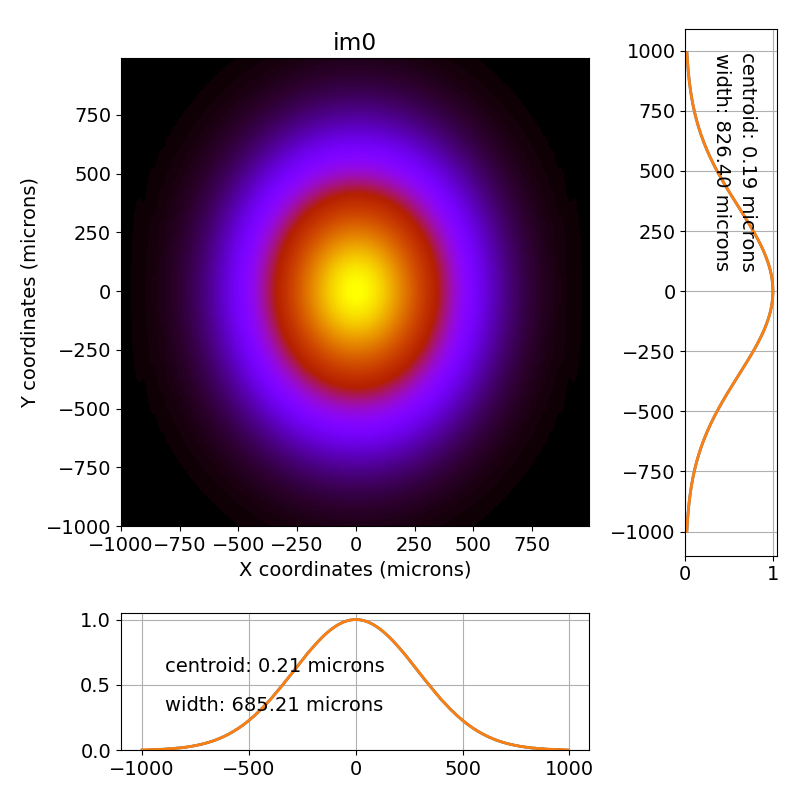

<IPython.core.display.Javascript object>


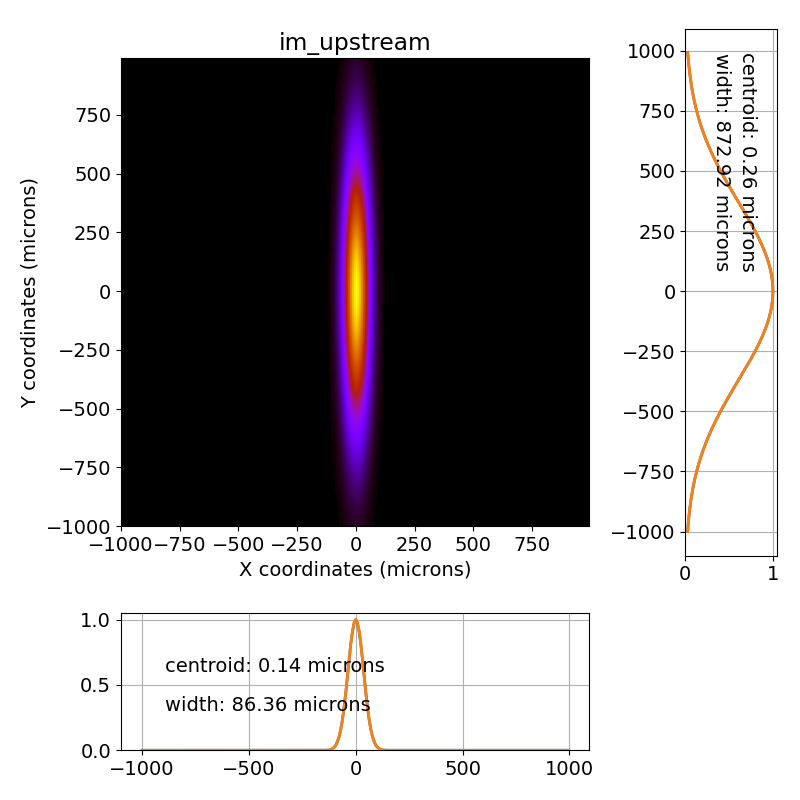

<IPython.core.display.Javascript object>


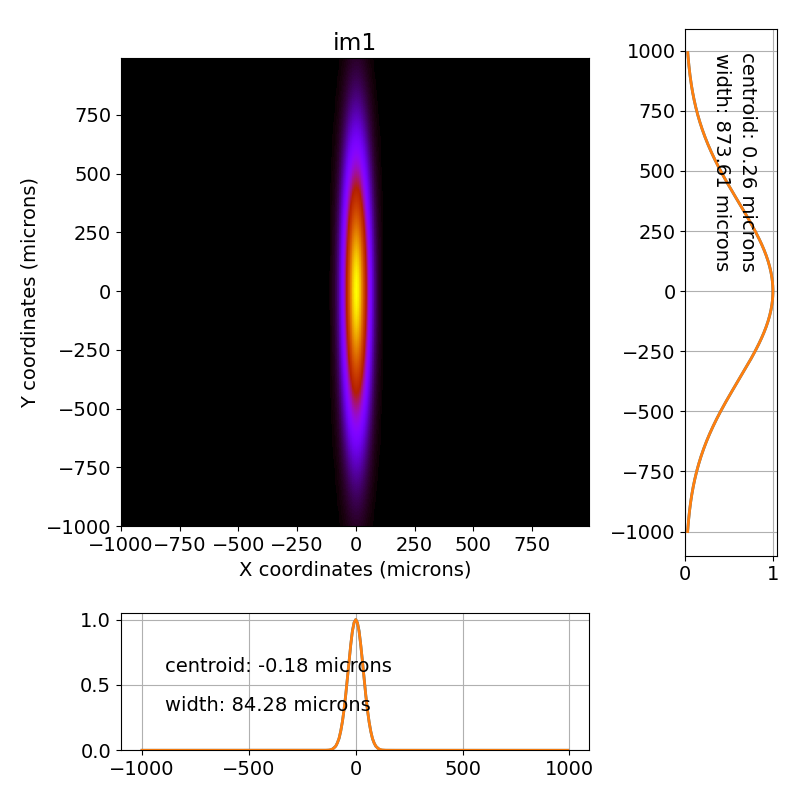

<IPython.core.display.Javascript object>


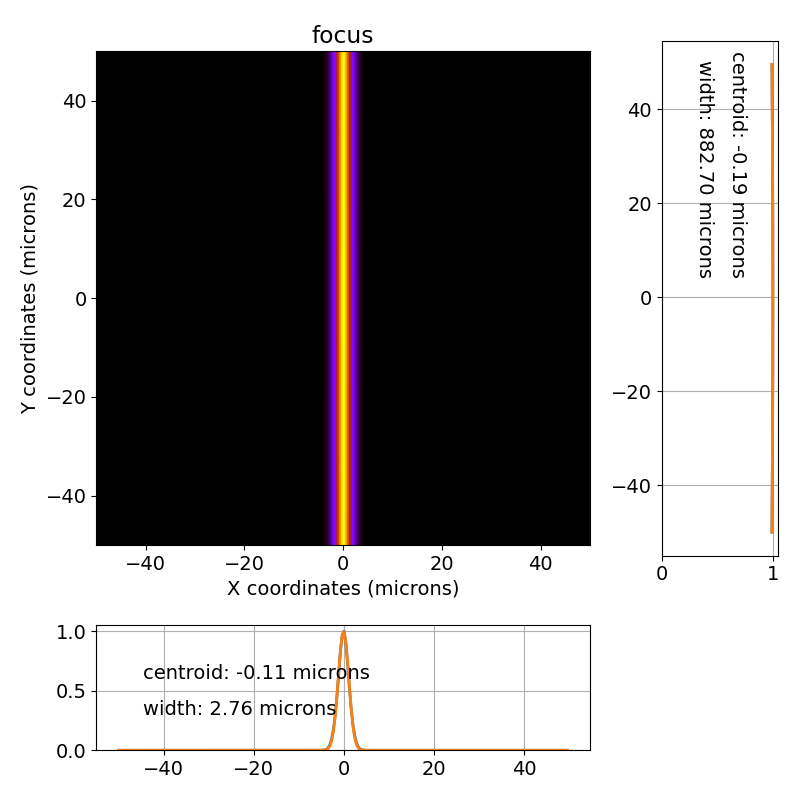

<IPython.core.display.Javascript object>


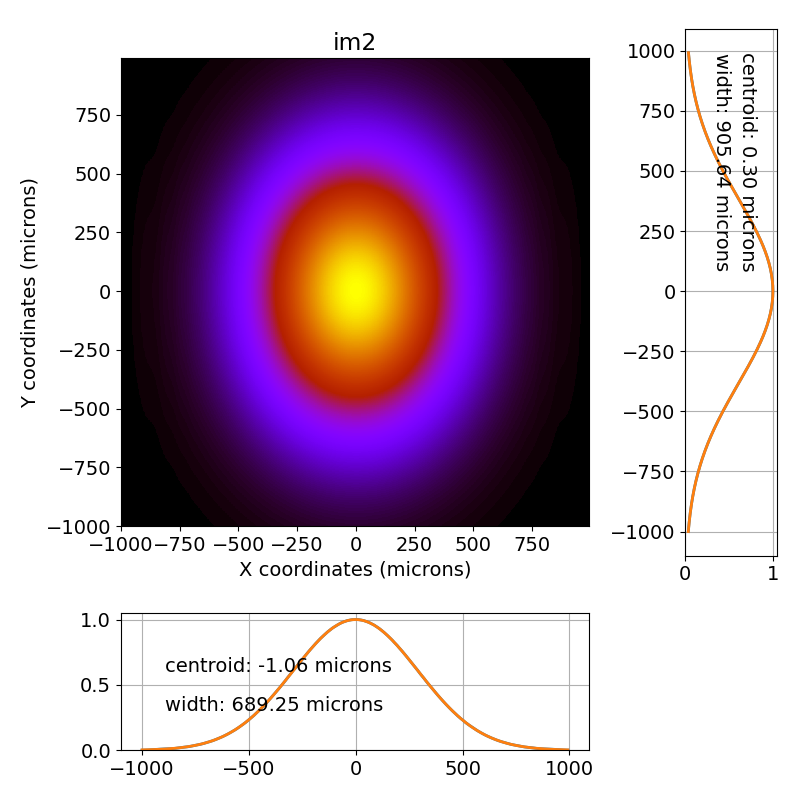

In [4]:
# propagate
b2 = mono_beamline.propagate_beamline(b1)

# view beam at various locations
mono_beamline.im0.view_beam()
mono_beamline.im_upstream.view_beam()
mono_beamline.im1.view_beam()
mono_beamline.focus.view_beam()
mono_beamline.im2.view_beam()

<IPython.core.display.Javascript object>


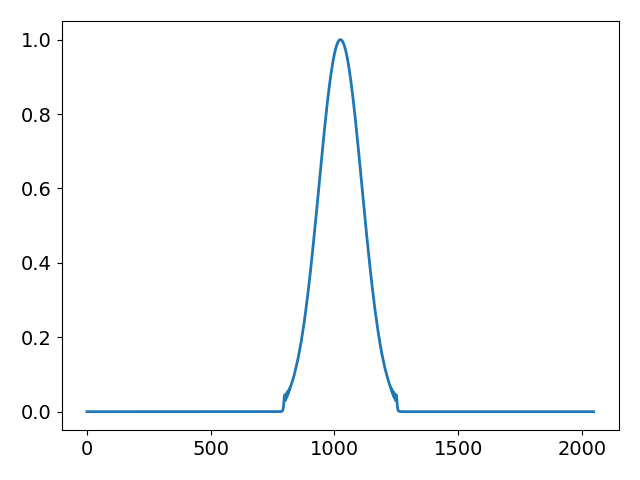

In [8]:
plt.figure()
plt.plot(np.abs(b2.wavey)**2)

## Time-domain propagation

In [5]:
# reset central photon energy
beam_params['photonEnergy'] = 9000

# initialize pulse. tau sets transform-limited pulse duration in fs (FWHM). Time window is in fs.
pulse = beam.Pulse(beam_params=beam_params, tau=40, time_window=4000)

print('Number of spectral components: {:d}'.format(pulse.N))

Number of spectral components: 224


In [6]:
# propagate pulse through beamline. This will take a minute or so (depends on number of spectral 
# components which is proportional to the ratio time_window/tau).
pulse.propagate(beamline=mono_beamline, screen_names=['im0','focus','im2'])

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 19835960158.84 microns
current zx: 19795960158.84 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19835.960159
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19835.960159
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 1

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131186020462683
5.131186020462683
x is focused
y is focused
FWHM in x: 690.1259972975195 microns
FWHM in y: 690.1259972975195 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131186020462683
5.131186020462683
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.116984
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722234688499.88 microns
zRy: 73726257.63 microns
remaining distance: 40000000.00 microns
goal for zx: 19835116983.65 microns
current zx: 19795116983.65 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19835.116984
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19835.116984
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722234688499.88 microns
zRy: 73726257.63 microns
remaining distance: 1

zx: -284.422949
zy: 262.077757
azimuth -868.49 mrad
c4
Calculated distance to focus: 18560.320031
zRx: 1.50e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18576.847266
zy: 262.077757
azimuth -0.12 mrad
drift12
delta z: -0.39
zRx: 640671676469.62 microns
zRy: 73726266.16 microns
remaining distance: 100054.17 microns
goal for zx: -18576747211.72 microns
current zx: -18576847265.88 microns
goal for zy: 262177811.64 microns
current zy: 262077757.47 microns
current step size: 100054.17 microns
x becomes focused
y stays unfocused
zx: -18576.747212
zy: 262.177812
azimuth -0.12 mrad
im2
zx: -18576.747212
zy: 262.177812
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187209273512
5.131187209273512
x is focused
y is focused
FWHM in x: 690.1258375119666 microns
FWHM in y: 690.1258375119666 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187209273512
5.13118720927351

zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722871036511.36 microns
zRy: 73726283.22 microns
remaining distance: 309563.80 microns
goal for zx: 19844161919.16 microns
current zx: 19843852355.36 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19844.161919
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.860045
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.719209
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47098577970005.05 microns
zRy: 73726283.22 microns
remaining distance: 2784000.02 microns
goal for zx: 307503209.04 microns
current zx: 304719209.02 microns
goal for zy: 253093563.82 microns
current zy: 250309563.80 microns
current step size: 2784000.02 microns
x remains focused
y stays unfocused
zx: 307.503209
zy: 253.093564
azimuth -0.12 mrad
im_upstream
zx: 307.503209
zy: 253.093564
azimuth -0.12 mrad
drift5
delta z: -375.33
zRx: 4709

zy: 256.193614
azimuth 5.84 mrad
focus
zx: 0.041083
zy: 256.193614
azimuth 5.84 mrad
drift8
delta z: -0.00
zRx: 11319205460.04 microns
zRy: 73726291.74 microns
remaining distance: 1000.02 microns
goal for zx: 42082.79 microns
current zx: 41082.77 microns
goal for zy: 256194614.33 microns
current zy: 256193614.32 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: 0.042083
zy: 256.194614
azimuth 5.84 mrad
slit
zx: 0.042083
zy: 256.194614
azimuth 5.84 mrad
drift9
delta z: -335.96
zRx: 11319205460.04 microns
zRy: 73726291.74 microns
remaining distance: 3037259.19 microns
goal for zx: 3079341.97 microns
current zx: 42082.79 microns
goal for zy: 259231873.52 microns
current zy: 256194614.33 microns
current step size: 3037259.19 microns
x remains focused
y stays unfocused
zx: 3.079342
zy: 259.231874
azimuth 5.84 mrad
m2
zRx: 1.13e+00
zRy: 7.37e+01
x becomes unfocused
zx: -287.548850
zy: 259.231874
azimuth -0.20 mrad
drift10
delta z: 336.71
zRx: 9889214227.03 mi

Calculated distance to focus: 285.784117
zRx: 9.90e+03
zRy: 7.37e+01
zx: -285.806971
zy: 261.193581
azimuth -868.49 mrad
drift11
delta z: -0.18
zRx: 9902642424.91 microns
zRy: 73726308.80 microns
remaining distance: 884178.89 microns
goal for zx: -284922792.11 microns
current zx: -285806970.99 microns
goal for zy: 262077760.30 microns
current zy: 261193581.41 microns
current step size: 884178.89 microns
x remains focused
y stays unfocused
zx: -284.922792
zy: 262.077760
azimuth -868.49 mrad
c4
Calculated distance to focus: 18592.937806
zRx: 1.51e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18608.769284
zy: 262.077760
azimuth -0.12 mrad
drift12
delta z: -0.41
zRx: 642864798521.29 microns
zRy: 73726308.80 microns
remaining distance: 100052.15 microns
goal for zx: -18608669231.55 microns
current zx: -18608769283.70 microns
goal for zy: 262177812.45 microns
current zy: 262077760.30 microns
current step size: 100052.15 microns
x becomes focused
y stays unfocused
zx: -18608.669232
zy: 262.17781

zx: 307.477465
zy: 253.093564
azimuth -0.12 mrad
drift5
delta z: -374.84
zRx: 47086539256621.71 microns
zRy: 73726325.86 microns
remaining distance: 137543.88 microns
goal for zx: 307615009.00 microns
current zx: 307477465.11 microns
goal for zy: 253231107.70 microns
current zy: 253093563.82 microns
current step size: 137543.88 microns
x remains focused
y stays unfocused
zx: 307.615009
zy: 253.231108
azimuth -0.12 mrad
m1
38032.78164173597
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.922963
zy: 253.231108
azimuth 5.84 mrad
drift6
delta z: 374.85
zRx: 11317188141.29 microns
zRy: 73726325.86 microns
remaining distance: 62457.18 microns
goal for zx: -2860505.60 microns
current zx: -2922962.78 microns
goal for zy: 253293564.88 microns
current zy: 253231107.70 microns
current step size: 62457.18 microns
x remains focused
y stays unfocused
zx: -2.860506
zy: 253.293565
azimuth 5.84 mrad
im1
zx: -2.860506
zy: 253.293565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11317188141.29 microns
zRy: 73726325.86

zx: -18627.008892
zy: 262.077762
azimuth -0.12 mrad
drift12
delta z: -0.42
zRx: 644119795258.93 microns
zRy: 73726334.39 microns
remaining distance: 100050.91 microns
goal for zx: -18626908841.13 microns
current zx: -18627008892.03 microns
goal for zy: 262177812.95 microns
current zy: 262077762.04 microns
current step size: 100050.91 microns
x becomes focused
y stays unfocused
zx: -18626.908841
zy: 262.177813
azimuth -0.12 mrad
im2
zx: -18626.908841
zy: 262.177813
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131191964516826
5.131191964516826
x is focused
y is focused
FWHM in x: 690.1251983704958 microns
FWHM in y: 690.1251983704958 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131191964516826
5.131191964516826
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19790.902185
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721927998374.7

zRx: 1.51e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18638.785819
zy: 262.077763
azimuth -0.12 mrad
drift12
delta z: -0.42
zRx: 644930861845.00 microns
zRy: 73726351.45 microns
remaining distance: 100050.06 microns
goal for zx: -18638685768.68 microns
current zx: -18638785818.75 microns
goal for zy: 262177813.29 microns
current zy: 262077763.23 microns
current step size: 100050.06 microns
x becomes focused
y stays unfocused
zx: -18638.685769
zy: 262.177813
azimuth -0.12 mrad
im2
zx: -18638.685769
zy: 262.177813
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131193153327655
5.131193153327655
x is focused
y is focused
FWHM in x: 690.1250385853127 microns
FWHM in y: 690.1250385853127 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131193153327655
5.131193153327655
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19790.059440
zy: 200.000000
azimuth 0.

zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.667726
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47074504755208.45 microns
zRy: 73726368.51 microns
remaining distance: 2784000.02 microns
goal for zx: 307451726.18 microns
current zx: 304667726.16 microns
goal for zy: 253093563.82 microns
current zy: 250309563.80 microns
current step size: 2784000.02 microns
x remains focused
y stays unfocused
zx: 307.451726
zy: 253.093564
azimuth -0.12 mrad
im_upstream
zx: 307.451726
zy: 253.093564
azimuth -0.12 mrad
drift5
delta z: -374.35
zRx: 47074504755208.45 microns
zRy: 73726368.51 microns
remaining distance: 135671.14 microns
goal for zx: 307587397.32 microns
current zx: 307451726.18 microns
goal for zy: 253229234.96 microns
current zy: 253093563.82 microns
current step size: 135671.14 microns
x remains focused
y stays unfocused
zx: 307.587397
zy: 253.229235
azimuth -0.12 mrad
m1
36112.487963406005
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.926758
zy: 253.229235
azimuth 5.84 mrad
drift6
delta z: 37

zx: -286.546548
zy: 261.193588
azimuth -868.50 mrad
drift11
delta z: -0.16
zRx: 9953223648.33 microns
zRy: 73726377.04 microns
remaining distance: 884177.50 microns
goal for zx: -285662370.22 microns
current zx: -286546547.72 microns
goal for zy: 262077765.03 microns
current zy: 261193587.53 microns
current step size: 884177.50 microns
x remains focused
y stays unfocused
zx: -285.662370
zy: 262.077765
azimuth -868.50 mrad
c4
Calculated distance to focus: 18641.199757
zRx: 1.51e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18655.902219
zy: 262.077765
azimuth -0.12 mrad
drift12
delta z: -0.43
zRx: 646110701182.20 microns
zRy: 73726377.04 microns
remaining distance: 100048.78 microns
goal for zx: -18655802170.01 microns
current zx: -18655902218.79 microns
goal for zy: 262177813.81 microns
current zy: 262077765.03 microns
current step size: 100048.78 microns
x becomes focused
y stays unfocused
zx: -18655.802170
zy: 262.177814
azimuth -0.12 mrad
im2
zx: -18655.802170
zy: 262.177814
azimuth -0.

Calculated distance to focus: 286.699216
zRx: 9.97e+03
zRy: 7.37e+01
zx: -286.720030
zy: 261.193589
azimuth -868.50 mrad
drift11
delta z: -0.16
zRx: 9965101265.76 microns
zRy: 73726394.10 microns
remaining distance: 884177.18 microns
goal for zx: -285835852.80 microns
current zx: -286720029.98 microns
goal for zy: 262077766.25 microns
current zy: 261193589.07 microns
current step size: 884177.18 microns
x remains focused
y stays unfocused
zx: -285.835853
zy: 262.077766
azimuth -868.50 mrad
c4
Calculated distance to focus: 18652.520547
zRx: 1.52e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18666.937797
zy: 262.077766
azimuth -0.12 mrad
drift12
delta z: -0.44
zRx: 646872056063.10 microns
zRy: 73726394.10 microns
remaining distance: 100047.91 microns
goal for zx: -18666837749.24 microns
current zx: -18666937797.15 microns
goal for zy: 262177814.16 microns
current zy: 262077766.25 microns
current step size: 100047.91 microns
x becomes focused
y stays unfocused
zx: -18666.837749
zy: 262.17781

zx: 0.035700
zy: 256.193614
azimuth 5.84 mrad
drift8
delta z: -0.00
zRx: 11312147505.08 microns
zRy: 73726411.16 microns
remaining distance: 1000.02 microns
goal for zx: 36699.85 microns
current zx: 35699.83 microns
goal for zy: 256194614.42 microns
current zy: 256193614.40 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: 0.036700
zy: 256.194614
azimuth 5.84 mrad
slit
zx: 0.036700
zy: 256.194614
azimuth 5.84 mrad
drift9
delta z: -343.06
zRx: 11312147505.08 microns
zRy: 73726411.16 microns
remaining distance: 3032502.38 microns
goal for zx: 3069202.23 microns
current zx: 36699.85 microns
goal for zy: 259227116.80 microns
current zy: 256194614.42 microns
current step size: 3032502.38 microns
x remains focused
y stays unfocused
zx: 3.069202
zy: 259.227117
azimuth 5.84 mrad
m2
zRx: 1.13e+00
zRy: 7.37e+01
x becomes unfocused
zx: -288.835115
zy: 259.227117
azimuth -0.19 mrad
drift10
delta z: 343.83
zRx: 9976677249.70 microns
zRy: 73726411.16 microns
remainin

zx: 0.034932
zy: 256.193614
azimuth 5.84 mrad
focus
zx: 0.034932
zy: 256.193614
azimuth 5.84 mrad
drift8
delta z: -0.00
zRx: 11311139835.96 microns
zRy: 73726428.21 microns
remaining distance: 1000.02 microns
goal for zx: 35931.60 microns
current zx: 34931.58 microns
goal for zy: 256194614.43 microns
current zy: 256193614.42 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: 0.035932
zy: 256.194614
azimuth 5.84 mrad
slit
zx: 0.035932
zy: 256.194614
azimuth 5.84 mrad
drift9
delta z: -344.06
zRx: 11311139835.96 microns
zRy: 73726428.21 microns
remaining distance: 3031814.75 microns
goal for zx: 3067746.35 microns
current zx: 35931.60 microns
goal for zy: 259226429.18 microns
current zy: 256194614.43 microns
current step size: 3031814.75 microns
x remains focused
y stays unfocused
zx: 3.067746
zy: 259.226429
azimuth 5.84 mrad
m2
zRx: 1.13e+00
zRy: 7.37e+01
x becomes unfocused
zx: -289.000743
zy: 259.226429
azimuth -0.19 mrad
drift10
delta z: 344.83
zRx: 998

azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11310132315.44 microns
zRy: 73726445.27 microns
remaining distance: 2900049.45 microns
goal for zx: 34163.52 microns
current zx: -2865885.93 microns
goal for zy: 256193614.43 microns
current zy: 253293564.98 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: 0.034164
zy: 256.193614
azimuth 5.84 mrad
focus
zx: 0.034164
zy: 256.193614
azimuth 5.84 mrad
drift8
delta z: -0.00
zRx: 11310132315.44 microns
zRy: 73726445.27 microns
remaining distance: 1000.02 microns
goal for zx: 35163.54 microns
current zx: 34163.52 microns
goal for zy: 256194614.45 microns
current zy: 256193614.43 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: 0.035164
zy: 256.194614
azimuth 5.84 mrad
slit
zx: 0.035164
zy: 256.194614
azimuth 5.84 mrad
drift9
delta z: -345.07
zRx: 11310132315.44 microns
zRy: 73726445.27 microns
remaining distance: 3031125.10 microns
goal for zx: 3066288.64 microns
current zx: 35

zx: -2.866654
zy: 253.293565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11309124950.79 microns
zRy: 73726462.33 microns
remaining distance: 2900049.45 microns
goal for zx: 33395.64 microns
current zx: -2866653.82 microns
goal for zy: 256193614.44 microns
current zy: 253293564.99 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: 0.033396
zy: 256.193614
azimuth 5.84 mrad
focus
zx: 0.033396
zy: 256.193614
azimuth 5.84 mrad
drift8
delta z: -0.00
zRx: 11309124950.79 microns
zRy: 73726462.33 microns
remaining distance: 1000.02 microns
goal for zx: 34395.65 microns
current zx: 33395.64 microns
goal for zy: 256194614.46 microns
current zy: 256193614.44 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: 0.034396
zy: 256.194614
azimuth 5.84 mrad
slit
zx: 0.034396
zy: 256.194614
azimuth 5.84 mrad
drift9
delta z: -346.06
zRx: 11309124950.79 microns
zRy: 73726462.33 microns
remaining distance: 3030433.46 microns
goal for zx: 3064

zx: -18712.853096
zy: 262.177816
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201475003459
5.131201475003459
x is focused
y is focused
FWHM in x: 690.123920091108 microns
FWHM in y: 690.123920091108 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201475003459
5.131201475003459
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19784.162239
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721437701082.36 microns
zRy: 73726479.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19824162238.78 microns
current zx: 19784162238.78 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19824.162239
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19824.162239
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721437701082.36 micr

zx: -286.709806
zy: 262.077773
azimuth -868.50 mrad
c4
Calculated distance to focus: 18709.551262
zRx: 1.53e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18722.379497
zy: 262.077773
azimuth -0.12 mrad
drift12
delta z: -0.46
zRx: 650705237399.31 microns
zRy: 73726487.92 microns
remaining distance: 100042.95 microns
goal for zx: -18722279454.51 microns
current zx: -18722379497.46 microns
goal for zy: 262177816.16 microns
current zy: 262077773.21 microns
current step size: 100042.95 microns
x becomes focused
y stays unfocused
zx: -18722.279455
zy: 262.177816
azimuth -0.12 mrad
im2
zx: -18722.279455
zy: 262.177816
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131202663814287
5.131202663814287
x is focused
y is focused
FWHM in x: 690.1237603065179 microns
FWHM in y: 690.1237603065179 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131202663814287
5.13120266381428

zx: 307.499090
zy: 253.223259
azimuth -0.13 mrad
m1
30000.61910430008
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.938879
zy: 253.223259
azimuth 5.84 mrad
drift6
delta z: 372.80
zRx: 11306607202.53 microns
zRy: 73726504.98 microns
remaining distance: 70306.45 microns
goal for zx: -2868572.70 microns
current zx: -2938879.15 microns
goal for zy: 253293565.02 microns
current zy: 253223258.57 microns
current step size: 70306.45 microns
x remains focused
y stays unfocused
zx: -2.868573
zy: 253.293565
azimuth 5.84 mrad
im1
zx: -2.868573
zy: 253.293565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11306607202.53 microns
zRy: 73726504.98 microns
remaining distance: 2900049.45 microns
goal for zx: 31476.75 microns
current zx: -2868572.70 microns
goal for zy: 256193614.47 microns
current zy: 253293565.02 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: 0.031477
zy: 256.193614
azimuth 5.84 mrad
focus
zx: 0.031477
zy: 256.193614
azimuth 5.84 mrad
drift8
delta z: -0.00
zRx

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13120444703053
5.13120444703053
x is focused
y is focused
FWHM in x: 690.1235206297715 microns
FWHM in y: 690.1235206297715 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13120444703053
5.13120444703053
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19782.056947
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721284585793.29 microns
zRy: 73726522.04 microns
remaining distance: 40000000.00 microns
goal for zx: 19822056946.98 microns
current zx: 19782056946.98 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19822.056947
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19822.056947
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721284585793.29 microns
zRy: 73726522.04 microns
remaining distance: 10000

Calculated distance to focus: 287.929779
zRx: 1.00e+04
zRy: 7.37e+01
zx: -287.947243
zy: 261.193602
azimuth -868.50 mrad
drift11
delta z: -0.13
zRx: 10049238496.84 microns
zRy: 73726530.57 microns
remaining distance: 884174.89 microns
goal for zx: -287063067.67 microns
current zx: -287947242.56 microns
goal for zy: 262077776.50 microns
current zy: 261193601.61 microns
current step size: 884174.89 microns
x remains focused
y stays unfocused
zx: -287.063068
zy: 262.077776
azimuth -868.50 mrad
c4
Calculated distance to focus: 18732.603749
zRx: 1.53e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18744.698713
zy: 262.077776
azimuth -0.12 mrad
drift12
delta z: -0.47
zRx: 652252425234.08 microns
zRy: 73726530.57 microns
remaining distance: 100040.60 microns
goal for zx: -18744598672.59 microns
current zx: -18744698713.20 microns
goal for zy: 262177817.10 microns
current zy: 262077776.50 microns
current step size: 100040.60 microns
x becomes focused
y stays unfocused
zx: -18744.598673
zy: 262.1778

zx: 0.029559
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: -0.00
zRx: 11304090402.78 microns
zRy: 73726547.63 microns
remaining distance: 1000.02 microns
goal for zx: 30559.03 microns
current zx: 29559.01 microns
goal for zy: 256194614.52 microns
current zy: 256193614.50 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: 0.030559
zy: 256.194615
azimuth 5.84 mrad
slit
zx: 0.030559
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -351.04
zRx: 11304090402.78 microns
zRy: 73726547.63 microns
remaining distance: 3026945.32 microns
goal for zx: 3057504.34 microns
current zx: 30559.03 microns
goal for zy: 259221559.84 microns
current zy: 256194614.52 microns
current step size: 3026945.32 microns
x remains focused
y stays unfocused
zx: 3.057504
zy: 259.221560
azimuth 5.84 mrad
m2
zRx: 1.12e+00
zRy: 7.37e+01
x becomes unfocused
zx: -290.035863
zy: 259.221560
azimuth -0.19 mrad
drift10
delta z: 351.83
zRx: 10058408391.98 microns
zRy: 73726547.63 microns
remaini

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312074190576045
5.1312074190576045
x is focused
y is focused
FWHM in x: 690.1231211688978 microns
FWHM in y: 690.1231211688978 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312074190576045
5.1312074190576045
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19779.952103
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721131519332.40 microns
zRy: 73726564.68 microns
remaining distance: 40000000.00 microns
goal for zx: 19819952103.19 microns
current zx: 19779952103.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19819.952103
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19819.952103
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721131519332.40 microns
zRy: 73726564.68 microns
remaining distanc

zx: 307.328250
zy: 253.093564
azimuth -0.13 mrad
im_upstream
zx: 307.328250
zy: 253.093564
azimuth -0.13 mrad
drift5
delta z: -372.02
zRx: 47016798113897.94 microns
zRy: 73726573.21 microns
remaining distance: 126715.89 microns
goal for zx: 307454965.44 microns
current zx: 307328249.56 microns
goal for zy: 253220279.71 microns
current zy: 253093563.82 microns
current step size: 126715.89 microns
x remains focused
y stays unfocused
zx: 307.454965
zy: 253.220280
azimuth -0.13 mrad
m1
26963.476001166724
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.944926
zy: 253.220280
azimuth 5.84 mrad
drift6
delta z: 372.03
zRx: 11302580780.00 microns
zRy: 73726573.21 microns
remaining distance: 73285.36 microns
goal for zx: -2871640.53 microns
current zx: -2944925.90 microns
goal for zy: 253293565.07 microns
current zy: 253220279.71 microns
current step size: 73285.36 microns
x remains focused
y stays unfocused
zx: -2.871641
zy: 253.293565
azimuth 5.84 mrad
im1
zx: -2.871641
zy: 253.293565
azimuth 5.84 mrad
drif

zx: 19818.689412
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721039702884.77 microns
zRy: 73726590.27 microns
remaining distance: 10000000.00 microns
goal for zx: 19828689411.90 microns
current zx: 19818689411.90 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19828.689412
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19828.689412
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19828.689413
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721767522567.42 microns
zRy: 73726590.27 microns
remaining distance: 309563.80 microns
goal for zx: 19828998976.65 microns
current zx: 19828689412.86 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19828.998977
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.627101
zRx: 4.70e+07
zRy: 7.37e

zx: 0.027259
zy: 256.193615
azimuth 5.84 mrad
focus
zx: 0.027259
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: -0.00
zRx: 11301071495.32 microns
zRy: 73726598.80 microns
remaining distance: 1000.02 microns
goal for zx: 28259.26 microns
current zx: 27259.25 microns
goal for zy: 256194614.56 microns
current zy: 256193614.54 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: 0.028259
zy: 256.194615
azimuth 5.84 mrad
slit
zx: 0.028259
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -354.01
zRx: 11301071495.32 microns
zRy: 73726598.80 microns
remaining distance: 3024828.66 microns
goal for zx: 3053087.92 microns
current zx: 28259.26 microns
goal for zy: 259219443.22 microns
current zy: 256194614.56 microns
current step size: 3024828.66 microns
x remains focused
y stays unfocused
zx: 3.053088
zy: 259.219443
azimuth 5.84 mrad
m2
zRx: 1.11e+00
zRy: 7.37e+01
x becomes unfocused
zx: -290.414665
zy: 259.219443
azimuth -0.19 mrad
drift10
delta z: 354.80
zRx: 100

zx: -2.873556
zy: 253.293565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11300065497.29 microns
zRy: 73726615.86 microns
remaining distance: 2900049.45 microns
goal for zx: 26493.03 microns
current zx: -2873556.42 microns
goal for zy: 256193614.56 microns
current zy: 253293565.11 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: 0.026493
zy: 256.193615
azimuth 5.84 mrad
focus
zx: 0.026493
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: -0.00
zRx: 11300065497.29 microns
zRy: 73726615.86 microns
remaining distance: 1000.02 microns
goal for zx: 27493.04 microns
current zx: 26493.03 microns
goal for zy: 256194614.57 microns
current zy: 256193614.56 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: 0.027493
zy: 256.194615
azimuth 5.84 mrad
slit
zx: 0.027493
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -354.98
zRx: 11300065497.29 microns
zRy: 73726615.86 microns
remaining distance: 3024119.17 microns
goal for zx: 3051

current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.292257
zy: 253.093564
azimuth -0.14 mrad
im_upstream
zx: 307.292257
zy: 253.093564
azimuth -0.14 mrad
drift5
delta z: -371.34
zRx: 46999985354444.55 microns
zRy: 73726632.92 microns
remaining distance: 124114.46 microns
goal for zx: 307416371.87 microns
current zx: 307292257.41 microns
goal for zy: 253217678.28 microns
current zy: 253093563.82 microns
current step size: 124114.46 microns
x remains focused
y stays unfocused
zx: 307.416372
zy: 253.217678
azimuth -0.14 mrad
m1
24316.190516405437
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.950209
zy: 253.217678
azimuth 5.84 mrad
drift6
delta z: 371.35
zRx: 11299059650.39 microns
zRy: 73726632.92 microns
remaining distance: 75886.83 microns
goal for zx: -2874322.46 microns
current zx: -2950209.29 microns
goal for zy: 253293565.12 microns
current zy: 253217678.28 microns
current step size: 75886.83 microns
x remains focused
y stays unfocused
zx: -2.874322
zy: 253.293565

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.497976
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46995183229465.01 microns
zRy: 73726649.98 microns
remaining distance: 2784000.03 microns
goal for zx: 307281975.75 microns
current zx: 304497975.72 microns
goal for zy: 253093563.82 microns
current zy: 250309563.80 microns
current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.281976
zy: 253.093564
azimuth -0.14 mrad
im_upstream
zx: 307.281976
zy: 253.093564
azimuth -0.14 mrad
drift5
delta z: -371.15
zRx: 46995183229465.01 microns
zRy: 73726649.98 microns
remaining distance: 123372.07 microns
goal for zx: 307405347.82 microns
current zx: 307281975.75 microns
goal for zy: 253216935.89 microns
current zy: 253093563.82 microns
current step size: 123372.07 microns
x remains focused
y stays unfocused
zx: 307.405348
zy: 253.216936
azimuth -0.14 mrad
m1
23561.568557014234
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.951718
zy: 253.216936
azimuth 5.84 mrad
drift6
delta z: 37

zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19814.902305
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720764358921.00 microns
zRy: 73726667.04 microns
remaining distance: 10000000.00 microns
goal for zx: 19824902305.14 microns
current zx: 19814902305.14 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19824.902305
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19824.902305
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19824.902305
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721492039756.50 microns
zRy: 73726667.04 microns
remaining distance: 309563.80 microns
goal for zx: 19825211868.93 microns
current zx: 19824902305.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19825.211869
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus:

zRx: 1.01e+04
zRy: 7.37e+01
zx: -288.948782
zy: 261.193615
azimuth -868.51 mrad
drift11
delta z: -0.11
zRx: 10117982161.33 microns
zRy: 73726675.57 microns
remaining distance: 884172.93 microns
goal for zx: -288064609.03 microns
current zx: -288948781.96 microns
goal for zy: 262077788.19 microns
current zy: 261193615.26 microns
current step size: 884172.93 microns
x remains focused
y stays unfocused
zx: -288.064609
zy: 262.077788
azimuth -868.51 mrad
c4
Calculated distance to focus: 18797.960389
zRx: 1.54e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18807.513998
zy: 262.077788
azimuth -0.12 mrad
drift12
delta z: -0.50
zRx: 656621200360.64 microns
zRy: 73726675.57 microns
remaining distance: 100032.27 microns
goal for zx: -18807413965.60 microns
current zx: -18807513997.87 microns
goal for zy: 262177820.46 microns
current zy: 262077788.19 microns
current step size: 100032.27 microns
x becomes focused
y stays unfocused
zx: -18807.413966
zy: 262.177820
azimuth -0.12 mrad
im2
zx: -18807.4139

zRx: 1.11e+00
zRy: 7.37e+01
x becomes unfocused
zx: -291.011623
zy: 259.215517
azimuth -0.18 mrad
drift10
delta z: 360.19
zRx: 10124712670.67 microns
zRy: 73726692.62 microns
remaining distance: 1978100.00 microns
goal for zx: -289033523.16 microns
current zx: -291011623.16 microns
goal for zy: 261193616.89 microns
current zy: 259215516.90 microns
current step size: 1978100.00 microns
x becomes focused
y stays unfocused
zx: -289.033523
zy: 261.193617
azimuth -0.18 mrad
c3
Calculated distance to focus: 289.033523
zRx: 1.01e+04
zRy: 7.37e+01
zx: -289.046881
zy: 261.193617
azimuth -868.51 mrad
drift11
delta z: -0.10
zRx: 10124712670.67 microns
zRy: 73726692.62 microns
remaining distance: 884172.72 microns
goal for zx: -288162708.35 microns
current zx: -289046881.08 microns
goal for zy: 262077789.61 microns
current zy: 261193616.89 microns
current step size: 884172.72 microns
x remains focused
y stays unfocused
zx: -288.162708
zy: 262.077790
azimuth -868.51 mrad
c4
Calculated distance to f

zx: -2.878150
zy: 253.293565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11294032684.51 microns
zRy: 73726718.21 microns
remaining distance: 2900049.45 microns
goal for zx: 21899.57 microns
current zx: -2878149.88 microns
goal for zy: 256193614.63 microns
current zy: 253293565.18 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: 0.021900
zy: 256.193615
azimuth 5.84 mrad
focus
zx: 0.021900
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: -0.00
zRx: 11294032684.51 microns
zRy: 73726718.21 microns
remaining distance: 1000.02 microns
goal for zx: 22899.58 microns
current zx: 21899.57 microns
goal for zy: 256194614.65 microns
current zy: 256193614.63 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: 0.022900
zy: 256.194615
azimuth 5.84 mrad
slit
zx: 0.022900
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -360.83
zRx: 11294032684.51 microns
zRy: 73726718.21 microns
remaining distance: 3019821.21 microns
goal for zx: 3042

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19821.537206
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721247298815.92 microns
zRy: 73726735.27 microns
remaining distance: 309563.80 microns
goal for zx: 19821846769.75 microns
current zx: 19821537205.95 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19821.846770
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.517224
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.446580
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46971182731066.94 microns
zRy: 73726735.27 microns
remaining distance: 2784000.03 microns
goal for zx: 307230579.55 microns
current zx: 304446579.52 microns
goal for zy: 253093563.83 microns
current zy: 250309563.80 microns
current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.230580
zy: 253.093564
azimuth -0.14 mrad
im_upstream
zx: 307.230580
zy: 253.093564
azimuth

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19770.696109
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720458606457.14 microns
zRy: 73726752.33 microns
remaining distance: 40000000.00 microns
goal for zx: 19810696109.30 microns
current zx: 19770696109.30 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19810.696109
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19810.696109
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720458606457.14 microns
zRy: 73726752.33 microns
remaining distance: 10000000.00 microns
goal for zx: 19820696109.30 microns
current zx: 19810696109.30 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19820.696109
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19820.696109
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19820.696109

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19819.855084
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721124975142.05 microns
zRy: 73726769.39 microns
remaining distance: 309563.80 microns
goal for zx: 19820164647.88 microns
current zx: 19819855084.08 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19820.164648
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.491382
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.426027
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46961587248574.46 microns
zRy: 73726769.39 microns
remaining distance: 2784000.03 microns
goal for zx: 307210026.69 microns
current zx: 304426026.66 microns
goal for zy: 253093563.83 microns
current zy: 250309563.80 microns
current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.210027
zy: 253.093564
azimuth -0.14 mrad
im_upstream
zx: 307.210027
zy: 253.093564
azimuth

zx: -288.593763
zy: 262.077797
azimuth -868.51 mrad
c4
Calculated distance to focus: 18832.490886
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18840.208774
zy: 262.077797
azimuth -0.12 mrad
drift12
delta z: -0.52
zRx: 658905805684.98 microns
zRy: 73726777.92 microns
remaining distance: 100026.11 microns
goal for zx: -18840108747.64 microns
current zx: -18840208773.74 microns
goal for zy: 262177822.94 microns
current zy: 262077796.84 microns
current step size: 100026.11 microns
x becomes focused
y stays unfocused
zx: -18840.108748
zy: 262.177823
azimuth -0.12 mrad
im2
zx: -18840.108748
zy: 262.177823
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13122287359838
5.13122287359838
x is focused
y is focused
FWHM in x: 690.1210439798172 microns
FWHM in y: 690.1210439798172 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13122287359838
5.13122287359838
cr

zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721033252851.48 microns
zRy: 73726794.98 microns
remaining distance: 309563.80 microns
goal for zx: 19818903244.97 microns
current zx: 19818593681.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19818.903245
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.472003
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.410614
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46954392410606.48 microns
zRy: 73726794.98 microns
remaining distance: 2784000.03 microns
goal for zx: 307194614.15 microns
current zx: 304410614.12 microns
goal for zy: 253093563.83 microns
current zy: 250309563.80 microns
current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.194614
zy: 253.093564
azimuth -0.14 mrad
im_upstream
zx: 307.194614
zy: 253.093564
azimuth -0.14 mrad
drift5
delta z: -369.51
zRx: 4695

/Users/Matt/beamline/venv/lib/python3.7/site-packages/scipy/optimize/minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)



zy: 262.177823
azimuth -0.12 mrad
im2
zx: -18844.658572
zy: 262.177823
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131224062409208
5.131224062409208
x is focused
y is focused
FWHM in x: 690.12088419656 microns
FWHM in y: 690.12088419656 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131224062409208
5.131224062409208
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19768.173251
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720275248524.44 microns
zRy: 73726803.51 microns
remaining distance: 40000000.00 microns
goal for zx: 19808173250.57 microns
current zx: 19768173250.57 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19808.173251
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19808.173251
zy: 240.000000
azimuth 0.00 mrad
drift2
de

zx: -18848.968272
zy: 262.177824
azimuth -0.12 mrad
im2
zx: -18848.968272
zy: 262.177824
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312252512200365
5.1312252512200365
x is focused
y is focused
FWHM in x: 690.1207244133772 microns
FWHM in y: 690.1207244133772 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312252512200365
5.1312252512200365
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19767.332441
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720214144796.54 microns
zRy: 73726820.56 microns
remaining distance: 40000000.00 microns
goal for zx: 19807332440.74 microns
current zx: 19767332440.74 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19807.332441
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19807.332441
zy: 240.000000
az

zRx: 46944801657317.05 microns
zRy: 73726829.09 microns
remaining distance: 115600.15 microns
goal for zx: 307289667.08 microns
current zx: 307174066.93 microns
goal for zy: 253209163.98 microns
current zy: 253093563.83 microns
current step size: 115600.15 microns
x remains focused
y stays unfocused
zx: 307.289667
zy: 253.209164
azimuth -0.14 mrad
m1
15684.599155314376
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.967520
zy: 253.209164
azimuth 5.84 mrad
drift6
delta z: 369.14
zRx: 11287503284.01 microns
zRy: 73726829.09 microns
remaining distance: 84401.29 microns
goal for zx: -2883118.68 microns
current zx: -2967519.97 microns
goal for zy: 253293565.27 microns
current zy: 253209163.98 microns
current step size: 84401.29 microns
x remains focused
y stays unfocused
zx: -2.883119
zy: 253.293565
azimuth 5.84 mrad
im1
zx: -2.883119
zy: 253.293565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11287503284.01 microns
zRy: 73726829.09 microns
remaining distance: 2900049.45 microns
goal for zx: 16930.77 mi

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19816.071359
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720849860874.68 microns
zRy: 73726846.15 microns
remaining distance: 309563.80 microns
goal for zx: 19816380923.14 microns
current zx: 19816071359.34 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19816.380923
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.433253
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.379794
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46940007291559.50 microns
zRy: 73726846.15 microns
remaining distance: 2784000.03 microns
goal for zx: 307163794.52 microns
current zx: 304379794.49 microns
goal for zy: 253093563.83 microns
current zy: 250309563.80 microns
current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.163795
zy: 253.093564
azimuth -0.14 mrad
im_upstream
zx: 307.163795
zy: 253.093564
azimuth

zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18858.742065
zy: 262.077803
azimuth -0.12 mrad
drift12
delta z: -0.53
zRx: 660206101426.96 microns
zRy: 73726854.68 microns
remaining distance: 100021.37 microns
goal for zx: -18858642044.05 microns
current zx: -18858742065.42 microns
goal for zy: 262177824.85 microns
current zy: 262077803.48 microns
current step size: 100021.37 microns
x becomes focused
y stays unfocused
zx: -18858.642044
zy: 262.177825
azimuth -0.12 mrad
im2
zx: -18858.642044
zy: 262.177825
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228223247108
5.131228223247108
x is focused
y is focused
FWHM in x: 690.120324955744 microns
FWHM in y: 690.120324955744 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228223247108
5.131228223247108
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.230729
zy: 200.000000
azimuth 0.00

zy: 256.194615
azimuth 5.84 mrad
slit
zx: 0.016022
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -369.47
zRx: 11284993676.88 microns
zRy: 73726871.74 microns
remaining distance: 3013243.91 microns
goal for zx: 3029265.68 microns
current zx: 16021.77 microns
goal for zy: 259207858.67 microns
current zy: 256194614.76 microns
current step size: 3013243.91 microns
x remains focused
y stays unfocused
zx: 3.029266
zy: 259.207859
azimuth 5.84 mrad
m2
zRx: 1.10e+00
zRy: 7.37e+01
x becomes unfocused
zx: -291.818115
zy: 259.207859
azimuth -0.17 mrad
drift10
delta z: 370.29
zRx: 10179060707.41 microns
zRy: 73726871.74 microns
remaining distance: 1985775.56 microns
goal for zx: -289832339.53 microns
current zx: -291818115.09 microns
goal for zy: 261193634.23 microns
current zy: 259207858.67 microns
current step size: 1985775.56 microns
x becomes focused
y stays unfocused
zx: -289.832340
zy: 261.193634
azimuth -0.17 mrad
c3
Calculated distance to focus: 289.832340
zRx: 1.02e+04
zRy: 7.37e+01
zx:

zx: 307.251136
zy: 253.206583
azimuth -0.15 mrad
m1
13077.727542400477
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.972774
zy: 253.206583
azimuth 5.84 mrad
drift6
delta z: 368.47
zRx: 11283990100.11 microns
zRy: 73726888.80 microns
remaining distance: 86982.58 microns
goal for zx: -2885790.98 microns
current zx: -2972773.56 microns
goal for zy: 253293565.31 microns
current zy: 253206582.73 microns
current step size: 86982.58 microns
x remains focused
y stays unfocused
zx: -2.885791
zy: 253.293565
azimuth 5.84 mrad
im1
zx: -2.885791
zy: 253.293565
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11283990100.11 microns
zRy: 73726888.80 microns
remaining distance: 2900049.45 microns
goal for zx: 14258.47 microns
current zx: -2885790.98 microns
goal for zy: 256193614.76 microns
current zy: 253293565.31 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: 0.014258
zy: 256.193615
azimuth 5.84 mrad
focus
zx: 0.014258
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx:

zx: 307.127847
zy: 253.093564
azimuth -0.15 mrad
im_upstream
zx: 307.127847
zy: 253.093564
azimuth -0.15 mrad
drift5
delta z: -368.27
zRx: 46923232318091.92 microns
zRy: 73726905.86 microns
remaining distance: 112282.27 microns
goal for zx: 307240129.74 microns
current zx: 307127847.48 microns
goal for zy: 253205846.09 microns
current zy: 253093563.83 microns
current step size: 112282.27 microns
x remains focused
y stays unfocused
zx: 307.240130
zy: 253.205846
azimuth -0.15 mrad
m1
12334.622218784676
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.974273
zy: 253.205846
azimuth 5.84 mrad
drift6
delta z: 368.28
zRx: 11282986670.63 microns
zRy: 73726905.86 microns
remaining distance: 87719.23 microns
goal for zx: -2886554.09 microns
current zx: -2974273.32 microns
goal for zy: 253293565.33 microns
current zy: 253205846.09 microns
current step size: 87719.23 microns
x remains focused
y stays unfocused
zx: -2.886554
zy: 253.293565
azimuth 5.84 mrad
im1
zx: -2.886554
zy: 253.293565
azimuth 5.84 mrad
drif

Calculated distance to focus: -304.375147
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.333579
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46918440988709.56 microns
zRy: 73726922.92 microns
remaining distance: 2784000.03 microns
goal for zx: 307117578.72 microns
current zx: 304333578.69 microns
goal for zy: 253093563.83 microns
current zy: 250309563.80 microns
current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.117579
zy: 253.093564
azimuth -0.15 mrad
im_upstream
zx: 307.117579
zy: 253.093564
azimuth -0.15 mrad
drift5
delta z: -368.08
zRx: 46918440988709.56 microns
zRy: 73726922.92 microns
remaining distance: 111546.01 microns
goal for zx: 307229124.73 microns
current zx: 307117578.72 microns
goal for zy: 253205109.84 microns
current zy: 253093563.83 microns
current step size: 111546.01 microns
x remains focused
y stays unfocused
zx: 307.229125
zy: 253.205110
azimuth -0.15 mrad
m1
11592.277554663702
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.975773
zy: 253.2

Calculated distance to focus: 18867.492686
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18872.398348
zy: 262.077810
azimuth -0.12 mrad
drift12
delta z: -0.54
zRx: 661168842936.14 microns
zRy: 73726931.45 microns
remaining distance: 100016.56 microns
goal for zx: -18872298331.01 microns
current zx: -18872398347.57 microns
goal for zy: 262177826.79 microns
current zy: 262077810.23 microns
current step size: 100016.56 microns
x becomes focused
y stays unfocused
zx: -18872.298331
zy: 262.177827
azimuth -0.12 mrad
im2
zx: -18872.298331
zy: 262.177827
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233572895839
5.131233572895839
x is focused
y is focused
FWHM in x: 690.1196059331702 microns
FWHM in y: 690.1196059331702 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233572895839
5.131233572895839
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04

current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.102177
zy: 253.093564
azimuth -0.15 mrad
im_upstream
zx: 307.102177
zy: 253.093564
azimuth -0.15 mrad
drift5
delta z: -367.80
zRx: 46911255247589.88 microns
zRy: 73726948.50 microns
remaining distance: 110442.33 microns
goal for zx: 307212619.33 microns
current zx: 307102177.00 microns
goal for zy: 253204006.16 microns
current zy: 253093563.83 microns
current step size: 110442.33 microns
x remains focused
y stays unfocused
zx: 307.212619
zy: 253.204006
azimuth -0.15 mrad
m1
10480.184871419937
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.978020
zy: 253.204006
azimuth 5.84 mrad
drift6
delta z: 367.80
zRx: 11280478758.21 microns
zRy: 73726948.50 microns
remaining distance: 89559.19 microns
goal for zx: -2888461.05 microns
current zx: -2978020.25 microns
goal for zy: 253293565.36 microns
current zy: 253204006.16 microns
current step size: 89559.19 microns
x remains focused
y stays unfocused
zx: -2.888461
zy: 253.293565

zRy: 7.37e+01
zx: -290.075221
zy: 261.193643
azimuth -868.52 mrad
drift11
delta z: -0.09
zRx: 10194944354.07 microns
zRy: 73726957.03 microns
remaining distance: 884169.86 microns
goal for zx: -289191051.40 microns
current zx: -290075221.26 microns
goal for zy: 262077812.50 microns
current zy: 261193642.64 microns
current step size: 884169.86 microns
x remains focused
y stays unfocused
zx: -289.191051
zy: 262.077812
azimuth -868.52 mrad
c4
Calculated distance to focus: 18871.467576
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18875.898175
zy: 262.077812
azimuth -0.12 mrad
drift12
delta z: -0.54
zRx: 661416803762.61 microns
zRy: 73726957.03 microns
remaining distance: 100014.95 microns
goal for zx: -18875798160.30 microns
current zx: -18875898175.24 microns
goal for zy: 262177827.44 microns
current zy: 262077812.50 microns
current step size: 100014.95 microns
x becomes focused
y stays unfocused
zx: -18875.798160
zy: 262.177827
azimuth -0.12 mrad
im2
zx: -18875.798160
zy: 262.177

current zy: 250309563.80 microns
current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.086777
zy: 253.093564
azimuth -0.15 mrad
im_upstream
zx: 307.086777
zy: 253.093564
azimuth -0.15 mrad
drift5
delta z: -367.51
zRx: 46904071019373.66 microns
zRy: 73726974.09 microns
remaining distance: 109339.52 microns
goal for zx: 307196116.68 microns
current zx: 307086777.16 microns
goal for zy: 253202903.35 microns
current zy: 253093563.83 microns
current step size: 109339.52 microns
x remains focused
y stays unfocused
zx: 307.196117
zy: 253.202903
azimuth -0.15 mrad
m1
9369.79872013735
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.980267
zy: 253.202903
azimuth 5.84 mrad
drift6
delta z: 367.52
zRx: 11278974465.39 microns
zRy: 73726974.09 microns
remaining distance: 90662.03 microns
goal for zx: -2889604.68 microns
current zx: -2980266.71 microns
goal for zy: 253293565.38 microns
current zy: 253202903.35 microns
current step size: 90662.03 microns
x remains focused
y stays unfocus

delta z: 376.43
zRx: 10198518477.49 microns
zRy: 73726982.62 microns
remaining distance: 1990632.45 microns
goal for zx: -290122670.04 microns
current zx: -292113302.49 microns
goal for zy: 261193645.18 microns
current zy: 259203012.73 microns
current step size: 1990632.45 microns
x becomes focused
y stays unfocused
zx: -290.122670
zy: 261.193645
azimuth -0.17 mrad
c3
Calculated distance to focus: 290.122670
zRx: 1.02e+04
zRy: 7.37e+01
zx: -290.128381
zy: 261.193645
azimuth -868.52 mrad
drift11
delta z: -0.09
zRx: 10198518477.49 microns
zRy: 73726982.62 microns
remaining distance: 884169.59 microns
goal for zx: -289244211.79 microns
current zx: -290128381.39 microns
goal for zy: 262077814.77 microns
current zy: 261193645.18 microns
current step size: 884169.59 microns
x remains focused
y stays unfocused
zx: -289.244212
zy: 262.077815
azimuth -868.52 mrad
c4
Calculated distance to focus: 18874.936613
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18878.890429
zy: 262.077815
azimut

zRx: 719573025678.30 microns
zRy: 73726999.68 microns
remaining distance: 10000000.00 microns
goal for zx: 19808508253.88 microns
current zx: 19798508253.88 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19808.508254
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19808.508254
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.508254
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720300105456.73 microns
zRy: 73726999.68 microns
remaining distance: 309563.80 microns
goal for zx: 19808817817.43 microns
current zx: 19808508253.63 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.817817
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.317064
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.287379
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.

Calculated distance to focus: 290.168993
zRx: 1.02e+04
zRy: 7.37e+01
zx: -290.174013
zy: 261.193648
azimuth -868.52 mrad
drift11
delta z: -0.09
zRx: 10201567863.87 microns
zRy: 73727008.21 microns
remaining distance: 884169.33 microns
goal for zx: -289289844.00 microns
current zx: -290174013.33 microns
goal for zy: 262077817.05 microns
current zy: 261193647.72 microns
current step size: 884169.33 microns
x remains focused
y stays unfocused
zx: -289.289844
zy: 262.077817
azimuth -868.52 mrad
c4
Calculated distance to focus: 18877.914391
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18881.389745
zy: 262.077817
azimuth -0.12 mrad
drift12
delta z: -0.54
zRx: 661808064306.68 microns
zRy: 73727008.21 microns
remaining distance: 100011.70 microns
goal for zx: -18881289733.77 microns
current zx: -18881389745.47 microns
goal for zy: 262177828.75 microns
current zy: 262077817.05 microns
current step size: 100011.70 microns
x becomes focused
y stays unfocused
zx: -18881.289734
zy: 262.1778

zx: -2.891891
zy: 253.293565
azimuth 5.84 mrad
im1
zx: -2.891891
zy: 253.293565
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11275966894.47 microns
zRy: 73727025.27 microns
remaining distance: 2900049.45 microns
goal for zx: 8158.73 microns
current zx: -2891890.72 microns
goal for zy: 256193614.86 microns
current zy: 253293565.42 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: 0.008159
zy: 256.193615
azimuth 5.84 mrad
focus
zx: 0.008159
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11275966894.47 microns
zRy: 73727025.27 microns
remaining distance: 1000.02 microns
goal for zx: 9158.74 microns
current zx: 8158.73 microns
goal for zy: 256194614.88 microns
current zy: 256193614.86 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: 0.009159
zy: 256.194615
azimuth 5.84 mrad
slit
zx: 0.009159
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -377.93
zRx: 11275966894.47 microns
zRy: 73727025.27 microns
remaining 

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19806.408418
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720147507468.50 microns
zRy: 73727042.33 microns
remaining distance: 309563.80 microns
goal for zx: 19806717981.36 microns
current zx: 19806408417.56 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19806.717981
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.284804
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.261720
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46884920494032.57 microns
zRy: 73727042.33 microns
remaining distance: 2784000.03 microns
goal for zx: 307045719.69 microns
current zx: 304261719.66 microns
goal for zy: 253093563.83 microns
current zy: 250309563.80 microns
current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.045720
zy: 253.093564
azimuth -0.15 mrad
im_upstream
zx: 307.045720
zy: 253.093564
azimuth

zRx: 1.09e+00
zRy: 7.37e+01
x becomes unfocused
zx: -292.223105
zy: 259.199991
azimuth -0.17 mrad
drift10
delta z: 380.17
zRx: 10205481416.57 microns
zRy: 73727050.86 microns
remaining distance: 1993660.72 microns
goal for zx: -290229443.88 microns
current zx: -292223104.60 microns
goal for zy: 261193651.98 microns
current zy: 259199991.26 microns
current step size: 1993660.72 microns
x becomes focused
y stays unfocused
zx: -290.229444
zy: 261.193652
azimuth -0.17 mrad
c3
Calculated distance to focus: 290.229444
zRx: 1.02e+04
zRy: 7.37e+01
zx: -290.233307
zy: 261.193652
azimuth -868.53 mrad
drift11
delta z: -0.09
zRx: 10205481416.57 microns
zRy: 73727050.86 microns
remaining distance: 884168.88 microns
goal for zx: -289349138.27 microns
current zx: -290233307.15 microns
goal for zy: 262077820.86 microns
current zy: 261193651.98 microns
current step size: 884168.88 microns
x remains focused
y stays unfocused
zx: -289.349138
zy: 262.077821
azimuth -868.53 mrad
c4
Calculated distance to f

zRx: 11273461627.65 microns
zRy: 73727067.91 microns
remaining distance: 94698.45 microns
goal for zx: -2893794.50 microns
current zx: -2988492.95 microns
goal for zy: 253293565.45 microns
current zy: 253198866.99 microns
current step size: 94698.45 microns
x remains focused
y stays unfocused
zx: -2.893795
zy: 253.293565
azimuth 5.84 mrad
im1
zx: -2.893795
zy: 253.293565
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11273461627.65 microns
zRy: 73727067.91 microns
remaining distance: 2900049.45 microns
goal for zx: 6254.95 microns
current zx: -2893794.50 microns
goal for zy: 256193614.90 microns
current zy: 253293565.45 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: 0.006255
zy: 256.193615
azimuth 5.84 mrad
focus
zx: 0.006255
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11273461627.65 microns
zRy: 73727067.91 microns
remaining distance: 1000.02 microns
goal for zx: 7254.96 microns
current zx: 6254.95 microns
goal for zy: 256194614.91 mi

zRy: 7.37e+01
zx: 304.236065
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46872956876142.46 microns
zRy: 73727084.97 microns
remaining distance: 2784000.03 microns
goal for zx: 307020065.29 microns
current zx: 304236065.26 microns
goal for zy: 253093563.83 microns
current zy: 250309563.80 microns
current step size: 2784000.03 microns
x remains focused
y stays unfocused
zx: 307.020065
zy: 253.093564
azimuth -0.16 mrad
im_upstream
zx: 307.020065
zy: 253.093564
azimuth -0.16 mrad
drift5
delta z: -366.28
zRx: 46872956876142.46 microns
zRy: 73727084.97 microns
remaining distance: 104570.51 microns
goal for zx: 307124635.81 microns
current zx: 307020065.29 microns
goal for zy: 253198134.34 microns
current zy: 253093563.83 microns
current step size: 104570.51 microns
x remains focused
y stays unfocused
zx: 307.124636
zy: 253.198134
azimuth -0.16 mrad
m1
4577.773054883118
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.989987
zy: 253.198134
azimuth 5.84 mrad
drift6
delta z: 366.28
zRx: 11272

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131244866598715
5.131244866598715
x is focused
y is focused
FWHM in x: 690.1180880015509 microns
FWHM in y: 690.1180880015509 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131244866598715
5.131244866598715
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19753.469398
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719207056876.43 microns
zRy: 73727102.03 microns
remaining distance: 40000000.00 microns
goal for zx: 19793469397.68 microns
current zx: 19753469397.68 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19793.469398
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19793.469398
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719207056876.43 microns
zRy: 73727102.03 microns
remaining distance: 1

zx: -2.895697
zy: 253.293565
azimuth 5.84 mrad
im1
zx: -2.895697
zy: 253.293565
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11270957281.23 microns
zRy: 73727110.56 microns
remaining distance: 2900049.45 microns
goal for zx: 4352.30 microns
current zx: -2895697.15 microns
goal for zy: 256193614.93 microns
current zy: 253293565.48 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: 0.004352
zy: 256.193615
azimuth 5.84 mrad
focus
zx: 0.004352
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11270957281.23 microns
zRy: 73727110.56 microns
remaining distance: 1000.02 microns
goal for zx: 5352.31 microns
current zx: 4352.30 microns
goal for zy: 256194614.95 microns
current zy: 256193614.93 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: 0.005352
zy: 256.194615
azimuth 5.84 mrad
slit
zx: 0.005352
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -382.55
zRx: 11270957281.23 microns
zRy: 73727110.56 microns
remaining 

remaining distance: 100004.63 microns
goal for zx: -18886555659.84 microns
current zx: -18886655664.47 microns
goal for zy: 262177831.60 microns
current zy: 262077826.97 microns
current step size: 100004.63 microns
x becomes focused
y stays unfocused
zx: -18886.555660
zy: 262.177832
azimuth -0.12 mrad
im2
zx: -18886.555660
zy: 262.177832
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131246649814957
5.131246649814957
x is focused
y is focused
FWHM in x: 690.1178483287486 microns
FWHM in y: 690.1178483287486 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131246649814957
5.131246649814957
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19752.210085
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719115608379.16 microns
zRy: 73727127.62 microns
remaining distance: 40000000.00 microns
goal for zx: 19792210085.17 microns
current zx: 197522

zRy: 7.37e+01
zx: -2.994465
zy: 253.195939
azimuth 5.84 mrad
drift6
delta z: 365.72
zRx: 11269455134.37 microns
zRy: 73727136.15 microns
remaining distance: 97626.84 microns
goal for zx: -2896838.20 microns
current zx: -2994465.03 microns
goal for zy: 253293565.50 microns
current zy: 253195938.66 microns
current step size: 97626.84 microns
x remains focused
y stays unfocused
zx: -2.896838
zy: 253.293565
azimuth 5.84 mrad
im1
zx: -2.896838
zy: 253.293565
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11269455134.37 microns
zRy: 73727136.15 microns
remaining distance: 2900049.45 microns
goal for zx: 3211.26 microns
current zx: -2896838.20 microns
goal for zy: 256193614.95 microns
current zy: 253293565.50 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: 0.003211
zy: 256.193615
azimuth 5.84 mrad
focus
zx: 0.003211
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11269455134.37 microns
zRy: 73727136.15 microns
remaining distance: 1000.02 microns
g

Calculated distance to focus: 290.292631
zRx: 1.02e+04
zRy: 7.37e+01
zx: -290.293926
zy: 261.193661
azimuth -868.53 mrad
drift11
delta z: -0.10
zRx: 10209219230.37 microns
zRy: 73727144.68 microns
remaining distance: 884167.84 microns
goal for zx: -289409758.07 microns
current zx: -290293925.91 microns
goal for zy: 262077829.26 microns
current zy: 261193661.42 microns
current step size: 884167.84 microns
x remains focused
y stays unfocused
zx: -289.409758
zy: 262.077829
azimuth -868.53 mrad
c4
Calculated distance to focus: 18885.739510
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18886.635967
zy: 262.077829
azimuth -0.12 mrad
drift12
delta z: -0.54
zRx: 662198642776.76 microns
zRy: 73727144.68 microns
remaining distance: 100002.99 microns
goal for zx: -18886535963.96 microns
current zx: -18886635966.95 microns
goal for zy: 262177832.26 microns
current zy: 262077829.26 microns
current step size: 100002.99 microns
x becomes focused
y stays unfocused
zx: -18886.535964
zy: 262.1778

zx: 0.002071
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11267953318.37 microns
zRy: 73727161.74 microns
remaining distance: 1000.02 microns
goal for zx: 3070.63 microns
current zx: 2070.62 microns
goal for zy: 256194614.99 microns
current zy: 256193614.97 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: 0.003071
zy: 256.194615
azimuth 5.84 mrad
slit
zx: 0.003071
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -385.30
zRx: 11267953318.37 microns
zRy: 73727161.74 microns
remaining distance: 3000403.27 microns
goal for zx: 3003473.90 microns
current zx: 3070.63 microns
goal for zy: 259195018.26 microns
current zy: 256194614.99 microns
current step size: 3000403.27 microns
x remains focused
y stays unfocused
zx: 3.003474
zy: 259.195018
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: -292.292893
zy: 259.195018
azimuth -0.16 mrad
drift10
delta z: 386.16
zRx: 10209209685.43 microns
zRy: 73727161.74 microns
remaining d

FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312502162474445
5.1312502162474445
x is focused
y is focused
FWHM in x: 690.1173689836435 microns
FWHM in y: 690.1173689836435 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312502162474445
5.1312502162474445
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19749.691942
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718932763797.13 microns
zRy: 73727178.80 microns
remaining distance: 40000000.00 microns
goal for zx: 19789691941.79 microns
current zx: 19749691941.79 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19789.691942
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19789.691942
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718932763797.13 microns
zRy: 73727178.80 microns
remaining distance: 10000000.00 microns
goal for zx: 19799691941.79 microns
current zx: 19789

azimuth 5.84 mrad
im1
zx: -2.899119
zy: 253.293566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11266451847.14 microns
zRy: 73727187.33 microns
remaining distance: 2900049.45 microns
goal for zx: 930.38 microns
current zx: -2899119.07 microns
goal for zy: 256193614.99 microns
current zy: 253293565.54 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: 0.000930
zy: 256.193615
azimuth 5.84 mrad
focus
zx: 0.000930
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11266451847.14 microns
zRy: 73727187.33 microns
remaining distance: 1000.02 microns
goal for zx: 1930.40 microns
current zx: 930.38 microns
goal for zy: 256194615.01 microns
current zy: 256193614.99 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: 0.001930
zy: 256.194615
azimuth 5.84 mrad
slit
zx: 0.001930
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -386.67
zRx: 11266451847.14 microns
zRy: 73727187.33 microns
remaining distance: 2999244.64 microns
go

zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18885.308923
zy: 262.077834
azimuth -0.12 mrad
drift12
delta z: -0.54
zRx: 662116199717.81 microns
zRy: 73727195.86 microns
remaining distance: 99999.73 microns
goal for zx: -18885208922.91 microns
current zx: -18885308922.64 microns
goal for zy: 262177833.57 microns
current zy: 262077833.84 microns
current step size: 99999.73 microns
x becomes focused
y stays unfocused
zx: -18885.208923
zy: 262.177834
azimuth -0.12 mrad
im2
zx: -18885.208923
zy: 262.177834
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131251999463688
5.131251999463688
x is focused
y is focused
FWHM in x: 690.1171293113409 microns
FWHM in y: 690.1171293113409 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131251999463688
5.131251999463688
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19748.433111
zy: 200.000000
azimuth 0.00

Calculated distance to focus: 290.281559
zRx: 1.02e+04
zRy: 7.37e+01
zx: -290.280968
zy: 261.193668
azimuth -868.53 mrad
drift11
delta z: -0.11
zRx: 10207956690.65 microns
zRy: 73727212.91 microns
remaining distance: 884167.03 microns
goal for zx: -289396801.13 microns
current zx: -290280968.16 microns
goal for zy: 262077835.37 microns
current zy: 261193668.34 microns
current step size: 884167.03 microns
x remains focused
y stays unfocused
zx: -289.396801
zy: 262.077835
azimuth -868.53 mrad
c4
Calculated distance to focus: 18884.893992
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18884.484908
zy: 262.077835
azimuth -0.12 mrad
drift12
delta z: -0.54
zRx: 662062202453.93 microns
zRy: 73727212.91 microns
remaining distance: 99998.64 microns
goal for zx: -18884384909.52 microns
current zx: -18884484908.17 microns
goal for zy: 262177834.01 microns
current zy: 262077835.37 microns
current step size: 99998.64 microns
x becomes focused
y stays unfocused
zx: -18884.384910
zy: 262.177834

Calculated distance to focus: -19797.174440
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19797.174440
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719476653314.29 microns
zRy: 73727229.97 microns
remaining distance: 309563.80 microns
goal for zx: 19797484003.35 microns
current zx: 19797174439.55 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19797.484003
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.142945
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.148878
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46832312007818.70 microns
zRy: 73727229.97 microns
remaining distance: 2784000.04 microns
goal for zx: 306932877.92 microns
current zx: 304148877.88 microns
goal for zy: 253093563.83 microns
current zy: 250309563.80 microns
current step size: 2784000.04 microns
x remains focused
y stays unfocused
zx: 306.932878
zy: 253.093564
azimuth -0.16 mrad
im_up

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254971490761
5.131254971490761
x is focused
y is focused
FWHM in x: 690.1167298578733 microns
FWHM in y: 690.1167298578733 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254971490761
5.131254971490761
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19746.335416
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718689079676.29 microns
zRy: 73727247.03 microns
remaining distance: 40000000.00 microns
goal for zx: 19786335415.87 microns
current zx: 19746335415.87 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19786.335416
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19786.335416
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718689079676.29 microns
zRy: 73727247.03 microns
remaining distance: 1

zx: 2.995027
zy: 259.190750
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: -292.254628
zy: 259.190750
azimuth -0.16 mrad
drift10
delta z: 391.15
zRx: 10205566965.65 microns
zRy: 73727255.56 microns
remaining distance: 2002922.68 microns
goal for zx: -290251705.69 microns
current zx: -292254628.37 microns
goal for zy: 261193672.68 microns
current zy: 259190750.01 microns
current step size: 2002922.68 microns
x becomes focused
y stays unfocused
zx: -290.251706
zy: 261.193673
azimuth -0.16 mrad
c3
Calculated distance to focus: 290.251706
zRx: 1.02e+04
zRy: 7.37e+01
zx: -290.249928
zy: 261.193673
azimuth -868.53 mrad
drift11
delta z: -0.11
zRx: 10205566965.65 microns
zRy: 73727255.56 microns
remaining distance: 884166.48 microns
goal for zx: -289365761.74 microns
current zx: -290249928.22 microns
goal for zy: 262077839.17 microns
current zy: 261193672.68 microns
current step size: 884166.48 microns
x remains focused
y stays unfocused
zx: -289.365762
zy: 262.077839

drift5
delta z: -364.21
zRx: 46820366869790.79 microns
zRy: 73727272.62 microns
remaining distance: 96536.25 microns
goal for zx: 307003781.89 microns
current zx: 306907245.64 microns
goal for zy: 253190100.08 microns
current zy: 253093563.84 microns
current step size: 96536.25 microns
x remains focused
y stays unfocused
zx: 307.003782
zy: 253.190100
azimuth -0.16 mrad
m1
-3459.6058363856364
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.006382
zy: 253.190100
azimuth 5.84 mrad
drift6
delta z: 364.21
zRx: 11261449369.04 microns
zRy: 73727272.62 microns
remaining distance: 103465.52 microns
goal for zx: -2902916.91 microns
current zx: -3006382.43 microns
goal for zy: 253293565.60 microns
current zy: 253190100.08 microns
current step size: 103465.52 microns
x remains focused
y stays unfocused
zx: -2.902917
zy: 253.293566
azimuth 5.84 mrad
im1
zx: -2.902917
zy: 253.293566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11261449369.04 microns
zRy: 73727272.62 microns
remaining distance: 2900049.45 microns


delta z: -0.11
zRx: 10203557964.52 microns
zRy: 73727281.15 microns
remaining distance: 884166.14 microns
goal for zx: -289338891.04 microns
current zx: -290223057.18 microns
goal for zy: 262077841.44 microns
current zy: 261193675.30 microns
current step size: 884166.14 microns
x remains focused
y stays unfocused
zx: -289.338891
zy: 262.077841
azimuth -868.54 mrad
c4
Calculated distance to focus: 18881.115007
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18879.390390
zy: 262.077841
azimuth -0.12 mrad
drift12
delta z: -0.54
zRx: 661721327344.70 microns
zRy: 73727281.15 microns
remaining distance: 99994.31 microns
goal for zx: -18879290395.49 microns
current zx: -18879390389.81 microns
goal for zy: 262177835.76 microns
current zy: 262077841.44 microns
current step size: 99994.31 microns
x becomes focused
y stays unfocused
zx: -18879.290395
zy: 262.177836
azimuth -0.12 mrad
im2
zx: -18879.290395
zy: 262.177836
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.0

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.107869
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46813201803452.94 microns
zRy: 73727298.21 microns
remaining distance: 2784000.04 microns
goal for zx: 306891868.65 microns
current zx: 304107868.61 microns
goal for zy: 253093563.84 microns
current zy: 250309563.80 microns
current step size: 2784000.04 microns
x remains focused
y stays unfocused
zx: 306.891869
zy: 253.093564
azimuth -0.16 mrad
im_upstream
zx: 306.891869
zy: 253.093564
azimuth -0.16 mrad
drift5
delta z: -363.93
zRx: 46813201803452.94 microns
zRy: 73727298.21 microns
remaining distance: 95444.19 microns
goal for zx: 306987312.84 microns
current zx: 306891868.65 microns
goal for zy: 253189008.03 microns
current zy: 253093563.84 microns
current step size: 95444.19 microns
x remains focused
y stays unfocused
zx: 306.987313
zy: 253.189008
azimuth -0.16 mrad
m1
-4548.630660336067
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.008613
zy: 253.189008
azimuth 5.84 mrad
drift6
delta z: 363.

azimuth -868.54 mrad
c4
Calculated distance to focus: 18878.982291
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18876.761875
zy: 262.077844
azimuth -0.12 mrad
drift12
delta z: -0.54
zRx: 661543662263.41 microns
zRy: 73727306.74 microns
remaining distance: 99992.70 microns
goal for zx: -18876661882.27 microns
current zx: -18876761874.97 microns
goal for zy: 262177836.41 microns
current zy: 262077843.71 microns
current step size: 99992.70 microns
x becomes focused
y stays unfocused
zx: -18876.661882
zy: 262.177836
azimuth -0.12 mrad
im2
zx: -18876.661882
zy: 262.177836
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259726734076
5.131259726734076
x is focused
y is focused
FWHM in x: 690.1160907332884 microns
FWHM in y: 690.1160907332884 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259726734076
5.131259726734076
crl0
zRx: 7.37e+01
zRy: 7.37e+0

zx: 306.876493
zy: 253.093564
azimuth -0.17 mrad
im_upstream
zx: 306.876493
zy: 253.093564
azimuth -0.17 mrad
drift5
delta z: -363.64
zRx: 46806038229854.19 microns
zRy: 73727323.80 microns
remaining distance: 94352.98 microns
goal for zx: 306970846.41 microns
current zx: 306876493.44 microns
goal for zy: 253187916.81 microns
current zy: 253093563.84 microns
current step size: 94352.98 microns
x remains focused
y stays unfocused
zx: 306.970846
zy: 253.187917
azimuth -0.17 mrad
m1
-5635.9889733760865
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.010842
zy: 253.187917
azimuth 5.84 mrad
drift6
delta z: 363.65
zRx: 11258449678.08 microns
zRy: 73727323.80 microns
remaining distance: 105648.83 microns
goal for zx: -2905193.45 microns
current zx: -3010842.28 microns
goal for zy: 253293565.64 microns
current zy: 253187916.81 microns
current step size: 105648.83 microns
x remains focused
y stays unfocused
zx: -2.905193
zy: 253.293566
azimuth 5.84 mrad
im1
zx: -2.905193
zy: 253.293566
azimuth 5.84 mrad
dri

5.131261509950319
x is focused
y is focused
FWHM in x: 690.1158510618744 microns
FWHM in y: 690.1158510618744 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261509950319
5.131261509950319
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19741.722055
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718354216625.16 microns
zRy: 73727340.85 microns
remaining distance: 40000000.00 microns
goal for zx: 19781722055.19 microns
current zx: 19741722055.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19781.722055
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19781.722055
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718354216625.16 microns
zRy: 73727340.85 microns
remaining distance: 10000000.00 microns
goal for zx: 19791722055.19 microns
current zx: 19781722055.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 micro

zx: 306.861120
zy: 253.093564
azimuth -0.17 mrad
drift5
delta z: -363.36
zRx: 46798876189964.05 microns
zRy: 73727349.38 microns
remaining distance: 93262.61 microns
goal for zx: 306954382.68 microns
current zx: 306861120.08 microns
goal for zy: 253186826.44 microns
current zy: 253093563.84 microns
current step size: 93262.61 microns
x remains focused
y stays unfocused
zx: 306.954383
zy: 253.186826
azimuth -0.17 mrad
m1
-6721.683657871166
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.013070
zy: 253.186826
azimuth 5.84 mrad
drift6
delta z: 363.37
zRx: 11256950340.48 microns
zRy: 73727349.38 microns
remaining distance: 106739.22 microns
goal for zx: -2906331.12 microns
current zx: -3013070.34 microns
goal for zy: 253293565.66 microns
current zy: 253186826.44 microns
current step size: 106739.22 microns
x remains focused
y stays unfocused
zx: -2.906331
zy: 253.293566
azimuth 5.84 mrad
im1
zx: -2.906331
zy: 253.293566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11256950340.48 microns
zRy: 73727349.38

zy: 261.193683
azimuth -868.54 mrad
drift11
delta z: -0.13
zRx: 10195125069.10 microns
zRy: 73727357.91 microns
remaining distance: 884165.04 microns
goal for zx: -289223755.44 microns
current zx: -290107920.48 microns
goal for zy: 262077848.21 microns
current zy: 261193683.17 microns
current step size: 884165.04 microns
x remains focused
y stays unfocused
zx: -289.223755
zy: 262.077848
azimuth -868.54 mrad
c4
Calculated distance to focus: 18873.601712
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18870.385794
zy: 262.077848
azimuth -0.12 mrad
drift12
delta z: -0.53
zRx: 661110736717.36 microns
zRy: 73727357.91 microns
remaining distance: 99989.49 microns
goal for zx: -18870285804.47 microns
current zx: -18870385793.96 microns
goal for zy: 262177837.70 microns
current zy: 262077848.21 microns
current step size: 99989.49 microns
x becomes focused
y stays unfocused
zx: -18870.285804
zy: 262.177838
azimuth -0.12 mrad
im2
zx: -18870.285804
zy: 262.177838
azimuth -0.12 mrad
FWHM in x

drift5
delta z: -363.08
zRx: 46791715638840.80 microns
zRy: 73727374.97 microns
remaining distance: 92173.07 microns
goal for zx: 306937921.59 microns
current zx: 306845748.51 microns
goal for zy: 253185736.91 microns
current zy: 253093563.84 microns
current step size: 92173.07 microns
x remains focused
y stays unfocused
zx: 306.937922
zy: 253.185737
azimuth -0.17 mrad
m1
-7805.7175939191475
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.015297
zy: 253.185737
azimuth 5.84 mrad
drift6
delta z: 363.09
zRx: 11255451338.93 microns
zRy: 73727374.97 microns
remaining distance: 107828.77 microns
goal for zx: -2907468.38 microns
current zx: -3015297.15 microns
goal for zy: 253293565.68 microns
current zy: 253185736.91 microns
current step size: 107828.77 microns
x remains focused
y stays unfocused
zx: -2.907468
zy: 253.293566
azimuth 5.84 mrad
im1
zx: -2.907468
zy: 253.293566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11255451338.93 microns
zRy: 73727374.97 microns
remaining distance: 2900049.46 microns


zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18866.664315
zy: 262.077850
azimuth -0.12 mrad
drift12
delta z: -0.53
zRx: 660857316711.13 microns
zRy: 73727383.50 microns
remaining distance: 99987.90 microns
goal for zx: -18866564327.18 microns
current zx: -18866664315.08 microns
goal for zy: 262177838.34 microns
current zy: 262077850.45 microns
current step size: 99987.90 microns
x becomes focused
y stays unfocused
zx: -18866.564327
zy: 262.177838
azimuth -0.12 mrad
im2
zx: -18866.564327
zy: 262.177838
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131265076382806
5.131265076382806
x is focused
y is focused
FWHM in x: 690.1153717195465 microns
FWHM in y: 690.1153717195465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131265076382806
5.131265076382806
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19739.206585
zy: 200.000000
azimuth 0.00

azimuth 868.37 mrad
c2
Calculated distance to focus: -304.014098
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.046379
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46784556607956.40 microns
zRy: 73727400.56 microns
remaining distance: 2784000.04 microns
goal for zx: 306830378.74 microns
current zx: 304046378.70 microns
goal for zy: 253093563.84 microns
current zy: 250309563.80 microns
current step size: 2784000.04 microns
x remains focused
y stays unfocused
zx: 306.830379
zy: 253.093564
azimuth -0.17 mrad
im_upstream
zx: 306.830379
zy: 253.093564
azimuth -0.17 mrad
drift5
delta z: -362.80
zRx: 46784556607956.40 microns
zRy: 73727400.56 microns
remaining distance: 91084.38 microns
goal for zx: 306921463.12 microns
current zx: 306830378.74 microns
goal for zy: 253184648.22 microns
current zy: 253093563.84 microns
current step size: 91084.38 microns
x remains focused
y stays unfocused
zx: 306.921463
zy: 253.184648
azimuth -0.17 mrad
m1
-8888.093649044671
zRx: 1.13e+04
zRy: 7.37e+01
zx

zx: -18862.487039
zy: 262.177839
azimuth -0.12 mrad
im2
zx: -18862.487039
zy: 262.177839
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266859599049
5.131266859599049
x is focused
y is focused
FWHM in x: 690.1151320486326 microns
FWHM in y: 690.1151320486326 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266859599049
5.131266859599049
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19737.949090
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718080412127.86 microns
zRy: 73727417.62 microns
remaining distance: 40000000.00 microns
goal for zx: 19777949090.43 microns
current zx: 19737949090.43 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19777.949090
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19777.949090
zy: 240.000000
azimut

current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: -0.008692
zy: 256.194615
azimuth 5.84 mrad
slit
zx: -0.008692
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -399.22
zRx: 11252454343.02 microns
zRy: 73727426.15 microns
remaining distance: 2988235.00 microns
goal for zx: 2979542.77 microns
current zx: -8692.22 microns
goal for zy: 259182850.19 microns
current zy: 256194615.19 microns
current step size: 2988235.00 microns
x remains focused
y stays unfocused
zx: 2.979543
zy: 259.182850
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: -291.981999
zy: 259.182850
azimuth -0.15 mrad
drift10
delta z: 400.09
zRx: 10184775663.01 microns
zRy: 73727426.15 microns
remaining distance: 2010840.02 microns
goal for zx: -289971159.38 microns
current zx: -291981999.40 microns
goal for zy: 261193690.21 microns
current zy: 259182850.19 microns
current step size: 2010840.02 microns
x becomes focused
y stays unfocused
zx: -289.971159
zy: 261.193690
azimuth 

azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717989178811.93 microns
zRy: 73727443.21 microns
remaining distance: 10000000.00 microns
goal for zx: 19786691755.96 microns
current zx: 19776691755.96 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19786.691756
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19786.691756
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.691756
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718715458729.48 microns
zRy: 73727443.21 microns
remaining distance: 309563.80 microns
goal for zx: 19787001319.47 microns
current zx: 19786691755.68 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19787.001319
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.981903
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.020766
zy: 250.30956

zx: -2.910878
zy: 253.293566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11250956347.19 microns
zRy: 73727451.74 microns
remaining distance: 2900049.46 microns
goal for zx: -10828.29 microns
current zx: -2910877.75 microns
goal for zy: 256193615.19 microns
current zy: 253293565.73 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.010828
zy: 256.193615
azimuth 5.84 mrad
focus
zx: -0.010828
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11250956347.19 microns
zRy: 73727451.74 microns
remaining distance: 1000.02 microns
goal for zx: -9828.27 microns
current zx: -10828.29 microns
goal for zy: 256194615.21 microns
current zy: 256193615.19 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: -0.009828
zy: 256.194615
azimuth 5.84 mrad
slit
zx: -0.009828
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -400.54
zRx: 11250956347.19 microns
zRy: 73727451.74 microns
remaining distance: 2987034.68 microns
goal for zx: 

zRy: 7.37e+01
x becomes unfocused
zx: -18853.461064
zy: 262.077857
azimuth -0.12 mrad
drift12
delta z: -0.52
zRx: 659956004171.05 microns
zRy: 73727460.26 microns
remaining distance: 99983.17 microns
goal for zx: -18853361081.33 microns
current zx: -18853461064.50 microns
goal for zy: 262177840.25 microns
current zy: 262077857.08 microns
current step size: 99983.17 microns
x becomes focused
y stays unfocused
zx: -18853.361081
zy: 262.177840
azimuth -0.12 mrad
im2
zx: -18853.361081
zy: 262.177840
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131270426031536
5.131270426031536
x is focused
y is focused
FWHM in x: 690.1146527073046 microns
FWHM in y: 690.1146527073046 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131270426031536
5.131270426031536
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19735.434582
zy: 200.000000
azimuth 0.00 mrad
drift1
d

zx: -288.949264
zy: 262.077859
azimuth -868.54 mrad
c4
Calculated distance to focus: 18855.689453
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18850.131344
zy: 262.077859
azimuth -0.12 mrad
drift12
delta z: -0.52
zRx: 659728375946.31 microns
zRy: 73727477.32 microns
remaining distance: 99982.13 microns
goal for zx: -18850031361.58 microns
current zx: -18850131343.71 microns
goal for zy: 262177840.67 microns
current zy: 262077858.53 microns
current step size: 99982.13 microns
x becomes focused
y stays unfocused
zx: -18850.031362
zy: 262.177841
azimuth -0.12 mrad
im2
zx: -18850.031362
zy: 262.177841
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271614842365
5.131271614842365
x is focused
y is focused
FWHM in x: 690.1144929270098 microns
FWHM in y: 690.1144929270098 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271614842365
5.131271614842365


delta z: 403.61
zRx: 10171945388.88 microns
zRy: 73727494.38 microns
remaining distance: 2014056.63 microns
goal for zx: -289794053.93 microns
current zx: -291808110.56 microns
goal for zy: 261193697.27 microns
current zy: 259179640.64 microns
current step size: 2014056.63 microns
x becomes focused
y stays unfocused
zx: -289.794054
zy: 261.193697
azimuth -0.15 mrad
c3
Calculated distance to focus: 289.794054
zRx: 1.02e+04
zRy: 7.37e+01
zx: -289.785534
zy: 261.193697
azimuth -868.55 mrad
drift11
delta z: -0.16
zRx: 10171945388.88 microns
zRy: 73727494.38 microns
remaining distance: 884162.71 microns
goal for zx: -288901371.45 microns
current zx: -289785534.16 microns
goal for zy: 262077859.98 microns
current zy: 261193697.27 microns
current step size: 884162.71 microns
x remains focused
y stays unfocused
zx: -288.901371
zy: 262.077860
azimuth -868.55 mrad
c4
Calculated distance to focus: 18852.564204
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18846.669373
zy: 262.077860
azimut

zx: 19773.339647
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717745975109.67 microns
zRy: 73727511.44 microns
remaining distance: 10000000.00 microns
goal for zx: 19783339647.07 microns
current zx: 19773339647.07 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19783.339647
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19783.339647
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19783.339648
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718472132128.44 microns
zRy: 73727511.44 microns
remaining distance: 309563.80 microns
goal for zx: 19783649211.52 microns
current zx: 19783339647.72 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19783.649212
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.930406
zRx: 4.68e+07
zRy: 7.37e

drift7
delta z: 0.00
zRx: 11246963343.10 microns
zRy: 73727519.97 microns
remaining distance: 2900049.46 microns
goal for zx: -13855.79 microns
current zx: -2913905.25 microns
goal for zy: 256193615.25 microns
current zy: 253293565.79 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.013856
zy: 256.193615
azimuth 5.84 mrad
focus
zx: -0.013856
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11246963343.10 microns
zRy: 73727519.97 microns
remaining distance: 1000.02 microns
goal for zx: -12855.77 microns
current zx: -13855.79 microns
goal for zy: 256194615.26 microns
current zy: 256193615.25 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: -0.012856
zy: 256.194615
azimuth 5.84 mrad
slit
zx: -0.012856
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -404.05
zRx: 11246963343.10 microns
zRy: 73727519.97 microns
remaining distance: 2983814.56 microns
goal for zx: 2970958.79 microns
current zx: -12855.77 micro

Calculated distance to focus: 18845.907863
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18839.338050
zy: 262.077863
azimuth -0.12 mrad
drift12
delta z: -0.51
zRx: 658990042861.22 microns
zRy: 73727528.50 microns
remaining distance: 99979.05 microns
goal for zx: -18839238070.88 microns
current zx: -18839338049.93 microns
goal for zy: 262177841.91 microns
current zy: 262077862.86 microns
current step size: 99979.05 microns
x becomes focused
y stays unfocused
zx: -18839.238071
zy: 262.177842
azimuth -0.12 mrad
im2
zx: -18839.238071
zy: 262.177842
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312751812748525
5.1312751812748525
x is focused
y is focused
FWHM in x: 690.1140135865704 microns
FWHM in y: 690.1140135865704 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312751812748525
5.1312751812748525
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.

delta z: -0.17
zRx: 10160835617.63 microns
zRy: 73727545.56 microns
remaining distance: 884161.70 microns
goal for zx: -288745633.70 microns
current zx: -289629795.40 microns
goal for zy: 262077864.28 microns
current zy: 261193702.58 microns
current step size: 884161.70 microns
x remains focused
y stays unfocused
zx: -288.745634
zy: 262.077864
azimuth -868.55 mrad
c4
Calculated distance to focus: 18842.401373
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18835.493312
zy: 262.077864
azimuth -0.12 mrad
drift12
delta z: -0.51
zRx: 658726929791.45 microns
zRy: 73727545.56 microns
remaining distance: 99978.04 microns
goal for zx: -18835393334.13 microns
current zx: -18835493312.17 microns
goal for zy: 262177842.32 microns
current zy: 262077864.28 microns
current step size: 99978.04 microns
x becomes focused
y stays unfocused
zx: -18835.393334
zy: 262.177842
azimuth -0.12 mrad
im2
zx: -18835.393334
zy: 262.177842
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.0

goal for zx: 306733078.66 microns
current zx: 303949078.62 microns
goal for zy: 253093563.84 microns
current zy: 250309563.80 microns
current step size: 2784000.04 microns
x remains focused
y stays unfocused
zx: 306.733079
zy: 253.093564
azimuth -0.18 mrad
im_upstream
zx: 306.733079
zy: 253.093564
azimuth -0.18 mrad
drift5
delta z: -361.04
zRx: 46739251035925.59 microns
zRy: 73727562.62 microns
remaining distance: 84208.77 microns
goal for zx: 306817287.44 microns
current zx: 306733078.66 microns
goal for zy: 253177772.62 microns
current zy: 253093563.84 microns
current step size: 84208.77 microns
x remains focused
y stays unfocused
zx: 306.817287
zy: 253.177773
azimuth -0.18 mrad
m1
-15704.826816354936
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.031589
zy: 253.177773
azimuth 5.84 mrad
drift6
delta z: 361.05
zRx: 11244468925.79 microns
zRy: 73727562.62 microns
remaining distance: 115793.20 microns
goal for zx: -2915796.00 microns
current zx: -3031589.20 microns
goal for zy: 253293565.82 microns

Calculated distance to focus: 289.556233
zRx: 1.02e+04
zRy: 7.37e+01
zx: -289.545513
zy: 261.193705
azimuth -868.55 mrad
drift11
delta z: -0.18
zRx: 10154837115.08 microns
zRy: 73727571.15 microns
remaining distance: 884161.16 microns
goal for zx: -288661351.95 microns
current zx: -289545513.11 microns
goal for zy: 262077866.40 microns
current zy: 261193705.24 microns
current step size: 884161.16 microns
x remains focused
y stays unfocused
zx: -288.661352
zy: 262.077866
azimuth -868.55 mrad
c4
Calculated distance to focus: 18836.901478
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18829.485107
zy: 262.077866
azimuth -0.12 mrad
drift12
delta z: -0.50
zRx: 658315674688.81 microns
zRy: 73727571.15 microns
remaining distance: 99976.52 microns
goal for zx: -18829385130.65 microns
current zx: -18829485107.17 microns
goal for zy: 262177842.93 microns
current zy: 262077866.40 microns
current step size: 99976.52 microns
x becomes focused
y stays unfocused
zx: -18829.385131
zy: 262.177843

zx: 19779.569885
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19779.569885
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19779.569884
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718198537696.54 microns
zRy: 73727588.20 microns
remaining distance: 309563.80 microns
goal for zx: 19779879447.43 microns
current zx: 19779569883.63 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19779.879447
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.872492
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.933722
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46732103031953.79 microns
zRy: 73727588.20 microns
remaining distance: 2784000.04 microns
goal for zx: 306717722.08 microns
current zx: 303933722.03 microns
goal for zy: 253093563.84 microns
current zy: 250309563.80 microns
current step size: 2784000.04 microns
x remains focused
y stays unfocused
z

zRx: 1.01e+04
zRy: 7.37e+01
zx: -289.457189
zy: 261.193708
azimuth -868.55 mrad
drift11
delta z: -0.19
zRx: 10148559481.42 microns
zRy: 73727596.73 microns
remaining distance: 884160.60 microns
goal for zx: -288573028.37 microns
current zx: -289457188.97 microns
goal for zy: 262077868.51 microns
current zy: 261193707.91 microns
current step size: 884160.60 microns
x remains focused
y stays unfocused
zx: -288.573028
zy: 262.077869
azimuth -868.55 mrad
c4
Calculated distance to focus: 18831.137830
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18823.212037
zy: 262.077869
azimuth -0.12 mrad
drift12
delta z: -0.50
zRx: 657886230920.68 microns
zRy: 73727596.73 microns
remaining distance: 99975.02 microns
goal for zx: -18823112061.99 microns
current zx: -18823212037.01 microns
goal for zy: 262177843.53 microns
current zy: 262077868.51 microns
current step size: 99975.02 microns
x becomes focused
y stays unfocused
zx: -18823.112062
zy: 262.177844
azimuth -0.12 mrad
im2
zx: -18823.112062

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19778.313620
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718107374355.00 microns
zRy: 73727613.79 microns
remaining distance: 309563.80 microns
goal for zx: 19778623184.00 microns
current zx: 19778313620.21 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19778.623184
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.853192
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.918367
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46724956564038.71 microns
zRy: 73727613.79 microns
remaining distance: 2784000.04 microns
goal for zx: 306702367.38 microns
current zx: 303918367.33 microns
goal for zy: 253093563.84 microns
current zy: 250309563.80 microns
current step size: 2784000.04 microns
x remains focused
y stays unfocused
zx: 306.702367
zy: 253.093564
azimuth -0.18 mrad
im_upstream
zx: 306.702367
zy: 253.093564
azimuth

azimuth -0.14 mrad
drift10
delta z: 410.13
zRx: 10142001162.03 microns
zRy: 73727622.32 microns
remaining distance: 2020163.02 microns
goal for zx: -289376991.47 microns
current zx: -291397154.48 microns
goal for zy: 261193710.58 microns
current zy: 259173547.56 microns
current step size: 2020163.02 microns
x becomes focused
y stays unfocused
zx: -289.376991
zy: 261.193711
azimuth -0.14 mrad
c3
Calculated distance to focus: 289.376991
zRx: 1.01e+04
zRy: 7.37e+01
zx: -289.364797
zy: 261.193711
azimuth -868.55 mrad
drift11
delta z: -0.20
zRx: 10142001162.03 microns
zRy: 73727622.32 microns
remaining distance: 884160.01 microns
goal for zx: -288480636.76 microns
current zx: -289364796.77 microns
goal for zy: 262077870.59 microns
current zy: 261193710.58 microns
current step size: 884160.01 microns
x remains focused
y stays unfocused
zx: -288.480637
zy: 262.077871
azimuth -868.55 mrad
c4
Calculated distance to focus: 18825.108718
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18816.6

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.903014
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46717811566504.60 microns
zRy: 73727639.38 microns
remaining distance: 2784000.05 microns
goal for zx: 306687014.34 microns
current zx: 303903014.30 microns
goal for zy: 253093563.84 microns
current zy: 250309563.80 microns
current step size: 2784000.05 microns
x remains focused
y stays unfocused
zx: 306.687014
zy: 253.093564
azimuth -0.18 mrad
im_upstream
zx: 306.687014
zy: 253.093564
azimuth -0.18 mrad
drift5
delta z: -360.21
zRx: 46717811566504.60 microns
zRy: 73727639.38 microns
remaining distance: 80963.58 microns
goal for zx: 306767977.92 microns
current zx: 306687014.34 microns
goal for zy: 253174527.42 microns
current zy: 253093563.84 microns
current step size: 80963.58 microns
x remains focused
y stays unfocused
zx: 306.767978
zy: 253.174527
azimuth -0.18 mrad
m1
-18910.843624333538
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.038235
zy: 253.174527
azimuth 5.84 mrad
drift6
delta z: 360

delta z: -410.52
zRx: 11239482887.45 microns
zRy: 73727647.91 microns
remaining distance: 2977701.94 microns
goal for zx: 2959177.28 microns
current zx: -18524.66 microns
goal for zy: 259172317.31 microns
current zy: 256194615.37 microns
current step size: 2977701.94 microns
x remains focused
y stays unfocused
zx: 2.959177
zy: 259.172317
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: -291.303227
zy: 259.172317
azimuth -0.14 mrad
drift10
delta z: 411.40
zRx: 10135201429.30 microns
zRy: 73727647.91 microns
remaining distance: 2021395.94 microns
goal for zx: -289281831.45 microns
current zx: -291303227.39 microns
goal for zy: 261193713.25 microns
current zy: 259172317.31 microns
current step size: 2021395.94 microns
x becomes focused
y stays unfocused
zx: -289.281831
zy: 261.193713
azimuth -0.14 mrad
c3
Calculated distance to focus: 289.281831
zRx: 1.01e+04
zRy: 7.37e+01
zx: -289.268897
zy: 261.193713
azimuth -868.55 mrad
drift11
delta z: -0.21
zRx: 10135201429.3

zx: 19776.111128
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.814600
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.887663
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46710668097710.64 microns
zRy: 73727664.97 microns
remaining distance: 2784000.05 microns
goal for zx: 306671663.21 microns
current zx: 303887663.16 microns
goal for zy: 253093563.84 microns
current zy: 250309563.80 microns
current step size: 2784000.05 microns
x remains focused
y stays unfocused
zx: 306.671663
zy: 253.093564
azimuth -0.18 mrad
im_upstream
zx: 306.671663
zy: 253.093564
azimuth -0.18 mrad
drift5
delta z: -359.93
zRx: 46710668097710.64 microns
zRy: 73727664.97 microns
remaining distance: 79883.51 microns
goal for zx: 306751546.72 microns
current zx: 306671663.21 microns
goal for zy: 253173447.35 microns
current zy: 253093563.84 microns
current step size: 79883.51 microns
x remains focused
y stays unfocused
zx: 306.751547
zy: 253.173447
azimuth -0.18 mrad
m1
-19976.2550648602

zy: 256.194615
azimuth 5.84 mrad
slit
zx: -0.019657
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -411.82
zRx: 11237987798.40 microns
zRy: 73727673.50 microns
remaining distance: 2976467.79 microns
goal for zx: 2956810.56 microns
current zx: -19657.23 microns
goal for zy: 259171083.18 microns
current zy: 256194615.39 microns
current step size: 2976467.79 microns
x remains focused
y stays unfocused
zx: 2.956811
zy: 259.171083
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: -291.205583
zy: 259.171083
azimuth -0.14 mrad
drift10
delta z: 412.70
zRx: 10128145588.75 microns
zRy: 73727673.50 microns
remaining distance: 2022632.74 microns
goal for zx: -289182950.40 microns
current zx: -291205583.14 microns
goal for zy: 261193715.92 microns
current zy: 259171083.18 microns
current step size: 2022632.74 microns
x becomes focused
y stays unfocused
zx: -289.182950
zy: 261.193716
azimuth -0.14 mrad
c3
Calculated distance to focus: 289.182950
zRx: 1.01e+04
zRy: 7.37e+01
z

zx: 19764.545776
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717108154067.79 microns
zRy: 73727690.56 microns
remaining distance: 10000000.00 microns
goal for zx: 19774545776.30 microns
current zx: 19764545776.30 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19774.545776
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19774.545776
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19774.545776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717833988675.82 microns
zRy: 73727690.56 microns
remaining distance: 309563.80 microns
goal for zx: 19774855339.80 microns
current zx: 19774545776.00 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19774.855340
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.795308
zRx: 4.67e+07
zRy: 7.37e

delta z: 413.97
zRx: 10120862076.00 microns
zRy: 73727699.09 microns
remaining distance: 2023873.37 microns
goal for zx: -289080753.28 microns
current zx: -291104626.65 microns
goal for zy: 261193718.60 microns
current zy: 259169845.23 microns
current step size: 2023873.37 microns
x becomes focused
y stays unfocused
zx: -289.080753
zy: 261.193719
azimuth -0.14 mrad
c3
Calculated distance to focus: 289.080753
zRx: 1.01e+04
zRy: 7.37e+01
zx: -289.066334
zy: 261.193719
azimuth -868.55 mrad
drift11
delta z: -0.23
zRx: 10120862076.00 microns
zRy: 73727699.09 microns
remaining distance: 884158.09 microns
goal for zx: -288182176.03 microns
current zx: -289066334.12 microns
goal for zy: 262077876.69 microns
current zy: 261193718.60 microns
current step size: 884158.09 microns
x remains focused
y stays unfocused
zx: -288.182176
zy: 262.077877
azimuth -868.55 mrad
c4
Calculated distance to focus: 18805.632348
zRx: 1.54e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18795.658025
zy: 262.077877
azimut

zRx: 1.01e+04
zRy: 7.37e+01
zx: -288.995963
zy: 261.193720
azimuth -868.56 mrad
drift11
delta z: -0.23
zRx: 10115886921.50 microns
zRy: 73727716.14 microns
remaining distance: 884157.63 microns
goal for zx: -288111805.51 microns
current zx: -288995963.14 microns
goal for zy: 262077878.01 microns
current zy: 261193720.38 microns
current step size: 884157.63 microns
x remains focused
y stays unfocused
zx: -288.111806
zy: 262.077878
azimuth -868.56 mrad
c4
Calculated distance to focus: 18801.040245
zRx: 1.54e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18790.722845
zy: 262.077878
azimuth -0.12 mrad
drift12
delta z: -0.47
zRx: 655662119702.87 microns
zRy: 73727716.14 microns
remaining distance: 99968.25 microns
goal for zx: -18790622876.25 microns
current zx: -18790722844.50 microns
goal for zy: 262177846.26 microns
current zy: 262077878.01 microns
current step size: 99968.25 microns
x becomes focused
y stays unfocused
zx: -18790.622876
zy: 262.177846
azimuth -0.12 mrad
im2
zx: -18790.622876

delta z: 359.20
zRx: 11234500568.87 microns
zRy: 73727733.20 microns
remaining distance: 122994.73 microns
goal for zx: -2923347.86 microns
current zx: -3046342.59 microns
goal for zy: 253293565.94 microns
current zy: 253170571.22 microns
current step size: 122994.73 microns
x remains focused
y stays unfocused
zx: -2.923348
zy: 253.293566
azimuth 5.84 mrad
im1
zx: -2.923348
zy: 253.293566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11234500568.87 microns
zRy: 73727733.20 microns
remaining distance: 2900049.47 microns
goal for zx: -23298.39 microns
current zx: -2923347.86 microns
goal for zy: 256193615.42 microns
current zy: 253293565.94 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.023298
zy: 256.193615
azimuth 5.84 mrad
focus
zx: -0.023298
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11234500568.87 microns
zRy: 73727733.20 microns
remaining distance: 1000.02 microns
goal for zx: -22298.37 microns
current zx: -23298.39 microns
go

Calculated distance to focus: -303.750302
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.836506
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46686867362684.16 microns
zRy: 73727750.26 microns
remaining distance: 2784000.05 microns
goal for zx: 306620505.64 microns
current zx: 303836505.59 microns
goal for zy: 253093563.85 microns
current zy: 250309563.80 microns
current step size: 2784000.05 microns
x remains focused
y stays unfocused
zx: 306.620506
zy: 253.093564
azimuth -0.19 mrad
im_upstream
zx: 306.620506
zy: 253.093564
azimuth -0.19 mrad
drift5
delta z: -359.01
zRx: 46686867362684.16 microns
zRy: 73727750.26 microns
remaining distance: 76289.26 microns
goal for zx: 306696794.90 microns
current zx: 306620505.64 microns
goal for zy: 253169853.10 microns
current zy: 253093563.85 microns
current step size: 76289.26 microns
x remains focused
y stays unfocused
zx: 306.696795
zy: 253.169853
azimuth -0.19 mrad
m1
-23515.9008543568
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.047815
zy: 253.1698

zx: 19770.779373
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19770.779373
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19770.779372
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717560759421.78 microns
zRy: 73727767.32 microns
remaining distance: 309563.80 microns
goal for zx: 19771088936.01 microns
current zx: 19770779372.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19771.088936
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.737446
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.826276
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46682109209268.67 microns
zRy: 73727767.32 microns
remaining distance: 2784000.05 microns
goal for zx: 306610276.49 microns
current zx: 303826276.45 microns
goal for zy: 253093563.85 microns
current zy: 250309563.80 microns
current step size: 2784000.05 microns
x remains focused
y stays unfocused
z

zRx: 11232010801.24 microns
zRy: 73727775.85 microns
remaining distance: 2971492.99 microns
goal for zx: 2947309.43 microns
current zx: -24183.57 microns
goal for zy: 259166108.46 microns
current zy: 256194615.47 microns
current step size: 2971492.99 microns
x remains focused
y stays unfocused
zx: 2.947309
zy: 259.166108
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: -290.783048
zy: 259.166108
azimuth -0.13 mrad
drift10
delta z: 417.77
zRx: 10097728965.87 microns
zRy: 73727775.85 microns
remaining distance: 2027618.17 microns
goal for zx: -288755429.64 microns
current zx: -290783047.81 microns
goal for zy: 261193726.63 microns
current zy: 259166108.46 microns
current step size: 2027618.17 microns
x becomes focused
y stays unfocused
zx: -288.755430
zy: 261.193727
azimuth -0.13 mrad
c3
Calculated distance to focus: 288.755430
zRx: 1.01e+04
zRy: 7.37e+01
zx: -288.738772
zy: 261.193727
azimuth -868.56 mrad
drift11
delta z: -0.25
zRx: 10097728965.87 microns
zRy: 73

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.524223
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717469717744.21 microns
zRy: 73727792.91 microns
remaining distance: 309563.80 microns
goal for zx: 19769833787.19 microns
current zx: 19769524223.39 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.833787
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.718163
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.810934
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46674973240845.94 microns
zRy: 73727792.91 microns
remaining distance: 2784000.05 microns
goal for zx: 306594934.33 microns
current zx: 303810934.28 microns
goal for zy: 253093563.85 microns
current zy: 250309563.80 microns
current step size: 2784000.05 microns
x remains focused
y stays unfocused
zx: 306.594934
zy: 253.093564
azimuth -0.19 mrad
im_upstream
zx: 306.594934
zy: 253.093564
azimuth

zx: -0.026314
zy: 256.193615
azimuth 5.84 mrad
focus
zx: -0.026314
zy: 256.193615
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11230517389.79 microns
zRy: 73727801.44 microns
remaining distance: 1000.02 microns
goal for zx: -25314.16 microns
current zx: -26314.17 microns
goal for zy: 256194615.49 microns
current zy: 256193615.47 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: -0.025314
zy: 256.194615
azimuth 5.84 mrad
slit
zx: -0.025314
zy: 256.194615
azimuth 5.84 mrad
drift9
delta z: -418.15
zRx: 11230517389.79 microns
zRy: 73727801.44 microns
remaining distance: 2970239.79 microns
goal for zx: 2944925.63 microns
current zx: -25314.16 microns
goal for zy: 259164855.28 microns
current zy: 256194615.49 microns
current step size: 2970239.79 microns
x remains focused
y stays unfocused
zx: 2.944926
zy: 259.164855
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: -290.670172
zy: 259.164855
azimuth -0.13 mrad
drift10
delta z: 419.04
zR

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131294796653528
5.131294796653528
x is focused
y is focused
FWHM in x: 690.1113772260685 microns
FWHM in y: 690.1113772260685 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131294796653528
5.131294796653528
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19718.269237
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716653088939.10 microns
zRy: 73727818.50 microns
remaining distance: 40000000.00 microns
goal for zx: 19758269237.12 microns
current zx: 19718269237.12 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19758.269237
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19758.269237
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716653088939.10 microns
zRy: 73727818.50 microns
remaining distance: 1

zx: 306.574481
zy: 253.093564
azimuth -0.19 mrad
im_upstream
zx: 306.574481
zy: 253.093564
azimuth -0.19 mrad
drift5
delta z: -358.19
zRx: 46665460959548.39 microns
zRy: 73727827.03 microns
remaining distance: 73062.28 microns
goal for zx: 306647543.18 microns
current zx: 306574480.90 microns
goal for zy: 253166626.12 microns
current zy: 253093563.85 microns
current step size: 73062.28 microns
x remains focused
y stays unfocused
zx: 306.647543
zy: 253.166626
azimuth -0.19 mrad
m1
-26686.22310486207
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.054434
zy: 253.166626
azimuth 5.84 mrad
drift6
delta z: 358.19
zRx: 11229024307.14 microns
zRy: 73727827.03 microns
remaining distance: 126939.89 microns
goal for zx: -2927493.84 microns
current zx: -3054433.73 microns
goal for zy: 253293566.01 microns
current zy: 253166626.12 microns
current step size: 126939.89 microns
x remains focused
y stays unfocused
zx: -2.927494
zy: 253.293566
azimuth 5.84 mrad
im1
zx: -2.927494
zy: 253.293566
azimuth 5.84 mrad
drif

zRx: 1.01e+04
zRy: 7.37e+01
zx: -288.466690
zy: 261.193733
azimuth -868.56 mrad
drift11
delta z: -0.28
zRx: 10078557272.08 microns
zRy: 73727835.56 microns
remaining distance: 884154.04 microns
goal for zx: -287582536.24 microns
current zx: -288466690.28 microns
goal for zy: 262077886.94 microns
current zy: 261193732.90 microns
current step size: 884154.04 microns
x remains focused
y stays unfocused
zx: -287.582536
zy: 262.077887
azimuth -868.56 mrad
c4
Calculated distance to focus: 18766.502219
zRx: 1.54e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18753.770353
zy: 262.077887
azimuth -0.12 mrad
drift12
delta z: -0.44
zRx: 653134535492.55 microns
zRy: 73727835.56 microns
remaining distance: 99961.89 microns
goal for zx: -18753670391.09 microns
current zx: -18753770352.98 microns
goal for zy: 262177848.83 microns
current zy: 262077886.94 microns
current step size: 99961.89 microns
x becomes focused
y stays unfocused
zx: -18753.670391
zy: 262.177849
azimuth -0.12 mrad
im2
zx: -18753.670391

zx: -0.028574
zy: 256.193616
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11227531559.57 microns
zRy: 73727852.61 microns
remaining distance: 1000.02 microns
goal for zx: -27574.14 microns
current zx: -28574.16 microns
goal for zy: 256194615.53 microns
current zy: 256193615.51 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: -0.027574
zy: 256.194616
azimuth 5.84 mrad
slit
zx: -0.027574
zy: 256.194616
azimuth 5.84 mrad
drift9
delta z: -420.67
zRx: 11227531559.57 microns
zRy: 73727852.61 microns
remaining distance: 2967722.07 microns
goal for zx: 2940147.93 microns
current zx: -27574.14 microns
goal for zy: 259162337.60 microns
current zy: 256194615.53 microns
current step size: 2967722.07 microns
x remains focused
y stays unfocused
zx: 2.940148
zy: 259.162338
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: -290.436817
zy: 259.162338
azimuth -0.13 mrad
drift10
delta z: 421.56
zRx: 10072914087.48 microns
zRy: 73727852.61 microns
re

zx: -18745.281938
zy: 262.177849
azimuth -0.12 mrad
im2
zx: -18745.281938
zy: 262.177849
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312983630860165
5.1312983630860165
x is focused
y is focused
FWHM in x: 690.1108978899615 microns
FWHM in y: 690.1108978899615 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312983630860165
5.1312983630860165
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19715.759740
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716471184386.85 microns
zRy: 73727869.67 microns
remaining distance: 40000000.00 microns
goal for zx: 19755759739.77 microns
current zx: 19715759739.77 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19755.759740
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19755.759740
zy: 240.000000
az

zRy: 7.37e+01
zx: -3.058840
zy: 253.164479
azimuth 5.84 mrad
drift6
delta z: 357.65
zRx: 11226039148.17 microns
zRy: 73727878.20 microns
remaining distance: 129087.13 microns
goal for zx: -2929753.04 microns
current zx: -3058840.17 microns
goal for zy: 253293566.05 microns
current zy: 253164478.92 microns
current step size: 129087.13 microns
x remains focused
y stays unfocused
zx: -2.929753
zy: 253.293566
azimuth 5.84 mrad
im1
zx: -2.929753
zy: 253.293566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11226039148.17 microns
zRy: 73727878.20 microns
remaining distance: 2900049.48 microns
goal for zx: -29703.56 microns
current zx: -2929753.04 microns
goal for zy: 256193615.53 microns
current zy: 253293566.05 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.029704
zy: 256.193616
azimuth 5.84 mrad
focus
zx: -0.029704
zy: 256.193616
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11226039148.17 microns
zRy: 73727878.20 microns
remaining distance: 1000.02 mic

FWHM in x: 690.1106582221581 microns
FWHM in y: 690.1106582221581 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131300146302259
5.131300146302259
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19714.505231
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716380258128.60 microns
zRy: 73727895.26 microns
remaining distance: 40000000.00 microns
goal for zx: 19754505230.61 microns
current zx: 19714505230.61 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19754.505231
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19754.505231
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716380258128.60 microns
zRy: 73727895.26 microns
remaining distance: 10000000.00 microns
goal for zx: 19764505230.61 microns
current zx: 19754505230.61 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 1.53e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18731.087623
zy: 262.077892
azimuth -0.12 mrad
drift12
delta z: -0.42
zRx: 651584808941.14 microns
zRy: 73727903.79 microns
remaining distance: 99958.47 microns
goal for zx: -18730987664.62 microns
current zx: -18731087623.09 microns
goal for zy: 262177850.21 microns
current zy: 262077891.73 microns
current step size: 99958.47 microns
x becomes focused
y stays unfocused
zx: -18730.987665
zy: 262.177850
azimuth -0.12 mrad
im2
zx: -18730.987665
zy: 262.177850
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131301335113087
5.131301335113087
x is focused
y is focused
FWHM in x: 690.1104984437152 microns
FWHM in y: 690.1104984437152 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131301335113087
5.131301335113087
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19713.668980
zy: 200.000000
azimuth 0.00

zx: -0.031585
zy: 256.193616
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11223552534.11 microns
zRy: 73727920.85 microns
remaining distance: 1000.02 microns
goal for zx: -30585.00 microns
current zx: -31585.02 microns
goal for zy: 256194615.59 microns
current zy: 256193615.57 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: -0.030585
zy: 256.194616
azimuth 5.84 mrad
slit
zx: -0.030585
zy: 256.194616
azimuth 5.84 mrad
drift9
delta z: -423.98
zRx: 11223552534.11 microns
zRy: 73727920.85 microns
remaining distance: 2964341.83 microns
goal for zx: 2933756.83 microns
current zx: -30585.00 microns
goal for zy: 259158957.42 microns
current zy: 256194615.59 microns
current step size: 2964341.83 microns
x remains focused
y stays unfocused
zx: 2.933757
zy: 259.158957
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: -290.112403
zy: 259.158957
azimuth -0.13 mrad
drift10
delta z: 424.87
zRx: 10049729965.93 microns
zRy: 73727920.85 microns
re

zx: 19752.414737
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19752.414737
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716228752894.63 microns
zRy: 73727937.91 microns
remaining distance: 10000000.00 microns
goal for zx: 19762414736.75 microns
current zx: 19752414736.75 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19762.414737
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19762.414737
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19762.414737
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716954142740.90 microns
zRy: 73727937.91 microns
remaining distance: 309563.80 microns
goal for zx: 19762724300.85 microns
current zx: 19762414737.05 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19762.724301
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 19751.578663
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19751.578663
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716168164282.62 microns
zRy: 73727954.97 microns
remaining distance: 10000000.00 microns
goal for zx: 19761578663.33 microns
current zx: 19751578663.33 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19761.578663
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19761.578663
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19761.578663
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716893523475.82 microns
zRy: 73727954.97 microns
remaining distance: 309563.80 microns
goal for zx: 19761888227.27 microns
current zx: 19761578663.48 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19761.888227
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 1.00e+04
zRy: 7.37e+01
zx: -287.843713
zy: 261.193746
azimuth -868.57 mrad
drift11
delta z: -0.34
zRx: 10034781529.33 microns
zRy: 73727963.50 microns
remaining distance: 884149.40 microns
goal for zx: -286959563.73 microns
current zx: -287843713.13 microns
goal for zy: 262077895.73 microns
current zy: 261193746.33 microns
current step size: 884149.40 microns
x remains focused
y stays unfocused
zx: -286.959564
zy: 262.077896
azimuth -868.57 mrad
c4
Calculated distance to focus: 18725.849490
zRx: 1.53e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18710.505917
zy: 262.077896
azimuth -0.12 mrad
drift12
delta z: -0.40
zRx: 650180035844.45 microns
zRy: 73727963.50 microns
remaining distance: 99955.63 microns
goal for zx: -18710405961.87 microns
current zx: -18710505917.50 microns
goal for zy: 262177851.35 microns
current zy: 262077895.73 microns
current step size: 99955.63 microns
x becomes focused
y stays unfocused
zx: -18710.405962
zy: 262.177851
azimuth -0.12 mrad
im2
zx: -18710.405962

zRy: 73727980.55 microns
remaining distance: 884148.71 microns
goal for zx: -286873290.08 microns
current zx: -287757438.79 microns
goal for zy: 262077896.83 microns
current zy: 261193748.12 microns
current step size: 884148.71 microns
x remains focused
y stays unfocused
zx: -286.873290
zy: 262.077897
azimuth -868.57 mrad
c4
Calculated distance to focus: 18720.219612
zRx: 1.53e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18704.525880
zy: 262.077897
azimuth -0.12 mrad
drift12
delta z: -0.39
zRx: 649772151851.09 microns
zRy: 73727980.55 microns
remaining distance: 99954.84 microns
goal for zx: -18704425925.04 microns
current zx: -18704525879.88 microns
goal for zy: 262177851.67 microns
current zy: 262077896.83 microns
current step size: 99954.84 microns
x becomes focused
y stays unfocused
zx: -18704.425925
zy: 262.177852
azimuth -0.12 mrad
im2
zx: -18704.425925
zy: 262.177852
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x):

delta z: 0.00
zRx: 46617939544822.88 microns
zRy: 73727997.61 microns
remaining distance: 2784000.05 microns
goal for zx: 306472261.60 microns
current zx: 303688261.55 microns
goal for zy: 253093563.85 microns
current zy: 250309563.80 microns
current step size: 2784000.05 microns
x remains focused
y stays unfocused
zx: 306.472262
zy: 253.093564
azimuth -0.20 mrad
im_upstream
zx: 306.472262
zy: 253.093564
azimuth -0.20 mrad
drift5
delta z: -356.37
zRx: 46617939544822.88 microns
zRy: 73727997.61 microns
remaining distance: 65917.69 microns
goal for zx: 306538179.29 microns
current zx: 306472261.60 microns
goal for zy: 253159481.54 microns
current zy: 253093563.85 microns
current step size: 65917.69 microns
x remains focused
y stays unfocused
zx: 306.538179
zy: 253.159482
azimuth -0.20 mrad
m1
-33679.6758896781
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.069103
zy: 253.159482
azimuth 5.84 mrad
drift6
delta z: 356.37
zRx: 11219078963.85 microns
zRy: 73727997.61 microns
remaining distance: 134084.60

zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715956164783.96 microns
zRy: 73728014.67 microns
remaining distance: 10000000.00 microns
goal for zx: 19758652964.81 microns
current zx: 19748652964.81 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19758.652965
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19758.652965
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19758.652964
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716681416711.92 microns
zRy: 73728014.67 microns
remaining distance: 309563.80 microns
goal for zx: 19758962527.44 microns
current zx: 19758652963.64 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19758.962527
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.551151
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.67804

Calculated distance to focus: 18705.973598
zRx: 1.53e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18689.402464
zy: 262.077900
azimuth -0.12 mrad
drift12
delta z: -0.38
zRx: 648741188689.81 microns
zRy: 73728023.20 microns
remaining distance: 99952.93 microns
goal for zx: -18689302511.29 microns
current zx: -18689402464.21 microns
goal for zy: 262177852.44 microns
current zy: 262077899.51 microns
current step size: 99952.93 microns
x becomes focused
y stays unfocused
zx: -18689.302511
zy: 262.177852
azimuth -0.12 mrad
im2
zx: -18689.302511
zy: 262.177852
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130965678889
5.13130965678889
x is focused
y is focused
FWHM in x: 690.109379996687 microns
FWHM in y: 690.109379996687 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130965678889
5.13130965678889
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 197

zx: -0.035847
zy: 256.194616
azimuth 5.84 mrad
drift9
delta z: -429.71
zRx: 11216594940.83 microns
zRy: 73728040.26 microns
remaining distance: 2958363.01 microns
goal for zx: 2922515.76 microns
current zx: -35847.25 microns
goal for zy: 259152978.69 microns
current zy: 256194615.68 microns
current step size: 2958363.01 microns
x remains focused
y stays unfocused
zx: 2.922516
zy: 259.152979
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: -289.516153
zy: 259.152979
azimuth -0.12 mrad
drift10
delta z: 430.60
zRx: 10007253761.98 microns
zRy: 73728040.26 microns
remaining distance: 2040775.70 microns
goal for zx: -287475377.46 microns
current zx: -289516153.16 microns
goal for zy: 261193754.39 microns
current zy: 259152978.69 microns
current step size: 2040775.70 microns
x becomes focused
y stays unfocused
zx: -287.475377
zy: 261.193754
azimuth -0.12 mrad
c3
Calculated distance to focus: 287.475377
zRx: 1.00e+04
zRy: 7.37e+01
zx: -287.450903
zy: 261.193754
azimuth 

y stays unfocused
zx: -287.387213
zy: 261.193756
azimuth -0.12 mrad
c3
Calculated distance to focus: 287.387213
zRx: 1.00e+04
zRy: 7.37e+01
zx: -287.362229
zy: 261.193756
azimuth -868.57 mrad
drift11
delta z: -0.39
zRx: 10001046756.68 microns
zRy: 73728057.32 microns
remaining distance: 884145.40 microns
goal for zx: -286478083.70 microns
current zx: -287362229.10 microns
goal for zy: 262077901.58 microns
current zy: 261193756.18 microns
current step size: 884145.40 microns
x remains focused
y stays unfocused
zx: -286.478084
zy: 262.077902
azimuth -868.57 mrad
c4
Calculated distance to focus: 18694.430002
zRx: 1.52e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18677.154878
zy: 262.077902
azimuth -0.12 mrad
drift12
delta z: -0.36
zRx: 647906891449.04 microns
zRy: 73728057.32 microns
remaining distance: 99951.45 microns
goal for zx: -18677054926.20 microns
current zx: -18677154877.66 microns
goal for zy: 262177853.03 microns
current zy: 262077901.58 microns
current step size: 99951.45 micro

zx: 19745.310373
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19745.310373
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715713995097.95 microns
zRy: 73728082.91 microns
remaining distance: 10000000.00 microns
goal for zx: 19755310372.65 microns
current zx: 19745310372.65 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19755.310373
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19755.310373
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19755.310373
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716439124476.05 microns
zRy: 73728082.91 microns
remaining distance: 309563.80 microns
goal for zx: 19755619936.88 microns
current zx: 19755310373.08 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19755.619937
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -2.939149
zy: 253.293566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11213615332.38 microns
zRy: 73728091.44 microns
remaining distance: 2900049.50 microns
goal for zx: -39099.90 microns
current zx: -2939149.39 microns
goal for zy: 256193615.71 microns
current zy: 253293566.21 microns
current step size: 2900049.50 microns
x remains focused
y stays unfocused
zx: -0.039100
zy: 256.193616
azimuth 5.84 mrad
focus
zx: -0.039100
zy: 256.193616
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11213615332.38 microns
zRy: 73728091.44 microns
remaining distance: 1000.02 microns
goal for zx: -38099.88 microns
current zx: -39099.90 microns
goal for zy: 256194615.72 microns
current zy: 256193615.71 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: -0.038100
zy: 256.194616
azimuth 5.84 mrad
slit
zx: -0.038100
zy: 256.194616
azimuth 5.84 mrad
drift9
delta z: -432.14
zRx: 11213615332.38 microns
zRy: 73728091.44 microns
remaining distance: 2955776.23 microns
goal for zx:

delta z: 0.00
zRx: 715623213199.85 microns
zRy: 73728108.49 microns
remaining distance: 10000000.00 microns
goal for zx: 19754057192.87 microns
current zx: 19744057192.87 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19754.057193
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19754.057193
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19754.057193
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716348296632.48 microns
zRy: 73728108.49 microns
remaining distance: 309563.80 microns
goal for zx: 19754366756.78 microns
current zx: 19754057192.99 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19754.366757
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.480548
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.621862
zy: 250.309564
azimuth -0.20 mrad
drif

zx: -2.940275
zy: 253.293566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11212126027.59 microns
zRy: 73728117.02 microns
remaining distance: 2900049.50 microns
goal for zx: -40225.63 microns
current zx: -2940275.13 microns
goal for zy: 256193615.73 microns
current zy: 253293566.23 microns
current step size: 2900049.50 microns
x remains focused
y stays unfocused
zx: -0.040226
zy: 256.193616
azimuth 5.84 mrad
focus
zx: -0.040226
zy: 256.193616
azimuth 5.84 mrad
drift8
delta z: 0.00
zRx: 11212126027.59 microns
zRy: 73728117.02 microns
remaining distance: 1000.02 microns
goal for zx: -39225.61 microns
current zx: -40225.63 microns
goal for zy: 256194615.74 microns
current zy: 256193615.73 microns
current step size: 1000.02 microns
x remains focused
y stays unfocused
zx: -0.039226
zy: 256.194616
azimuth 5.84 mrad
slit
zx: -0.039226
zy: 256.194616
azimuth 5.84 mrad
drift9
delta z: -433.35
zRx: 11212126027.59 microns
zRy: 73728117.02 microns
remaining distance: 2954477.40 microns
goal for zx:

zRx: 7.16e+05
zRy: 7.37e+01
zx: 19752.804172
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716257486097.36 microns
zRy: 73728134.08 microns
remaining distance: 309563.80 microns
goal for zx: 19753113736.28 microns
current zx: 19752804172.49 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19753.113736
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.461298
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.606543
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46579970363285.31 microns
zRy: 73728134.08 microns
remaining distance: 2784000.06 microns
goal for zx: 306390543.55 microns
current zx: 303606543.49 microns
goal for zy: 253093563.85 microns
current zy: 250309563.80 microns
current step size: 2784000.06 microns
x remains focused
y stays unfocused
zx: 306.390544
zy: 253.093564
azimuth -0.20 mrad
im_upstream
zx: 306.390544
zy: 253.093564
azimuth

### Visualize input

<IPython.core.display.Javascript object>


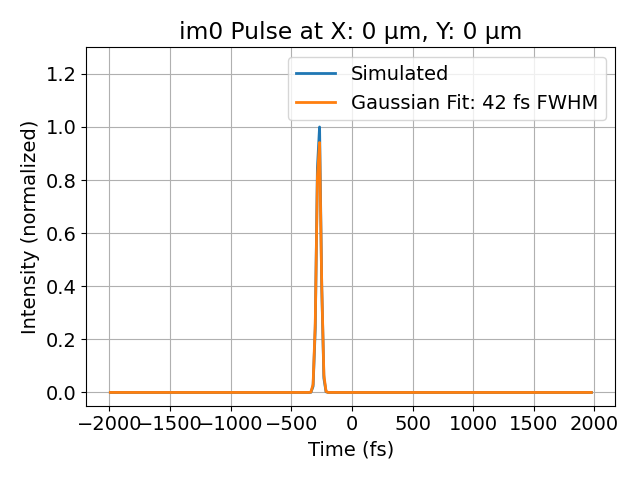

<IPython.core.display.Javascript object>


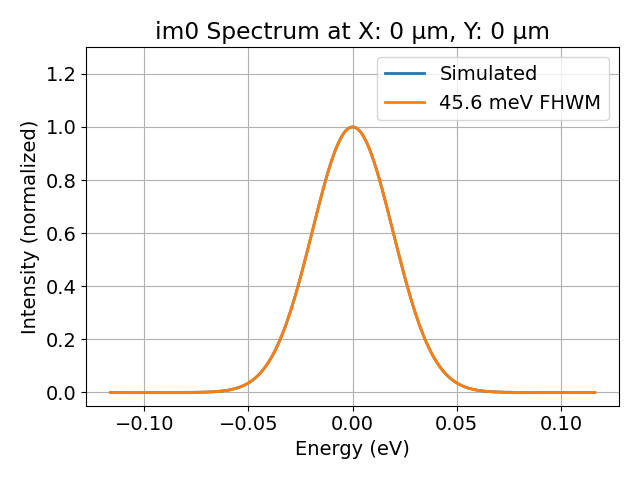

<IPython.core.display.Javascript object>


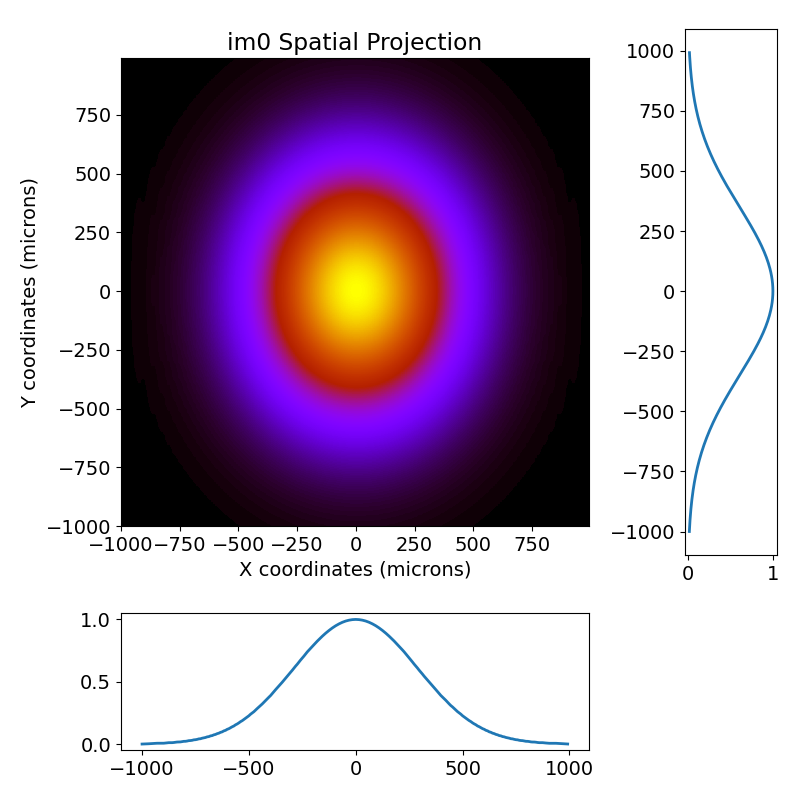

In [7]:
fig_path = '/Users/Matt/OneDrive - SLAC National Accelerator Laboratory/Projects/Tunable Mono/figures/Option3/'

# plot input pulse at beam center
pulse.plot_pulse('im0')
plt.savefig(fig_path+'input_pulse_slit.png')
# plot input spectrum at beam center
pulse.plot_spectrum('im0')
plt.savefig(fig_path+'input_spectrum_slit.png')
# plot input beam spatial projection
pulse.imshow_projection('im0')
plt.savefig(fig_path+'input_spatial_slit.png')

### Visualize focus properties

<IPython.core.display.Javascript object>


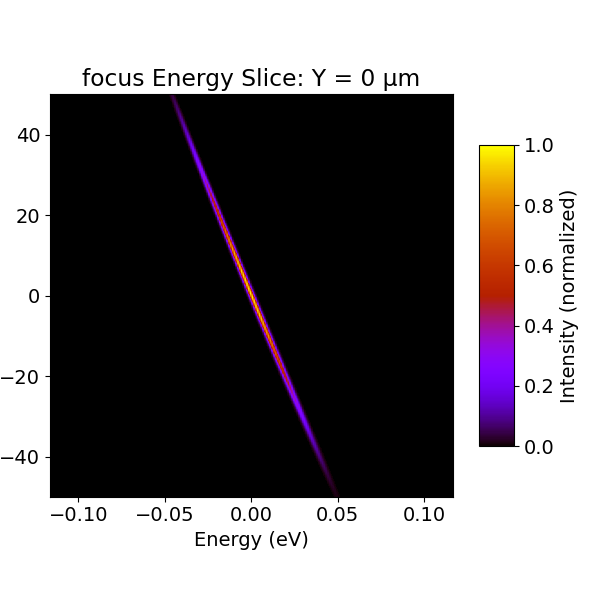

<IPython.core.display.Javascript object>


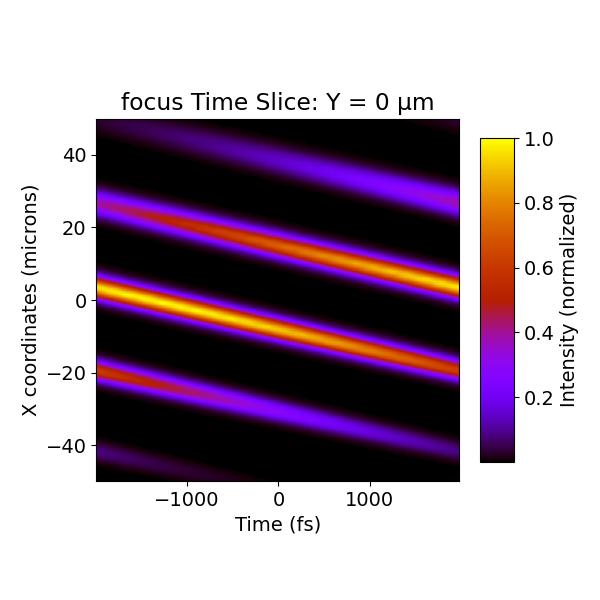

128


<IPython.core.display.Javascript object>


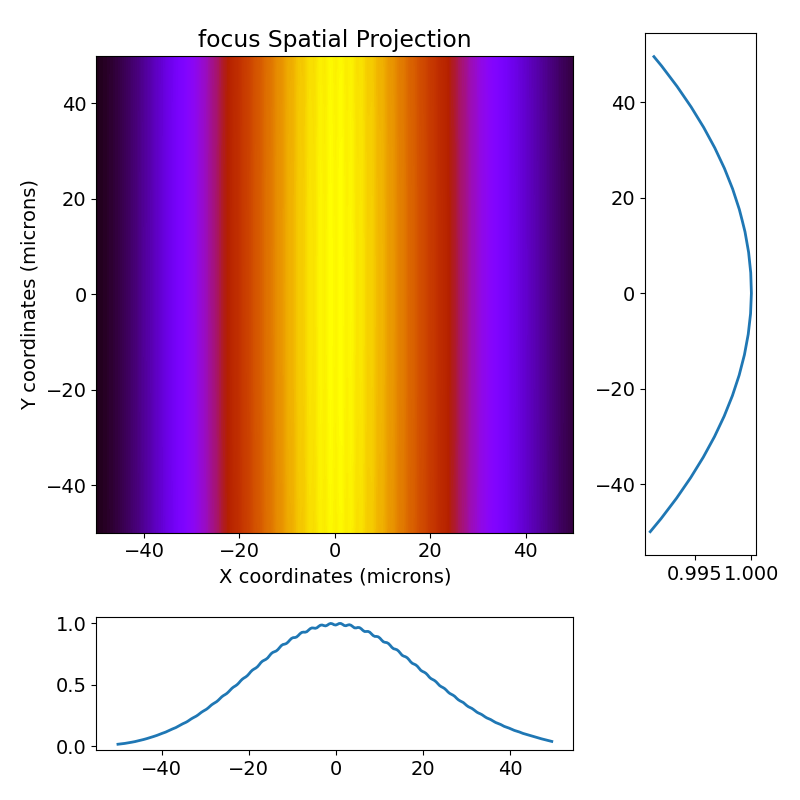

In [9]:
# plot energy slice of focus
pulse.imshow_energy_slice('focus')
plt.savefig(fig_path+'option3_focus_energy.png')
# plot time slice of focus
pulse.imshow_time_slice('focus', shift=965)
plt.savefig(fig_path+'option3_focus_time.png')
# show spatial projection
pulse.imshow_projection('focus')
plt.savefig(fig_path+'option3_focus_spatial.png')

### Visualize output

<IPython.core.display.Javascript object>


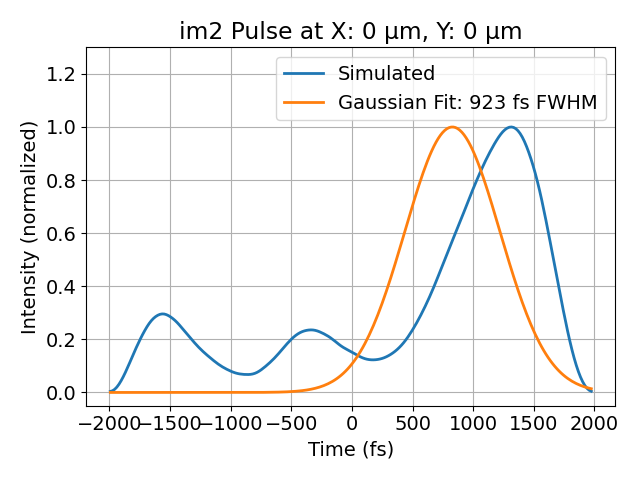

<IPython.core.display.Javascript object>


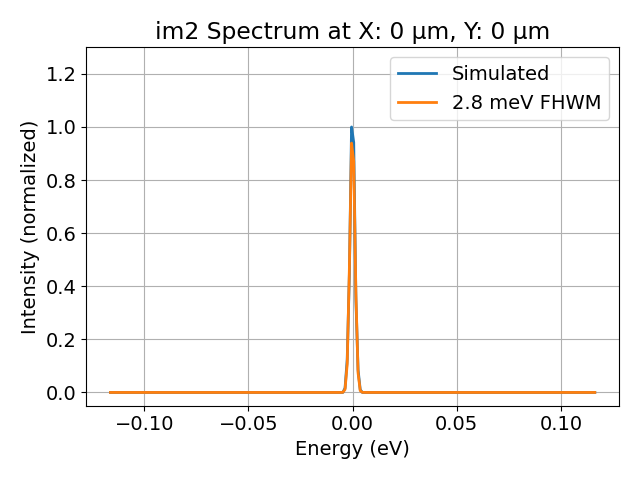

<IPython.core.display.Javascript object>


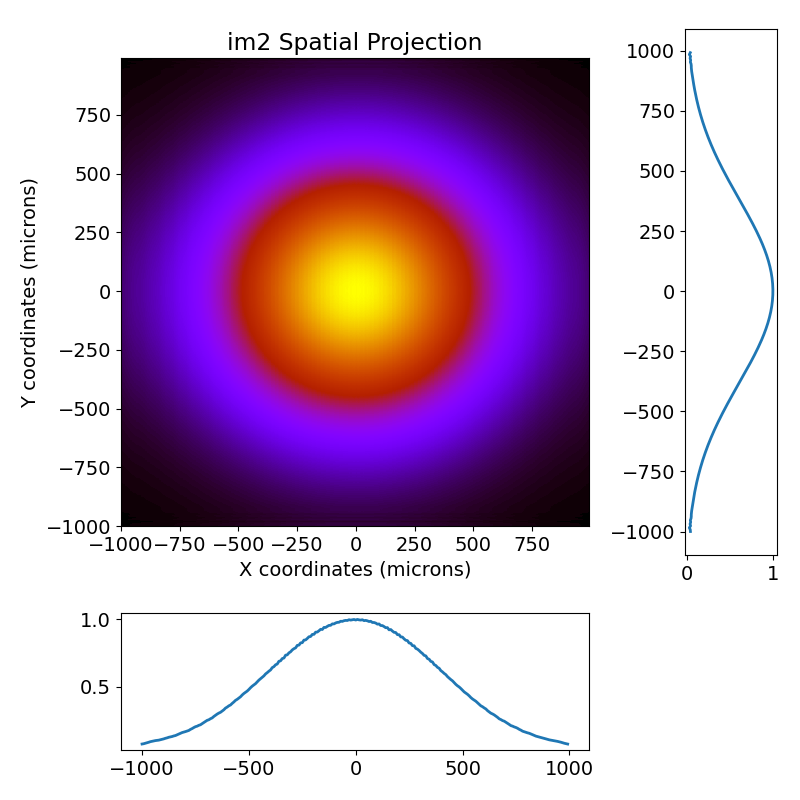

<IPython.core.display.Javascript object>


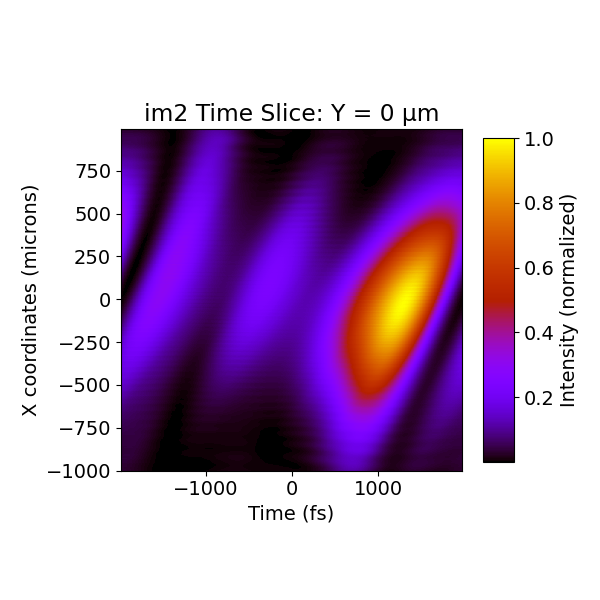

128


<IPython.core.display.Javascript object>


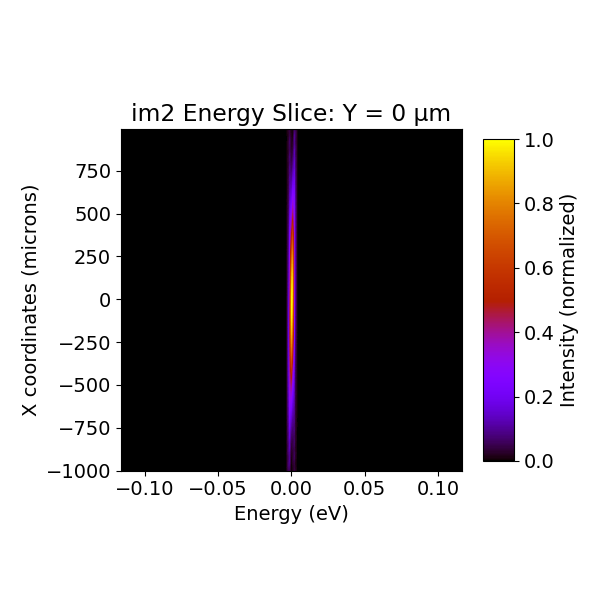

<IPython.core.display.Javascript object>


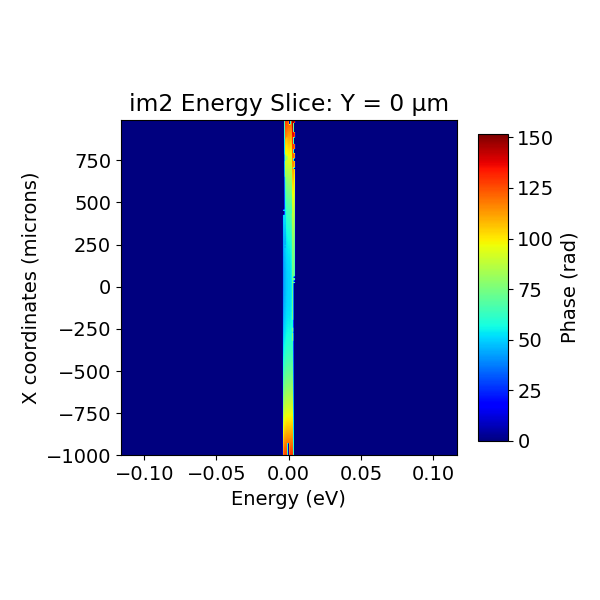

In [10]:
# plot output pulse at beam center
pulse.plot_pulse('im2', shift=400)
plt.savefig(fig_path+'option3_output_pulse.png')
# plot output spectraum at beam center
pulse.plot_spectrum('im2')
plt.savefig(fig_path+'option3_output_spectrum.png')
# show spatial projection of output
pulse.imshow_projection('im2')
plt.savefig(fig_path+'option3_output_spatial.png')
# show time slice of output
pulse.imshow_time_slice('im2', shift=400)
plt.savefig(fig_path+'option3_output_time.png')
# show energy slice of output
pulse.imshow_energy_slice('im2')
plt.savefig(fig_path+'option3_output_energy.png')
# show spectral phase slice of output
pulse.imshow_energy_slice('im2', image_type='phase')

# No slit

In [5]:
# list of devices to propagate through
devices = [crl0,im0,crystal1,crystal2,im_upstream, im1, m1, focus, m2, crystal3, crystal4, im2]
# devices = [im0,crystal1,crystal2,im_upstream, im1, crl1, focus, crl2, crystal3, crystal4, im2]

# initialize beamline
mono_beamline = beamline.Beamline(devices)


after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00


## Time-domain propagation

In [79]:
# reset central photon energy
beam_params['photonEnergy'] = 9000

# initialize pulse. tau sets transform-limited pulse duration in fs (FWHM). Time window is in fs.
pulse = beam.Pulse(beam_params=beam_params, tau=40, time_window=2000)

print('Number of spectral components: {:d}'.format(pulse.N))

Number of spectral components: 112


In [29]:
# propagate pulse through beamline. This will take a minute or so (depends on number of spectral 
# components which is proportional to the ratio time_window/tau).
pulse.propagate(beamline=mono_beamline, screen_names=['im2'])

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 40000000.00 microns
goal for zx: 19835960158.84 microns
current zx: 19795960158.84 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19835.960159
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19835.960159
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 1

Calculated distance to focus: 280.722708
zRx: 9.56e+03
zRy: 7.37e+01
zx: -280.746402
zy: 261.609619
azimuth -868.49 mrad
drift10
delta z: -7.30
zRx: 9558133022.00 microns
zRy: 73726257.70 microns
remaining distance: 1300624.87 microns
goal for zx: -279445777.21 microns
current zx: -280746402.08 microns
goal for zy: 262910243.61 microns
current zy: 261609618.74 microns
current step size: 1300624.87 microns
x remains focused
y stays unfocused
zx: -279.445777
zy: 262.910244
azimuth -868.49 mrad
c4
Calculated distance to focus: 18235.529413
zRx: 1.45e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18251.890981
zy: 262.910244
azimuth -0.12 mrad
drift11
delta z: 4.74
zRx: 618619033920.69 microns
zRy: 73726257.70 microns
remaining distance: 99763.79 microns
goal for zx: -18251791217.63 microns
current zx: -18251890981.43 microns
goal for zy: 263010007.40 microns
current zy: 262910243.61 microns
current step size: 99763.79 microns
x becomes focused
y stays unfocused
zx: -18251.791218
zy: 263.010007

zx: 19841.726018
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19841.726018
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19841.726017
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722716237166.17 microns
zRy: 73726326.25 microns
remaining distance: 309563.80 microns
goal for zx: 19842035580.43 microns
current zx: 19841726016.63 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19842.035580
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.827378
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.693233
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47086430803183.80 microns
zRy: 73726326.25 microns
remaining distance: 3200000.02 microns
goal for zx: 307893233.18 microns
current zx: 304693233.16 microns
goal for zy: 253509563.82 microns
current zy: 250309563.80 microns
current step size: 3200000.02 microns
x remains focused
y stays unfocused
z

zx: 0.037996
zy: 256.609614
azimuth 5.85 mrad
drift8
delta z: -555.70
zRx: 11346149191.20 microns
zRy: 73726360.52 microns
remaining distance: 3029846.26 microns
goal for zx: 3067842.04 microns
current zx: 37995.77 microns
goal for zy: 259639460.64 microns
current zy: 256609614.38 microns
current step size: 3029846.26 microns
x remains focused
y stays unfocused
zx: 3.067842
zy: 259.639461
azimuth 5.85 mrad
m2
zRx: 1.13e+00
zRy: 7.37e+01
x becomes unfocused
zx: -284.671451
zy: 259.639461
azimuth -0.20 mrad
drift9
delta z: 556.40
zRx: 9691612989.89 microns
zRy: 73726360.52 microns
remaining distance: 1970162.21 microns
goal for zx: -282701288.52 microns
current zx: -284671450.74 microns
goal for zy: 261609622.85 microns
current zy: 259639460.64 microns
current step size: 1970162.21 microns
x becomes focused
y stays unfocused
zx: -282.701289
zy: 261.609623
azimuth -0.20 mrad
c3
Calculated distance to focus: 282.701289
zRx: 9.69e+03
zRy: 7.37e+01
zx: -282.722647
zy: 261.609623
azimuth -868

zx: -18418.086382
zy: 263.009992
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119677331018
5.13119677331018
x is focused
y is focused
FWHM in x: 690.1245520326903 microns
FWHM in y: 690.1245520326903 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119677331018
5.13119677331018
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.493688
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721680026484.43 microns
zRy: 73726411.92 microns
remaining distance: 40000000.00 microns
goal for zx: 19827493687.81 microns
current zx: 19787493687.81 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19827.493688
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19827.493688
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721680026484.43 micron

zx: 19825.801263
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721556916521.25 microns
zRy: 73726446.20 microns
remaining distance: 10000000.00 microns
goal for zx: 19835801262.57 microns
current zx: 19825801262.57 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19835.801263
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19835.801263
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19835.801263
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722284996946.52 microns
zRy: 73726446.20 microns
remaining distance: 309563.80 microns
goal for zx: 19836110827.11 microns
current zx: 19835801263.31 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19836.110827
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.736358
zRx: 4.71e+07
zRy: 7.37e

zx: 0.032594
zy: 256.609614
azimuth 5.84 mrad
focus
zx: 0.032594
zy: 256.609614
azimuth 5.84 mrad
drift8
delta z: -572.72
zRx: 11338996359.27 microns
zRy: 73726480.47 microns
remaining distance: 3025888.08 microns
goal for zx: 3058481.76 microns
current zx: 32593.67 microns
goal for zy: 259635502.55 microns
current zy: 256609614.46 microns
current step size: 3025888.08 microns
x remains focused
y stays unfocused
zx: 3.058482
zy: 259.635503
azimuth 5.84 mrad
m2
zRx: 1.12e+00
zRy: 7.37e+01
x becomes unfocused
zx: -286.679254
zy: 259.635503
azimuth -0.19 mrad
drift9
delta z: 573.48
zRx: 9827610979.57 microns
zRy: 73726480.47 microns
remaining distance: 1974125.49 microns
goal for zx: -284705128.57 microns
current zx: -286679254.06 microns
goal for zy: 261609628.03 microns
current zy: 259635502.55 microns
current step size: 1974125.49 microns
x becomes focused
y stays unfocused
zx: -284.705129
zy: 261.609628
azimuth -0.19 mrad
c3
Calculated distance to focus: 284.705129
zRx: 9.83e+03
zRy: 

zx: 19822.417280
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19822.417280
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721310791252.38 microns
zRy: 73726514.74 microns
remaining distance: 10000000.00 microns
goal for zx: 19832417280.46 microns
current zx: 19822417280.46 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19832.417280
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19832.417280
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19832.417280
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722038747610.32 microns
zRy: 73726514.74 microns
remaining distance: 309563.80 microns
goal for zx: 19832726843.80 microns
current zx: 19832417280.00 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19832.726844
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 0.030282
zy: 256.609615
azimuth 5.84 mrad
focus
zx: 0.030282
zy: 256.609615
azimuth 5.84 mrad
drift8
delta z: -579.95
zRx: 11335933240.21 microns
zRy: 73726531.87 microns
remaining distance: 3024155.43 microns
goal for zx: 3054437.12 microns
current zx: 30281.68 microns
goal for zy: 259633769.94 microns
current zy: 256609614.50 microns
current step size: 3024155.43 microns
x remains focused
y stays unfocused
zx: 3.054437
zy: 259.633770
azimuth 5.84 mrad
m2
zRx: 1.12e+00
zRy: 7.37e+01
x becomes unfocused
zx: -287.438747
zy: 259.633770
azimuth -0.19 mrad
drift9
delta z: 580.73
zRx: 9879237260.34 microns
zRy: 73726531.87 microns
remaining distance: 1975860.44 microns
goal for zx: -285462886.07 microns
current zx: -287438746.52 microns
goal for zy: 261609630.38 microns
current zy: 259633769.94 microns
current step size: 1975860.44 microns
x becomes focused
y stays unfocused
zx: -285.462886
zy: 261.609630
azimuth -0.19 mrad
c3
Calculated distance to focus: 285.462886
zRx: 9.88e+03
zRy: 

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19829.034458
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721792624454.52 microns
zRy: 73726583.28 microns
remaining distance: 309563.80 microns
goal for zx: 19829344021.41 microns
current zx: 19829034457.61 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19829.344021
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.632402
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.538181
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47013962959708.21 microns
zRy: 73726583.28 microns
remaining distance: 3200000.03 microns
goal for zx: 307738180.71 microns
current zx: 304538180.69 microns
goal for zy: 253509563.83 microns
current zy: 250309563.80 microns
current step size: 3200000.03 microns
x remains focused
y stays unfocused
zx: 307.738181
zy: 253.509564
azimuth -0.13 mrad
im_upstream
zx: 307.738181
zy: 253.509564
azimuth

zx: 307.717521
zy: 253.509564
azimuth -0.13 mrad
im_upstream
zx: 307.717521
zy: 253.509564
azimuth -0.13 mrad
drift5
delta z: -854.15
zRx: 47004312177118.52 microns
zRy: 73726617.55 microns
remaining distance: 128358.51 microns
goal for zx: 307845879.38 microns
current zx: 307717520.87 microns
goal for zy: 253637922.33 microns
current zy: 253509563.83 microns
current step size: 128358.51 microns
x remains focused
y stays unfocused
zx: 307.845879
zy: 253.637922
azimuth -0.13 mrad
m1
28602.31936402329
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.945260
zy: 253.637922
azimuth 5.84 mrad
drift6
delta z: 854.17
zRx: 11330831209.52 microns
zRy: 73726617.55 microns
remaining distance: 71642.72 microns
goal for zx: -2873616.90 microns
current zx: -2945259.61 microns
goal for zy: 253709565.05 microns
current zy: 253637922.33 microns
current step size: 71642.72 microns
x remains focused
y stays unfocused
zx: -2.873617
zy: 253.709565
azimuth 5.84 mrad
im1
zx: -2.873617
zy: 253.709565
azimuth 5.84 mrad
drift

zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.950126
zy: 253.635363
azimuth 5.84 mrad
drift6
delta z: 852.83
zRx: 11327771888.71 microns
zRy: 73726668.96 microns
remaining distance: 74202.54 microns
goal for zx: -2875923.79 microns
current zx: -2950126.33 microns
goal for zy: 253709565.10 microns
current zy: 253635362.55 microns
current step size: 74202.54 microns
x remains focused
y stays unfocused
zx: -2.875924
zy: 253.709565
azimuth 5.84 mrad
im1
zx: -2.875924
zy: 253.709565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11327771888.71 microns
zRy: 73726668.96 microns
remaining distance: 2900049.51 microns
goal for zx: 24125.72 microns
current zx: -2875923.79 microns
goal for zy: 256609614.60 microns
current zy: 253709565.10 microns
current step size: 2900049.51 microns
x remains focused
y stays unfocused
zx: 0.024126
zy: 256.609615
azimuth 5.84 mrad
focus
zx: 0.024126
zy: 256.609615
azimuth 5.84 mrad
drift8
delta z: -598.99
zRx: 11327771888.71 microns
zRy: 73726668.96 microns
remaining distance

zx: -286.263804
zy: 262.910079
azimuth -868.51 mrad
c4
Calculated distance to focus: 18680.446954
zRx: 1.52e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18689.435080
zy: 262.910079
azimuth -0.12 mrad
drift11
delta z: 4.32
zRx: 648463769303.46 microns
zRy: 73726703.23 microns
remaining distance: 99880.95 microns
goal for zx: -18689335199.26 microns
current zx: -18689435080.21 microns
goal for zy: 263009960.18 microns
current zy: 262910079.22 microns
current step size: 99880.95 microns
x becomes focused
y stays unfocused
zx: -18689.335199
zy: 263.009960
azimuth -0.12 mrad
im2
zx: -18689.335199
zy: 263.009960
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218268295168
5.131218268295168
x is focused
y is focused
FWHM in x: 690.1216629607013 microns
FWHM in y: 690.1216629607013 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218268295168
5.131218268295168
c

zx: -18710.678568
zy: 263.009957
azimuth -0.12 mrad
im2
zx: -18710.678568
zy: 263.009957
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220656626833
5.131220656626833
x is focused
y is focused
FWHM in x: 690.121341954197 microns
FWHM in y: 690.121341954197 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220656626833
5.131220656626833
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19770.582453
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720450345582.31 microns
zRy: 73726754.63 microns
remaining distance: 40000000.00 microns
goal for zx: 19810582453.16 microns
current zx: 19770582453.16 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19810.582453
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19810.582453
zy: 240.000000
azimuth 

delta z: -6.87
zRx: 10085805088.86 microns
zRy: 73726806.04 microns
remaining distance: 1300399.15 microns
goal for zx: -287193120.40 microns
current zx: -288493519.56 microns
goal for zy: 262910043.20 microns
current zy: 261609644.04 microns
current step size: 1300399.15 microns
x remains focused
y stays unfocused
zx: -287.193120
zy: 262.910043
azimuth -868.51 mrad
c4
Calculated distance to focus: 18741.090478
zRx: 1.53e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18748.251280
zy: 262.910043
azimuth -0.12 mrad
drift11
delta z: 4.25
zRx: 652535966208.24 microns
zRy: 73726806.04 microns
remaining distance: 99906.63 microns
goal for zx: -18748151373.16 microns
current zx: -18748251279.79 microns
goal for zy: 263009949.83 microns
current zy: 262910043.20 microns
current step size: 99906.63 microns
x becomes focused
y stays unfocused
zx: -18748.151373
zy: 263.009950
azimuth -0.12 mrad
im2
zx: -18748.151373
zy: 263.009950
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.

FWHM in x: 690.120378936478 microns
FWHM in y: 690.120378936478 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131227821621829
5.131227821621829
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.514718
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720082055254.40 microns
zRy: 73726857.45 microns
remaining distance: 40000000.00 microns
goal for zx: 19805514718.02 microns
current zx: 19765514718.02 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.514718
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.514718
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720082055254.40 microns
zRy: 73726857.45 microns
remaining distance: 10000000.00 microns
goal for zx: 19815514718.02 microns
current zx: 19805514718.02 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x re

zx: -2.969534
zy: 253.625163
azimuth 5.84 mrad
drift6
delta z: 847.51
zRx: 11315548806.39 microns
zRy: 73726874.58 microns
remaining distance: 84401.89 microns
goal for zx: -2885132.31 microns
current zx: -2969534.20 microns
goal for zy: 253709565.27 microns
current zy: 253625163.39 microns
current step size: 84401.89 microns
x remains focused
y stays unfocused
zx: -2.885132
zy: 253.709565
azimuth 5.84 mrad
im1
zx: -2.885132
zy: 253.709565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11315548806.39 microns
zRy: 73726874.58 microns
remaining distance: 2900049.48 microns
goal for zx: 14917.17 microns
current zx: -2885132.31 microns
goal for zy: 256609614.76 microns
current zy: 253709565.27 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: 0.014917
zy: 256.609615
azimuth 5.84 mrad
focus
zx: 0.014917
zy: 256.609615
azimuth 5.84 mrad
drift8
delta z: -626.95
zRx: 11315548806.39 microns
zRy: 73726874.58 microns
remaining distance: 3012059.59 microns
goal fo

zx: 19801.293590
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19801.293590
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719775362720.17 microns
zRy: 73726943.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19811293589.55 microns
current zx: 19801293589.55 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19811.293590
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19811.293590
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19811.293590
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720502544617.70 microns
zRy: 73726943.13 microns
remaining distance: 309563.80 microns
goal for zx: 19811603154.09 microns
current zx: 19811293590.29 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19811.603154
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 307.500789
zy: 253.509564
azimuth -0.15 mrad
drift5
delta z: -844.86
zRx: 46903143445126.70 microns
zRy: 73726977.40 microns
remaining distance: 110523.81 microns
goal for zx: 307611312.58 microns
current zx: 307500788.77 microns
goal for zy: 253620087.65 microns
current zy: 253509563.83 microns
current step size: 110523.81 microns
x remains focused
y stays unfocused
zx: 307.611313
zy: 253.620088
azimuth -0.15 mrad
m1
10557.413753220686
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.979203
zy: 253.620088
azimuth 5.84 mrad
drift6
delta z: 844.87
zRx: 11309445771.73 microns
zRy: 73726977.40 microns
remaining distance: 89477.72 microns
goal for zx: -2889725.19 microns
current zx: -2979202.91 microns
goal for zy: 253709565.36 microns
current zy: 253620087.65 microns
current step size: 89477.72 microns
x remains focused
y stays unfocused
zx: -2.889725
zy: 253.709565
azimuth 5.84 mrad
im1
zx: -2.889725
zy: 253.709565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11309445771.73 microns
zRy: 73726977.4

zx: 19807.917985
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19807.917985
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19807.917985
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720257208138.47 microns
zRy: 73727011.67 microns
remaining distance: 309563.80 microns
goal for zx: 19808227548.59 microns
current zx: 19807917984.79 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.227549
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.307995
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.280166
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46893523963011.53 microns
zRy: 73727011.67 microns
remaining distance: 3200000.04 microns
goal for zx: 307480166.25 microns
current zx: 304280166.22 microns
goal for zy: 253509563.83 microns
current zy: 250309563.80 microns
current step size: 3200000.04 microns
x remains focused
y stays unfocused
z

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.249239
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46879099834863.39 microns
zRy: 73727063.07 microns
remaining distance: 3200000.04 microns
goal for zx: 307449238.57 microns
current zx: 304249238.54 microns
goal for zy: 253509563.84 microns
current zy: 250309563.80 microns
current step size: 3200000.04 microns
x remains focused
y stays unfocused
zx: 307.449239
zy: 253.509564
azimuth -0.15 mrad
im_upstream
zx: 307.449239
zy: 253.509564
azimuth -0.15 mrad
drift5
delta z: -842.67
zRx: 46879099834863.39 microns
zRy: 73727063.07 microns
remaining distance: 106306.10 microns
goal for zx: 307555544.67 microns
current zx: 307449238.57 microns
goal for zy: 253615869.93 microns
current zy: 253509563.84 microns
current step size: 106306.10 microns
x remains focused
y stays unfocused
zx: 307.555545
zy: 253.615870
azimuth -0.15 mrad
m1
6318.171976130824
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.987242
zy: 253.615870
azimuth 5.84 mrad
drift6
delta z: 842

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19803.700100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719950714093.65 microns
zRy: 73727097.35 microns
remaining distance: 309563.80 microns
goal for zx: 19804009663.89 microns
current zx: 19803700100.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19804.009664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.243197
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.228624
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46869487143249.05 microns
zRy: 73727097.35 microns
remaining distance: 3200000.04 microns
goal for zx: 307428624.20 microns
current zx: 304228624.16 microns
goal for zy: 253509563.84 microns
current zy: 250309563.80 microns
current step size: 3200000.04 microns
x remains focused
y stays unfocused
zx: 307.428624
zy: 253.509564
azimuth -0.16 mrad
im_upstream
zx: 307.428624
zy: 253.509564
azimuth

zx: 307.397709
zy: 253.509564
azimuth -0.16 mrad
drift5
delta z: -840.49
zRx: 46855073191256.22 microns
zRy: 73727148.75 microns
remaining distance: 102099.31 microns
goal for zx: 307499807.97 microns
current zx: 307397708.66 microns
goal for zy: 253611663.15 microns
current zy: 253509563.84 microns
current step size: 102099.31 microns
x remains focused
y stays unfocused
zx: 307.499808
zy: 253.611663
azimuth -0.16 mrad
m1
2100.6529099019076
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.995266
zy: 253.611663
azimuth 5.84 mrad
drift6
delta z: 840.50
zRx: 11299286598.92 microns
zRy: 73727148.75 microns
remaining distance: 97902.36 microns
goal for zx: -2897363.20 microns
current zx: -2995265.56 microns
goal for zy: 253709565.51 microns
current zy: 253611663.15 microns
current step size: 97902.36 microns
x remains focused
y stays unfocused
zx: -2.897363
zy: 253.709566
azimuth 5.84 mrad
im1
zx: -2.897363
zy: 253.709566
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11299286598.92 microns
zRy: 73727148.7

zx: 307.466381
zy: 253.609144
azimuth -0.16 mrad
m1
-419.48405980502736
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.000072
zy: 253.609144
azimuth 5.84 mrad
drift6
delta z: 839.19
zRx: 11296241907.08 microns
zRy: 73727200.16 microns
remaining distance: 100421.25 microns
goal for zx: -2899650.52 microns
current zx: -3000071.77 microns
goal for zy: 253709565.55 microns
current zy: 253609144.30 microns
current step size: 100421.25 microns
x remains focused
y stays unfocused
zx: -2.899651
zy: 253.709566
azimuth 5.84 mrad
im1
zx: -2.899651
zy: 253.709566
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11296241907.08 microns
zRy: 73727200.16 microns
remaining distance: 2900049.45 microns
goal for zx: 398.93 microns
current zx: -2899650.52 microns
goal for zy: 256609615.00 microns
current zy: 253709565.55 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: 0.000399
zy: 256.609615
azimuth 5.84 mrad
focus
zx: 0.000399
zy: 256.609615
azimuth 5.84 mrad
drift8
delta z: -669.83

zRx: 1.02e+04
zRy: 7.37e+01
zx: -289.880766
zy: 261.609669
azimuth -868.53 mrad
drift10
delta z: -6.77
zRx: 10179891174.22 microns
zRy: 73727234.43 microns
remaining distance: 1300229.09 microns
goal for zx: -288580536.57 microns
current zx: -289880765.66 microns
goal for zy: 262909897.91 microns
current zy: 261609668.82 microns
current step size: 1300229.09 microns
x remains focused
y stays unfocused
zx: -288.580537
zy: 262.909898
azimuth -868.53 mrad
c4
Calculated distance to focus: 18831.627785
zRx: 1.55e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18830.808322
zy: 262.909898
azimuth -0.12 mrad
drift11
delta z: 4.07
zRx: 658319587329.67 microns
zRy: 73727234.43 microns
remaining distance: 100010.18 microns
goal for zx: -18830708311.75 microns
current zx: -18830808321.94 microns
goal for zy: 263009908.09 microns
current zy: 262909897.91 microns
current step size: 100010.18 microns
x becomes focused
y stays unfocused
zx: -18830.708312
zy: 263.009908
azimuth -0.12 mrad
im2
zx: -18830.708

zx: 307.410694
zy: 253.604955
azimuth -0.16 mrad
m1
-4602.508409695076
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.008069
zy: 253.604955
azimuth 5.84 mrad
drift6
delta z: 837.03
zRx: 11291170539.67 microns
zRy: 73727285.84 microns
remaining distance: 104610.71 microns
goal for zx: -2903458.56 microns
current zx: -3008069.28 microns
goal for zy: 253709565.63 microns
current zy: 253604954.92 microns
current step size: 104610.71 microns
x remains focused
y stays unfocused
zx: -2.903459
zy: 253.709566
azimuth 5.84 mrad
im1
zx: -2.903459
zy: 253.709566
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11291170539.67 microns
zRy: 73727285.84 microns
remaining distance: 2900049.44 microns
goal for zx: -3409.12 microns
current zx: -2903458.56 microns
goal for zy: 256609615.07 microns
current zy: 253709565.63 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.003409
zy: 256.609615
azimuth 5.84 mrad
focus
zx: -0.003409
zy: 256.609615
azimuth 5.84 mrad
drift8
delta z: -680

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131260064099311
5.131260064099311
x is focused
y is focused
FWHM in x: 690.1160453900351 microns
FWHM in y: 690.1160453900351 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131260064099311
5.131260064099311
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19742.742023
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718428244771.86 microns
zRy: 73727320.11 microns
remaining distance: 40000000.00 microns
goal for zx: 19782742023.01 microns
current zx: 19742742023.01 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19782.742023
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19782.742023
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718428244771.86 microns
zRy: 73727320.11 microns
remaining distance: 1

zx: -288.354112
zy: 262.909864
azimuth -868.54 mrad
c4
Calculated distance to focus: 18816.852234
zRx: 1.54e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18814.051586
zy: 262.909864
azimuth -0.12 mrad
drift11
delta z: 4.05
zRx: 657174696817.71 microns
zRy: 73727337.24 microns
remaining distance: 100034.53 microns
goal for zx: -18813951551.41 microns
current zx: -18814051585.94 microns
goal for zy: 263009898.28 microns
current zy: 262909863.75 microns
current step size: 100034.53 microns
x becomes focused
y stays unfocused
zx: -18813.951551
zy: 263.009898
azimuth -0.12 mrad
im2
zx: -18813.951551
zy: 263.009898
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131262452430977
5.131262452430977
x is focused
y is focused
FWHM in x: 690.115724388762 microns
FWHM in y: 690.115724388762 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131262452430977
5.131262452430977
c

zx: -2.907261
zy: 253.709566
azimuth 5.84 mrad
im1
zx: -2.907261
zy: 253.709566
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11286103078.09 microns
zRy: 73727371.51 microns
remaining distance: 2900049.44 microns
goal for zx: -7211.98 microns
current zx: -2907261.41 microns
goal for zy: 256609615.14 microns
current zy: 253709565.70 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.007212
zy: 256.609615
azimuth 5.84 mrad
focus
zx: -0.007212
zy: 256.609615
azimuth 5.84 mrad
drift8
delta z: -691.70
zRx: 11286103078.09 microns
zRy: 73727371.51 microns
remaining distance: 2992896.97 microns
goal for zx: 2985684.99 microns
current zx: -7211.98 microns
goal for zy: 259602512.10 microns
current zy: 256609615.14 microns
current step size: 2992896.97 microns
x remains focused
y stays unfocused
zx: 2.985685
zy: 259.602512
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: -291.546443
zy: 259.602512
azimuth -0.15 mrad
drift9
delta z: 692.

zx: 19788.530615
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19788.530615
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19788.530613
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718848957338.91 microns
zRy: 73727405.78 microns
remaining distance: 309563.80 microns
goal for zx: 19788840176.88 microns
current zx: 19788530613.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19788.840177
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.010153
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.043240
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46783094875959.07 microns
zRy: 73727405.78 microns
remaining distance: 3200000.05 microns
goal for zx: 307243240.35 microns
current zx: 304043240.31 microns
goal for zy: 253509563.84 microns
current zy: 250309563.80 microns
current step size: 3200000.05 microns
x remains focused
y stays unfocused
z

Calculated distance to focus: 289.320273
zRx: 1.01e+04
zRy: 7.37e+01
zx: -289.313802
zy: 261.609681
azimuth -868.54 mrad
drift10
delta z: -6.79
zRx: 10139341409.89 microns
zRy: 73727422.92 microns
remaining distance: 1300154.53 microns
goal for zx: -288013647.78 microns
current zx: -289313802.31 microns
goal for zy: 262909835.36 microns
current zy: 261609680.83 microns
current step size: 1300154.53 microns
x remains focused
y stays unfocused
zx: -288.013648
zy: 262.909835
azimuth -868.54 mrad
c4
Calculated distance to focus: 18794.634858
zRx: 1.54e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18790.169786
zy: 262.909835
azimuth -0.12 mrad
drift11
delta z: 4.04
zRx: 655534840546.62 microns
zRy: 73727422.92 microns
remaining distance: 100054.76 microns
goal for zx: -18790069731.12 microns
current zx: -18790169785.88 microns
goal for zy: 263009890.12 microns
current zy: 262909835.36 microns
current step size: 100054.76 microns
x becomes focused
y stays unfocused
zx: -18790.069731
zy: 263.009

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.012368
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46768717482220.42 microns
zRy: 73727457.19 microns
remaining distance: 3200000.05 microns
goal for zx: 307212368.51 microns
current zx: 304012368.47 microns
goal for zy: 253509563.85 microns
current zy: 250309563.80 microns
current step size: 3200000.05 microns
x remains focused
y stays unfocused
zx: 307.212369
zy: 253.509564
azimuth -0.17 mrad
im_upstream
zx: 307.212369
zy: 253.509564
azimuth -0.17 mrad
drift5
delta z: -832.70
zRx: 46768717482220.42 microns
zRy: 73727457.19 microns
remaining distance: 87044.70 microns
goal for zx: 307299413.22 microns
current zx: 307212368.51 microns
goal for zy: 253596608.55 microns
current zy: 253509563.85 microns
current step size: 87044.70 microns
x remains focused
y stays unfocused
zx: 307.299413
zy: 253.596609
azimuth -0.17 mrad
m1
-12904.489723899527
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.024016
zy: 253.596609
azimuth 5.84 mrad
drift6
delta z: 832

zRx: 1.01e+04
zRy: 7.37e+01
zx: -289.046041
zy: 261.609684
azimuth -868.54 mrad
drift10
delta z: -6.80
zRx: 10120432905.34 microns
zRy: 73727474.33 microns
remaining distance: 1300134.14 microns
goal for zx: -287745906.61 microns
current zx: -289046040.75 microns
goal for zy: 262909818.34 microns
current zy: 261609684.20 microns
current step size: 1300134.14 microns
x remains focused
y stays unfocused
zx: -287.745907
zy: 262.909818
azimuth -868.54 mrad
c4
Calculated distance to focus: 18777.163126
zRx: 1.54e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18771.694496
zy: 262.909818
azimuth -0.12 mrad
drift11
delta z: 4.04
zRx: 654265235690.91 microns
zRy: 73727474.33 microns
remaining distance: 100066.89 microns
goal for zx: -18771594429.42 microns
current zx: -18771694496.31 microns
goal for zy: 263009885.24 microns
current zy: 262909818.34 microns
current step size: 100066.89 microns
x becomes focused
y stays unfocused
zx: -18771.594429
zy: 263.009885
azimuth -0.12 mrad
im2
zx: -18771.594

zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.932551
zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.981504
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46754346186464.79 microns
zRy: 73727508.60 microns
remaining distance: 3200000.05 microns
goal for zx: 307181504.03 microns
current zx: 303981503.98 microns
goal for zy: 253509563.85 microns
current zy: 250309563.80 microns
current step size: 3200000.05 microns
x remains focused
y stays unfocused
zx: 307.181504
zy: 253.509564
azimuth -0.17 mrad
im_upstream
zx: 307.181504
zy: 253.509564
azimuth -0.17 mrad
drift5
delta z: -831.41
zRx: 46754346186464.79 microns
zRy: 73727508.60 microns
remaining distance: 84549.18 microns
goal for zx: 307266053.21 microns
current zx: 307181504.03 microns
goal for zy: 253594113.03 microns
current zy: 253509563.85 microns
current step size: 84549.18 microns
x remains focused
y stays unfocused
zx: 307.266053
zy: 253.594113
azimuth -0.17 mrad
m1
-15378.542076479687
zRx: 1.13e+04


delta z: -830.56
zRx: 46744768672386.59 microns
zRy: 73727542.87 microns
remaining distance: 82887.64 microns
goal for zx: 307243819.32 microns
current zx: 307160931.68 microns
goal for zy: 253592451.49 microns
current zy: 253509563.85 microns
current step size: 82887.64 microns
x remains focused
y stays unfocused
zx: 307.243819
zy: 253.592451
azimuth -0.18 mrad
m1
-17023.693268915562
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.031966
zy: 253.592451
azimuth 5.84 mrad
drift6
delta z: 830.57
zRx: 11275979842.86 microns
zRy: 73727542.87 microns
remaining distance: 117114.36 microns
goal for zx: -2914851.59 microns
current zx: -3031965.95 microns
goal for zy: 253709565.84 microns
current zy: 253592451.49 microns
current step size: 117114.36 microns
x remains focused
y stays unfocused
zx: -2.914852
zy: 253.709566
azimuth 5.84 mrad
im1
zx: -2.914852
zy: 253.709566
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11275979842.86 microns
zRy: 73727542.87 microns
remaining distance: 2900049.43 microns
goal f

zRy: 7.37e+01
x becomes unfocused
zx: -18734.290425
zy: 262.909790
azimuth -0.12 mrad
drift11
delta z: 4.05
zRx: 651695701011.80 microns
zRy: 73727560.00 microns
remaining distance: 100087.12 microns
goal for zx: -18734190337.46 microns
current zx: -18734290424.57 microns
goal for zy: 263009877.08 microns
current zy: 262909789.97 microns
current step size: 100087.12 microns
x becomes focused
y stays unfocused
zx: -18734.190337
zy: 263.009877
azimuth -0.12 mrad
im2
zx: -18734.190337
zy: 263.009877
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131277976586801
5.131277976586801
x is focused
y is focused
FWHM in x: 690.1136378877733 microns
FWHM in y: 690.1136378877733 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131277976586801
5.131277976586801
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19730.113186
zy: 200.000000
azimuth 0.00 mrad
drift1


zRy: 7.37e+01
x becomes unfocused
zx: -290.273004
zy: 259.593325
azimuth -0.14 mrad
drift9
delta z: 720.59
zRx: 10064186381.02 microns
zRy: 73727594.28 microns
remaining distance: 2016367.19 microns
goal for zx: -288256637.04 microns
current zx: -290273004.22 microns
goal for zy: 261609692.23 microns
current zy: 259593325.04 microns
current step size: 2016367.19 microns
x becomes focused
y stays unfocused
zx: -288.256637
zy: 261.609692
azimuth -0.14 mrad
c3
Calculated distance to focus: 288.256637
zRx: 1.01e+04
zRy: 7.37e+01
zx: -288.245300
zy: 261.609692
azimuth -868.55 mrad
drift10
delta z: -6.84
zRx: 10064186381.02 microns
zRy: 73727594.28 microns
remaining distance: 1300086.37 microns
goal for zx: -286945213.42 microns
current zx: -288245299.79 microns
goal for zy: 262909778.60 microns
current zy: 261609692.23 microns
current step size: 1300086.37 microns
x remains focused
y stays unfocused
zx: -286.945213
zy: 262.909779
azimuth -868.55 mrad
c4
Calculated distance to focus: 18724.9

x remains focused
y stays unfocused
zx: 19777.898920
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.842066
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.909515
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46720836740381.13 microns
zRy: 73727628.55 microns
remaining distance: 3200000.05 microns
goal for zx: 307109514.96 microns
current zx: 303909514.91 microns
goal for zy: 253509563.85 microns
current zy: 250309563.80 microns
current step size: 3200000.05 microns
x remains focused
y stays unfocused
zx: 307.109515
zy: 253.509564
azimuth -0.18 mrad
im_upstream
zx: 307.109515
zy: 253.509564
azimuth -0.18 mrad
drift5
delta z: -828.42
zRx: 46720836740381.13 microns
zRy: 73727628.55 microns
remaining distance: 78741.27 microns
goal for zx: 307188256.23 microns
current zx: 307109514.96 microns
goal for zy: 253588305.12 microns
current zy: 253509563.85 microns
current step size: 78741.27 microns
x remains focused
y stays unfocused
zx: 307.188256
zy: 253.588305
azi

zx: 303.888954
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46711268693571.51 microns
zRy: 73727662.82 microns
remaining distance: 3200000.05 microns
goal for zx: 307088953.95 microns
current zx: 303888953.90 microns
goal for zy: 253509563.85 microns
current zy: 250309563.80 microns
current step size: 3200000.05 microns
x remains focused
y stays unfocused
zx: 307.088954
zy: 253.509564
azimuth -0.18 mrad
im_upstream
zx: 307.088954
zy: 253.509564
azimuth -0.18 mrad
drift5
delta z: -827.57
zRx: 46711268693571.51 microns
zRy: 73727662.82 microns
remaining distance: 77085.70 microns
goal for zx: 307166039.66 microns
current zx: 307088953.95 microns
goal for zy: 253586649.56 microns
current zy: 253509563.85 microns
current step size: 77085.70 microns
x remains focused
y stays unfocused
zx: 307.166040
zy: 253.586650
azimuth -0.18 mrad
m1
-22755.277652089215
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.043069
zy: 253.586650
azimuth 5.84 mrad
drift6
delta z: 827.58
zRx: 11268902827.50 micr

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286335747629
5.131286335747629
x is focused
y is focused
FWHM in x: 690.112514392472 microns
FWHM in y: 690.112514392472 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286335747629
5.131286335747629
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19724.225256
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717084911997.89 microns
zRy: 73727697.09 microns
remaining distance: 40000000.00 microns
goal for zx: 19764225255.60 microns
current zx: 19724225255.60 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19764.225256
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19764.225256
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717084911997.89 microns
zRy: 73727697.09 microns
remaining distance: 100

delta z: -0.00
zRx: 11265872146.83 microns
zRy: 73727714.22 microns
remaining distance: 2900049.42 microns
goal for zx: -22371.79 microns
current zx: -2922421.21 microns
goal for zy: 256609615.41 microns
current zy: 253709565.99 microns
current step size: 2900049.42 microns
x remains focused
y stays unfocused
zx: -0.022372
zy: 256.609615
azimuth 5.84 mrad
focus
zx: -0.022372
zy: 256.609615
azimuth 5.84 mrad
drift8
delta z: -734.07
zRx: 11265872146.83 microns
zRy: 73727714.22 microns
remaining distance: 2978614.94 microns
goal for zx: 2956243.15 microns
current zx: -22371.79 microns
goal for zy: 259588230.35 microns
current zy: 256609615.41 microns
current step size: 2978614.94 microns
x remains focused
y stays unfocused
zx: 2.956243
zy: 259.588230
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: -289.249460
zy: 259.588230
azimuth -0.14 mrad
drift9
delta z: 735.24
zRx: 9992122467.91 microns
zRy: 73727714.22 microns
remaining distance: 2021470.09 microns
goal for 

zy: 256.609615
azimuth 5.84 mrad
drift8
delta z: -738.21
zRx: 11263852465.88 microns
zRy: 73727748.49 microns
remaining distance: 2977140.59 microns
goal for zx: 2953257.33 microns
current zx: -23883.26 microns
goal for zy: 259586756.03 microns
current zy: 256609615.44 microns
current step size: 2977140.59 microns
x remains focused
y stays unfocused
zx: 2.953257
zy: 259.586756
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: -288.917406
zy: 259.586756
azimuth -0.13 mrad
drift9
delta z: 739.39
zRx: 9968848201.43 microns
zRy: 73727748.49 microns
remaining distance: 2022946.79 microns
goal for zx: -286894459.66 microns
current zx: -288917406.45 microns
goal for zy: 261609702.83 microns
current zy: 259586756.03 microns
current step size: 2022946.79 microns
x becomes focused
y stays unfocused
zx: -286.894460
zy: 261.609703
azimuth -0.13 mrad
c3
Calculated distance to focus: 286.894460
zRx: 9.97e+03
zRy: 7.37e+01
zx: -286.878711
zy: 261.609703
azimuth -868.56 mrad
dri

Calculated distance to focus: 18612.802979
zRx: 1.51e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18601.261514
zy: 262.909716
azimuth -0.12 mrad
drift11
delta z: 4.09
zRx: 642585329583.04 microns
zRy: 73727782.77 microns
remaining distance: 100139.99 microns
goal for zx: -18601161373.57 microns
current zx: -18601261513.55 microns
goal for zy: 263009855.78 microns
current zy: 262909715.79 microns
current step size: 100139.99 microns
x becomes focused
y stays unfocused
zx: -18601.161374
zy: 263.009856
azimuth -0.12 mrad
im2
zx: -18601.161374
zy: 263.009856
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312935007426255
5.1312935007426255
x is focused
y is focused
FWHM in x: 690.1115513994135 microns
FWHM in y: 690.1115513994135 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312935007426255
5.1312935007426255
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202

delta z: -746.43
zRx: 11259814965.11 microns
zRy: 73727817.04 microns
remaining distance: 2974167.18 microns
goal for zx: 2947263.43 microns
current zx: -26903.75 microns
goal for zy: 259583782.67 microns
current zy: 256609615.49 microns
current step size: 2974167.18 microns
x remains focused
y stays unfocused
zx: 2.947263
zy: 259.583783
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: -288.203052
zy: 259.583783
azimuth -0.13 mrad
drift9
delta z: 747.62
zRx: 9918924508.58 microns
zRy: 73727817.04 microns
remaining distance: 2025924.96 microns
goal for zx: -286177126.86 microns
current zx: -288203051.81 microns
goal for zy: 261609707.63 microns
current zy: 259583782.67 microns
current step size: 2025924.96 microns
x becomes focused
y stays unfocused
zx: -286.177127
zy: 261.609708
azimuth -0.13 mrad
c3
Calculated distance to focus: 286.177127
zRx: 9.92e+03
zRy: 7.37e+01
zx: -286.159411
zy: 261.609708
azimuth -868.56 mrad
drift10
delta z: -6.96
zRx: 9918924508.58 m

Calculated distance to focus: -303.674164
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.775926
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46658692583336.64 microns
zRy: 73727851.31 microns
remaining distance: 3200000.06 microns
goal for zx: 306975925.91 microns
current zx: 303775925.85 microns
goal for zy: 253509563.86 microns
current zy: 250309563.80 microns
current step size: 3200000.06 microns
x remains focused
y stays unfocused
zx: 306.975926
zy: 253.509564
azimuth -0.19 mrad
im_upstream
zx: 306.975926
zy: 253.509564
azimuth -0.19 mrad
drift5
delta z: -822.91
zRx: 46658692583336.64 microns
zRy: 73727851.31 microns
remaining distance: 68010.45 microns
goal for zx: 307043936.36 microns
current zx: 306975925.91 microns
goal for zy: 253577574.31 microns
current zy: 253509563.86 microns
current step size: 68010.45 microns
x remains focused
y stays unfocused
zx: 307.043936
zy: 253.577574
azimuth -0.19 mrad
m1
-31679.577966089008
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.060454
zy: 253.57

delta z: 0.00
zRx: 716414660619.34 microns
zRy: 73727885.58 microns
remaining distance: 10000000.00 microns
goal for zx: 19764979890.97 microns
current zx: 19754979890.97 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19764.979891
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19764.979891
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19764.979891
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717140144512.17 microns
zRy: 73727885.58 microns
remaining distance: 309563.80 microns
goal for zx: 19765289454.80 microns
current zx: 19764979891.00 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19765.289455
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.648350
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.755386
zy: 250.309564
azimuth -0.19 mrad
drif

zx: 19763.609410
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.622540
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.734849
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46639594197559.76 microns
zRy: 73727919.85 microns
remaining distance: 3200000.06 microns
goal for zx: 306934848.98 microns
current zx: 303734848.92 microns
goal for zy: 253509563.86 microns
current zy: 250309563.80 microns
current step size: 3200000.06 microns
x remains focused
y stays unfocused
zx: 306.934849
zy: 253.509564
azimuth -0.19 mrad
im_upstream
zx: 306.934849
zy: 253.509564
azimuth -0.19 mrad
drift5
delta z: -821.22
zRx: 46639594197559.76 microns
zRy: 73727919.85 microns
remaining distance: 64723.04 microns
goal for zx: 306999572.02 microns
current zx: 306934848.98 microns
goal for zy: 253574286.89 microns
current zy: 253509563.86 microns
current step size: 64723.04 microns
x remains focused
y stays unfocused
zx: 306.999572
zy: 253.574287
azimuth -0.19 mrad
m1
-34899.9962225794

FWHM in x: 690.1101069148702 microns
FWHM in y: 690.1101069148702 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130424823512
5.13130424823512
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19711.620089
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716171166239.74 microns
zRy: 73727954.12 microns
remaining distance: 40000000.00 microns
goal for zx: 19751620088.73 microns
current zx: 19711620088.73 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19751.620089
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19751.620089
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716171166239.74 microns
zRy: 73727954.12 microns
remaining distance: 10000000.00 microns
goal for zx: 19761620088.73 microns
current zx: 19751620088.73 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x re

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.071478
zy: 253.571826
azimuth 5.84 mrad
drift6
delta z: 819.98
zRx: 11250739633.07 microns
zRy: 73727971.26 microns
remaining distance: 137740.46 microns
goal for zx: -2933737.38 microns
current zx: -3071477.84 microns
goal for zy: 253709566.21 microns
current zy: 253571825.75 microns
current step size: 137740.46 microns
x remains focused
y stays unfocused
zx: -2.933737
zy: 253.709566
azimuth 5.84 mrad
im1
zx: -2.933737
zy: 253.709566
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11250739633.07 microns
zRy: 73727971.26 microns
remaining distance: 2900049.41 microns
goal for zx: -33687.97 microns
current zx: -2933737.38 microns
goal for zy: 256609615.62 microns
current zy: 253709566.21 microns
current step size: 2900049.41 microns
x remains focused
y stays unfocused
zx: -0.033688
zy: 256.609616
azimuth 5.84 mrad
focus
zx: -0.033688
zy: 256.609616
azimuth 5.84 mrad
drift8
delta z: -764.65
zRx: 11250739633.07 microns
zRy: 73727971.26 microns
remaining dis

zRy: 73728005.53 microns
remaining distance: 60623.23 microns
goal for zx: 306944144.15 microns
current zx: 306883520.93 microns
goal for zy: 253570187.09 microns
current zy: 253509563.86 microns
current step size: 60623.23 microns
x remains focused
y stays unfocused
zx: 306.944144
zy: 253.570187
azimuth -0.20 mrad
m1
-38907.074933242286
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.074622
zy: 253.570187
azimuth 5.84 mrad
drift6
delta z: 819.14
zRx: 11248724587.37 microns
zRy: 73728005.53 microns
remaining distance: 139379.15 microns
goal for zx: -2935242.76 microns
current zx: -3074621.91 microns
goal for zy: 253709566.24 microns
current zy: 253570187.09 microns
current step size: 139379.15 microns
x remains focused
y stays unfocused
zx: -2.935243
zy: 253.709566
azimuth 5.84 mrad
im1
zx: -2.935243
zy: 253.709566
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11248724587.37 microns
zRy: 73728005.53 microns
remaining distance: 2900049.41 microns
goal for zx: -35193.35 microns
current zx: -2935242.76

zx: 19747.421946
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19747.421946
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715866973112.33 microns
zRy: 73728039.80 microns
remaining distance: 10000000.00 microns
goal for zx: 19757421945.93 microns
current zx: 19747421945.93 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19757.421946
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19757.421946
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19757.421947
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716592179907.30 microns
zRy: 73728039.80 microns
remaining distance: 309563.80 microns
goal for zx: 19757731510.77 microns
current zx: 19757421946.98 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19757.731511
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

delta z: -0.00
zRx: 11245703176.40 microns
zRy: 73728056.93 microns
remaining distance: 2900049.41 microns
goal for zx: -37449.90 microns
current zx: -2937499.31 microns
goal for zy: 256609615.69 microns
current zy: 253709566.28 microns
current step size: 2900049.41 microns
x remains focused
y stays unfocused
zx: -0.037450
zy: 256.609616
azimuth 5.84 mrad
focus
zx: -0.037450
zy: 256.609616
azimuth 5.84 mrad
drift8
delta z: -774.64
zRx: 11245703176.40 microns
zRy: 73728056.93 microns
remaining distance: 2963504.62 microns
goal for zx: 2926054.71 microns
current zx: -37449.90 microns
goal for zy: 259573120.30 microns
current zy: 256609615.69 microns
current step size: 2963504.62 microns
x remains focused
y stays unfocused
zx: 2.926055
zy: 259.573120
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: -285.229123
zy: 259.573120
azimuth -0.12 mrad
drift9
delta z: 775.87
zRx: 9712917926.78 microns
zRy: 73728056.93 microns
remaining distance: 2036604.49 microns
goal for 

Calculated distance to focus: 18362.201562
zRx: 1.47e+02
zRy: 7.37e+01
x becomes unfocused
zx: -18344.555392
zy: 262.909611
azimuth -0.12 mrad
drift11
delta z: 4.23
zRx: 625168929904.20 microns
zRy: 73728091.21 microns
remaining distance: 100214.81 microns
goal for zx: -18344455176.87 microns
current zx: -18344555391.68 microns
goal for zy: 263009825.62 microns
current zy: 262909610.81 microns
current step size: 100214.81 microns
x becomes focused
y stays unfocused
zx: -18344.455177
zy: 263.009826
azimuth -0.12 mrad
im2
zx: -18344.455177
zy: 263.009826
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314995727613
5.131314995727613
x is focused
y is focused
FWHM in x: 690.1086624363799 microns
FWHM in y: 690.1086624363799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314995727613
5.131314995727613
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05


zx: 19752.386534
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19752.386534
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19752.386534
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716227219764.58 microns
zRy: 73728142.61 microns
remaining distance: 309563.80 microns
goal for zx: 19752696098.15 microns
current zx: 19752386534.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.454882
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.601438
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 3200000.07 microns
goal for zx: 306801437.87 microns
current zx: 303601437.80 microns
goal for zy: 253509563.86 microns
current zy: 250309563.80 microns
current step size: 3200000.07 microns
x remains focused
y stays unfocused
z

In [53]:
devices = define_devices(3.018, 3.)
# initialize beamline
mono_beamline = beamline.Beamline(devices)
# reset central photon energy
beam_params['photonEnergy'] = 9000

# initialize pulse. tau sets transform-limited pulse duration in fs (FWHM). Time window is in fs.
pulse = beam.Pulse(beam_params=beam_params, tau=200, time_window=10000)

print('Number of spectral components: {:d}'.format(pulse.N))
pulse.propagate(beamline=mono_beamline, screen_names=['im2'])

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 112
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19758.424252
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 40

zx: 307.202290
zy: 253.227564
azimuth -0.15 mrad
drift5
delta z: -154.37
zRx: 46895447647376.55 microns
zRy: 73727004.81 microns
remaining distance: 108389.08 microns
goal for zx: 307310679.57 microns
current zx: 307202290.49 microns
goal for zy: 253335952.91 microns
current zy: 253227563.83 microns
current step size: 108389.08 microns
x remains focused
y stays unfocused
zx: 307.310680
zy: 253.335953
azimuth -0.15 mrad
m1
8412.432868946453
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.027352
zy: 253.335953
azimuth 5.84 mrad
drift6
delta z: 154.37
zRx: 11287037279.18 microns
zRy: 73727004.81 microns
remaining distance: 91612.48 microns
goal for zx: -2935739.99 microns
current zx: -3027352.47 microns
goal for zy: 253427565.40 microns
current zy: 253335952.91 microns
current step size: 91612.48 microns
x remains focused
y stays unfocused
zx: -2.935740
zy: 253.427565
azimuth 5.84 mrad
im1
zx: -2.935740
zy: 253.427565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11287037279.18 microns
zRy: 73727004.81

zx: 2.972256
zy: 259.335597
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.929400
zy: 259.335597
azimuth -0.17 mrad
drift9
delta z: 150.05
zRx: 5068253675.94 microns
zRy: 73727011.67 microns
remaining distance: 1992051.73 microns
goal for zx: 207921451.28 microns
current zx: 205929399.55 microns
goal for zy: 261327649.08 microns
current zy: 259335597.34 microns
current step size: 1992051.73 microns
x becomes focused
y stays unfocused
zx: 207.921451
zy: 261.327649
azimuth -0.17 mrad
c3
Calculated distance to focus: -207.921451
zRx: 5.07e+03
zRy: 7.37e+01
zx: 207.925057
zy: 261.327649
azimuth -868.52 mrad
drift10
delta z: -0.37
zRx: 5068253675.94 microns
zRy: 73727011.67 microns
remaining distance: 1018212.26 microns
goal for zx: 208943269.05 microns
current zx: 207925056.79 microns
goal for zy: 262345861.34 microns
current zy: 261327649.08 microns
current step size: 1018212.26 microns
x remains focused
y stays unfocused
zx: 208.943269
zy: 262.345861
azimuth

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19757.411743
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719493378920.98 microns
zRy: 73727021.95 microns
remaining distance: 40000000.00 microns
goal for zx: 19797411743.40 microns
current zx: 19757411743.40 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19797.411743
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19797.411743
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719493378920.98 microns
zRy: 73727021.95 microns
remaining distance: 10000000.00 microns
goal for zx: 19807411743.40 microns
current zx: 19797411743.40 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19807.411743
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19807.411743
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19807.411744

zx: 307.295165
zy: 253.334873
azimuth -0.15 mrad
m1
7326.6567350530295
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.028558
zy: 253.334873
azimuth 5.84 mrad
drift6
delta z: 154.26
zRx: 11285623376.50 microns
zRy: 73727028.80 microns
remaining distance: 92692.65 microns
goal for zx: -2935864.89 microns
current zx: -3028557.55 microns
goal for zy: 253427565.41 microns
current zy: 253334872.76 microns
current step size: 92692.65 microns
x remains focused
y stays unfocused
zx: -2.935865
zy: 253.427565
azimuth 5.84 mrad
im1
zx: -2.935865
zy: 253.427565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11285623376.50 microns
zRy: 73727028.80 microns
remaining distance: 2900049.45 microns
goal for zx: -35815.44 microns
current zx: -2935864.89 microns
goal for zy: 256327614.87 microns
current zy: 253427565.41 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.035815
zy: 256.327615
azimuth 5.84 mrad
focus
zx: -0.035815
zy: 256.327615
azimuth 5.84 mrad
drift8
delta z: -149.

zRx: 5.06e+03
zRy: 7.37e+01
zx: 207.741727
zy: 261.327651
azimuth -868.52 mrad
drift10
delta z: -0.37
zRx: 5059082578.40 microns
zRy: 73727035.66 microns
remaining distance: 1018209.65 microns
goal for zx: 208759936.51 microns
current zx: 207741726.86 microns
goal for zy: 262345860.99 microns
current zy: 261327651.34 microns
current step size: 1018209.65 microns
x remains focused
y stays unfocused
zx: 208.759937
zy: 262.345861
azimuth -868.52 mrad
c4
Calculated distance to focus: -13622.850202
zRx: 7.83e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13625.011885
zy: 262.345861
azimuth -0.12 mrad
drift11
delta z: 0.03
zRx: 333442844804.14 microns
zRy: 73727035.66 microns
remaining distance: 99998.45 microns
goal for zx: 13625111883.65 microns
current zx: 13625011885.20 microns
goal for zy: 262445859.45 microns
current zy: 262345860.99 microns
current step size: 99998.45 microns
x becomes focused
y stays unfocused
zx: 13625.111884
zy: 262.445859
azimuth -0.12 mrad
im2
zx: 13625.111884
zy: 262

zx: 19796.230615
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19796.230615
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719407590714.94 microns
zRy: 73727045.94 microns
remaining distance: 10000000.00 microns
goal for zx: 19806230614.65 microns
current zx: 19796230614.65 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19806.230615
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19806.230615
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19806.230615
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720134586988.02 microns
zRy: 73727045.94 microns
remaining distance: 309563.80 microns
goal for zx: 19806540178.59 microns
current zx: 19806230614.80 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19806.540179
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 307.279653
zy: 253.333793
azimuth -0.15 mrad
m1
6242.441750817052
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.029762
zy: 253.333793
azimuth 5.84 mrad
drift6
delta z: 154.15
zRx: 11284209776.06 microns
zRy: 73727052.79 microns
remaining distance: 93772.04 microns
goal for zx: -2935989.97 microns
current zx: -3029762.01 microns
goal for zy: 253427565.43 microns
current zy: 253333793.39 microns
current step size: 93772.04 microns
x remains focused
y stays unfocused
zx: -2.935990
zy: 253.427565
azimuth 5.84 mrad
im1
zx: -2.935990
zy: 253.427565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11284209776.06 microns
zRy: 73727052.79 microns
remaining distance: 2900049.45 microns
goal for zx: -35940.51 microns
current zx: -2935989.97 microns
goal for zy: 256327614.89 microns
current zy: 253427565.43 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.035941
zy: 256.327615
azimuth 5.84 mrad
focus
zx: -0.035941
zy: 256.327615
azimuth 5.84 mrad
drift8
delta z: -150.3

zx: 2.969905
zy: 259.333496
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.552680
zy: 259.333496
azimuth -0.17 mrad
drift9
delta z: 150.76
zRx: 5049481837.88 microns
zRy: 73727059.65 microns
remaining distance: 1994157.79 microns
goal for zx: 207546837.71 microns
current zx: 205552679.92 microns
goal for zy: 261327653.62 microns
current zy: 259333495.83 microns
current step size: 1994157.79 microns
x becomes focused
y stays unfocused
zx: 207.546838
zy: 261.327654
azimuth -0.17 mrad
c3
Calculated distance to focus: -207.546838
zRx: 5.05e+03
zRy: 7.37e+01
zx: 207.549481
zy: 261.327654
azimuth -868.53 mrad
drift10
delta z: -0.37
zRx: 5049481837.88 microns
zRy: 73727059.65 microns
remaining distance: 1018207.04 microns
goal for zx: 208567688.13 microns
current zx: 207549481.09 microns
goal for zy: 262345860.66 microns
current zy: 261327653.62 microns
current step size: 1018207.04 microns
x remains focused
y stays unfocused
zx: 208.567688
zy: 262.345861
azimuth

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19755.049627
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719321817879.11 microns
zRy: 73727069.93 microns
remaining distance: 40000000.00 microns
goal for zx: 19795049627.12 microns
current zx: 19755049627.12 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19795.049627
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19795.049627
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719321817879.11 microns
zRy: 73727069.93 microns
remaining distance: 10000000.00 microns
goal for zx: 19805049627.12 microns
current zx: 19795049627.12 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19805.049627
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19805.049627
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19805.049627

zx: 307.264143
zy: 253.332715
azimuth -0.16 mrad
m1
5159.785380154473
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.030966
zy: 253.332715
azimuth 5.84 mrad
drift6
delta z: 154.04
zRx: 11282796470.37 microns
zRy: 73727076.78 microns
remaining distance: 94850.64 microns
goal for zx: -2936115.20 microns
current zx: -3030965.85 microns
goal for zy: 253427565.45 microns
current zy: 253332714.81 microns
current step size: 94850.64 microns
x remains focused
y stays unfocused
zx: -2.936115
zy: 253.427565
azimuth 5.84 mrad
im1
zx: -2.936115
zy: 253.427565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11282796470.37 microns
zRy: 73727076.78 microns
remaining distance: 2900049.45 microns
goal for zx: -36065.75 microns
current zx: -2936115.20 microns
goal for zy: 256327614.90 microns
current zy: 253427565.45 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036066
zy: 256.327615
azimuth 5.84 mrad
focus
zx: -0.036066
zy: 256.327615
azimuth 5.84 mrad
drift8
delta z: -150.6

Calculated distance to focus: -13597.180084
zRx: 7.80e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13598.676067
zy: 262.345860
azimuth -0.12 mrad
drift11
delta z: 0.03
zRx: 332136073997.50 microns
zRy: 73727083.64 microns
remaining distance: 99998.93 microns
goal for zx: 13598776065.89 microns
current zx: 13598676066.96 microns
goal for zy: 262445859.25 microns
current zy: 262345860.32 microns
current step size: 99998.93 microns
x becomes focused
y stays unfocused
zx: 13598.776066
zy: 262.445859
azimuth -0.12 mrad
im2
zx: 13598.776066
zy: 262.445859
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131243823443987
5.131243823443987
x is focused
y is focused
FWHM in x: 690.1182282066192 microns
FWHM in y: 690.1182282066192 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131243823443987
5.131243823443987
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19

zx: 19804.178345
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.245789
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.230685
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46870448291091.73 microns
zRy: 73727093.92 microns
remaining distance: 2918000.04 microns
goal for zx: 307148685.49 microns
current zx: 304230685.46 microns
goal for zy: 253227563.83 microns
current zy: 250309563.80 microns
current step size: 2918000.04 microns
x remains focused
y stays unfocused
zx: 307.148685
zy: 253.227564
azimuth -0.16 mrad
im_upstream
zx: 307.148685
zy: 253.227564
azimuth -0.16 mrad
drift5
delta z: -153.96
zRx: 46870448291091.73 microns
zRy: 73727093.92 microns
remaining distance: 104381.04 microns
goal for zx: 307253066.53 microns
current zx: 307148685.49 microns
goal for zy: 253331944.87 microns
current zy: 253227563.83 microns
current step size: 104381.04 microns
x remains focused
y stays unfocused
zx: 307.253067
zy: 253.331945
azimuth -0.16 mrad
m1
4387.4122432310

Calculated distance to focus: -207.197462
zRx: 5.03e+03
zRy: 7.37e+01
zx: 207.199281
zy: 261.327658
azimuth -868.53 mrad
drift10
delta z: -0.37
zRx: 5032032760.34 microns
zRy: 73727100.77 microns
remaining distance: 1018202.56 microns
goal for zx: 208217483.50 microns
current zx: 207199280.94 microns
goal for zy: 262345860.08 microns
current zy: 261327657.52 microns
current step size: 1018202.56 microns
x remains focused
y stays unfocused
zx: 208.217484
zy: 262.345860
azimuth -868.53 mrad
c4
Calculated distance to focus: -13587.451858
zRx: 7.79e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13588.710161
zy: 262.345860
azimuth -0.12 mrad
drift11
delta z: 0.03
zRx: 331642381841.40 microns
zRy: 73727100.77 microns
remaining distance: 99999.10 microns
goal for zx: 13588810159.64 microns
current zx: 13588710160.54 microns
goal for zy: 262445859.19 microns
current zy: 262345860.08 microns
current step size: 99999.10 microns
x becomes focused
y stays unfocused
zx: 13588.810160
zy: 262.445859
azimu

Calculated distance to focus: -19803.025406
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19803.025406
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719901693241.08 microns
zRy: 73727111.05 microns
remaining distance: 309563.80 microns
goal for zx: 19803334970.02 microns
current zx: 19803025406.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19803.334970
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.232832
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.220379
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46865642828766.17 microns
zRy: 73727111.05 microns
remaining distance: 2918000.04 microns
goal for zx: 307138379.34 microns
current zx: 304220379.30 microns
goal for zy: 253227563.83 microns
current zy: 250309563.80 microns
current step size: 2918000.04 microns
x remains focused
y stays unfocused
zx: 307.138379
zy: 253.227564
azimuth -0.16 mrad
im_up

zx: -0.036281
zy: 256.327615
azimuth 5.84 mrad
drift8
delta z: -151.29
zRx: 11280374371.09 microns
zRy: 73727117.91 microns
remaining distance: 3003315.85 microns
goal for zx: 2967035.02 microns
current zx: -36280.83 microns
goal for zy: 259330930.78 microns
current zy: 256327614.94 microns
current step size: 3003315.85 microns
x remains focused
y stays unfocused
zx: 2.967035
zy: 259.330931
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.047505
zy: 259.330931
azimuth -0.16 mrad
drift9
delta z: 151.61
zRx: 5024396153.26 microns
zRy: 73727117.91 microns
remaining distance: 1996728.36 microns
goal for zx: 207044233.41 microns
current zx: 205047505.05 microns
goal for zy: 261327659.15 microns
current zy: 259330930.78 microns
current step size: 1996728.36 microns
x becomes focused
y stays unfocused
zx: 207.044233
zy: 261.327659
azimuth -0.16 mrad
c3
Calculated distance to focus: -207.044233
zRx: 5.02e+03
zRy: 7.37e+01
zx: 207.045709
zy: 261.327659
azimuth -868.5

zx: 19792.182102
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719113576388.77 microns
zRy: 73727128.19 microns
remaining distance: 10000000.00 microns
goal for zx: 19802182102.27 microns
current zx: 19792182102.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19802.182102
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19802.182102
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19802.182102
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719840424230.75 microns
zRy: 73727128.19 microns
remaining distance: 309563.80 microns
goal for zx: 19802491665.46 microns
current zx: 19802182101.66 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19802.491665
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.219877
zRx: 4.69e+07
zRy: 7.37e

zx: -0.036371
zy: 256.327615
azimuth 5.84 mrad
drift8
delta z: -151.54
zRx: 11279365421.34 microns
zRy: 73727135.04 microns
remaining distance: 3002558.67 microns
goal for zx: 2966188.08 microns
current zx: -36370.59 microns
goal for zy: 259330173.62 microns
current zy: 256327614.95 microns
current step size: 3002558.67 microns
x remains focused
y stays unfocused
zx: 2.966188
zy: 259.330174
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.889035
zy: 259.330174
azimuth -0.16 mrad
drift9
delta z: 151.86
zRx: 5016545889.86 microns
zRy: 73727135.04 microns
remaining distance: 1997487.16 microns
goal for zx: 206886521.72 microns
current zx: 204889034.56 microns
goal for zy: 261327660.78 microns
current zy: 259330173.62 microns
current step size: 1997487.16 microns
x becomes focused
y stays unfocused
zx: 206.886522
zy: 261.327661
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.886522
zRx: 5.02e+03
zRy: 7.37e+01
zx: 206.887654
zy: 261.327661
azimuth -868.5

zx: 19791.338871
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.338871
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719052346132.23 microns
zRy: 73727145.32 microns
remaining distance: 10000000.00 microns
goal for zx: 19801338871.03 microns
current zx: 19791338871.03 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19801.338871
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19801.338871
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19801.338871
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719779163058.72 microns
zRy: 73727145.32 microns
remaining distance: 309563.80 microns
goal for zx: 19801648434.86 microns
current zx: 19801338871.06 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19801.648435
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -2.936510
zy: 253.427566
azimuth 5.84 mrad
im1
zx: -2.936510
zy: 253.427566
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11278356623.81 microns
zRy: 73727152.18 microns
remaining distance: 2900049.45 microns
goal for zx: -36460.44 microns
current zx: -2936509.89 microns
goal for zy: 256327614.96 microns
current zy: 253427565.51 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036460
zy: 256.327615
azimuth 5.84 mrad
focus
zx: -0.036460
zy: 256.327615
azimuth 5.84 mrad
drift8
delta z: -151.78
zRx: 11278356623.81 microns
zRy: 73727152.18 microns
remaining distance: 3001800.24 microns
goal for zx: 2965339.81 microns
current zx: -36460.44 microns
goal for zy: 259329415.20 microns
current zy: 256327614.96 microns
current step size: 3001800.24 microns
x remains focused
y stays unfocused
zx: 2.965340
zy: 259.329415
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.726098
zy: 259.329415
azimuth -0.16 mrad
drift9
delta z: 152

zx: 13552.737683
zy: 262.445859
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131249077773651
5.131249077773651
x is focused
y is focused
FWHM in x: 690.1175219997413 microns
FWHM in y: 690.1175219997413 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131249077773651
5.131249077773651
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19750.495712
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718991123709.86 microns
zRy: 73727162.46 microns
remaining distance: 40000000.00 microns
goal for zx: 19790495711.79 microns
current zx: 19750495711.79 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19790.495712
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19790.495712
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718991123709.86 mic

zy: 253.227564
azimuth -0.16 mrad
drift5
delta z: -153.60
zRx: 46849309311040.52 microns
zRy: 73727169.31 microns
remaining distance: 100998.05 microns
goal for zx: 307204342.52 microns
current zx: 307103344.47 microns
goal for zy: 253328561.88 microns
current zy: 253227563.83 microns
current step size: 100998.05 microns
x remains focused
y stays unfocused
zx: 307.204343
zy: 253.328562
azimuth -0.16 mrad
m1
998.3787824316614
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.035603
zy: 253.328562
azimuth 5.84 mrad
drift6
delta z: 153.61
zRx: 11277347980.84 microns
zRy: 73727169.31 microns
remaining distance: 99003.64 microns
goal for zx: -2936599.82 microns
current zx: -3035603.46 microns
goal for zy: 253427565.52 microns
current zy: 253328561.88 microns
current step size: 99003.64 microns
x remains focused
y stays unfocused
zx: -2.936600
zy: 253.427566
azimuth 5.84 mrad
im1
zx: -2.936600
zy: 253.427566
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11277347980.84 microns
zRy: 73727169.31 microns
remain

zx: 207.508327
zy: 262.345859
azimuth -868.53 mrad
c4
Calculated distance to focus: -13541.175122
zRx: 7.73e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13541.388574
zy: 262.345859
azimuth -0.12 mrad
drift11
delta z: 0.03
zRx: 329304000185.15 microns
zRy: 73727176.17 microns
remaining distance: 99999.85 microns
goal for zx: 13541488573.52 microns
current zx: 13541388573.67 microns
goal for zy: 262445858.89 microns
current zy: 262345859.04 microns
current step size: 99999.85 microns
x becomes focused
y stays unfocused
zx: 13541.488574
zy: 262.445859
azimuth -0.12 mrad
im2
zx: 13541.488574
zy: 262.445859
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131250271939482
5.131250271939482
x is focused
y is focused
FWHM in x: 690.1173614983799 microns
FWHM in y: 690.1173614983799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131250271939482
5.131250271939482
crl0
z

Calculated distance to focus: -304.175837
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.175042
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46844506837183.27 microns
zRy: 73727186.45 microns
remaining distance: 2918000.04 microns
goal for zx: 307093041.93 microns
current zx: 304175041.90 microns
goal for zy: 253227563.84 microns
current zy: 250309563.80 microns
current step size: 2918000.04 microns
x remains focused
y stays unfocused
zx: 307.093042
zy: 253.227564
azimuth -0.16 mrad
im_upstream
zx: 307.093042
zy: 253.227564
azimuth -0.16 mrad
drift5
delta z: -153.53
zRx: 46844506837183.27 microns
zRy: 73727186.45 microns
remaining distance: 100230.26 microns
goal for zx: 307193272.19 microns
current zx: 307093041.93 microns
goal for zy: 253327794.09 microns
current zy: 253227563.84 microns
current step size: 100230.26 microns
x remains focused
y stays unfocused
zx: 307.193272
zy: 253.327794
azimuth -0.16 mrad
m1
230.2768677173278
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.036461
zy: 253.32

zx: 206.316995
zy: 261.327666
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.316995
zRx: 4.99e+03
zRy: 7.37e+01
zx: 206.316960
zy: 261.327666
azimuth -868.53 mrad
drift10
delta z: -0.38
zRx: 4988274974.91 microns
zRy: 73727193.30 microns
remaining distance: 1018192.46 microns
goal for zx: 207335152.69 microns
current zx: 206316960.23 microns
goal for zy: 262345858.80 microns
current zy: 261327666.34 microns
current step size: 1018192.46 microns
x remains focused
y stays unfocused
zx: 207.335153
zy: 262.345859
azimuth -868.53 mrad
c4
Calculated distance to focus: -13529.874428
zRx: 7.72e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13529.850719
zy: 262.345859
azimuth -0.12 mrad
drift11
delta z: 0.03
zRx: 328735288207.53 microns
zRy: 73727193.30 microns
remaining distance: 100000.02 microns
goal for zx: 13529950718.73 microns
current zx: 13529850718.71 microns
goal for zy: 262445858.82 microns
current zy: 262345858.80 microns
current step size: 100000.02 microns
x becomes focused
y

Calculated distance to focus: -19798.472423
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19798.472425
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719570933685.49 microns
zRy: 73727203.59 microns
remaining distance: 309563.80 microns
goal for zx: 19798781988.48 microns
current zx: 19798472424.68 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19798.781988
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.162886
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.164740
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46839705040496.25 microns
zRy: 73727203.59 microns
remaining distance: 2918000.04 microns
goal for zx: 307082740.17 microns
current zx: 304164740.14 microns
goal for zy: 253227563.84 microns
current zy: 250309563.80 microns
current step size: 2918000.04 microns
x remains focused
y stays unfocused
zx: 307.082740
zy: 253.227564
azimuth -0.16 mrad
im_up

zx: 2.962446
zy: 259.326827
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.138916
zy: 259.326827
azimuth -0.16 mrad
drift9
delta z: 152.95
zRx: 4979500692.26 microns
zRy: 73727210.44 microns
remaining distance: 2000840.65 microns
goal for zx: 206139756.43 microns
current zx: 204138915.78 microns
goal for zy: 261327667.98 microns
current zy: 259326827.33 microns
current step size: 2000840.65 microns
x becomes focused
y stays unfocused
zx: 206.139756
zy: 261.327668
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.139756
zRx: 4.98e+03
zRy: 7.37e+01
zx: 206.139380
zy: 261.327668
azimuth -868.53 mrad
drift10
delta z: -0.38
zRx: 4979500692.26 microns
zRy: 73727210.44 microns
remaining distance: 1018190.58 microns
goal for zx: 207157570.11 microns
current zx: 206139379.53 microns
goal for zy: 262345858.56 microns
current zy: 261327667.98 microns
current step size: 1018190.58 microns
x remains focused
y stays unfocused
zx: 207.157570
zy: 262.345859
azimuth

zx: 19797.629509
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19797.629509
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19797.629507
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719509706985.62 microns
zRy: 73727220.72 microns
remaining distance: 309563.80 microns
goal for zx: 19797939071.24 microns
current zx: 19797629507.44 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19797.939071
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.149937
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.154439
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46834903901598.60 microns
zRy: 73727220.72 microns
remaining distance: 2918000.04 microns
goal for zx: 307072439.19 microns
current zx: 304154439.15 microns
goal for zy: 253227563.84 microns
current zy: 250309563.80 microns
current step size: 2918000.04 microns
x remains focused
y stays unfocused
z

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.956520
zy: 259.326063
azimuth -0.16 mrad
drift9
delta z: 153.20
zRx: 4970520131.73 microns
zRy: 73727227.57 microns
remaining distance: 2001606.15 microns
goal for zx: 205958125.92 microns
current zx: 203956519.78 microns
goal for zy: 261327669.62 microns
current zy: 259326063.47 microns
current step size: 2001606.15 microns
x becomes focused
y stays unfocused
zx: 205.958126
zy: 261.327670
azimuth -0.16 mrad
c3
Calculated distance to focus: -205.958126
zRx: 4.97e+03
zRy: 7.37e+01
zx: 205.957407
zy: 261.327670
azimuth -868.53 mrad
drift10
delta z: -0.38
zRx: 4970520131.73 microns
zRy: 73727227.57 microns
remaining distance: 1018188.71 microns
goal for zx: 206975595.32 microns
current zx: 205957406.62 microns
goal for zy: 262345858.33 microns
current zy: 261327669.62 microns
current step size: 1018188.71 microns
x remains focused
y stays unfocused
zx: 206.975595
zy: 262.345858
azimuth -868.53 mrad
c4
Calculated distance to focus: -1

zx: 19796.786666
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19796.786666
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19796.786667
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719448488116.65 microns
zRy: 73727237.86 microns
remaining distance: 309563.80 microns
goal for zx: 19797096230.42 microns
current zx: 19796786666.62 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19797.096230
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.136988
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.144139
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46830103461201.70 microns
zRy: 73727237.86 microns
remaining distance: 2918000.04 microns
goal for zx: 307062139.06 microns
current zx: 304144139.02 microns
goal for zy: 253227563.84 microns
current zy: 250309563.80 microns
current step size: 2918000.04 microns
x remains focused
y stays unfocused
z

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.769750
zy: 259.325298
azimuth -0.16 mrad
drift9
delta z: 153.45
zRx: 4961334854.10 microns
zRy: 73727244.71 microns
remaining distance: 2002372.88 microns
goal for zx: 205772123.00 microns
current zx: 203769750.12 microns
goal for zy: 261327671.26 microns
current zy: 259325298.38 microns
current step size: 2002372.88 microns
x becomes focused
y stays unfocused
zx: 205.772123
zy: 261.327671
azimuth -0.16 mrad
c3
Calculated distance to focus: -205.772123
zRx: 4.96e+03
zRy: 7.37e+01
zx: 205.771062
zy: 261.327671
azimuth -868.53 mrad
drift10
delta z: -0.38
zRx: 4961334854.10 microns
zRy: 73727244.71 microns
remaining distance: 1018186.83 microns
goal for zx: 206789248.36 microns
current zx: 205771061.54 microns
goal for zy: 262345858.09 microns
current zy: 261327671.26 microns
current step size: 1018186.83 microns
x remains focused
y stays unfocused
zx: 206.789248
zy: 262.345858
azimuth -868.53 mrad
c4
Calculated distance to focus: -1

Calculated distance to focus: -19795.943896
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19795.943895
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719387277077.45 microns
zRy: 73727254.99 microns
remaining distance: 309563.80 microns
goal for zx: 19796253458.44 microns
current zx: 19795943894.65 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19796.253458
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.124041
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.133840
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46825303683426.90 microns
zRy: 73727254.99 microns
remaining distance: 2918000.04 microns
goal for zx: 307051839.72 microns
current zx: 304133839.68 microns
goal for zy: 253227563.84 microns
current zy: 250309563.80 microns
current step size: 2918000.04 microns
x remains focused
y stays unfocused
zx: 307.051840
zy: 253.227564
azimuth -0.16 mrad
im_up

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.578625
zy: 259.324532
azimuth -0.16 mrad
drift9
delta z: 153.69
zRx: 4951946348.61 microns
zRy: 73727261.85 microns
remaining distance: 2003140.85 microns
goal for zx: 205581766.03 microns
current zx: 203578625.18 microns
goal for zy: 261327672.91 microns
current zy: 259324532.06 microns
current step size: 2003140.85 microns
x becomes focused
y stays unfocused
zx: 205.581766
zy: 261.327673
azimuth -0.16 mrad
c3
Calculated distance to focus: -205.581766
zRx: 4.95e+03
zRy: 7.37e+01
zx: 205.580363
zy: 261.327673
azimuth -868.53 mrad
drift10
delta z: -0.38
zRx: 4951946348.61 microns
zRy: 73727261.85 microns
remaining distance: 1018184.94 microns
goal for zx: 206598547.61 microns
current zx: 205580362.67 microns
goal for zy: 262345857.85 microns
current zy: 261327672.91 microns
current step size: 1018184.94 microns
x remains focused
y stays unfocused
zx: 206.598548
zy: 262.345858
azimuth -868.53 mrad
c4
Calculated distance to focus: -1

Calculated distance to focus: -19795.101197
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19795.101196
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719326073866.46 microns
zRy: 73727272.13 microns
remaining distance: 309563.80 microns
goal for zx: 19795410760.13 microns
current zx: 19795101196.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.410760
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.111095
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.123541
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46820504590949.07 microns
zRy: 73727272.13 microns
remaining distance: 2918000.04 microns
goal for zx: 307041541.17 microns
current zx: 304123541.13 microns
goal for zy: 253227563.84 microns
current zy: 250309563.80 microns
current step size: 2918000.04 microns
x remains focused
y stays unfocused
zx: 307.041541
zy: 253.227564
azimuth -0.16 mrad
im_up

zx: 2.959021
zy: 259.323765
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.383164
zy: 259.323765
azimuth -0.16 mrad
drift9
delta z: 153.94
zRx: 4942356135.76 microns
zRy: 73727278.98 microns
remaining distance: 2003910.05 microns
goal for zx: 205387073.78 microns
current zx: 203383163.73 microns
goal for zy: 261327674.56 microns
current zy: 259323764.51 microns
current step size: 2003910.05 microns
x becomes focused
y stays unfocused
zx: 205.387074
zy: 261.327675
azimuth -0.16 mrad
c3
Calculated distance to focus: -205.387074
zRx: 4.94e+03
zRy: 7.37e+01
zx: 205.385329
zy: 261.327675
azimuth -868.54 mrad
drift10
delta z: -0.38
zRx: 4942356135.76 microns
zRy: 73727278.98 microns
remaining distance: 1018183.06 microns
goal for zx: 206403511.88 microns
current zx: 205385328.82 microns
goal for zy: 262345857.61 microns
current zy: 261327674.56 microns
current step size: 1018183.06 microns
x remains focused
y stays unfocused
zx: 206.403512
zy: 262.345858
azimuth

zx: 19784.258570
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718538321141.97 microns
zRy: 73727289.26 microns
remaining distance: 10000000.00 microns
goal for zx: 19794258570.01 microns
current zx: 19784258570.01 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19794.258570
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19794.258570
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.258570
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719264878482.54 microns
zRy: 73727289.26 microns
remaining distance: 309563.80 microns
goal for zx: 19794568133.88 microns
current zx: 19794258570.08 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19794.568134
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.098150
zRx: 4.68e+07
zRy: 7.37e

zx: -0.037219
zy: 256.327615
azimuth 5.84 mrad
focus
zx: -0.037219
zy: 256.327615
azimuth 5.84 mrad
drift8
delta z: -153.86
zRx: 11269888783.24 microns
zRy: 73727296.12 microns
remaining distance: 2995380.66 microns
goal for zx: 2958162.14 microns
current zx: -37218.52 microns
goal for zy: 259322995.73 microns
current zy: 256327615.08 microns
current step size: 2995380.66 microns
x remains focused
y stays unfocused
zx: 2.958162
zy: 259.322996
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.183387
zy: 259.322996
azimuth -0.16 mrad
drift9
delta z: 154.18
zRx: 4932565877.95 microns
zRy: 73727296.12 microns
remaining distance: 2004680.47 microns
goal for zx: 205188067.77 microns
current zx: 203183387.29 microns
goal for zy: 261327676.21 microns
current zy: 259322995.73 microns
current step size: 2004680.47 microns
x becomes focused
y stays unfocused
zx: 205.188068
zy: 261.327676
azimuth -0.16 mrad
c3
Calculated distance to focus: -205.188068
zRx: 4.93e+03
zRy: 

zx: 13449.351038
zy: 262.445858
azimuth -0.12 mrad
im2
zx: 13449.351038
zy: 262.445858
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312591087666455
5.1312591087666455
x is focused
y is focused
FWHM in x: 690.1161737906278 microns
FWHM in y: 690.1161737906278 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312591087666455
5.1312591087666455
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19743.416015
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718477164474.30 microns
zRy: 73727306.40 microns
remaining distance: 40000000.00 microns
goal for zx: 19783416015.14 microns
current zx: 19743416015.14 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19783.416015
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19783.416015
zy: 240.000000
azim

zy: 253.227564
azimuth -0.17 mrad
drift5
delta z: -152.94
zRx: 46808989537533.55 microns
zRy: 73727313.25 microns
remaining distance: 94560.98 microns
goal for zx: 307111389.02 microns
current zx: 307016828.04 microns
goal for zy: 253322124.81 microns
current zy: 253227563.84 microns
current step size: 94560.98 microns
x remains focused
y stays unfocused
zx: 307.111389
zy: 253.322125
azimuth -0.17 mrad
m1
-5429.245923923562
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.042799
zy: 253.322125
azimuth 5.84 mrad
drift6
delta z: 152.94
zRx: 11268881428.12 microns
zRy: 73727313.25 microns
remaining distance: 105440.82 microns
goal for zx: -2937358.62 microns
current zx: -3042799.44 microns
goal for zy: 253427565.64 microns
current zy: 253322124.81 microns
current step size: 105440.82 microns
x remains focused
y stays unfocused
zx: -2.937359
zy: 253.427566
azimuth 5.84 mrad
im1
zx: -2.937359
zy: 253.427566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11268881428.12 microns
zRy: 73727313.25 microns
remain

Calculated distance to focus: -13437.387943
zRx: 7.61e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13435.614797
zy: 262.345857
azimuth -0.12 mrad
drift11
delta z: 0.03
zRx: 324110522353.78 microns
zRy: 73727320.11 microns
remaining distance: 100001.27 microns
goal for zx: 13435714798.08 microns
current zx: 13435614796.81 microns
goal for zy: 262445858.31 microns
current zy: 262345857.04 microns
current step size: 100001.27 microns
x becomes focused
y stays unfocused
zx: 13435.714798
zy: 262.445858
azimuth -0.12 mrad
im2
zx: 13435.714798
zy: 262.445858
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131260302932478
5.131260302932478
x is focused
y is focused
FWHM in x: 690.1160132898943 microns
FWHM in y: 690.1160132898943 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131260302932478
5.131260302932478
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 

zx: 19792.546123
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.067086
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.088532
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46804192734642.28 microns
zRy: 73727330.39 microns
remaining distance: 2918000.04 microns
goal for zx: 307006532.19 microns
current zx: 304088532.15 microns
goal for zy: 253227563.84 microns
current zy: 250309563.80 microns
current step size: 2918000.04 microns
x remains focused
y stays unfocused
zx: 307.006532
zy: 253.227564
azimuth -0.17 mrad
im_upstream
zx: 307.006532
zy: 253.227564
azimuth -0.17 mrad
drift5
delta z: -152.86
zRx: 46804192734642.28 microns
zRy: 73727330.39 microns
remaining distance: 93796.52 microns
goal for zx: 307100328.71 microns
current zx: 307006532.19 microns
goal for zy: 253321360.36 microns
current zy: 253227563.84 microns
current step size: 93796.52 microns
x remains focused
y stays unfocused
zx: 307.100329
zy: 253.321360
azimuth -0.17 mrad
m1
-6190.75674882627

zRx: 4.91e+03
zRy: 7.37e+01
zx: 204.690073
zy: 261.327680
azimuth -868.54 mrad
drift10
delta z: -0.38
zRx: 4908262848.17 microns
zRy: 73727337.24 microns
remaining distance: 1018176.63 microns
goal for zx: 205708249.42 microns
current zx: 204690072.79 microns
goal for zy: 262345856.80 microns
current zy: 261327680.17 microns
current step size: 1018176.63 microns
x remains focused
y stays unfocused
zx: 205.708249
zy: 262.345857
azimuth -868.54 mrad
c4
Calculated distance to focus: -13423.709137
zRx: 7.60e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13421.700534
zy: 262.345857
azimuth -0.12 mrad
drift11
delta z: 0.03
zRx: 323430653865.89 microns
zRy: 73727337.24 microns
remaining distance: 100001.44 microns
goal for zx: 13421800535.83 microns
current zx: 13421700534.39 microns
goal for zy: 262445858.24 microns
current zy: 262345856.80 microns
current step size: 100001.44 microns
x becomes focused
y stays unfocused
zx: 13421.800536
zy: 262.445858
azimuth -0.12 mrad
im2
zx: 13421.800536
zy: 2

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.078237
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46799396609160.86 microns
zRy: 73727347.52 microns
remaining distance: 2918000.04 microns
goal for zx: 306996237.22 microns
current zx: 304078237.18 microns
goal for zy: 253227563.84 microns
current zy: 250309563.80 microns
current step size: 2918000.04 microns
x remains focused
y stays unfocused
zx: 306.996237
zy: 253.227564
azimuth -0.17 mrad
im_upstream
zx: 306.996237
zy: 253.227564
azimuth -0.17 mrad
drift5
delta z: -152.78
zRx: 46799396609160.86 microns
zRy: 73727347.52 microns
remaining distance: 93032.46 microns
goal for zx: 307089269.67 microns
current zx: 306996237.22 microns
goal for zy: 253320596.30 microns
current zy: 253227563.84 microns
current step size: 93032.46 microns
x remains focused
y stays unfocused
zx: 307.089270
zy: 253.320596
azimuth -0.17 mrad
m1
-6951.487191694995
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.044510
zy: 253.320596
azimuth 5.84 mrad
drift6
delta z: 152.

zx: 205.494390
zy: 262.345857
azimuth -868.54 mrad
c4
Calculated distance to focus: -13409.753525
zRx: 7.58e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13407.509738
zy: 262.345857
azimuth -0.12 mrad
drift11
delta z: 0.03
zRx: 322738055631.99 microns
zRy: 73727354.38 microns
remaining distance: 100001.62 microns
goal for zx: 13407609740.04 microns
current zx: 13407509738.42 microns
goal for zy: 262445858.17 microns
current zy: 262345856.55 microns
current step size: 100001.62 microns
x becomes focused
y stays unfocused
zx: 13407.609740
zy: 262.445858
azimuth -0.12 mrad
im2
zx: 13407.609740
zy: 262.445858
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131262691264143
5.131262691264143
x is focused
y is focused
FWHM in x: 690.1156922886511 microns
FWHM in y: 690.1156922886511 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131262691264143
5.131262691264143
crl0

Calculated distance to focus: -304.041205
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.067943
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46794601176688.49 microns
zRy: 73727364.66 microns
remaining distance: 2918000.04 microns
goal for zx: 306985943.08 microns
current zx: 304067943.03 microns
goal for zy: 253227563.84 microns
current zy: 250309563.80 microns
current step size: 2918000.04 microns
x remains focused
y stays unfocused
zx: 306.985943
zy: 253.227564
azimuth -0.17 mrad
im_upstream
zx: 306.985943
zy: 253.227564
azimuth -0.17 mrad
drift5
delta z: -152.70
zRx: 46794601176688.49 microns
zRy: 73727364.66 microns
remaining distance: 92268.79 microns
goal for zx: 307078211.86 microns
current zx: 306985943.08 microns
goal for zy: 253319832.63 microns
current zy: 253227563.84 microns
current step size: 92268.79 microns
x remains focused
y stays unfocused
zx: 307.078212
zy: 253.319833
azimuth -0.17 mrad
m1
-7711.438156944272
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.045364
zy: 253.319

zx: -0.037618
zy: 256.327615
azimuth 5.84 mrad
drift8
delta z: -154.93
zRx: 11265457548.81 microns
zRy: 73727371.51 microns
remaining distance: 2991983.46 microns
goal for zx: 2954365.42 microns
current zx: -37618.03 microns
goal for zy: 259319598.59 microns
current zy: 256327615.13 microns
current step size: 2991983.46 microns
x remains focused
y stays unfocused
zx: 2.954365
zy: 259.319599
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.253636
zy: 259.319599
azimuth -0.15 mrad
drift9
delta z: 155.26
zRx: 4887153895.88 microns
zRy: 73727371.51 microns
remaining distance: 2008084.89 microns
goal for zx: 204261720.85 microns
current zx: 202253635.97 microns
goal for zy: 261327683.48 microns
current zy: 259319598.59 microns
current step size: 2008084.89 microns
x becomes focused
y stays unfocused
zx: 204.261721
zy: 261.327683
azimuth -0.15 mrad
c3
Calculated distance to focus: -204.261721
zRx: 4.89e+03
zRy: 7.37e+01
zx: 204.258137
zy: 261.327683
azimuth -868.5

zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19789709627.83 microns
current zx: 19779709627.83 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19789.709628
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19789.709628
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.028266
zRx: 4.68e+07
zRy: 7.37e

### Visualize output

<IPython.core.display.Javascript object>


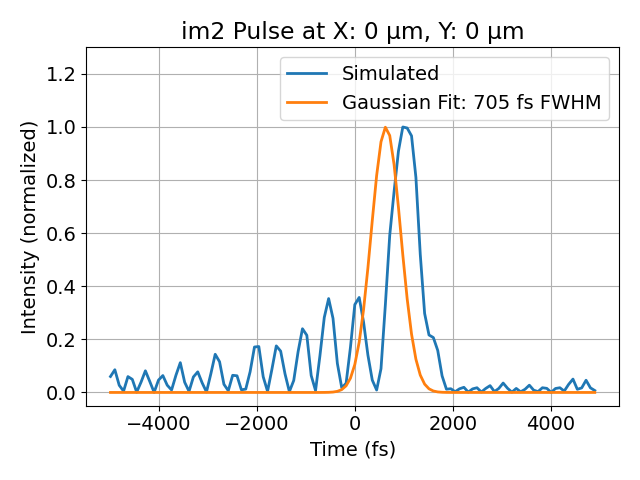

<IPython.core.display.Javascript object>


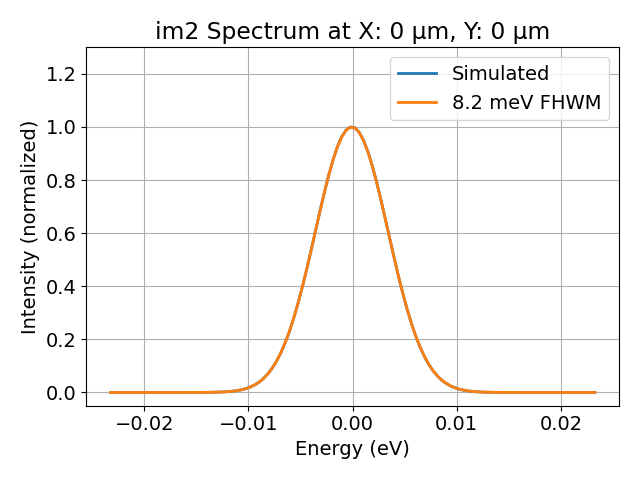

<IPython.core.display.Javascript object>


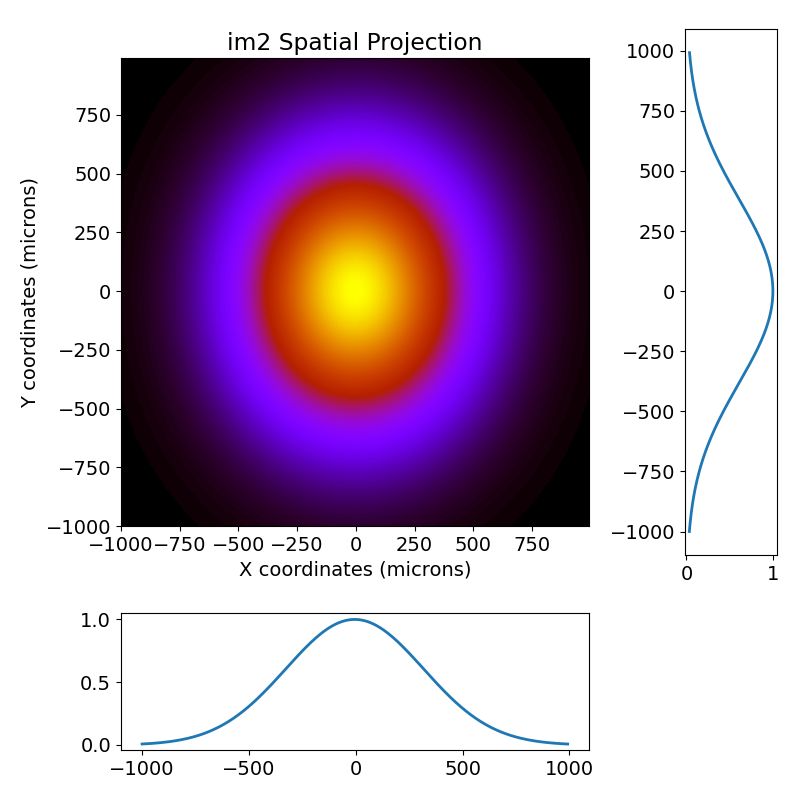

<IPython.core.display.Javascript object>


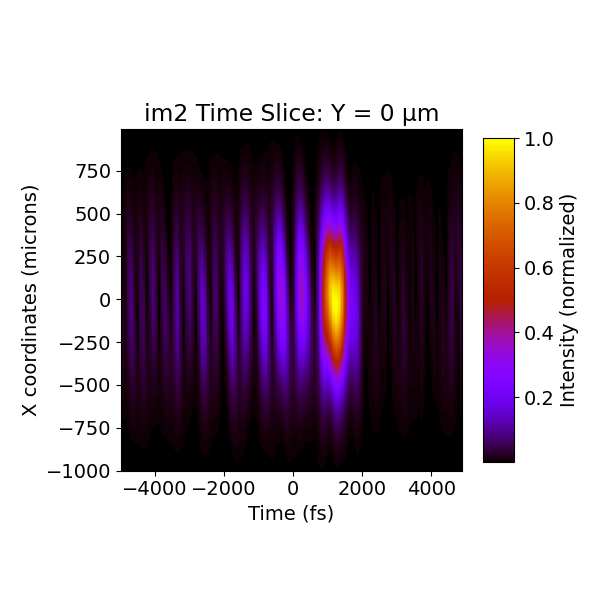

128


<IPython.core.display.Javascript object>


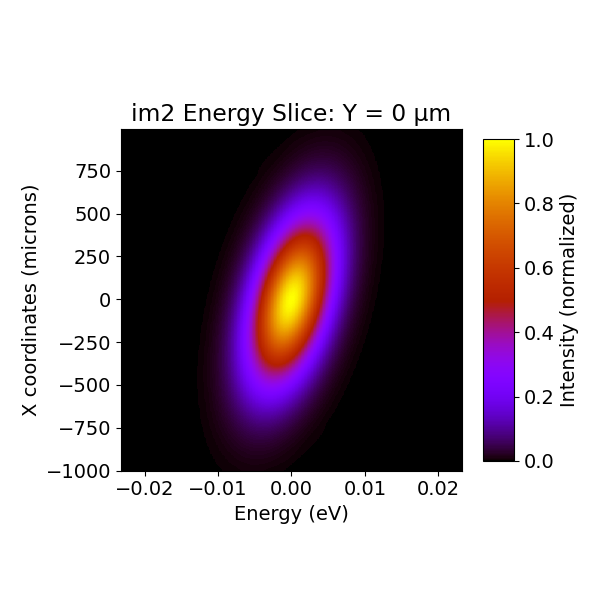

<IPython.core.display.Javascript object>


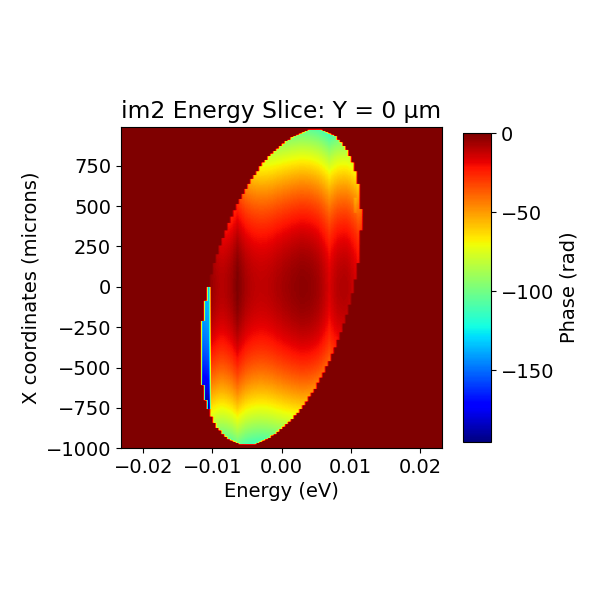

In [54]:
fig_path = '/Users/seaberg/OneDrive - SLAC National Accelerator Laboratory/Projects/Tunable Mono/figures/Option3/'

# plot output pulse at beam center
pulse.plot_pulse('im2', shift=10000)
plt.savefig(fig_path+'option3_output_pulse_no_slit.png')
# plot output spectraum at beam center
pulse.plot_spectrum('im2')
plt.savefig(fig_path+'option3_output_spectrum_no_slit.png')
# show spatial projection of output
pulse.imshow_projection('im2')
plt.savefig(fig_path+'option3_output_spatial_no_slit.png')
# show time slice of output
pulse.imshow_time_slice('im2', shift=200)
plt.savefig(fig_path+'option3_output_time_no_slit.png')
# show energy slice of output
pulse.imshow_energy_slice('im2')
plt.savefig(fig_path+'option3_output_energy_no_slit.png')
# show spectral phase slice of output
pulse.imshow_energy_slice('im2', image_type='phase')

In [6]:
def define_devices(f1, f2):
    # crystal asymmetry angle
    alphaAsym = 19.88*np.pi/180

#     # distance between crystal 2 and 1st CRL, 2nd CRL and crystal 4 
#     f1 = 3.3
#     # distance between CRLs and focus
#     f2 = 3

    # crystal reflection hkl index
    hkl = [3,1,1]

    # initialize the beam
    b1 = beam.Beam(beam_params=beam_params)

    # viewing point upstream of monochromator
    im0 = optics.PPM('im0', z=870, FOV=2e-3, N=256)
    crl0 = optics.CRL('crl0', z=830, roc=1700e-6, diameter=2e-3)

    # first crystal: symmetric reflection
    crystal1 = optics.Crystal('c1', hkl=hkl, length=10e-2, width=20e-3, z=880, E0=E0,
                              alphaAsym=0, orientation=0, pol='s')

    # second crystal: asymmetric reflection, orientation flipped relative to crystal1
    crystal2 = optics.Crystal('c2', hkl=hkl, length=10e-2, width=20e-3, z=crystal1.z+.2, E0=E0,alphaAsym=alphaAsym, 
                              orientation=2,pol='s')
    # printing crystal incidence and reflection angles for confirmation
    print('crystal 2 incidence angle: {:.2f} degrees'.format(crystal2.alpha*180/np.pi))
    print('crystal 2 exit angle: {:.2f} degrees'.format(crystal2.beta0*180/np.pi))

    im_upstream = optics.PPM('im_upstream', z=crystal2.z + f1 - .1, FOV=2e-3, N=256)

    # CRL with ~1 meter focal length (modeled as single element for now)
    m1 = optics.CurvedMirror('m1', z=crystal2.z+f1, p=10, q=4.3, length=10e-2, alpha=3e-3, orientation=0)

    # viewing point downstream of first crl
    im1 = optics.PPM('im1', z=m1.z+.1,N=256,FOV=2e-3)

    # viewing point at focus
    focus = optics.PPM('focus', z=m1.z+f2, FOV=100e-6, N=256)

    # slit at focus
    slit = optics.Slit('slit', z=m1.z+f2 + 1e-3, x_width=4e-6, y_width=2e-3)

    # second CRL with ~1 meter focal length, for collimation
    # crl2 = optics.CRL('crl2', z=crl1.z+2*f2, roc=25.25e-6, diameter=5e-3)
    m2 = optics.CurvedMirror('m2', z=m1.z+2*f2, p=4.3, q=10, length=10e-2, alpha=3e-3, orientation=2)

    # third crystal, symmetric reflection, same orientation as crystal2
    crystal3 = optics.Crystal('c3', hkl=hkl, length=10e-2, width=10e-3, z=m2.z+2, E0=E0,alphaAsym=0, orientation=2,
                             asym_type='emergence',pol='s')

    # fourth crystal, asymmetric reflection, same orientation as crystal1
    crystal4 = optics.Crystal('c4', hkl=hkl, length=10e-2, width=10e-3, z=m2.z+2 + (f1-2)*np.cos(crystal1.beta0*2), E0=E0,alphaAsym=-alphaAsym, 
                              asym_type='emergence', orientation=0,pol='s')

    # viewing point just downstream of monochromator
    im2 = optics.PPM('im2', z=crystal4.z+.1, FOV=2e-3, N=256)

    # list of devices to propagate through
    devices = [crl0,im0,crystal1,crystal2,im_upstream, im1, m1, focus,  m2, crystal3, crystal4, im2]
    
    return devices

In [95]:
f1 = np.linspace(2.8, 3.2, 50)

duration = np.zeros(50)

for i, f in enumerate(f1):
    
    devices = define_devices(f, 3)
    # initialize beamline
    mono_beamline = beamline.Beamline(devices)
    # reset central photon energy
    beam_params['photonEnergy'] = 9000

    # initialize pulse. tau sets transform-limited pulse duration in fs (FWHM). Time window is in fs.
    pulse = beam.Pulse(beam_params=beam_params, tau=40, time_window=1000)

    print('Number of spectral components: {:d}'.format(pulse.N))
    pulse.propagate(beamline=mono_beamline, screen_names=['im2'])
    centroid, duration[i] = pulse.pulse_duration('im2')

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19842541911.42 microns
current zx: 19832541911.42 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19842.541911
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19842.541911
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19842.541911
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722775633009.31 microns
zRy: 73726309.73 microns
remaining

zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 10000000.00 microns
goal for zx: 19839124844.27 microns
current zx: 19829124844.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19839.124844
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19839.124844
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.124843
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722526891865.51 microns
zRy: 73726378.90 microns
remaining distance: 309563.80 microns
goal for zx: 19839434407.28 microns
current zx: 19839124843.49 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19839.434407
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.787417
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.66145

zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 231.985791
zy: 259.145564
azimuth -0.19 mrad
drift9
delta z: 1541.85
zRx: 6435876268.09 microns
zRy: 73726413.48 microns
remaining distance: 1964013.32 microns
goal for zx: 233949804.34 microns
current zx: 231985791.02 microns
goal for zy: 261109576.99 microns
current zy: 259145563.67 microns
current step size: 1964013.32 microns
x becomes focused
y stays unfocused
zx: 233.949804
zy: 261.109577
azimuth -0.19 mrad
c3
Calculated distance to focus: -233.949804
zRx: 6.44e+03
zRy: 7.37e+01
zx: 233.967027
zy: 261.109577
azimuth -868.50 mrad
drift10
delta z: 3.23
zRx: 6435876268.09 microns
zRy: 73726413.48 microns
remaining distance: 800078.41 microns
goal for zx: 234767105.42 microns
current zx: 233967027.00 microns
goal for zy: 261909655.40 microns
current zy: 261109576.99 microns
current step size: 800078.41 microns
x remains focused
y stays unfocused
zx: 234.767105
zy: 261.909655
azimuth -868.50 mrad
c4
Calculated distance to focus: -153

zx: 19834.001455
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19834.001455
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19834.001454
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722154021358.34 microns
zRy: 73726482.65 microns
remaining distance: 309563.80 microns
goal for zx: 19834311017.55 microns
current zx: 19834001453.75 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19834.311018
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.708708
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2700000.02 microns
goal for zx: 307298864.25 microns
current zx: 304598864.23 microns
goal for zy: 253009563.82 microns
current zy: 250309563.80 microns
current step size: 2700000.02 microns
x remains focused
y stays unfocused
z

zx: 15108.263827
zy: 262.009777
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312065220457965
5.1312065220457965
x is focused
y is focused
FWHM in x: 690.1232417334038 microns
FWHM in y: 690.1232417334038 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312065220457965
5.1312065220457965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19780.587336
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 40000000.00 microns
goal for zx: 19820587336.12 microns
current zx: 19780587336.12 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721177712429.91

zx: -3.006467
zy: 253.134944
azimuth 5.84 mrad
drift6
delta z: 1464.45
zRx: 11295572388.13 microns
zRy: 73726586.39 microns
remaining distance: 74621.53 microns
goal for zx: -2931845.36 microns
current zx: -3006466.88 microns
goal for zy: 253209565.09 microns
current zy: 253134943.57 microns
current step size: 74621.53 microns
x remains focused
y stays unfocused
zx: -2.931845
zy: 253.209565
azimuth 5.84 mrad
im1
zx: -2.931845
zy: 253.209565
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11295572388.13 microns
zRy: 73726586.39 microns
remaining distance: 2900049.43 microns
goal for zx: -31795.93 microns
current zx: -2931845.36 microns
goal for zy: 256109614.52 microns
current zy: 253209565.09 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.031796
zy: 256.109615
azimuth 5.84 mrad
focus
zx: -0.031796
zy: 256.109615
azimuth 5.84 mrad
drift8
delta z: -1562.90
zRx: 11295572388.13 microns
zRy: 73726586.39 microns
remaining distance: 3028184.41 microns
goa

zx: 225.840723
zy: 261.109604
azimuth -0.18 mrad
c3
Calculated distance to focus: -225.840723
zRx: 5.99e+03
zRy: 7.37e+01
zx: 225.852269
zy: 261.109604
azimuth -868.51 mrad
drift10
delta z: 3.27
zRx: 5991751092.68 microns
zRy: 73726655.56 microns
remaining distance: 800101.20 microns
goal for zx: 226652370.33 microns
current zx: 225852269.13 microns
goal for zy: 261909705.56 microns
current zy: 261109604.36 microns
current step size: 800101.20 microns
x remains focused
y stays unfocused
zx: 226.652370
zy: 261.909706
azimuth -868.51 mrad
c4
Calculated distance to focus: -14790.439873
zRx: 9.24e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14798.415244
zy: 261.909706
azimuth -0.12 mrad
drift11
delta z: -5.13
zRx: 394025850421.87 microns
zRy: 73726655.56 microns
remaining distance: 100079.83 microns
goal for zx: 14798515323.45 microns
current zx: 14798415243.62 microns
goal for zy: 262009785.39 microns
current zy: 261909705.56 microns
current step size: 100079.83 microns
x becomes focused
y s

zRx: 5.86e+03
zRy: 7.37e+01
zx: 223.429207
zy: 261.109612
azimuth -868.51 mrad
drift10
delta z: 3.27
zRx: 5862251586.30 microns
zRy: 73726724.73 microns
remaining distance: 800107.74 microns
goal for zx: 224229314.83 microns
current zx: 223429207.09 microns
goal for zy: 261909719.99 microns
current zy: 261109612.25 microns
current step size: 800107.74 microns
x remains focused
y stays unfocused
zx: 224.229315
zy: 261.909720
azimuth -868.51 mrad
c4
Calculated distance to focus: -14632.320827
zRx: 9.04e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14639.208067
zy: 261.909720
azimuth -0.12 mrad
drift11
delta z: -5.14
zRx: 385507911290.80 microns
zRy: 73726724.73 microns
remaining distance: 100069.55 microns
goal for zx: 14639308137.02 microns
current zx: 14639208067.47 microns
goal for zy: 262009789.54 microns
current zy: 261909719.99 microns
current step size: 100069.55 microns
x becomes focused
y stays unfocused
zx: 14639.308137
zy: 262.009790
azimuth -0.12 mrad
im2
zx: 14639.308137
zy: 262

zx: 307.111268
zy: 253.009564
azimuth -0.14 mrad
drift5
delta z: -1455.20
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 116625.51 microns
goal for zx: 307227893.51 microns
current zx: 307111267.99 microns
goal for zy: 253126189.34 microns
current zy: 253009563.83 microns
current step size: 116625.51 microns
x remains focused
y stays unfocused
zx: 307.227894
zy: 253.126189
azimuth -0.14 mrad
m1
16724.296003588774
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.016887
zy: 253.126189
azimuth 5.84 mrad
drift6
delta z: 1455.23
zRx: 11283368042.89 microns
zRy: 73726793.89 microns
remaining distance: 83375.91 microns
goal for zx: -2933511.41 microns
current zx: -3016887.32 microns
goal for zy: 253209565.25 microns
current zy: 253126189.34 microns
current step size: 83375.91 microns
x remains focused
y stays unfocused
zx: -2.933511
zy: 253.209565
azimuth 5.84 mrad
im1
zx: -2.933511
zy: 253.209565
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11283368042.89 microns
zRy: 73726793.

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.369616
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 2700000.03 microns
goal for zx: 307069616.32 microns
current zx: 304369616.29 microns
goal for zy: 253009563.83 microns
current zy: 250309563.80 microns
current step size: 2700000.03 microns
x remains focused
y stays unfocused
zx: 307.069616
zy: 253.009564
azimuth -0.15 mrad
im_upstream
zx: 307.069616
zy: 253.009564
azimuth -0.15 mrad
drift5
delta z: -1452.15
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 113719.69 microns
goal for zx: 307183336.01 microns
current zx: 307069616.32 microns
goal for zy: 253123283.52 microns
current zy: 253009563.83 microns
current step size: 113719.69 microns
x remains focused
y stays unfocused
zx: 307.183336
zy: 253.123284
azimuth -0.15 mrad
m1
13786.973874941314
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.020351
zy: 253.123284
azimuth 5.84 mrad
drift6
delta z: 1

zx: 307.027978
zy: 253.009564
azimuth -0.15 mrad
drift5
delta z: -1449.10
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 110819.97 microns
goal for zx: 307138797.84 microns
current zx: 307027977.87 microns
goal for zy: 253120383.80 microns
current zy: 253009563.83 microns
current step size: 110819.97 microns
x remains focused
y stays unfocused
zx: 307.138798
zy: 253.120384
azimuth -0.15 mrad
m1
10861.827745052728
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.023810
zy: 253.120384
azimuth 5.84 mrad
drift6
delta z: 1449.12
zRx: 11275244153.75 microns
zRy: 73726932.22 microns
remaining distance: 89181.55 microns
goal for zx: -2934628.72 microns
current zx: -3023810.27 microns
goal for zy: 253209565.35 microns
current zy: 253120383.80 microns
current step size: 89181.55 microns
x remains focused
y stays unfocused
zx: -2.934629
zy: 253.209565
azimuth 5.84 mrad
im1
zx: -2.934629
zy: 253.209565
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11275244153.75 microns
zRy: 73726932.

zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 10000000.00 microns
goal for zx: 19808424251.88 microns
current zx: 19798424251.88 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19808.424252
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19808.424252
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720294000603.98 microns
zRy: 73727001.39 microns
remaining distance: 309563.80 microns
goal for zx: 19808733815.49 microns
current zx: 19808424251.69 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.733815
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 212.090556
zy: 261.109648
azimuth -0.17 mrad
c3
Calculated distance to focus: -212.090556
zRx: 5.28e+03
zRy: 7.37e+01
zx: 212.093745
zy: 261.109648
azimuth -868.52 mrad
drift10
delta z: 3.23
zRx: 5275389925.46 microns
zRy: 73727035.97 microns
remaining distance: 800137.01 microns
goal for zx: 212893881.87 microns
current zx: 212093744.86 microns
goal for zy: 261909785.09 microns
current zy: 261109648.09 microns
current step size: 800137.01 microns
x remains focused
y stays unfocused
zx: 212.893882
zy: 261.909785
azimuth -868.52 mrad
c4
Calculated distance to focus: -13892.615174
zRx: 8.14e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13894.816689
zy: 261.909785
azimuth -0.12 mrad
drift11
delta z: -5.15
zRx: 346918856762.53 microns
zRy: 73727035.97 microns
remaining distance: 100023.15 microns
goal for zx: 13894916712.39 microns
current zx: 13894816689.24 microns
goal for zy: 262009808.24 microns
current zy: 261909785.09 microns
current step size: 100023.15 microns
x becomes focused
y s

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19751.614830
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 40000000.00 microns
goal for zx: 19791614829.69 microns
current zx: 19751614829.69 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 10000000.00 microns
goal for zx: 19801614829.69 microns
current zx: 19791614829.69 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19801.614830
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19801.614830
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19801.614829

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.259404
zy: 259.107187
azimuth -0.16 mrad
drift9
delta z: 1657.64
zRx: 4888066529.06 microns
zRy: 73727243.46 microns
remaining distance: 2002484.75 microns
goal for zx: 204261888.69 microns
current zx: 202259403.94 microns
goal for zy: 261109672.22 microns
current zy: 259107187.47 microns
current step size: 2002484.75 microns
x becomes focused
y stays unfocused
zx: 204.261889
zy: 261.109672
azimuth -0.16 mrad
c3
Calculated distance to focus: -204.261889
zRx: 4.89e+03
zRy: 7.37e+01
zx: 204.260858
zy: 261.109672
azimuth -868.53 mrad
drift10
delta z: 3.15
zRx: 4888066529.06 microns
zRy: 73727243.46 microns
remaining distance: 800156.13 microns
goal for zx: 205061014.02 microns
current zx: 204260857.89 microns
goal for zy: 261909828.35 microns
current zy: 261109672.22 microns
current step size: 800156.13 microns
x remains focused
y stays unfocused
zx: 205.061014
zy: 261.909828
azimuth -868.53 mrad
c4
Calculated distance to focus: -133

delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 40000000.00 microns
goal for zx: 19781409492.21 microns
current zx: 19741409492.21 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 10000000.00 microns
goal for zx: 19791409492.21 microns
current zx: 19781409492.21 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19791.409492
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19791.409492
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19791.409491
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719057984794.64 microns
zRy: 73727347.21 mic

delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 40000000.00 microns
goal for zx: 19778010056.17 microns
current zx: 19738010056.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 10000000.00 microns
goal for zx: 19788010056.17 microns
current zx: 19778010056.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19788.010056
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19788.010056
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19788.010057
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718811164254.71 microns
zRy: 73727416.38 mic

zx: 12859.532899
zy: 262.009833
azimuth -0.12 mrad
im2
zx: 12859.532899
zy: 262.009833
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
x is focused
y is focused
FWHM in x: 690.1144958321057 microns
FWHM in y: 690.1144958321057 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19734.611791
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 40000000.00 microns
goal for zx: 19774611790.68 microns
current zx: 19734611790.68 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19774.611791
zy: 240.000000
azimuth 

zx: 306.674584
zy: 253.009564
azimuth -0.17 mrad
drift5
delta z: -1423.59
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 86415.85 microns
goal for zx: 306760999.70 microns
current zx: 306674583.85 microns
goal for zy: 253095979.69 microns
current zy: 253009563.84 microns
current step size: 86415.85 microns
x remains focused
y stays unfocused
zx: 306.761000
zy: 253.095980
azimuth -0.17 mrad
m1
-13518.304220452792
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.053024
zy: 253.095980
azimuth 5.84 mrad
drift6
delta z: 1423.61
zRx: 11240827177.79 microns
zRy: 73727520.13 microns
remaining distance: 113586.09 microns
goal for zx: -2939437.83 microns
current zx: -3053023.92 microns
goal for zy: 253209565.78 microns
current zy: 253095979.69 microns
current step size: 113586.09 microns
x remains focused
y stays unfocused
zx: -2.939438
zy: 253.209566
azimuth 5.84 mrad
im1
zx: -2.939438
zy: 253.209566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11240827177.79 microns
zRy: 73727520

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.058145
zy: 253.091718
azimuth 5.84 mrad
drift6
delta z: 1419.18
zRx: 11234771915.43 microns
zRy: 73727623.87 microns
remaining distance: 117848.06 microns
goal for zx: -2940296.89 microns
current zx: -3058144.95 microns
goal for zy: 253209565.85 microns
current zy: 253091717.79 microns
current step size: 117848.06 microns
x remains focused
y stays unfocused
zx: -2.940297
zy: 253.209566
azimuth 5.84 mrad
im1
zx: -2.940297
zy: 253.209566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11234771915.43 microns
zRy: 73727623.87 microns
remaining distance: 2900049.48 microns
goal for zx: -40247.42 microns
current zx: -2940296.89 microns
goal for zy: 256109615.33 microns
current zy: 253209565.85 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.040247
zy: 256.109615
azimuth 5.84 mrad
focus
zx: -0.040247
zy: 256.109615
azimuth 5.84 mrad
drift8
delta z: -1703.44
zRx: 11234771915.43 microns
zRy: 73727623.87 microns
remaining di

zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717099324433.64 microns
zRy: 73727693.04 microns
remaining distance: 10000000.00 microns
goal for zx: 19774424011.49 microns
current zx: 19764424011.49 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19774.424011
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19774.424011
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19774.424013
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717825154577.40 microns
zRy: 73727693.04 microns
remaining distance: 309563.80 microns
goal for zx: 19774733577.12 microns
current zx: 19774424013.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19774.733577
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.793437
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.87082

Calculated distance to focus: -12168.849924
zRx: 6.23e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12162.058660
zy: 261.909927
azimuth -0.12 mrad
drift11
delta z: -4.93
zRx: 264979736920.80 microns
zRy: 73727727.62 microns
remaining distance: 99921.83 microns
goal for zx: 12162158581.77 microns
current zx: 12162058659.94 microns
goal for zy: 262009849.07 microns
current zy: 261909927.24 microns
current step size: 99921.83 microns
x becomes focused
y stays unfocused
zx: 12162.158582
zy: 262.009849
azimuth -0.12 mrad
im2
zx: 12162.158582
zy: 262.009849
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131290873577794
5.131290873577794
x is focused
y is focused
FWHM in x: 690.1119044965559 microns
FWHM in y: 690.1119044965559 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131290873577794
5.131290873577794
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

delta z: -1411.81
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 75080.22 microns
goal for zx: 306583690.16 microns
current zx: 306508609.94 microns
goal for zy: 253084644.06 microns
current zy: 253009563.85 microns
current step size: 75080.22 microns
x remains focused
y stays unfocused
zx: 306.583690
zy: 253.084644
azimuth -0.19 mrad
m1
-24698.097214549867
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.066658
zy: 253.084644
azimuth 5.84 mrad
drift6
delta z: 1411.84
zRx: 11224691964.46 microns
zRy: 73727796.79 microns
remaining distance: 124921.91 microns
goal for zx: -2941735.75 microns
current zx: -3066657.66 microns
goal for zy: 253209565.98 microns
current zy: 253084644.06 microns
current step size: 124921.91 microns
x remains focused
y stays unfocused
zx: -2.941736
zy: 253.209566
azimuth 5.84 mrad
im1
zx: -2.941736
zy: 253.209566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11224691964.46 microns
zRy: 73727796.79 microns
remaining distance: 2900049.49 microns
goal 

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
x is focused
y is focused
FWHM in x: 690.1109327507469 microns
FWHM in y: 690.1109327507469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19715.942227
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716484411469.13 microns
zRy: 73727865.95 microns
remaining distance: 40000000.00 microns
goal for zx: 19755942227.13 microns
current zx: 19715942227.13 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716484411469.13 microns
zRy: 73727865.95 microns
remaining distance: 1

Calculated distance to focus: -11737.920963
zRx: 5.79e+01
zRy: 7.37e+01
x becomes unfocused
zx: 11729.208730
zy: 261.909961
azimuth -0.12 mrad
drift11
delta z: -4.82
zRx: 246231780062.05 microns
zRy: 73727900.53 microns
remaining distance: 99897.48 microns
goal for zx: 11729308627.27 microns
current zx: 11729208729.79 microns
goal for zy: 262009858.89 microns
current zy: 261909961.41 microns
current step size: 99897.48 microns
x becomes focused
y stays unfocused
zx: 11729.308627
zy: 262.009859
azimuth -0.12 mrad
im2
zx: 11729.308627
zy: 262.009859
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
x is focused
y is focused
FWHM in x: 690.1102849217294 microns
FWHM in y: 690.1102849217294 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19712

zy: 261.109758
azimuth -0.12 mrad
c3
Calculated distance to focus: -176.465989
zRx: 3.63e+03
zRy: 7.37e+01
zx: 176.452297
zy: 261.109758
azimuth -868.57 mrad
drift10
delta z: 2.63
zRx: 3632712283.88 microns
zRy: 73727969.70 microns
remaining distance: 800217.31 microns
goal for zx: 177252513.96 microns
current zx: 176452296.65 microns
goal for zy: 261909974.84 microns
current zy: 261109757.54 microns
current step size: 800217.31 microns
x remains focused
y stays unfocused
zx: 177.252514
zy: 261.909975
azimuth -868.57 mrad
c4
Calculated distance to focus: -11566.800057
zRx: 5.62e+01
zRy: 7.37e+01
x becomes unfocused
zx: 11557.356263
zy: 261.909975
azimuth -0.12 mrad
drift11
delta z: -4.78
zRx: 238979040569.56 microns
zRy: 73727969.70 microns
remaining distance: 99887.90 microns
goal for zx: 11557456150.71 microns
current zx: 11557356262.80 microns
goal for zy: 262009862.75 microns
current zy: 261909974.84 microns
current step size: 99887.90 microns
x becomes focused
y stays unfocused
zx

zx: 306.363555
zy: 253.009564
azimuth -0.20 mrad
drift5
delta z: -1401.63
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 65238.31 microns
goal for zx: 306428793.39 microns
current zx: 306363555.08 microns
goal for zy: 253074802.16 microns
current zy: 253009563.85 microns
current step size: 65238.31 microns
x remains focused
y stays unfocused
zx: 306.428793
zy: 253.074802
azimuth -0.20 mrad
m1
-34330.27212133742
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.078529
zy: 253.074802
azimuth 5.84 mrad
drift6
delta z: 1401.66
zRx: 11210605473.89 microns
zRy: 73728038.86 microns
remaining distance: 134764.00 microns
goal for zx: -2943765.21 microns
current zx: -3078529.20 microns
goal for zy: 253209566.15 microns
current zy: 253074802.16 microns
current step size: 134764.00 microns
x remains focused
y stays unfocused
zx: -2.943765
zy: 253.209566
azimuth 5.84 mrad
im1
zx: -2.943765
zy: 253.209566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11210605473.89 microns
zRy: 73728038.

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 40000000.00 microns
goal for zx: 19744079976.54 microns
current zx: 19704079976.54 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 1

zx: 306.362480
zy: 253.070606
azimuth -0.20 mrad
m1
-38416.04354077699
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.083601
zy: 253.070606
azimuth 5.84 mrad
drift6
delta z: 1397.33
zRx: 11204577464.64 microns
zRy: 73728142.61 microns
remaining distance: 138960.30 microns
goal for zx: -2944640.41 microns
current zx: -3083600.72 microns
goal for zy: 253209566.23 microns
current zy: 253070605.92 microns
current step size: 138960.30 microns
x remains focused
y stays unfocused
zx: -2.944640
zy: 253.209566
azimuth 5.84 mrad
im1
zx: -2.944640
zy: 253.209566
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11204577464.64 microns
zRy: 73728142.61 microns
remaining distance: 2900049.52 microns
goal for zx: -44590.89 microns
current zx: -2944640.41 microns
goal for zy: 256109615.75 microns
current zy: 253209566.23 microns
current step size: 2900049.52 microns
x remains focused
y stays unfocused
zx: -0.044591
zy: 256.109616
azimuth 5.84 mrad
focus
zx: -0.044591
zy: 256.109616
azimuth 5.84 mrad
drift8
delta z: -17

zy: 262.026091
azimuth -0.12 mrad
im2
zx: 15601.834981
zy: 262.026091
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2


zy: 253.154974
azimuth 5.84 mrad
drift6
delta z: 1481.20
zRx: 11312488029.56 microns
zRy: 73726309.73 microns
remaining distance: 62754.19 microns
goal for zx: -2929737.55 microns
current zx: -2992491.75 microns
goal for zy: 253217728.15 microns
current zy: 253154973.96 microns
current step size: 62754.19 microns
x remains focused
y stays unfocused
zx: -2.929738
zy: 253.217728
azimuth 5.84 mrad
im1
zx: -2.929738
zy: 253.217728
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11312488029.56 microns
zRy: 73726309.73 microns
remaining distance: 2900049.42 microns
goal for zx: -29688.13 microns
current zx: -2929737.55 microns
goal for zy: 256117777.58 microns
current zy: 253217728.15 microns
current step size: 2900049.42 microns
x remains focused
y stays unfocused
zx: -0.029688
zy: 256.117778
azimuth 5.84 mrad
focus
zx: -0.029688
zy: 256.117778
azimuth 5.84 mrad
drift8
delta z: -1518.28
zRx: 11312488029.56 microns
zRy: 73726309.73 microns
remaining distance: 3040436.73 microns
goal for zx: 3010

drift9
delta z: 1532.24
zRx: 6438154796.17 microns
zRy: 73726378.90 microns
remaining distance: 1962574.48 microns
goal for zx: 233985360.22 microns
current zx: 232022785.74 microns
goal for zy: 261117737.05 microns
current zy: 259155162.57 microns
current step size: 1962574.48 microns
x becomes focused
y stays unfocused
zx: 233.985360
zy: 261.117737
azimuth -0.20 mrad
c3
Calculated distance to focus: -233.985360
zRx: 6.44e+03
zRy: 7.37e+01
zx: 234.003330
zy: 261.117737
azimuth -868.50 mrad
drift10
delta z: 2.95
zRx: 6438154796.17 microns
zRy: 73726378.90 microns
remaining distance: 808246.18 microns
goal for zx: 234811576.20 microns
current zx: 234003330.01 microns
goal for zy: 261925983.24 microns
current zy: 261117737.05 microns
current step size: 808246.18 microns
x remains focused
y stays unfocused
zx: 234.811576
zy: 261.925983
azimuth -868.50 mrad
c4
Calculated distance to focus: -15322.877472
zRx: 9.93e+01
zRy: 7.37e+01
x becomes unfocused
zx: 15335.294233
zy: 261.925983
azimuth

zx: -2.930822
zy: 253.217728
azimuth 5.84 mrad
im1
zx: -2.930822
zy: 253.217728
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11304327965.59 microns
zRy: 73726448.06 microns
remaining distance: 2900049.43 microns
goal for zx: -30772.08 microns
current zx: -2930821.51 microns
goal for zy: 256117777.68 microns
current zy: 253217728.26 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.030772
zy: 256.117778
azimuth 5.84 mrad
focus
zx: -0.030772
zy: 256.117778
azimuth 5.84 mrad
drift8
delta z: -1538.50
zRx: 11304327965.59 microns
zRy: 73726448.06 microns
remaining distance: 3034312.97 microns
goal for zx: 3003540.88 microns
current zx: -30772.08 microns
goal for zy: 259152090.65 microns
current zy: 256117777.68 microns
current step size: 3034312.97 microns
x remains focused
y stays unfocused
zx: 3.003541
zy: 259.152091
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 229.902972
zy: 259.152091
azimuth -0.19 mrad
drift9
delta z: 154

zy: 259.148999
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 227.725231
zy: 259.148999
azimuth -0.19 mrad
drift9
delta z: 1552.35
zRx: 6200997298.85 microns
zRy: 73726517.23 microns
remaining distance: 1968753.80 microns
goal for zx: 229693984.41 microns
current zx: 227725230.61 microns
goal for zy: 261117752.49 microns
current zy: 259148998.69 microns
current step size: 1968753.80 microns
x becomes focused
y stays unfocused
zx: 229.693984
zy: 261.117752
azimuth -0.19 mrad
c3
Calculated distance to focus: -229.693984
zRx: 6.20e+03
zRy: 7.37e+01
zx: 229.708690
zy: 261.117752
azimuth -868.50 mrad
drift10
delta z: 2.99
zRx: 6200997298.85 microns
zRy: 73726517.23 microns
remaining distance: 808258.09 microns
goal for zx: 230516947.64 microns
current zx: 229708689.55 microns
goal for zy: 261926010.58 microns
current zy: 261117752.49 microns
current step size: 808258.09 microns
x remains focused
y stays unfocused
zx: 230.516948
zy: 261.926011
azimuth -868.50 mrad
c

azimuth -0.13 mrad
drift5
delta z: -1467.15
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 123986.59 microns
goal for zx: 307347604.92 microns
current zx: 307223618.33 microns
goal for zy: 253141713.68 microns
current zy: 253017727.09 microns
current step size: 123986.59 microns
x remains focused
y stays unfocused
zx: 307.347605
zy: 253.141714
azimuth -0.13 mrad
m1
24191.573785135482
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.008198
zy: 253.141714
azimuth 5.84 mrad
drift6
delta z: 1467.17
zRx: 11294141856.91 microns
zRy: 73726620.98 microns
remaining distance: 76014.71 microns
goal for zx: -2932183.68 microns
current zx: -3008198.39 microns
goal for zy: 253217728.38 microns
current zy: 253141713.68 microns
current step size: 76014.71 microns
x remains focused
y stays unfocused
zx: -2.932184
zy: 253.217728
azimuth 5.84 mrad
im1
zx: -2.932184
zy: 253.217728
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11294141856.91 microns
zRy: 73726620.98 microns
remaining distance:

zx: -2.932731
zy: 253.217728
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11290071746.27 microns
zRy: 73726690.14 microns
remaining distance: 2900049.43 microns
goal for zx: -32681.40 microns
current zx: -2932730.83 microns
goal for zy: 256117777.87 microns
current zy: 253217728.44 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.032681
zy: 256.117778
azimuth 5.84 mrad
focus
zx: -0.032681
zy: 256.117778
azimuth 5.84 mrad
drift8
delta z: -1573.22
zRx: 11290071746.27 microns
zRy: 73726690.14 microns
remaining distance: 3023404.10 microns
goal for zx: 2990722.71 microns
current zx: -32681.40 microns
goal for zy: 259141181.97 microns
current zy: 256117777.87 microns
current step size: 3023404.10 microns
x remains focused
y stays unfocused
zx: 2.990723
zy: 259.141182
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 222.052687
zy: 259.141182
azimuth -0.18 mrad
drift9
delta z: 1577.11
zRx: 5894883038.98 microns
zRy: 73726690.14 mi

im1
zx: -2.933279
zy: 253.217728
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11286004114.98 microns
zRy: 73726759.31 microns
remaining distance: 2900049.43 microns
goal for zx: -33229.85 microns
current zx: -2933279.28 microns
goal for zy: 256117777.92 microns
current zy: 253217728.49 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.033230
zy: 256.117778
azimuth 5.84 mrad
focus
zx: -0.033230
zy: 256.117778
azimuth 5.84 mrad
drift8
delta z: -1582.99
zRx: 11286004114.98 microns
zRy: 73726759.31 microns
remaining distance: 3020243.00 microns
goal for zx: 2987013.15 microns
current zx: -33229.85 microns
goal for zy: 259138020.92 microns
current zy: 256117777.92 microns
current step size: 3020243.00 microns
x remains focused
y stays unfocused
zx: 2.987013
zy: 259.138021
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 219.702458
zy: 259.138021
azimuth -0.18 mrad
drift9
delta z: 1586.89
zRx: 5770354844.62 microns
zRy: 73726759.3

zx: 307.098604
zy: 253.017727
azimuth -0.14 mrad
drift5
delta z: -1457.91
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 115216.07 microns
goal for zx: 307213819.86 microns
current zx: 307098603.79 microns
goal for zy: 253132943.16 microns
current zy: 253017727.09 microns
current step size: 115216.07 microns
x remains focused
y stays unfocused
zx: 307.213820
zy: 253.132943
azimuth -0.14 mrad
m1
15298.581975025578
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.018614
zy: 253.132943
azimuth 5.84 mrad
drift6
delta z: 1457.94
zRx: 11281938953.97 microns
zRy: 73726828.47 microns
remaining distance: 84785.37 microns
goal for zx: -2933829.06 microns
current zx: -3018614.43 microns
goal for zy: 253217728.54 microns
current zy: 253132943.16 microns
current step size: 84785.37 microns
x remains focused
y stays unfocused
zx: -2.933829
zy: 253.217729
azimuth 5.84 mrad
im1
zx: -2.933829
zy: 253.217729
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11281938953.97 microns
zRy: 73726828.

zRx: 8.52e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14209.445684
zy: 261.926087
azimuth -0.12 mrad
drift11
delta z: -4.95
zRx: 362981445254.02 microns
zRy: 73726897.64 microns
remaining distance: 100042.02 microns
goal for zx: 14209545726.46 microns
current zx: 14209445684.44 microns
goal for zy: 262026128.71 microns
current zy: 261926086.68 microns
current step size: 100042.02 microns
x becomes focused
y stays unfocused
zx: 14209.545726
zy: 262.026129
azimuth -0.12 mrad
im2
zx: 14209.545726
zy: 262.026129
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
x is focused
y is focused
FWHM in x: 690.1196785616448 microns
FWHM in y: 690.1196785616448 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19761.830724
zy: 200.000000
azimuth 0.00 mr

zRx: 354690231259.58 microns
zRy: 73726966.80 microns
remaining distance: 100032.12 microns
goal for zx: 14048027568.03 microns
current zx: 14047927535.91 microns
goal for zy: 262026132.70 microns
current zy: 261926100.58 microns
current step size: 100032.12 microns
x becomes focused
y stays unfocused
zx: 14048.027568
zy: 262.026133
azimuth -0.12 mrad
im2
zx: 14048.027568
zy: 262.026133
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19758.424252
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 40000000.00 microns
goal

zx: 306.973708
zy: 253.017727
azimuth -0.15 mrad
im_upstream
zx: 306.973708
zy: 253.017727
azimuth -0.15 mrad
drift5
delta z: -1448.76
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 106500.68 microns
goal for zx: 307080208.93 microns
current zx: 306973708.25 microns
goal for zy: 253124227.78 microns
current zy: 253017727.10 microns
current step size: 106500.68 microns
x remains focused
y stays unfocused
zx: 307.080209
zy: 253.124228
azimuth -0.15 mrad
m1
6515.75471707383
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.028987
zy: 253.124228
azimuth 5.84 mrad
drift6
delta z: 1448.78
zRx: 11269758259.81 microns
zRy: 73727035.97 microns
remaining distance: 93500.91 microns
goal for zx: -2935486.40 microns
current zx: -3028987.31 microns
goal for zy: 253217728.69 microns
current zy: 253124227.78 microns
current step size: 93500.91 microns
x remains focused
y stays unfocused
zx: -2.935486
zy: 253.217729
azimuth 5.84 mrad
im1
zx: -2.935486
zy: 253.217729
azimuth 5.84 mrad
drif

FWHM in x: 690.1180589502936 microns
FWHM in y: 690.1180589502936 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19753.316745
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19793316745.19 microns
current zx: 19753316745.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19803316745.19 microns
current zx: 19793316745.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: -2.936320
zy: 253.217729
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11263676214.13 microns
zRy: 73727139.72 microns
remaining distance: 2900049.45 microns
goal for zx: -36270.17 microns
current zx: -2936319.62 microns
goal for zy: 256117778.22 microns
current zy: 253217728.77 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036270
zy: 256.117778
azimuth 5.84 mrad
focus
zx: -0.036270
zy: 256.117778
azimuth 5.84 mrad
drift8
delta z: -1635.51
zRx: 11263676214.13 microns
zRy: 73727139.72 microns
remaining distance: 3002513.18 microns
goal for zx: 2966243.01 microns
current zx: -36270.17 microns
goal for zy: 259120291.39 microns
current zy: 256117778.22 microns
current step size: 3002513.18 microns
x remains focused
y stays unfocused
zx: 2.966243
zy: 259.120291
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.147452
zy: 259.120291
azimuth -0.16 mrad
drift9
delta z: 1639.47
zRx: 5078333788.78 microns
zRy: 73727139.72 mi

zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 10000000.00 microns
goal for zx: 19798211878.37 microns
current zx: 19788211878.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19798.211878
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19798.211878
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19798.211878
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719552008232.88 microns
zRy: 73727208.88 microns
remaining distance: 309563.80 microns
goal for zx: 19798521442.04 microns
current zx: 19798211878.24 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19798.521442
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.158883
zRx: 4.68e+07
zRy: 7.37e

zx: 204.318551
zy: 261.117835
azimuth -0.16 mrad
c3
Calculated distance to focus: -204.318551
zRx: 4.89e+03
zRy: 7.37e+01
zx: 204.317520
zy: 261.117835
azimuth -868.53 mrad
drift10
delta z: 2.89
zRx: 4890805987.10 microns
zRy: 73727243.46 microns
remaining distance: 808320.55 microns
goal for zx: 205125840.93 microns
current zx: 204317520.38 microns
goal for zy: 261926156.00 microns
current zy: 261117835.45 microns
current step size: 808320.55 microns
x remains focused
y stays unfocused
zx: 205.125841
zy: 261.926156
azimuth -868.53 mrad
c4
Calculated distance to focus: -13385.703456
zRx: 7.55e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13384.991693
zy: 261.926156
azimuth -0.12 mrad
drift11
delta z: -4.92
zRx: 321664632939.99 microns
zRy: 73727243.46 microns
remaining distance: 99992.62 microns
goal for zx: 13385091686.04 microns
current zx: 13384991693.42 microns
goal for zy: 262026148.62 microns
current zy: 261926156.00 microns
current step size: 99992.62 microns
x becomes focused
y sta

zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.080499
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.099202
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 2708163.30 microns
goal for zx: 306807365.70 microns
current zx: 304099202.40 microns
goal for zy: 253017727.10 microns
current zy: 250309563.80 microns
current step size: 2708163.30 microns
x remains focused
y stays unfocused
zx: 306.807366
zy: 253.017727
azimuth -0.17 mrad
im_upstream
zx: 306.807366
zy: 253.017727
azimuth -0.17 mrad
drift5
delta z: -1436.69
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 94965.01 microns
goal for zx: 306902330.71 microns
current zx: 306807365.70 microns
goal for zy: 253112692.11 microns
current zy: 253017727.10 microns
current step size: 94965.01 microns
x remains focused
y stays unfocused
zx: 306.902331
zy: 253.112692
azimuth -0.17 mrad
m1
-5025.979436149787
zRx: 1.13e+04


zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 92096.12 microns
goal for zx: 306857909.09 microns
current zx: 306765812.96 microns
goal for zy: 253109823.23 microns
current zy: 253017727.10 microns
current step size: 92096.12 microns
x remains focused
y stays unfocused
zx: 306.857909
zy: 253.109823
azimuth -0.17 mrad
m1
-7881.662482171113
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.046181
zy: 253.109823
azimuth 5.84 mrad
drift6
delta z: 1433.72
zRx: 11249506230.15 microns
zRy: 73727381.79 microns
remaining distance: 107905.72 microns
goal for zx: -2938275.78 microns
current zx: -3046181.49 microns
goal for zy: 253217728.94 microns
current zy: 253109823.23 microns
current step size: 107905.72 microns
x remains focused
y stays unfocused
zx: -2.938276
zy: 253.217729
azimuth 5.84 mrad
im1
zx: -2.938276
zy: 253.217729
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11249506230.15 microns
zRy: 73727381.79 microns
remaining distance: 2900049.46 microns
goal for zx: -38226.32 m

goal for zx: 2948796.92 microns
current zx: -38788.33 microns
goal for zy: 259105363.70 microns
current zy: 256117778.46 microns
current step size: 2987585.25 microns
x remains focused
y stays unfocused
zx: 2.948797
zy: 259.105364
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 194.555454
zy: 259.105364
azimuth -0.15 mrad
drift9
delta z: 1680.99
zRx: 4521840288.70 microns
zRy: 73727450.96 microns
remaining distance: 2012495.86 microns
goal for zx: 196567949.96 microns
current zx: 194555454.09 microns
goal for zy: 261117859.57 microns
current zy: 259105363.70 microns
current step size: 2012495.86 microns
x becomes focused
y stays unfocused
zx: 196.567950
zy: 261.117860
azimuth -0.15 mrad
c3
Calculated distance to focus: -196.567950
zRx: 4.52e+03
zRy: 7.37e+01
zx: 196.562955
zy: 261.117860
azimuth -868.54 mrad
drift10
delta z: 2.79
zRx: 4521840288.70 microns
zRy: 73727450.96 microns
remaining distance: 808337.56 microns
goal for zx: 197371293.05 microns
current z

Calculated distance to focus: -12709.840337
zRx: 6.80e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12705.521950
zy: 261.926211
azimuth -0.12 mrad
drift11
delta z: -4.83
zRx: 289491204768.29 microns
zRy: 73727520.13 microns
remaining distance: 99953.63 microns
goal for zx: 12705621903.99 microns
current zx: 12705521950.36 microns
goal for zy: 262026164.33 microns
current zy: 261926210.70 microns
current step size: 99953.63 microns
x becomes focused
y stays unfocused
zx: 12705.621904
zy: 262.026164
azimuth -0.12 mrad
im2
zx: 12705.621904
zy: 262.026164
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131276413315166
5.131276413315166
x is focused
y is focused
FWHM in x: 690.1138479963918 microns
FWHM in y: 690.1138479963918 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131276413315166
5.131276413315166
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.058149
zy: 253.099829
azimuth 5.84 mrad
drift6
delta z: 1423.32
zRx: 11235366181.72 microns
zRy: 73727623.87 microns
remaining distance: 117900.09 microns
goal for zx: -2940248.97 microns
current zx: -3058149.06 microns
goal for zy: 253217729.12 microns
current zy: 253099829.03 microns
current step size: 117900.09 microns
x remains focused
y stays unfocused
zx: -2.940249
zy: 253.217729
azimuth 5.84 mrad
im1
zx: -2.940249
zy: 253.217729
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11235366181.72 microns
zRy: 73727623.87 microns
remaining distance: 2900049.48 microns
goal for zx: -40199.49 microns
current zx: -2940248.97 microns
goal for zy: 256117778.60 microns
current zy: 253217729.12 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.040199
zy: 256.117779
azimuth 5.84 mrad
focus
zx: -0.040199
zy: 256.117779
azimuth 5.84 mrad
drift8
delta z: -1699.46
zRx: 11235366181.72 microns
zRy: 73727623.87 microns
remaining di

zx: 12278.174781
zy: 262.026174
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
x is focused
y is focused
FWHM in x: 690.1122284124342 microns
FWHM in y: 690.1122284124342 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 40000000.00 microns
goal for zx: 19762727070.85 microns
current zx: 19722727070.85 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 mic

zx: 12022.076902
zy: 262.026180
azimuth -0.12 mrad
im2
zx: 12022.076902
zy: 262.026180
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
x is focused
y is focused
FWHM in x: 690.111256665712 microns
FWHM in y: 690.111256665712 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19717.638000
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 40000000.00 microns
goal for zx: 19757638000.38 microns
current zx: 19717638000.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.

zx: 19754.246746
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716361523963.48 microns
zRy: 73727900.53 microns
remaining distance: 10000000.00 microns
goal for zx: 19764246745.53 microns
current zx: 19754246745.53 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19764.246746
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19764.246746
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19764.246745
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717086980976.90 microns
zRy: 73727900.53 microns
remaining distance: 309563.80 microns
goal for zx: 19764556308.76 microns
current zx: 19764246744.96 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19764.556309
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.637087
zRx: 4.66e+07
zRy: 7.37e

delta z: 0.00
zRx: 716115843952.21 microns
zRy: 73727969.70 microns
remaining distance: 10000000.00 microns
goal for zx: 19760856657.00 microns
current zx: 19750856657.00 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19760.856657
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19760.856657
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19760.856656
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716841176674.41 microns
zRy: 73727969.70 microns
remaining distance: 309563.80 microns
goal for zx: 19761166220.26 microns
current zx: 19760856656.46 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19761.166220
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.585006
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.704983
zy: 250.309564
azimuth -0.19 mrad
drif

goal for zx: 19755773709.77 microns
current zx: 19745773709.77 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19755.773710
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19755.773710
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19755.773708
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716472707637.82 microns
zRy: 73728073.45 microns
remaining distance: 309563.80 microns
goal for zx: 19756083271.58 microns
current zx: 19755773707.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19756.083272
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.506918
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.642846
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 2708163.32 micr

delta z: -4.47
zRx: 226726979906.46 microns
zRy: 73728108.03 microns
remaining distance: 99874.41 microns
goal for zx: 11261164332.40 microns
current zx: 11261064457.99 microns
goal for zy: 262026196.27 microns
current zy: 261926321.86 microns
current step size: 99874.41 microns
x becomes focused
y stays unfocused
zx: 11261.164332
zy: 262.026196
azimuth -0.12 mrad
im2
zx: 11261.164332
zy: 262.026196
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
FWHM in x: 690.1083414419818 microns
FWHM in y: 690.1083414419818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19702.386534
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 40000000.00

zx: 15518.730778
zy: 262.042422
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 mic

delta z: 2.67
zRx: 6488030748.15 microns
zRy: 73726309.73 microns
remaining distance: 816411.82 microns
goal for zx: 235707184.97 microns
current zx: 234890773.15 microns
goal for zy: 261942305.21 microns
current zy: 261125893.39 microns
current step size: 816411.82 microns
x remains focused
y stays unfocused
zx: 235.707185
zy: 261.942305
azimuth -868.49 mrad
c4
Calculated distance to focus: -15381.321369
zRx: 1.00e+02
zRy: 7.37e+01
x becomes unfocused
zx: 15394.816448
zy: 261.942305
azimuth -0.12 mrad
drift11
delta z: -4.60
zRx: 426776491396.67 microns
zRy: 73726309.73 microns
remaining distance: 100120.10 microns
goal for zx: 15394916568.13 microns
current zx: 15394816448.03 microns
goal for zy: 262042425.32 microns
current zy: 261942305.21 microns
current step size: 100120.10 microns
x becomes focused
y stays unfocused
zx: 15394.916568
zy: 262.042425
azimuth -0.12 mrad
im2
zx: 15394.916568
zy: 262.042425
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.03158005

zRx: 6.38e+03
zRy: 7.37e+01
zx: 232.943082
zy: 261.125901
azimuth -868.50 mrad
drift10
delta z: 2.69
zRx: 6379448659.26 microns
zRy: 73726378.90 microns
remaining distance: 816417.19 microns
goal for zx: 233759499.19 microns
current zx: 232943082.01 microns
goal for zy: 261942318.18 microns
current zy: 261125900.99 microns
current step size: 816417.19 microns
x remains focused
y stays unfocused
zx: 233.759499
zy: 261.942318
azimuth -868.50 mrad
c4
Calculated distance to focus: -15254.223075
zRx: 9.84e+01
zRy: 7.37e+01
x becomes unfocused
zx: 15266.584119
zy: 261.942318
azimuth -0.12 mrad
drift11
delta z: -4.63
zRx: 419624967195.97 microns
zRy: 73726378.90 microns
remaining distance: 100110.86 microns
goal for zx: 15266684229.51 microns
current zx: 15266584118.64 microns
goal for zy: 262042429.04 microns
current zy: 261942318.18 microns
current step size: 100110.86 microns
x becomes focused
y stays unfocused
zx: 15266.684230
zy: 262.042429
azimuth -0.12 mrad
im2
zx: 15266.684230
zy: 262

zx: -0.030852
zy: 256.125941
azimuth 5.84 mrad
drift8
delta z: -1533.98
zRx: 11304934948.76 microns
zRy: 73726448.06 microns
remaining distance: 3034219.68 microns
goal for zx: 3003367.25 microns
current zx: -30852.43 microns
goal for zy: 259160160.63 microns
current zy: 256125940.95 microns
current step size: 3034219.68 microns
x remains focused
y stays unfocused
zx: 3.003367
zy: 259.160161
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 228.949181
zy: 259.160161
azimuth -0.19 mrad
drift9
delta z: 1537.78
zRx: 6268272638.42 microns
zRy: 73726448.06 microns
remaining distance: 1965748.00 microns
goal for zx: 230914928.82 microns
current zx: 228949180.82 microns
goal for zy: 261125908.63 microns
current zy: 259160160.63 microns
current step size: 1965748.00 microns
x becomes focused
y stays unfocused
zx: 230.914929
zy: 261.125909
azimuth -0.19 mrad
c3
Calculated distance to focus: -230.914929
zRx: 6.27e+03
zRy: 7.37e+01
zx: 230.931190
zy: 261.125909
azimuth -868

zx: 307.294334
zy: 253.025890
azimuth -0.13 mrad
drift5
delta z: -1476.08
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 128475.22 microns
goal for zx: 307422808.76 microns
current zx: 307294333.54 microns
goal for zy: 253154365.57 microns
current zy: 253025890.35 microns
current step size: 128475.22 microns
x remains focused
y stays unfocused
zx: 307.422809
zy: 253.154366
azimuth -0.13 mrad
m1
28763.242740135756
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.002964
zy: 253.154366
azimuth 5.84 mrad
drift6
delta z: 1476.10
zRx: 11300857884.44 microns
zRy: 73726517.23 microns
remaining distance: 71526.00 microns
goal for zx: -2931438.21 microns
current zx: -3002964.21 microns
goal for zy: 253225891.57 microns
current zy: 253154365.57 microns
current step size: 71526.00 microns
x remains focused
y stays unfocused
zx: -2.931438
zy: 253.225892
azimuth 5.84 mrad
im1
zx: -2.931438
zy: 253.225892
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11300857884.44 microns
zRy: 73726517.

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
x is focused
y is focused
FWHM in x: 690.1229178071766 microns
FWHM in y: 690.1229178071766 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19778.880718
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19818880718.40 microns
current zx: 19778880718.40 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 1

delta z: 2.74
zRx: 5980898510.47 microns
zRy: 73726620.98 microns
remaining distance: 816436.22 microns
goal for zx: 226461239.68 microns
current zx: 225644803.46 microns
goal for zy: 261942364.10 microns
current zy: 261125927.88 microns
current step size: 816436.22 microns
x remains focused
y stays unfocused
zx: 226.461240
zy: 261.942364
azimuth -868.51 mrad
c4
Calculated distance to focus: -14777.967441
zRx: 9.23e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14786.440596
zy: 261.942364
azimuth -0.12 mrad
drift11
delta z: -4.71
zRx: 393387431891.08 microns
zRy: 73726620.98 microns
remaining distance: 100078.13 microns
goal for zx: 14786540673.68 microns
current zx: 14786440595.55 microns
goal for zy: 262042442.23 microns
current zy: 261942364.10 microns
current step size: 100078.13 microns
x becomes focused
y stays unfocused
zx: 14786.540674
zy: 262.042442
azimuth -0.12 mrad
im2
zx: 14786.540674
zy: 262.042442
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.03158005

m1
21276.57753765879
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.011668
zy: 253.147008
azimuth 5.84 mrad
drift6
delta z: 1468.34
zRx: 11290676076.10 microns
zRy: 73726690.14 microns
remaining distance: 78883.21 microns
goal for zx: -2932784.75 microns
current zx: -3011667.95 microns
goal for zy: 253225891.70 microns
current zy: 253147008.49 microns
current step size: 78883.21 microns
x remains focused
y stays unfocused
zx: -2.932785
zy: 253.225892
azimuth 5.84 mrad
im1
zx: -2.932785
zy: 253.225892
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11290676076.10 microns
zRy: 73726690.14 microns
remaining distance: 2900049.43 microns
goal for zx: -32735.31 microns
current zx: -2932784.75 microns
goal for zy: 256125941.13 microns
current zy: 253225891.70 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.032735
zy: 256.125941
azimuth 5.84 mrad
focus
zx: -0.032735
zy: 256.125941
azimuth 5.84 mrad
drift8
delta z: -1568.82
zRx: 11290676076.10 microns
zRy: 73726690.14 m

zx: 307.148425
zy: 253.025890
azimuth -0.14 mrad
drift5
delta z: -1465.23
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 118186.14 microns
goal for zx: 307266611.45 microns
current zx: 307148425.31 microns
goal for zy: 253144076.50 microns
current zy: 253025890.36 microns
current step size: 118186.14 microns
x remains focused
y stays unfocused
zx: 307.266611
zy: 253.144076
azimuth -0.14 mrad
m1
18303.649135246524
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.015141
zy: 253.144076
azimuth 5.84 mrad
drift6
delta z: 1465.25
zRx: 11286607690.42 microns
zRy: 73726759.31 microns
remaining distance: 81815.25 microns
goal for zx: -2933325.65 microns
current zx: -3015140.91 microns
goal for zy: 253225891.75 microns
current zy: 253144076.50 microns
current step size: 81815.25 microns
x remains focused
y stays unfocused
zx: -2.933326
zy: 253.225892
azimuth 5.84 mrad
im1
zx: -2.933326
zy: 253.225892
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11286607690.42 microns
zRy: 73726759.

Calculated distance to focus: -14412.109616
zRx: 8.77e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14417.900819
zy: 261.942397
azimuth -0.12 mrad
drift11
delta z: -4.74
zRx: 373825594391.41 microns
zRy: 73726793.89 microns
remaining distance: 100054.50 microns
goal for zx: 14418000873.25 microns
current zx: 14417900818.75 microns
goal for zy: 262042451.75 microns
current zy: 261942397.26 microns
current step size: 100054.50 microns
x becomes focused
y stays unfocused
zx: 14418.000873
zy: 262.042452
azimuth -0.12 mrad
im2
zx: 14418.000873
zy: 262.042452
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
x is focused
y is focused
FWHM in x: 690.1206503321083 microns
FWHM in y: 690.1206503321083 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx:

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.348795
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 2716326.56 microns
goal for zx: 307065122.01 microns
current zx: 304348795.45 microns
goal for zy: 253025890.36 microns
current zy: 250309563.80 microns
current step size: 2716326.56 microns
x remains focused
y stays unfocused
zx: 307.065122
zy: 253.025890
azimuth -0.15 mrad
im_upstream
zx: 307.065122
zy: 253.025890
azimuth -0.15 mrad
drift5
delta z: -1459.08
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 112340.61 microns
goal for zx: 307177462.62 microns
current zx: 307065122.01 microns
goal for zy: 253138230.97 microns
current zy: 253025890.36 microns
current step size: 112340.61 microns
x remains focused
y stays unfocused
zx: 307.177463
zy: 253.138231
azimuth -0.15 mrad
m1
12394.7359335045
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.022072
zy: 253.138231
azimuth 5.84 mrad
drift6
delta z: 145

zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 10000000.00 microns
goal for zx: 19810127341.10 microns
current zx: 19800127341.10 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19810.127341
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19810.127341
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19810.127340
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720417777815.19 microns
zRy: 73726966.80 microns
remaining distance: 309563.80 microns
goal for zx: 19810436903.87 microns
current zx: 19810127340.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19810.436904
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 10000000.00 microns
goal for zx: 19806721456.20 microns
current zx: 19796721456.20 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19806.721456
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19806.721456
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19806.721457
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720170255358.50 microns
zRy: 73727035.97 microns
remaining distance: 309563.80 microns
goal for zx: 19807031020.58 microns
current zx: 19806721456.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19807.031021
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.289613
zRx: 4.69e+07
zRy: 7.37e

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19753.316745
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19793316745.19 microns
current zx: 19753316745.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19803316745.19 microns
current zx: 19793316745.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19803.316745
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19803.316745
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19803.3

zx: -0.036275
zy: 256.125941
azimuth 5.84 mrad
drift8
delta z: -1631.31
zRx: 11264275669.54 microns
zRy: 73727139.72 microns
remaining distance: 3002506.90 microns
goal for zx: 2966231.88 microns
current zx: -36275.03 microns
goal for zy: 259128448.38 microns
current zy: 256125941.48 microns
current step size: 3002506.90 microns
x remains focused
y stays unfocused
zx: 2.966232
zy: 259.128448
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.096482
zy: 259.128448
azimuth -0.16 mrad
drift9
delta z: 1635.24
zRx: 5075822852.31 microns
zRy: 73727139.72 microns
remaining distance: 1997538.36 microns
goal for zx: 208094019.93 microns
current zx: 206096481.57 microns
goal for zy: 261125986.75 microns
current zy: 259128448.38 microns
current step size: 1997538.36 microns
x becomes focused
y stays unfocused
zx: 208.094020
zy: 261.125987
azimuth -0.16 mrad
c3
Calculated distance to focus: -208.094020
zRx: 5.08e+03
zRy: 7.37e+01
zx: 208.095066
zy: 261.125987
azimuth -868

zx: 2.962406
zy: 259.125172
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.619387
zy: 259.125172
azimuth -0.16 mrad
drift9
delta z: 1644.62
zRx: 4954195326.76 microns
zRy: 73727208.88 microns
remaining distance: 2000822.92 microns
goal for zx: 205620209.76 microns
current zx: 203619386.84 microns
goal for zy: 261125994.69 microns
current zy: 259125171.77 microns
current step size: 2000822.92 microns
x becomes focused
y stays unfocused
zx: 205.620210
zy: 261.125995
azimuth -0.16 mrad
c3
Calculated distance to focus: -205.620210
zRx: 4.95e+03
zRy: 7.37e+01
zx: 205.619864
zy: 261.125995
azimuth -868.53 mrad
drift10
delta z: 2.65
zRx: 4954195326.76 microns
zRy: 73727208.88 microns
remaining distance: 816482.34 microns
goal for zx: 206436346.66 microns
current zx: 205619864.32 microns
goal for zy: 261942477.03 microns
current zy: 261125994.69 microns
current step size: 816482.34 microns
x remains focused
y stays unfocused
zx: 206.436347
zy: 261.942477
azimuth -

Calculated distance to focus: -19794.810099
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.119984
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2716326.57 microns
goal for zx: 306836310.24 microns
current zx: 304119983.67 microns
goal for zy: 253025890.37 microns
current zy: 250309563.80 microns
current step size: 2716326.57 microns
x remains focused
y stays unfocused
zx: 306.836310
zy: 253.025890
azimuth -0.16 mrad
im_up

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.044468
zy: 253.119401
azimuth 5.84 mrad
drift6
delta z: 1439.39
zRx: 11252125905.83 microns
zRy: 73727347.21 microns
remaining distance: 106490.80 microns
goal for zx: -2937977.52 microns
current zx: -3044468.33 microns
goal for zy: 253225892.18 microns
current zy: 253119401.38 microns
current step size: 106490.80 microns
x remains focused
y stays unfocused
zx: -2.937978
zy: 253.225892
azimuth 5.84 mrad
im1
zx: -2.937978
zy: 253.225892
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11252125905.83 microns
zRy: 73727347.21 microns
remaining distance: 2900049.46 microns
goal for zx: -37928.06 microns
current zx: -2937977.52 microns
goal for zy: 256125941.64 microns
current zy: 253225892.18 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.037928
zy: 256.125942
azimuth 5.84 mrad
focus
zx: -0.037928
zy: 256.125942
azimuth 5.84 mrad
drift8
delta z: -1659.20
zRx: 11252125905.83 microns
zRy: 73727347.21 microns
remaining di

zx: -0.038482
zy: 256.125942
azimuth 5.84 mrad
drift8
delta z: -1668.36
zRx: 11248080885.03 microns
zRy: 73727416.38 microns
remaining distance: 2989289.01 microns
goal for zx: 2950807.17 microns
current zx: -38481.84 microns
goal for zy: 259115230.70 microns
current zy: 256125941.70 microns
current step size: 2989289.01 microns
x remains focused
y stays unfocused
zx: 2.950807
zy: 259.115231
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 196.075097
zy: 259.115231
azimuth -0.15 mrad
drift9
delta z: 1672.34
zRx: 4592915804.01 microns
zRy: 73727416.38 microns
remaining distance: 2010787.93 microns
goal for zx: 198085884.74 microns
current zx: 196075096.81 microns
goal for zy: 261126018.63 microns
current zy: 259115230.70 microns
current step size: 2010787.93 microns
x becomes focused
y stays unfocused
zx: 198.085885
zy: 261.126019
azimuth -0.15 mrad
c3
Calculated distance to focus: -198.085885
zRx: 4.59e+03
zRy: 7.37e+01
zx: 198.081528
zy: 261.126019
azimuth -868

zx: 19772.913097
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19772.913097
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717715030791.92 microns
zRy: 73727520.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19782913096.70 microns
current zx: 19772913096.70 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19782.913097
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19782.913097
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19782.913097
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718441172172.04 microns
zRy: 73727520.13 microns
remaining distance: 309563.80 microns
goal for zx: 19783222660.63 microns
current zx: 19782913096.83 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19783.222661
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -2.939643
zy: 253.225892
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11239998165.29 microns
zRy: 73727554.71 microns
remaining distance: 2900049.47 microns
goal for zx: -39593.59 microns
current zx: -2939643.06 microns
goal for zy: 256125941.81 microns
current zy: 253225892.34 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.039594
zy: 256.125942
azimuth 5.84 mrad
focus
zx: -0.039594
zy: 256.125942
azimuth 5.84 mrad
drift8
delta z: -1686.50
zRx: 11239998165.29 microns
zRy: 73727554.71 microns
remaining distance: 2982570.13 microns
goal for zx: 2942976.54 microns
current zx: -39593.59 microns
goal for zy: 259108511.93 microns
current zy: 256125941.81 microns
current step size: 2982570.13 microns
x remains focused
y stays unfocused
zx: 2.942977
zy: 259.108512
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 190.982390
zy: 259.108512
azimuth -0.14 mrad
drift9
delta z: 1690.48
zRx: 4356818033.10 microns
zRy: 73727554.71 mi

zx: 190.446740
zy: 261.126043
azimuth -0.14 mrad
c3
Calculated distance to focus: -190.446740
zRx: 4.24e+03
zRy: 7.37e+01
zx: 190.438629
zy: 261.126043
azimuth -868.55 mrad
drift10
delta z: 2.42
zRx: 4240657555.77 microns
zRy: 73727623.87 microns
remaining distance: 816512.74 microns
goal for zx: 191255141.44 microns
current zx: 190438628.70 microns
goal for zy: 261942555.42 microns
current zy: 261126042.69 microns
current step size: 816512.74 microns
x remains focused
y stays unfocused
zx: 191.255141
zy: 261.942555
azimuth -868.55 mrad
c4
Calculated distance to focus: -12480.556306
zRx: 6.56e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12474.958311
zy: 261.942555
azimuth -0.12 mrad
drift11
delta z: -4.58
zRx: 278957674714.02 microns
zRy: 73727623.87 microns
remaining distance: 99941.77 microns
goal for zx: 12475058252.64 microns
current zx: 12474958310.88 microns
goal for zy: 262042497.19 microns
current zy: 261942555.42 microns
current step size: 99941.77 microns
x becomes focused
y sta

zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 185.866070
zy: 259.101721
azimuth -0.14 mrad
drift9
delta z: 1708.37
zRx: 4125933099.44 microns
zRy: 73727693.04 microns
remaining distance: 2024329.46 microns
goal for zx: 187890399.36 microns
current zx: 185866069.91 microns
goal for zy: 261126050.72 microns
current zy: 259101721.26 microns
current step size: 2024329.46 microns
x becomes focused
y stays unfocused
zx: 187.890399
zy: 261.126051
azimuth -0.14 mrad
c3
Calculated distance to focus: -187.890399
zRx: 4.13e+03
zRy: 7.37e+01
zx: 187.881094
zy: 261.126051
azimuth -868.55 mrad
drift10
delta z: 2.36
zRx: 4125933099.44 microns
zRy: 73727693.04 microns
remaining distance: 816517.49 microns
goal for zx: 188697611.85 microns
current zx: 187881094.36 microns
goal for zy: 261942568.21 microns
current zy: 261126050.72 microns
current step size: 816517.49 microns
x remains focused
y stays unfocused
zx: 188.697612
zy: 261.942568
azimuth -868.55 mrad
c4
Calculated distance to focus: -123

zx: 2.931086
zy: 259.098299
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 183.305701
zy: 259.098299
azimuth -0.13 mrad
drift9
delta z: 1717.22
zRx: 4012762760.19 microns
zRy: 73727762.20 microns
remaining distance: 2027759.47 microns
goal for zx: 185333460.32 microns
current zx: 183305700.84 microns
goal for zy: 261126058.76 microns
current zy: 259098299.29 microns
current step size: 2027759.47 microns
x becomes focused
y stays unfocused
zx: 185.333460
zy: 261.126059
azimuth -0.13 mrad
c3
Calculated distance to focus: -185.333460
zRx: 4.01e+03
zRy: 7.37e+01
zx: 185.322991
zy: 261.126059
azimuth -868.56 mrad
drift10
delta z: 2.31
zRx: 4012762760.19 microns
zRy: 73727762.20 microns
remaining distance: 816522.13 microns
goal for zx: 186139513.52 microns
current zx: 185322991.39 microns
goal for zy: 261942580.90 microns
current zy: 261126058.76 microns
current step size: 816522.13 microns
x remains focused
y stays unfocused
zx: 186.139514
zy: 261.942581
azimuth -

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.787878
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 2716326.58 microns
goal for zx: 306504204.49 microns
current zx: 303787877.91 microns
goal for zy: 253025890.38 microns
current zy: 250309563.80 microns
current step size: 2716326.58 microns
x remains focused
y stays unfocused
zx: 306.504204
zy: 253.025890
azimuth -0.19 mrad
im_upstream
zx: 306.504204
zy: 253.025890
azimuth -0.19 mrad
drift5
delta z: -1418.58
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 73516.34 microns
goal for zx: 306577720.83 microns
current zx: 306504204.49 microns
goal for zy: 253099406.71 microns
current zy: 253025890.38 microns
current step size: 73516.34 microns
x remains focused
y stays unfocused
zx: 306.577721
zy: 253.099407
azimuth -0.19 mrad
m1
-26234.72738939099
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.068369
zy: 253.099407
azimuth 5.84 mrad
drift6
delta z: 141

zx: -0.042398
zy: 256.125942
azimuth 5.84 mrad
focus
zx: -0.042398
zy: 256.125942
azimuth 5.84 mrad
drift8
delta z: -1730.71
zRx: 11219833972.84 microns
zRy: 73727900.53 microns
remaining distance: 2965460.62 microns
goal for zx: 2923062.87 microns
current zx: -42397.76 microns
goal for zy: 259091402.71 microns
current zy: 256125942.08 microns
current step size: 2965460.62 microns
x remains focused
y stays unfocused
zx: 2.923063
zy: 259.091403
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 178.192816
zy: 259.091403
azimuth -0.13 mrad
drift9
delta z: 1734.71
zRx: 3791500440.00 microns
zRy: 73727900.53 microns
remaining distance: 2034672.15 microns
goal for zx: 180227487.97 microns
current zx: 178192815.82 microns
goal for zy: 261126074.86 microns
current zy: 259091402.71 microns
current step size: 2034672.15 microns
x becomes focused
y stays unfocused
zx: 180.227488
zy: 261.126075
azimuth -0.13 mrad
c3
Calculated distance to focus: -180.227488
zRx: 3.79e+03
zRy

Calculated distance to focus: -303.558972
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.684267
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46616083255221.28 microns
zRy: 73728004.28 microns
remaining distance: 2716326.58 microns
goal for zx: 306400593.93 microns
current zx: 303684267.35 microns
goal for zy: 253025890.38 microns
current zy: 250309563.80 microns
current step size: 2716326.58 microns
x remains focused
y stays unfocused
zx: 306.400594
zy: 253.025890
azimuth -0.20 mrad
im_upstream
zx: 306.400594
zy: 253.025890
azimuth -0.20 mrad
drift5
delta z: -1411.26
zRx: 46616083255221.28 microns
zRy: 73728004.28 microns
remaining distance: 66445.42 microns
goal for zx: 306467039.35 microns
current zx: 306400593.93 microns
goal for zy: 253092335.80 microns
current zy: 253025890.38 microns
current step size: 66445.42 microns
x remains focused
y stays unfocused
zx: 306.467039
zy: 253.092336
azimuth -0.20 mrad
m1
-33154.9365525586
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.076852
zy: 253.092

im1
zx: -2.943863
zy: 253.225893
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11209774611.75 microns
zRy: 73728073.45 microns
remaining distance: 2900049.51 microns
goal for zx: -43813.33 microns
current zx: -2943862.84 microns
goal for zy: 256125942.22 microns
current zy: 253225892.71 microns
current step size: 2900049.51 microns
x remains focused
y stays unfocused
zx: -0.043813
zy: 256.125942
azimuth 5.84 mrad
focus
zx: -0.043813
zy: 256.125942
azimuth 5.84 mrad
drift8
delta z: -1752.22
zRx: 11209774611.75 microns
zRy: 73728073.45 microns
remaining distance: 2956742.37 microns
goal for zx: 2912929.04 microns
current zx: -43813.33 microns
goal for zy: 259082684.59 microns
current zy: 256125942.22 microns
current step size: 2956742.37 microns
x remains focused
y stays unfocused
zx: 2.912929
zy: 259.082685
azimuth 5.84 mrad
m2
zRx: 1.01e+00
zRy: 7.37e+01
x becomes unfocused
zx: 171.839434
zy: 259.082685
azimuth -0.12 mrad
drift9
delta z: 1756.22
zRx: 3525335018.90 microns
zRy: 73728073.4

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.083619
zy: 253.086705
azimuth 5.84 mrad
drift6
delta z: 1405.47
zRx: 11205755098.33 microns
zRy: 73728142.61 microns
remaining distance: 139187.47 microns
goal for zx: -2944431.63 microns
current zx: -3083619.10 microns
goal for zy: 253225892.76 microns
current zy: 253086705.29 microns
current step size: 139187.47 microns
x remains focused
y stays unfocused
zx: -2.944432
zy: 253.225893
azimuth 5.84 mrad
im1
zx: -2.944432
zy: 253.225893
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11205755098.33 microns
zRy: 73728142.61 microns
remaining distance: 2900049.52 microns
goal for zx: -44382.12 microns
current zx: -2944431.63 microns
goal for zy: 256125942.28 microns
current zy: 253225892.76 microns
current step size: 2900049.52 microns
x remains focused
y stays unfocused
zx: -0.044382
zy: 256.125942
azimuth 5.84 mrad
focus
zx: -0.044382
zy: 256.125942
azimuth 5.84 mrad
drift8
delta z: -1760.72
zRx: 11205755098.33 microns
zRy: 73728142.61 microns
remaining di

zx: -2.929928
zy: 253.234055
azimuth 5.84 mrad
im1
zx: -2.929928
zy: 253.234055
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11313705062.88 microns
zRy: 73726309.73 microns
remaining distance: 2900049.43 microns
goal for zx: -29879.03 microns
current zx: -2929928.46 microns
goal for zy: 256134104.11 microns
current zy: 253234054.68 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.029879
zy: 256.134104
azimuth 5.84 mrad
focus
zx: -0.029879
zy: 256.134104
azimuth 5.84 mrad
drift8
delta z: -1509.12
zRx: 11313705062.88 microns
zRy: 73726309.73 microns
remaining distance: 3040213.85 microns
goal for zx: 3010334.83 microns
current zx: -29879.03 microns
goal for zy: 259174317.96 microns
current zy: 256134104.11 microns
current step size: 3040213.85 microns
x remains focused
y stays unfocused
zx: 3.010335
zy: 259.174318
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 231.753851
zy: 259.174318
azimuth -0.20 mrad
drift9
delta z: 151

zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.661456
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 2724489.82 microns
goal for zx: 307385945.80 microns
current zx: 304661455.98 microns
goal for zy: 253034053.61 microns
current zy: 250309563.80 microns
current step size: 2724489.82 microns
x remains focused
y stays unfocused
zx: 307.385946
zy: 253.034054
azimuth -0.12 mrad
im_upstream
zx: 307.385946
zy: 253.034054
azimuth -0.12 mrad
drift5
delta z: -1486.63
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 134488.59 microns
goal for zx: 307520434.39 microns
current zx: 307385945.80 microns
goal for zy: 253168542.20 microns
current zy: 253034053.61 microns
current step size: 134488.59 microns
x remains focused
y stays unfocused
zx: 307.520434
zy: 253.168542
azimuth -0.12 mrad
m1
34909.8538773546
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.995967
zy: 253.168542
azimuth 5.84 mrad
drift6
delta z: 148

Calculated distance to focus: -19835.708957
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19835.708957
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722278279381.09 microns
zRy: 73726448.06 microns
remaining distance: 309563.80 microns
goal for zx: 19836018520.71 microns
current zx: 19835708956.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19836.018521
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.734940
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.619725
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 2724489.82 microns
goal for zx: 307344214.67 microns
current zx: 304619724.85 microns
goal for zy: 253034053.62 microns
current zy: 250309563.80 microns
current step size: 2724489.82 microns
x remains focused
y stays unfocused
zx: 307.344215
zy: 253.034054
azimuth -0.13 mrad
im_up

zx: -2.931511
zy: 253.234055
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11301464123.71 microns
zRy: 73726517.23 microns
remaining distance: 2900049.43 microns
goal for zx: -31461.57 microns
current zx: -2931511.00 microns
goal for zy: 256134104.27 microns
current zy: 253234054.84 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.031462
zy: 256.134104
azimuth 5.84 mrad
focus
zx: -0.031462
zy: 256.134104
azimuth 5.84 mrad
drift8
delta z: -1539.54
zRx: 11301464123.71 microns
zRy: 73726517.23 microns
remaining distance: 3031052.36 microns
goal for zx: 2999590.78 microns
current zx: -31461.57 microns
goal for zy: 259165156.62 microns
current zy: 256134104.27 microns
current step size: 3031052.36 microns
x remains focused
y stays unfocused
zx: 2.999591
zy: 259.165157
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 226.031575
zy: 259.165157
azimuth -0.19 mrad
drift9
delta z: 1543.32
zRx: 6109103244.80 microns
zRy: 73726517.23 mi

zx: -2.932307
zy: 253.234055
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11295352044.85 microns
zRy: 73726620.98 microns
remaining distance: 2900049.43 microns
goal for zx: -32257.19 microns
current zx: -2932306.62 microns
goal for zy: 256134104.35 microns
current zy: 253234054.91 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.032257
zy: 256.134104
azimuth 5.84 mrad
focus
zx: -0.032257
zy: 256.134104
azimuth 5.84 mrad
drift8
delta z: -1554.51
zRx: 11295352044.85 microns
zRy: 73726620.98 microns
remaining distance: 3026403.76 microns
goal for zx: 2994146.57 microns
current zx: -32257.19 microns
goal for zy: 259160508.10 microns
current zy: 256134104.35 microns
current step size: 3026403.76 microns
x remains focused
y stays unfocused
zx: 2.994147
zy: 259.160508
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 222.963915
zy: 259.160508
azimuth -0.19 mrad
drift9
delta z: 1558.33
zRx: 5943780100.77 microns
zRy: 73726620.98 mi

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.473770
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 2724489.82 microns
goal for zx: 307198260.06 microns
current zx: 304473770.24 microns
goal for zy: 253034053.62 microns
current zy: 250309563.80 microns
current step size: 2724489.82 microns
x remains focused
y stays unfocused
zx: 307.198260
zy: 253.034054
azimuth -0.14 mrad
im_upstream
zx: 307.198260
zy: 253.034054
azimuth -0.14 mrad
drift5
delta z: -1472.57
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 121179.35 microns
goal for zx: 307319439.41 microns
current zx: 307198260.06 microns
goal for zy: 253155232.97 microns
current zy: 253034053.62 microns
current step size: 121179.35 microns
x remains focused
y stays unfocused
zx: 307.319439
zy: 253.155233
azimuth -0.14 mrad
m1
21338.248776899018
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.011661
zy: 253.155233
azimuth 5.84 mrad
drift6
delta z: 1

y stays unfocused
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 10000000.00 microns
goal for zx: 19820352045.19 microns
current zx: 19810352045.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19820.352045
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19820.352045
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19820.352046
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721161112981.45 microns
zRy: 73726759.31 microns
remaining distance: 309563.80 microns
goal for zx: 19820661609.53 microns
current zx: 19820352045.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19820.661610
zy: 250.309564
azimuth 868.37 mr

zx: 14388.414537
zy: 262.058781
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
x is focused
y is focused
FWHM in x: 690.1206503321083 microns
FWHM in y: 690.1206503321083 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19766.942635
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 40000000.00 microns
goal for zx: 19806942634.99 microns
current zx: 19766942634.99 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720185817529.27 mic

zx: 217.345998
zy: 261.134119
azimuth -868.52 mrad
drift10
delta z: 2.47
zRx: 5543639471.93 microns
zRy: 73726863.06 microns
remaining distance: 824622.69 microns
goal for zx: 218170620.80 microns
current zx: 217345998.12 microns
goal for zy: 261958741.38 microns
current zy: 261134118.70 microns
current step size: 824622.69 microns
x remains focused
y stays unfocused
zx: 218.170621
zy: 261.958741
azimuth -868.52 mrad
c4
Calculated distance to focus: -14236.954347
zRx: 8.56e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14241.690604
zy: 261.958741
azimuth -0.12 mrad
drift11
delta z: -4.53
zRx: 364650569577.25 microns
zRy: 73726863.06 microns
remaining distance: 100043.06 microns
goal for zx: 14241790646.76 microns
current zx: 14241690603.70 microns
goal for zy: 262058784.44 microns
current zy: 261958741.38 microns
current step size: 100043.06 microns
x becomes focused
y stays unfocused
zx: 14241.790647
zy: 262.058784
azimuth -0.12 mrad
im2
zx: 14241.790647
zy: 262.058784
azimuth -0.12 mrad
F

zx: -0.034931
zy: 256.134105
azimuth 5.84 mrad
focus
zx: -0.034931
zy: 256.134105
azimuth 5.84 mrad
drift8
delta z: -1603.33
zRx: 11275018687.21 microns
zRy: 73726966.80 microns
remaining distance: 3010588.76 microns
goal for zx: 2975658.15 microns
current zx: -34930.62 microns
goal for zy: 259144693.37 microns
current zy: 256134104.61 microns
current step size: 3010588.76 microns
x remains focused
y stays unfocused
zx: 2.975658
zy: 259.144693
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 211.929127
zy: 259.144693
azimuth -0.17 mrad
drift9
delta z: 1607.21
zRx: 5368125711.75 microns
zRy: 73726966.80 microns
remaining distance: 1989437.04 microns
goal for zx: 213918564.44 microns
current zx: 211929127.40 microns
goal for zy: 261134130.41 microns
current zy: 259144693.37 microns
current step size: 1989437.04 microns
x becomes focused
y stays unfocused
zx: 213.918564
zy: 261.134130
azimuth -0.17 mrad
c3
Calculated distance to focus: -213.918564
zRx: 5.37e+03
zRy

Calculated distance to focus: -19806.721456
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19806.721457
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720170255358.50 microns
zRy: 73727035.97 microns
remaining distance: 309563.80 microns
goal for zx: 19807031020.58 microns
current zx: 19806721456.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19807.031021
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.289613
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.265545
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 2724489.83 microns
goal for zx: 306990034.78 microns
current zx: 304265544.95 microns
goal for zy: 253034053.63 microns
current zy: 250309563.80 microns
current step size: 2724489.83 microns
x remains focused
y stays unfocused
zx: 306.990035
zy: 253.034054
azimuth -0.15 mrad
im_up

zx: -2.936059
zy: 253.234055
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11266902620.44 microns
zRy: 73727105.13 microns
remaining distance: 2900049.45 microns
goal for zx: -36009.35 microns
current zx: -2936058.80 microns
goal for zy: 256134104.72 microns
current zy: 253234055.27 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036009
zy: 256.134105
azimuth 5.84 mrad
focus
zx: -0.036009
zy: 256.134105
azimuth 5.84 mrad
drift8
delta z: -1622.38
zRx: 11266902620.44 microns
zRy: 73727105.13 microns
remaining distance: 3004127.73 microns
goal for zx: 2968118.38 microns
current zx: -36009.35 microns
goal for zy: 259138232.45 microns
current zy: 256134104.72 microns
current step size: 3004127.73 microns
x remains focused
y stays unfocused
zx: 2.968118
zy: 259.138232
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 207.237694
zy: 259.138232
azimuth -0.16 mrad
drift9
delta z: 1626.29
zRx: 5132370692.82 microns
zRy: 73727105.13 mi

Calculated distance to focus: -206.845690
zRx: 5.01e+03
zRy: 7.37e+01
zx: 206.846037
zy: 261.134154
azimuth -868.53 mrad
drift10
delta z: 2.40
zRx: 5014264316.22 microns
zRy: 73727174.30 microns
remaining distance: 824644.63 microns
goal for zx: 207670681.38 microns
current zx: 206846036.75 microns
goal for zy: 261958798.62 microns
current zy: 261134154.00 microns
current step size: 824644.63 microns
x remains focused
y stays unfocused
zx: 207.670681
zy: 261.958799
azimuth -868.53 mrad
c4
Calculated distance to focus: -13551.769707
zRx: 7.75e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13552.009360
zy: 261.958799
azimuth -0.12 mrad
drift11
delta z: -4.52
zRx: 329832277404.79 microns
zRy: 73727174.30 microns
remaining distance: 100002.26 microns
goal for zx: 13552109361.77 microns
current zx: 13552009359.51 microns
goal for zy: 262058800.88 microns
current zy: 261958798.62 microns
current step size: 100002.26 microns
x becomes focused
y stays unfocused
zx: 13552.109362
zy: 262.058801
azimu

zx: 306.940854
zy: 253.130434
azimuth -0.16 mrad
m1
-3614.5933220978395
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.041036
zy: 253.130434
azimuth 5.84 mrad
drift6
delta z: 1446.58
zRx: 11256771364.51 microns
zRy: 73727278.05 microns
remaining distance: 103620.98 microns
goal for zx: -2937414.90 microns
current zx: -3041035.88 microns
goal for zy: 253234055.40 microns
current zy: 253130434.42 microns
current step size: 103620.98 microns
x remains focused
y stays unfocused
zx: -2.937415
zy: 253.234055
azimuth 5.84 mrad
im1
zx: -2.937415
zy: 253.234055
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11256771364.51 microns
zRy: 73727278.05 microns
remaining distance: 2900049.46 microns
goal for zx: -37365.44 microns
current zx: -2937414.90 microns
goal for zy: 256134104.85 microns
current zy: 253234055.40 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.037365
zy: 256.134105
azimuth 5.84 mrad
focus
zx: -0.037365
zy: 256.134105
azimuth 5.84 mrad
drift8
delta z: -1

zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19789709627.83 microns
current zx: 19779709627.83 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19789.709628
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19789.709628
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -0.038457
zy: 256.134105
azimuth 5.84 mrad
focus
zx: -0.038457
zy: 256.134105
azimuth 5.84 mrad
drift8
delta z: -1664.29
zRx: 11248677390.49 microns
zRy: 73727416.38 microns
remaining distance: 2989315.78 microns
goal for zx: 2950859.25 microns
current zx: -38456.53 microns
goal for zy: 259123420.75 microns
current zy: 256134104.96 microns
current step size: 2989315.78 microns
x remains focused
y stays unfocused
zx: 2.950859
zy: 259.123421
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 196.295309
zy: 259.123421
azimuth -0.15 mrad
drift9
delta z: 1668.23
zRx: 4603238193.78 microns
zRy: 73727416.38 microns
remaining distance: 2010760.98 microns
goal for zx: 198306069.50 microns
current zx: 196295308.52 microns
goal for zy: 261134181.72 microns
current zy: 259123420.75 microns
current step size: 2010760.98 microns
x becomes focused
y stays unfocused
zx: 198.306069
zy: 261.134182
azimuth -0.15 mrad
c3
Calculated distance to focus: -198.306069
zRx: 4.60e+03
zRy

delta z: -1437.53
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 87733.08 microns
goal for zx: 306807568.22 microns
current zx: 306719835.15 microns
goal for zy: 253121786.71 microns
current zy: 253034053.63 microns
current step size: 87733.08 microns
x remains focused
y stays unfocused
zx: 306.807568
zy: 253.121787
azimuth -0.17 mrad
m1
-12213.69905084221
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.051322
zy: 253.121787
azimuth 5.84 mrad
drift6
delta z: 1437.56
zRx: 11244634070.27 microns
zRy: 73727485.54 microns
remaining distance: 112268.84 microns
goal for zx: -2939053.63 microns
current zx: -3051322.47 microns
goal for zy: 253234055.55 microns
current zy: 253121786.71 microns
current step size: 112268.84 microns
x remains focused
y stays unfocused
zx: -2.939054
zy: 253.234056
azimuth 5.84 mrad
im1
zx: -2.939054
zy: 253.234056
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11244634070.27 microns
zRy: 73727485.54 microns
remaining distance: 2900049.47 microns
goal f

zx: -2.939603
zy: 253.234056
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11240593197.35 microns
zRy: 73727554.71 microns
remaining distance: 2900049.47 microns
goal for zx: -39553.20 microns
current zx: -2939602.67 microns
goal for zy: 256134105.07 microns
current zy: 253234055.60 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.039553
zy: 256.134105
azimuth 5.84 mrad
focus
zx: -0.039553
zy: 256.134105
azimuth 5.84 mrad
drift8
delta z: -1682.49
zRx: 11240593197.35 microns
zRy: 73727554.71 microns
remaining distance: 2982613.06 microns
goal for zx: 2943059.86 microns
current zx: -39553.20 microns
goal for zy: 259116718.13 microns
current zy: 256134105.07 microns
current step size: 2982613.06 microns
x remains focused
y stays unfocused
zx: 2.943060
zy: 259.116718
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 191.319201
zy: 259.116718
azimuth -0.14 mrad
drift9
delta z: 1686.44
zRx: 4372198724.99 microns
zRy: 73727554.71 mi

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19777.818769
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718071466299.45 microns
zRy: 73727623.87 microns
remaining distance: 309563.80 microns
goal for zx: 19778128333.11 microns
current zx: 19777818769.31 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19778.128333
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.845590
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.912319
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46722141686864.98 microns
zRy: 73727623.87 microns
remaining distance: 2724489.84 microns
goal for zx: 306636808.79 microns
current zx: 303912318.95 microns
goal for zy: 253034053.64 microns
current zy: 250309563.80 microns
current step size: 2724489.84 microns
x remains focused
y stays unfocused
zx: 306.636809
zy: 253.034054
azimuth -0.18 mrad
im_upstream
zx: 306.636809
zy: 253.034054
azimuth

Calculated distance to focus: -12424.810694
zRx: 6.50e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12418.785405
zy: 261.958886
azimuth -0.12 mrad
drift11
delta z: -4.36
zRx: 276419691611.49 microns
zRy: 73727658.46 microns
remaining distance: 99939.94 microns
goal for zx: 12418885344.99 microns
current zx: 12418785405.04 microns
goal for zy: 262058826.00 microns
current zy: 261958886.05 microns
current step size: 99939.94 microns
x becomes focused
y stays unfocused
zx: 12418.885345
zy: 262.058826
azimuth -0.12 mrad
im2
zx: 12418.885345
zy: 262.058826
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
x is focused
y is focused
FWHM in x: 690.1125523286169 microns
FWHM in y: 690.1125523286169 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

delta z: 0.00
zRx: 11230501672.08 microns
zRy: 73727727.62 microns
remaining distance: 2900049.48 microns
goal for zx: -40931.99 microns
current zx: -2940981.47 microns
goal for zy: 256134105.21 microns
current zy: 253234055.73 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.040932
zy: 256.134105
azimuth 5.84 mrad
focus
zx: -0.040932
zy: 256.134105
azimuth 5.84 mrad
drift8
delta z: -1704.87
zRx: 11230501672.08 microns
zRy: 73727727.62 microns
remaining distance: 2974133.31 microns
goal for zx: 2933201.33 microns
current zx: -40931.99 microns
goal for zy: 259108238.52 microns
current zy: 256134105.21 microns
current step size: 2974133.31 microns
x remains focused
y stays unfocused
zx: 2.933201
zy: 259.108239
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 185.051167
zy: 259.108239
azimuth -0.14 mrad
drift9
delta z: 1708.84
zRx: 4089690125.19 microns
zRy: 73727727.62 microns
remaining distance: 2025979.08 microns
goal for 

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19719.334065
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19759334065.37 microns
current zx: 19719334065.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19769334065.37 microns
current zx: 19759334065.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19769.334065
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066

Calculated distance to focus: -303.663134
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.767149
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 2724489.85 microns
goal for zx: 306491639.08 microns
current zx: 303767149.24 microns
goal for zy: 253034053.64 microns
current zy: 250309563.80 microns
current step size: 2724489.85 microns
x remains focused
y stays unfocused
zx: 306.491639
zy: 253.034054
azimuth -0.19 mrad
im_upstream
zx: 306.491639
zy: 253.034054
azimuth -0.19 mrad
drift5
delta z: -1421.22
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 72018.36 microns
goal for zx: 306563657.44 microns
current zx: 306491639.08 microns
goal for zy: 253106072.00 microns
current zy: 253034053.64 microns
current step size: 72018.36 microns
x remains focused
y stays unfocused
zx: 306.563657
zy: 253.106072
azimuth -0.19 mrad
m1
-27704.54871970902
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.070075
zy: 253.10

zx: 180.803045
zy: 261.134238
azimuth -0.13 mrad
c3
Calculated distance to focus: -180.803045
zRx: 3.82e+03
zRy: 7.37e+01
zx: 180.790298
zy: 261.134238
azimuth -868.56 mrad
drift10
delta z: 1.93
zRx: 3816036397.05 microns
zRy: 73727900.53 microns
remaining distance: 824690.57 microns
goal for zx: 181614988.63 microns
current zx: 180790298.06 microns
goal for zy: 261958928.17 microns
current zy: 261134237.60 microns
current step size: 824690.57 microns
x remains focused
y stays unfocused
zx: 181.614989
zy: 261.958928
azimuth -868.56 mrad
c4
Calculated distance to focus: -11851.477951
zRx: 5.90e+01
zRy: 7.37e+01
x becomes unfocused
zx: 11842.682558
zy: 261.958928
azimuth -0.12 mrad
drift11
delta z: -4.22
zRx: 251074580871.45 microns
zRy: 73727900.53 microns
remaining distance: 99909.93 microns
goal for zx: 11842782468.31 microns
current zx: 11842682558.38 microns
goal for zy: 262058838.10 microns
current zy: 261958928.17 microns
current step size: 99909.93 microns
x becomes focused
y sta

zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 176.259726
zy: 259.096182
azimuth -0.12 mrad
drift9
delta z: 1739.51
zRx: 3709424271.41 microns
zRy: 73727969.70 microns
remaining distance: 2038064.08 microns
goal for zx: 178297790.26 microns
current zx: 176259726.19 microns
goal for zy: 261134245.60 microns
current zy: 259096181.52 microns
current step size: 2038064.08 microns
x becomes focused
y stays unfocused
zx: 178.297790
zy: 261.134246
azimuth -0.12 mrad
c3
Calculated distance to focus: -178.297790
zRx: 3.71e+03
zRy: 7.37e+01
zx: 178.283961
zy: 261.134246
azimuth -868.57 mrad
drift10
delta z: 1.86
zRx: 3709424271.41 microns
zRy: 73727969.70 microns
remaining distance: 824694.33 microns
goal for zx: 179108654.87 microns
current zx: 178283960.54 microns
goal for zy: 261958939.92 microns
current zy: 261134245.60 microns
current step size: 824694.33 microns
x remains focused
y stays unfocused
zx: 179.108655
zy: 261.958940
azimuth -868.57 mrad
c4
Calculated distance to focus: -116

zx: 173.756812
zy: 259.092698
azimuth -0.12 mrad
drift9
delta z: 1748.13
zRx: 3604571166.66 microns
zRy: 73728038.86 microns
remaining distance: 2041556.03 microns
goal for zx: 175798367.62 microns
current zx: 173756811.60 microns
goal for zy: 261134253.60 microns
current zy: 259092697.57 microns
current step size: 2041556.03 microns
x becomes focused
y stays unfocused
zx: 175.798368
zy: 261.134254
azimuth -0.12 mrad
c3
Calculated distance to focus: -175.798368
zRx: 3.60e+03
zRy: 7.37e+01
zx: 175.783485
zy: 261.134254
azimuth -868.57 mrad
drift10
delta z: 1.79
zRx: 3604571166.66 microns
zRy: 73728038.86 microns
remaining distance: 824697.94 microns
goal for zx: 176608182.63 microns
current zx: 175783484.69 microns
goal for zy: 261958951.54 microns
current zy: 261134253.60 microns
current step size: 824697.94 microns
x remains focused
y stays unfocused
zx: 176.608183
zy: 261.958952
azimuth -868.57 mrad
c4
Calculated distance to focus: -11524.753536
zRx: 5.58e+01
zRy: 7.37e+01
x becomes 

zRx: 3501550515.94 microns
zRy: 73728108.03 microns
remaining distance: 2045065.12 microns
goal for zx: 173306837.27 microns
current zx: 171261772.15 microns
goal for zy: 261134261.60 microns
current zy: 259089196.48 microns
current step size: 2045065.12 microns
x becomes focused
y stays unfocused
zx: 173.306837
zy: 261.134262
azimuth -0.12 mrad
c3
Calculated distance to focus: -173.306837
zRx: 3.50e+03
zRy: 7.37e+01
zx: 173.290930
zy: 261.134262
azimuth -868.57 mrad
drift10
delta z: 1.71
zRx: 3501550515.94 microns
zRy: 73728108.03 microns
remaining distance: 824701.41 microns
goal for zx: 174115631.52 microns
current zx: 173290930.11 microns
goal for zy: 261958963.01 microns
current zy: 261134261.60 microns
current step size: 824701.41 microns
x remains focused
y stays unfocused
zx: 174.115632
zy: 261.958963
azimuth -868.57 mrad
c4
Calculated distance to focus: -11362.099479
zRx: 5.42e+01
zRy: 7.37e+01
x becomes unfocused
zx: 11351.126425
zy: 261.958963
azimuth -0.12 mrad
drift11
delt

zx: -0.029457
zy: 256.142267
azimuth 5.84 mrad
drift8
delta z: 43055.23
zRx: 11318399669.90 microns
zRy: 73726240.57 microns
remaining distance: 3043106.39 microns
goal for zx: 3013649.33 microns
current zx: -29457.06 microns
goal for zy: 259185373.71 microns
current zy: 256142267.32 microns
current step size: 3043106.39 microns
x remains focused
y stays unfocused
zx: 3.013649
zy: 259.185374
azimuth 5.84 mrad
m2
zRx: 1.09e+00
zRy: 7.37e+01
x becomes unfocused
zx: 232.272525
zy: 259.185374
azimuth -0.20 mrad
drift9
delta z: -43159.79
zRx: 6452926682.71 microns
zRy: 73726240.57 microns
remaining distance: 1956840.24 microns
goal for zx: 234229364.93 microns
current zx: 232272524.70 microns
goal for zy: 261142213.95 microns
current zy: 259185373.71 microns
current step size: 1956840.24 microns
x becomes focused
y stays unfocused
zx: 234.229365
zy: 261.142214
azimuth -0.20 mrad
c3
Calculated distance to focus: -234.229365
zRx: 6.45e+03
zRy: 7.37e+01
zx: 234.250318
zy: 261.142214
azimuth -8

zx: 307.435853
zy: 253.042217
azimuth -0.12 mrad
drift5
delta z: -1494.09
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 137571.70 microns
goal for zx: 307573425.13 microns
current zx: 307435853.43 microns
goal for zy: 253179788.58 microns
current zy: 253042216.88 microns
current step size: 137571.70 microns
x remains focused
y stays unfocused
zx: 307.573425
zy: 253.179789
azimuth -0.12 mrad
m1
38070.19908402276
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.992453
zy: 253.179789
azimuth 5.84 mrad
drift6
delta z: 1494.11
zRx: 11314313604.10 microns
zRy: 73726309.73 microns
remaining distance: 62429.36 microns
goal for zx: -2930023.91 microns
current zx: -2992453.27 microns
goal for zy: 253242217.94 microns
current zy: 253179788.58 microns
current step size: 62429.36 microns
x remains focused
y stays unfocused
zx: -2.930024
zy: 253.242218
azimuth 5.84 mrad
im1
zx: -2.930024
zy: 253.242218
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11314313604.10 microns
zRy: 73726309.7

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19789.124844
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 40000000.00 microns
goal for zx: 19829124844.27 microns
current zx: 19789124844.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 10000000.00 microns
goal for zx: 19839124844.27 microns
current zx: 19829124844.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19839.124844
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19839.124844
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.124843

zx: -2.930802
zy: 253.242218
azimuth 5.84 mrad
im1
zx: -2.930802
zy: 253.242218
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11308189189.80 microns
zRy: 73726413.48 microns
remaining distance: 2900049.43 microns
goal for zx: -30752.98 microns
current zx: -2930802.41 microns
goal for zy: 256142267.45 microns
current zy: 253242218.02 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.030753
zy: 256.142267
azimuth 5.84 mrad
focus
zx: -0.030753
zy: 256.142267
azimuth 5.84 mrad
drift8
delta z: -1519.88
zRx: 11308189189.80 microns
zRy: 73726413.48 microns
remaining distance: 3035558.10 microns
goal for zx: 3004805.11 microns
current zx: -30752.98 microns
goal for zy: 259177825.55 microns
current zy: 256142267.45 microns
current step size: 3035558.10 microns
x remains focused
y stays unfocused
zx: 3.004805
zy: 259.177826
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 227.975950
zy: 259.177826
azimuth -0.19 mrad
drift9
delta z: 152

Calculated distance to focus: -304.708708
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2732653.08 microns
goal for zx: 307331517.32 microns
current zx: 304598864.23 microns
goal for zy: 253042216.88 microns
current zy: 250309563.80 microns
current step size: 2732653.08 microns
x remains focused
y stays unfocused
zx: 307.331517
zy: 253.042217
azimuth -0.13 mrad
im_upstream
zx: 307.331517
zy: 253.042217
azimuth -0.13 mrad
drift5
delta z: -1486.21
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 130124.93 microns
goal for zx: 307461642.25 microns
current zx: 307331517.32 microns
goal for zy: 253172341.81 microns
current zy: 253042216.88 microns
current step size: 130124.93 microns
x remains focused
y stays unfocused
zx: 307.461642
zy: 253.172342
azimuth -0.13 mrad
m1
30445.428754755558
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.001199
zy: 253.

zx: 307.416963
zy: 253.169374
azimuth -0.13 mrad
m1
27417.69661961873
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.004689
zy: 253.169374
azimuth 5.84 mrad
drift6
delta z: 1483.10
zRx: 11300032017.68 microns
zRy: 73726551.81 microns
remaining distance: 72844.02 microns
goal for zx: -2931844.90 microns
current zx: -3004688.92 microns
goal for zy: 253242218.13 microns
current zy: 253169374.11 microns
current step size: 72844.02 microns
x remains focused
y stays unfocused
zx: -2.931845
zy: 253.242218
azimuth 5.84 mrad
im1
zx: -2.931845
zy: 253.242218
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11300032017.68 microns
zRy: 73726551.81 microns
remaining distance: 2900049.43 microns
goal for zx: -31795.47 microns
current zx: -2931844.90 microns
goal for zy: 256142267.56 microns
current zy: 253242218.13 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.031795
zy: 256.142268
azimuth 5.84 mrad
focus
zx: -0.031795
zy: 256.142268
azimuth 5.84 mrad
drift8
delta z: -1540.

Calculated distance to focus: -19827.174395
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19827.174396
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721657310472.01 microns
zRy: 73726620.98 microns
remaining distance: 309563.80 microns
goal for zx: 19827483959.80 microns
current zx: 19827174396.00 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19827.483960
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2732653.09 microns
goal for zx: 307248108.13 microns
current zx: 304515455.04 microns
goal for zy: 253042216.88 microns
current zy: 250309563.80 microns
current step size: 2732653.09 microns
x remains focused
y stays unfocused
zx: 307.248108
zy: 253.042217
azimuth -0.13 mrad
im_up

zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 10000000.00 microns
goal for zx: 19823762631.71 microns
current zx: 19813762631.71 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19823.762632
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19823.762632
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19823.762631
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721409147596.51 microns
zRy: 73726690.14 microns
remaining distance: 309563.80 microns
goal for zx: 19824072194.48 microns
current zx: 19823762630.68 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19824.072194
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.551412
zRx: 4.70e+07
zRy: 7.37e

zx: -2.933418
zy: 253.242218
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11287814889.72 microns
zRy: 73726759.31 microns
remaining distance: 2900049.44 microns
goal for zx: -33368.95 microns
current zx: -2933418.39 microns
goal for zy: 256142267.72 microns
current zy: 253242218.28 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.033369
zy: 256.142268
azimuth 5.84 mrad
focus
zx: -0.033369
zy: 256.142268
azimuth 5.84 mrad
drift8
delta z: -1569.87
zRx: 11287814889.72 microns
zRy: 73726759.31 microns
remaining distance: 3020082.96 microns
goal for zx: 2986714.00 microns
current zx: -33368.95 microns
goal for zy: 259162350.67 microns
current zy: 256142267.72 microns
current step size: 3020082.96 microns
x remains focused
y stays unfocused
zx: 2.986714
zy: 259.162351
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 218.182373
zy: 259.162351
azimuth -0.18 mrad
drift9
delta z: 1573.68
zRx: 5690782814.15 microns
zRy: 73726759.31 mi

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.018598
zy: 253.157566
azimuth 5.84 mrad
drift6
delta z: 1470.65
zRx: 11283747470.34 microns
zRy: 73726828.47 microns
remaining distance: 84652.67 microns
goal for zx: -2933945.52 microns
current zx: -3018598.19 microns
goal for zy: 253242218.33 microns
current zy: 253157565.66 microns
current step size: 84652.67 microns
x remains focused
y stays unfocused
zx: -2.933946
zy: 253.242218
azimuth 5.84 mrad
im1
zx: -2.933946
zy: 253.242218
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11283747470.34 microns
zRy: 73726828.47 microns
remaining distance: 2900049.44 microns
goal for zx: -33896.08 microns
current zx: -2933945.52 microns
goal for zy: 256142267.77 microns
current zy: 253242218.33 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.033896
zy: 256.142268
azimuth 5.84 mrad
focus
zx: -0.033896
zy: 256.142268
azimuth 5.84 mrad
drift8
delta z: -1579.66
zRx: 11283747470.34 microns
zRy: 73726828.47 microns
remaining dist

zx: -2.934474
zy: 253.242218
azimuth 5.84 mrad
im1
zx: -2.934474
zy: 253.242218
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11279682523.31 microns
zRy: 73726897.64 microns
remaining distance: 2900049.44 microns
goal for zx: -34424.54 microns
current zx: -2934473.98 microns
goal for zy: 256142267.82 microns
current zy: 253242218.38 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.034425
zy: 256.142268
azimuth 5.84 mrad
focus
zx: -0.034425
zy: 256.142268
azimuth 5.84 mrad
drift8
delta z: -1589.39
zRx: 11279682523.31 microns
zRy: 73726897.64 microns
remaining distance: 3013754.60 microns
goal for zx: 2979330.06 microns
current zx: -34424.54 microns
goal for zy: 259156022.42 microns
current zy: 256142267.82 microns
current step size: 3013754.60 microns
x remains focused
y stays unfocused
zx: 2.979330
zy: 259.156022
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 213.893393
zy: 259.156022
azimuth -0.17 mrad
drift9
delta z: 159

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
x is focused
y is focused
FWHM in x: 690.1193546387659 microns
FWHM in y: 690.1193546387659 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19760.127341
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 40000000.00 microns
goal for zx: 19800127341.10 microns
current zx: 19760127341.10 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 1

Calculated distance to focus: -19806.721456
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19806.721457
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720170255358.50 microns
zRy: 73727035.97 microns
remaining distance: 309563.80 microns
goal for zx: 19807031020.58 microns
current zx: 19806721456.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19807.031021
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.289613
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.265545
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 2732653.09 microns
goal for zx: 306998198.05 microns
current zx: 304265544.95 microns
goal for zy: 253042216.89 microns
current zy: 250309563.80 microns
current step size: 2732653.09 microns
x remains focused
y stays unfocused
zx: 306.998198
zy: 253.042217
azimuth -0.15 mrad
im_up

zx: 13779.020294
zy: 262.075124
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
x is focused
y is focused
FWHM in x: 690.1180589502936 microns
FWHM in y: 690.1180589502936 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19753.316745
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19793316745.19 microns
current zx: 19753316745.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719195971279.44 mic

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.182347
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 2732653.10 microns
goal for zx: 306915000.38 microns
current zx: 304182347.28 microns
goal for zy: 253042216.89 microns
current zy: 250309563.80 microns
current step size: 2732653.10 microns
x remains focused
y stays unfocused
zx: 306.915000
zy: 253.042217
azimuth -0.16 mrad
im_upstream
zx: 306.915000
zy: 253.042217
azimuth -0.16 mrad
drift5
delta z: -1455.29
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 100727.07 microns
goal for zx: 307015727.45 microns
current zx: 306915000.38 microns
goal for zy: 253142943.97 microns
current zy: 253042216.89 microns
current step size: 100727.07 microns
x remains focused
y stays unfocused
zx: 307.015727
zy: 253.142944
azimuth -0.16 mrad
m1
727.2631386007773
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.035876
zy: 253.142944
azimuth 5.84 mrad
drift6
delta z: 14

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.119984
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2732653.10 microns
goal for zx: 306852636.77 microns
current zx: 304119983.67 microns
goal for zy: 253042216.90 microns
current zy: 250309563.80 microns
current step size: 2732653.10 microns
x remains focused
y stays unfocused
zx: 306.852637
zy: 253.042217
azimuth -0.16 mrad
im_upstream
zx: 306.852637
zy: 253.042217
azimuth -0.16 mrad
drift5
delta z: -1450.73
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 96370.32 microns
goal for zx: 306949007.09 microns
current zx: 306852636.77 microns
goal for zy: 253138587.22 microns
current zy: 253042216.90 microns
current step size: 96370.32 microns
x remains focused
y stays unfocused
zx: 306.949007
zy: 253.138587
azimuth -0.16 mrad
m1
-3625.040123606742
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.041036
zy: 253.138587
azimuth 5.84 mrad
drift6
delta z: 145

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.078424
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 2732653.10 microns
goal for zx: 306811077.45 microns
current zx: 304078424.35 microns
goal for zy: 253042216.90 microns
current zy: 250309563.80 microns
current step size: 2732653.10 microns
x remains focused
y stays unfocused
zx: 306.811077
zy: 253.042217
azimuth -0.17 mrad
im_upstream
zx: 306.811077
zy: 253.042217
azimuth -0.17 mrad
drift5
delta z: -1447.71
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 93473.40 microns
goal for zx: 306904550.84 microns
current zx: 306811077.45 microns
goal for zy: 253135690.29 microns
current zy: 253042216.90 microns
current step size: 93473.40 microns
x remains focused
y stays unfocused
zx: 306.904551
zy: 253.135690
azimuth -0.17 mrad
m1
-6511.594252651302
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.044470
zy: 253.135690
azimuth 5.84 mrad
drift6
delta z: 144

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.016110
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 2732653.10 microns
goal for zx: 306748763.25 microns
current zx: 304016110.15 microns
goal for zy: 253042216.90 microns
current zy: 250309563.80 microns
current step size: 2732653.10 microns
x remains focused
y stays unfocused
zx: 306.748763
zy: 253.042217
azimuth -0.17 mrad
im_upstream
zx: 306.748763
zy: 253.042217
azimuth -0.17 mrad
drift5
delta z: -1443.19
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 89139.31 microns
goal for zx: 306837902.56 microns
current zx: 306748763.25 microns
goal for zy: 253131356.21 microns
current zy: 253042216.90 microns
current step size: 89139.31 microns
x remains focused
y stays unfocused
zx: 306.837903
zy: 253.131356
azimuth -0.17 mrad
m1
-10819.093229544214
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.049613
zy: 253.131356
azimuth 5.84 mrad
drift6
delta z: 14

zx: 306.793494
zy: 253.128474
azimuth -0.17 mrad
m1
-13675.952083082668
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.053036
zy: 253.128474
azimuth 5.84 mrad
drift6
delta z: 1440.21
zRx: 11243208745.50 microns
zRy: 73727520.13 microns
remaining distance: 113744.51 microns
goal for zx: -2939291.36 microns
current zx: -3053035.87 microns
goal for zy: 253242218.84 microns
current zy: 253128474.33 microns
current step size: 113744.51 microns
x remains focused
y stays unfocused
zx: -2.939291
zy: 253.242219
azimuth 5.84 mrad
im1
zx: -2.939291
zy: 253.242219
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11243208745.50 microns
zRy: 73727520.13 microns
remaining distance: 2900049.47 microns
goal for zx: -39241.89 microns
current zx: -2939291.36 microns
goal for zy: 256142268.31 microns
current zy: 253242218.84 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.039242
zy: 256.142268
azimuth 5.84 mrad
focus
zx: -0.039242
zy: 256.142268
azimuth 5.84 mrad
drift8
delta z: -1

zRx: 4.33e+03
zRy: 7.37e+01
zx: 192.445696
zy: 261.142365
azimuth -868.55 mrad
drift10
delta z: 1.92
zRx: 4331686535.71 microns
zRy: 73727589.29 microns
remaining distance: 832833.98 microns
goal for zx: 193278530.04 microns
current zx: 192445696.06 microns
goal for zy: 261975198.58 microns
current zy: 261142364.60 microns
current step size: 832833.98 microns
x remains focused
y stays unfocused
zx: 193.278530
zy: 261.975199
azimuth -868.55 mrad
c4
Calculated distance to focus: -12612.594668
zRx: 6.70e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12607.396179
zy: 261.975199
azimuth -0.12 mrad
drift11
delta z: -4.19
zRx: 284980811700.10 microns
zRy: 73727589.29 microns
remaining distance: 99951.03 microns
goal for zx: 12607496129.81 microns
current zx: 12607396178.78 microns
goal for zy: 262075149.61 microns
current zy: 261975198.58 microns
current step size: 99951.03 microns
x becomes focused
y stays unfocused
zx: 12607.496130
zy: 262.075150
azimuth -0.12 mrad
im2
zx: 12607.496130
zy: 262.0

zx: 2.937266
zy: 259.119862
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 187.980384
zy: 259.119862
azimuth -0.14 mrad
drift9
delta z: 1695.94
zRx: 4220483607.16 microns
zRy: 73727658.46 microns
remaining distance: 2022510.61 microns
goal for zx: 190002894.13 microns
current zx: 187980383.52 microns
goal for zy: 261142372.53 microns
current zy: 259119861.91 microns
current step size: 2022510.61 microns
x becomes focused
y stays unfocused
zx: 190.002894
zy: 261.142373
azimuth -0.14 mrad
c3
Calculated distance to focus: -190.002894
zRx: 4.22e+03
zRy: 7.37e+01
zx: 189.994145
zy: 261.142373
azimuth -868.55 mrad
drift10
delta z: 1.87
zRx: 4220483607.16 microns
zRy: 73727658.46 microns
remaining distance: 832837.75 microns
goal for zx: 190826983.08 microns
current zx: 189994145.32 microns
goal for zy: 261975210.28 microns
current zy: 261142372.53 microns
current step size: 832837.75 microns
x remains focused
y stays unfocused
zx: 190.826983
zy: 261.975210
azimuth -

zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 10000000.00 microns
goal for zx: 19772727070.85 microns
current zx: 19762727070.85 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19772.727071
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19772.727071
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.85008

zx: 306.520531
zy: 253.042217
azimuth -0.19 mrad
im_upstream
zx: 306.520531
zy: 253.042217
azimuth -0.19 mrad
drift5
delta z: -1426.80
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 73362.81 microns
goal for zx: 306593893.83 microns
current zx: 306520531.02 microns
goal for zy: 253115579.72 microns
current zy: 253042216.91 microns
current step size: 73362.81 microns
x remains focused
y stays unfocused
zx: 306.593894
zy: 253.115580
azimuth -0.19 mrad
m1
-26386.81276556017
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.068382
zy: 253.115580
azimuth 5.84 mrad
drift6
delta z: 1426.83
zRx: 11225046177.38 microns
zRy: 73727831.37 microns
remaining distance: 126639.35 microns
goal for zx: -2941742.51 microns
current zx: -3068381.86 microns
goal for zy: 253242219.07 microns
current zy: 253115579.72 microns
current step size: 126639.35 microns
x remains focused
y stays unfocused
zx: -2.941743
zy: 253.242219
azimuth 5.84 mrad
im1
zx: -2.941743
zy: 253.242219
azimuth 5.84 mrad
dr

zx: 306.479077
zy: 253.042217
azimuth -0.19 mrad
im_upstream
zx: 306.479077
zy: 253.042217
azimuth -0.19 mrad
drift5
delta z: -1423.85
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 70513.63 microns
goal for zx: 306549590.58 microns
current zx: 306479076.95 microns
goal for zy: 253112730.54 microns
current zy: 253042216.91 microns
current step size: 70513.63 microns
x remains focused
y stays unfocused
zx: 306.549591
zy: 253.112731
azimuth -0.19 mrad
m1
-29179.549082096146
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.071780
zy: 253.112731
azimuth 5.84 mrad
drift6
delta z: 1423.88
zRx: 11221016740.59 microns
zRy: 73727900.53 microns
remaining distance: 129488.58 microns
goal for zx: -2942291.15 microns
current zx: -3071779.73 microns
goal for zy: 253242219.12 microns
current zy: 253112730.54 microns
current step size: 129488.58 microns
x remains focused
y stays unfocused
zx: -2.942291
zy: 253.242219
azimuth 5.84 mrad
im1
zx: -2.942291
zy: 253.242219
azimuth 5.84 mrad
d

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.704983
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 2732653.11 microns
goal for zx: 306437636.02 microns
current zx: 303704982.91 microns
goal for zy: 253042216.91 microns
current zy: 250309563.80 microns
current step size: 2732653.11 microns
x remains focused
y stays unfocused
zx: 306.437636
zy: 253.042217
azimuth -0.19 mrad
im_upstream
zx: 306.437636
zy: 253.042217
azimuth -0.19 mrad
drift5
delta z: -1420.91
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 67670.34 microns
goal for zx: 306505306.36 microns
current zx: 306437636.02 microns
goal for zy: 253109887.25 microns
current zy: 253042216.91 microns
current step size: 67670.34 microns
x remains focused
y stays unfocused
zx: 306.505306
zy: 253.109887
azimuth -0.19 mrad
m1
-31960.80213580547
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.075173
zy: 253.109887
azimuth 5.84 mrad
drift6
delta z: 142

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19757.467735
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716595499008.88 microns
zRy: 73728038.86 microns
remaining distance: 309563.80 microns
goal for zx: 19757777298.51 microns
current zx: 19757467734.71 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19757.777299
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.532943
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.663555
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 2732653.11 microns
goal for zx: 306396208.14 microns
current zx: 303663555.03 microns
goal for zy: 253042216.91 microns
current zy: 250309563.80 microns
current step size: 2732653.11 microns
x remains focused
y stays unfocused
zx: 306.396208
zy: 253.042217
azimuth -0.20 mrad
im_upstream
zx: 306.396208
zy: 253.042217
azimuth

zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 10000000.00 microns
goal for zx: 19752386534.44 microns
current zx: 19742386534.44 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19752.386534
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19752.386534
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19752.386534
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716227219764.58 microns
zRy: 73728142.61 microns
remaining distance: 309563.80 microns
goal for zx: 19752696098.15 microns
current zx: 19752386534.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

delta z: -52.73
zRx: 6384196727.53 microns
zRy: 73726240.57 microns
remaining distance: 840922.72 microns
goal for zx: 233850975.33 microns
current zx: 233010052.61 microns
goal for zy: 261991300.72 microns
current zy: 261150378.00 microns
current step size: 840922.72 microns
x remains focused
y stays unfocused
zx: 233.850975
zy: 261.991301
azimuth -868.49 mrad
c4
Calculated distance to focus: -15260.192447
zRx: 9.85e+01
zRy: 7.37e+01
x becomes unfocused
zx: 15274.599513
zy: 261.991301
azimuth -0.12 mrad
drift11
delta z: 112.06
zRx: 420091218982.61 microns
zRy: 73726240.57 microns
remaining distance: 100112.06 microns
goal for zx: 15274699625.31 microns
current zx: 15274599513.24 microns
goal for zy: 262091412.78 microns
current zy: 261991300.72 microns
current step size: 100112.06 microns
x becomes focused
y stays unfocused
zx: 15274.699625
zy: 262.091413
azimuth -0.12 mrad
im2
zx: 15274.699625
zy: 262.091413
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.03158

zx: 19840.833230
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19840.833230
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19840.833229
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722651246349.48 microns
zRy: 73726344.32 microns
remaining distance: 309563.80 microns
goal for zx: 19841142793.15 microns
current zx: 19840833229.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19841.142793
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.813663
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 2740816.35 microns
goal for zx: 307423142.86 microns
current zx: 304682326.51 microns
goal for zy: 253050380.15 microns
current zy: 250309563.80 microns
current step size: 2740816.35 microns
x remains focused
y stays unfocused
z

FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.416753
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 40000000.00 microns
goal for zx: 19827416753.11 microns
current zx: 19787416753.11 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 10000000.00 microns
goal for zx: 198374

zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 226.134030
zy: 259.184371
azimuth -0.19 mrad
drift9
delta z: 1524.15
zRx: 6115071413.16 microns
zRy: 73726448.06 microns
remaining distance: 1966029.63 microns
goal for zx: 228100059.19 microns
current zx: 226134029.56 microns
goal for zy: 261150400.26 microns
current zy: 259184370.63 microns
current step size: 1966029.63 microns
x becomes focused
y stays unfocused
zx: 228.100059
zy: 261.150400
azimuth -0.19 mrad
c3
Calculated distance to focus: -228.100059
zRx: 6.12e+03
zRy: 7.37e+01
zx: 228.116121
zy: 261.150400
azimuth -868.50 mrad
drift10
delta z: 1.91
zRx: 6115071413.16 microns
zRy: 73726448.06 microns
remaining distance: 840934.00 microns
goal for zx: 228957055.42 microns
current zx: 228116121.42 microns
goal for zy: 261991334.26 microns
current zy: 261150400.26 microns
current step size: 840934.00 microns
x remains focused
y stays unfocused
zx: 228.957055
zy: 261.991334
azimuth -868.50 mrad
c4
Calculated distance to focus: -149

zy: 253.250381
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11302676651.02 microns
zRy: 73726517.23 microns
remaining distance: 2900049.43 microns
goal for zx: -31607.16 microns
current zx: -2931656.59 microns
goal for zy: 256150430.80 microns
current zy: 253250381.36 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.031607
zy: 256.150431
azimuth 5.84 mrad
focus
zx: -0.031607
zy: 256.150431
azimuth 5.84 mrad
drift8
delta z: -1530.57
zRx: 11302676651.02 microns
zRy: 73726517.23 microns
remaining distance: 3030883.80 microns
goal for zx: 2999276.64 microns
current zx: -31607.16 microns
goal for zy: 259181314.59 microns
current zy: 256150430.80 microns
current step size: 3030883.80 microns
x remains focused
y stays unfocused
zx: 2.999277
zy: 259.181315
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 224.362559
zy: 259.181315
azimuth -0.19 mrad
drift9
delta z: 1534.30
zRx: 6019217126.15 microns
zRy: 73726517.23 microns
remainin

zx: 19829.190283
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.630040
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.536302
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 2740816.35 microns
goal for zx: 307277118.70 microns
current zx: 304536302.35 microns
goal for zy: 253050380.15 microns
current zy: 250309563.80 microns
current step size: 2740816.35 microns
x remains focused
y stays unfocused
zx: 307.277119
zy: 253.050380
azimuth -0.13 mrad
im_upstream
zx: 307.277119
zy: 253.050380
azimuth -0.13 mrad
drift5
delta z: -1485.78
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 125749.71 microns
goal for zx: 307402868.41 microns
current zx: 307277118.70 microns
goal for zy: 253176129.86 microns
current zy: 253050380.15 microns
current step size: 125749.71 microns
x remains focused
y stays unfocused
zx: 307.402868
zy: 253.176130
azimuth -0.13 mrad
m1
25983.21705789

zx: 14589.984938
zy: 262.091432
azimuth -0.12 mrad
im2
zx: 14589.984938
zy: 262.091432
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
x is focused
y is focused
FWHM in x: 690.1219460303209 microns
FWHM in y: 690.1219460303209 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 40000000.00 microns
goal for zx: 19813762631.71 microns
current zx: 19773762631.71 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19813.762632
zy: 240.000000
azimuth 

zx: -0.033156
zy: 256.150431
azimuth 5.84 mrad
focus
zx: -0.033156
zy: 256.150431
azimuth 5.84 mrad
drift8
delta z: -1560.56
zRx: 11290453530.45 microns
zRy: 73726724.73 microns
remaining distance: 3021595.11 microns
goal for zx: 2988439.08 microns
current zx: -33156.03 microns
goal for zy: 259172026.07 microns
current zy: 256150430.96 microns
current step size: 3021595.11 microns
x remains focused
y stays unfocused
zx: 2.988439
zy: 259.172026
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 218.677446
zy: 259.172026
azimuth -0.18 mrad
drift9
delta z: 1564.34
zRx: 5716838133.14 microns
zRy: 73726724.73 microns
remaining distance: 1978404.39 microns
goal for zx: 220655850.86 microns
current zx: 218677446.46 microns
goal for zy: 261150430.46 microns
current zy: 259172026.07 microns
current step size: 1978404.39 microns
x becomes focused
y stays unfocused
zx: 220.655851
zy: 261.150430
azimuth -0.18 mrad
c3
Calculated distance to focus: -220.655851
zRx: 5.72e+03
zRy

zRx: 5.56e+03
zRy: 7.37e+01
zx: 217.637894
zy: 261.150442
azimuth -868.52 mrad
drift10
delta z: 1.95
zRx: 5558912594.02 microns
zRy: 73726828.47 microns
remaining distance: 840955.33 microns
goal for zx: 218478849.13 microns
current zx: 217637893.80 microns
goal for zy: 261991397.25 microns
current zy: 261150441.92 microns
current step size: 840955.33 microns
x remains focused
y stays unfocused
zx: 218.478849
zy: 261.991397
azimuth -868.52 mrad
c4
Calculated distance to focus: -14257.068112
zRx: 8.58e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14262.304336
zy: 261.991397
azimuth -0.12 mrad
drift11
delta z: -4.12
zRx: 365721220809.10 microns
zRy: 73726828.47 microns
remaining distance: 100043.26 microns
goal for zx: 14262404378.98 microns
current zx: 14262304335.72 microns
goal for zy: 262091440.51 microns
current zy: 261991397.25 microns
current step size: 100043.26 microns
x becomes focused
y stays unfocused
zx: 14262.404379
zy: 262.091441
azimuth -0.12 mrad
im2
zx: 14262.404379
zy: 262

zx: 19812.140288
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.368106
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.327978
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 2740816.36 microns
goal for zx: 307068794.19 microns
current zx: 304327977.84 microns
goal for zy: 253050380.15 microns
current zy: 250309563.80 microns
current step size: 2740816.36 microns
x remains focused
y stays unfocused
zx: 307.068794
zy: 253.050380
azimuth -0.15 mrad
im_upstream
zx: 307.068794
zy: 253.050380
azimuth -0.15 mrad
drift5
delta z: -1470.22
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 110977.70 microns
goal for zx: 307179771.89 microns
current zx: 307068794.19 microns
goal for zy: 253161357.85 microns
current zy: 253050380.15 microns
current step size: 110977.70 microns
x remains focused
y stays unfocused
zx: 307.179772
zy: 253.161358
azimuth -0.15 mrad
m1
11020.16342646

zx: 13985.912794
zy: 262.091447
azimuth -0.12 mrad
im2
zx: 13985.912794
zy: 262.091447
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19758.424252
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19798424251.88 microns
current zx: 19758424251.88 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19798.424252
zy: 240.000000
azimuth 

zx: 19755.018954
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719319590218.04 microns
zRy: 73727070.55 microns
remaining distance: 40000000.00 microns
goal for zx: 19795018954.00 microns
current zx: 19755018954.00 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19795.018954
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19795.018954
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719319590218.04 microns
zRy: 73727070.55 microns
remaining distance: 10000000.00 microns
goal for zx: 19805018954.00 microns
current zx: 19795018954.00 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19805.018954
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19805.018954
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19805.018954
zy: 250.000000
azimuth 868.37 mrad
drift3
delta 

zRx: 5.12e+03
zRy: 7.37e+01
zx: 209.058722
zy: 261.150473
azimuth -868.53 mrad
drift10
delta z: 1.90
zRx: 5123624448.59 microns
zRy: 73727105.13 microns
remaining distance: 840970.74 microns
goal for zx: 209899693.13 microns
current zx: 209058722.39 microns
goal for zy: 261991443.52 microns
current zy: 261150472.78 microns
current step size: 840970.74 microns
x remains focused
y stays unfocused
zx: 209.899693
zy: 261.991444
azimuth -868.53 mrad
c4
Calculated distance to focus: -13697.226224
zRx: 7.91e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13698.434609
zy: 261.991444
azimuth -0.12 mrad
drift11
delta z: -4.12
zRx: 337078241858.36 microns
zRy: 73727105.13 microns
remaining distance: 100010.28 microns
goal for zx: 13698534619.09 microns
current zx: 13698434608.81 microns
goal for zy: 262091453.80 microns
current zy: 261991443.52 microns
current step size: 100010.28 microns
x becomes focused
y stays unfocused
zx: 13698.534619
zy: 262.091454
azimuth -0.12 mrad
im2
zx: 13698.534619
zy: 262

Calculated distance to focus: -19798.211878
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19798.211878
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719552008232.88 microns
zRy: 73727208.88 microns
remaining distance: 309563.80 microns
goal for zx: 19798521442.04 microns
current zx: 19798211878.24 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19798.521442
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.158883
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.161556
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 2740816.36 microns
goal for zx: 306902372.48 microns
current zx: 304161556.12 microns
goal for zy: 253050380.16 microns
current zy: 250309563.80 microns
current step size: 2740816.36 microns
x remains focused
y stays unfocused
zx: 306.902372
zy: 253.050380
azimuth -0.16 mrad
im_up

zRy: 7.37e+01
x becomes unfocused
zx: 13401.932472
zy: 261.991467
azimuth -0.12 mrad
drift11
delta z: -4.10
zRx: 322486542259.66 microns
zRy: 73727243.46 microns
remaining distance: 99993.85 microns
goal for zx: 13402032465.82 microns
current zx: 13401932471.97 microns
goal for zy: 262091460.42 microns
current zy: 261991466.58 microns
current step size: 99993.85 microns
x becomes focused
y stays unfocused
zx: 13402.032466
zy: 262.091460
azimuth -0.12 mrad
im2
zx: 13402.032466
zy: 262.091460
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
x is focused
y is focused
FWHM in x: 690.1164393465515 microns
FWHM in y: 690.1164393465515 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19744.810099
zy: 200.000000
azimuth 0.00 mrad
drift1
delta 

zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 10000000.00 microns
goal for zx: 19791409492.21 microns
current zx: 19781409492.21 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19791.409492
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19791.409492
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19791.409491
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719057984794.64 microns
zRy: 73727347.21 microns
remaining distance: 309563.80 microns
goal for zx: 19791719054.89 microns
current zx: 19791409491.10 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19791.719055
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.054380
zRx: 4.68e+07
zRy: 7.37e

zx: -0.038140
zy: 256.150431
azimuth 5.84 mrad
drift8
delta z: -1651.51
zRx: 11251893761.00 microns
zRy: 73727381.79 microns
remaining distance: 2991025.47 microns
goal for zx: 2952885.32 microns
current zx: -38140.16 microns
goal for zy: 259141456.94 microns
current zy: 256150431.47 microns
current step size: 2991025.47 microns
x remains focused
y stays unfocused
zx: 2.952885
zy: 259.141457
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 197.910327
zy: 259.141457
azimuth -0.15 mrad
drift9
delta z: 1655.40
zRx: 4679459906.65 microns
zRy: 73727381.79 microns
remaining distance: 2009047.05 microns
goal for zx: 199919374.10 microns
current zx: 197910327.05 microns
goal for zy: 261150503.99 microns
current zy: 259141456.94 microns
current step size: 2009047.05 microns
x becomes focused
y stays unfocused
zx: 199.919374
zy: 261.150504
azimuth -0.15 mrad
c3
Calculated distance to focus: -199.919374
zRx: 4.68e+03
zRy: 7.37e+01
zx: 199.915659
zy: 261.150504
azimuth -868

zx: -2.938721
zy: 253.250382
azimuth 5.84 mrad
im1
zx: -2.938721
zy: 253.250382
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11247847745.02 microns
zRy: 73727450.96 microns
remaining distance: 2900049.46 microns
goal for zx: -38672.01 microns
current zx: -2938721.48 microns
goal for zy: 256150431.52 microns
current zy: 253250382.06 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.038672
zy: 256.150432
azimuth 5.84 mrad
focus
zx: -0.038672
zy: 256.150432
azimuth 5.84 mrad
drift8
delta z: -1660.74
zRx: 11247847745.02 microns
zRy: 73727450.96 microns
remaining distance: 2987708.60 microns
goal for zx: 2949036.59 microns
current zx: -38672.01 microns
goal for zy: 259138140.12 microns
current zy: 256150431.52 microns
current step size: 2987708.60 microns
x remains focused
y stays unfocused
zx: 2.949037
zy: 259.138140
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 195.558854
zy: 259.138140
azimuth -0.15 mrad
drift9
delta z: 166

zx: -2.939255
zy: 253.250382
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11243804176.84 microns
zRy: 73727520.13 microns
remaining distance: 2900049.47 microns
goal for zx: -39205.27 microns
current zx: -2939254.74 microns
goal for zy: 256150431.58 microns
current zy: 253250382.11 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.039205
zy: 256.150432
azimuth 5.84 mrad
focus
zx: -0.039205
zy: 256.150432
azimuth 5.84 mrad
drift8
delta z: -1669.90
zRx: 11243804176.84 microns
zRy: 73727520.13 microns
remaining distance: 2984373.38 microns
goal for zx: 2945168.11 microns
current zx: -39205.27 microns
goal for zy: 259134804.95 microns
current zy: 256150431.58 microns
current step size: 2984373.38 microns
x remains focused
y stays unfocused
zx: 2.945168
zy: 259.134805
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 193.188058
zy: 259.134805
azimuth -0.15 mrad
drift9
delta z: 1673.80
zRx: 4458189604.88 microns
zRy: 73727520.13 mi

zx: 19779.516586
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19779.516586
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19779.516584
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718194669807.48 microns
zRy: 73727589.29 microns
remaining distance: 309563.80 microns
goal for zx: 19779826147.82 microns
current zx: 19779516584.02 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19779.826148
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.871673
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.933071
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 2740816.37 microns
goal for zx: 306673886.94 microns
current zx: 303933070.57 microns
goal for zy: 253050380.17 microns
current zy: 250309563.80 microns
current step size: 2740816.37 microns
x remains focused
y stays unfocused
z

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 2740816.37 microns
goal for zx: 306632386.91 microns
current zx: 303891570.54 microns
goal for zy: 253050380.17 microns
current zy: 250309563.80 microns
current step size: 2740816.37 microns
x remains focused
y stays unfocused
zx: 306.632387
zy: 253.050380
azimuth -0.18 mrad
im_upstream
zx: 306.632387
zy: 253.050380
azimuth -0.18 mrad
drift5
delta z: -1438.35
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 80455.46 microns
goal for zx: 306712842.37 microns
current zx: 306632386.91 microns
goal for zy: 253130835.63 microns
current zy: 253050380.17 microns
current step size: 80455.46 microns
x remains focused
y stays unfocused
zx: 306.712842
zy: 253.130836
azimuth -0.18 mrad
m1
-19410.15708208401
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.059872
zy: 253.130836
azimuth 5.84 mrad
drift6
delta z: 143

Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2740816.37 microns
goal for zx: 306590900.00 microns
current zx: 303850083.63 microns
goal for zy: 253050380.17 microns
current zy: 250309563.80 microns
current step size: 2740816.37 microns
x remains focused
y stays unfocused
zx: 306.590900
zy: 253.050380
azimuth -0.18 mrad
im_upstream
zx: 306.590900
zy: 253.050380
azimuth -0.18 mrad
drift5
delta z: -1435.37
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 77583.23 microns
goal for zx: 306668483.23 microns
current zx: 306590900.00 microns
goal for zy: 253127963.40 microns
current zy: 253050380.17 microns
current step size: 77583.23 microns
x remains focused
y stays unfocused
zx: 306.668483
zy: 253.127963
azimuth -0.18 mrad
m1
-22239.967978846293
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.063282
zy: 253.1

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
x is focused
y is focused
FWHM in x: 690.111256665712 microns
FWHM in y: 690.111256665712 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19717.638000
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 40000000.00 microns
goal for zx: 19757638000.38 microns
current zx: 19717638000.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 100

zx: 19764.246746
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19764.246746
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19764.246745
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717086980976.90 microns
zRy: 73727900.53 microns
remaining distance: 309563.80 microns
goal for zx: 19764556308.76 microns
current zx: 19764246744.96 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19764.556309
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.637087
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.746424
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 2740816.38 microns
goal for zx: 306487240.21 microns
current zx: 303746423.84 microns
goal for zy: 253050380.17 microns
current zy: 250309563.80 microns
current step size: 2740816.38 microns
x remains focused
y stays unfocused
z

zRy: 73728004.28 microns
remaining distance: 2960523.74 microns
goal for zx: 2917545.75 microns
current zx: -42977.99 microns
goal for zy: 259110955.70 microns
current zy: 256150431.96 microns
current step size: 2960523.74 microns
x remains focused
y stays unfocused
zx: 2.917546
zy: 259.110956
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 176.288053
zy: 259.110956
azimuth -0.12 mrad
drift9
delta z: 1736.14
zRx: 3710486790.18 microns
zRy: 73728004.28 microns
remaining distance: 2039619.22 microns
goal for zx: 178327672.34 microns
current zx: 176288053.11 microns
goal for zy: 261150574.92 microns
current zy: 259110955.70 microns
current step size: 2039619.22 microns
x becomes focused
y stays unfocused
zx: 178.327672
zy: 261.150575
azimuth -0.12 mrad
c3
Calculated distance to focus: -178.327672
zRx: 3.71e+03
zRy: 7.37e+01
zx: 178.313212
zy: 261.150575
azimuth -868.57 mrad
drift10
delta z: 1.31
zRx: 3710486790.18 microns
zRy: 73728004.28 microns
remaining distanc

zRx: 3.61e+03
zRy: 7.37e+01
zx: 175.888728
zy: 261.150583
azimuth -868.57 mrad
drift10
delta z: 1.24
zRx: 3608774633.78 microns
zRy: 73728073.45 microns
remaining distance: 841016.17 microns
goal for zx: 176729743.72 microns
current zx: 175888727.55 microns
goal for zy: 261991599.00 microns
current zy: 261150582.83 microns
current step size: 841016.17 microns
x remains focused
y stays unfocused
zx: 176.729744
zy: 261.991599
azimuth -868.57 mrad
c4
Calculated distance to focus: -11532.686133
zRx: 5.59e+01
zRy: 7.37e+01
x becomes unfocused
zx: 11521.981510
zy: 261.991599
azimuth -0.12 mrad
drift11
delta z: -3.70
zRx: 237489206892.25 microns
zRy: 73728073.45 microns
remaining distance: 99899.47 microns
goal for zx: 11522081409.96 microns
current zx: 11521981510.49 microns
goal for zy: 262091498.47 microns
current zy: 261991599.00 microns
current step size: 99899.47 microns
x becomes focused
y stays unfocused
zx: 11522.081410
zy: 262.091498
azimuth -0.12 mrad
im2
zx: 11522.081410
zy: 262.0

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 229.085842
zy: 259.199969
azimuth -0.20 mrad
drift9
delta z: 1493.85
zRx: 6276858274.06 microns
zRy: 73726275.15 microns
remaining distance: 1958576.79 microns
goal for zx: 231044419.26 microns
current zx: 229085842.47 microns
goal for zy: 261158545.71 microns
current zy: 259199968.92 microns
current step size: 1958576.79 microns
x becomes focused
y stays unfocused
zx: 231.044419
zy: 261.158546
azimuth -0.20 mrad
c3
Calculated distance to focus: -231.044419
zRx: 6.28e+03
zRy: 7.37e+01
zx: 231.064358
zy: 261.158546
azimuth -868.49 mrad
drift10
delta z: 1.58
zRx: 6276858274.06 microns
zRy: 73726275.15 microns
remaining distance: 849096.37 microns
goal for zx: 231913454.47 microns
current zx: 231064358.10 microns
goal for zy: 262007642.08 microns
current zy: 261158545.71 microns
current step size: 849096.37 microns
x remains focused
y stays unfocused
zx: 231.913454
zy: 262.007642
azimuth -868.49 mrad
c4
Calculated distance to focus: -151

zx: -2.930718
zy: 253.258545
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11311445643.24 microns
zRy: 73726378.90 microns
remaining distance: 2900049.43 microns
goal for zx: -30668.95 microns
current zx: -2930718.38 microns
goal for zy: 256158593.96 microns
current zy: 253258544.52 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.030669
zy: 256.158594
azimuth 5.84 mrad
focus
zx: -0.030669
zy: 256.158594
azimuth 5.84 mrad
drift8
delta z: -1505.70
zRx: 11311445643.24 microns
zRy: 73726378.90 microns
remaining distance: 3036873.39 microns
goal for zx: 3006204.44 microns
current zx: -30668.95 microns
goal for zy: 259195467.35 microns
current zy: 256158593.96 microns
current step size: 3036873.39 microns
x remains focused
y stays unfocused
zx: 3.006204
zy: 259.195467
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 226.815243
zy: 259.195467
azimuth -0.20 mrad
drift9
delta z: 1509.36
zRx: 6152400767.68 microns
zRy: 73726378.90 mi

zx: 307.368704
zy: 253.058543
azimuth -0.13 mrad
im_upstream
zx: 307.368704
zy: 253.058543
azimuth -0.13 mrad
drift5
delta z: -1496.35
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 131793.33 microns
goal for zx: 307500497.80 microns
current zx: 307368704.46 microns
goal for zy: 253190336.75 microns
current zy: 253058543.41 microns
current step size: 131793.33 microns
x remains focused
y stays unfocused
zx: 307.500498
zy: 253.190337
azimuth -0.13 mrad
m1
32148.262556126414
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.999431
zy: 253.190337
azimuth 5.84 mrad
drift6
delta z: 1496.38
zRx: 11307363044.38 microns
zRy: 73726448.06 microns
remaining distance: 68207.83 microns
goal for zx: -2931223.24 microns
current zx: -2999431.07 microns
goal for zy: 253258544.58 microns
current zy: 253190336.75 microns
current step size: 68207.83 microns
x remains focused
y stays unfocused
zx: -2.931223
zy: 253.258545
azimuth 5.84 mrad
im1
zx: -2.931223
zy: 253.258545
azimuth 5.84 mrad
dr

zx: -0.031680
zy: 256.158594
azimuth 5.84 mrad
drift8
delta z: -1526.09
zRx: 11303282939.07 microns
zRy: 73726517.23 microns
remaining distance: 3030799.53 microns
goal for zx: 2999119.58 microns
current zx: -31679.95 microns
goal for zy: 259189393.59 microns
current zy: 256158594.06 microns
current step size: 3030799.53 microns
x remains focused
y stays unfocused
zx: 2.999120
zy: 259.189394
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 223.537124
zy: 259.189394
azimuth -0.19 mrad
drift9
delta z: 1529.79
zRx: 5975008932.72 microns
zRy: 73726517.23 microns
remaining distance: 1969177.98 microns
goal for zx: 225506301.91 microns
current zx: 223537123.92 microns
goal for zy: 261158571.57 microns
current zy: 259189393.59 microns
current step size: 1969177.98 microns
x becomes focused
y stays unfocused
zx: 225.506302
zy: 261.158572
azimuth -0.19 mrad
c3
Calculated distance to focus: -225.506302
zRx: 5.98e+03
zRy: 7.37e+01
zx: 225.520737
zy: 261.158572
azimuth -868

Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2748979.62 microns
goal for zx: 307264434.66 microns
current zx: 304515455.04 microns
goal for zy: 253058543.41 microns
current zy: 250309563.80 microns
current step size: 2748979.62 microns
x remains focused
y stays unfocused
zx: 307.264435
zy: 253.058543
azimuth -0.13 mrad
im_upstream
zx: 307.264435
zy: 253.058543
azimuth -0.13 mrad
drift5
delta z: -1488.47
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 124335.23 microns
goal for zx: 307388769.89 microns
current zx: 307264434.66 microns
goal for zy: 253182878.65 microns
current zy: 253058543.41 microns
current step size: 124335.23 microns
x remains focused
y stays unfocused
zx: 307.388770
zy: 253.182879
azimuth -0.13 mrad
m1
24543.19549712795
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.008157
zy: 253.1

zRx: 11293093557.17 microns
zRy: 73726690.14 microns
remaining distance: 2900049.44 microns
goal for zx: -32950.98 microns
current zx: -2933000.42 microns
goal for zy: 256158594.19 microns
current zy: 253258544.76 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.032951
zy: 256.158594
azimuth 5.84 mrad
focus
zx: -0.032951
zy: 256.158594
azimuth 5.84 mrad
drift8
delta z: -1551.20
zRx: 11293093557.17 microns
zRy: 73726690.14 microns
remaining distance: 3023093.57 microns
goal for zx: 2990142.59 microns
current zx: -32950.98 microns
goal for zy: 259181687.77 microns
current zy: 256158594.19 microns
current step size: 3023093.57 microns
x remains focused
y stays unfocused
zx: 2.990143
zy: 259.181688
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 219.071160
zy: 259.181688
azimuth -0.18 mrad
drift9
delta z: 1554.94
zRx: 5737643287.14 microns
zRy: 73726690.14 microns
remaining distance: 1976902.56 microns
goal for zx: 221048062.

delta z: 1564.88
zRx: 5638636631.07 microns
zRy: 73726759.31 microns
remaining distance: 1980027.36 microns
goal for zx: 219160468.21 microns
current zx: 217180440.85 microns
goal for zy: 261158597.89 microns
current zy: 259178570.53 microns
current step size: 1980027.36 microns
x becomes focused
y stays unfocused
zx: 219.160468
zy: 261.158598
azimuth -0.18 mrad
c3
Calculated distance to focus: -219.160468
zRx: 5.64e+03
zRy: 7.37e+01
zx: 219.169533
zy: 261.158598
azimuth -868.51 mrad
drift10
delta z: 1.69
zRx: 5638636631.07 microns
zRy: 73726759.31 microns
remaining distance: 849119.52 microns
goal for zx: 220018652.91 microns
current zx: 219169533.39 microns
goal for zy: 262007717.40 microns
current zy: 261158597.89 microns
current step size: 849119.52 microns
x remains focused
y stays unfocused
zx: 220.018653
zy: 262.007717
azimuth -868.51 mrad
c4
Calculated distance to focus: -14357.549635
zRx: 8.70e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14363.813241
zy: 262.007717
azimuth -0.12 

zx: 19816.942635
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19816.942635
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19816.942635
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720913206538.43 microns
zRy: 73726828.47 microns
remaining distance: 309563.80 microns
goal for zx: 19817252198.85 microns
current zx: 19816942635.05 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19817.252199
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.446638
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.390440
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 2748979.62 microns
goal for zx: 307139420.11 microns
current zx: 304390440.49 microns
goal for zy: 253058543.42 microns
current zy: 250309563.80 microns
current step size: 2748979.62 microns
x remains focused
y stays unfocused
z

zx: 14104.814382
zy: 262.107773
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
x is focused
y is focused
FWHM in x: 690.1196785616448 microns
FWHM in y: 690.1196785616448 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19761.830724
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 40000000.00 microns
goal for zx: 19801830723.95 microns
current zx: 19761830723.95 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719814385412.71 mic

zx: 13970.475643
zy: 262.107776
azimuth -0.12 mrad
im2
zx: 13970.475643
zy: 262.107776
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19758.424252
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19798424251.88 microns
current zx: 19758424251.88 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19798.424252
zy: 240.000000
azimuth 

zx: -2.935826
zy: 253.258545
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11270731459.61 microns
zRy: 73727070.55 microns
remaining distance: 2900049.45 microns
goal for zx: -35776.37 microns
current zx: -2935825.82 microns
goal for zy: 256158594.49 microns
current zy: 253258545.04 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.035776
zy: 256.158594
azimuth 5.84 mrad
focus
zx: -0.035776
zy: 256.158594
azimuth 5.84 mrad
drift8
delta z: -1604.95
zRx: 11270731459.61 microns
zRy: 73727070.55 microns
remaining distance: 3005706.04 microns
goal for zx: 2969929.67 microns
current zx: -35776.37 microns
goal for zy: 259164300.53 microns
current zy: 256158594.49 microns
current step size: 3005706.04 microns
x remains focused
y stays unfocused
zx: 2.969930
zy: 259.164301
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 208.043271
zy: 259.164301
azimuth -0.17 mrad
drift9
delta z: 1608.76
zRx: 5172530715.81 microns
zRy: 73727070.55 mi

zRx: 5.07e+03
zRy: 7.37e+01
zx: 207.891457
zy: 261.158640
azimuth -868.53 mrad
drift10
delta z: 1.63
zRx: 5065797491.22 microns
zRy: 73727139.72 microns
remaining distance: 849137.83 microns
goal for zx: 208740594.78 microns
current zx: 207891456.95 microns
goal for zy: 262007777.80 microns
current zy: 261158639.97 microns
current step size: 849137.83 microns
x remains focused
y stays unfocused
zx: 208.740595
zy: 262.007778
azimuth -868.53 mrad
c4
Calculated distance to focus: -13621.588037
zRx: 7.83e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13622.309842
zy: 262.007778
azimuth -0.12 mrad
drift11
delta z: -3.91
zRx: 333300969211.60 microns
zRy: 73727139.72 microns
remaining distance: 100005.86 microns
goal for zx: 13622409847.63 microns
current zx: 13622309841.78 microns
goal for zy: 262107783.66 microns
current zy: 262007777.80 microns
current step size: 100005.86 microns
x becomes focused
y stays unfocused
zx: 13622.409848
zy: 262.107784
azimuth -0.12 mrad
im2
zx: 13622.409848
zy: 262

zx: -2.936863
zy: 253.258545
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11262618304.03 microns
zRy: 73727208.88 microns
remaining distance: 2900049.45 microns
goal for zx: -36813.92 microns
current zx: -2936863.38 microns
goal for zy: 256158594.60 microns
current zy: 253258545.14 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036814
zy: 256.158595
azimuth 5.84 mrad
focus
zx: -0.036814
zy: 256.158595
azimuth 5.84 mrad
drift8
delta z: -1623.99
zRx: 11262618304.03 microns
zRy: 73727208.88 microns
remaining distance: 2999238.57 microns
goal for zx: 2962424.65 microns
current zx: -36813.92 microns
goal for zy: 259157833.17 microns
current zy: 256158594.60 microns
current step size: 2999238.57 microns
x remains focused
y stays unfocused
zx: 2.962425
zy: 259.157833
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.705974
zy: 259.157833
azimuth -0.16 mrad
drift9
delta z: 1627.83
zRx: 4958409678.90 microns
zRy: 73727208.88 mi

zx: 2.958642
zy: 259.154571
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 201.485894
zy: 259.154571
azimuth -0.16 mrad
drift9
delta z: 1637.26
zRx: 4850580820.20 microns
zRy: 73727278.05 microns
remaining distance: 2004084.34 microns
goal for zx: 203489978.73 microns
current zx: 201485894.39 microns
goal for zy: 261158655.45 microns
current zy: 259154571.11 microns
current step size: 2004084.34 microns
x becomes focused
y stays unfocused
zx: 203.489979
zy: 261.158655
azimuth -0.16 mrad
c3
Calculated distance to focus: -203.489979
zRx: 4.85e+03
zRy: 7.37e+01
zx: 203.488266
zy: 261.158655
azimuth -868.54 mrad
drift10
delta z: 1.58
zRx: 4850580820.20 microns
zRy: 73727278.05 microns
remaining distance: 849144.23 microns
goal for zx: 204337410.17 microns
current zx: 203488265.95 microns
goal for zy: 262007799.68 microns
current zy: 261158655.45 microns
current step size: 849144.23 microns
x remains focused
y stays unfocused
zx: 204.337410
zy: 262.007800
azimuth -

zx: 13185.538794
zy: 262.107793
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
x is focused
y is focused
FWHM in x: 690.1154675879588 microns
FWHM in y: 690.1154675879588 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19739.709628
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19779709627.83 microns
current zx: 19739709627.83 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718208168040.05 mic

zx: -0.038381
zy: 256.158595
azimuth 5.84 mrad
drift8
delta z: -1652.05
zRx: 11250467001.75 microns
zRy: 73727416.38 microns
remaining distance: 2989396.12 microns
goal for zx: 2951015.52 microns
current zx: -38380.60 microns
goal for zy: 259147990.88 microns
current zy: 256158594.76 microns
current step size: 2989396.12 microns
x remains focused
y stays unfocused
zx: 2.951016
zy: 259.147991
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 196.958872
zy: 259.147991
azimuth -0.15 mrad
drift9
delta z: 1655.92
zRx: 4634412688.29 microns
zRy: 73727416.38 microns
remaining distance: 2010680.12 microns
goal for zx: 198969552.10 microns
current zx: 196958871.98 microns
goal for zy: 261158671.00 microns
current zy: 259147990.88 microns
current step size: 2010680.12 microns
x becomes focused
y stays unfocused
zx: 198.969552
zy: 261.158671
azimuth -0.15 mrad
c3
Calculated distance to focus: -198.969552
zRx: 4.63e+03
zRy: 7.37e+01
zx: 198.965178
zy: 261.158671
azimuth -868

zx: -2.939218
zy: 253.258545
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11244399623.95 microns
zRy: 73727520.13 microns
remaining distance: 2900049.47 microns
goal for zx: -39168.65 microns
current zx: -2939218.12 microns
goal for zy: 256158594.84 microns
current zy: 253258545.37 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.039169
zy: 256.158595
azimuth 5.84 mrad
focus
zx: -0.039169
zy: 256.158595
azimuth 5.84 mrad
drift8
delta z: -1665.87
zRx: 11244399623.95 microns
zRy: 73727520.13 microns
remaining distance: 2984412.30 microns
goal for zx: 2945243.65 microns
current zx: -39168.65 microns
goal for zy: 259143007.14 microns
current zy: 256158594.84 microns
current step size: 2984412.30 microns
x remains focused
y stays unfocused
zx: 2.945244
zy: 259.143007
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 193.499830
zy: 259.143007
azimuth -0.15 mrad
drift9
delta z: 1669.74
zRx: 4472590720.31 microns
zRy: 73727520.13 mi

FWHM in x: 690.1132001618956 microns
FWHM in y: 690.1132001618956 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19727.818769
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 40000000.00 microns
goal for zx: 19767818768.94 microns
current zx: 19727818768.94 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 10000000.00 microns
goal for zx: 19777818768.94 microns
current zx: 19767818768.94 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zy: 253.258545
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11236318342.80 microns
zRy: 73727658.46 microns
remaining distance: 2900049.47 microns
goal for zx: -40224.34 microns
current zx: -2940273.81 microns
goal for zy: 256158594.95 microns
current zy: 253258545.48 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.040224
zy: 256.158595
azimuth 5.84 mrad
focus
zx: -0.040224
zy: 256.158595
azimuth 5.84 mrad
drift8
delta z: -1684.06
zRx: 11236318342.80 microns
zRy: 73727658.46 microns
remaining distance: 2977703.28 microns
goal for zx: 2937478.94 microns
current zx: -40224.34 microns
goal for zy: 259136298.23 microns
current zy: 256158594.95 microns
current step size: 2977703.28 microns
x remains focused
y stays unfocused
zx: 2.937479
zy: 259.136298
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 188.821929
zy: 259.136298
azimuth -0.14 mrad
drift9
delta z: 1687.94
zRx: 4258356506.39 microns
zRy: 73727658.46 microns
remainin

zx: 188.486986
zy: 261.158706
azimuth -0.14 mrad
c3
Calculated distance to focus: -188.486986
zRx: 4.15e+03
zRy: 7.37e+01
zx: 188.477000
zy: 261.158706
azimuth -868.56 mrad
drift10
delta z: 1.31
zRx: 4152251783.94 microns
zRy: 73727727.62 microns
remaining distance: 849163.03 microns
goal for zx: 189326163.19 microns
current zx: 188477000.17 microns
goal for zy: 262007869.21 microns
current zy: 261158706.19 microns
current step size: 849163.03 microns
x remains focused
y stays unfocused
zx: 189.326163
zy: 262.007869
azimuth -868.56 mrad
c4
Calculated distance to focus: -12354.678793
zRx: 6.42e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12347.785447
zy: 262.007869
azimuth -0.12 mrad
drift11
delta z: -3.72
zRx: 273225112886.12 microns
zRy: 73727727.62 microns
remaining distance: 99940.71 microns
goal for zx: 12347885387.31 microns
current zx: 12347785446.60 microns
goal for zy: 262107809.92 microns
current zy: 262007869.21 microns
current step size: 99940.71 microns
x becomes focused
y sta

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2748979.64 microns
goal for zx: 306557589.54 microns
current zx: 303808609.90 microns
goal for zy: 253058543.44 microns
current zy: 250309563.80 microns
current step size: 2748979.64 microns
x remains focused
y stays unfocused
zx: 306.557590
zy: 253.058543
azimuth -0.19 mrad
im_upstream
zx: 306.557590
zy: 253.058543
azimuth

Calculated distance to focus: -19765.942227
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19765.942227
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717209930644.20 microns
zRy: 73727865.95 microns
remaining distance: 309563.80 microns
goal for zx: 19766251790.88 microns
current zx: 19765942227.08 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19766.251791
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.663134
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.767149
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 2748979.64 microns
goal for zx: 306516128.88 microns
current zx: 303767149.24 microns
goal for zy: 253058543.44 microns
current zy: 250309563.80 microns
current step size: 2748979.64 microns
x remains focused
y stays unfocused
zx: 306.516129
zy: 253.058543
azimuth -0.19 mrad
im_up

zRx: 3.89e+03
zRy: 7.37e+01
zx: 182.538994
zy: 261.158726
azimuth -868.56 mrad
drift10
delta z: 1.16
zRx: 3891073580.22 microns
zRy: 73727900.53 microns
remaining distance: 849169.13 microns
goal for zx: 183388162.84 microns
current zx: 182538993.72 microns
goal for zy: 262007894.93 microns
current zy: 261158725.81 microns
current step size: 849169.13 microns
x remains focused
y stays unfocused
zx: 183.388163
zy: 262.007895
azimuth -868.56 mrad
c4
Calculated distance to focus: -11967.188307
zRx: 6.02e+01
zRy: 7.37e+01
x becomes unfocused
zx: 11958.308180
zy: 262.007895
azimuth -0.12 mrad
drift11
delta z: -3.62
zRx: 256057737785.88 microns
zRy: 73727900.53 microns
remaining distance: 99922.38 microns
goal for zx: 11958408102.54 microns
current zx: 11958308180.16 microns
goal for zy: 262107817.31 microns
current zy: 262007894.93 microns
current step size: 99922.38 microns
x becomes focused
y stays unfocused
zx: 11958.408103
zy: 262.107817
azimuth -0.12 mrad
im2
zx: 11958.408103
zy: 262.1

zx: 306.453963
zy: 253.058543
azimuth -0.19 mrad
drift5
delta z: -1429.10
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 67484.01 microns
goal for zx: 306521446.55 microns
current zx: 306453962.55 microns
goal for zy: 253126027.45 microns
current zy: 253058543.44 microns
current step size: 67484.01 microns
x remains focused
y stays unfocused
zx: 306.521447
zy: 253.126027
azimuth -0.19 mrad
m1
-32145.014251860754
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.075188
zy: 253.126027
azimuth 5.84 mrad
drift6
delta z: 1429.12
zRx: 11218171108.56 microns
zRy: 73727969.70 microns
remaining distance: 132518.26 microns
goal for zx: -2942670.08 microns
current zx: -3075188.33 microns
goal for zy: 253258545.70 microns
current zy: 253126027.45 microns
current step size: 132518.26 microns
x remains focused
y stays unfocused
zx: -2.942670
zy: 253.258546
azimuth 5.84 mrad
im1
zx: -2.942670
zy: 253.258546
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11218171108.56 microns
zRy: 73727969

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.642846
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 2748979.65 microns
goal for zx: 306391825.63 microns
current zx: 303642845.99 microns
goal for zy: 253058543.44 microns
current zy: 250309563.80 microns
current step size: 2748979.65 microns
x remains focused
y stays unfocused
zx: 306.391826
zy: 253.058543
azimuth -0.20 mrad
im_upstream
zx: 306.391826
zy: 253.058543
azimuth -0.20 mrad
drift5
delta z: -1424.68
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 63205.55 microns
goal for zx: 306455031.18 microns
current zx: 306391825.63 microns
goal for zy: 253121748.99 microns
current zy: 253058543.44 microns
current step size: 63205.55 microns
x remains focused
y stays unfocused
zx: 306.455031
zy: 253.121749
azimuth -0.20 mrad
m1
-36319.40104746045
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.080272
zy: 253.121749
azimuth 5.84 mrad
drift6
delta z: 142

zx: 11488.985562
zy: 262.107826
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
FWHM in x: 690.1083414419818 microns
FWHM in y: 690.1083414419818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19702.386534
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 40000000.00 microns
goal for zx: 19742386534.44 microns
current zx: 19702386534.44 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715502197583.51 mic

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 10000000.00 microns
goal for zx: 19844250887.56 microns
current zx: 19834250887.56 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19844.250888
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19844.250888
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19844.250888

Calculated distance to focus: -304.813663
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 2757142.88 microns
goal for zx: 307439469.39 microns
current zx: 304682326.51 microns
goal for zy: 253066706.68 microns
current zy: 250309563.80 microns
current step size: 2757142.88 microns
x remains focused
y stays unfocused
zx: 307.439469
zy: 253.066707
azimuth -0.12 mrad
im_upstream
zx: 307.439469
zy: 253.066707
azimuth -0.12 mrad
drift5
delta z: -1505.41
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 136391.12 microns
goal for zx: 307575860.51 microns
current zx: 307439469.39 microns
goal for zy: 253203097.80 microns
current zy: 253066706.68 microns
current step size: 136391.12 microns
x remains focused
y stays unfocused
zx: 307.575861
zy: 253.203098
azimuth -0.12 mrad
m1
36854.77705180825
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.994168
zy: 253.2

delta z: 0.00
zRx: 722402569546.47 microns
zRy: 73726413.48 microns
remaining distance: 309563.80 microns
goal for zx: 19837726317.02 microns
current zx: 19837416753.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19837.726317
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.761176
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.640589
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47061818430489.56 microns
zRy: 73726413.48 microns
remaining distance: 2757142.88 microns
goal for zx: 307397731.63 microns
current zx: 304640588.75 microns
goal for zy: 253066706.68 microns
current zy: 250309563.80 microns
current step size: 2757142.88 microns
x remains focused
y stays unfocused
zx: 307.397732
zy: 253.066707
azimuth -0.13 mrad
im_upstream
zx: 307.397732
zy: 253.066707
azimuth -0.13 mrad
drift5
delta z: -1502.23
zRx: 47061818430489.56 microns
zRy: 73726413.48 mi

zx: -2.931553
zy: 253.266708
azimuth 5.84 mrad
im1
zx: -2.931553
zy: 253.266708
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11305929362.59 microns
zRy: 73726482.65 microns
remaining distance: 2900049.44 microns
goal for zx: -31503.28 microns
current zx: -2931552.72 microns
goal for zy: 256166757.30 microns
current zy: 253266707.87 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.031503
zy: 256.166757
azimuth 5.84 mrad
focus
zx: -0.031503
zy: 256.166757
azimuth 5.84 mrad
drift8
delta z: -1516.52
zRx: 11305929362.59 microns
zRy: 73726482.65 microns
remaining distance: 3032236.88 microns
goal for zx: 3000733.60 microns
current zx: -31503.28 microns
goal for zy: 259198994.18 microns
current zy: 256166757.30 microns
current step size: 3032236.88 microns
x remains focused
y stays unfocused
zx: 3.000734
zy: 259.198994
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 223.514921
zy: 259.198994
azimuth -0.19 mrad
drift9
delta z: 152

zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 10000000.00 microns
goal for zx: 19830587336.12 microns
current zx: 19820587336.12 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19830.587336
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19830.587336
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining distance: 309563.80 microns
goal for zx: 19830896900.21 microns
current zx: 19830587336.41 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19830.896900
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 8.88e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14508.147001
zy: 262.024034
azimuth -0.12 mrad
drift11
delta z: -3.67
zRx: 378582435716.78 microns
zRy: 73726655.56 microns
remaining distance: 100057.37 microns
goal for zx: 14508247058.46 microns
current zx: 14508147001.09 microns
goal for zy: 262124090.97 microns
current zy: 262024033.60 microns
current step size: 100057.37 microns
x becomes focused
y stays unfocused
zx: 14508.247058
zy: 262.124091
azimuth -0.12 mrad
im2
zx: 14508.247058
zy: 262.124091
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
x is focused
y is focused
FWHM in x: 690.1219460303209 microns
FWHM in y: 690.1219460303209 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mr

zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 40000000.00 microns
goal for zx: 19810352045.19 microns
current zx: 19770352045.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 10000000.00 microns
goal for zx: 19820352045.19 microns
current zx: 19810352045.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19820.352045
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19820.352045
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19820.352046
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 7211

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
x is focused
y is focused
FWHM in x: 690.1206503321083 microns
FWHM in y: 690.1206503321083 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19766.942635
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 40000000.00 microns
goal for zx: 19806942634.99 microns
current zx: 19766942634.99 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 1

zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 213.874778
zy: 259.181981
azimuth -0.17 mrad
drift9
delta z: 1575.31
zRx: 5467718815.08 microns
zRy: 73726863.06 microns
remaining distance: 1984792.18 microns
goal for zx: 215859569.82 microns
current zx: 213874777.64 microns
goal for zy: 261166772.81 microns
current zy: 259181980.63 microns
current step size: 1984792.18 microns
x becomes focused
y stays unfocused
zx: 215.859570
zy: 261.166773
azimuth -0.17 mrad
c3
Calculated distance to focus: -215.859570
zRx: 5.47e+03
zRy: 7.37e+01
zx: 215.866379
zy: 261.166773
azimuth -868.52 mrad
drift10
delta z: 1.42
zRx: 5467718815.08 microns
zRy: 73726863.06 microns
remaining distance: 857291.87 microns
goal for zx: 216723670.57 microns
current zx: 215866378.70 microns
goal for zy: 262024064.68 microns
current zy: 261166772.81 microns
current step size: 857291.87 microns
x remains focused
y stays unfocused
zx: 216.723671
zy: 262.024065
azimuth -868.52 mrad
c4
Calculated distance to focus: -141

zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 10000000.00 microns
goal for zx: 19810127341.10 microns
current zx: 19800127341.10 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19810.127341
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19810.127341
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19810.127340
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720417777815.19 microns
zRy: 73726966.80 microns
remaining distance: 309563.80 microns
goal for zx: 19810436903.87 microns
current zx: 19810127340.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19810.436904
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 5.27e+03
zRy: 7.37e+01
zx: 211.944850
zy: 261.166788
azimuth -868.52 mrad
drift10
delta z: 1.40
zRx: 5268138352.63 microns
zRy: 73727001.39 microns
remaining distance: 857297.50 microns
goal for zx: 212802147.45 microns
current zx: 211944849.94 microns
goal for zy: 262024085.50 microns
current zy: 261166787.99 microns
current step size: 857297.50 microns
x remains focused
y stays unfocused
zx: 212.802147
zy: 262.024085
azimuth -868.52 mrad
c4
Calculated distance to focus: -13886.628947
zRx: 8.14e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13889.315116
zy: 262.024085
azimuth -0.12 mrad
drift11
delta z: -3.71
zRx: 346644415777.22 microns
zRy: 73727001.39 microns
remaining distance: 100020.38 microns
goal for zx: 13889415136.34 microns
current zx: 13889315115.95 microns
goal for zy: 262124105.88 microns
current zy: 262024085.50 microns
current step size: 100020.38 microns
x becomes focused
y stays unfocused
zx: 13889.415136
zy: 262.124106
azimuth -0.12 mrad
im2
zx: 13889.415136
zy: 262

azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 207.917143
zy: 259.172449
azimuth -0.17 mrad
drift9
delta z: 1604.51
zRx: 5166260799.96 microns
zRy: 73727070.55 microns
remaining distance: 1994346.51 microns
goal for zx: 209911489.08 microns
current zx: 207917142.56 microns
goal for zy: 261166795.62 microns
current zy: 259172449.11 microns
current step size: 1994346.51 microns
x becomes focused
y stays unfocused
zx: 209.911489
zy: 261.166796
azimuth -0.17 mrad
c3
Calculated distance to focus: -209.911489
zRx: 5.17e+03
zRy: 7.37e+01
zx: 209.913945
zy: 261.166796
azimuth -868.53 mrad
drift10
delta z: 1.39
zRx: 5166260799.96 microns
zRy: 73727070.55 microns
remaining distance: 857300.29 microns
goal for zx: 210771245.68 microns
current zx: 209913945.39 microns
goal for zy: 262024095.91 microns
current zy: 261166795.62 microns
current step size: 857300.29 microns
x remains focused
y stays unfocused
zx: 210.771246
zy: 262.024096
azimuth -868.53 mrad
c4
Calculated di

Calculated distance to focus: -304.211162
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.203142
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 2757142.89 microns
goal for zx: 306960284.63 microns
current zx: 304203141.74 microns
goal for zy: 253066706.69 microns
current zy: 250309563.80 microns
current step size: 2757142.89 microns
x remains focused
y stays unfocused
zx: 306.960285
zy: 253.066707
azimuth -0.16 mrad
im_upstream
zx: 306.960285
zy: 253.066707
azimuth -0.16 mrad
drift5
delta z: -1469.41
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 102201.23 microns
goal for zx: 307062485.86 microns
current zx: 306960284.63 microns
goal for zy: 253168907.92 microns
current zy: 253066706.69 microns
current step size: 102201.23 microns
x remains focused
y stays unfocused
zx: 307.062486
zy: 253.168908
azimuth -0.16 mrad
m1
2202.933879799167
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.034149
zy: 253.1

zRx: 5.01e+03
zRy: 7.37e+01
zx: 206.789055
zy: 261.166807
azimuth -868.53 mrad
drift10
delta z: 1.36
zRx: 5011474702.09 microns
zRy: 73727174.30 microns
remaining distance: 857304.39 microns
goal for zx: 207646359.72 microns
current zx: 206789055.33 microns
goal for zy: 262024111.50 microns
current zy: 261166807.11 microns
current step size: 857304.39 microns
x remains focused
y stays unfocused
zx: 207.646360
zy: 262.024112
azimuth -868.53 mrad
c4
Calculated distance to focus: -13550.182572
zRx: 7.74e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13550.422170
zy: 262.024112
azimuth -0.12 mrad
drift11
delta z: -3.70
zRx: 329753223041.09 microns
zRy: 73727174.30 microns
remaining distance: 100001.85 microns
goal for zx: 13550522171.51 microns
current zx: 13550422169.66 microns
goal for zy: 262124113.35 microns
current zy: 262024111.50 microns
current step size: 100001.85 microns
x becomes focused
y stays unfocused
zx: 13550.522172
zy: 262.124113
azimuth -0.12 mrad
im2
zx: 13550.522172
zy: 262

zx: 205.515454
zy: 262.024122
azimuth -868.53 mrad
c4
Calculated distance to focus: -13411.128091
zRx: 7.58e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13410.415100
zy: 262.024122
azimuth -0.12 mrad
drift11
delta z: -3.69
zRx: 322898486225.86 microns
zRy: 73727243.46 microns
remaining distance: 99994.46 microns
goal for zx: 13410515094.11 microns
current zx: 13410415099.64 microns
goal for zy: 262124116.33 microns
current zy: 262024121.87 microns
current step size: 99994.46 microns
x becomes focused
y stays unfocused
zx: 13410.515094
zy: 262.124116
azimuth -0.12 mrad
im2
zx: 13410.515094
zy: 262.124116
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
x is focused
y is focused
FWHM in x: 690.1164393465515 microns
FWHM in y: 690.1164393465515 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
crl0


zx: -0.037582
zy: 256.166758
azimuth 5.84 mrad
drift8
delta z: -1633.97
zRx: 11257137571.23 microns
zRy: 73727312.63 microns
remaining distance: 2994352.86 microns
goal for zx: 2956771.16 microns
current zx: -37581.70 microns
goal for zy: 259161110.80 microns
current zy: 256166757.94 microns
current step size: 2994352.86 microns
x remains focused
y stays unfocused
zx: 2.956771
zy: 259.161111
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 200.489529
zy: 259.161111
azimuth -0.15 mrad
drift9
delta z: 1637.80
zRx: 4802558110.95 microns
zRy: 73727312.63 microns
remaining distance: 2005711.70 microns
goal for zx: 202495240.37 microns
current zx: 200489528.67 microns
goal for zy: 261166822.50 microns
current zy: 259161110.80 microns
current step size: 2005711.70 microns
x becomes focused
y stays unfocused
zx: 202.495240
zy: 261.166823
azimuth -0.15 mrad
c3
Calculated distance to focus: -202.495240
zRx: 4.80e+03
zRy: 7.37e+01
zx: 202.492852
zy: 261.166823
azimuth -868

zRx: 7.26e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13123.922765
zy: 262.024142
azimuth -0.12 mrad
drift11
delta z: -3.66
zRx: 309096768043.88 microns
zRy: 73727381.79 microns
remaining distance: 99979.77 microns
goal for zx: 13124022744.95 microns
current zx: 13123922765.18 microns
goal for zy: 262124122.25 microns
current zy: 262024142.48 microns
current step size: 99979.77 microns
x becomes focused
y stays unfocused
zx: 13124.022745
zy: 262.124122
azimuth -0.12 mrad
im2
zx: 13124.022745
zy: 262.124122
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
x is focused
y is focused
FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19738.010056
zy: 200.000000
azimuth 0.00 mrad

zx: -2.938922
zy: 253.266709
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11247017299.94 microns
zRy: 73727485.54 microns
remaining distance: 2900049.46 microns
goal for zx: -38872.77 microns
current zx: -2938922.23 microns
goal for zy: 256166758.08 microns
current zy: 253266708.62 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.038873
zy: 256.166758
azimuth 5.84 mrad
focus
zx: -0.038873
zy: 256.166758
azimuth 5.84 mrad
drift8
delta z: -1657.23
zRx: 11247017299.94 microns
zRy: 73727485.54 microns
remaining distance: 2986113.06 microns
goal for zx: 2947240.29 microns
current zx: -38872.77 microns
goal for zy: 259152871.14 microns
current zy: 256166758.08 microns
current step size: 2986113.06 microns
x remains focused
y stays unfocused
zx: 2.947240
zy: 259.152871
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 194.941441
zy: 259.152871
azimuth -0.15 mrad
drift9
delta z: 1661.08
zRx: 4539641240.50 microns
zRy: 73727485.54 mi

zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 10000000.00 microns
goal for zx: 19779516585.91 microns
current zx: 19769516585.91 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19779.516586
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19779.516586
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19779.516584
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718194669807.48 microns
zRy: 73727589.29 microns
remaining distance: 309563.80 microns
goal for zx: 19779826147.82 microns
current zx: 19779516584.02 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19779.826148
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

delta z: 1679.41
zRx: 4329724232.64 microns
zRy: 73727623.87 microns
remaining distance: 2020660.92 microns
goal for zx: 192414958.84 microns
current zx: 190394297.92 microns
goal for zy: 261166857.37 microns
current zy: 259146196.45 microns
current step size: 2020660.92 microns
x becomes focused
y stays unfocused
zx: 192.414959
zy: 261.166857
azimuth -0.14 mrad
c3
Calculated distance to focus: -192.414959
zRx: 4.33e+03
zRy: 7.37e+01
zx: 192.406767
zy: 261.166857
azimuth -868.55 mrad
drift10
delta z: 1.13
zRx: 4329724232.64 microns
zRy: 73727623.87 microns
remaining distance: 857320.60 microns
goal for zx: 193264087.62 microns
current zx: 192406767.02 microns
goal for zy: 262024177.97 microns
current zy: 261166857.37 microns
current step size: 857320.60 microns
x remains focused
y stays unfocused
zx: 193.264088
zy: 262.024178
azimuth -868.55 mrad
c4
Calculated distance to focus: -12611.652212
zRx: 6.70e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12605.996466
zy: 262.024178
azimuth -0.12 

zx: 306.627968
zy: 253.066707
azimuth -0.18 mrad
drift5
delta z: -1445.11
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 78898.02 microns
goal for zx: 306706866.39 microns
current zx: 306627968.38 microns
goal for zy: 253145604.72 microns
current zy: 253066706.70 microns
current step size: 78898.02 microns
x remains focused
y stays unfocused
zx: 306.706866
zy: 253.145605
azimuth -0.18 mrad
m1
-20946.21496907316
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.061587
zy: 253.145605
azimuth 5.84 mrad
drift6
delta z: 1445.14
zRx: 11234893178.65 microns
zRy: 73727693.04 microns
remaining distance: 121104.05 microns
goal for zx: -2940483.17 microns
current zx: -3061587.21 microns
goal for zy: 253266708.77 microns
current zy: 253145604.72 microns
current step size: 121104.05 microns
x remains focused
y stays unfocused
zx: -2.940483
zy: 253.266709
azimuth 5.84 mrad
im1
zx: -2.940483
zy: 253.266709
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11234893178.65 microns
zRy: 73727693.

zx: 306.586488
zy: 253.066707
azimuth -0.19 mrad
im_upstream
zx: 306.586488
zy: 253.066707
azimuth -0.19 mrad
drift5
delta z: -1442.12
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 76012.28 microns
goal for zx: 306662500.30 microns
current zx: 306586488.02 microns
goal for zy: 253142718.98 microns
current zy: 253066706.70 microns
current step size: 76012.28 microns
x remains focused
y stays unfocused
zx: 306.662500
zy: 253.142719
azimuth -0.19 mrad
m1
-23786.42329911823
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.064996
zy: 253.142719
azimuth 5.84 mrad
drift6
delta z: 1442.15
zRx: 11230856685.46 microns
zRy: 73727762.20 microns
remaining distance: 123989.84 microns
goal for zx: -2941006.33 microns
current zx: -3064996.17 microns
goal for zy: 253266708.82 microns
current zy: 253142718.98 microns
current step size: 123989.84 microns
x remains focused
y stays unfocused
zx: -2.941006
zy: 253.266709
azimuth 5.84 mrad
im1
zx: -2.941006
zy: 253.266709
azimuth 5.84 mrad
dr

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19717.638000
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 40000000.00 microns
goal for zx: 19757638000.38 microns
current zx: 19717638000.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 10000000.00 microns
goal for zx: 19767638000.38 microns
current zx: 19757638000.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19767.638000
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19767.638000
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19767.638000

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19714.246746
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716361523963.48 microns
zRy: 73727900.53 microns
remaining distance: 40000000.00 microns
goal for zx: 19754246745.53 microns
current zx: 19714246745.53 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19754.246746
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19754.246746
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716361523963.48 microns
zRy: 73727900.53 microns
remaining distance: 10000000.00 microns
goal for zx: 19764246745.53 microns
current zx: 19754246745.53 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19764.246746
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19764.246746
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19764.2

zx: 11920.635205
zy: 262.124145
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
x is focused
y is focused
FWHM in x: 690.1099610076773 microns
FWHM in y: 690.1099610076773 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19710.856657
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716115843952.21 microns
zRy: 73727969.70 microns
remaining distance: 40000000.00 microns
goal for zx: 19750856657.00 microns
current zx: 19710856657.00 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19750.856657
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19750.856657
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716115843952.21 mic

Calculated distance to focus: -179.626674
zRx: 3.77e+03
zRy: 7.37e+01
zx: 179.612111
zy: 261.166900
azimuth -868.57 mrad
drift10
delta z: 0.80
zRx: 3765378658.34 microns
zRy: 73728004.28 microns
remaining distance: 857331.15 microns
goal for zx: 180469441.82 microns
current zx: 179612110.67 microns
goal for zy: 262024231.40 microns
current zy: 261166900.25 microns
current step size: 857331.15 microns
x remains focused
y stays unfocused
zx: 180.469442
zy: 262.024231
azimuth -868.57 mrad
c4
Calculated distance to focus: -11776.724083
zRx: 5.83e+01
zRy: 7.37e+01
x becomes unfocused
zx: 11766.673516
zy: 262.024231
azimuth -0.12 mrad
drift11
delta z: -3.35
zRx: 247813129679.29 microns
zRy: 73728004.28 microns
remaining distance: 99916.39 microns
goal for zx: 11766773432.83 microns
current zx: 11766673516.44 microns
goal for zy: 262124147.80 microns
current zy: 262024231.40 microns
current step size: 99916.39 microns
x becomes focused
y stays unfocused
zx: 11766.773433
zy: 262.124148
azimuth

Calculated distance to focus: -303.506918
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.642846
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 2757142.91 microns
goal for zx: 306399988.90 microns
current zx: 303642845.99 microns
goal for zy: 253066706.71 microns
current zy: 250309563.80 microns
current step size: 2757142.91 microns
x remains focused
y stays unfocused
zx: 306.399989
zy: 253.066707
azimuth -0.20 mrad
im_upstream
zx: 306.399989
zy: 253.066707
azimuth -0.20 mrad
drift5
delta z: -1428.76
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 63100.12 microns
goal for zx: 306463089.02 microns
current zx: 306399988.90 microns
goal for zy: 253129806.83 microns
current zy: 253066706.71 microns
current step size: 63100.12 microns
x remains focused
y stays unfocused
zx: 306.463089
zy: 253.129807
azimuth -0.20 mrad
m1
-36423.468099174046
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.080281
zy: 253.1

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 10000000.00 microns
goal for zx: 198425

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.416753
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 40000000.00 microns
goal for zx: 19827416753.11 microns
current zx: 19787416753.11 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 1

zRx: 5.93e+03
zRy: 7.37e+01
zx: 224.636968
zy: 261.174896
azimuth -868.50 mrad
drift10
delta z: 1.12
zRx: 5928101590.51 microns
zRy: 73726482.65 microns
remaining distance: 865446.52 microns
goal for zx: 225502414.28 microns
current zx: 224636967.76 microns
goal for zy: 262040342.06 microns
current zy: 261174895.54 microns
current step size: 865446.52 microns
x remains focused
y stays unfocused
zx: 225.502414
zy: 262.040342
azimuth -868.50 mrad
c4
Calculated distance to focus: -14715.398277
zRx: 9.15e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14725.834229
zy: 262.040342
azimuth -0.12 mrad
drift11
delta z: -3.40
zRx: 390159903002.92 microns
zRy: 73726482.65 microns
remaining distance: 100071.35 microns
goal for zx: 14725934299.98 microns
current zx: 14725834228.62 microns
goal for zy: 262140413.42 microns
current zy: 262040342.06 microns
current step size: 100071.35 microns
x becomes focused
y stays unfocused
zx: 14725.934300
zy: 262.140413
azimuth -0.12 mrad
im2
zx: 14725.934300
zy: 262

zx: -0.032072
zy: 256.174921
azimuth 5.84 mrad
focus
zx: -0.032072
zy: 256.174921
azimuth 5.84 mrad
drift8
delta z: -1522.22
zRx: 11302455684.24 microns
zRy: 73726551.81 microns
remaining distance: 3029108.80 microns
goal for zx: 2997037.26 microns
current zx: -32071.54 microns
goal for zy: 259204029.42 microns
current zy: 256174920.62 microns
current step size: 3029108.80 microns
x remains focused
y stays unfocused
zx: 2.997037
zy: 259.204029
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 221.136710
zy: 259.204029
azimuth -0.19 mrad
drift9
delta z: 1525.87
zRx: 5847169802.74 microns
zRy: 73726551.81 microns
remaining distance: 1970873.46 microns
goal for zx: 223107583.58 microns
current zx: 221136710.12 microns
goal for zy: 261174902.88 microns
current zy: 259204029.42 microns
current step size: 1970873.46 microns
x becomes focused
y stays unfocused
zx: 223.107584
zy: 261.174903
azimuth -0.19 mrad
c3
Calculated distance to focus: -223.107584
zRx: 5.85e+03
zRy

y stays unfocused
zx: -0.032565
zy: 256.174921
azimuth 5.84 mrad
focus
zx: -0.032565
zy: 256.174921
azimuth 5.84 mrad
drift8
delta z: -1532.34
zRx: 11298377798.34 microns
zRy: 73726620.98 microns
remaining distance: 3026049.17 microns
goal for zx: 2993484.65 microns
current zx: -32564.52 microns
goal for zy: 259200969.84 microns
current zy: 256174920.67 microns
current step size: 3026049.17 microns
x remains focused
y stays unfocused
zx: 2.993485
zy: 259.200970
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 219.551234
zy: 259.200970
azimuth -0.19 mrad
drift9
delta z: 1536.01
zRx: 5763221854.61 microns
zRy: 73726620.98 microns
remaining distance: 1973940.42 microns
goal for zx: 221525174.71 microns
current zx: 219551234.29 microns
goal for zy: 261174910.26 microns
current zy: 259200969.84 microns
current step size: 1973940.42 microns
x becomes focused
y stays unfocused
zx: 221.525175
zy: 261.174910
azimuth -0.19 mrad
c3
Calculated distance to focus: -221.525175

zx: 307.218239
zy: 253.074870
azimuth -0.14 mrad
drift5
delta z: -1492.28
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 119993.13 microns
goal for zx: 307338232.15 microns
current zx: 307218239.02 microns
goal for zy: 253194863.08 microns
current zy: 253074869.95 microns
current step size: 119993.13 microns
x remains focused
y stays unfocused
zx: 307.338232
zy: 253.194863
azimuth -0.14 mrad
m1
20132.71697410359
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.013364
zy: 253.194863
azimuth 5.84 mrad
drift6
delta z: 1492.30
zRx: 11292265630.09 microns
zRy: 73726724.73 microns
remaining distance: 80008.23 microns
goal for zx: -2933355.89 microns
current zx: -3013364.13 microns
goal for zy: 253274871.31 microns
current zy: 253194863.08 microns
current step size: 80008.23 microns
x remains focused
y stays unfocused
zx: -2.933356
zy: 253.274871
azimuth 5.84 mrad
im1
zx: -2.933356
zy: 253.274871
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11292265630.09 microns
zRy: 73726724.7

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
x is focused
y is focused
FWHM in x: 690.1209742562049 microns
FWHM in y: 690.1209742562049 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19768.647193
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 40000000.00 microns
goal for zx: 19808647193.09 microns
current zx: 19768647193.09 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distanc

zy: 253.188910
azimuth 5.84 mrad
drift6
delta z: 1486.04
zRx: 11284124762.90 microns
zRy: 73726863.06 microns
remaining distance: 85961.78 microns
goal for zx: -2934349.76 microns
current zx: -3020311.54 microns
goal for zy: 253274871.42 microns
current zy: 253188909.64 microns
current step size: 85961.78 microns
x remains focused
y stays unfocused
zx: -2.934350
zy: 253.274871
azimuth 5.84 mrad
im1
zx: -2.934350
zy: 253.274871
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11284124762.90 microns
zRy: 73726863.06 microns
remaining distance: 2900049.44 microns
goal for zx: -34300.32 microns
current zx: -2934349.76 microns
goal for zy: 256174920.86 microns
current zy: 253274871.42 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.034300
zy: 256.174921
azimuth 5.84 mrad
focus
zx: -0.034300
zy: 256.174921
azimuth 5.84 mrad
drift8
delta z: -1567.23
zRx: 11284124762.90 microns
zRy: 73726863.06 microns
remaining distance: 3015182.73 microns
goal for zx: 2980

zx: -2.934849
zy: 253.274871
azimuth 5.84 mrad
im1
zx: -2.934849
zy: 253.274871
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11280058047.72 microns
zRy: 73726932.22 microns
remaining distance: 2900049.44 microns
goal for zx: -34799.26 microns
current zx: -2934848.70 microns
goal for zy: 256174920.91 microns
current zy: 253274871.47 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.034799
zy: 256.174921
azimuth 5.84 mrad
focus
zx: -0.034799
zy: 256.174921
azimuth 5.84 mrad
drift8
delta z: -1577.05
zRx: 11280058047.72 microns
zRy: 73726932.22 microns
remaining distance: 3012033.53 microns
goal for zx: 2977234.27 microns
current zx: -34799.26 microns
goal for zy: 259186954.44 microns
current zy: 256174920.91 microns
current step size: 3012033.53 microns
x remains focused
y stays unfocused
zx: 2.977234
zy: 259.186954
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 211.652731
zy: 259.186954
azimuth -0.17 mrad
drift9
delta z: 158

zx: 307.030851
zy: 253.074870
azimuth -0.15 mrad
im_upstream
zx: 307.030851
zy: 253.074870
azimuth -0.15 mrad
drift5
delta z: -1478.24
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 106632.96 microns
goal for zx: 307137484.07 microns
current zx: 307030851.11 microns
goal for zy: 253181502.92 microns
current zy: 253074869.95 microns
current step size: 106632.96 microns
x remains focused
y stays unfocused
zx: 307.137484
zy: 253.181503
azimuth -0.15 mrad
m1
6648.342749106831
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.028968
zy: 253.181503
azimuth 5.84 mrad
drift6
delta z: 1478.27
zRx: 11273962615.22 microns
zRy: 73727035.97 microns
remaining distance: 93368.63 microns
goal for zx: -2935599.64 microns
current zx: -3028968.27 microns
goal for zy: 253274871.55 microns
current zy: 253181502.92 microns
current step size: 93368.63 microns
x remains focused
y stays unfocused
zx: -2.935600
zy: 253.274872
azimuth 5.84 mrad
im1
zx: -2.935600
zy: 253.274872
azimuth 5.84 mrad
dri

zx: 13748.209024
zy: 262.140437
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
x is focused
y is focused
FWHM in x: 690.1180589502936 microns
FWHM in y: 690.1180589502936 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19753.316745
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19793316745.19 microns
current zx: 19753316745.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719195971279.44 mic

zx: -2.936606
zy: 253.274872
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11265844011.63 microns
zRy: 73727174.30 microns
remaining distance: 2900049.45 microns
goal for zx: -36556.20 microns
current zx: -2936605.65 microns
goal for zy: 256174921.10 microns
current zy: 253274871.65 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036556
zy: 256.174921
azimuth 5.84 mrad
focus
zx: -0.036556
zy: 256.174921
azimuth 5.84 mrad
drift8
delta z: -1610.88
zRx: 11265844011.63 microns
zRy: 73727174.30 microns
remaining distance: 3000858.39 microns
goal for zx: 2964302.19 microns
current zx: -36556.20 microns
goal for zy: 259175779.49 microns
current zy: 256174921.10 microns
current step size: 3000858.39 microns
x remains focused
y stays unfocused
zx: 2.964302
zy: 259.175779
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.775275
zy: 259.175779
azimuth -0.16 mrad
drift9
delta z: 1614.66
zRx: 5010777578.21 microns
zRy: 73727174.30 mi

zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 10000000.00 microns
goal for zx: 19794810099.41 microns
current zx: 19784810099.41 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19794.810099
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19794.810099
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e

zx: -0.037821
zy: 256.174921
azimuth 5.84 mrad
drift8
delta z: -1634.55
zRx: 11255709610.80 microns
zRy: 73727347.21 microns
remaining distance: 2992732.81 microns
goal for zx: 2954911.37 microns
current zx: -37821.45 microns
goal for zy: 259167654.05 microns
current zy: 256174921.24 microns
current step size: 2992732.81 microns
x remains focused
y stays unfocused
zx: 2.954911
zy: 259.167654
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 199.552435
zy: 259.167654
azimuth -0.15 mrad
drift9
delta z: 1638.35
zRx: 4757601823.57 microns
zRy: 73727347.21 microns
remaining distance: 2007335.46 microns
goal for zx: 201559770.67 microns
current zx: 199552435.21 microns
goal for zy: 261174989.51 microns
current zy: 259167654.05 microns
current step size: 2007335.46 microns
x becomes focused
y stays unfocused
zx: 201.559771
zy: 261.174990
azimuth -0.15 mrad
c3
Calculated distance to focus: -201.559771
zRx: 4.76e+03
zRy: 7.37e+01
zx: 201.556710
zy: 261.174990
azimuth -868

zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 197.403705
zy: 259.164371
azimuth -0.15 mrad
drift9
delta z: 1647.71
zRx: 4655370020.65 microns
zRy: 73727416.38 microns
remaining distance: 2010626.21 microns
goal for zx: 199414330.88 microns
current zx: 197403704.67 microns
goal for zy: 261174997.18 microns
current zy: 259164370.97 microns
current step size: 2010626.21 microns
x becomes focused
y stays unfocused
zx: 199.414331
zy: 261.174997
azimuth -0.15 mrad
c3
Calculated distance to focus: -199.414331
zRx: 4.66e+03
zRy: 7.37e+01
zx: 199.409947
zy: 261.174997
azimuth -868.54 mrad
drift10
delta z: 0.99
zRx: 4655370020.65 microns
zRy: 73727416.38 microns
remaining distance: 865476.63 microns
goal for zx: 200275423.83 microns
current zx: 199409947.20 microns
goal for zy: 262040473.81 microns
current zy: 261174997.18 microns
current step size: 865476.63 microns
x remains focused
y stays unfocused
zx: 200.275424
zy: 262.040474
azimuth -868.54 mrad
c4
Calculated distance to focus: -130

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.051335
zy: 253.162426
azimuth 5.84 mrad
drift6
delta z: 1458.33
zRx: 11247613146.82 microns
zRy: 73727485.54 microns
remaining distance: 112446.11 microns
goal for zx: -2938889.38 microns
current zx: -3051335.50 microns
goal for zy: 253274871.88 microns
current zy: 253162425.77 microns
current step size: 112446.11 microns
x remains focused
y stays unfocused
zx: -2.938889
zy: 253.274872
azimuth 5.84 mrad
im1
zx: -2.938889
zy: 253.274872
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11247613146.82 microns
zRy: 73727485.54 microns
remaining distance: 2900049.46 microns
goal for zx: -38839.92 microns
current zx: -2938889.38 microns
goal for zy: 256174921.34 microns
current zy: 253274871.88 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.038840
zy: 256.174921
azimuth 5.84 mrad
focus
zx: -0.038840
zy: 256.174921
azimuth 5.84 mrad
drift8
delta z: -1653.18
zRx: 11247613146.82 microns
zRy: 73727485.54 microns
remaining di

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.056469
zy: 253.158060
azimuth 5.84 mrad
drift6
delta z: 1453.79
zRx: 11241547230.89 microns
zRy: 73727589.29 microns
remaining distance: 116812.02 microns
goal for zx: -2939656.95 microns
current zx: -3056468.96 microns
goal for zy: 253274871.96 microns
current zy: 253158059.94 microns
current step size: 116812.02 microns
x remains focused
y stays unfocused
zx: -2.939657
zy: 253.274872
azimuth 5.84 mrad
im1
zx: -2.939657
zy: 253.274872
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11241547230.89 microns
zRy: 73727589.29 microns
remaining distance: 2900049.47 microns
goal for zx: -39607.48 microns
current zx: -2939656.95 microns
goal for zy: 256174921.43 microns
current zy: 253274871.96 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.039607
zy: 256.174921
azimuth 5.84 mrad
focus
zx: -0.039607
zy: 256.174921
azimuth 5.84 mrad
drift8
delta z: -1666.99
zRx: 11241547230.89 microns
zRy: 73727589.29 microns
remaining di

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 2765306.17 microns
goal for zx: 306656876.70 microns
current zx: 303891570.54 microns
goal for zy: 253074869.97 microns
current zy: 250309563.80 microns
current step size: 2765306.17 microns
x remains focused
y stays unfocused
zx: 306.656877
zy: 253.074870
azimuth -0.18 mrad
im_upstream
zx: 306.656877
zy: 253.074870
azimuth -0.18 mrad
drift5
delta z: -1450.75
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 80286.97 microns
goal for zx: 306737163.67 microns
current zx: 306656876.70 microns
goal for zy: 253155156.94 microns
current zy: 253074869.97 microns
current step size: 80286.97 microns
x remains focused
y stays unfocused
zx: 306.737164
zy: 253.155157
azimuth -0.18 mrad
m1
-19577.486022446697
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.059886
zy: 253.155157
azimuth 5.84 mrad
drift6
delta z: 14

zx: 19772.727071
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19772.727071
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2765306.17 microns
goal for zx: 306615389.80 microns
current zx: 303850083.63 microns
goal for zy: 253074869.97 microns
current zy: 250309563.80 microns
current step size: 2765306.17 microns
x remains focused
y stays unfocused
z

zx: 306.553184
zy: 253.074870
azimuth -0.19 mrad
drift5
delta z: -1443.25
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 73055.75 microns
goal for zx: 306626239.83 microns
current zx: 306553184.08 microns
goal for zy: 253147925.72 microns
current zy: 253074869.97 microns
current step size: 73055.75 microns
x remains focused
y stays unfocused
zx: 306.626240
zy: 253.147926
azimuth -0.19 mrad
m1
-26690.98351789959
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.068407
zy: 253.147926
azimuth 5.84 mrad
drift6
delta z: 1443.27
zRx: 11227414812.62 microns
zRy: 73727831.37 microns
remaining distance: 126946.42 microns
goal for zx: -2941460.41 microns
current zx: -3068406.83 microns
goal for zy: 253274872.14 microns
current zy: 253147925.72 microns
current step size: 126946.42 microns
x remains focused
y stays unfocused
zx: -2.941460
zy: 253.274872
azimuth 5.84 mrad
im1
zx: -2.941460
zy: 253.274872
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11227414812.62 microns
zRy: 73727831.

zx: -0.041929
zy: 256.174922
azimuth 5.84 mrad
focus
zx: -0.041929
zy: 256.174922
azimuth 5.84 mrad
drift8
delta z: -1707.54
zRx: 11223382463.11 microns
zRy: 73727900.53 microns
remaining distance: 2965954.13 microns
goal for zx: 2924024.69 microns
current zx: -41929.44 microns
goal for zy: 259140875.81 microns
current zy: 256174921.68 microns
current step size: 2965954.13 microns
x remains focused
y stays unfocused
zx: 2.924025
zy: 259.140876
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 181.702367
zy: 259.140876
azimuth -0.13 mrad
drift9
delta z: 1711.39
zRx: 3942320249.88 microns
zRy: 73727900.53 microns
remaining distance: 2034175.47 microns
goal for zx: 183736542.83 microns
current zx: 181702367.36 microns
goal for zy: 261175051.28 microns
current zy: 259140875.81 microns
current step size: 2034175.47 microns
x becomes focused
y stays unfocused
zx: 183.736543
zy: 261.175051
azimuth -0.13 mrad
c3
Calculated distance to focus: -183.736543
zRx: 3.94e+03
zRy

zx: -0.042710
zy: 256.174922
azimuth 5.84 mrad
focus
zx: -0.042710
zy: 256.174922
azimuth 5.84 mrad
drift8
delta z: -1720.76
zRx: 11217338500.22 microns
zRy: 73728004.28 microns
remaining distance: 2960805.04 microns
goal for zx: 2918095.09 microns
current zx: -42709.95 microns
goal for zy: 259135726.80 microns
current zy: 256174921.76 microns
current step size: 2960805.04 microns
x remains focused
y stays unfocused
zx: 2.918095
zy: 259.135727
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 178.243920
zy: 259.135727
azimuth -0.12 mrad
drift9
delta z: 1724.61
zRx: 3793277167.14 microns
zRy: 73728004.28 microns
remaining distance: 2039336.12 microns
goal for zx: 180283256.26 microns
current zx: 178243920.14 microns
goal for zy: 261175062.91 microns
current zy: 259135726.80 microns
current step size: 2039336.12 microns
x becomes focused
y stays unfocused
zx: 180.283256
zy: 261.175063
azimuth -0.12 mrad
c3
Calculated distance to focus: -180.283256
zRx: 3.79e+03
zRy

zx: 178.822713
zy: 262.040562
azimuth -868.57 mrad
c4
Calculated distance to focus: -11669.265037
zRx: 5.72e+01
zRy: 7.37e+01
x becomes unfocused
zx: 11658.435133
zy: 262.040562
azimuth -0.12 mrad
drift11
delta z: -3.10
zRx: 243214879964.58 microns
zRy: 73728073.45 microns
remaining distance: 99914.91 microns
goal for zx: 11658535048.34 microns
current zx: 11658435133.43 microns
goal for zy: 262140476.47 microns
current zy: 262040561.57 microns
current step size: 99914.91 microns
x becomes focused
y stays unfocused
zx: 11658.535048
zy: 262.140476
azimuth -0.12 mrad
im2
zx: 11658.535048
zy: 262.140476
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0


FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

zx: 14923.443555
zy: 262.156736
azimuth -0.12 mrad
im2
zx: 14923.443555
zy: 262.156736
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 

zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.994143
zy: 253.219632
azimuth 5.84 mrad
drift6
delta z: 1514.04
zRx: 11315312551.87 microns
zRy: 73726344.32 microns
remaining distance: 63402.01 microns
goal for zx: -2930741.44 microns
current zx: -2994143.45 microns
goal for zy: 253283034.29 microns
current zy: 253219632.28 microns
current step size: 63402.01 microns
x remains focused
y stays unfocused
zx: -2.930741
zy: 253.283034
azimuth 5.84 mrad
im1
zx: -2.930741
zy: 253.283034
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11315312551.87 microns
zRy: 73726344.32 microns
remaining distance: 2900049.44 microns
goal for zx: -30692.00 microns
current zx: -2930741.44 microns
goal for zy: 256183083.73 microns
current zy: 253283034.29 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.030692
zy: 256.183084
azimuth 5.84 mrad
focus
zx: -0.030692
zy: 256.183084
azimuth 5.84 mrad
drift8
delta z: -1486.88
zRx: 11315312551.87 microns
zRy: 73726344.32 microns
remaining dis

delta z: 1510.84
zRx: 11311226416.98 microns
zRy: 73726413.48 microns
remaining distance: 66425.29 microns
goal for zx: -2931223.01 microns
current zx: -2997648.29 microns
goal for zy: 253283034.34 microns
current zy: 253216609.05 microns
current step size: 66425.29 microns
x remains focused
y stays unfocused
zx: -2.931223
zy: 253.283034
azimuth 5.84 mrad
im1
zx: -2.931223
zy: 253.283034
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11311226416.98 microns
zRy: 73726413.48 microns
remaining distance: 2900049.44 microns
goal for zx: -31173.57 microns
current zx: -2931223.01 microns
goal for zy: 256183083.78 microns
current zy: 253283034.34 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.031174
zy: 256.183084
azimuth 5.84 mrad
focus
zx: -0.031174
zy: 256.183084
azimuth 5.84 mrad
drift8
delta z: -1497.24
zRx: 11311226416.98 microns
zRy: 73726413.48 microns
remaining distance: 3035069.36 microns
goal for zx: 3003895.80 microns
current zx: -31173.57 mi

zx: 307.502893
zy: 253.213592
azimuth -0.13 mrad
m1
30884.123693585097
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.001148
zy: 253.213592
azimuth 5.84 mrad
drift6
delta z: 1507.65
zRx: 11307142779.96 microns
zRy: 73726482.65 microns
remaining distance: 69442.18 microns
goal for zx: -2931705.85 microns
current zx: -3001148.03 microns
goal for zy: 253283034.39 microns
current zy: 253213592.22 microns
current step size: 69442.18 microns
x remains focused
y stays unfocused
zx: -2.931706
zy: 253.283034
azimuth 5.84 mrad
im1
zx: -2.931706
zy: 253.283034
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11307142779.96 microns
zRy: 73726482.65 microns
remaining distance: 2900049.44 microns
goal for zx: -31656.41 microns
current zx: -2931705.85 microns
goal for zy: 256183083.83 microns
current zy: 253283034.39 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.031656
zy: 256.183084
azimuth 5.84 mrad
focus
zx: -0.031656
zy: 256.183084
azimuth 5.84 mrad
drift8
delta z: -150

zx: 307.458171
zy: 253.210582
azimuth -0.13 mrad
m1
27812.764294252618
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.004643
zy: 253.210582
azimuth 5.84 mrad
drift6
delta z: 1504.47
zRx: 11303061641.49 microns
zRy: 73726551.81 microns
remaining distance: 72452.70 microns
goal for zx: -2932189.99 microns
current zx: -3004642.68 microns
goal for zy: 253283034.45 microns
current zy: 253210581.75 microns
current step size: 72452.70 microns
x remains focused
y stays unfocused
zx: -2.932190
zy: 253.283034
azimuth 5.84 mrad
im1
zx: -2.932190
zy: 253.283034
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11303061641.49 microns
zRy: 73726551.81 microns
remaining distance: 2900049.44 microns
goal for zx: -32140.55 microns
current zx: -2932189.99 microns
goal for zy: 256183083.89 microns
current zy: 253283034.45 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.032141
zy: 256.183084
azimuth 5.84 mrad
focus
zx: -0.032141
zy: 256.183084
azimuth 5.84 mrad
drift8
delta z: -1517

Calculated distance to focus: -19827.174395
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19827.174396
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721657310472.01 microns
zRy: 73726620.98 microns
remaining distance: 309563.80 microns
goal for zx: 19827483959.80 microns
current zx: 19827174396.00 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19827.483960
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2773469.41 microns
goal for zx: 307288924.45 microns
current zx: 304515455.04 microns
goal for zy: 253083033.21 microns
current zy: 250309563.80 microns
current step size: 2773469.41 microns
x remains focused
y stays unfocused
zx: 307.288924
zy: 253.083033
azimuth -0.13 mrad
im_up

zx: 2.989795
zy: 259.205991
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 217.319802
zy: 259.205991
azimuth -0.18 mrad
drift9
delta z: 1541.65
zRx: 5646271127.74 microns
zRy: 73726690.14 microns
remaining distance: 1977090.04 microns
goal for zx: 219296891.68 microns
current zx: 217319801.64 microns
goal for zy: 261183081.34 microns
current zy: 259205991.30 microns
current step size: 1977090.04 microns
x becomes focused
y stays unfocused
zx: 219.296892
zy: 261.183081
azimuth -0.18 mrad
c3
Calculated distance to focus: -219.296892
zRx: 5.65e+03
zRy: 7.37e+01
zx: 219.307388
zy: 261.183081
azimuth -868.51 mrad
drift10
delta z: 0.89
zRx: 5646271127.74 microns
zRy: 73726690.14 microns
remaining distance: 873621.99 microns
goal for zx: 220181010.47 microns
current zx: 219307388.49 microns
goal for zy: 262056703.33 microns
current zy: 261183081.34 microns
current step size: 873621.99 microns
x remains focused
y stays unfocused
zx: 220.181010
zy: 262.056703
azimuth -

current zy: 259202900.33 microns
current step size: 1980188.40 microns
x becomes focused
y stays unfocused
zx: 217.674605
zy: 261.183089
azimuth -0.18 mrad
c3
Calculated distance to focus: -217.674605
zRx: 5.56e+03
zRy: 7.37e+01
zx: 217.683608
zy: 261.183089
azimuth -868.51 mrad
drift10
delta z: 0.89
zRx: 5561737592.57 microns
zRy: 73726759.31 microns
remaining distance: 873623.77 microns
goal for zx: 218557231.46 microns
current zx: 217683607.68 microns
goal for zy: 262056712.50 microns
current zy: 261183088.73 microns
current step size: 873623.77 microns
x remains focused
y stays unfocused
zx: 218.557231
zy: 262.056712
azimuth -868.51 mrad
c4
Calculated distance to focus: -14262.183034
zRx: 8.59e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14268.404717
zy: 262.056712
azimuth -0.12 mrad
drift11
delta z: -3.27
zRx: 366045907791.08 microns
zRy: 73726759.31 microns
remaining distance: 100041.16 microns
goal for zx: 14268504758.11 microns
current zx: 14268404716.95 microns
goal for zy: 26215

x becomes focused
y stays unfocused
zx: 215.991073
zy: 261.183096
azimuth -0.18 mrad
c3
Calculated distance to focus: -215.991073
zRx: 5.47e+03
zRy: 7.37e+01
zx: 215.998594
zy: 261.183096
azimuth -868.52 mrad
drift10
delta z: 0.89
zRx: 5474712516.97 microns
zRy: 73726828.47 microns
remaining distance: 873625.56 microns
goal for zx: 216872219.88 microns
current zx: 215998594.31 microns
goal for zy: 262056721.71 microns
current zy: 261183096.15 microns
current step size: 873625.56 microns
x remains focused
y stays unfocused
zx: 216.872220
zy: 262.056722
azimuth -868.52 mrad
c4
Calculated distance to focus: -14152.225823
zRx: 8.46e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14157.423149
zy: 262.056722
azimuth -0.12 mrad
drift11
delta z: -3.28
zRx: 360311269562.70 microns
zRy: 73726828.47 microns
remaining distance: 100034.60 microns
goal for zx: 14157523183.40 microns
current zx: 14157423148.81 microns
goal for zy: 262156756.30 microns
current zy: 262056721.71 microns
current step size: 100

zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 10000000.00 microns
goal for zx: 19811830723.95 microns
current zx: 19801830723.95 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19811.830724
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19811.830724
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19811.830724
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720541587003.27 microns
zRy: 73726932.22 microns
remaining distance: 309563.80 microns
goal for zx: 19812140287.89 microns
current zx: 19811830724.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19812.140288
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.368106
zRx: 4.69e+07
zRy: 7.37e

zx: 13924.381551
zy: 262.156762
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19758.424252
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19798424251.88 microns
current zx: 19758424251.88 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719566923905.32 mic

zRx: 5.20e+03
zRy: 7.37e+01
zx: 210.606113
zy: 261.183119
azimuth -868.52 mrad
drift10
delta z: 0.87
zRx: 5200940593.42 microns
zRy: 73727035.97 microns
remaining distance: 873630.87 microns
goal for zx: 211479743.95 microns
current zx: 210606113.08 microns
goal for zy: 262056749.45 microns
current zy: 261183118.58 microns
current step size: 873630.87 microns
x remains focused
y stays unfocused
zx: 211.479744
zy: 262.056749
azimuth -868.52 mrad
c4
Calculated distance to focus: -13800.334109
zRx: 8.04e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13802.520530
zy: 262.056749
azimuth -0.12 mrad
drift11
delta z: -3.30
zRx: 342278938774.31 microns
zRy: 73727035.97 microns
remaining distance: 100014.82 microns
goal for zx: 13802620544.98 microns
current zx: 13802520530.16 microns
goal for zy: 262156764.27 microns
current zy: 262056749.45 microns
current step size: 100014.82 microns
x becomes focused
y stays unfocused
zx: 13802.620545
zy: 262.156764
azimuth -0.12 mrad
im2
zx: 13802.620545
zy: 262

c3
Calculated distance to focus: -208.704589
zRx: 5.11e+03
zRy: 7.37e+01
zx: 208.706336
zy: 261.183126
azimuth -868.53 mrad
drift10
delta z: 0.86
zRx: 5106198091.05 microns
zRy: 73727105.13 microns
remaining distance: 873632.59 microns
goal for zx: 209579968.14 microns
current zx: 208706335.55 microns
goal for zy: 262056758.70 microns
current zy: 261183126.11 microns
current step size: 873632.59 microns
x remains focused
y stays unfocused
zx: 209.579968
zy: 262.056759
azimuth -868.53 mrad
c4
Calculated distance to focus: -13676.362232
zRx: 7.89e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13677.568652
zy: 262.056759
azimuth -0.12 mrad
drift11
delta z: -3.30
zRx: 336041051315.10 microns
zRy: 73727105.13 microns
remaining distance: 100008.23 microns
goal for zx: 13677668660.64 microns
current zx: 13677568652.42 microns
goal for zy: 262156766.93 microns
current zy: 262056758.70 microns
current step size: 100008.23 microns
x becomes focused
y stays unfocused
zx: 13677.668661
zy: 262.156767
az

zx: -2.936607
zy: 253.283035
azimuth 5.84 mrad
im1
zx: -2.936607
zy: 253.283035
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11266443206.46 microns
zRy: 73727174.30 microns
remaining distance: 2900049.45 microns
goal for zx: -36557.28 microns
current zx: -2936606.74 microns
goal for zy: 256183084.37 microns
current zy: 253283034.91 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036557
zy: 256.183084
azimuth 5.84 mrad
focus
zx: -0.036557
zy: 256.183084
azimuth 5.84 mrad
drift8
delta z: -1606.70
zRx: 11266443206.46 microns
zRy: 73727174.30 microns
remaining distance: 3000856.30 microns
goal for zx: 2964299.01 microns
current zx: -36557.28 microns
goal for zy: 259183940.66 microns
current zy: 256183084.37 microns
current step size: 3000856.30 microns
x remains focused
y stays unfocused
zx: 2.964299
zy: 259.183941
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.761034
zy: 259.183941
azimuth -0.16 mrad
drift9
delta z: 161

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
x is focused
y is focused
FWHM in x: 690.1167632666912 microns
FWHM in y: 690.1167632666912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19746.510842
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718701814635.18 microns
zRy: 73727243.46 microns
remaining distance: 40000000.00 microns
goal for zx: 19786510842.38 microns
current zx: 19746510842.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718701814635.18 microns
zRy: 73727243.46 microns
remaining distance: 1

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19793.109650
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719181442842.93 microns
zRy: 73727312.63 microns
remaining distance: 309563.80 microns
goal for zx: 19793419214.07 microns
current zx: 19793109650.27 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19793.419214
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.080499
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.099202
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 2773469.43 microns
goal for zx: 306872671.82 microns
current zx: 304099202.40 microns
goal for zy: 253083033.22 microns
current zy: 250309563.80 microns
current step size: 2773469.43 microns
x remains focused
y stays unfocused
zx: 306.872672
zy: 253.083033
azimuth -0.17 mrad
im_upstream
zx: 306.872672
zy: 253.083033
azimuth

zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19789709627.83 microns
current zx: 19779709627.83 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19789.709628
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19789.709628
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.028266
zRx: 4.68e+07
zRy: 7.37e

Calculated distance to focus: -303.976050
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.016110
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 2773469.43 microns
goal for zx: 306789579.58 microns
current zx: 304016110.15 microns
goal for zy: 253083033.23 microns
current zy: 250309563.80 microns
current step size: 2773469.43 microns
x remains focused
y stays unfocused
zx: 306.789580
zy: 253.083033
azimuth -0.17 mrad
im_upstream
zx: 306.789580
zy: 253.083033
azimuth -0.17 mrad
drift5
delta z: -1463.99
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 88982.82 microns
goal for zx: 306878562.39 microns
current zx: 306789579.58 microns
goal for zy: 253172016.04 microns
current zy: 253083033.23 microns
current step size: 88982.82 microns
x remains focused
y stays unfocused
zx: 306.878562
zy: 253.172016
azimuth -0.17 mrad
m1
-10974.987944667082
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.049624
zy: 253.1

zx: 306.748053
zy: 253.083033
azimuth -0.17 mrad
im_upstream
zx: 306.748053
zy: 253.083033
azimuth -0.17 mrad
drift5
delta z: -1460.94
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 86059.41 microns
goal for zx: 306834112.65 microns
current zx: 306748053.24 microns
goal for zy: 253169092.64 microns
current zy: 253083033.23 microns
current step size: 86059.41 microns
x remains focused
y stays unfocused
zx: 306.834113
zy: 253.169093
azimuth -0.17 mrad
m1
-13873.011911369462
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.053051
zy: 253.169093
azimuth 5.84 mrad
drift6
delta z: 1460.97
zRx: 11246186059.87 microns
zRy: 73727520.13 microns
remaining distance: 113942.53 microns
goal for zx: -2939108.27 microns
current zx: -3053050.80 microns
goal for zy: 253283035.17 microns
current zy: 253169092.64 microns
current step size: 113942.53 microns
x remains focused
y stays unfocused
zx: -2.939108
zy: 253.283035
azimuth 5.84 mrad
im1
zx: -2.939108
zy: 253.283035
azimuth 5.84 mrad
d

Calculated distance to focus: -19779.516586
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19779.516584
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718194669807.48 microns
zRy: 73727589.29 microns
remaining distance: 309563.80 microns
goal for zx: 19779826147.82 microns
current zx: 19779516584.02 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19779.826148
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.871673
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.933071
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 2773469.43 microns
goal for zx: 306706540.00 microns
current zx: 303933070.57 microns
goal for zy: 253083033.23 microns
current zy: 250309563.80 microns
current step size: 2773469.43 microns
x remains focused
y stays unfocused
zx: 306.706540
zy: 253.083033
azimuth -0.18 mrad
im_up

zx: 192.985270
zy: 262.056831
azimuth -868.55 mrad
c4
Calculated distance to focus: -12593.457643
zRx: 6.68e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12587.351960
zy: 262.056831
azimuth -0.12 mrad
drift11
delta z: -3.15
zRx: 284056386307.07 microns
zRy: 73727658.46 microns
remaining distance: 99956.40 microns
goal for zx: 12587451916.58 microns
current zx: 12587351960.17 microns
goal for zy: 262156787.82 microns
current zy: 262056831.41 microns
current step size: 99956.40 microns
x becomes focused
y stays unfocused
zx: 12587.451917
zy: 262.156788
azimuth -0.12 mrad
im2
zx: 12587.451917
zy: 262.156788
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
x is focused
y is focused
FWHM in x: 690.1125523286169 microns
FWHM in y: 690.1125523286169 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
crl0


zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 186.782311
zy: 259.155909
azimuth -0.13 mrad
drift9
delta z: 1689.57
zRx: 4166419828.52 microns
zRy: 73727762.20 microns
remaining distance: 2027289.48 microns
goal for zx: 188809600.40 microns
current zx: 186782310.92 microns
goal for zy: 261183198.61 microns
current zy: 259155909.13 microns
current step size: 2027289.48 microns
x becomes focused
y stays unfocused
zx: 188.809600
zy: 261.183199
azimuth -0.13 mrad
c3
Calculated distance to focus: -188.809600
zRx: 4.17e+03
zRy: 7.37e+01
zx: 188.798942
zy: 261.183199
azimuth -868.56 mrad
drift10
delta z: 0.51
zRx: 4166419828.52 microns
zRy: 73727762.20 microns
remaining distance: 873645.94 microns
goal for zx: 189672588.22 microns
current zx: 188798942.28 microns
goal for zy: 262056844.55 microns
current zy: 261183198.61 microns
current step size: 873645.94 microns
x remains focused
y stays unfocused
zx: 189.672588
zy: 262.056845
azimuth -868.56 mrad
c4
Calculated distance to focus: -123

zRx: 4.07e+03
zRy: 7.37e+01
zx: 186.567798
zy: 261.183206
azimuth -868.56 mrad
drift10
delta z: 0.45
zRx: 4067094871.13 microns
zRy: 73727831.37 microns
remaining distance: 873646.87 microns
goal for zx: 187441445.13 microns
current zx: 186567798.26 microns
goal for zy: 262056853.18 microns
current zy: 261183206.31 microns
current step size: 873646.87 microns
x remains focused
y stays unfocused
zx: 187.441445
zy: 262.056853
azimuth -868.56 mrad
c4
Calculated distance to focus: -12231.689525
zRx: 6.29e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12223.517780
zy: 262.056853
azimuth -0.12 mrad
drift11
delta z: -3.07
zRx: 267681042625.39 microns
zRy: 73727831.37 microns
remaining distance: 99940.89 microns
goal for zx: 12223617721.11 microns
current zx: 12223517780.21 microns
goal for zy: 262156794.07 microns
current zy: 262056853.18 microns
current step size: 99940.89 microns
x becomes focused
y stays unfocused
zx: 12223.617721
zy: 262.156794
azimuth -0.12 mrad
im2
zx: 12223.617721
zy: 262.1

current step size: 2966036.42 microns
x remains focused
y stays unfocused
zx: 2.924185
zy: 259.149121
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 182.300544
zy: 259.149121
azimuth -0.13 mrad
drift9
delta z: 1707.50
zRx: 3968319746.80 microns
zRy: 73727900.53 microns
remaining distance: 2034092.66 microns
goal for zx: 184334636.53 microns
current zx: 182300543.88 microns
goal for zy: 261183214.01 microns
current zy: 259149121.36 microns
current step size: 2034092.66 microns
x becomes focused
y stays unfocused
zx: 184.334637
zy: 261.183214
azimuth -0.13 mrad
c3
Calculated distance to focus: -184.334637
zRx: 3.97e+03
zRy: 7.37e+01
zx: 184.321648
zy: 261.183214
azimuth -868.56 mrad
drift10
delta z: 0.39
zRx: 3968319746.80 microns
zRy: 73727900.53 microns
remaining distance: 873647.68 microns
goal for zx: 185195295.81 microns
current zx: 184321648.13 microns
goal for zy: 262056861.69 microns
current zy: 261183214.01 microns
current step size: 873647.68 microns
x

zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 178.905388
zy: 259.143984
azimuth -0.12 mrad
drift9
delta z: 1720.77
zRx: 3821483287.73 microns
zRy: 73728004.28 microns
remaining distance: 2039241.73 microns
goal for zx: 180944629.23 microns
current zx: 178905387.50 microns
goal for zy: 261183225.58 microns
current zy: 259143983.85 microns
current step size: 2039241.73 microns
x becomes focused
y stays unfocused
zx: 180.944629
zy: 261.183226
azimuth -0.12 mrad
c3
Calculated distance to focus: -180.944629
zRx: 3.82e+03
zRy: 7.37e+01
zx: 180.929963
zy: 261.183226
azimuth -868.57 mrad
drift10
delta z: 0.29
zRx: 3821483287.73 microns
zRy: 73728004.28 microns
remaining distance: 873648.66 microns
goal for zx: 181803611.34 microns
current zx: 180929962.68 microns
goal for zy: 262056874.23 microns
current zy: 261183225.58 microns
current step size: 873648.66 microns
x remains focused
y stays unfocused
zx: 181.803611
zy: 262.056874
azimuth -868.57 mrad
c4
Calculated distance to focus: -118

FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 40000000.00 microns
goal for zx: 19744079976.54 microns
current zx: 19704079976.54 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 10000000.00 microns
goal for zx: 19754079976.54 microns
current zx: 19744079976.54 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 1.01e+00
zRy: 7.37e+01
x becomes unfocused
zx: 174.349444
zy: 259.137072
azimuth -0.12 mrad
drift9
delta z: 1738.25
zRx: 3628820318.51 microns
zRy: 73728142.61 microns
remaining distance: 2046168.58 microns
goal for zx: 176395612.64 microns
current zx: 174349444.06 microns
goal for zy: 261183241.00 microns
current zy: 259137072.42 microns
current step size: 2046168.58 microns
x becomes focused
y stays unfocused
zx: 176.395613
zy: 261.183241
azimuth -0.12 mrad
c3
Calculated distance to focus: -176.395613
zRx: 3.63e+03
zRy: 7.37e+01
zx: 176.378803
zy: 261.183241
azimuth -868.58 mrad
drift10
delta z: 0.15
zRx: 3628820318.51 microns
zRy: 73728142.61 microns
remaining distance: 873649.47 microns
goal for zx: 177252452.25 microns
current zx: 176378802.78 microns
goal for zy: 262056890.46 microns
current zy: 261183241.00 microns
current step size: 873649.47 microns
x remains focused
y stays unfocused
zx: 177.252452
zy: 262.056890
azimuth -868.58 mrad
c4
Calculated distance to focus: -115

zy: 253.230938
azimuth -0.12 mrad
m1
40289.52514255396
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.990620
zy: 253.230938
azimuth 5.84 mrad
drift6
delta z: 1521.56
zRx: 11320010209.98 microns
zRy: 73726275.15 microns
remaining distance: 60259.75 microns
goal for zx: -2930360.36 microns
current zx: -2990620.11 microns
goal for zy: 253291197.50 microns
current zy: 253230937.75 microns
current step size: 60259.75 microns
x remains focused
y stays unfocused
zx: -2.930360
zy: 253.291197
azimuth 5.84 mrad
im1
zx: -2.930360
zy: 253.291197
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11320010209.98 microns
zRy: 73726275.15 microns
remaining distance: 2900049.44 microns
goal for zx: -30310.92 microns
current zx: -2930360.36 microns
goal for zy: 256191246.94 microns
current zy: 253291197.50 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.030311
zy: 256.191247
azimuth 5.84 mrad
focus
zx: -0.030311
zy: 256.191247
azimuth 5.84 mrad
drift8
delta z: -1471.87
zRx: 113200

zx: 224.775682
zy: 261.191212
azimuth -0.20 mrad
c3
Calculated distance to focus: -224.775682
zRx: 5.94e+03
zRy: 7.37e+01
zx: 224.792942
zy: 261.191212
azimuth -868.50 mrad
drift10
delta z: 0.55
zRx: 5937149734.97 microns
zRy: 73726378.90 microns
remaining distance: 881785.19 microns
goal for zx: 225674726.81 microns
current zx: 224792941.62 microns
goal for zy: 262072997.68 microns
current zy: 261191212.48 microns
current step size: 881785.19 microns
x remains focused
y stays unfocused
zx: 225.674727
zy: 262.072998
azimuth -868.50 mrad
c4
Calculated distance to focus: -14726.642713
zRx: 9.16e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14738.575574
zy: 262.072998
azimuth -0.12 mrad
drift11
delta z: -2.93
zRx: 390856870262.01 microns
zRy: 73726378.90 microns
remaining distance: 100071.74 microns
goal for zx: 14738675646.19 microns
current zx: 14738575574.45 microns
goal for zy: 262173069.41 microns
current zy: 262072997.68 microns
current step size: 100071.74 microns
x becomes focused
y s

zx: 307.380497
zy: 253.091196
azimuth -0.13 mrad
im_upstream
zx: 307.380497
zy: 253.091196
azimuth -0.13 mrad
drift5
delta z: -1511.90
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 130645.82 microns
goal for zx: 307511142.73 microns
current zx: 307380496.91 microns
goal for zy: 253221842.30 microns
current zy: 253091196.47 microns
current step size: 130645.82 microns
x remains focused
y stays unfocused
zx: 307.511143
zy: 253.221842
azimuth -0.13 mrad
m1
30971.862681351977
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.001138
zy: 253.221842
azimuth 5.84 mrad
drift6
delta z: 1511.93
zRx: 11307749513.06 microns
zRy: 73726482.65 microns
remaining distance: 69355.36 microns
goal for zx: -2931782.42 microns
current zx: -3001137.78 microns
goal for zy: 253291197.66 microns
current zy: 253221842.30 microns
current step size: 69355.36 microns
x remains focused
y stays unfocused
zx: -2.931782
zy: 253.291198
azimuth 5.84 mrad
im1
zx: -2.931782
zy: 253.291198
azimuth 5.84 mrad
dr

zRx: 5.77e+03
zRy: 7.37e+01
zx: 221.603370
zy: 261.191230
azimuth -868.50 mrad
drift10
delta z: 0.60
zRx: 5767177345.15 microns
zRy: 73726551.81 microns
remaining distance: 881788.12 microns
goal for zx: 222485158.61 microns
current zx: 221603370.49 microns
goal for zy: 262073018.58 microns
current zy: 261191230.46 microns
current step size: 881788.12 microns
x remains focused
y stays unfocused
zx: 222.485159
zy: 262.073019
azimuth -868.50 mrad
c4
Calculated distance to focus: -14518.504070
zRx: 8.90e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14527.816047
zy: 262.073019
azimuth -0.12 mrad
drift11
delta z: -3.01
zRx: 379633683441.38 microns
zRy: 73726551.81 microns
remaining distance: 100056.84 microns
goal for zx: 14527916104.20 microns
current zx: 14527816047.36 microns
goal for zy: 262173075.42 microns
current zy: 262073018.58 microns
current step size: 100056.84 microns
x becomes focused
y stays unfocused
zx: 14527.916104
zy: 262.173075
azimuth -0.12 mrad
im2
zx: 14527.916104
zy: 262

zx: 220.200852
zy: 261.191238
azimuth -868.51 mrad
drift10
delta z: 0.62
zRx: 5693272756.52 microns
zRy: 73726620.98 microns
remaining distance: 881789.35 microns
goal for zx: 221082641.45 microns
current zx: 220200852.10 microns
goal for zy: 262073027.07 microns
current zy: 261191237.72 microns
current step size: 881789.35 microns
x remains focused
y stays unfocused
zx: 221.082641
zy: 262.073027
azimuth -868.51 mrad
c4
Calculated distance to focus: -14426.981331
zRx: 8.79e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14435.252351
zy: 262.073027
azimuth -0.12 mrad
drift11
delta z: -3.03
zRx: 374757391901.64 microns
zRy: 73726620.98 microns
remaining distance: 100050.79 microns
goal for zx: 14435352402.12 microns
current zx: 14435252351.33 microns
goal for zy: 262173077.85 microns
current zy: 262073027.07 microns
current step size: 100050.79 microns
x becomes focused
y stays unfocused
zx: 14435.352402
zy: 262.173078
azimuth -0.12 mrad
im2
zx: 14435.352402
zy: 262.173078
azimuth -0.12 mrad
F

azimuth -868.51 mrad
drift10
delta z: 0.63
zRx: 5616293429.95 microns
zRy: 73726690.14 microns
remaining distance: 881790.60 microns
goal for zx: 219611538.67 microns
current zx: 218729748.07 microns
goal for zy: 262073035.61 microns
current zy: 261191245.01 microns
current step size: 881790.60 microns
x remains focused
y stays unfocused
zx: 219.611539
zy: 262.073036
azimuth -868.51 mrad
c4
Calculated distance to focus: -14330.982965
zRx: 8.67e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14338.218917
zy: 262.073036
azimuth -0.12 mrad
drift11
delta z: -3.05
zRx: 369680043659.61 microns
zRy: 73726690.14 microns
remaining distance: 100044.70 microns
goal for zx: 14338318961.91 microns
current zx: 14338218917.21 microns
goal for zy: 262173080.31 microns
current zy: 262073035.61 microns
current step size: 100044.70 microns
x becomes focused
y stays unfocused
zx: 14338.318962
zy: 262.173080
azimuth -0.12 mrad
im2
zx: 14338.318962
zy: 262.173080
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 m

Calculated distance to focus: -19818.647193
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19818.647193
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721037143743.94 microns
zRy: 73726793.89 microns
remaining distance: 309563.80 microns
goal for zx: 19818956756.93 microns
current zx: 19818647193.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19818.956757
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.472825
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.411268
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 2781632.68 microns
goal for zx: 307192900.65 microns
current zx: 304411267.97 microns
goal for zy: 253091196.48 microns
current zy: 250309563.80 microns
current step size: 2781632.68 microns
x remains focused
y stays unfocused
zx: 307.192901
zy: 253.091196
azimuth -0.14 mrad
im_up

zRx: 5.41e+03
zRy: 7.37e+01
zx: 214.769736
zy: 261.191263
azimuth -868.52 mrad
drift10
delta z: 0.63
zRx: 5411786760.63 microns
zRy: 73726863.06 microns
remaining distance: 881793.75 microns
goal for zx: 215651530.13 microns
current zx: 214769736.37 microns
goal for zy: 262073057.15 microns
current zy: 261191263.40 microns
current step size: 881793.75 microns
x remains focused
y stays unfocused
zx: 215.651530
zy: 262.073057
azimuth -868.52 mrad
c4
Calculated distance to focus: -14072.568424
zRx: 8.36e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14077.249348
zy: 262.073057
azimuth -0.12 mrad
drift11
delta z: -3.08
zRx: 356198630153.46 microns
zRy: 73726863.06 microns
remaining distance: 100029.35 microns
goal for zx: 14077349377.20 microns
current zx: 14077249347.85 microns
goal for zy: 262173086.49 microns
current zy: 262073057.15 microns
current step size: 100029.35 microns
x becomes focused
y stays unfocused
zx: 14077.349377
zy: 262.173086
azimuth -0.12 mrad
im2
zx: 14077.349377
zy: 262

zx: -0.034854
zy: 256.191247
azimuth 5.84 mrad
drift8
delta z: -1568.47
zRx: 11281261681.74 microns
zRy: 73726932.22 microns
remaining distance: 3011970.11 microns
goal for zx: 2977115.86 microns
current zx: -34854.25 microns
goal for zy: 259203217.56 microns
current zy: 256191247.44 microns
current step size: 3011970.11 microns
x remains focused
y stays unfocused
zx: 2.977116
zy: 259.203218
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 211.086872
zy: 259.203218
azimuth -0.17 mrad
drift9
delta z: 1572.15
zRx: 5325728771.76 microns
zRy: 73726932.22 microns
remaining distance: 1988053.25 microns
goal for zx: 213074925.64 microns
current zx: 211086872.39 microns
goal for zy: 261191270.80 microns
current zy: 259203217.56 microns
current step size: 1988053.25 microns
x becomes focused
y stays unfocused
zx: 213.074926
zy: 261.191271
azimuth -0.17 mrad
c3
Calculated distance to focus: -213.074926
zRx: 5.33e+03
zRy: 7.37e+01
zx: 213.080243
zy: 261.191271
azimuth -868

FWHM in x: 690.1187067939208 microns
FWHM in y: 690.1187067939208 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19756.721456
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 40000000.00 microns
goal for zx: 19796721456.20 microns
current zx: 19756721456.20 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 10000000.00 microns
goal for zx: 19806721456.20 microns
current zx: 19796721456.20 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.032419
zy: 253.194899
azimuth 5.84 mrad
drift6
delta z: 1483.58
zRx: 11271101974.88 microns
zRy: 73727105.13 microns
remaining distance: 96299.54 microns
goal for zx: -2936119.22 microns
current zx: -3032418.77 microns
goal for zy: 253291198.13 microns
current zy: 253194898.58 microns
current step size: 96299.54 microns
x remains focused
y stays unfocused
zx: -2.936119
zy: 253.291198
azimuth 5.84 mrad
im1
zx: -2.936119
zy: 253.291198
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11271101974.88 microns
zRy: 73727105.13 microns
remaining distance: 2900049.45 microns
goal for zx: -36069.77 microns
current zx: -2936119.22 microns
goal for zy: 256191247.58 microns
current zy: 253291198.13 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036070
zy: 256.191248
azimuth 5.84 mrad
focus
zx: -0.036070
zy: 256.191248
azimuth 5.84 mrad
drift8
delta z: -1592.87
zRx: 11271101974.88 microns
zRy: 73727105.13 microns
remaining dist

zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 10000000.00 microns
goal for zx: 19798211878.37 microns
current zx: 19788211878.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19798.211878
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19798.211878
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19798.211878
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719552008232.88 microns
zRy: 73727208.88 microns
remaining distance: 309563.80 microns
goal for zx: 19798521442.04 microns
current zx: 19798211878.24 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19798.521442
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 19783.109649
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19783.109649
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718454927625.38 microns
zRy: 73727312.63 microns
remaining distance: 10000000.00 microns
goal for zx: 19793109649.38 microns
current zx: 19783109649.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19793.109649
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19793.109649
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19793.109650
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719181442842.93 microns
zRy: 73727312.63 microns
remaining distance: 309563.80 microns
goal for zx: 19793419214.07 microns
current zx: 19793109650.27 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19793.419214
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

FWHM in x: 690.1154675879588 microns
FWHM in y: 690.1154675879588 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19739.709628
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19779709627.83 microns
current zx: 19739709627.83 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19789709627.83 microns
current zx: 19779709627.83 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

Calculated distance to focus: -19786.310777
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.310776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718687801741.10 microns
zRy: 73727450.96 microns
remaining distance: 309563.80 microns
goal for zx: 19786620339.89 microns
current zx: 19786310776.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19786.620340
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.976050
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.016110
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 2781632.69 microns
goal for zx: 306797742.84 microns
current zx: 304016110.15 microns
goal for zy: 253091196.49 microns
current zy: 250309563.80 microns
current step size: 2781632.69 microns
x remains focused
y stays unfocused
zx: 306.797743
zy: 253.091196
azimuth -0.17 mrad
im_up

zx: 306.842236
zy: 253.177216
azimuth -0.17 mrad
m1
-13912.423877026931
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.053054
zy: 253.177216
azimuth 5.84 mrad
drift6
delta z: 1465.12
zRx: 11246781570.05 microns
zRy: 73727520.13 microns
remaining distance: 113982.14 microns
goal for zx: -2939071.65 microns
current zx: -3053053.78 microns
goal for zy: 253291198.44 microns
current zy: 253177216.30 microns
current step size: 113982.14 microns
x remains focused
y stays unfocused
zx: -2.939072
zy: 253.291198
azimuth 5.84 mrad
im1
zx: -2.939072
zy: 253.291198
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11246781570.05 microns
zRy: 73727520.13 microns
remaining distance: 2900049.46 microns
goal for zx: -39022.18 microns
current zx: -2939071.65 microns
goal for zy: 256191247.90 microns
current zy: 253291198.44 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.039022
zy: 256.191248
azimuth 5.84 mrad
focus
zx: -0.039022
zy: 256.191248
azimuth 5.84 mrad
drift8
delta z: -1

zx: -2.939569
zy: 253.291198
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11242736764.80 microns
zRy: 73727589.29 microns
remaining distance: 2900049.47 microns
goal for zx: -39519.17 microns
current zx: -2939568.63 microns
goal for zy: 256191247.96 microns
current zy: 253291198.49 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.039519
zy: 256.191248
azimuth 5.84 mrad
focus
zx: -0.039519
zy: 256.191248
azimuth 5.84 mrad
drift8
delta z: -1658.99
zRx: 11242736764.80 microns
zRy: 73727589.29 microns
remaining distance: 2981254.64 microns
goal for zx: 2941735.48 microns
current zx: -39519.17 microns
goal for zy: 259172502.60 microns
current zy: 256191247.96 microns
current step size: 2981254.64 microns
x remains focused
y stays unfocused
zx: 2.941735
zy: 259.172503
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 192.655885
zy: 259.172503
azimuth -0.14 mrad
drift9
delta z: 1662.77
zRx: 4433351088.70 microns
zRy: 73727589.29 mi

delta z: 0.00
zRx: 717948294559.76 microns
zRy: 73727658.46 microns
remaining distance: 309563.80 microns
goal for zx: 19776430808.53 microns
current zx: 19776121244.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19776.430809
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.819511
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 2781632.70 microns
goal for zx: 306673203.24 microns
current zx: 303891570.54 microns
goal for zy: 253091196.50 microns
current zy: 250309563.80 microns
current step size: 2781632.70 microns
x remains focused
y stays unfocused
zx: 306.673203
zy: 253.091196
azimuth -0.18 mrad
im_upstream
zx: 306.673203
zy: 253.091196
azimuth -0.18 mrad
drift5
delta z: -1459.01
zRx: 46712486295025.16 microns
zRy: 73727658.46 mi

zx: 12545.560281
zy: 262.173116
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
x is focused
y is focused
FWHM in x: 690.1122284124342 microns
FWHM in y: 690.1122284124342 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 40000000.00 microns
goal for zx: 19762727070.85 microns
current zx: 19722727070.85 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 mic

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2781632.70 microns
goal for zx: 306590242.60 microns
current zx: 303808609.90 microns
goal for zy: 253091196.50 microns
current zy: 250309563.80 microns
current step size: 2781632.70 microns
x remains focused
y stays unfocused
zx: 306.590243
zy: 253.091196
azimuth -0.19 mrad
im_upstream
zx: 306.590243
zy: 253.091196
azimuth

delta z: 0.20
zRx: 4091637284.14 microns
zRy: 73727831.37 microns
remaining distance: 881806.90 microns
goal for zx: 188005478.19 microns
current zx: 187123671.29 microns
goal for zy: 262073176.00 microns
current zy: 261191369.10 microns
current step size: 881806.90 microns
x remains focused
y stays unfocused
zx: 188.005478
zy: 262.073176
azimuth -868.56 mrad
c4
Calculated distance to focus: -12268.496098
zRx: 6.33e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12260.300102
zy: 262.073176
azimuth -0.12 mrad
drift11
delta z: -2.86
zRx: 269312264204.47 microns
zRy: 73727831.37 microns
remaining distance: 99944.64 microns
goal for zx: 12260400047.11 microns
current zx: 12260300102.47 microns
goal for zy: 262173120.64 microns
current zy: 262073176.00 microns
current step size: 99944.64 microns
x becomes focused
y stays unfocused
zx: 12260.400047
zy: 262.173121
azimuth -0.12 mrad
im2
zx: 12260.400047
zy: 262.173121
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.0315800540

Calculated distance to focus: -12124.927154
zRx: 6.18e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12115.931515
zy: 262.073184
azimuth -0.12 mrad
drift11
delta z: -2.82
zRx: 262929777812.38 microns
zRy: 73727900.53 microns
remaining distance: 99938.97 microns
goal for zx: 12116031454.03 microns
current zx: 12115931515.06 microns
goal for zy: 262173122.92 microns
current zy: 262073183.95 microns
current step size: 99938.97 microns
x becomes focused
y stays unfocused
zx: 12116.031454
zy: 262.173123
azimuth -0.12 mrad
im2
zx: 12116.031454
zy: 262.173123
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
x is focused
y is focused
FWHM in x: 690.1102849217294 microns
FWHM in y: 690.1102849217294 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19712

zx: -2.942328
zy: 253.291199
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11220534048.98 microns
zRy: 73727969.70 microns
remaining distance: 2900049.49 microns
goal for zx: -42278.25 microns
current zx: -2942327.74 microns
goal for zy: 256191248.26 microns
current zy: 253291198.77 microns
current step size: 2900049.49 microns
x remains focused
y stays unfocused
zx: -0.042278
zy: 256.191248
azimuth 5.84 mrad
focus
zx: -0.042278
zy: 256.191248
azimuth 5.84 mrad
drift8
delta z: -1708.70
zRx: 11220534048.98 microns
zRy: 73727969.70 microns
remaining distance: 2962705.75 microns
goal for zx: 2920427.50 microns
current zx: -42278.25 microns
goal for zy: 259153954.01 microns
current zy: 256191248.26 microns
current step size: 2962705.75 microns
x remains focused
y stays unfocused
zx: 2.920427
zy: 259.153954
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 180.685226
zy: 259.153954
azimuth -0.12 mrad
drift9
delta z: 1712.50
zRx: 3898033922.18 microns
zRy: 73727969.70 mi

zx: -2.942834
zy: 253.291199
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11216505107.93 microns
zRy: 73728038.86 microns
remaining distance: 2900049.49 microns
goal for zx: -42784.63 microns
current zx: -2942834.12 microns
goal for zy: 256191248.32 microns
current zy: 253291198.82 microns
current step size: 2900049.49 microns
x remains focused
y stays unfocused
zx: -0.042785
zy: 256.191248
azimuth 5.84 mrad
focus
zx: -0.042785
zy: 256.191248
azimuth 5.84 mrad
drift8
delta z: -1717.53
zRx: 11216505107.93 microns
zRy: 73728038.86 microns
remaining distance: 2959275.09 microns
goal for zx: 2916490.47 microns
current zx: -42784.63 microns
goal for zy: 259150523.41 microns
current zy: 256191248.32 microns
current step size: 2959275.09 microns
x remains focused
y stays unfocused
zx: 2.916490
zy: 259.150523
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 178.455360
zy: 259.150523
azimuth -0.12 mrad
drift9
delta z: 1721.33
zRx: 3802148913.12 microns
zRy: 73728038.86 mi

Calculated distance to focus: -19752.386534
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19752.386534
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716227219764.58 microns
zRy: 73728142.61 microns
remaining distance: 309563.80 microns
goal for zx: 19752696098.15 microns
current zx: 19752386534.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.454882
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.601438
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 2781632.71 microns
goal for zx: 306383070.51 microns
current zx: 303601437.80 microns
goal for zy: 253091196.51 microns
current zy: 250309563.80 microns
current step size: 2781632.71 microns
x remains focused
y stays unfocused
zx: 306.383071
zy: 253.091197
azimuth -0.20 mrad
im_up

zRx: 5.99e+03
zRy: 7.37e+01
zx: 225.834178
zy: 261.199362
azimuth -868.49 mrad
drift10
delta z: -9.17
zRx: 5993764236.97 microns
zRy: 73726240.57 microns
remaining distance: 889955.13 microns
goal for zx: 226724133.59 microns
current zx: 225834178.46 microns
goal for zy: 262089317.48 microns
current zy: 261199362.35 microns
current step size: 889955.13 microns
x remains focused
y stays unfocused
zx: 226.724134
zy: 262.089317
azimuth -868.49 mrad
c4
Calculated distance to focus: -14795.122861
zRx: 9.25e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14809.090594
zy: 262.089317
azimuth -0.12 mrad
drift11
delta z: 77.63
zRx: 394660887793.56 microns
zRy: 73726240.57 microns
remaining distance: 100077.63 microns
goal for zx: 14809190671.53 microns
current zx: 14809090593.90 microns
goal for zy: 262189395.11 microns
current zy: 262089317.48 microns
current step size: 100077.63 microns
x becomes focused
y stays unfocused
zx: 14809.190672
zy: 262.189395
azimuth -0.12 mrad
im2
zx: 14809.190672
zy: 26

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
x is focused
y is focused
FWHM in x: 690.1251852971594 microns
FWHM in y: 690.1251852971594 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19790.833230
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 40000000.00 microns
goal for zx: 19830833230.34 microns
current zx: 19790833230.34 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distanc

zx: -0.031342
zy: 256.199410
azimuth 5.84 mrad
focus
zx: -0.031342
zy: 256.199410
azimuth 5.84 mrad
drift8
delta z: -1488.20
zRx: 11312441422.04 microns
zRy: 73726413.48 microns
remaining distance: 3034873.95 microns
goal for zx: 3003532.15 microns
current zx: -31341.79 microns
goal for zy: 259234284.26 microns
current zy: 256199410.31 microns
current step size: 3034873.95 microns
x remains focused
y stays unfocused
zx: 3.003532
zy: 259.234284
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 221.277917
zy: 259.234284
azimuth -0.19 mrad
drift9
delta z: 1491.72
zRx: 5855460640.19 microns
zRy: 73726413.48 microns
remaining distance: 1965095.70 microns
goal for zx: 223243013.16 microns
current zx: 221277917.46 microns
goal for zy: 261199379.96 microns
current zy: 259234284.26 microns
current step size: 1965095.70 microns
x becomes focused
y stays unfocused
zx: 223.243013
zy: 261.199380
azimuth -0.19 mrad
c3
Calculated distance to focus: -223.243013
zRx: 5.86e+03
zRy

zx: 19834.001454
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722154021358.34 microns
zRy: 73726482.65 microns
remaining distance: 309563.80 microns
goal for zx: 19834311017.55 microns
current zx: 19834001453.75 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19834.311018
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.708708
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2789795.94 microns
goal for zx: 307388660.17 microns
current zx: 304598864.23 microns
goal for zy: 253099359.74 microns
current zy: 250309563.80 microns
current step size: 2789795.94 microns
x remains focused
y stays unfocused
zx: 307.388660
zy: 253.099360
azimuth -0.13 mrad
im_upstream
zx: 307.388660
zy: 253.099360
azimuth -0.13 mrad
drift5
delta z: 

current step size: 72296.17 microns
x remains focused
y stays unfocused
zx: -2.932328
zy: 253.299361
azimuth 5.84 mrad
im1
zx: -2.932328
zy: 253.299361
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11304273604.71 microns
zRy: 73726551.81 microns
remaining distance: 2900049.44 microns
goal for zx: -32278.58 microns
current zx: -2932328.02 microns
goal for zy: 256199410.42 microns
current zy: 253299360.97 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.032279
zy: 256.199410
azimuth 5.84 mrad
focus
zx: -0.032279
zy: 256.199410
azimuth 5.84 mrad
drift8
delta z: -1508.83
zRx: 11304273604.71 microns
zRy: 73726551.81 microns
remaining distance: 3028869.48 microns
goal for zx: 2996590.90 microns
current zx: -32278.58 microns
goal for zy: 259228279.90 microns
current zy: 256199410.42 microns
current step size: 3028869.48 microns
x remains focused
y stays unfocused
zx: 2.996591
zy: 259.228280
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfoc

current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720805511407.11 microns
zRy: 73726655.56 microns
remaining distance: 10000000.00 microns
goal for zx: 19825468366.27 microns
current zx: 19815468366.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19825.468366
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19825.468366
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19825.468365
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721533212996.17 microns
zRy: 73726655.56 microns
remaining distance: 309563.80 microns
goal for zx: 19825777928.83 microns
current zx: 19825468365.03 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays un

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.013344
zy: 253.219524
azimuth 5.84 mrad
drift6
delta z: 1505.06
zRx: 11294077875.14 microns
zRy: 73726724.73 microns
remaining distance: 79837.35 microns
goal for zx: -2933506.32 microns
current zx: -3013343.66 microns
goal for zy: 253299361.11 microns
current zy: 253219523.76 microns
current step size: 79837.35 microns
x remains focused
y stays unfocused
zx: -2.933506
zy: 253.299361
azimuth 5.84 mrad
im1
zx: -2.933506
zy: 253.299361
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11294077875.14 microns
zRy: 73726724.73 microns
remaining distance: 2900049.44 microns
goal for zx: -33456.87 microns
current zx: -2933506.32 microns
goal for zy: 256199410.55 microns
current zy: 253299361.11 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.033457
zy: 256.199411
azimuth 5.84 mrad
focus
zx: -0.033457
zy: 256.199411
azimuth 5.84 mrad
drift8
delta z: -1534.24
zRx: 11294077875.14 microns
zRy: 73726724.73 microns
remaining dist

FWHM in x: 690.1206503321083 microns
FWHM in y: 690.1206503321083 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19766.942635
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 40000000.00 microns
goal for zx: 19806942634.99 microns
current zx: 19766942634.99 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 10000000.00 microns
goal for zx: 19816942634.99 microns
current zx: 19806942634.99 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 215.296606
zy: 262.089388
azimuth -868.52 mrad
c4
Calculated distance to focus: -14049.407500
zRx: 8.33e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14054.080628
zy: 262.089388
azimuth -0.12 mrad
drift11
delta z: -2.87
zRx: 355015761764.40 microns
zRy: 73726863.06 microns
remaining distance: 100027.39 microns
goal for zx: 14054180655.68 microns
current zx: 14054080628.29 microns
goal for zy: 262189415.36 microns
current zy: 262089387.97 microns
current step size: 100027.39 microns
x becomes focused
y stays unfocused
zx: 14054.180656
zy: 262.189415
azimuth -0.12 mrad
im2
zx: 14054.180656
zy: 262.189415
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
x is focused
y is focused
FWHM in x: 690.1200024848284 microns
FWHM in y: 690.1200024848284 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
crl0
zR

zx: -0.035120
zy: 256.199411
azimuth 5.84 mrad
drift8
delta z: -1569.10
zRx: 11279829969.35 microns
zRy: 73726966.80 microns
remaining distance: 3010369.31 microns
goal for zx: 2975248.91 microns
current zx: -35120.40 microns
goal for zy: 259209780.04 microns
current zy: 256199410.74 microns
current step size: 3010369.31 microns
x remains focused
y stays unfocused
zx: 2.975249
zy: 259.209780
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 209.978187
zy: 259.209780
azimuth -0.17 mrad
drift9
delta z: 1572.76
zRx: 5269746712.62 microns
zRy: 73726966.80 microns
remaining distance: 1989657.92 microns
goal for zx: 211967845.08 microns
current zx: 209978187.16 microns
goal for zy: 261199437.96 microns
current zy: 259209780.04 microns
current step size: 1989657.92 microns
x becomes focused
y stays unfocused
zx: 211.967845
zy: 261.199438
azimuth -0.17 mrad
c3
Calculated distance to focus: -211.967845
zRx: 5.27e+03
zRy: 7.37e+01
zx: 211.972435
zy: 261.199438
azimuth -868

y stays unfocused
zx: 2.971618
zy: 259.206627
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 208.282362
zy: 259.206627
azimuth -0.17 mrad
drift9
delta z: 1582.58
zRx: 5184608087.16 microns
zRy: 73727035.97 microns
remaining distance: 1992818.19 microns
goal for zx: 210275180.00 microns
current zx: 208282361.81 microns
goal for zy: 261199445.36 microns
current zy: 259206627.17 microns
current step size: 1992818.19 microns
x becomes focused
y stays unfocused
zx: 210.275180
zy: 261.199445
azimuth -0.17 mrad
c3
Calculated distance to focus: -210.275180
zRx: 5.18e+03
zRy: 7.37e+01
zx: 210.278339
zy: 261.199445
azimuth -868.52 mrad
drift10
delta z: 0.35
zRx: 5184608087.16 microns
zRy: 73727035.97 microns
remaining distance: 889962.84 microns
goal for zx: 211168302.05 microns
current zx: 210278339.21 microns
goal for zy: 262089408.20 microns
current zy: 261199445.36 microns
current step size: 889962.84 microns
x remains focused
y stays unfocused
zx: 211.168302
zy: 26

drift7
delta z: 0.00
zRx: 11271701946.53 microns
zRy: 73727105.13 microns
remaining distance: 2900049.45 microns
goal for zx: -36078.41 microns
current zx: -2936127.86 microns
goal for zy: 256199410.84 microns
current zy: 253299361.39 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036078
zy: 256.199411
azimuth 5.84 mrad
focus
zx: -0.036078
zy: 256.199411
azimuth 5.84 mrad
drift8
delta z: -1588.65
zRx: 11271701946.53 microns
zRy: 73727105.13 microns
remaining distance: 3004043.95 microns
goal for zx: 2967965.54 microns
current zx: -36078.41 microns
goal for zy: 259203454.79 microns
current zy: 256199410.84 microns
current step size: 3004043.95 microns
x remains focused
y stays unfocused
zx: 2.967966
zy: 259.203455
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.532840
zy: 259.203455
azimuth -0.16 mrad
drift9
delta z: 1592.34
zRx: 5097517779.03 microns
zRy: 73727105.13 microns
remaining distance: 1995997.99 microns
go

Calculated distance to focus: -206.731755
zRx: 5.01e+03
zRy: 7.37e+01
zx: 206.732101
zy: 261.199460
azimuth -868.53 mrad
drift10
delta z: 0.31
zRx: 5008687206.95 microns
zRy: 73727174.30 microns
remaining distance: 889964.15 microns
goal for zx: 207622065.50 microns
current zx: 206732101.35 microns
goal for zy: 262089424.38 microns
current zy: 261199460.23 microns
current step size: 889964.15 microns
x remains focused
y stays unfocused
zx: 207.622066
zy: 262.089424
azimuth -868.53 mrad
c4
Calculated distance to focus: -13548.597227
zRx: 7.74e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13548.836772
zy: 262.089424
azimuth -0.12 mrad
drift11
delta z: -2.88
zRx: 329674265629.84 microns
zRy: 73727174.30 microns
remaining distance: 100001.44 microns
goal for zx: 13548936772.97 microns
current zx: 13548836771.53 microns
goal for zy: 262189425.82 microns
current zy: 262089424.38 microns
current step size: 100001.44 microns
x becomes focused
y stays unfocused
zx: 13548.936773
zy: 262.189426
azimu

zx: 19796.820406
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 2789795.96 microns
goal for zx: 306930564.20 microns
current zx: 304140768.24 microns
goal for zy: 253099359.75 microns
current zy: 250309563.80 microns
current step size: 2789795.96 microns
x remains focused
y stays unfocused
zx: 306.930564
zy: 253.099360
azimuth -0.16 mrad
im_upstream
zx: 306.930564
zy: 253.099360
azimuth -0.16 mrad
drift5
delta z: -1481.55
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 97777.10 microns
goal for zx: 307028341.30 microns
current zx: 306930564.20 microns
goal for zy: 253197136.86 microns
current zy: 253099359.75 microns
current step size: 97777.10 microns
x remains focused
y stays unfocused
zx: 307.028341
zy: 253.197137
azimuth -0.16 mrad
m1
-2221.1976546800

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.099202
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 2789795.96 microns
goal for zx: 306888998.35 microns
current zx: 304099202.40 microns
goal for zy: 253099359.75 microns
current zy: 250309563.80 microns
current step size: 2789795.96 microns
x remains focused
y stays unfocused
zx: 306.888998
zy: 253.099360
azimuth -0.17 mrad
im_upstream
zx: 306.888998
zy: 253.099360
azimuth -0.17 mrad
drift5
delta z: -1478.46
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 94818.65 microns
goal for zx: 306983817.00 microns
current zx: 306888998.35 microns
goal for zy: 253194178.40 microns
current zy: 253099359.75 microns
current step size: 94818.65 microns
x remains focused
y stays unfocused
zx: 306.983817
zy: 253.194178
azimuth -0.17 mrad
m1
-5172.083489526098
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.042758
zy: 253.194178
azimuth 5.84 mrad
drift6
delta z: 147

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
x is focused
y is focused
FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19738.010056
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 40000000.00 microns
goal for zx: 19778010056.17 microns
current zx: 19738010056.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 1

Calculated distance to focus: -199.095373
zRx: 4.64e+03
zRy: 7.37e+01
zx: 199.090318
zy: 261.199490
azimuth -868.54 mrad
drift10
delta z: 0.20
zRx: 4640102274.82 microns
zRy: 73727450.96 microns
remaining distance: 889966.19 microns
goal for zx: 199980284.28 microns
current zx: 199090318.09 microns
goal for zy: 262089456.42 microns
current zy: 261199490.23 microns
current step size: 889966.19 microns
x remains focused
y stays unfocused
zx: 199.980284
zy: 262.089456
azimuth -868.54 mrad
c4
Calculated distance to focus: -13049.924720
zRx: 7.18e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13046.433178
zy: 262.089456
azimuth -0.12 mrad
drift11
delta z: -2.83
zRx: 305410656388.95 microns
zRy: 73727450.96 microns
remaining distance: 99978.60 microns
goal for zx: 13046533156.74 microns
current zx: 13046433178.14 microns
goal for zy: 262189435.02 microns
current zy: 262089456.42 microns
current step size: 99978.60 microns
x becomes focused
y stays unfocused
zx: 13046.533157
zy: 262.189435
azimuth

Calculated distance to focus: -197.089133
zRx: 4.55e+03
zRy: 7.37e+01
zx: 197.082781
zy: 261.199498
azimuth -868.55 mrad
drift10
delta z: 0.16
zRx: 4545641889.11 microns
zRy: 73727520.13 microns
remaining distance: 889966.54 microns
goal for zx: 197972747.19 microns
current zx: 197082780.66 microns
goal for zy: 262089464.31 microns
current zy: 261199497.77 microns
current step size: 889966.54 microns
x remains focused
y stays unfocused
zx: 197.972747
zy: 262.089464
azimuth -868.55 mrad
c4
Calculated distance to focus: -12918.920767
zRx: 7.03e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12914.532878
zy: 262.089464
azimuth -0.12 mrad
drift11
delta z: -2.80
zRx: 299194742063.86 microns
zRy: 73727520.13 microns
remaining distance: 99972.98 microns
goal for zx: 12914632851.24 microns
current zx: 12914532878.26 microns
goal for zy: 262189437.29 microns
current zy: 262089464.31 microns
current step size: 99972.98 microns
x becomes focused
y stays unfocused
zx: 12914.632851
zy: 262.189437
azimuth

zx: -0.039475
zy: 256.199411
azimuth 5.84 mrad
focus
zx: -0.039475
zy: 256.199411
azimuth 5.84 mrad
drift8
delta z: -1654.98
zRx: 11243331555.36 microns
zRy: 73727589.29 microns
remaining distance: 2981301.60 microns
goal for zx: 2941826.59 microns
current zx: -39475.01 microns
goal for zy: 259180712.82 microns
current zy: 256199411.22 microns
current step size: 2981301.60 microns
x remains focused
y stays unfocused
zx: 2.941827
zy: 259.180713
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 193.031147
zy: 259.180713
azimuth -0.14 mrad
drift9
delta z: 1658.74
zRx: 4450638811.53 microns
zRy: 73727589.29 microns
remaining distance: 2018792.51 microns
goal for zx: 195049939.70 microns
current zx: 193031147.19 microns
goal for zy: 261199505.33 microns
current zy: 259180712.82 microns
current step size: 2018792.51 microns
x becomes focused
y stays unfocused
zx: 195.049940
zy: 261.199505
azimuth -0.14 mrad
c3
Calculated distance to focus: -195.049940
zRx: 4.45e+03
zRy

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19724.424011
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717099324433.64 microns
zRy: 73727693.04 microns
remaining distance: 40000000.00 microns
goal for zx: 19764424011.49 microns
current zx: 19724424011.49 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717099324433.64 microns
zRy: 73727693.04 microns
remaining distance: 10000000.00 microns
goal for zx: 19774424011.49 microns
current zx: 19764424011.49 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19774.424011
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19774.424011
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19774.424013

zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 187.799566
zy: 259.172369
azimuth -0.13 mrad
drift9
delta z: 1681.66
zRx: 4211925765.27 microns
zRy: 73727762.20 microns
remaining distance: 2027155.15 microns
goal for zx: 189826720.89 microns
current zx: 187799565.74 microns
goal for zy: 261199524.28 microns
current zy: 259172369.14 microns
current step size: 2027155.15 microns
x becomes focused
y stays unfocused
zx: 189.826721
zy: 261.199524
azimuth -0.13 mrad
c3
Calculated distance to focus: -189.826721
zRx: 4.21e+03
zRy: 7.37e+01
zx: 189.816007
zy: 261.199524
azimuth -868.56 mrad
drift10
delta z: -0.01
zRx: 4211925765.27 microns
zRy: 73727762.20 microns
remaining distance: 889967.03 microns
goal for zx: 190705974.42 microns
current zx: 189816007.39 microns
goal for zy: 262089491.31 microns
current zy: 261199524.28 microns
current step size: 889967.03 microns
x remains focused
y stays unfocused
zx: 190.705974
zy: 262.089491
azimuth -868.56 mrad
c4
Calculated distance to focus: -12

Calculated distance to focus: -187.694751
zRx: 4.12e+03
zRy: 7.37e+01
zx: 187.682846
zy: 261.199532
azimuth -868.56 mrad
drift10
delta z: -0.06
zRx: 4116399931.23 microns
zRy: 73727831.37 microns
remaining distance: 889966.93 microns
goal for zx: 188572812.82 microns
current zx: 187682845.88 microns
goal for zy: 262089498.81 microns
current zy: 261199531.88 microns
current step size: 889966.93 microns
x remains focused
y stays unfocused
zx: 188.572813
zy: 262.089499
azimuth -868.56 mrad
c4
Calculated distance to focus: -12305.518119
zRx: 6.37e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12297.297730
zy: 262.089499
azimuth -0.12 mrad
drift11
delta z: -2.66
zRx: 270958034207.12 microns
zRy: 73727831.37 microns
remaining distance: 99948.39 microns
goal for zx: 12297397678.64 microns
current zx: 12297297730.25 microns
goal for zy: 262189447.20 microns
current zy: 262089498.81 microns
current step size: 99948.39 microns
x becomes focused
y stays unfocused
zx: 12297.397679
zy: 262.189447
azimut

zx: -2.941745
zy: 253.299362
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11225156918.63 microns
zRy: 73727900.53 microns
remaining distance: 2900049.48 microns
goal for zx: -41695.28 microns
current zx: -2941744.76 microns
goal for zy: 256199411.47 microns
current zy: 253299361.99 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.041695
zy: 256.199411
azimuth 5.84 mrad
focus
zx: -0.041695
zy: 256.199411
azimuth 5.84 mrad
drift8
delta z: -1695.94
zRx: 11225156918.63 microns
zRy: 73727900.53 microns
remaining distance: 2966201.01 microns
goal for zx: 2924505.73 microns
current zx: -41695.28 microns
goal for zy: 259165612.48 microns
current zy: 256199411.47 microns
current step size: 2966201.01 microns
x remains focused
y stays unfocused
zx: 2.924506
zy: 259.165612
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 183.508586
zy: 259.165612
azimuth -0.13 mrad
drift9
delta z: 1699.71
zRx: 4021087331.30 microns
zRy: 73727900.53 mi

zRx: 6.08e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12013.513718
zy: 262.089513
azimuth -0.12 mrad
drift11
delta z: -2.58
zRx: 258445950256.64 microns
zRy: 73727969.70 microns
remaining distance: 99937.94 microns
goal for zx: 12013613655.93 microns
current zx: 12013513718.00 microns
goal for zy: 262189451.41 microns
current zy: 262089513.48 microns
current step size: 99937.94 microns
x becomes focused
y stays unfocused
zx: 12013.613656
zy: 262.189451
azimuth -0.12 mrad
im2
zx: 12013.613656
zy: 262.189451
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
x is focused
y is focused
FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19709.162050
zy: 200.000000
azimuth 0.00 mrad

zx: 19745.773710
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715747561272.33 microns
zRy: 73728073.45 microns
remaining distance: 10000000.00 microns
goal for zx: 19755773709.77 microns
current zx: 19745773709.77 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19755.773710
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19755.773710
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19755.773708
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716472707637.82 microns
zRy: 73728073.45 microns
remaining distance: 309563.80 microns
goal for zx: 19756083271.58 microns
current zx: 19755773707.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19756.083272
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.506918
zRx: 4.66e+07
zRy: 7.37e

zx: 178.974034
zy: 261.199562
azimuth -868.57 mrad
drift10
delta z: -0.33
zRx: 3737852450.39 microns
zRy: 73728108.03 microns
remaining distance: 889965.29 microns
goal for zx: 179863999.27 microns
current zx: 178974033.98 microns
goal for zy: 262089527.62 microns
current zy: 261199562.32 microns
current step size: 889965.29 microns
x remains focused
y stays unfocused
zx: 179.863999
zy: 262.089528
azimuth -868.57 mrad
c4
Calculated distance to focus: -11737.215290
zRx: 5.79e+01
zRy: 7.37e+01
x becomes unfocused
zx: 11725.884184
zy: 262.089528
azimuth -0.12 mrad
drift11
delta z: -2.48
zRx: 246066338652.89 microns
zRy: 73728108.03 microns
remaining distance: 99927.86 microns
goal for zx: 11725984112.02 microns
current zx: 11725884184.16 microns
goal for zy: 262189455.48 microns
current zy: 262089527.62 microns
current step size: 99927.86 microns
x becomes focused
y stays unfocused
zx: 11725.984112
zy: 262.189455
azimuth -0.12 mrad
im2
zx: 11725.984112
zy: 262.189455
azimuth -0.12 mrad
FW

zx: 14734.381130
zy: 262.205726
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 mic

Calculated distance to focus: -19839.124844
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.124843
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722526891865.51 microns
zRy: 73726378.90 microns
remaining distance: 309563.80 microns
goal for zx: 19839434407.28 microns
current zx: 19839124843.49 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19839.434407
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.787417
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.661456
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 2797959.21 microns
goal for zx: 307459415.18 microns
current zx: 304661455.98 microns
goal for zy: 253107523.00 microns
current zy: 250309563.80 microns
current step size: 2797959.21 microns
x remains focused
y stays unfocused
zx: 307.459415
zy: 253.107523
azimuth -0.12 mrad
im_up

Calculated distance to focus: -14567.257101
zRx: 8.96e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14578.570708
zy: 262.105671
azimuth -0.12 mrad
drift11
delta z: -2.53
zRx: 382335562301.28 microns
zRy: 73726413.48 microns
remaining distance: 100059.43 microns
goal for zx: 14578670767.36 microns
current zx: 14578570707.93 microns
goal for zy: 262205730.52 microns
current zy: 262105671.10 microns
current step size: 100059.43 microns
x becomes focused
y stays unfocused
zx: 14578.670767
zy: 262.205731
azimuth -0.12 mrad
im2
zx: 14578.670767
zy: 262.205731
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
x is focused
y is focused
FWHM in x: 690.1242135139117 microns
FWHM in y: 690.1242135139117 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx:

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131204112002023
5.131204112002023
x is focused
y is focused
FWHM in x: 690.1235656599356 microns
FWHM in y: 690.1235656599356 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131204112002023
5.131204112002023
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19782.294248
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 40000000.00 microns
goal for zx: 19822294248.37 microns
current zx: 19782294248.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 1

zx: 220.092599
zy: 261.207558
azimuth -0.19 mrad
c3
Calculated distance to focus: -220.092599
zRx: 5.69e+03
zRy: 7.37e+01
zx: 220.105977
zy: 261.207558
azimuth -868.50 mrad
drift10
delta z: 0.07
zRx: 5688798956.44 microns
zRy: 73726551.81 microns
remaining distance: 898127.46 microns
goal for zx: 221004104.62 microns
current zx: 220105977.15 microns
goal for zy: 262105685.50 microns
current zy: 261207558.03 microns
current step size: 898127.46 microns
x remains focused
y stays unfocused
zx: 221.004105
zy: 262.105685
azimuth -868.50 mrad
c4
Calculated distance to focus: -14421.856327
zRx: 8.78e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14431.106100
zy: 262.105685
azimuth -0.12 mrad
drift11
delta z: -2.59
zRx: 374549866262.99 microns
zRy: 73726551.81 microns
remaining distance: 100049.16 microns
goal for zx: 14431206148.80 microns
current zx: 14431106099.64 microns
goal for zy: 262205734.66 microns
current zy: 262105685.50 microns
current step size: 100049.16 microns
x becomes focused
y s

y stays unfocused
zx: 307.438168
zy: 253.232277
azimuth -0.13 mrad
m1
24965.141551520268
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.008107
zy: 253.232277
azimuth 5.84 mrad
drift6
delta z: 1514.09
zRx: 11300798692.89 microns
zRy: 73726620.98 microns
remaining distance: 75247.68 microns
goal for zx: -2932859.82 microns
current zx: -3008107.50 microns
goal for zy: 253307524.29 microns
current zy: 253232276.61 microns
current step size: 75247.68 microns
x remains focused
y stays unfocused
zx: -2.932860
zy: 253.307524
azimuth 5.84 mrad
im1
zx: -2.932860
zy: 253.307524
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11300798692.89 microns
zRy: 73726620.98 microns
remaining distance: 2900049.44 microns
goal for zx: -32810.37 microns
current zx: -2932859.82 microns
goal for zy: 256207573.73 microns
current zy: 253307524.29 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.032810
zy: 256.207574
azimuth 5.84 mrad
focus
zx: -0.032810
zy: 256.207574
azimuth 5.84 mrad
dri

Calculated distance to focus: -217.573082
zRx: 5.56e+03
zRy: 7.37e+01
zx: 217.583495
zy: 261.207572
azimuth -868.51 mrad
drift10
delta z: 0.10
zRx: 5557042780.32 microns
zRy: 73726690.14 microns
remaining distance: 898127.82 microns
goal for zx: 218481623.10 microns
current zx: 217583495.28 microns
goal for zy: 262105700.17 microns
current zy: 261207572.35 microns
current step size: 898127.82 microns
x remains focused
y stays unfocused
zx: 218.481623
zy: 262.105700
azimuth -868.51 mrad
c4
Calculated distance to focus: -14257.249131
zRx: 8.58e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14264.447633
zy: 262.105700
azimuth -0.12 mrad
drift11
delta z: -2.63
zRx: 365850178763.28 microns
zRy: 73726690.14 microns
remaining distance: 100038.70 microns
goal for zx: 14264547671.97 microns
current zx: 14264447633.26 microns
goal for zy: 262205738.88 microns
current zy: 262105700.17 microns
current step size: 100038.70 microns
x becomes focused
y stays unfocused
zx: 14264.547672
zy: 262.205739
azimu

zx: 217.115703
zy: 262.105708
azimuth -868.51 mrad
c4
Calculated distance to focus: -14168.114558
zRx: 8.47e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14174.294887
zy: 262.105708
azimuth -0.12 mrad
drift11
delta z: -2.65
zRx: 361187683249.89 microns
zRy: 73726759.31 microns
remaining distance: 100033.41 microns
goal for zx: 14174394920.62 microns
current zx: 14174294887.20 microns
goal for zy: 262205741.01 microns
current zy: 262105707.59 microns
current step size: 100033.41 microns
x becomes focused
y stays unfocused
zx: 14174.394921
zy: 262.205741
azimuth -0.12 mrad
im2
zx: 14174.394921
zy: 262.205741
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
x is focused
y is focused
FWHM in x: 690.1209742562049 microns
FWHM in y: 690.1209742562049 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955

zx: 307.167576
zy: 253.107523
azimuth -0.15 mrad
im_upstream
zx: 307.167576
zy: 253.107523
azimuth -0.15 mrad
drift5
delta z: -1502.95
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 114199.68 microns
goal for zx: 307281775.18 microns
current zx: 307167575.50 microns
goal for zy: 253221722.70 microns
current zy: 253107523.01 microns
current step size: 114199.68 microns
x remains focused
y stays unfocused
zx: 307.281775
zy: 253.221723
azimuth -0.15 mrad
m1
14269.31698426944
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.020292
zy: 253.221723
azimuth 5.84 mrad
drift6
delta z: 1502.98
zRx: 11286535097.56 microns
zRy: 73726863.06 microns
remaining distance: 85801.78 microns
goal for zx: -2934489.94 microns
current zx: -3020291.72 microns
goal for zy: 253307524.48 microns
current zy: 253221722.70 microns
current step size: 85801.78 microns
x remains focused
y stays unfocused
zx: -2.934490
zy: 253.307524
azimuth 5.84 mrad
im1
zx: -2.934490
zy: 253.307524
azimuth 5.84 mrad
dri

Calculated distance to focus: -304.368106
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.327978
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 2797959.21 microns
goal for zx: 307125937.05 microns
current zx: 304327977.84 microns
goal for zy: 253107523.01 microns
current zy: 250309563.80 microns
current step size: 2797959.21 microns
x remains focused
y stays unfocused
zx: 307.125937
zy: 253.107523
azimuth -0.15 mrad
im_upstream
zx: 307.125937
zy: 253.107523
azimuth -0.15 mrad
drift5
delta z: -1499.80
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 111198.52 microns
goal for zx: 307237135.57 microns
current zx: 307125937.05 microns
goal for zy: 253218721.53 microns
current zy: 253107523.01 microns
current step size: 111198.52 microns
x remains focused
y stays unfocused
zx: 307.237136
zy: 253.218722
azimuth -0.15 mrad
m1
11241.833380448388
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.023762
zy: 253.

zx: 307.192515
zy: 253.215727
azimuth -0.15 mrad
m1
8226.892586615366
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.027227
zy: 253.215727
azimuth 5.84 mrad
drift6
delta z: 1496.68
zRx: 11278398144.60 microns
zRy: 73727001.39 microns
remaining distance: 91797.93 microns
goal for zx: -2935428.79 microns
current zx: -3027226.72 microns
goal for zy: 253307524.58 microns
current zy: 253215726.65 microns
current step size: 91797.93 microns
x remains focused
y stays unfocused
zx: -2.935429
zy: 253.307525
azimuth 5.84 mrad
im1
zx: -2.935429
zy: 253.307525
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11278398144.60 microns
zRy: 73727001.39 microns
remaining distance: 2900049.45 microns
goal for zx: -35379.34 microns
current zx: -2935428.79 microns
goal for zy: 256207574.03 microns
current zy: 253307524.58 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.035379
zy: 256.207574
azimuth 5.84 mrad
focus
zx: -0.035379
zy: 256.207574
azimuth 5.84 mrad
drift8
delta z: -1569.

zx: 19803.626308
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.237308
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.223940
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 2797959.22 microns
goal for zx: 307021898.73 microns
current zx: 304223939.51 microns
goal for zy: 253107523.02 microns
current zy: 250309563.80 microns
current step size: 2797959.22 microns
x remains focused
y stays unfocused
zx: 307.021899
zy: 253.107523
azimuth -0.16 mrad
im_upstream
zx: 307.021899
zy: 253.107523
azimuth -0.16 mrad
drift5
delta z: -1491.96
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 103723.07 microns
goal for zx: 307125621.80 microns
current zx: 307021898.73 microns
goal for zy: 253211246.09 microns
current zy: 253107523.02 microns
current step size: 103723.07 microns
x remains focused
y stays unfocused
zx: 307.125622
zy: 253.211246
azimuth -0.16 mrad
m1
3727.870522169

zx: 19789.913207
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19789.913207
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718948829157.25 microns
zRy: 73727174.30 microns
remaining distance: 10000000.00 microns
goal for zx: 19799913207.45 microns
current zx: 19789913207.45 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19799.913207
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19799.913207
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19799.913207
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719675593814.47 microns
zRy: 73727174.30 microns
remaining distance: 309563.80 microns
goal for zx: 19800222770.94 microns
current zx: 19799913207.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19800.222771
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

y stays unfocused
zx: 13431.757289
zy: 262.205756
azimuth -0.12 mrad
im2
zx: 13431.757289
zy: 262.205756
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
x is focused
y is focused
FWHM in x: 690.1164393465515 microns
FWHM in y: 690.1164393465515 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19744.810099
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 40000000.00 microns
goal for zx: 19784810099.41 microns
current zx: 19744810099.41 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19784.810099
zy: 2

zx: 2.956914
zy: 259.202000
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 201.117459
zy: 259.202000
azimuth -0.15 mrad
drift9
delta z: 1617.04
zRx: 4832688317.69 microns
zRy: 73727312.63 microns
remaining distance: 2005638.72 microns
goal for zx: 203123097.94 microns
current zx: 201117459.22 microns
goal for zy: 261207638.36 microns
current zy: 259201999.64 microns
current step size: 2005638.72 microns
x becomes focused
y stays unfocused
zx: 203.123098
zy: 261.207638
azimuth -0.15 mrad
c3
Calculated distance to focus: -203.123098
zRx: 4.83e+03
zRy: 7.37e+01
zx: 203.120703
zy: 261.207638
azimuth -868.54 mrad
drift10
delta z: 0.01
zRx: 4832688317.69 microns
zRy: 73727312.63 microns
remaining distance: 898129.19 microns
goal for zx: 204018831.81 microns
current zx: 203120702.62 microns
goal for zy: 262105767.55 microns
current zy: 261207638.36 microns
current step size: 898129.19 microns
x remains focused
y stays unfocused
zx: 204.018832
zy: 262.105768
azimuth -

zx: 201.258049
zy: 261.207646
azimuth -0.15 mrad
c3
Calculated distance to focus: -201.258049
zRx: 4.74e+03
zRy: 7.37e+01
zx: 201.254311
zy: 261.207646
azimuth -868.54 mrad
drift10
delta z: -0.02
zRx: 4742985818.39 microns
zRy: 73727381.79 microns
remaining distance: 898129.16 microns
goal for zx: 202152440.47 microns
current zx: 201254311.32 microns
goal for zy: 262105774.98 microns
current zy: 261207645.82 microns
current step size: 898129.16 microns
x remains focused
y stays unfocused
zx: 202.152440
zy: 262.105775
azimuth -868.54 mrad
c4
Calculated distance to focus: -13191.671068
zRx: 7.33e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13189.088574
zy: 262.105775
azimuth -0.12 mrad
drift11
delta z: -2.64
zRx: 312204440343.39 microns
zRy: 73727381.79 microns
remaining distance: 99985.39 microns
goal for zx: 13189188559.28 microns
current zx: 13189088573.89 microns
goal for zy: 262205760.36 microns
current zy: 262105774.98 microns
current step size: 99985.39 microns
x becomes focused
y st

Calculated distance to focus: -13003.986307
zRx: 7.12e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13000.038940
zy: 262.105786
azimuth -0.12 mrad
drift11
delta z: -2.61
zRx: 303215506297.10 microns
zRy: 73727485.54 microns
remaining distance: 99977.52 microns
goal for zx: 13000138917.85 microns
current zx: 13000038940.33 microns
goal for zy: 262205763.54 microns
current zy: 262105786.02 microns
current step size: 99977.52 microns
x becomes focused
y stays unfocused
zx: 13000.138918
zy: 262.205764
azimuth -0.12 mrad
im2
zx: 13000.138918
zy: 262.205764
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
x is focused
y is focused
FWHM in x: 690.1141719140965 microns
FWHM in y: 690.1141719140965 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 10000000.00 microns
goal for zx: 19777818768.94 microns
current zx: 19767818768.94 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19777.818769
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19777.818769
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19777.818769
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718071466299.45 microns
zRy: 73727623.87 microns
remaining distance: 309563.80 microns
goal for zx: 19778128333.11 microns
current zx: 19777818769.31 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19778.128333
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 19774.733577
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.793437
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.870825
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 2797959.23 microns
goal for zx: 306668784.70 microns
current zx: 303870825.47 microns
goal for zy: 253107523.03 microns
current zy: 250309563.80 microns
current step size: 2797959.23 microns
x remains focused
y stays unfocused
zx: 306.668785
zy: 253.107523
azimuth -0.18 mrad
im_upstream
zx: 306.668785
zy: 253.107523
azimuth -0.18 mrad
drift5
delta z: -1465.76
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 78596.56 microns
goal for zx: 306747381.26 microns
current zx: 306668784.70 microns
goal for zy: 253186119.59 microns
current zy: 253107523.03 microns
current step size: 78596.56 microns
x remains focused
y stays unfocused
zx: 306.747381
zy: 253.186120
azimuth -0.18 mrad
m1
-21245.446611488

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.065024
zy: 253.183193
azimuth 5.84 mrad
drift6
delta z: 1462.75
zRx: 11233821402.10 microns
zRy: 73727762.20 microns
remaining distance: 124332.52 microns
goal for zx: -2940691.36 microns
current zx: -3065023.88 microns
goal for zy: 253307525.15 microns
current zy: 253183192.63 microns
current step size: 124332.52 microns
x remains focused
y stays unfocused
zx: -2.940691
zy: 253.307525
azimuth 5.84 mrad
im1
zx: -2.940691
zy: 253.307525
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11233821402.10 microns
zRy: 73727762.20 microns
remaining distance: 2900049.47 microns
goal for zx: -40641.89 microns
current zx: -2940691.36 microns
goal for zy: 256207574.63 microns
current zy: 253307525.15 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.040642
zy: 256.207575
azimuth 5.84 mrad
focus
zx: -0.040642
zy: 256.207575
azimuth 5.84 mrad
drift8
delta z: -1673.97
zRx: 11233821402.10 microns
zRy: 73727762.20 microns
remaining di

delta z: 0.00
zRx: 717332912003.45 microns
zRy: 73727831.37 microns
remaining distance: 309563.80 microns
goal for zx: 19767947564.13 microns
current zx: 19767638000.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19767.947564
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.689186
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.787878
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 2797959.23 microns
goal for zx: 306585837.14 microns
current zx: 303787877.91 microns
goal for zy: 253107523.03 microns
current zy: 250309563.80 microns
current step size: 2797959.23 microns
x remains focused
y stays unfocused
zx: 306.585837
zy: 253.107523
azimuth -0.19 mrad
im_upstream
zx: 306.585837
zy: 253.107523
azimuth -0.19 mrad
drift5
delta z: -1459.70
zRx: 46664250503045.91 microns
zRy: 73727831.37 mi

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.071835
zy: 253.177357
azimuth 5.84 mrad
drift6
delta z: 1456.70
zRx: 11225748434.98 microns
zRy: 73727900.53 microns
remaining distance: 130168.39 microns
goal for zx: -2941666.70 microns
current zx: -3071835.09 microns
goal for zy: 253307525.26 microns
current zy: 253177356.87 microns
current step size: 130168.39 microns
x remains focused
y stays unfocused
zx: -2.941667
zy: 253.307525
azimuth 5.84 mrad
im1
zx: -2.941667
zy: 253.307525
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11225748434.98 microns
zRy: 73727900.53 microns
remaining distance: 2900049.48 microns
goal for zx: -41617.22 microns
current zx: -2941666.70 microns
goal for zy: 256207574.74 microns
current zy: 253307525.26 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.041617
zy: 256.207575
azimuth 5.84 mrad
focus
zx: -0.041617
zy: 256.207575
azimuth 5.84 mrad
drift8
delta z: -1692.07
zRx: 11225748434.98 microns
zRy: 73727900.53 microns
remaining di

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
x is focused
y is focused
FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19709.162050
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 40000000.00 microns
goal for zx: 19749162049.93 microns
current zx: 19709162049.93 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 1

zRx: 3.86e+03
zRy: 7.37e+01
zx: 181.869293
zy: 261.207717
azimuth -868.57 mrad
drift10
delta z: -0.51
zRx: 3861551679.20 microns
zRy: 73728038.86 microns
remaining distance: 898124.40 microns
goal for zx: 182767417.20 microns
current zx: 181869292.80 microns
goal for zy: 262105841.75 microns
current zy: 261207717.35 microns
current step size: 898124.40 microns
x remains focused
y stays unfocused
zx: 182.767417
zy: 262.105842
azimuth -868.57 mrad
c4
Calculated distance to focus: -11926.680895
zRx: 5.98e+01
zRy: 7.37e+01
x becomes unfocused
zx: 11916.059860
zy: 262.105842
azimuth -0.12 mrad
drift11
delta z: -2.33
zRx: 254214904986.92 microns
zRy: 73728038.86 microns
remaining distance: 99937.80 microns
goal for zx: 11916159797.55 microns
current zx: 11916059859.75 microns
goal for zy: 262205779.55 microns
current zy: 262105841.75 microns
current step size: 99937.80 microns
x becomes focused
y stays unfocused
zx: 11916.159798
zy: 262.205780
azimuth -0.12 mrad
im2
zx: 11916.159798
zy: 262.

zx: 2.912946
zy: 259.163612
azimuth 5.84 mrad
m2
zRx: 1.01e+00
zRy: 7.37e+01
x becomes unfocused
zx: 177.682954
zy: 259.163612
azimuth -0.12 mrad
drift9
delta z: 1722.50
zRx: 3769042729.16 microns
zRy: 73728108.03 microns
remaining distance: 2044112.75 microns
goal for zx: 179727066.85 microns
current zx: 177682954.10 microns
goal for zy: 261207724.91 microns
current zy: 259163612.16 microns
current step size: 2044112.75 microns
x becomes focused
y stays unfocused
zx: 179.727067
zy: 261.207725
azimuth -0.12 mrad
c3
Calculated distance to focus: -179.727067
zRx: 3.77e+03
zRy: 7.37e+01
zx: 179.710587
zy: 261.207725
azimuth -868.57 mrad
drift10
delta z: -0.58
zRx: 3769042729.16 microns
zRy: 73728108.03 microns
remaining distance: 898123.28 microns
goal for zx: 180608710.42 microns
current zx: 179710587.14 microns
goal for zy: 262105848.19 microns
current zy: 261207724.91 microns
current step size: 898123.28 microns
x remains focused
y stays unfocused
zx: 180.608710
zy: 262.105848
azimuth 

zx: 14660.332492
zy: 262.222056
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 mic

zRx: 7.23e+05
zRy: 7.37e+01
zx: 19840.833229
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722651246349.48 microns
zRy: 73726344.32 microns
remaining distance: 309563.80 microns
goal for zx: 19841142793.15 microns
current zx: 19840833229.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19841.142793
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.813663
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 2806122.47 microns
goal for zx: 307488448.98 microns
current zx: 304682326.51 microns
goal for zy: 253115686.27 microns
current zy: 250309563.80 microns
current step size: 2806122.47 microns
x remains focused
y stays unfocused
zx: 307.488449
zy: 253.115686
azimuth -0.12 mrad
im_upstream
zx: 307.488449
zy: 253.115686
azimuth

zRx: 5.76e+03
zRy: 7.37e+01
zx: 221.416418
zy: 261.215708
azimuth -868.50 mrad
drift10
delta z: -0.23
zRx: 5758323323.82 microns
zRy: 73726413.48 microns
remaining distance: 906297.96 microns
goal for zx: 222322715.62 microns
current zx: 221416417.66 microns
goal for zy: 262122005.74 microns
current zy: 261215707.77 microns
current step size: 906297.96 microns
x remains focused
y stays unfocused
zx: 222.322716
zy: 262.122006
azimuth -868.50 mrad
c4
Calculated distance to focus: -14507.903681
zRx: 8.89e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14519.171101
zy: 262.122006
azimuth -0.12 mrad
drift11
delta z: -2.32
zRx: 379197924779.62 microns
zRy: 73726413.48 microns
remaining distance: 100054.75 microns
goal for zx: 14519271155.50 microns
current zx: 14519171100.75 microns
goal for zy: 262222060.49 microns
current zy: 262122005.74 microns
current step size: 100054.75 microns
x becomes focused
y stays unfocused
zx: 14519.271156
zy: 262.222060
azimuth -0.12 mrad
im2
zx: 14519.271156
zy: 26

current zx: 19834001453.75 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19834.311018
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.708708
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2806122.47 microns
goal for zx: 307404986.70 microns
current zx: 304598864.23 microns
goal for zy: 253115686.27 microns
current zy: 250309563.80 microns
current step size: 2806122.47 microns
x remains focused
y stays unfocused
zx: 307.404987
zy: 253.115686
azimuth -0.13 mrad
im_upstream
zx: 307.404987
zy: 253.115686
azimuth -0.13 mrad
drift5
delta z: -1524.75
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 130906.27 microns
goal for zx: 307535892.97 microns
current zx: 307404986.70 microns
goal for zy: 253246592.54 micro

Calculated distance to focus: -304.656258
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 2806122.47 microns
goal for zx: 307363275.47 microns
current zx: 304557153.00 microns
goal for zy: 253115686.27 microns
current zy: 250309563.80 microns
current step size: 2806122.47 microns
x remains focused
y stays unfocused
zx: 307.363275
zy: 253.115686
azimuth -0.13 mrad
im_upstream
zx: 307.363275
zy: 253.115686
azimuth -0.13 mrad
drift5
delta z: -1521.54
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 127861.59 microns
goal for zx: 307491137.07 microns
current zx: 307363275.47 microns
goal for zy: 253243547.86 microns
current zy: 253115686.27 microns
current step size: 127861.59 microns
x remains focused
y stays unfocused
zx: 307.491137
zy: 253.243548
azimuth -0.13 mrad
m1
28128.818433960383
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.004606
zy: 253.

zx: 219.710939
zy: 262.122022
azimuth -868.51 mrad
c4
Calculated distance to focus: -14337.469422
zRx: 8.68e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14346.177415
zy: 262.122022
azimuth -0.12 mrad
drift11
delta z: -2.39
zRx: 370108720195.51 microns
zRy: 73726586.39 microns
remaining distance: 100042.94 microns
goal for zx: 14346277457.66 microns
current zx: 14346177414.72 microns
goal for zy: 262222065.25 microns
current zy: 262122022.31 microns
current step size: 100042.94 microns
x becomes focused
y stays unfocused
zx: 14346.277458
zy: 262.222065
azimuth -0.12 mrad
im2
zx: 14346.277458
zy: 262.222065
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
x is focused
y is focused
FWHM in x: 690.1225938812538 microns
FWHM in y: 690.1225938812538 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
crl

zx: 307.424040
zy: 253.238993
azimuth -0.14 mrad
m1
23493.61134603483
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.009844
zy: 253.238993
azimuth 5.84 mrad
drift6
delta z: 1516.75
zRx: 11299364049.99 microns
zRy: 73726655.56 microns
remaining distance: 76694.71 microns
goal for zx: -2933149.39 microns
current zx: -3009844.10 microns
goal for zy: 253315687.58 microns
current zy: 253238992.88 microns
current step size: 76694.71 microns
x remains focused
y stays unfocused
zx: -2.933149
zy: 253.315688
azimuth 5.84 mrad
im1
zx: -2.933149
zy: 253.315688
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11299364049.99 microns
zRy: 73726655.56 microns
remaining distance: 2900049.44 microns
goal for zx: -33099.95 microns
current zx: -2933149.39 microns
goal for zy: 256215737.03 microns
current zy: 253315687.58 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.033100
zy: 256.215737
azimuth 5.84 mrad
focus
zx: -0.033100
zy: 256.215737
azimuth 5.84 mrad
drift8
delta z: -1515

zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 10000000.00 microns
goal for zx: 19820352045.19 microns
current zx: 19810352045.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19820.352045
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19820.352045
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19820.352046
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721161112981.45 microns
zRy: 73726759.31 microns
remaining distance: 309563.80 microns
goal for zx: 19820661609.53 microns
current zx: 19820352045.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19820.661610
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 14099.314925
zy: 262.222071
azimuth -0.12 mrad
im2
zx: 14099.314925
zy: 262.222071
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
x is focused
y is focused
FWHM in x: 690.1206503321083 microns
FWHM in y: 690.1206503321083 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19766.942635
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 40000000.00 microns
goal for zx: 19806942634.99 microns
current zx: 19766942634.99 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19806.942635
zy: 240.000000
azimuth 

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.348795
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 2806122.48 microns
goal for zx: 307154917.93 microns
current zx: 304348795.45 microns
goal for zy: 253115686.28 microns
current zy: 250309563.80 microns
current step size: 2806122.48 microns
x remains focused
y stays unfocused
zx: 307.154918
zy: 253.115686
azimuth -0.15 mrad
im_upstream
zx: 307.154918
zy: 253.115686
azimuth -0.15 mrad
drift5
delta z: -1505.60
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 112734.08 microns
goal for zx: 307267652.01 microns
current zx: 307154917.93 microns
goal for zy: 253228420.36 microns
current zy: 253115686.28 microns
current step size: 112734.08 microns
x remains focused
y stays unfocused
zx: 307.267652
zy: 253.228420
azimuth -0.15 mrad
m1
12789.930412544185
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.022023
zy: 253.228420
azimuth 5.84 mrad
drift6
delta z: 1

delta z: -0.16
zRx: 5283264521.63 microns
zRy: 73726932.22 microns
remaining distance: 906295.32 microns
goal for zx: 213143386.35 microns
current zx: 212237091.04 microns
goal for zy: 262122056.53 microns
current zy: 261215761.22 microns
current step size: 906295.32 microns
x remains focused
y stays unfocused
zx: 213.143386
zy: 262.122057
azimuth -868.52 mrad
c4
Calculated distance to focus: -13908.896852
zRx: 8.16e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13912.557137
zy: 262.122057
azimuth -0.12 mrad
drift11
delta z: -2.47
zRx: 347824588309.71 microns
zRy: 73726932.22 microns
remaining distance: 100018.54 microns
goal for zx: 13912657155.95 microns
current zx: 13912557137.40 microns
goal for zy: 262222075.08 microns
current zy: 262122056.53 microns
current step size: 100018.54 microns
x becomes focused
y stays unfocused
zx: 13912.657156
zy: 262.222075
azimuth -0.12 mrad
im2
zx: 13912.657156
zy: 262.222075
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.0315800

zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 10000000.00 microns
goal for zx: 19806721456.20 microns
current zx: 19796721456.20 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19806.721456
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19806.721456
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19806.721457
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720170255358.50 microns
zRy: 73727035.97 microns
remaining distance: 309563.80 microns
goal for zx: 19807031020.58 microns
current zx: 19806721456.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19807.031021
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.289613
zRx: 4.69e+07
zRy: 7.37e

FWHM in x: 690.1180589502936 microns
FWHM in y: 690.1180589502936 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19753.316745
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19793316745.19 microns
current zx: 19753316745.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19803316745.19 microns
current zx: 19793316745.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 207.535043
zy: 261.215783
azimuth -0.16 mrad
c3
Calculated distance to focus: -207.535043
zRx: 5.05e+03
zRy: 7.37e+01
zx: 207.536086
zy: 261.215783
azimuth -868.53 mrad
drift10
delta z: -0.20
zRx: 5048323391.95 microns
zRy: 73727139.72 microns
remaining distance: 906294.24 microns
goal for zx: 208442380.18 microns
current zx: 207536085.95 microns
goal for zy: 262122077.35 microns
current zy: 261215783.11 microns
current step size: 906294.24 microns
x remains focused
y stays unfocused
zx: 208.442380
zy: 262.122077
azimuth -868.53 mrad
c4
Calculated distance to focus: -13602.127728
zRx: 7.80e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13602.848368
zy: 262.122077
azimuth -0.12 mrad
drift11
delta z: -2.47
zRx: 332338128258.19 microns
zRy: 73727139.72 microns
remaining distance: 100003.70 microns
goal for zx: 13602948371.82 microns
current zx: 13602848368.11 microns
goal for zy: 262222081.06 microns
current zy: 262122077.35 microns
current step size: 100003.70 microns
x becomes focused
y 

zRx: 7.68e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13492.391610
zy: 262.122084
azimuth -0.12 mrad
drift11
delta z: -2.47
zRx: 326900995586.23 microns
zRy: 73727208.88 microns
remaining distance: 99998.77 microns
goal for zx: 13492491609.01 microns
current zx: 13492391610.24 microns
goal for zy: 262222083.05 microns
current zy: 262122084.28 microns
current step size: 99998.77 microns
x becomes focused
y stays unfocused
zx: 13492.491609
zy: 262.222083
azimuth -0.12 mrad
im2
zx: 13492.491609
zy: 262.222083
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
x is focused
y is focused
FWHM in x: 690.1167632666912 microns
FWHM in y: 690.1167632666912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19746.510842
zy: 200.000000
azimuth 0.00 mrad

zx: 2.958786
zy: 259.211787
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.127024
zy: 259.211787
azimuth -0.16 mrad
drift9
delta z: 1608.09
zRx: 4881499103.69 microns
zRy: 73727278.05 microns
remaining distance: 2004011.23 microns
goal for zx: 204131035.28 microns
current zx: 202127024.05 microns
goal for zy: 261215797.84 microns
current zy: 259211786.61 microns
current step size: 2004011.23 microns
x becomes focused
y stays unfocused
zx: 204.131035
zy: 261.215798
azimuth -0.16 mrad
c3
Calculated distance to focus: -204.131035
zRx: 4.88e+03
zRy: 7.37e+01
zx: 204.129318
zy: 261.215798
azimuth -868.54 mrad
drift10
delta z: -0.24
zRx: 4881499103.69 microns
zRy: 73727278.05 microns
remaining distance: 906293.35 microns
goal for zx: 205035611.29 microns
current zx: 204129317.94 microns
goal for zy: 262122091.18 microns
current zy: 261215797.84 microns
current step size: 906293.35 microns
x remains focused
y stays unfocused
zx: 205.035611
zy: 262.122091
azimuth 

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.057650
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 2806122.49 microns
goal for zx: 306863772.15 microns
current zx: 304057649.66 microns
goal for zy: 253115686.29 microns
current zy: 250309563.80 microns
current step size: 2806122.49 microns
x remains focused
y stays unfocused
zx: 306.863772
zy: 253.115686
azimuth -0.17 mrad
im_upstream
zx: 306.863772
zy: 253.115686
azimuth -0.17 mrad
drift5
delta z: -1483.71
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 91820.41 microns
goal for zx: 306955592.56 microns
current zx: 306863772.15 microns
goal for zy: 253207506.69 microns
current zy: 253115686.29 microns
current step size: 91820.41 microns
x remains focused
y stays unfocused
zx: 306.955593
zy: 253.207507
azimuth -0.17 mrad
m1
-8156.604196665308
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.046199
zy: 253.207507
azimuth 5.84 mrad
drift6
delta z: 148

zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717961535791.42 microns
zRy: 73727450.96 microns
remaining distance: 10000000.00 microns
goal for zx: 19786310777.14 microns
current zx: 19776310777.14 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19786.310777
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19786.310777
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.310776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718687801741.10 microns
zRy: 73727450.96 microns
remaining distance: 309563.80 microns
goal for zx: 19786620339.89 microns
current zx: 19786310776.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19786.620340
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 306.866607
zy: 253.201587
azimuth -0.17 mrad
m1
-14030.659773998785
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.053063
zy: 253.201587
azimuth 5.84 mrad
drift6
delta z: 1477.57
zRx: 11248568195.17 microns
zRy: 73727520.13 microns
remaining distance: 114100.95 microns
goal for zx: -2938961.79 microns
current zx: -3053062.74 microns
goal for zy: 253315688.24 microns
current zy: 253201587.29 microns
current step size: 114100.95 microns
x remains focused
y stays unfocused
zx: -2.938962
zy: 253.315688
azimuth 5.84 mrad
im1
zx: -2.938962
zy: 253.315688
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11248568195.17 microns
zRy: 73727520.13 microns
remaining distance: 2900049.46 microns
goal for zx: -38912.33 microns
current zx: -2938961.79 microns
goal for zy: 256215737.70 microns
current zy: 253315688.24 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.038912
zy: 256.215738
azimuth 5.84 mrad
focus
zx: -0.038912
zy: 256.215738
azimuth 5.84 mrad
drift8
delta z: -1

zx: 306.739193
zy: 253.115686
azimuth -0.18 mrad
drift5
delta z: -1474.47
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 82950.52 microns
goal for zx: 306822143.58 microns
current zx: 306739193.06 microns
goal for zy: 253198636.81 microns
current zy: 253115686.29 microns
current step size: 82950.52 microns
x remains focused
y stays unfocused
zx: 306.822144
zy: 253.198637
azimuth -0.18 mrad
m1
-16949.528968861054
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.056488
zy: 253.198637
azimuth 5.84 mrad
drift6
delta z: 1474.50
zRx: 11244521183.66 microns
zRy: 73727589.29 microns
remaining distance: 117051.48 microns
goal for zx: -2939436.16 microns
current zx: -3056487.64 microns
goal for zy: 253315688.29 microns
current zy: 253198636.81 microns
current step size: 117051.48 microns
x remains focused
y stays unfocused
zx: -2.939436
zy: 253.315688
azimuth 5.84 mrad
im1
zx: -2.939436
zy: 253.315688
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11244521183.66 microns
zRy: 73727589

zx: 19776.430809
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.819511
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 2806122.49 microns
goal for zx: 306697693.03 microns
current zx: 303891570.54 microns
goal for zy: 253115686.29 microns
current zy: 250309563.80 microns
current step size: 2806122.49 microns
x remains focused
y stays unfocused
zx: 306.697693
zy: 253.115686
azimuth -0.18 mrad
im_upstream
zx: 306.697693
zy: 253.115686
azimuth -0.18 mrad
drift5
delta z: -1471.41
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 80006.16 microns
goal for zx: 306777699.19 microns
current zx: 306697693.03 microns
goal for zy: 253195692.45 microns
current zy: 253115686.29 microns
current step size: 80006.16 microns
x remains focused
y stays unfocused
zx: 306.777699
zy: 253.195692
azimuth -0.18 mrad
m1
-19856.367589718

zRy: 73727762.20 microns
remaining distance: 2027020.79 microns
goal for zx: 190854795.97 microns
current zx: 188827775.17 microns
goal for zy: 261215849.96 microns
current zy: 259188829.16 microns
current step size: 2027020.79 microns
x becomes focused
y stays unfocused
zx: 190.854796
zy: 261.215850
azimuth -0.13 mrad
c3
Calculated distance to focus: -190.854796
zRx: 4.26e+03
zRy: 7.37e+01
zx: 190.844026
zy: 261.215850
azimuth -868.56 mrad
drift10
delta z: -0.52
zRx: 4258172914.59 microns
zRy: 73727762.20 microns
remaining distance: 906288.12 microns
goal for zx: 191750314.60 microns
current zx: 190844026.48 microns
goal for zy: 262122138.07 microns
current zy: 261215849.96 microns
current step size: 906288.12 microns
x remains focused
y stays unfocused
zx: 191.750315
zy: 262.122138
azimuth -868.56 mrad
c4
Calculated distance to focus: -12512.869354
zRx: 6.59e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12505.431163
zy: 262.122138
azimuth -0.12 mrad
drift11
delta z: -2.30
zRx: 2803185630

zRx: 6.45e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12371.947076
zy: 262.122144
azimuth -0.12 mrad
drift11
delta z: -2.26
zRx: 274293936496.22 microns
zRy: 73727831.37 microns
remaining distance: 99955.88 microns
goal for zx: 12372047031.39 microns
current zx: 12371947075.51 microns
goal for zy: 262222100.33 microns
current zy: 262122144.45 microns
current step size: 99955.88 microns
x becomes focused
y stays unfocused
zx: 12372.047031
zy: 262.222100
azimuth -0.12 mrad
im2
zx: 12372.047031
zy: 262.222100
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
x is focused
y is focused
FWHM in x: 690.1109327507469 microns
FWHM in y: 690.1109327507469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19715.942227
zy: 200.000000
azimuth 0.00 mrad

zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 184.732470
zy: 259.182104
azimuth -0.13 mrad
drift9
delta z: 1691.93
zRx: 4074902345.18 microns
zRy: 73727900.53 microns
remaining distance: 2033761.33 microns
goal for zx: 186766231.70 microns
current zx: 184732470.37 microns
goal for zy: 261215864.96 microns
current zy: 259182103.63 microns
current step size: 2033761.33 microns
x becomes focused
y stays unfocused
zx: 186.766232
zy: 261.215865
azimuth -0.13 mrad
c3
Calculated distance to focus: -186.766232
zRx: 4.07e+03
zRy: 7.37e+01
zx: 186.753077
zy: 261.215865
azimuth -868.56 mrad
drift10
delta z: -0.63
zRx: 4074902345.18 microns
zRy: 73727900.53 microns
remaining distance: 906285.76 microns
goal for zx: 187659363.07 microns
current zx: 186753077.31 microns
goal for zy: 262122150.72 microns
current zy: 261215864.96 microns
current step size: 906285.76 microns
x remains focused
y stays unfocused
zx: 187.659363
zy: 262.122151
azimuth -868.56 mrad
c4
Calculated distance to focus: -12

zx: -0.042021
zy: 256.215738
azimuth 5.84 mrad
drift8
delta z: -1697.19
zRx: 11222306417.59 microns
zRy: 73727969.70 microns
remaining distance: 2962975.74 microns
goal for zx: 2920954.25 microns
current zx: -42021.49 microns
goal for zy: 259178713.80 microns
current zy: 256215738.06 microns
current step size: 2962975.74 microns
x remains focused
y stays unfocused
zx: 2.920954
zy: 259.178714
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 182.649427
zy: 259.178714
azimuth -0.12 mrad
drift9
delta z: 1700.91
zRx: 3983244394.69 microns
zRy: 73727969.70 microns
remaining distance: 2037158.67 microns
goal for zx: 184686585.34 microns
current zx: 182649426.67 microns
goal for zy: 261215872.47 microns
current zy: 259178713.80 microns
current step size: 2037158.67 microns
x becomes focused
y stays unfocused
zx: 184.686585
zy: 261.215872
azimuth -0.12 mrad
c3
Calculated distance to focus: -184.686585
zRx: 3.98e+03
zRy: 7.37e+01
zx: 184.672275
zy: 261.215872
azimuth -868

zx: 183.477738
zy: 262.122163
azimuth -868.57 mrad
c4
Calculated distance to focus: -11973.033631
zRx: 6.03e+01
zRy: 7.37e+01
x becomes unfocused
zx: 11962.371801
zy: 262.122163
azimuth -0.12 mrad
drift11
delta z: -2.13
zRx: 256217394620.07 microns
zRy: 73728038.86 microns
remaining distance: 99942.74 microns
goal for zx: 11962471743.72 microns
current zx: 11962371800.97 microns
goal for zy: 262222105.63 microns
current zy: 262122162.89 microns
current step size: 99942.74 microns
x becomes focused
y stays unfocused
zx: 11962.471744
zy: 262.222106
azimuth -0.12 mrad
im2
zx: 11962.471744
zy: 262.222106
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
x is focused
y is focused
FWHM in x: 690.1089892673469 microns
FWHM in y: 690.1089892673469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
crl0


zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.082027
zy: 253.176702
azimuth 5.84 mrad
drift6
delta z: 1451.78
zRx: 11214246620.56 microns
zRy: 73728108.03 microns
remaining distance: 138986.58 microns
goal for zx: -2943040.05 microns
current zx: -3082026.63 microns
goal for zy: 253315688.68 microns
current zy: 253176702.10 microns
current step size: 138986.58 microns
x remains focused
y stays unfocused
zx: -2.943040
zy: 253.315689
azimuth 5.84 mrad
im1
zx: -2.943040
zy: 253.315689
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11214246620.56 microns
zRy: 73728108.03 microns
remaining distance: 2900049.49 microns
goal for zx: -42990.56 microns
current zx: -2943040.05 microns
goal for zy: 256215738.17 microns
current zy: 253315688.68 microns
current step size: 2900049.49 microns
x remains focused
y stays unfocused
zx: -0.042991
zy: 256.215738
azimuth 5.84 mrad
focus
zx: -0.042991
zy: 256.215738
azimuth 5.84 mrad
drift8
delta z: -1714.96
zRx: 11214246620.56 microns
zRy: 73728108.03 microns
remaining di

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19842541911.42 microns
current zx: 19832541911.42 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19842.541911
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19842.541911
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19842.541911
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722775633009.31 microns
zRy: 73726309.73 microns
remaining distance: 309563.80 microns
goal for zx: 19842851474.53 microns
current zx: 19842541910.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19842.851475
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -0.031150
zy: 256.223900
azimuth 5.84 mrad
drift8
delta z: -1464.12
zRx: 11318354001.91 microns
zRy: 73726344.32 microns
remaining distance: 3037524.93 microns
goal for zx: 3006374.62 microns
current zx: -31150.31 microns
goal for zy: 259261424.99 microns
current zy: 256223900.05 microns
current step size: 3037524.93 microns
x remains focused
y stays unfocused
zx: 3.006375
zy: 259.261425
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 219.347384
zy: 259.261425
azimuth -0.20 mrad
drift9
delta z: 1467.53
zRx: 5754138151.61 microns
zRy: 73726344.32 microns
remaining distance: 1962439.80 microns
goal for zx: 221309823.52 microns
current zx: 219347383.72 microns
goal for zy: 261223864.78 microns
current zy: 259261424.99 microns
current step size: 1962439.80 microns
x becomes focused
y stays unfocused
zx: 221.309824
zy: 261.223865
azimuth -0.20 mrad
c3
Calculated distance to focus: -221.309824
zRx: 5.75e+03
zRy: 7.37e+01
zx: 221.327518
zy: 261.223865
azimuth -868

Calculated distance to focus: -19837.416753
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19837.416753
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722402569546.47 microns
zRy: 73726413.48 microns
remaining distance: 309563.80 microns
goal for zx: 19837726317.02 microns
current zx: 19837416753.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19837.726317
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.761176
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.640589
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47061818430489.56 microns
zRy: 73726413.48 microns
remaining distance: 2814285.74 microns
goal for zx: 307454874.49 microns
current zx: 304640588.75 microns
goal for zy: 253123849.53 microns
current zy: 250309563.80 microns
current step size: 2814285.74 microns
x remains focused
y stays unfocused
zx: 307.454874
zy: 253.123850
azimuth -0.13 mrad
im_up

azimuth 0.00 mrad
c1
Calculated distance to focus: -19834.001455
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19834.001454
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722154021358.34 microns
zRy: 73726482.65 microns
remaining distance: 309563.80 microns
goal for zx: 19834311017.55 microns
current zx: 19834001453.75 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19834.311018
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.708708
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2814285.74 microns
goal for zx: 307413149.97 microns
current zx: 304598864.23 microns
goal for zy: 253123849.54 microns
current zy: 250309563.80 microns
current step size: 2814285.74 microns
x remains focused
y stays unfocused
zx: 307.413150
zy: 253.123850
azi

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.004596
zy: 253.251789
azimuth 5.84 mrad
drift6
delta z: 1525.84
zRx: 11306091671.37 microns
zRy: 73726551.81 microns
remaining distance: 72061.38 microns
goal for zx: -2932535.06 microns
current zx: -3004596.43 microns
goal for zy: 253323850.77 microns
current zy: 253251789.39 microns
current step size: 72061.38 microns
x remains focused
y stays unfocused
zx: -2.932535
zy: 253.323851
azimuth 5.84 mrad
im1
zx: -2.932535
zy: 253.323851
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11306091671.37 microns
zRy: 73726551.81 microns
remaining distance: 2900049.45 microns
goal for zx: -32485.61 microns
current zx: -2932535.06 microns
goal for zy: 256223900.21 microns
current zy: 253323850.77 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.032486
zy: 256.223900
azimuth 5.84 mrad
focus
zx: -0.032486
zy: 256.223900
azimuth 5.84 mrad
drift8
delta z: -1495.46
zRx: 11306091671.37 microns
zRy: 73726551.81 microns
remaining dis

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2814285.74 microns
goal for zx: 307329740.78 microns
current zx: 304515455.04 microns
goal for zy: 253123849.54 microns
current zy: 250309563.80 microns
current step size: 2814285.74 microns
x remains focused
y stays unfocused
zx: 307.329741
zy: 253.123850
azimuth -0.13 mrad
im_upstream
zx: 307.329741
zy: 253.123850
azimuth -0.13 mrad
drift5
delta z: -1522.59
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 124893.06 microns
goal for zx: 307454633.84 microns
current zx: 307329740.78 microns
goal for zy: 253248742.60 microns
current zy: 253123849.54 microns
current step size: 124893.06 microns
x remains focused
y stays unfocused
zx: 307.454634
zy: 253.248743
azimuth -0.13 mrad
m1
25105.79023631705
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.008091
zy: 253.248743
azimuth 5.84 mrad
drift6
delta z: 15

Calculated distance to focus: -19823.762632
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19823.762631
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721409147596.51 microns
zRy: 73726690.14 microns
remaining distance: 309563.80 microns
goal for zx: 19824072194.48 microns
current zx: 19823762630.68 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19824.072194
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.551412
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.473770
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 2814285.74 microns
goal for zx: 307288055.98 microns
current zx: 304473770.24 microns
goal for zy: 253123849.54 microns
current zy: 250309563.80 microns
current step size: 2814285.74 microns
x remains focused
y stays unfocused
zx: 307.288056
zy: 253.123850
azimuth -0.14 mrad
im_up

zRx: 5.47e+03
zRy: 7.37e+01
zx: 215.858906
zy: 261.223903
azimuth -868.51 mrad
drift10
delta z: -0.43
zRx: 5468258917.95 microns
zRy: 73726724.73 microns
remaining distance: 914464.62 microns
goal for zx: 216773370.27 microns
current zx: 215858905.65 microns
goal for zy: 262138367.86 microns
current zy: 261223903.24 microns
current step size: 914464.62 microns
x remains focused
y stays unfocused
zx: 216.773370
zy: 262.138368
azimuth -868.51 mrad
c4
Calculated distance to focus: -14145.775288
zRx: 8.45e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14152.432007
zy: 262.138368
azimuth -0.12 mrad
drift11
delta z: -2.22
zRx: 360068282749.46 microns
zRy: 73726724.73 microns
remaining distance: 100030.48 microns
goal for zx: 14152532037.98 microns
current zx: 14152432007.50 microns
goal for zy: 262238398.34 microns
current zy: 262138367.86 microns
current step size: 100030.48 microns
x becomes focused
y stays unfocused
zx: 14152.532038
zy: 262.238398
azimuth -0.12 mrad
im2
zx: 14152.532038
zy: 26

zx: -2.934108
zy: 253.323851
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11291814068.31 microns
zRy: 73726793.89 microns
remaining distance: 2900049.45 microns
goal for zx: -34058.27 microns
current zx: -2934107.72 microns
goal for zy: 256223900.40 microns
current zy: 253323850.95 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.034058
zy: 256.223900
azimuth 5.84 mrad
focus
zx: -0.034058
zy: 256.223900
azimuth 5.84 mrad
drift8
delta z: -1531.23
zRx: 11291814068.31 microns
zRy: 73726793.89 microns
remaining distance: 3018018.47 microns
goal for zx: 2983960.20 microns
current zx: -34058.27 microns
goal for zy: 259241918.87 microns
current zy: 256223900.40 microns
current step size: 3018018.47 microns
x remains focused
y stays unfocused
zx: 2.983960
zy: 259.241919
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 212.635736
zy: 259.241919
azimuth -0.18 mrad
drift9
delta z: 1534.77
zRx: 5404928793.40 microns
zRy: 73726793.89 mi

zx: -2.934560
zy: 253.323851
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11287740361.42 microns
zRy: 73726863.06 microns
remaining distance: 2900049.45 microns
goal for zx: -34510.58 microns
current zx: -2934560.03 microns
goal for zy: 256223900.45 microns
current zy: 253323851.00 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.034511
zy: 256.223900
azimuth 5.84 mrad
focus
zx: -0.034511
zy: 256.223900
azimuth 5.84 mrad
drift8
delta z: -1541.30
zRx: 11287740361.42 microns
zRy: 73726863.06 microns
remaining distance: 3014940.90 microns
goal for zx: 2980430.32 microns
current zx: -34510.58 microns
goal for zy: 259238841.35 microns
current zy: 256223900.45 microns
current step size: 3014940.90 microns
x remains focused
y stays unfocused
zx: 2.980430
zy: 259.238841
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 211.332856
zy: 259.238841
azimuth -0.17 mrad
drift9
delta z: 1544.85
zRx: 5338522447.86 microns
zRy: 73726863.06 mi

Calculated distance to focus: -19811.830724
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19811.830724
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720541587003.27 microns
zRy: 73726932.22 microns
remaining distance: 309563.80 microns
goal for zx: 19812140287.89 microns
current zx: 19811830724.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19812.140288
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.368106
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.327978
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 2814285.75 microns
goal for zx: 307142263.58 microns
current zx: 304327977.84 microns
goal for zy: 253123849.54 microns
current zy: 250309563.80 microns
current step size: 2814285.75 microns
x remains focused
y stays unfocused
zx: 307.142264
zy: 253.123850
azimuth -0.15 mrad
im_up

zx: 212.164443
zy: 262.138390
azimuth -868.52 mrad
c4
Calculated distance to focus: -13845.014895
zRx: 8.09e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13848.175966
zy: 262.138390
azimuth -0.12 mrad
drift11
delta z: -2.26
zRx: 344577135113.96 microns
zRy: 73726966.80 microns
remaining distance: 100014.73 microns
goal for zx: 13848275981.05 microns
current zx: 13848175966.31 microns
goal for zy: 262238404.69 microns
current zy: 262138389.95 microns
current step size: 100014.73 microns
x becomes focused
y stays unfocused
zx: 13848.275981
zy: 262.238405
azimuth -0.12 mrad
im2
zx: 13848.275981
zy: 262.238405
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl

Calculated distance to focus: -19805.018954
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19805.018954
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720046542067.85 microns
zRy: 73727070.55 microns
remaining distance: 309563.80 microns
goal for zx: 19805328517.52 microns
current zx: 19805018953.72 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19805.328518
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.263458
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2814285.75 microns
goal for zx: 307059026.31 microns
current zx: 304244740.56 microns
goal for zy: 253123849.55 microns
current zy: 250309563.80 microns
current step size: 2814285.75 microns
x remains focused
y stays unfocused
zx: 307.059026
zy: 253.123850
azimuth -0.15 mrad
im_up

zx: 2.966098
zy: 259.226332
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.486759
zy: 259.226332
azimuth -0.16 mrad
drift9
delta z: 1584.51
zRx: 5045834294.52 microns
zRy: 73727139.72 microns
remaining distance: 1997614.12 microns
goal for zx: 207484372.66 microns
current zx: 205486758.54 microns
goal for zy: 261223946.42 microns
current zy: 259226332.30 microns
current step size: 1997614.12 microns
x becomes focused
y stays unfocused
zx: 207.484373
zy: 261.223946
azimuth -0.16 mrad
c3
Calculated distance to focus: -207.484373
zRx: 5.05e+03
zRy: 7.37e+01
zx: 207.485415
zy: 261.223946
azimuth -868.53 mrad
drift10
delta z: -0.46
zRx: 5045834294.52 microns
zRy: 73727139.72 microns
remaining distance: 914459.44 microns
goal for zx: 208399874.57 microns
current zx: 207485415.13 microns
goal for zy: 262138405.86 microns
current zy: 261223946.42 microns
current step size: 914459.44 microns
x remains focused
y stays unfocused
zx: 208.399875
zy: 262.138406
azimuth 

zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 10000000.00 microns
goal for zx: 19798211878.37 microns
current zx: 19788211878.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19798.211878
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19798.211878
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19798.211878
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719552008232.88 microns
zRy: 73727208.88 microns
remaining distance: 309563.80 microns
goal for zx: 19798521442.04 microns
current zx: 19798211878.24 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19798.521442
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.158883
zRx: 4.68e+07
zRy: 7.37e

zx: -0.037253
zy: 256.223901
azimuth 5.84 mrad
drift8
delta z: -1600.29
zRx: 11263350250.16 microns
zRy: 73727278.05 microns
remaining distance: 2996059.48 microns
goal for zx: 2958806.53 microns
current zx: -37252.94 microns
goal for zy: 259219960.25 microns
current zy: 256223900.77 microns
current step size: 2996059.48 microns
x remains focused
y stays unfocused
zx: 2.958807
zy: 259.219960
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.218941
zy: 259.219960
azimuth -0.16 mrad
drift9
delta z: 1603.93
zRx: 4885939842.23 microns
zRy: 73727278.05 microns
remaining distance: 2004000.78 microns
goal for zx: 204222942.21 microns
current zx: 202218941.43 microns
goal for zy: 261223961.03 microns
current zy: 259219960.25 microns
current step size: 2004000.78 microns
x becomes focused
y stays unfocused
zx: 204.222942
zy: 261.223961
azimuth -0.16 mrad
c3
Calculated distance to focus: -204.222942
zRx: 4.89e+03
zRy: 7.37e+01
zx: 204.221224
zy: 261.223961
azimuth -868

zx: 306.871935
zy: 253.123850
azimuth -0.17 mrad
im_upstream
zx: 306.871935
zy: 253.123850
azimuth -0.17 mrad
drift5
delta z: -1487.88
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 91797.43 microns
goal for zx: 306963732.85 microns
current zx: 306871935.41 microns
goal for zy: 253215646.98 microns
current zy: 253123849.55 microns
current step size: 91797.43 microns
x remains focused
y stays unfocused
zx: 306.963733
zy: 253.215647
azimuth -0.17 mrad
m1
-8179.516006206331
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.046200
zy: 253.215647
azimuth 5.84 mrad
drift6
delta z: 1487.90
zRx: 11257266631.67 microns
zRy: 73727381.79 microns
remaining distance: 108204.42 microns
goal for zx: -2937995.76 microns
current zx: -3046200.18 microns
goal for zy: 253323851.40 microns
current zy: 253215646.98 microns
current step size: 108204.42 microns
x remains focused
y stays unfocused
zx: -2.937996
zy: 253.323851
azimuth 5.84 mrad
im1
zx: -2.937996
zy: 253.323851
azimuth 5.84 mrad
dr

zx: 200.775626
zy: 262.138434
azimuth -868.54 mrad
c4
Calculated distance to focus: -13101.825557
zRx: 7.23e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13098.320482
zy: 262.138434
azimuth -0.12 mrad
drift11
delta z: -2.22
zRx: 307869327698.84 microns
zRy: 73727450.96 microns
remaining distance: 99983.19 microns
goal for zx: 13098420464.96 microns
current zx: 13098320481.77 microns
goal for zy: 262238417.40 microns
current zy: 262138434.21 microns
current step size: 99983.19 microns
x becomes focused
y stays unfocused
zx: 13098.420465
zy: 262.238417
azimuth -0.12 mrad
im2
zx: 13098.420465
zy: 262.238417
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
x is focused
y is focused
FWHM in x: 690.1144958321057 microns
FWHM in y: 690.1144958321057 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
crl0


zx: 306.788870
zy: 253.123850
azimuth -0.17 mrad
im_upstream
zx: 306.788870
zy: 253.123850
azimuth -0.17 mrad
drift5
delta z: -1481.69
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 85861.39 microns
goal for zx: 306874730.96 microns
current zx: 306788869.57 microns
goal for zy: 253209710.95 microns
current zy: 253123849.56 microns
current step size: 85861.39 microns
x remains focused
y stays unfocused
zx: 306.874731
zy: 253.209711
azimuth -0.17 mrad
m1
-14070.071739655154
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.053066
zy: 253.209711
azimuth 5.84 mrad
drift6
delta z: 1481.72
zRx: 11249163768.41 microns
zRy: 73727520.13 microns
remaining distance: 114140.55 microns
goal for zx: -2938925.17 microns
current zx: -3053065.72 microns
goal for zy: 253323851.50 microns
current zy: 253209710.95 microns
current step size: 114140.55 microns
x remains focused
y stays unfocused
zx: -2.938925
zy: 253.323852
azimuth 5.84 mrad
im1
zx: -2.938925
zy: 253.323852
azimuth 5.84 mrad
d

zx: 196.184263
zy: 261.223994
azimuth -0.14 mrad
c3
Calculated distance to focus: -196.184263
zRx: 4.50e+03
zRy: 7.37e+01
zx: 196.176593
zy: 261.223994
azimuth -868.55 mrad
drift10
delta z: -0.66
zRx: 4503106338.88 microns
zRy: 73727589.29 microns
remaining distance: 914452.29 microns
goal for zx: 197091045.23 microns
current zx: 196176592.94 microns
goal for zy: 262138446.51 microns
current zy: 261223994.22 microns
current step size: 914452.29 microns
x remains focused
y stays unfocused
zx: 197.091045
zy: 262.138447
azimuth -868.55 mrad
c4
Calculated distance to focus: -12861.384374
zRx: 6.97e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12856.085275
zy: 262.138447
azimuth -0.12 mrad
drift11
delta z: -2.17
zRx: 296455481481.11 microns
zRy: 73727589.29 microns
remaining distance: 99974.43 microns
goal for zx: 12856185249.06 microns
current zx: 12856085274.63 microns
goal for zy: 262238420.93 microns
current zy: 262138446.51 microns
current step size: 99974.43 microns
x becomes focused
y st

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 40000000.00 microns
goal for zx: 19762727070.85 microns
current zx: 19722727070.85 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 10000000.00 microns
goal for zx: 19772727070.85 microns
current zx: 19762727070.85 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19772.727071
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19772.727071
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.7

Calculated distance to focus: -12547.215771
zRx: 6.63e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12539.757461
zy: 262.138461
azimuth -0.12 mrad
drift11
delta z: -2.10
zRx: 281876153983.77 microns
zRy: 73727762.20 microns
remaining distance: 99963.78 microns
goal for zx: 12539857424.96 microns
current zx: 12539757461.18 microns
goal for zy: 262238425.23 microns
current zy: 262138461.45 microns
current step size: 99963.78 microns
x becomes focused
y stays unfocused
zx: 12539.857425
zy: 262.238425
azimuth -0.12 mrad
im2
zx: 12539.857425
zy: 262.238425
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
x is focused
y is focused
FWHM in x: 690.1115805809818 microns
FWHM in y: 690.1115805809818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

zx: 306.652564
zy: 253.194978
azimuth -0.19 mrad
m1
-28585.32917033505
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.070147
zy: 253.194978
azimuth 5.84 mrad
drift6
delta z: 1466.43
zRx: 11228949569.14 microns
zRy: 73727865.95 microns
remaining distance: 128873.43 microns
goal for zx: -2941273.73 microns
current zx: -3070147.16 microns
goal for zy: 253323851.76 microns
current zy: 253194978.33 microns
current step size: 128873.43 microns
x remains focused
y stays unfocused
zx: -2.941274
zy: 253.323852
azimuth 5.84 mrad
im1
zx: -2.941274
zy: 253.323852
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11228949569.14 microns
zRy: 73727865.95 microns
remaining distance: 2900049.48 microns
goal for zx: -41224.25 microns
current zx: -2941273.73 microns
goal for zy: 256223901.24 microns
current zy: 253323851.76 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.041224
zy: 256.223901
azimuth 5.84 mrad
focus
zx: -0.041224
zy: 256.223901
azimuth 5.84 mrad
drift8
delta z: -16

zx: 187.271003
zy: 262.138476
azimuth -868.57 mrad
c4
Calculated distance to focus: -12220.567130
zRx: 6.28e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12211.049391
zy: 262.138476
azimuth -0.12 mrad
drift11
delta z: -2.00
zRx: 267116590068.67 microns
zRy: 73727935.12 microns
remaining distance: 99953.56 microns
goal for zx: 12211149344.49 microns
current zx: 12211049390.92 microns
goal for zy: 262238429.34 microns
current zy: 262138475.78 microns
current step size: 99953.56 microns
x becomes focused
y stays unfocused
zx: 12211.149344
zy: 262.238429
azimuth -0.12 mrad
im2
zx: 12211.149344
zy: 262.238429
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
x is focused
y is focused
FWHM in x: 690.1099610076773 microns
FWHM in y: 690.1099610076773 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
crl0


zx: 184.325211
zy: 261.224039
azimuth -0.12 mrad
c3
Calculated distance to focus: -184.325211
zRx: 3.97e+03
zRy: 7.37e+01
zx: 184.310279
zy: 261.224039
azimuth -868.57 mrad
drift10
delta z: -0.99
zRx: 3967289206.45 microns
zRy: 73728004.28 microns
remaining distance: 914442.42 microns
goal for zx: 185224720.94 microns
current zx: 184310278.52 microns
goal for zy: 262138481.31 microns
current zy: 261224038.89 microns
current step size: 914442.42 microns
x remains focused
y stays unfocused
zx: 185.224721
zy: 262.138481
azimuth -868.57 mrad
c4
Calculated distance to focus: -12087.034846
zRx: 6.14e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12076.722676
zy: 262.138481
azimuth -0.12 mrad
drift11
delta z: -1.96
zRx: 261199510260.59 microns
zRy: 73728004.28 microns
remaining distance: 99949.62 microns
goal for zx: 12076822625.60 microns
current zx: 12076722675.98 microns
goal for zy: 262238430.93 microns
current zy: 262138481.31 microns
current step size: 99949.62 microns
x becomes focused
y st

zx: 183.157247
zy: 262.138487
azimuth -868.57 mrad
c4
Calculated distance to focus: -11952.119661
zRx: 6.01e+01
zRy: 7.37e+01
x becomes unfocused
zx: 11941.030304
zy: 262.138487
azimuth -0.12 mrad
drift11
delta z: -1.91
zRx: 255289646309.44 microns
zRy: 73728073.45 microns
remaining distance: 99945.78 microns
goal for zx: 11941130250.13 microns
current zx: 11941030304.35 microns
goal for zy: 262238432.48 microns
current zy: 262138486.70 microns
current step size: 99945.78 microns
x becomes focused
y stays unfocused
zx: 11941.130250
zy: 262.238432
azimuth -0.12 mrad
im2
zx: 11941.130250
zy: 262.238432
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0


FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

zRx: 8.83e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14473.318288
zy: 262.154667
azimuth -0.12 mrad
drift11
delta z: -1.84
zRx: 376800125912.95 microns
zRy: 73726309.73 microns
remaining distance: 100051.02 microns
goal for zx: 14473418338.61 microns
current zx: 14473318287.59 microns
goal for zy: 262254718.14 microns
current zy: 262154667.12 microns
current step size: 100051.02 microns
x becomes focused
y stays unfocused
zx: 14473.418339
zy: 262.254718
azimuth -0.12 mrad
im2
zx: 14473.418339
zy: 262.254718
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
x is focused
y is focused
FWHM in x: 690.1251852971594 microns
FWHM in y: 690.1251852971594 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19790.833230
zy: 200.000000
azimuth 0.0

Calculated distance to focus: -14415.289947
zRx: 8.78e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14426.970110
zy: 262.154672
azimuth -0.12 mrad
drift11
delta z: -1.88
zRx: 374358324895.79 microns
zRy: 73726378.90 microns
remaining distance: 100047.29 microns
goal for zx: 14427070156.81 microns
current zx: 14426970109.52 microns
goal for zy: 262254719.65 microns
current zy: 262154672.36 microns
current step size: 100047.29 microns
x becomes focused
y stays unfocused
zx: 14427.070157
zy: 262.254720
azimuth -0.12 mrad
im2
zx: 14427.070157
zy: 262.254720
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx:

zx: 14375.506196
zy: 262.254721
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
x is focused
y is focused
FWHM in x: 690.1238895867715 microns
FWHM in y: 690.1238895867715 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19784.001455
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 40000000.00 microns
goal for zx: 19824001455.24 microns
current zx: 19784001455.24 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721426006919.62 mic

zx: 218.338871
zy: 261.232046
azimuth -0.19 mrad
c3
Calculated distance to focus: -218.338871
zRx: 5.60e+03
zRy: 7.37e+01
zx: 218.352844
zy: 261.232046
azimuth -868.50 mrad
drift10
delta z: -0.73
zRx: 5597950288.32 microns
zRy: 73726517.23 microns
remaining distance: 922637.20 microns
goal for zx: 219275480.89 microns
current zx: 218352843.70 microns
goal for zy: 262154683.12 microns
current zy: 261232045.93 microns
current step size: 922637.20 microns
x remains focused
y stays unfocused
zx: 219.275481
zy: 262.154683
azimuth -868.50 mrad
c4
Calculated distance to focus: -14309.053160
zRx: 8.65e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14318.715781
zy: 262.154683
azimuth -0.12 mrad
drift11
delta z: -1.94
zRx: 368689720391.92 microns
zRy: 73726517.23 microns
remaining distance: 100039.61 microns
goal for zx: 14318815820.59 microns
current zx: 14318715780.98 microns
goal for zy: 262254722.74 microns
current zy: 262154683.12 microns
current step size: 100039.61 microns
x becomes focused
y 

zx: -2.932824
zy: 253.332014
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11304655815.93 microns
zRy: 73726586.39 microns
remaining distance: 2900049.45 microns
goal for zx: -32774.53 microns
current zx: -2932823.97 microns
goal for zy: 256232063.50 microns
current zy: 253332014.06 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.032775
zy: 256.232064
azimuth 5.84 mrad
focus
zx: -0.032775
zy: 256.232064
azimuth 5.84 mrad
drift8
delta z: -1496.17
zRx: 11304655815.93 microns
zRy: 73726586.39 microns
remaining distance: 3027054.32 microns
goal for zx: 2994279.79 microns
current zx: -32774.53 microns
goal for zy: 259259117.82 microns
current zy: 256232063.50 microns
current step size: 3027054.32 microns
x remains focused
y stays unfocused
zx: 2.994280
zy: 259.259118
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 215.437091
zy: 259.259118
azimuth -0.19 mrad
drift9
delta z: 1499.63
zRx: 5549447474.28 microns
zRy: 73726586.39 m

zx: 2.990831
zy: 259.256110
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 214.429860
zy: 259.256110
azimuth -0.18 mrad
drift9
delta z: 1509.95
zRx: 5497292839.02 microns
zRy: 73726655.56 microns
remaining distance: 1975949.79 microns
goal for zx: 216405809.33 microns
current zx: 214429859.54 microns
goal for zy: 261232059.86 microns
current zy: 259256110.06 microns
current step size: 1975949.79 microns
x becomes focused
y stays unfocused
zx: 216.405809
zy: 261.232060
azimuth -0.18 mrad
c3
Calculated distance to focus: -216.405809
zRx: 5.50e+03
zRy: 7.37e+01
zx: 216.416867
zy: 261.232060
azimuth -868.51 mrad
drift10
delta z: -0.70
zRx: 5497292839.02 microns
zRy: 73726655.56 microns
remaining distance: 922634.35 microns
goal for zx: 217339501.32 microns
current zx: 216416866.96 microns
goal for zy: 262154694.21 microns
current zy: 261232059.86 microns
current step size: 922634.35 microns
x remains focused
y stays unfocused
zx: 217.339501
zy: 262.154694
azimuth 

zx: 2.987361
zy: 259.253082
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 213.349045
zy: 259.253082
azimuth -0.18 mrad
drift9
delta z: 1520.20
zRx: 5441633824.23 microns
zRy: 73726724.73 microns
remaining distance: 1978985.08 microns
goal for zx: 215328030.02 microns
current zx: 213349044.94 microns
goal for zy: 261232066.88 microns
current zy: 259253081.80 microns
current step size: 1978985.08 microns
x becomes focused
y stays unfocused
zx: 215.328030
zy: 261.232067
azimuth -0.18 mrad
c3
Calculated distance to focus: -215.328030
zRx: 5.44e+03
zRy: 7.37e+01
zx: 215.337635
zy: 261.232067
azimuth -868.51 mrad
drift10
delta z: -0.69
zRx: 5441633824.23 microns
zRy: 73726724.73 microns
remaining distance: 922632.97 microns
goal for zx: 216260267.55 microns
current zx: 215337634.58 microns
goal for zy: 262154699.85 microns
current zy: 261232066.88 microns
current step size: 922632.97 microns
x remains focused
y stays unfocused
zx: 216.260268
zy: 262.154700
azimuth 

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19818.647193
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721037143743.94 microns
zRy: 73726793.89 microns
remaining distance: 309563.80 microns
goal for zx: 19818956756.93 microns
current zx: 19818647193.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19818.956757
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.472825
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.411268
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 2822449.01 microns
goal for zx: 307233716.98 microns
current zx: 304411267.97 microns
goal for zy: 253132012.81 microns
current zy: 250309563.80 microns
current step size: 2822449.01 microns
x remains focused
y stays unfocused
zx: 307.233717
zy: 253.132013
azimuth -0.14 mrad
im_upstream
zx: 307.233717
zy: 253.132013
azimuth

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
x is focused
y is focused
FWHM in x: 690.1203264083163 microns
FWHM in y: 690.1203264083163 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns
current zx: 19765238370.82 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 1

goal for zy: 261232088.16 microns
current zy: 259243875.37 microns
current step size: 1988212.80 microns
x becomes focused
y stays unfocused
zx: 211.673382
zy: 261.232088
azimuth -0.17 mrad
c3
Calculated distance to focus: -211.673382
zRx: 5.26e+03
zRy: 7.37e+01
zx: 211.678663
zy: 261.232088
azimuth -868.52 mrad
drift10
delta z: -0.69
zRx: 5255233584.42 microns
zRy: 73726932.22 microns
remaining distance: 922628.85 microns
goal for zx: 212601292.15 microns
current zx: 211678663.29 microns
goal for zy: 262154717.02 microns
current zy: 261232088.16 microns
current step size: 922628.85 microns
x remains focused
y stays unfocused
zx: 212.601292
zy: 262.154717
azimuth -868.52 mrad
c4
Calculated distance to focus: -13873.521922
zRx: 8.12e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13877.172741
zy: 262.154717
azimuth -0.12 mrad
drift11
delta z: -2.05
zRx: 346040091432.29 microns
zRy: 73726932.22 microns
remaining distance: 100015.45 microns
goal for zx: 13877272756.39 microns
current zx: 138771

zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 208.330682
zy: 259.240766
azimuth -0.17 mrad
drift9
delta z: 1560.53
zRx: 5187195714.53 microns
zRy: 73727001.39 microns
remaining distance: 1991328.87 microns
goal for zx: 210322011.31 microns
current zx: 208330682.44 microns
goal for zy: 261232095.32 microns
current zy: 259240766.46 microns
current step size: 1991328.87 microns
x becomes focused
y stays unfocused
zx: 210.322011
zy: 261.232095
azimuth -0.17 mrad
c3
Calculated distance to focus: -210.322011
zRx: 5.19e+03
zRy: 7.37e+01
zx: 210.325868
zy: 261.232095
azimuth -868.52 mrad
drift10
delta z: -0.69
zRx: 5187195714.53 microns
zRy: 73727001.39 microns
remaining distance: 922627.47 microns
goal for zx: 211248495.61 microns
current zx: 210325868.14 microns
goal for zy: 262154722.79 microns
current zy: 261232095.32 microns
current step size: 922627.47 microns
x remains focused
y stays unfocused
zx: 211.248496
zy: 262.154723
azimuth -868.52 mrad
c4
Calculated distance to focus: -13

zRy: 7.37e+01
focal length: 202.05
zx: 19753.316745
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19793316745.19 microns
current zx: 19753316745.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19803316745.19 microns
current zx: 19793316745.19 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19803.316745
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19803.316745
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19803.316744
zy: 250.00000

zx: 307.004796
zy: 253.132013
azimuth -0.16 mrad
im_upstream
zx: 307.004796
zy: 253.132013
azimuth -0.16 mrad
drift5
delta z: -1501.42
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 100750.12 microns
goal for zx: 307105546.42 microns
current zx: 307004796.30 microns
goal for zy: 253232762.94 microns
current zy: 253132012.81 microns
current step size: 100750.12 microns
x remains focused
y stays unfocused
zx: 307.105546
zy: 253.232763
azimuth -0.16 mrad
m1
750.3175896803453
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.035865
zy: 253.232763
azimuth 5.84 mrad
drift6
delta z: 1501.45
zRx: 11270038710.05 microns
zRy: 73727174.30 microns
remaining distance: 99251.57 microns
goal for zx: -2936613.26 microns
current zx: -3035864.83 microns
goal for zy: 253332014.51 microns
current zy: 253232762.94 microns
current step size: 99251.57 microns
x remains focused
y stays unfocused
zx: -2.936613
zy: 253.332015
azimuth 5.84 mrad
im1
zx: -2.936613
zy: 253.332015
azimuth 5.84 mrad
dri

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 2822449.02 microns
goal for zx: 306963217.26 microns
current zx: 304140768.24 microns
goal for zy: 253132012.81 microns
current zy: 250309563.80 microns
current step size: 2822449.02 microns
x remains focused
y stays unfocused
zx: 306.963217
zy: 253.132013
azimuth -0.16 mrad
im_upstream
zx: 306.963217
zy: 253.132013
azimuth -0.16 mrad
drift5
delta z: -1498.29
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 97751.99 microns
goal for zx: 307060969.25 microns
current zx: 306963217.26 microns
goal for zy: 253229764.80 microns
current zy: 253132012.81 microns
current step size: 97751.99 microns
x remains focused
y stays unfocused
zx: 307.060969
zy: 253.229765
azimuth -0.16 mrad
m1
-2246.2959332639834
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.039315
zy: 253.229765
azimuth 5.84 mrad
drift6
delta z: 14

zx: 306.921651
zy: 253.132013
azimuth -0.17 mrad
im_upstream
zx: 306.921651
zy: 253.132013
azimuth -0.17 mrad
drift5
delta z: -1495.16
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 94760.10 microns
goal for zx: 307016411.52 microns
current zx: 306921651.42 microns
goal for zy: 253226772.92 microns
current zy: 253132012.82 microns
current step size: 94760.10 microns
x remains focused
y stays unfocused
zx: 307.016412
zy: 253.226773
azimuth -0.17 mrad
m1
-5230.525110876582
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.042761
zy: 253.226773
azimuth 5.84 mrad
drift6
delta z: 1495.19
zRx: 11261919567.57 microns
zRy: 73727312.63 microns
remaining distance: 105241.69 microns
goal for zx: -2937519.17 microns
current zx: -3042760.86 microns
goal for zy: 253332014.61 microns
current zy: 253226772.92 microns
current step size: 105241.69 microns
x remains focused
y stays unfocused
zx: -2.937519
zy: 253.332015
azimuth 5.84 mrad
im1
zx: -2.937519
zy: 253.332015
azimuth 5.84 mrad
dr

zx: 306.949611
zy: 253.222297
azimuth -0.17 mrad
m1
-9683.774738192273
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.047920
zy: 253.222297
azimuth 5.84 mrad
drift6
delta z: 1490.52
zRx: 11255836689.63 microns
zRy: 73727416.38 microns
remaining distance: 109717.91 microns
goal for zx: -2938202.27 microns
current zx: -3047920.18 microns
goal for zy: 253332014.69 microns
current zy: 253222296.78 microns
current step size: 109717.91 microns
x remains focused
y stays unfocused
zx: -2.938202
zy: 253.332015
azimuth 5.84 mrad
im1
zx: -2.938202
zy: 253.332015
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11255836689.63 microns
zRy: 73727416.38 microns
remaining distance: 2900049.46 microns
goal for zx: -38152.82 microns
current zx: -2938202.27 microns
goal for zy: 256232064.15 microns
current zy: 253332014.69 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.038153
zy: 256.232064
azimuth 5.84 mrad
focus
zx: -0.038153
zy: 256.232064
azimuth 5.84 mrad
drift8
delta z: -16

current zx: 19734611790.68 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 10000000.00 microns
goal for zx: 19784611790.68 microns
current zx: 19774611790.68 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19784.611791
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19784.611791
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19784.611789
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718564471050.57 microns
zRy: 73727485.54 microns
remaining distance: 309563.80 microns
goal for zx: 19784921353.03 microns
current zx: 19784611789.23 microns
goal for zy: 250309563.80 micr

zx: 2.945924
zy: 259.216827
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 196.350960
zy: 259.216827
azimuth -0.15 mrad
drift9
delta z: 1633.21
zRx: 4605364835.51 microns
zRy: 73727520.13 microns
remaining distance: 2015322.93 microns
goal for zx: 198366283.08 microns
current zx: 196350960.15 microns
goal for zy: 261232149.83 microns
current zy: 259216826.90 microns
current step size: 2015322.93 microns
x becomes focused
y stays unfocused
zx: 198.366283
zy: 261.232150
azimuth -0.15 mrad
c3
Calculated distance to focus: -198.366283
zRx: 4.61e+03
zRy: 7.37e+01
zx: 198.359891
zy: 261.232150
azimuth -868.55 mrad
drift10
delta z: -0.87
zRx: 4605364835.51 microns
zRy: 73727520.13 microns
remaining distance: 922615.92 microns
goal for zx: 199282507.25 microns
current zx: 198359891.33 microns
goal for zy: 262154765.75 microns
current zy: 261232149.83 microns
current step size: 922615.92 microns
x remains focused
y stays unfocused
zx: 199.282507
zy: 262.154766
azimuth 

Calculated distance to focus: -303.845590
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.912319
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46722141686864.98 microns
zRy: 73727623.87 microns
remaining distance: 2822449.03 microns
goal for zx: 306734767.97 microns
current zx: 303912318.95 microns
goal for zy: 253132012.82 microns
current zy: 250309563.80 microns
current step size: 2822449.03 microns
x remains focused
y stays unfocused
zx: 306.734768
zy: 253.132013
azimuth -0.18 mrad
im_upstream
zx: 306.734768
zy: 253.132013
azimuth -0.18 mrad
drift5
delta z: -1481.22
zRx: 46722141686864.98 microns
zRy: 73727623.87 microns
remaining distance: 81373.51 microns
goal for zx: 306816141.48 microns
current zx: 306734767.97 microns
goal for zy: 253213386.34 microns
current zy: 253132012.82 microns
current step size: 81373.51 microns
x remains focused
y stays unfocused
zx: 306.816141
zy: 253.213386
azimuth -0.18 mrad
m1
-18507.84437395671
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.058207
zy: 253.21

Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2822449.03 microns
goal for zx: 306672532.65 microns
current zx: 303850083.63 microns
goal for zy: 253132012.83 microns
current zy: 250309563.80 microns
current step size: 2822449.03 microns
x remains focused
y stays unfocused
zx: 306.672533
zy: 253.132013
azimuth -0.18 mrad
im_upstream
zx: 306.672533
zy: 253.132013
azimuth -0.18 mrad
drift5
delta z: -1476.61
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 76939.07 microns
goal for zx: 306749471.73 microns
current zx: 306672532.65 microns
goal for zy: 253208951.90 microns
current zy: 253132012.83 microns
current step size: 76939.07 microns
x remains focused
y stays unfocused
zx: 306.749472
zy: 253.208952
azimuth -0.18 mrad
m1
-22879.04751846865
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.063334
zy: 253.20

zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2822449.03 microns
goal for zx: 306631058.92 microns
current zx: 303808609.90 microns
goal for zy: 253132012.83 microns
current zy: 250309563.80 microns
current step size: 2822449.03 microns
x remains focused
y stays unfocused
zx: 306.631059
zy: 253.132013
azimuth -0.19 mrad
im_upstream
zx: 306.631059
zy: 253.132013
azimuth -0.19 mrad
drift5
delta z: -1473.56
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 73990.43 microns
goal for zx: 306705049.36 microns
current zx: 306631058.92 microns
goal for zy: 253206003.26 microns
current zy: 253132012.83 microns
current step size: 73990.43 microns
x remains focused
y stays unfocused
zx: 306.705049
zy: 253.206003
azimuth -0.19 mrad
m1
-25778.188929472

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.746424
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 2822449.03 microns
goal for zx: 306568872.87 microns
current zx: 303746423.84 microns
goal for zy: 253132012.83 microns
current zy: 250309563.80 microns
current step size: 2822449.03 microns
x remains focused
y stays unfocused
zx: 306.568873
zy: 253.132013
azimuth -0.19 mrad
im_upstream
zx: 306.568873
zy: 253.132013
azimuth -0.19 mrad
drift5
delta z: -1468.99
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 69578.91 microns
goal for zx: 306638451.77 microns
current zx: 306568872.87 microns
goal for zy: 253201591.74 microns
current zy: 253132012.83 microns
current step size: 69578.91 microns
x remains focused
y stays unfocused
zx: 306.638452
zy: 253.201592
azimuth -0.19 mrad
m1
-30104.549197090073
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.071856
zy: 253.201592
azimuth 5.84 mrad
drift6
delta z: 14

FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
x is focused
y is focused
FWHM in x: 690.1099610076773 microns
FWHM in y: 690.1099610076773 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19710.856657
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716115843952.21 microns
zRy: 73727969.70 microns
remaining distance: 40000000.00 microns
goal for zx: 19750856657.00 microns
current zx: 19710856657.00 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19750.856657
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19750.856657
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716115843952.21 microns
zRy: 73727969.70 microns
remaining distance: 10000000.00 microns
goal for zx: 197608

Calculated distance to focus: -185.016457
zRx: 4.00e+03
zRy: 7.37e+01
zx: 185.001470
zy: 261.232202
azimuth -868.57 mrad
drift10
delta z: -1.24
zRx: 3997438974.35 microns
zRy: 73728004.28 microns
remaining distance: 922601.17 microns
goal for zx: 185924070.86 microns
current zx: 185001469.69 microns
goal for zy: 262154802.72 microns
current zy: 261232201.55 microns
current step size: 922601.17 microns
x remains focused
y stays unfocused
zx: 185.924071
zy: 262.154803
azimuth -868.57 mrad
c4
Calculated distance to focus: -12132.671664
zRx: 6.19e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12122.321020
zy: 262.154803
azimuth -0.12 mrad
drift11
delta z: -1.76
zRx: 263197924048.32 microns
zRy: 73728004.28 microns
remaining distance: 99954.37 microns
goal for zx: 12122420973.99 microns
current zx: 12122321019.62 microns
goal for zy: 262254757.09 microns
current zy: 262154802.72 microns
current step size: 99954.37 microns
x becomes focused
y stays unfocused
zx: 12122.420974
zy: 262.254757
azimut

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.082044
zy: 253.192810
azimuth 5.84 mrad
drift6
delta z: 1459.94
zRx: 11215425379.13 microns
zRy: 73728108.03 microns
remaining distance: 139205.60 microns
goal for zx: -2942838.76 microns
current zx: -3082044.36 microns
goal for zy: 253332015.21 microns
current zy: 253192809.61 microns
current step size: 139205.60 microns
x remains focused
y stays unfocused
zx: -2.942839
zy: 253.332015
azimuth 5.84 mrad
im1
zx: -2.942839
zy: 253.332015
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11215425379.13 microns
zRy: 73728108.03 microns
remaining distance: 2900049.49 microns
goal for zx: -42789.27 microns
current zx: -2942838.76 microns
goal for zy: 256232064.70 microns
current zy: 253332015.21 microns
current step size: 2900049.49 microns
x remains focused
y stays unfocused
zx: -0.042789
zy: 256.232065
azimuth 5.84 mrad
focus
zx: -0.042789
zy: 256.232065
azimuth 5.84 mrad
drift8
delta z: -1707.40
zRx: 11215425379.13 microns
zRy: 73728108.03 microns
remaining di

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

zx: -0.030906
zy: 256.240227
azimuth 5.84 mrad
drift8
delta z: -1444.38
zRx: 11323664685.53 microns
zRy: 73726275.15 microns
remaining distance: 3040216.26 microns
goal for zx: 3009310.09 microns
current zx: -30906.18 microns
goal for zy: 259280442.79 microns
current zy: 256240226.53 microns
current step size: 3040216.26 microns
x remains focused
y stays unfocused
zx: 3.009310
zy: 259.280443
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 217.948564
zy: 259.280443
azimuth -0.20 mrad
drift9
delta z: 1447.70
zRx: 5681380118.45 microns
zRy: 73726275.15 microns
remaining distance: 1959743.19 microns
goal for zx: 219908307.61 microns
current zx: 217948564.42 microns
goal for zy: 261240185.98 microns
current zy: 259280442.79 microns
current step size: 1959743.19 microns
x becomes focused
y stays unfocused
zx: 219.908308
zy: 261.240186
azimuth -0.20 mrad
c3
Calculated distance to focus: -219.908308
zRx: 5.68e+03
zRy: 7.37e+01
zx: 219.927282
zy: 261.240186
azimuth -868

zx: -2.931383
zy: 253.340177
azimuth 5.84 mrad
im1
zx: -2.931383
zy: 253.340177
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11319570696.36 microns
zRy: 73726344.32 microns
remaining distance: 2900049.45 microns
goal for zx: -31333.62 microns
current zx: -2931383.07 microns
goal for zy: 256240226.59 microns
current zy: 253340177.13 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.031334
zy: 256.240227
azimuth 5.84 mrad
focus
zx: -0.031334
zy: 256.240227
azimuth 5.84 mrad
drift8
delta z: -1455.03
zRx: 11319570696.36 microns
zRy: 73726344.32 microns
remaining distance: 3037311.52 microns
goal for zx: 3005977.90 microns
current zx: -31333.62 microns
goal for zy: 259277538.11 microns
current zy: 256240226.59 microns
current step size: 3037311.52 microns
x remains focused
y stays unfocused
zx: 3.005978
zy: 259.277538
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 217.377677
zy: 259.277538
azimuth -0.20 mrad
drift9
delta z: 14

current step size: 134243.55 microns
x remains focused
y stays unfocused
zx: 307.605445
zy: 253.274420
azimuth -0.13 mrad
m1
34643.81334635153
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.997569
zy: 253.274420
azimuth 5.84 mrad
drift6
delta z: 1540.88
zRx: 11315479220.18 microns
zRy: 73726413.48 microns
remaining distance: 65757.58 microns
goal for zx: -2931811.79 microns
current zx: -2997569.37 microns
goal for zy: 253340177.19 microns
current zy: 253274419.61 microns
current step size: 65757.58 microns
x remains focused
y stays unfocused
zx: -2.931812
zy: 253.340177
azimuth 5.84 mrad
im1
zx: -2.931812
zy: 253.340177
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11315479220.18 microns
zRy: 73726413.48 microns
remaining distance: 2900049.45 microns
goal for zx: -31762.34 microns
current zx: -2931811.79 microns
goal for zy: 256240226.64 microns
current zy: 253340177.19 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.031762
zy: 256.240227
azimuth 5.84 mrad
f

zx: 218.909230
zy: 262.171014
azimuth -868.50 mrad
c4
Calculated distance to focus: -14285.153041
zRx: 8.62e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14295.283070
zy: 262.171014
azimuth -0.12 mrad
drift11
delta z: -1.72
zRx: 367477676200.00 microns
zRy: 73726482.65 microns
remaining distance: 100037.30 microns
goal for zx: 14295383107.35 microns
current zx: 14295283070.05 microns
goal for zy: 262271051.75 microns
current zy: 262171014.45 microns
current step size: 100037.30 microns
x becomes focused
y stays unfocused
zx: 14295.383107
zy: 262.271052
azimuth -0.12 mrad
im2
zx: 14295.383107
zy: 262.271052
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131204112002023
5.131204112002023
x is focused
y is focused
FWHM in x: 690.1235656599356 microns
FWHM in y: 690.1235656599356 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131204112002023
5.131204112002023
crl

FWHM in x: 690.1229178071766 microns
FWHM in y: 690.1229178071766 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19778.880718
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19818880718.40 microns
current zx: 19778880718.40 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 10000000.00 microns
goal for zx: 19828880718.40 microns
current zx: 19818880718.40 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: -3.009821
zy: 253.263679
azimuth 5.84 mrad
drift6
delta z: 1529.54
zRx: 11301178804.37 microns
zRy: 73726655.56 microns
remaining distance: 76498.30 microns
goal for zx: -2933322.45 microns
current zx: -3009820.75 microns
goal for zy: 253340177.37 microns
current zy: 253263679.08 microns
current step size: 76498.30 microns
x remains focused
y stays unfocused
zx: -2.933322
zy: 253.340177
azimuth 5.84 mrad
im1
zx: -2.933322
zy: 253.340177
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11301178804.37 microns
zRy: 73726655.56 microns
remaining distance: 2900049.45 microns
goal for zx: -33273.01 microns
current zx: -2933322.45 microns
goal for zy: 256240226.82 microns
current zy: 253340177.37 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.033273
zy: 256.240227
azimuth 5.84 mrad
focus
zx: -0.033273
zy: 256.240227
azimuth 5.84 mrad
drift8
delta z: -1502.07
zRx: 11301178804.37 microns
zRy: 73726655.56 microns
remaining distance: 3023980.06 microns
go

zx: 307.283545
zy: 253.140176
azimuth -0.14 mrad
im_upstream
zx: 307.283545
zy: 253.140176
azimuth -0.14 mrad
drift5
delta z: -1526.29
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 120448.82 microns
goal for zx: 307403993.96 microns
current zx: 307283545.15 microns
goal for zy: 253260624.89 microns
current zy: 253140176.07 microns
current step size: 120448.82 microns
x remains focused
y stays unfocused
zx: 307.403994
zy: 253.260625
azimuth -0.14 mrad
m1
20591.58231824344
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.013310
zy: 253.260625
azimuth 5.84 mrad
drift6
delta z: 1526.32
zRx: 11297098606.68 microns
zRy: 73726724.73 microns
remaining distance: 79552.54 microns
goal for zx: -2933757.01 microns
current zx: -3013309.56 microns
goal for zy: 253340177.43 microns
current zy: 253260624.89 microns
current step size: 79552.54 microns
x remains focused
y stays unfocused
zx: -2.933757
zy: 253.340177
azimuth 5.84 mrad
im1
zx: -2.933757
zy: 253.340177
azimuth 5.84 mrad
dri

current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 10000000.00 microns
goal for zx: 19818647193.09 microns
current zx: 19808647193.09 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19818.647193
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19818.647193
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19818.647193
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721037143743.94 microns
zRy: 73726793.89 microns
remaining distance: 309563.80 microns
goal for zx: 19818956756.93 microns
current zx: 19818647193.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 mic

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
x is focused
y is focused
FWHM in x: 690.1200024848284 microns
FWHM in y: 690.1200024848284 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19763.534400
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 40000000.00 microns
goal for zx: 19803534400.50 microns
current zx: 19763534400.50 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 10000

zx: 2.976761
zy: 259.252007
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 209.407024
zy: 259.252007
azimuth -0.17 mrad
drift9
delta z: 1546.23
zRx: 5241300784.99 microns
zRy: 73726932.22 microns
remaining distance: 1988244.70 microns
goal for zx: 211395268.49 microns
current zx: 209407023.79 microns
goal for zy: 261240251.64 microns
current zy: 259252006.93 microns
current step size: 1988244.70 microns
x becomes focused
y stays unfocused
zx: 211.395268
zy: 261.240252
azimuth -0.17 mrad
c3
Calculated distance to focus: -211.395268
zRx: 5.24e+03
zRy: 7.37e+01
zx: 211.400542
zy: 261.240252
azimuth -868.52 mrad
drift10
delta z: -0.95
zRx: 5241300784.99 microns
zRy: 73726932.22 microns
remaining distance: 930795.62 microns
goal for zx: 212331337.99 microns
current zx: 211400542.37 microns
goal for zy: 262171047.26 microns
current zy: 261240251.64 microns
current step size: 930795.62 microns
x remains focused
y stays unfocused
zx: 212.331338
zy: 262.171047
azimuth 

zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 10000000.00 microns
goal for zx: 19808424251.88 microns
current zx: 19798424251.88 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19808.424252
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19808.424252
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720294000603.98 microns
zRy: 73727001.39 microns
remaining distance: 309563.80 microns
goal for zx: 19808733815.49 microns
current zx: 19808424251.69 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.733815
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.315773
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.28635

Calculated distance to focus: -209.460172
zRx: 5.14e+03
zRy: 7.37e+01
zx: 209.463318
zy: 261.240262
azimuth -868.52 mrad
drift10
delta z: -0.96
zRx: 5144108027.10 microns
zRy: 73727035.97 microns
remaining distance: 930792.76 microns
goal for zx: 210394110.33 microns
current zx: 209463317.57 microns
goal for zy: 262171055.06 microns
current zy: 261240262.30 microns
current step size: 930792.76 microns
x remains focused
y stays unfocused
zx: 210.394110
zy: 262.171055
azimuth -868.52 mrad
c4
Calculated distance to focus: -13729.489941
zRx: 7.95e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13731.664772
zy: 262.171055
azimuth -0.12 mrad
drift11
delta z: -1.86
zRx: 338738017491.88 microns
zRy: 73727035.97 microns
remaining distance: 100008.35 microns
goal for zx: 13731764780.55 microns
current zx: 13731664772.20 microns
goal for zy: 262271063.41 microns
current zy: 262171055.06 microns
current step size: 100008.35 microns
x becomes focused
y stays unfocused
zx: 13731.764781
zy: 262.271063
azim

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.094691
zy: 259.244219
azimuth -0.16 mrad
drift9
delta z: 1571.12
zRx: 5075912472.25 microns
zRy: 73727105.13 microns
remaining distance: 1996050.70 microns
goal for zx: 208090741.72 microns
current zx: 206094691.02 microns
goal for zy: 261240269.45 microns
current zy: 259244218.75 microns
current step size: 1996050.70 microns
x becomes focused
y stays unfocused
zx: 208.090742
zy: 261.240269
azimuth -0.16 mrad
c3
Calculated distance to focus: -208.090742
zRx: 5.08e+03
zRy: 7.37e+01
zx: 208.092482
zy: 261.240269
azimuth -868.53 mrad
drift10
delta z: -0.97
zRx: 5075912472.25 microns
zRy: 73727105.13 microns
remaining distance: 930790.82 microns
goal for zx: 209023272.87 microns
current zx: 208092482.05 microns
goal for zy: 262171060.27 microns
current zy: 261240269.45 microns
current step size: 930790.82 microns
x remains focused
y stays unfocused
zx: 209.023273
zy: 262.171060
azimuth -868.53 mrad
c4
Calculated distance to focus: -13

im0
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 10000000.00 microns
goal for zx: 19798211878.37 microns
current zx: 19788211878.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19798.211878
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19798.211878
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19798.211878
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719552008232.88 microns
zRy: 73727208.88 microns
remaining distance: 309563.80 microns
goal for zx: 19798521442.04 microns
current zx: 19798211878.24 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19798.521442
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.158883
zRx: 4.68e+07
zRy: 7

zx: 307.046841
zy: 253.236421
azimuth -0.16 mrad
m1
-3750.4017417141476
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.041039
zy: 253.236421
azimuth 5.84 mrad
drift6
delta z: 1500.93
zRx: 11264546617.67 microns
zRy: 73727278.05 microns
remaining distance: 103756.97 microns
goal for zx: -2937281.94 microns
current zx: -3041038.91 microns
goal for zy: 253340177.85 microns
current zy: 253236420.88 microns
current step size: 103756.97 microns
x remains focused
y stays unfocused
zx: -2.937282
zy: 253.340178
azimuth 5.84 mrad
im1
zx: -2.937282
zy: 253.340178
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11264546617.67 microns
zRy: 73727278.05 microns
remaining distance: 2900049.45 microns
goal for zx: -37232.49 microns
current zx: -2937281.94 microns
goal for zy: 256240227.30 microns
current zy: 253340177.85 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.037232
zy: 256.240227
azimuth 5.84 mrad
focus
zx: -0.037232
zy: 256.240227
azimuth 5.84 mrad
drift8
delta z: -1

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.046203
zy: 253.231928
azimuth 5.84 mrad
drift6
delta z: 1496.24
zRx: 11258460777.09 microns
zRy: 73727381.79 microns
remaining distance: 108250.37 microns
goal for zx: -2937952.68 microns
current zx: -3046203.05 microns
goal for zy: 253340177.93 microns
current zy: 253231927.56 microns
current step size: 108250.37 microns
x remains focused
y stays unfocused
zx: -2.937953
zy: 253.340178
azimuth 5.84 mrad
im1
zx: -2.937953
zy: 253.340178
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11258460777.09 microns
zRy: 73727381.79 microns
remaining distance: 2900049.46 microns
goal for zx: -37903.22 microns
current zx: -2937952.68 microns
goal for zy: 256240227.39 microns
current zy: 253340177.93 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.037903
zy: 256.240227
azimuth 5.84 mrad
focus
zx: -0.037903
zy: 256.240227
azimuth 5.84 mrad
drift8
delta z: -1606.48
zRx: 11258460777.09 microns
zRy: 73727381.79 microns
remaining di

zRx: 4.70e+03
zRy: 7.37e+01
zx: 200.378377
zy: 261.240306
azimuth -868.54 mrad
drift10
delta z: -1.09
zRx: 4700961094.48 microns
zRy: 73727450.96 microns
remaining distance: 930780.51 microns
goal for zx: 201309157.67 microns
current zx: 200378377.16 microns
goal for zy: 262171086.07 microns
current zy: 261240305.56 microns
current step size: 930780.51 microns
x remains focused
y stays unfocused
zx: 201.309158
zy: 262.171086
azimuth -868.54 mrad
c4
Calculated distance to focus: -13136.641757
zRx: 7.27e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13133.127602
zy: 262.171086
azimuth -0.12 mrad
drift11
delta z: -1.81
zRx: 309524186180.39 microns
zRy: 73727450.96 microns
remaining distance: 99986.25 microns
goal for zx: 13133227588.38 microns
current zx: 13133127602.13 microns
goal for zy: 262271072.32 microns
current zy: 262171086.07 microns
current step size: 99986.25 microns
x becomes focused
y stays unfocused
zx: 13133.227588
zy: 262.271072
azimuth -0.12 mrad
im2
zx: 13133.227588
zy: 262.

Calculated distance to focus: -303.871673
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.933071
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 2830612.29 microns
goal for zx: 306763682.86 microns
current zx: 303933070.57 microns
goal for zy: 253140176.09 microns
current zy: 250309563.80 microns
current step size: 2830612.29 microns
x remains focused
y stays unfocused
zx: 306.763683
zy: 253.140176
azimuth -0.18 mrad
im_upstream
zx: 306.763683
zy: 253.140176
azimuth -0.18 mrad
drift5
delta z: -1486.90
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 82806.84 microns
goal for zx: 306846489.70 microns
current zx: 306763682.86 microns
goal for zy: 253222982.93 microns
current zy: 253140176.09 microns
current step size: 82806.84 microns
x remains focused
y stays unfocused
zx: 306.846490
zy: 253.222983
azimuth -0.18 mrad
m1
-17092.362078148995
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.056499
zy: 253.2

zx: 306.722183
zy: 253.140176
azimuth -0.18 mrad
im_upstream
zx: 306.722183
zy: 253.140176
azimuth -0.18 mrad
drift5
delta z: -1483.81
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 79837.67 microns
goal for zx: 306802020.50 microns
current zx: 306722182.83 microns
goal for zy: 253220013.76 microns
current zy: 253140176.09 microns
current step size: 79837.67 microns
x remains focused
y stays unfocused
zx: 306.802020
zy: 253.220014
azimuth -0.18 mrad
m1
-20023.69653008133
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.059921
zy: 253.220014
azimuth 5.84 mrad
drift6
delta z: 1483.84
zRx: 11242258988.76 microns
zRy: 73727658.46 microns
remaining distance: 120164.38 microns
goal for zx: -2939756.88 microns
current zx: -3059921.26 microns
goal for zy: 253340178.14 microns
current zy: 253220013.76 microns
current step size: 120164.38 microns
x remains focused
y stays unfocused
zx: -2.939757
zy: 253.340178
azimuth 5.84 mrad
im1
zx: -2.939757
zy: 253.340178
azimuth 5.84 mrad
dr

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131290873577794
5.131290873577794
x is focused
y is focused
FWHM in x: 690.1119044965559 microns
FWHM in y: 690.1119044965559 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131290873577794
5.131290873577794
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19721.030422
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716853264116.97 microns
zRy: 73727762.20 microns
remaining distance: 40000000.00 microns
goal for zx: 19761030422.17 microns
current zx: 19721030422.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19761.030422
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19761.030422
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716853264116.97 microns
zRy: 73727762.20 microns
remaining distance: 1

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.068457
zy: 253.212618
azimuth 5.84 mrad
drift6
delta z: 1476.17
zRx: 11232152832.74 microns
zRy: 73727831.37 microns
remaining distance: 127560.54 microns
goal for zx: -2940896.19 microns
current zx: -3068456.72 microns
goal for zy: 253340178.27 microns
current zy: 253212617.73 microns
current step size: 127560.54 microns
x remains focused
y stays unfocused
zx: -2.940896
zy: 253.340178
azimuth 5.84 mrad
im1
zx: -2.940896
zy: 253.340178
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11232152832.74 microns
zRy: 73727831.37 microns
remaining distance: 2900049.47 microns
goal for zx: -40846.71 microns
current zx: -2940896.19 microns
goal for zy: 256240227.74 microns
current zy: 253340178.27 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.040847
zy: 256.240228
azimuth 5.84 mrad
focus
zx: -0.040847
zy: 256.240228
azimuth 5.84 mrad
drift8
delta z: -1667.45
zRx: 11232152832.74 microns
zRy: 73727831.37 microns
remaining di

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.746424
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 2830612.30 microns
goal for zx: 306577036.13 microns
current zx: 303746423.84 microns
goal for zy: 253140176.09 microns
current zy: 250309563.80 microns
current step size: 2830612.30 microns
x remains focused
y stays unfocused
zx: 306.577036
zy: 253.140176
azimuth -0.19 mrad
im_upstream
zx: 306.577036
zy: 253.140176
azimuth -0.19 mrad
drift5
delta z: -1473.09
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 69493.93 microns
goal for zx: 306646530.06 microns
current zx: 306577036.13 microns
goal for zy: 253209670.03 microns
current zy: 253140176.09 microns
current step size: 69493.93 microns
x remains focused
y stays unfocused
zx: 306.646530
zy: 253.209670
azimuth -0.19 mrad
m1
-30188.640116635306
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.071863
zy: 253.209670
azimuth 5.84 mrad
drift6
delta z: 14

Calculated distance to focus: -187.666165
zRx: 4.11e+03
zRy: 7.37e+01
zx: 187.652291
zy: 261.240357
azimuth -868.57 mrad
drift10
delta z: -1.43
zRx: 4114493550.10 microns
zRy: 73727935.12 microns
remaining distance: 930762.89 microns
goal for zx: 188583053.88 microns
current zx: 187652290.99 microns
goal for zy: 262171119.73 microns
current zy: 261240356.85 microns
current step size: 930762.89 microns
x remains focused
y stays unfocused
zx: 188.583054
zy: 262.171120
azimuth -868.57 mrad
c4
Calculated distance to focus: -12306.186410
zRx: 6.37e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12296.602819
zy: 262.171120
azimuth -0.12 mrad
drift11
delta z: -1.60
zRx: 270914457057.16 microns
zRy: 73727935.12 microns
remaining distance: 99962.26 microns
goal for zx: 12296702781.07 microns
current zx: 12296602818.81 microns
goal for zy: 262271081.99 microns
current zy: 262171119.73 microns
current step size: 99962.26 microns
x becomes focused
y stays unfocused
zx: 12296.702781
zy: 262.271082
azimut

zRx: 6.17e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12103.441284
zy: 262.171126
azimuth -0.12 mrad
drift11
delta z: -1.54
zRx: 262365538810.13 microns
zRy: 73728038.86 microns
remaining distance: 99957.58 microns
goal for zx: 12103541241.73 microns
current zx: 12103441284.15 microns
goal for zy: 262271083.88 microns
current zy: 262171126.30 microns
current step size: 99957.58 microns
x becomes focused
y stays unfocused
zx: 12103.541242
zy: 262.271084
azimuth -0.12 mrad
im2
zx: 12103.541242
zy: 262.271084
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
x is focused
y is focused
FWHM in x: 690.1089892673469 microns
FWHM in y: 690.1089892673469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19705.773710
zy: 200.000000
azimuth 0.00 mrad

zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 10000000.00 microns
goal for zx: 19752386534.44 microns
current zx: 19742386534.44 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19752.386534
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19752.386534
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19752.386534
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716227219764.58 microns
zRy: 73728142.61 microns
remaining distance: 309563.80 microns
goal for zx: 19752696098.15 microns
current zx: 19752386534.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 1

zx: 14324.463501
zy: 262.287379
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
x is focused
y is focused
FWHM in x: 690.1248613691059 microns
FWHM in y: 690.1248613691059 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19789.124844
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 40000000.00 microns
goal for zx: 19829124844.27 microns
current zx: 19789124844.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns

zRx: 5.57e+03
zRy: 7.37e+01
zx: 217.819616
zy: 261.248363
azimuth -868.50 mrad
drift10
delta z: -1.30
zRx: 5571092161.99 microns
zRy: 73726413.48 microns
remaining distance: 938980.89 microns
goal for zx: 218758597.26 microns
current zx: 217819616.37 microns
goal for zy: 262187344.29 microns
current zy: 261248363.40 microns
current step size: 938980.89 microns
x remains focused
y stays unfocused
zx: 218.758597
zy: 262.187344
azimuth -868.50 mrad
c4
Calculated distance to focus: -14275.323372
zRx: 8.61e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14286.409805
zy: 262.187344
azimuth -0.12 mrad
drift11
delta z: -1.47
zRx: 367027389367.94 microns
zRy: 73726413.48 microns
remaining distance: 100036.04 microns
goal for zx: 14286509841.33 microns
current zx: 14286409805.29 microns
goal for zy: 262287380.33 microns
current zy: 262187344.29 microns
current step size: 100036.04 microns
x becomes focused
y stays unfocused
zx: 14286.509841
zy: 262.287380
azimuth -0.12 mrad
im2
zx: 14286.509841
zy: 26

delta z: 1474.98
zRx: 5537326173.47 microns
zRy: 73726482.65 microns
remaining distance: 1968630.22 microns
goal for zx: 217158994.37 microns
current zx: 215190364.15 microns
goal for zy: 261248370.16 microns
current zy: 259279739.94 microns
current step size: 1968630.22 microns
x becomes focused
y stays unfocused
zx: 217.158994
zy: 261.248370
azimuth -0.19 mrad
c3
Calculated distance to focus: -217.158994
zRx: 5.54e+03
zRy: 7.37e+01
zx: 217.173587
zy: 261.248370
azimuth -868.50 mrad
drift10
delta z: -1.27
zRx: 5537326173.47 microns
zRy: 73726482.65 microns
remaining distance: 938978.33 microns
goal for zx: 218112564.83 microns
current zx: 217173586.50 microns
goal for zy: 262187348.49 microns
current zy: 261248370.16 microns
current step size: 938978.33 microns
x remains focused
y stays unfocused
zx: 218.112565
zy: 262.187348
azimuth -868.50 mrad
c4
Calculated distance to focus: -14233.165844
zRx: 8.55e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14243.258907
zy: 262.187348
azimuth -0.12

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
x is focused
y is focused
FWHM in x: 690.1229178071766 microns
FWHM in y: 690.1229178071766 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19778.880718
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19818880718.40 microns
current zx: 19778880718.40 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 1

zx: 14141.760142
zy: 262.287384
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
x is focused
y is focused
FWHM in x: 690.122269955635 microns
FWHM in y: 690.122269955635 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19775.468366
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720805511407.11 microns
zRy: 73726655.56 microns
remaining distance: 40000000.00 microns
goal for zx: 19815468366.27 microns
current zx: 19775468366.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720805511407.11 micro

zRx: 8.36e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14083.385947
zy: 262.187362
azimuth -0.12 mrad
drift11
delta z: -1.59
zRx: 356534756958.10 microns
zRy: 73726690.14 microns
remaining distance: 100023.71 microns
goal for zx: 14083485970.52 microns
current zx: 14083385946.81 microns
goal for zy: 262287385.30 microns
current zy: 262187361.59 microns
current step size: 100023.71 microns
x becomes focused
y stays unfocused
zx: 14083.485971
zy: 262.287385
azimuth -0.12 mrad
im2
zx: 14083.485971
zy: 262.287385
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
x is focused
y is focused
FWHM in x: 690.1216221053112 microns
FWHM in y: 690.1216221053112 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19772.057191
zy: 200.000000
azimuth 0.00 mr

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.016787
zy: 253.265789
azimuth 5.84 mrad
drift6
delta z: 1527.35
zRx: 11293624342.00 microns
zRy: 73726793.89 microns
remaining distance: 82551.89 microns
goal for zx: -2934235.49 microns
current zx: -3016787.38 microns
goal for zy: 253348340.75 microns
current zy: 253265788.85 microns
current step size: 82551.89 microns
x remains focused
y stays unfocused
zx: -2.934235
zy: 253.348341
azimuth 5.84 mrad
im1
zx: -2.934235
zy: 253.348341
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11293624342.00 microns
zRy: 73726793.89 microns
remaining distance: 2900049.45 microns
goal for zx: -34186.04 microns
current zx: -2934235.49 microns
goal for zy: 256248390.19 microns
current zy: 253348340.75 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.034186
zy: 256.248390
azimuth 5.84 mrad
focus
zx: -0.034186
zy: 256.248390
azimuth 5.84 mrad
drift8
delta z: -1518.18
zRx: 11293624342.00 microns
zRy: 73726793.89 microns
remaining dis

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns
current zx: 19765238370.82 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 10000000.00 microns
goal for zx: 19815238370.82 microns
current zx: 19805238370.82 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19815.238371
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19815.238371
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19815.238370

zx: 211.117880
zy: 261.248415
azimuth -0.17 mrad
c3
Calculated distance to focus: -211.117880
zRx: 5.23e+03
zRy: 7.37e+01
zx: 211.123147
zy: 261.248415
azimuth -868.52 mrad
drift10
delta z: -1.21
zRx: 5227422752.53 microns
zRy: 73726932.22 microns
remaining distance: 938962.39 microns
goal for zx: 212062109.42 microns
current zx: 211123147.03 microns
goal for zy: 262187377.50 microns
current zy: 261248415.11 microns
current step size: 938962.39 microns
x remains focused
y stays unfocused
zx: 212.062109
zy: 262.187378
azimuth -868.52 mrad
c4
Calculated distance to focus: -13838.336984
zRx: 8.08e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13841.978387
zy: 262.187378
azimuth -0.12 mrad
drift11
delta z: -1.64
zRx: 344269724370.05 microns
zRy: 73726932.22 microns
remaining distance: 100012.37 microns
goal for zx: 13842078399.83 microns
current zx: 13841978387.47 microns
goal for zy: 262287389.87 microns
current zy: 262187377.50 microns
current step size: 100012.37 microns
x becomes focused
y 

zx: 307.125128
zy: 253.148339
azimuth -0.15 mrad
drift5
delta z: -1517.73
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 108319.18 microns
goal for zx: 307233447.34 microns
current zx: 307125128.16 microns
goal for zy: 253256658.52 microns
current zy: 253148339.34 microns
current step size: 108319.18 microns
x remains focused
y stays unfocused
zx: 307.233447
zy: 253.256659
azimuth -0.15 mrad
m1
8342.76431318719
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.027211
zy: 253.256659
azimuth 5.84 mrad
drift6
delta z: 1517.76
zRx: 11281403925.49 microns
zRy: 73727001.39 microns
remaining distance: 91682.38 microns
goal for zx: -2935528.54 microns
current zx: -3027210.92 microns
goal for zy: 253348340.91 microns
current zy: 253256658.52 microns
current step size: 91682.38 microns
x remains focused
y stays unfocused
zx: -2.935529
zy: 253.348341
azimuth 5.84 mrad
im1
zx: -2.935529
zy: 253.348341
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11281403925.49 microns
zRy: 73727001.39

zx: 2.967851
zy: 259.252372
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.007280
zy: 259.252372
azimuth -0.16 mrad
drift9
delta z: 1566.88
zRx: 5071607695.39 microns
zRy: 73727105.13 microns
remaining distance: 1996061.24 microns
goal for zx: 208003341.39 microns
current zx: 206007280.15 microns
goal for zy: 261248432.78 microns
current zy: 259252371.54 microns
current step size: 1996061.24 microns
x becomes focused
y stays unfocused
zx: 208.003341
zy: 261.248433
azimuth -0.16 mrad
c3
Calculated distance to focus: -208.003341
zRx: 5.07e+03
zRy: 7.37e+01
zx: 208.005081
zy: 261.248433
azimuth -868.53 mrad
drift10
delta z: -1.23
zRx: 5071607695.39 microns
zRy: 73727105.13 microns
remaining distance: 938956.28 microns
goal for zx: 208944037.17 microns
current zx: 208005080.89 microns
goal for zy: 262187389.06 microns
current zy: 261248432.78 microns
current step size: 938956.28 microns
x remains focused
y stays unfocused
zx: 208.944037
zy: 262.187389
azimuth 

zx: 307.121877
zy: 253.249094
azimuth -0.16 mrad
m1
754.5093080584196
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.035863
zy: 253.249094
azimuth 5.84 mrad
drift6
delta z: 1509.83
zRx: 11271237338.72 microns
zRy: 73727174.30 microns
remaining distance: 99247.38 microns
goal for zx: -2936615.44 microns
current zx: -3035862.82 microns
goal for zy: 253348341.04 microns
current zy: 253249093.66 microns
current step size: 99247.38 microns
x remains focused
y stays unfocused
zx: -2.936615
zy: 253.348341
azimuth 5.84 mrad
im1
zx: -2.936615
zy: 253.348341
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11271237338.72 microns
zRy: 73727174.30 microns
remaining distance: 2900049.45 microns
goal for zx: -36565.99 microns
current zx: -2936615.44 microns
goal for zy: 256248390.49 microns
current zy: 253348341.04 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036566
zy: 256.248390
azimuth 5.84 mrad
focus
zx: -0.036566
zy: 256.248390
azimuth 5.84 mrad
drift8
delta z: -1573.

zx: 19796.820406
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 2838775.55 microns
goal for zx: 306979543.79 microns
current zx: 304140768.24 microns
goal for zy: 253148339.35 microns
current zy: 250309563.80 microns
current step size: 2838775.55 microns
x remains focused
y stays unfocused
zx: 306.979544
zy: 253.148339
azimuth -0.16 mrad
im_upstream
zx: 306.979544
zy: 253.148339
azimuth -0.16 mrad
drift5
delta z: -1506.66
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 97739.43 microns
goal for zx: 307077283.22 microns
current zx: 306979543.79 microns
goal for zy: 253246078.77 microns
current zy: 253148339.35 microns
current step size: 97739.43 microns
x remains focused
y stays unfocused
zx: 307.077283
zy: 253.246079
azimuth -0.16 mrad
m1
-2258.8450725559

zRx: 7.52e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13355.692151
zy: 262.187403
azimuth -0.12 mrad
drift11
delta z: -1.64
zRx: 320230936694.60 microns
zRy: 73727312.63 microns
remaining distance: 99994.26 microns
goal for zx: 13355792144.79 microns
current zx: 13355692150.54 microns
goal for zy: 262287397.17 microns
current zy: 262187402.91 microns
current step size: 99994.26 microns
x becomes focused
y stays unfocused
zx: 13355.792145
zy: 262.287397
azimuth -0.12 mrad
im2
zx: 13355.792145
zy: 262.287397
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
x is focused
y is focused
FWHM in x: 690.1157915071855 microns
FWHM in y: 690.1157915071855 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19741.409492
zy: 200.000000
azimuth 0.00 mrad

zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 200.216431
zy: 259.239689
azimuth -0.15 mrad
drift9
delta z: 1605.95
zRx: 4789147872.61 microns
zRy: 73727381.79 microns
remaining distance: 2008772.81 microns
goal for zx: 202225203.38 microns
current zx: 200216430.57 microns
goal for zy: 261248461.41 microns
current zy: 259239688.60 microns
current step size: 2008772.81 microns
x becomes focused
y stays unfocused
zx: 202.225203
zy: 261.248461
azimuth -0.15 mrad
c3
Calculated distance to focus: -202.225203
zRx: 4.79e+03
zRy: 7.37e+01
zx: 202.221449
zy: 261.248461
azimuth -868.54 mrad
drift10
delta z: -1.32
zRx: 4789147872.61 microns
zRy: 73727381.79 microns
remaining distance: 938946.07 microns
goal for zx: 203160394.81 microns
current zx: 202221448.74 microns
goal for zy: 262187407.48 microns
current zy: 261248461.41 microns
current step size: 938946.07 microns
x remains focused
y stays unfocused
zx: 203.160395
zy: 262.187407
azimuth -868.54 mrad
c4
Calculated distance to focus: -13

zx: -0.038323
zy: 256.248391
azimuth 5.84 mrad
drift8
delta z: -1611.97
zRx: 11255002994.72 microns
zRy: 73727450.96 microns
remaining distance: 2988078.79 microns
goal for zx: 2949755.73 microns
current zx: -38323.06 microns
goal for zy: 259236469.50 microns
current zy: 256248390.71 microns
current step size: 2988078.79 microns
x remains focused
y stays unfocused
zx: 2.949756
zy: 259.236469
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 198.631072
zy: 259.236469
azimuth -0.15 mrad
drift9
delta z: 1615.55
zRx: 4713274888.84 microns
zRy: 73727450.96 microns
remaining distance: 2011999.13 microns
goal for zx: 200643070.65 microns
current zx: 198631071.52 microns
goal for zy: 261248468.62 microns
current zy: 259236469.50 microns
current step size: 2011999.13 microns
x becomes focused
y stays unfocused
zx: 200.643071
zy: 261.248469
azimuth -0.15 mrad
c3
Calculated distance to focus: -200.643071
zRx: 4.71e+03
zRy: 7.37e+01
zx: 200.637979
zy: 261.248469
azimuth -868

zx: -0.038766
zy: 256.248391
azimuth 5.84 mrad
drift8
delta z: -1621.50
zRx: 11250950582.73 microns
zRy: 73727520.13 microns
remaining distance: 2984840.55 microns
goal for zx: 2946074.70 microns
current zx: -38765.85 microns
goal for zy: 259233231.31 microns
current zy: 256248390.76 microns
current step size: 2984840.55 microns
x remains focused
y stays unfocused
zx: 2.946075
zy: 259.233231
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 196.995803
zy: 259.233231
azimuth -0.15 mrad
drift9
delta z: 1625.09
zRx: 4635663761.92 microns
zRy: 73727520.13 microns
remaining distance: 2015244.54 microns
goal for zx: 199011047.23 microns
current zx: 196995802.69 microns
goal for zy: 261248475.86 microns
current zy: 259233231.31 microns
current step size: 2015244.54 microns
x becomes focused
y stays unfocused
zx: 199.011047
zy: 261.248476
azimuth -0.15 mrad
c3
Calculated distance to focus: -199.011047
zRx: 4.64e+03
zRy: 7.37e+01
zx: 199.004636
zy: 261.248476
azimuth -868

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19779.516584
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718194669807.48 microns
zRy: 73727589.29 microns
remaining distance: 309563.80 microns
goal for zx: 19779826147.82 microns
current zx: 19779516584.02 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19779.826148
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.871673
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.933071
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 2838775.56 microns
goal for zx: 306771846.12 microns
current zx: 303933070.57 microns
goal for zy: 253148339.35 microns
current zy: 250309563.80 microns
current step size: 2838775.56 microns
x remains focused
y stays unfocused
zx: 306.771846
zy: 253.148339
azimuth -0.18 mrad
im_upstream
zx: 306.771846
zy: 253.148339
azimuth

zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717099324433.64 microns
zRy: 73727693.04 microns
remaining distance: 10000000.00 microns
goal for zx: 19774424011.49 microns
current zx: 19764424011.49 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19774.424011
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19774.424011
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19774.424013
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717825154577.40 microns
zRy: 73727693.04 microns
remaining distance: 309563.80 microns
goal for zx: 19774733577.12 microns
current zx: 19774424013.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19774.733577
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

FWHM in x: 690.1119044965559 microns
FWHM in y: 690.1119044965559 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131290873577794
5.131290873577794
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19721.030422
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716853264116.97 microns
zRy: 73727762.20 microns
remaining distance: 40000000.00 microns
goal for zx: 19761030422.17 microns
current zx: 19721030422.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19761.030422
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19761.030422
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716853264116.97 microns
zRy: 73727762.20 microns
remaining distance: 10000000.00 microns
goal for zx: 19771030422.17 microns
current zx: 19761030422.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 19767.947564
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.689186
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.787878
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 2838775.56 microns
goal for zx: 306626653.47 microns
current zx: 303787877.91 microns
goal for zy: 253148339.36 microns
current zy: 250309563.80 microns
current step size: 2838775.56 microns
x remains focused
y stays unfocused
zx: 306.626653
zy: 253.148339
azimuth -0.19 mrad
im_upstream
zx: 306.626653
zy: 253.148339
azimuth -0.19 mrad
drift5
delta z: -1480.25
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 72364.87 microns
goal for zx: 306699018.35 microns
current zx: 306626653.47 microns
goal for zy: 253220704.23 microns
current zy: 253148339.36 microns
current step size: 72364.87 microns
x remains focused
y stays unfocused
zx: 306.699018
zy: 253.220704
azimuth -0.19 mrad
m1
-27375.367710666

zx: 19754.246746
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19754.246746
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716361523963.48 microns
zRy: 73727900.53 microns
remaining distance: 10000000.00 microns
goal for zx: 19764246745.53 microns
current zx: 19754246745.53 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19764.246746
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19764.246746
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19764.246745
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717086980976.90 microns
zRy: 73727900.53 microns
remaining distance: 309563.80 microns
goal for zx: 19764556308.76 microns
current zx: 19764246744.96 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19764.556309
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.704983
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 2838775.56 microns
goal for zx: 306543758.47 microns
current zx: 303704982.91 microns
goal for zy: 253148339.36 microns
current zy: 250309563.80 microns
current step size: 2838775.56 microns
x remains focused
y stays unfocused
zx: 306.543758
zy: 253.148339
azimuth -0.19 mrad
im_upstream
zx: 306.543758
zy: 253.148339
azimuth -0.19 mrad
drift5
delta z: -1474.14
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 66459.15 microns
goal for zx: 306610217.62 microns
current zx: 306543758.47 microns
goal for zy: 253214798.51 microns
current zy: 253148339.36 microns
current step size: 66459.15 microns
x remains focused
y stays unfocused
zx: 306.610218
zy: 253.214799
azimuth -0.19 mrad
m1
-33158.180890172676
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.075272
zy: 253.214799
azimuth 5.84 mrad
drift6
delta z: 14

zRx: 6.16e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12087.406496
zy: 262.187449
azimuth -0.12 mrad
drift11
delta z: -1.31
zRx: 261659040633.14 microns
zRy: 73728073.45 microns
remaining distance: 99961.21 microns
goal for zx: 12087506457.07 microns
current zx: 12087406495.86 microns
goal for zy: 262287410.49 microns
current zy: 262187449.28 microns
current step size: 99961.21 microns
x becomes focused
y stays unfocused
zx: 12087.506457
zy: 262.287410
azimuth -0.12 mrad
im2
zx: 12087.506457
zy: 262.287410
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad

zRx: 6.02e+01
zRy: 7.37e+01
x becomes unfocused
zx: 11958.608626
zy: 262.187453
azimuth -0.12 mrad
drift11
delta z: -1.26
zRx: 256042537213.41 microns
zRy: 73728142.61 microns
remaining distance: 99958.66 microns
goal for zx: 11958708584.71 microns
current zx: 11958608626.05 microns
goal for zy: 262287411.52 microns
current zy: 262187452.86 microns
current step size: 99958.66 microns
x becomes focused
y stays unfocused
zx: 11958.708585
zy: 262.287412
azimuth -0.12 mrad
im2
zx: 11958.708585
zy: 262.287412
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWH

zRx: 8.61e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14289.320153
zy: 262.203672
azimuth -0.12 mrad
drift11
delta z: -1.18
zRx: 367198782823.17 microns
zRy: 73726275.15 microns
remaining distance: 100036.29 microns
goal for zx: 14289420189.61 microns
current zx: 14289320153.33 microns
goal for zy: 262303708.31 microns
current zy: 262203672.02 microns
current step size: 100036.29 microns
x becomes focused
y stays unfocused
zx: 14289.420190
zy: 262.303708
azimuth -0.12 mrad
im2
zx: 14289.420190
zy: 262.303708
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mr

zRx: 5.54e+03
zRy: 7.37e+01
zx: 217.190615
zy: 261.256524
azimuth -868.50 mrad
drift10
delta z: -1.58
zRx: 5538899669.08 microns
zRy: 73726378.90 microns
remaining distance: 947153.19 microns
goal for zx: 218137768.33 microns
current zx: 217190615.14 microns
goal for zy: 262203677.16 microns
current zy: 261256523.97 microns
current step size: 947153.19 microns
x remains focused
y stays unfocused
zx: 218.137768
zy: 262.203677
azimuth -868.50 mrad
c4
Calculated distance to focus: -14234.810525
zRx: 8.56e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14246.344207
zy: 262.203677
azimuth -0.12 mrad
drift11
delta z: -1.24
zRx: 364957524596.42 microns
zRy: 73726378.90 microns
remaining distance: 100032.62 microns
goal for zx: 14246444239.42 microns
current zx: 14246344206.80 microns
goal for zy: 262303709.78 microns
current zy: 262203677.16 microns
current step size: 100032.62 microns
x becomes focused
y stays unfocused
zx: 14246.444239
zy: 262.303710
azimuth -0.12 mrad
im2
zx: 14246.444239
zy: 26

zx: 216.651208
zy: 261.256531
azimuth -0.19 mrad
c3
Calculated distance to focus: -216.651208
zRx: 5.51e+03
zRy: 7.37e+01
zx: 216.666459
zy: 261.256531
azimuth -868.50 mrad
drift10
delta z: -1.55
zRx: 5511488202.51 microns
zRy: 73726448.06 microns
remaining distance: 947150.07 microns
goal for zx: 217613608.94 microns
current zx: 216666458.86 microns
goal for zy: 262203680.73 microns
current zy: 261256530.65 microns
current step size: 947150.07 microns
x remains focused
y stays unfocused
zx: 217.613609
zy: 262.203681
azimuth -868.50 mrad
c4
Calculated distance to focus: -14200.605950
zRx: 8.51e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14211.155569
zy: 262.203681
azimuth -0.12 mrad
drift11
delta z: -1.28
zRx: 363129943148.09 microns
zRy: 73726448.06 microns
remaining distance: 100030.08 microns
goal for zx: 14211255599.33 microns
current zx: 14211155569.24 microns
goal for zy: 262303710.81 microns
current zy: 262203680.73 microns
current step size: 100030.08 microns
x becomes focused
y 

zx: 2.997236
zy: 259.286342
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 214.079115
zy: 259.286342
azimuth -0.19 mrad
drift9
delta z: 1475.73
zRx: 5480091887.27 microns
zRy: 73726517.23 microns
remaining distance: 1970195.17 microns
goal for zx: 216049309.68 microns
current zx: 214079114.51 microns
goal for zy: 261256537.38 microns
current zy: 259286342.21 microns
current step size: 1970195.17 microns
x becomes focused
y stays unfocused
zx: 216.049310
zy: 261.256537
azimuth -0.19 mrad
c3
Calculated distance to focus: -216.049310
zRx: 5.48e+03
zRy: 7.37e+01
zx: 216.063134
zy: 261.256537
azimuth -868.50 mrad
drift10
delta z: -1.53
zRx: 5480091887.27 microns
zRy: 73726517.23 microns
remaining distance: 947147.00 microns
goal for zx: 217010281.14 microns
current zx: 216063134.13 microns
goal for zy: 262203684.38 microns
current zy: 261256537.38 microns
current step size: 947147.00 microns
x remains focused
y stays unfocused
zx: 217.010281
zy: 262.203684
azimuth 

x remains focused
y stays unfocused
zx: 307.509953
zy: 253.283214
azimuth -0.13 mrad
m1
26953.85447672995
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.006309
zy: 253.283214
azimuth 5.84 mrad
drift6
delta z: 1541.30
zRx: 11306472939.59 microns
zRy: 73726586.39 microns
remaining distance: 73289.62 microns
goal for zx: -2933019.68 microns
current zx: -3006309.30 microns
goal for zy: 253356503.85 microns
current zy: 253283214.23 microns
current step size: 73289.62 microns
x remains focused
y stays unfocused
zx: -2.933020
zy: 253.356504
azimuth 5.84 mrad
im1
zx: -2.933020
zy: 253.356504
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11306472939.59 microns
zRy: 73726586.39 microns
remaining distance: 2900049.45 microns
goal for zx: -32970.23 microns
current zx: -2933019.68 microns
goal for zy: 256256553.30 microns
current zy: 253356503.85 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.032970
zy: 256.256553
azimuth 5.84 mrad
focus
zx: -0.032970
zy: 256.256553
azi

focal length: 202.04
zx: 19775.468366
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720805511407.11 microns
zRy: 73726655.56 microns
remaining distance: 40000000.00 microns
goal for zx: 19815468366.27 microns
current zx: 19775468366.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720805511407.11 microns
zRy: 73726655.56 microns
remaining distance: 10000000.00 microns
goal for zx: 19825468366.27 microns
current zx: 19815468366.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19825.468366
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19825.468366
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19825.468365
zy: 250.000000
azimuth 868.

delta z: 1536.44
zRx: 11300347553.03 microns
zRy: 73726690.14 microns
remaining distance: 77903.80 microns
goal for zx: -2933647.39 microns
current zx: -3011551.19 microns
goal for zy: 253356503.93 microns
current zy: 253278600.13 microns
current step size: 77903.80 microns
x remains focused
y stays unfocused
zx: -2.933647
zy: 253.356504
azimuth 5.84 mrad
im1
zx: -2.933647
zy: 253.356504
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11300347553.03 microns
zRy: 73726690.14 microns
remaining distance: 2900049.45 microns
goal for zx: -33597.94 microns
current zx: -2933647.39 microns
goal for zy: 256256553.38 microns
current zy: 253356503.93 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.033598
zy: 256.256553
azimuth 5.84 mrad
focus
zx: -0.033598
zy: 256.256553
azimuth 5.84 mrad
drift8
delta z: -1498.42
zRx: 11300347553.03 microns
zRy: 73726690.14 microns
remaining distance: 3022348.76 microns
goal for zx: 2988750.82 microns
current zx: -33597.94 mi

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.432099
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 2846938.80 microns
goal for zx: 307279037.56 microns
current zx: 304432098.75 microns
goal for zy: 253156502.60 microns
current zy: 250309563.80 microns
current step size: 2846938.80 microns
x remains focused
y stays unfocused
zx: 307.279038
zy: 253.156503
azimuth -0.14 mrad
im_upstream
zx: 307.279038
zy: 253.156503
azimuth -0.14 mrad
drift5
delta z: -1533.18
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 119029.56 microns
goal for zx: 307398067.11 microns
current zx: 307279037.56 microns
goal for zy: 253275532.16 microns
current zy: 253156502.60 microns
current step size: 119029.56 microns
x remains focused
y stays unfocused
zx: 307.398067
zy: 253.275532
azimuth -0.14 mrad
m1
19152.51402267849
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.015039
zy: 253.275532
azimuth 5.84 mrad
drift6
delta z: 15

Calculated distance to focus: -212.391031
zRx: 5.29e+03
zRy: 7.37e+01
zx: 212.398423
zy: 261.256568
azimuth -868.52 mrad
drift10
delta z: -1.47
zRx: 5292050001.66 microns
zRy: 73726828.47 microns
remaining distance: 947133.58 microns
goal for zx: 213345557.02 microns
current zx: 212398423.43 microns
goal for zy: 262203701.74 microns
current zy: 261256568.15 microns
current step size: 947133.58 microns
x remains focused
y stays unfocused
zx: 213.345557
zy: 262.203702
azimuth -868.52 mrad
c4
Calculated distance to focus: -13922.089712
zRx: 8.18e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13927.201654
zy: 262.203702
azimuth -0.12 mrad
drift11
delta z: -1.41
zRx: 348577260936.44 microns
zRy: 73726828.47 microns
remaining distance: 100015.10 microns
goal for zx: 13927301668.84 microns
current zx: 13927201653.74 microns
goal for zy: 262303716.84 microns
current zy: 262203701.74 microns
current step size: 100015.10 microns
x becomes focused
y stays unfocused
zx: 13927.301669
zy: 262.303717
azim

zx: 13859.949021
zy: 262.303718
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
x is focused
y is focused
FWHM in x: 690.1196785616448 microns
FWHM in y: 690.1196785616448 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19761.830724
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 40000000.00 microns
goal for zx: 19801830723.95 microns
current zx: 19761830723.95 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719814385412.71 mic

zx: 211.241418
zy: 262.203710
azimuth -868.52 mrad
c4
Calculated distance to focus: -13784.781872
zRx: 8.02e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13787.928911
zy: 262.203710
azimuth -0.12 mrad
drift11
delta z: -1.44
zRx: 341555586871.12 microns
zRy: 73726966.80 microns
remaining distance: 100009.39 microns
goal for zx: 13788028919.98 microns
current zx: 13787928910.60 microns
goal for zy: 262303719.14 microns
current zy: 262203709.76 microns
current step size: 100009.39 microns
x becomes focused
y stays unfocused
zx: 13788.028920
zy: 262.303719
azimuth -0.12 mrad
im2
zx: 13788.028920
zy: 262.303719
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl

zx: -0.035925
zy: 256.256554
azimuth 5.84 mrad
focus
zx: -0.035925
zy: 256.256554
azimuth 5.84 mrad
drift8
delta z: -1554.17
zRx: 11277935884.09 microns
zRy: 73727070.55 microns
remaining distance: 3005529.78 microns
goal for zx: 2969604.55 microns
current zx: -35925.22 microns
goal for zy: 259262083.45 microns
current zy: 256256553.67 microns
current step size: 3005529.78 microns
x remains focused
y stays unfocused
zx: 2.969605
zy: 259.262083
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.539590
zy: 259.262083
azimuth -0.17 mrad
drift9
delta z: 1557.66
zRx: 5098029568.47 microns
zRy: 73727070.55 microns
remaining distance: 1994509.14 microns
goal for zx: 208534098.82 microns
current zx: 206539589.68 microns
goal for zy: 261256592.59 microns
current zy: 259262083.45 microns
current step size: 1994509.14 microns
x becomes focused
y stays unfocused
zx: 208.534099
zy: 261.256593
azimuth -0.17 mrad
c3
Calculated distance to focus: -208.534099
zRx: 5.10e+03
zRy

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19801.614829
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719799211306.79 microns
zRy: 73727139.72 microns
remaining distance: 309563.80 microns
goal for zx: 19801924393.09 microns
current zx: 19801614829.29 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19801.924393
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.211162
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.203142
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 2846938.81 microns
goal for zx: 307050080.55 microns
current zx: 304203141.74 microns
goal for zy: 253156502.61 microns
current zy: 250309563.80 microns
current step size: 2846938.81 microns
x remains focused
y stays unfocused
zx: 307.050081
zy: 253.156503
azimuth -0.16 mrad
im_upstream
zx: 307.050081
zy: 253.156503
azimuth

Calculated distance to focus: -206.632153
zRx: 5.00e+03
zRy: 7.37e+01
zx: 206.632500
zy: 261.256603
azimuth -868.53 mrad
drift10
delta z: -1.51
zRx: 5003814277.80 microns
zRy: 73727174.30 microns
remaining distance: 947118.73 microns
goal for zx: 207579618.54 microns
current zx: 206632499.81 microns
goal for zy: 262203721.91 microns
current zy: 261256603.18 microns
current step size: 947118.73 microns
x remains focused
y stays unfocused
zx: 207.579619
zy: 262.203722
azimuth -868.53 mrad
c4
Calculated distance to focus: -13545.827306
zRx: 7.74e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13546.066755
zy: 262.203722
azimuth -0.12 mrad
drift11
delta z: -1.44
zRx: 329536329192.41 microns
zRy: 73727174.30 microns
remaining distance: 100000.72 microns
goal for zx: 13546166755.56 microns
current zx: 13546066754.84 microns
goal for zy: 262303722.64 microns
current zy: 262203721.91 microns
current step size: 100000.72 microns
x becomes focused
y stays unfocused
zx: 13546.166756
zy: 262.303723
azim

zx: 19796.820406
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 2846938.81 microns
goal for zx: 306987707.06 microns
current zx: 304140768.24 microns
goal for zy: 253156502.61 microns
current zy: 250309563.80 microns
current step size: 2846938.81 microns
x remains focused
y stays unfocused
zx: 306.987707
zy: 253.156503
azimuth -0.16 mrad
im_upstream
zx: 306.987707
zy: 253.156503
azimuth -0.16 mrad
drift5
delta z: -1510.84
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 97733.15 microns
goal for zx: 307085440.20 microns
current zx: 306987707.06 microns
goal for zy: 253254235.76 microns
current zy: 253156502.61 microns
current step size: 97733.15 microns
x remains focused
y stays unfocused
zx: 307.085440
zy: 253.254236
azimuth -0.16 mrad
m1
-2265.1196422019

zx: 204.826359
zy: 262.203730
azimuth -868.54 mrad
c4
Calculated distance to focus: -13366.160437
zRx: 7.53e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13364.499260
zy: 262.203730
azimuth -0.12 mrad
drift11
delta z: -1.43
zRx: 320657424647.96 microns
zRy: 73727312.63 microns
remaining distance: 99994.97 microns
goal for zx: 13364599254.61 microns
current zx: 13364499259.64 microns
goal for zy: 262303724.95 microns
current zy: 262203729.98 microns
current step size: 99994.97 microns
x becomes focused
y stays unfocused
zx: 13364.599255
zy: 262.303725
azimuth -0.12 mrad
im2
zx: 13364.599255
zy: 262.303725
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
x is focused
y is focused
FWHM in x: 690.1157915071855 microns
FWHM in y: 690.1157915071855 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
crl0


zx: 306.996294
zy: 253.248208
azimuth -0.17 mrad
m1
-8271.163244371062
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.046206
zy: 253.248208
azimuth 5.84 mrad
drift6
delta z: 1504.57
zRx: 11259654985.85 microns
zRy: 73727381.79 microns
remaining distance: 108296.32 microns
goal for zx: -2937909.60 microns
current zx: -3046205.92 microns
goal for zy: 253356504.46 microns
current zy: 253248208.14 microns
current step size: 108296.32 microns
x remains focused
y stays unfocused
zx: -2.937910
zy: 253.356504
azimuth 5.84 mrad
im1
zx: -2.937910
zy: 253.356504
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11259654985.85 microns
zRy: 73727381.79 microns
remaining distance: 2900049.46 microns
goal for zx: -37860.15 microns
current zx: -2937909.60 microns
goal for zy: 256256553.92 microns
current zy: 253356504.46 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.037860
zy: 256.256554
azimuth 5.84 mrad
focus
zx: -0.037860
zy: 256.256554
azimuth 5.84 mrad
drift8
delta z: -15

zx: -0.038511
zy: 256.256554
azimuth 5.84 mrad
drift8
delta z: -1612.69
zRx: 11253572483.66 microns
zRy: 73727485.54 microns
remaining distance: 2986496.95 microns
goal for zx: 2947985.53 microns
current zx: -38511.43 microns
goal for zy: 259243050.95 microns
current zy: 256256554.00 microns
current step size: 2986496.95 microns
x remains focused
y stays unfocused
zx: 2.947986
zy: 259.243051
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 198.111922
zy: 259.243051
azimuth -0.15 mrad
drift9
delta z: 1616.25
zRx: 4688505325.77 microns
zRy: 73727485.54 microns
remaining distance: 2013584.32 microns
goal for zx: 200125506.53 microns
current zx: 198111922.21 microns
goal for zy: 261256635.28 microns
current zy: 259243050.95 microns
current step size: 2013584.32 microns
x becomes focused
y stays unfocused
zx: 200.125507
zy: 261.256635
azimuth -0.15 mrad
c3
Calculated distance to focus: -200.125507
zRx: 4.69e+03
zRy: 7.37e+01
zx: 200.119745
zy: 261.256635
azimuth -868

goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19781.524259
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.897761
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.953826
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 2846938.82 microns
goal for zx: 306800764.39 microns
current zx: 303953825.57 microns
goal for zy: 253156502.62 microns
current zy: 250309563.80 microns
current step size: 2846938.82 microns
x remains focused
y stays unfocused
zx: 306.800764
zy: 253.156503
azimuth -0.18 mrad
im_upstream
zx: 306.800764
zy: 253.156503
azimuth -0.18 mrad
drift5
delta z: -1496.74
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 84206.24 microns
goal for zx: 306884970.63 microns
current zx: 306800764.39 microns
goal for zy: 253240708.86 microns
current zy: 253156502.62 microns


zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.058219
zy: 253.237720
azimuth 5.84 mrad
drift6
delta z: 1493.66
zRx: 11245471113.25 microns
zRy: 73727623.87 microns
remaining distance: 118784.60 microns
goal for zx: -2939434.25 microns
current zx: -3058218.85 microns
goal for zy: 253356504.65 microns
current zy: 253237720.05 microns
current step size: 118784.60 microns
x remains focused
y stays unfocused
zx: -2.939434
zy: 253.356505
azimuth 5.84 mrad
im1
zx: -2.939434
zy: 253.356505
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11245471113.25 microns
zRy: 73727623.87 microns
remaining distance: 2900049.46 microns
goal for zx: -39384.79 microns
current zx: -2939434.25 microns
goal for zy: 256256554.11 microns
current zy: 253356504.65 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.039385
zy: 256.256554
azimuth 5.84 mrad
focus
zx: -0.039385
zy: 256.256554
azimuth 5.84 mrad
drift8
delta z: -1631.67
zRx: 11245471113.25 microns
zRy: 73727623.87 microns
remaining di

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.061640
zy: 253.234737
azimuth 5.84 mrad
drift6
delta z: 1490.56
zRx: 11241424118.43 microns
zRy: 73727693.04 microns
remaining distance: 121767.27 microns
goal for zx: -2939873.09 microns
current zx: -3061640.36 microns
goal for zy: 253356504.70 microns
current zy: 253234737.43 microns
current step size: 121767.27 microns
x remains focused
y stays unfocused
zx: -2.939873
zy: 253.356505
azimuth 5.84 mrad
im1
zx: -2.939873
zy: 253.356505
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11241424118.43 microns
zRy: 73727693.04 microns
remaining distance: 2900049.46 microns
goal for zx: -39823.63 microns
current zx: -2939873.09 microns
goal for zy: 256256554.16 microns
current zy: 253356504.70 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.039824
zy: 256.256554
azimuth 5.84 mrad
focus
zx: -0.039824
zy: 256.256554
azimuth 5.84 mrad
drift8
delta z: -1641.06
zRx: 11241424118.43 microns
zRy: 73727693.04 microns
remaining di

zx: -2.940313
zy: 253.356505
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11237379578.53 microns
zRy: 73727762.20 microns
remaining distance: 2900049.47 microns
goal for zx: -40263.91 microns
current zx: -2940313.38 microns
goal for zy: 256256554.22 microns
current zy: 253356504.75 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.040264
zy: 256.256554
azimuth 5.84 mrad
focus
zx: -0.040264
zy: 256.256554
azimuth 5.84 mrad
drift8
delta z: -1650.39
zRx: 11237379578.53 microns
zRy: 73727762.20 microns
remaining distance: 2973425.11 microns
goal for zx: 2933161.20 microns
current zx: -40263.91 microns
goal for zy: 259229979.33 microns
current zy: 256256554.22 microns
current step size: 2973425.11 microns
x remains focused
y stays unfocused
zx: 2.933161
zy: 259.229979
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 191.447399
zy: 259.229979
azimuth -0.13 mrad
drift9
delta z: 1653.98
zRx: 4377140442.88 microns
zRy: 73727762.20 mi

zx: 19767.947564
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.689186
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.787878
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 2846938.83 microns
goal for zx: 306634816.74 microns
current zx: 303787877.91 microns
goal for zy: 253156502.62 microns
current zy: 250309563.80 microns
current step size: 2846938.83 microns
x remains focused
y stays unfocused
zx: 306.634817
zy: 253.156503
azimuth -0.19 mrad
im_upstream
zx: 306.634817
zy: 253.156503
azimuth -0.19 mrad
drift5
delta z: -1484.37
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 72288.11 microns
goal for zx: 306707104.85 microns
current zx: 306634816.74 microns
goal for zy: 253228790.73 microns
current zy: 253156502.62 microns
current step size: 72288.11 microns
x remains focused
y stays unfocused
zx: 306.707105
zy: 253.228791
azimuth -0.19 mrad
m1
-27451.410398751

zRx: 4.26e+03
zRy: 7.37e+01
zx: 190.792335
zy: 261.256675
azimuth -868.56 mrad
drift10
delta z: -1.88
zRx: 4255275011.54 microns
zRy: 73727865.95 microns
remaining distance: 947085.27 microns
goal for zx: 191739420.57 microns
current zx: 190792335.30 microns
goal for zy: 262203760.28 microns
current zy: 261256675.01 microns
current step size: 947085.27 microns
x remains focused
y stays unfocused
zx: 191.739421
zy: 262.203760
azimuth -868.56 mrad
c4
Calculated distance to focus: -12512.158453
zRx: 6.59e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12503.341072
zy: 262.203760
azimuth -0.12 mrad
drift11
delta z: -1.24
zRx: 280210968436.50 microns
zRy: 73727865.95 microns
remaining distance: 99973.38 microns
goal for zx: 12503441045.34 microns
current zx: 12503341071.96 microns
goal for zy: 262303733.66 microns
current zy: 262203760.28 microns
current step size: 99973.38 microns
x becomes focused
y stays unfocused
zx: 12503.441045
zy: 262.303734
azimuth -0.12 mrad
im2
zx: 12503.441045
zy: 262.

zx: 306.640485
zy: 253.224347
azimuth -0.19 mrad
m1
-31805.04430470853
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.073579
zy: 253.224347
azimuth 5.84 mrad
drift6
delta z: 1479.79
zRx: 11227278960.01 microns
zRy: 73727935.12 microns
remaining distance: 132158.04 microns
goal for zx: -2941420.48 microns
current zx: -3073578.53 microns
goal for zy: 253356504.88 microns
current zy: 253224346.84 microns
current step size: 132158.04 microns
x remains focused
y stays unfocused
zx: -2.941420
zy: 253.356505
azimuth 5.84 mrad
im1
zx: -2.941420
zy: 253.356505
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11227278960.01 microns
zRy: 73727935.12 microns
remaining distance: 2900049.48 microns
goal for zx: -41371.01 microns
current zx: -2941420.48 microns
goal for zy: 256256554.36 microns
current zy: 253356504.88 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.041371
zy: 256.256554
azimuth 5.84 mrad
focus
zx: -0.041371
zy: 256.256554
azimuth 5.84 mrad
drift8
delta z: -16

zx: 187.121474
zy: 261.256690
azimuth -0.12 mrad
c3
Calculated distance to focus: -187.121474
zRx: 4.09e+03
zRy: 7.37e+01
zx: 187.106321
zy: 261.256690
azimuth -868.57 mrad
drift10
delta z: -2.01
zRx: 4089955401.71 microns
zRy: 73728004.28 microns
remaining distance: 947077.43 microns
goal for zx: 188053398.41 microns
current zx: 187106320.98 microns
goal for zy: 262203766.97 microns
current zy: 261256689.54 microns
current step size: 947077.43 microns
x remains focused
y stays unfocused
zx: 188.053398
zy: 262.203767
azimuth -868.57 mrad
c4
Calculated distance to focus: -12271.623183
zRx: 6.34e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12261.155398
zy: 262.203767
azimuth -0.12 mrad
drift11
delta z: -1.16
zRx: 269329443356.78 microns
zRy: 73728004.28 microns
remaining distance: 99968.61 microns
goal for zx: 12261255367.00 microns
current zx: 12261155398.39 microns
goal for zy: 262303735.58 microns
current zy: 262203766.97 microns
current step size: 99968.61 microns
x becomes focused
y st

zx: -0.042263
zy: 256.256554
azimuth 5.84 mrad
focus
zx: -0.042263
zy: 256.256554
azimuth 5.84 mrad
drift8
delta z: -1691.56
zRx: 11219209475.36 microns
zRy: 73728073.45 microns
remaining distance: 2958364.81 microns
goal for zx: 2916101.49 microns
current zx: -42263.32 microns
goal for zy: 259214919.28 microns
current zy: 256256554.47 microns
current step size: 2958364.81 microns
x remains focused
y stays unfocused
zx: 2.916101
zy: 259.214919
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 183.190272
zy: 259.214919
azimuth -0.12 mrad
drift9
delta z: 1695.17
zRx: 4006448308.30 microns
zRy: 73728073.45 microns
remaining distance: 2041777.54 microns
goal for zx: 185232049.79 microns
current zx: 183190272.25 microns
goal for zy: 261256696.82 microns
current zy: 259214919.28 microns
current step size: 2041777.54 microns
x becomes focused
y stays unfocused
zx: 185.232050
zy: 261.256697
azimuth -0.12 mrad
c3
Calculated distance to focus: -185.232050
zRx: 4.01e+03
zRy

Calculated distance to focus: -183.314366
zRx: 3.92e+03
zRy: 7.37e+01
zx: 183.296914
zy: 261.256704
azimuth -868.58 mrad
drift10
delta z: -2.15
zRx: 3922584351.53 microns
zRy: 73728142.61 microns
remaining distance: 947069.06 microns
goal for zx: 184243983.15 microns
current zx: 183296914.09 microns
goal for zy: 262203773.16 microns
current zy: 261256704.10 microns
current step size: 947069.06 microns
x remains focused
y stays unfocused
zx: 184.243983
zy: 262.203773
azimuth -868.58 mrad
c4
Calculated distance to focus: -12023.035765
zRx: 6.08e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12010.981376
zy: 262.203773
azimuth -0.12 mrad
drift11
delta z: -1.07
zRx: 258315825578.32 microns
zRy: 73728142.61 microns
remaining distance: 99964.20 microns
goal for zx: 12011081340.39 microns
current zx: 12010981376.18 microns
goal for zy: 262303737.36 microns
current zy: 262203773.16 microns
current step size: 99964.20 microns
x becomes focused
y stays unfocused
zx: 12011.081340
zy: 262.303737
azimut

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 1

FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.416753
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 40000000.00 microns
goal for zx: 19827416753.11 microns
current zx: 19787416753.11 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 10000000.00 microns
goal for zx: 19837416753.11 microns
current zx: 19827416753.11 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zy: 253.296093
azimuth -0.13 mrad
m1
31761.51357124298
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.001045
zy: 253.296093
azimuth 5.84 mrad
drift6
delta z: 1550.48
zRx: 11313210843.51 microns
zRy: 73726482.65 microns
remaining distance: 68574.01 microns
goal for zx: -2932471.46 microns
current zx: -3001045.47 microns
goal for zy: 253364667.03 microns
current zy: 253296093.02 microns
current step size: 68574.01 microns
x remains focused
y stays unfocused
zx: -2.932471
zy: 253.364667
azimuth 5.84 mrad
im1
zx: -2.932471
zy: 253.364667
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11313210843.51 microns
zRy: 73726482.65 microns
remaining distance: 2900049.45 microns
goal for zx: -32422.01 microns
current zx: -2932471.46 microns
goal for zy: 256264716.49 microns
current zy: 253364667.03 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.032422
zy: 256.264716
azimuth 5.84 mrad
focus
zx: -0.032422
zy: 256.264716
azimuth 5.84 mrad
drift8
delta z: -1462.65
zRx: 113132

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining distance: 309563.80 microns
goal for zx: 19830896900.21 microns
current zx: 19830587336.41 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19830.896900
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.656258
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 2855102.07 microns
goal for zx: 307412255.07 microns
current zx: 304557153.00 microns
goal for zy: 253164665.86 microns
current zy: 250309563.80 microns
current step size: 2855102.07 microns
x remains focused
y stays unfocused
zx: 307.412255
zy: 253.164666
azimuth -0.13 mrad
im_upstream
zx: 307.412255
zy: 253.164666
azimuth

zx: 2.993718
zy: 259.291470
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 212.724151
zy: 259.291470
azimuth -0.19 mrad
drift9
delta z: 1481.75
zRx: 5410562182.55 microns
zRy: 73726586.39 microns
remaining distance: 1973238.13 microns
goal for zx: 214697389.16 microns
current zx: 212724151.03 microns
goal for zy: 261264707.90 microns
current zy: 259291469.78 microns
current step size: 1973238.13 microns
x becomes focused
y stays unfocused
zx: 214.697389
zy: 261.264708
azimuth -0.19 mrad
c3
Calculated distance to focus: -214.697389
zRx: 5.41e+03
zRy: 7.37e+01
zx: 214.709745
zy: 261.264708
azimuth -868.51 mrad
drift10
delta z: -1.77
zRx: 5410562182.55 microns
zRy: 73726586.39 microns
remaining distance: 955313.38 microns
goal for zx: 215665058.70 microns
current zx: 214709745.32 microns
goal for zy: 262220021.28 microns
current zy: 261264707.90 microns
current step size: 955313.38 microns
x remains focused
y stays unfocused
zx: 215.665059
zy: 262.220021
azimuth 

Calculated distance to focus: -19823.762632
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19823.762631
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721409147596.51 microns
zRy: 73726690.14 microns
remaining distance: 309563.80 microns
goal for zx: 19824072194.48 microns
current zx: 19823762630.68 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19824.072194
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.551412
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.473770
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 2855102.07 microns
goal for zx: 307328872.31 microns
current zx: 304473770.24 microns
goal for zy: 253164665.87 microns
current zy: 250309563.80 microns
current step size: 2855102.07 microns
x remains focused
y stays unfocused
zx: 307.328872
zy: 253.164666
azimuth -0.14 mrad
im_up

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19818.647193
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721037143743.94 microns
zRy: 73726793.89 microns
remaining distance: 309563.80 microns
goal for zx: 19818956756.93 microns
current zx: 19818647193.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19818.956757
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.472825
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.411268
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 2855102.07 microns
goal for zx: 307266370.04 microns
current zx: 304411267.97 microns
goal for zy: 253164665.87 microns
current zy: 250309563.80 microns
current step size: 2855102.07 microns
x remains focused
y stays unfocused
zx: 307.266370
zy: 253.164666
azimuth -0.14 mrad
im_upstream
zx: 307.266370
zy: 253.164666
azimuth

zRy: 7.37e+01
x becomes unfocused
zx: 210.014618
zy: 259.280976
azimuth -0.18 mrad
drift9
delta z: 1518.00
zRx: 5272314399.75 microns
zRy: 73726828.47 microns
remaining distance: 1983755.83 microns
goal for zx: 211998374.33 microns
current zx: 210014618.50 microns
goal for zy: 261264731.71 microns
current zy: 259280975.88 microns
current step size: 1983755.83 microns
x becomes focused
y stays unfocused
zx: 211.998374
zy: 261.264732
azimuth -0.18 mrad
c3
Calculated distance to focus: -211.998374
zRx: 5.27e+03
zRy: 7.37e+01
zx: 212.005753
zy: 261.264732
azimuth -868.52 mrad
drift10
delta z: -1.74
zRx: 5272314399.75 microns
zRy: 73726828.47 microns
remaining distance: 955301.14 microns
goal for zx: 212961053.77 microns
current zx: 212005752.63 microns
goal for zy: 262220032.85 microns
current zy: 261264731.71 microns
current step size: 955301.14 microns
x remains focused
y stays unfocused
zx: 212.961054
zy: 262.220033
azimuth -868.52 mrad
c4
Calculated distance to focus: -13896.998547
zRx

zRx: 8.08e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13839.846153
zy: 262.220036
azimuth -0.12 mrad
drift11
delta z: -1.22
zRx: 344166840720.52 microns
zRy: 73726897.64 microns
remaining distance: 100010.51 microns
goal for zx: 13839946163.19 microns
current zx: 13839846152.68 microns
goal for zy: 262320046.77 microns
current zy: 262220036.26 microns
current step size: 100010.51 microns
x becomes focused
y stays unfocused
zx: 13839.946163
zy: 262.320047
azimuth -0.12 mrad
im2
zx: 13839.946163
zy: 262.320047
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
x is focused
y is focused
FWHM in x: 690.1196785616448 microns
FWHM in y: 690.1196785616448 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19761.830724
zy: 200.000000
azimuth 0.00 mr

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.025470
zy: 253.274557
azimuth 5.84 mrad
drift6
delta z: 1527.79
zRx: 11284642277.80 microns
zRy: 73726966.80 microns
remaining distance: 90109.97 microns
goal for zx: -2935359.63 microns
current zx: -3025469.61 microns
goal for zy: 253364667.41 microns
current zy: 253274557.44 microns
current step size: 90109.97 microns
x remains focused
y stays unfocused
zx: -2.935360
zy: 253.364667
azimuth 5.84 mrad
im1
zx: -2.935360
zy: 253.364667
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11284642277.80 microns
zRy: 73726966.80 microns
remaining distance: 2900049.45 microns
goal for zx: -35310.18 microns
current zx: -2935359.63 microns
goal for zy: 256264716.86 microns
current zy: 253364667.41 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.035310
zy: 256.264717
azimuth 5.84 mrad
focus
zx: -0.035310
zy: 256.264717
azimuth 5.84 mrad
drift8
delta z: -1534.90
zRx: 11284642277.80 microns
zRy: 73726966.80 microns
remaining dist

zy: 256.264717
azimuth 5.84 mrad
focus
zx: -0.035728
zy: 256.264717
azimuth 5.84 mrad
drift8
delta z: -1544.95
zRx: 11280571043.63 microns
zRy: 73727035.97 microns
remaining distance: 3007065.04 microns
goal for zx: 2971336.90 microns
current zx: -35728.14 microns
goal for zy: 259271781.95 microns
current zy: 256264716.91 microns
current step size: 3007065.04 microns
x remains focused
y stays unfocused
zx: 2.971337
zy: 259.271782
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.981201
zy: 259.271782
azimuth -0.17 mrad
drift9
delta z: 1548.40
zRx: 5120032907.38 microns
zRy: 73727035.97 microns
remaining distance: 1992970.52 microns
goal for zx: 208974171.89 microns
current zx: 206981201.37 microns
goal for zy: 261264752.47 microns
current zy: 259271781.95 microns
current step size: 1992970.52 microns
x becomes focused
y stays unfocused
zx: 208.974172
zy: 261.264752
azimuth -0.17 mrad
c3
Calculated distance to focus: -208.974172
zRx: 5.12e+03
zRy: 7.37e+01
zx:

Calculated distance to focus: -304.237308
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.223940
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 2855102.08 microns
goal for zx: 307079041.59 microns
current zx: 304223939.51 microns
goal for zy: 253164665.87 microns
current zy: 250309563.80 microns
current step size: 2855102.08 microns
x remains focused
y stays unfocused
zx: 307.079042
zy: 253.164666
azimuth -0.16 mrad
im_upstream
zx: 307.079042
zy: 253.164666
azimuth -0.16 mrad
drift5
delta z: -1521.38
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 103796.49 microns
goal for zx: 307182838.07 microns
current zx: 307079041.59 microns
goal for zy: 253268462.36 microns
current zy: 253164665.87 microns
current step size: 103796.49 microns
x remains focused
y stays unfocused
zx: 307.182838
zy: 253.268462
azimuth -0.16 mrad
m1
3801.3778282399276
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.032402
zy: 253.

zRx: 5.03e+03
zRy: 7.37e+01
zx: 207.232432
zy: 261.264763
azimuth -868.53 mrad
drift10
delta z: -1.76
zRx: 5033416208.14 microns
zRy: 73727139.72 microns
remaining distance: 955285.44 microns
goal for zx: 208187717.45 microns
current zx: 207232432.01 microns
goal for zy: 262220048.39 microns
current zy: 261264762.95 microns
current step size: 955285.44 microns
x remains focused
y stays unfocused
zx: 208.187717
zy: 262.220048
azimuth -868.53 mrad
c4
Calculated distance to focus: -13585.509443
zRx: 7.78e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13586.229088
zy: 262.220048
azimuth -0.12 mrad
drift11
delta z: -1.24
zRx: 331516993970.53 microns
zRy: 73727139.72 microns
remaining distance: 100001.86 microns
goal for zx: 13586329090.09 microns
current zx: 13586229088.23 microns
goal for zy: 262320050.25 microns
current zy: 262220048.39 microns
current step size: 100001.86 microns
x becomes focused
y stays unfocused
zx: 13586.329090
zy: 262.320050
azimuth -0.12 mrad
im2
zx: 13586.329090
zy: 26

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.161556
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 2855102.08 microns
goal for zx: 307016658.20 microns
current zx: 304161556.12 microns
goal for zy: 253164665.88 microns
current zy: 250309563.80 microns
current step size: 2855102.08 microns
x remains focused
y stays unfocused
zx: 307.016658
zy: 253.164666
azimuth -0.16 mrad
im_upstream
zx: 307.016658
zy: 253.164666
azimuth -0.16 mrad
drift5
delta z: -1516.61
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 99241.89 microns
goal for zx: 307115900.09 microns
current zx: 307016658.20 microns
goal for zy: 253263907.77 microns
current zy: 253164665.88 microns
current step size: 99241.89 microns
x remains focused
y stays unfocused
zx: 307.115900
zy: 253.263908
azimuth -0.16 mrad
m1
-757.915601990827
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.037588
zy: 253.263908
azimuth 5.84 mrad
drift6
delta z: 1516

zRx: 4.94e+03
zRy: 7.37e+01
zx: 205.342779
zy: 261.264773
azimuth -868.53 mrad
drift10
delta z: -1.79
zRx: 4940506651.18 microns
zRy: 73727243.46 microns
remaining distance: 955280.11 microns
goal for zx: 206298059.22 microns
current zx: 205342779.12 microns
goal for zy: 262220053.60 microns
current zy: 261264773.50 microns
current step size: 955280.11 microns
x remains focused
y stays unfocused
zx: 206.298059
zy: 262.220054
azimuth -868.53 mrad
c4
Calculated distance to focus: -13462.197799
zRx: 7.64e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13461.482341
zy: 262.220054
azimuth -0.12 mrad
drift11
delta z: -1.24
zRx: 325384054939.64 microns
zRy: 73727243.46 microns
remaining distance: 99998.15 microns
goal for zx: 13461582338.73 microns
current zx: 13461482340.58 microns
goal for zy: 262320051.75 microns
current zy: 262220053.60 microns
current step size: 99998.15 microns
x becomes focused
y stays unfocused
zx: 13461.582339
zy: 262.320052
azimuth -0.12 mrad
im2
zx: 13461.582339
zy: 262.

zRx: 11264310946.54 microns
zRy: 73727312.63 microns
remaining distance: 2994526.90 microns
goal for zx: 2957113.17 microns
current zx: -37413.72 microns
goal for zy: 259259244.03 microns
current zy: 256264717.13 microns
current step size: 2994526.90 microns
x remains focused
y stays unfocused
zx: 2.957113
zy: 259.259244
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.003085
zy: 259.259244
azimuth -0.15 mrad
drift9
delta z: 1587.98
zRx: 4875343761.78 microns
zRy: 73727312.63 microns
remaining distance: 2005536.53 microns
goal for zx: 204008621.63 microns
current zx: 202003085.10 microns
goal for zy: 261264780.56 microns
current zy: 259259244.03 microns
current step size: 2005536.53 microns
x becomes focused
y stays unfocused
zx: 204.008622
zy: 261.264781
azimuth -0.15 mrad
c3
Calculated distance to focus: -204.008622
zRx: 4.88e+03
zRy: 7.37e+01
zx: 204.006217
zy: 261.264781
azimuth -868.54 mrad
drift10
delta z: -1.81
zRx: 4875343761.78 microns
zRy: 73727312

zx: 306.912752
zy: 253.164666
azimuth -0.17 mrad
im_upstream
zx: 306.912752
zy: 253.164666
azimuth -0.17 mrad
drift5
delta z: -1508.72
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 91682.55 microns
goal for zx: 307004434.29 microns
current zx: 306912751.74 microns
goal for zy: 253256348.43 microns
current zy: 253164665.88 microns
current step size: 91682.55 microns
x remains focused
y stays unfocused
zx: 307.004434
zy: 253.256348
azimuth -0.17 mrad
m1
-8294.075053912085
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.046207
zy: 253.256348
azimuth 5.84 mrad
drift6
delta z: 1508.74
zRx: 11260252113.97 microns
zRy: 73727381.79 microns
remaining distance: 108319.30 microns
goal for zx: -2937888.06 microns
current zx: -3046207.36 microns
goal for zy: 253364667.73 microns
current zy: 253256348.43 microns
current step size: 108319.30 microns
x remains focused
y stays unfocused
zx: -2.937888
zy: 253.364668
azimuth 5.84 mrad
im1
zx: -2.937888
zy: 253.364668
azimuth 5.84 mrad
dr

zx: 202.114464
zy: 262.220064
azimuth -868.54 mrad
c4
Calculated distance to focus: -13189.192891
zRx: 7.33e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13185.665032
zy: 262.220064
azimuth -0.12 mrad
drift11
delta z: -1.20
zRx: 312030416443.66 microns
zRy: 73727450.96 microns
remaining distance: 99990.84 microns
goal for zx: 13185765022.57 microns
current zx: 13185665031.74 microns
goal for zy: 262320054.70 microns
current zy: 262220063.86 microns
current step size: 99990.84 microns
x becomes focused
y stays unfocused
zx: 13185.765023
zy: 262.320055
azimuth -0.12 mrad
im2
zx: 13185.765023
zy: 262.320055
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
x is focused
y is focused
FWHM in x: 690.1144958321057 microns
FWHM in y: 690.1144958321057 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
crl0


zy: 253.164666
azimuth -0.17 mrad
drift5
delta z: -1502.45
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 85663.37 microns
goal for zx: 306915349.27 microns
current zx: 306829685.89 microns
goal for zy: 253250329.26 microns
current zy: 253164665.88 microns
current step size: 85663.37 microns
x remains focused
y stays unfocused
zx: 306.915349
zy: 253.250329
azimuth -0.17 mrad
m1
-14267.131567941944
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.053081
zy: 253.250329
azimuth 5.84 mrad
drift6
delta z: 1502.47
zRx: 11252141871.10 microns
zRy: 73727520.13 microns
remaining distance: 114338.58 microns
goal for zx: -2938742.07 microns
current zx: -3053080.65 microns
goal for zy: 253364667.83 microns
current zy: 253250329.26 microns
current step size: 114338.58 microns
x remains focused
y stays unfocused
zx: -2.938742
zy: 253.364668
azimuth 5.84 mrad
im1
zx: -2.938742
zy: 253.364668
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11252141871.10 microns
zRy: 73727520.13 microns
rem

zx: 306.870836
zy: 253.247329
azimuth -0.18 mrad
m1
-17235.19518743694
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.056510
zy: 253.247329
azimuth 5.84 mrad
drift6
delta z: 1499.35
zRx: 11248090446.19 microns
zRy: 73727589.29 microns
remaining distance: 117338.84 microns
goal for zx: -2939171.21 microns
current zx: -3056510.05 microns
goal for zy: 253364667.89 microns
current zy: 253247329.05 microns
current step size: 117338.84 microns
x remains focused
y stays unfocused
zx: -2.939171
zy: 253.364668
azimuth 5.84 mrad
im1
zx: -2.939171
zy: 253.364668
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11248090446.19 microns
zRy: 73727589.29 microns
remaining distance: 2900049.46 microns
goal for zx: -39121.75 microns
current zx: -2939171.21 microns
goal for zy: 256264717.35 microns
current zy: 253364667.89 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.039122
zy: 256.264717
azimuth 5.84 mrad
focus
zx: -0.039122
zy: 256.264717
azimuth 5.84 mrad
drift8
delta z: -16

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 2855102.09 microns
goal for zx: 306746672.62 microns
current zx: 303891570.54 microns
goal for zy: 253164665.89 microns
current zy: 250309563.80 microns
current step size: 2855102.09 microns
x remains focused
y stays unfocused
zx: 306.746673
zy: 253.164666
azimuth -0.18 mrad
im_upstream
zx: 306.746673
zy: 253.164666
azimuth -0.18 mrad
drift5
delta z: -1496.21
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 79669.18 microns
goal for zx: 306826341.81 microns
current zx: 306746672.62 microns
goal for zy: 253244335.07 microns
current zy: 253164665.89 microns
current step size: 79669.18 microns
x remains focused
y stays unfocused
zx: 306.826342
zy: 253.244335
azimuth -0.18 mrad
m1
-20191.025470444023
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.059935
zy: 253.244335
azimuth 5.84 mrad
drift6
delta z: 14

zy: 262.320058
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
x is focused
y is focused
FWHM in x: 690.1122284124342 microns
FWHM in y: 690.1122284124342 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 40000000.00 microns
goal for zx: 19762727070.85 microns
current zx: 19722727070.85 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 7372772

zx: 194.950853
zy: 262.220078
azimuth -868.56 mrad
c4
Calculated distance to focus: -12721.723883
zRx: 6.81e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12714.163354
zy: 262.220078
azimuth -0.12 mrad
drift11
delta z: -1.09
zRx: 289856683259.21 microns
zRy: 73727762.20 microns
remaining distance: 99980.51 microns
goal for zx: 12714263334.35 microns
current zx: 12714163353.85 microns
goal for zy: 262320058.86 microns
current zy: 262220078.36 microns
current step size: 99980.51 microns
x becomes focused
y stays unfocused
zx: 12714.263334
zy: 262.320059
azimuth -0.12 mrad
im2
zx: 12714.263334
zy: 262.320059
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
x is focused
y is focused
FWHM in x: 690.1115805809818 microns
FWHM in y: 690.1115805809818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
crl0


zx: -0.040635
zy: 256.264718
azimuth 5.84 mrad
focus
zx: -0.040635
zy: 256.264718
azimuth 5.84 mrad
drift8
delta z: -1655.75
zRx: 11233929847.98 microns
zRy: 73727831.37 microns
remaining distance: 2970185.04 microns
goal for zx: 2929549.92 microns
current zx: -40635.12 microns
goal for zy: 259234902.58 microns
current zy: 256264717.54 microns
current step size: 2970185.04 microns
x remains focused
y stays unfocused
zx: 2.929550
zy: 259.234903
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 190.261039
zy: 259.234903
azimuth -0.13 mrad
drift9
delta z: 1659.32
zRx: 4322757394.30 microns
zRy: 73727831.37 microns
remaining distance: 2029931.59 microns
goal for zx: 192290970.63 microns
current zx: 190261039.05 microns
goal for zy: 261264834.17 microns
current zy: 259234902.58 microns
current step size: 2029931.59 microns
x becomes focused
y stays unfocused
zx: 192.290971
zy: 261.264834
azimuth -0.13 mrad
c3
Calculated distance to focus: -192.290971
zRx: 4.32e+03
zRy

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.073586
zy: 253.232421
azimuth 5.84 mrad
drift6
delta z: 1483.89
zRx: 11227870221.74 microns
zRy: 73727935.12 microns
remaining distance: 132247.12 microns
goal for zx: -2941338.65 microns
current zx: -3073585.77 microns
goal for zy: 253364668.15 microns
current zy: 253232421.03 microns
current step size: 132247.12 microns
x remains focused
y stays unfocused
zx: -2.941339
zy: 253.364668
azimuth 5.84 mrad
im1
zx: -2.941339
zy: 253.364668
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11227870221.74 microns
zRy: 73727935.12 microns
remaining distance: 2900049.47 microns
goal for zx: -41289.18 microns
current zx: -2941338.65 microns
goal for zy: 256264717.62 microns
current zy: 253364668.15 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.041289
zy: 256.264718
azimuth 5.84 mrad
focus
zx: -0.041289
zy: 256.264718
azimuth 5.84 mrad
drift8
delta z: -1669.56
zRx: 11227870221.74 microns
zRy: 73727935.12 microns
remaining di

FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19709.162050
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 40000000.00 microns
goal for zx: 19749162049.93 microns
current zx: 19709162049.93 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 10000000.00 microns
goal for zx: 19759162049.93 microns
current zx: 19749162049.93 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 6.32e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12247.799183
zy: 262.220090
azimuth -0.12 mrad
drift11
delta z: -0.94
zRx: 268732470495.28 microns
zRy: 73728038.86 microns
remaining distance: 99972.42 microns
goal for zx: 12247899155.64 microns
current zx: 12247799183.22 microns
goal for zy: 262320062.12 microns
current zy: 262220089.71 microns
current step size: 99972.42 microns
x becomes focused
y stays unfocused
zx: 12247.899156
zy: 262.320062
azimuth -0.12 mrad
im2
zx: 12247.899156
zy: 262.320062
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
x is focused
y is focused
FWHM in x: 690.1089892673469 microns
FWHM in y: 690.1089892673469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19705.773710
zy: 200.000000
azimuth 0.00 mrad

zx: 306.456540
zy: 253.164666
azimuth -0.20 mrad
drift5
delta z: -1474.70
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 58884.05 microns
goal for zx: 306515423.95 microns
current zx: 306456539.90 microns
goal for zy: 253223549.95 microns
current zy: 253164665.90 microns
current step size: 58884.05 microns
x remains focused
y stays unfocused
zx: 306.515424
zy: 253.223550
azimuth -0.20 mrad
m1
-40544.0459526583
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.083775
zy: 253.223550
azimuth 5.84 mrad
drift6
delta z: 1474.73
zRx: 11215767483.24 microns
zRy: 73728142.61 microns
remaining distance: 141118.36 microns
goal for zx: -2942656.78 microns
current zx: -3083775.14 microns
goal for zy: 253364668.31 microns
current zy: 253223549.95 microns
current step size: 141118.36 microns
x remains focused
y stays unfocused
zx: -2.942657
zy: 253.364668
azimuth 5.84 mrad
im1
zx: -2.942657
zy: 253.364668
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11215767483.24 microns
zRy: 73728142.6

zRx: 5.47e+03
zRy: 7.37e+01
zx: 215.857836
zy: 261.272839
azimuth -868.49 mrad
drift10
delta z: 56.15
zRx: 5471424340.21 microns
zRy: 73726240.57 microns
remaining distance: 963503.75 microns
goal for zx: 216821339.86 microns
current zx: 215857836.11 microns
goal for zy: 262236342.61 microns
current zy: 261272838.86 microns
current step size: 963503.75 microns
x remains focused
y stays unfocused
zx: 216.821340
zy: 262.236343
azimuth -868.49 mrad
c4
Calculated distance to focus: -14148.905594
zRx: 8.45e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14162.262854
zy: 262.236343
azimuth -0.12 mrad
drift11
delta z: 25.99
zRx: 360642620795.72 microns
zRy: 73726240.57 microns
remaining distance: 100025.99 microns
goal for zx: 14162362880.41 microns
current zx: 14162262854.42 microns
goal for zy: 262336368.61 microns
current zy: 262236342.61 microns
current step size: 100025.99 microns
x becomes focused
y stays unfocused
zx: 14162.362880
zy: 262.336369
azimuth -0.12 mrad
im2
zx: 14162.362880
zy: 26

zy: 261.272845
azimuth -0.20 mrad
c3
Calculated distance to focus: -215.635467
zRx: 5.46e+03
zRy: 7.37e+01
zx: 215.653389
zy: 261.272845
azimuth -868.49 mrad
drift10
delta z: -2.15
zRx: 5460510352.00 microns
zRy: 73726309.73 microns
remaining distance: 963499.44 microns
goal for zx: 216616888.41 microns
current zx: 215653388.98 microns
goal for zy: 262236344.76 microns
current zy: 261272845.33 microns
current step size: 963499.44 microns
x remains focused
y stays unfocused
zx: 216.616888
zy: 262.236345
azimuth -868.49 mrad
c4
Calculated distance to focus: -14135.563899
zRx: 8.44e+01
zRy: 7.37e+01
x becomes unfocused
zx: 14147.964847
zy: 262.236345
azimuth -0.12 mrad
drift11
delta z: -0.78
zRx: 359897708506.75 microns
zRy: 73726309.73 microns
remaining distance: 100024.46 microns
goal for zx: 14148064871.77 microns
current zx: 14147964847.31 microns
goal for zy: 262336369.22 microns
current zy: 262236344.76 microns
current step size: 100024.46 microns
x becomes focused
y stays unfocused

zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 213.388152
zy: 259.308322
azimuth -0.20 mrad
drift9
delta z: 1445.44
zRx: 5445537412.49 microns
zRy: 73726378.90 microns
remaining distance: 1964529.51 microns
goal for zx: 215352681.64 microns
current zx: 213388152.13 microns
goal for zy: 261272851.84 microns
current zy: 259308322.34 microns
current step size: 1964529.51 microns
x becomes focused
y stays unfocused
zx: 215.352682
zy: 261.272852
azimuth -0.20 mrad
c3
Calculated distance to focus: -215.352682
zRx: 5.45e+03
zRy: 7.37e+01
zx: 215.369213
zy: 261.272852
azimuth -868.50 mrad
drift10
delta z: -2.11
zRx: 5445537412.49 microns
zRy: 73726378.90 microns
remaining distance: 963495.19 microns
goal for zx: 216332708.30 microns
current zx: 215369213.11 microns
goal for zy: 262236347.03 microns
current zy: 261272851.84 microns
current step size: 963495.19 microns
x remains focused
y stays unfocused
zx: 216.332708
zy: 262.236347
azimuth -868.50 mrad
c4
Calculated distance to focus: -14

FWHM in x: 690.1238895867715 microns
FWHM in y: 690.1238895867715 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19784.001455
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 40000000.00 microns
goal for zx: 19824001455.24 microns
current zx: 19784001455.24 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 10000000.00 microns
goal for zx: 19834001455.24 microns
current zx: 19824001455.24 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining distance: 309563.80 microns
goal for zx: 19830896900.21 microns
current zx: 19830587336.41 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19830.896900
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.656258
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 2863265.33 microns
goal for zx: 307420418.33 microns
current zx: 304557153.00 microns
goal for zy: 253172829.13 microns
current zy: 250309563.80 microns
current step size: 2863265.33 microns
x remains focused
y stays unfocused
zx: 307.420418
zy: 253.172829
azimuth -0.13 mrad
im_upstream
zx: 307.420418
zy: 253.172829
azimuth

focal length: 202.04
zx: 19775.468366
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720805511407.11 microns
zRy: 73726655.56 microns
remaining distance: 40000000.00 microns
goal for zx: 19815468366.27 microns
current zx: 19775468366.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720805511407.11 microns
zRy: 73726655.56 microns
remaining distance: 10000000.00 microns
goal for zx: 19825468366.27 microns
current zx: 19815468366.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19825.468366
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19825.468366
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19825.468365
zy: 250.000000
azimuth 868.

zx: 13977.098673
zy: 262.336373
azimuth -0.12 mrad
im2
zx: 13977.098673
zy: 262.336373
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
x is focused
y is focused
FWHM in x: 690.1216221053112 microns
FWHM in y: 690.1216221053112 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19772.057191
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19812057191.37 microns
current zx: 19772057191.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19812.057191
zy: 240.000000
azimuth 

zx: 13929.589374
zy: 262.336374
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
x is focused
y is focused
FWHM in x: 690.1209742562049 microns
FWHM in y: 690.1209742562049 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19768.647193
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 40000000.00 microns
goal for zx: 19808647193.09 microns
current zx: 19768647193.09 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720309692240.36

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19763.534400
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 40000000.00 microns
goal for zx: 19803534400.50 microns
current zx: 19763534400.50 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 10000000.00 microns
goal for zx: 19813534400.50 microns
current zx: 19803534400.50 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19813.534400
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19813.534400
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19813.534403

zx: -0.035334
zy: 256.272880
azimuth 5.84 mrad
drift8
delta z: -1530.62
zRx: 11285243888.52 microns
zRy: 73726966.80 microns
remaining distance: 3010122.49 microns
goal for zx: 2974788.58 microns
current zx: -35333.91 microns
goal for zy: 259283002.61 microns
current zy: 256272880.12 microns
current step size: 3010122.49 microns
x remains focused
y stays unfocused
zx: 2.974789
zy: 259.283003
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 207.825210
zy: 259.283003
azimuth -0.17 mrad
drift9
delta z: 1534.03
zRx: 5162235758.45 microns
zRy: 73726966.80 microns
remaining distance: 1989906.34 microns
goal for zx: 209815116.59 microns
current zx: 207825210.25 microns
goal for zy: 261272908.96 microns
current zy: 259283002.61 microns
current step size: 1989906.34 microns
x becomes focused
y stays unfocused
zx: 209.815117
zy: 261.272909
azimuth -0.17 mrad
c3
Calculated distance to focus: -209.815117
zRx: 5.16e+03
zRy: 7.37e+01
zx: 209.819657
zy: 261.272909
azimuth -868

zx: 209.779263
zy: 262.236373
azimuth -868.52 mrad
c4
Calculated distance to focus: -13689.367409
zRx: 7.91e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13691.535677
zy: 262.236373
azimuth -0.12 mrad
drift11
delta z: -1.03
zRx: 336740765524.98 microns
zRy: 73727035.97 microns
remaining distance: 100004.65 microns
goal for zx: 13691635681.77 microns
current zx: 13691535677.12 microns
goal for zy: 262336377.20 microns
current zy: 262236372.55 microns
current step size: 100004.65 microns
x becomes focused
y stays unfocused
zx: 13691.635682
zy: 262.336377
azimuth -0.12 mrad
im2
zx: 13691.635682
zy: 262.336377
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
x is focused
y is focused
FWHM in x: 690.1183828719549 microns
FWHM in y: 690.1183828719549 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
crl

Calculated distance to focus: -304.237308
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.223940
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 2863265.34 microns
goal for zx: 307087204.85 microns
current zx: 304223939.51 microns
goal for zy: 253172829.14 microns
current zy: 250309563.80 microns
current step size: 2863265.34 microns
x remains focused
y stays unfocused
zx: 307.087205
zy: 253.172829
azimuth -0.16 mrad
im_upstream
zx: 307.087205
zy: 253.172829
azimuth -0.16 mrad
drift5
delta z: -1525.58
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 103806.97 microns
goal for zx: 307191011.83 microns
current zx: 307087204.85 microns
goal for zy: 253276636.11 microns
current zy: 253172829.14 microns
current step size: 103806.97 microns
x remains focused
y stays unfocused
zx: 307.191012
zy: 253.276636
azimuth -0.16 mrad
m1
3811.878871964355
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.032400
zy: 253.2

zx: 13545.376303
zy: 262.336379
azimuth -0.12 mrad
im2
zx: 13545.376303
zy: 262.336379
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
x is focused
y is focused
FWHM in x: 690.1170871871351 microns
FWHM in y: 690.1170871871351 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19748.211878
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 40000000.00 microns
goal for zx: 19788211878.37 microns
current zx: 19748211878.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19788.211878
zy: 240.000000
azimuth 

zx: 2.960713
zy: 259.270578
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.398712
zy: 259.270578
azimuth -0.16 mrad
drift9
delta z: 1574.01
zRx: 4943289670.16 microns
zRy: 73727243.46 microns
remaining distance: 2002359.18 microns
goal for zx: 205401071.46 microns
current zx: 203398712.27 microns
goal for zy: 261272936.72 microns
current zy: 259270577.54 microns
current step size: 2002359.18 microns
x becomes focused
y stays unfocused
zx: 205.401071
zy: 261.272937
azimuth -0.16 mrad
c3
Calculated distance to focus: -205.401071
zRx: 4.94e+03
zRy: 7.37e+01
zx: 205.400036
zy: 261.272937
azimuth -868.53 mrad
drift10
delta z: -2.05
zRx: 4943289670.16 microns
zRy: 73727243.46 microns
remaining distance: 963444.53 microns
goal for zx: 206363480.85 microns
current zx: 205400036.33 microns
goal for zy: 262236381.25 microns
current zy: 261272936.72 microns
current step size: 963444.53 microns
x remains focused
y stays unfocused
zx: 206.363481
zy: 262.236381
azimuth 

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
x is focused
y is focused
FWHM in x: 690.1157915071855 microns
FWHM in y: 690.1157915071855 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19741.409492
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 40000000.00 microns
goal for zx: 19781409492.21 microns
current zx: 19741409492.21 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 1

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.049649
zy: 253.261468
azimuth 5.84 mrad
drift6
delta z: 1509.76
zRx: 11256792162.64 microns
zRy: 73727450.96 microns
remaining distance: 111363.37 microns
goal for zx: -2938285.27 microns
current zx: -3049648.65 microns
goal for zy: 253372831.05 microns
current zy: 253261467.68 microns
current step size: 111363.37 microns
x remains focused
y stays unfocused
zx: -2.938285
zy: 253.372831
azimuth 5.84 mrad
im1
zx: -2.938285
zy: 253.372831
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11256792162.64 microns
zRy: 73727450.96 microns
remaining distance: 2900049.46 microns
goal for zx: -38235.82 microns
current zx: -2938285.27 microns
goal for zy: 256272880.50 microns
current zy: 253372831.05 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.038236
zy: 256.272881
azimuth 5.84 mrad
focus
zx: -0.038236
zy: 256.272881
azimuth 5.84 mrad
drift8
delta z: -1599.77
zRx: 11256792162.64 microns
zRy: 73727450.96 microns
remaining di

zx: 19781.214695
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19781.214695
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19781.214695
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718317905094.66 microns
zRy: 73727554.71 microns
remaining distance: 309563.80 microns
goal for zx: 19781524259.02 microns
current zx: 19781214695.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19781.524259
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.897761
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.953826
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 2863265.35 microns
goal for zx: 306817090.92 microns
current zx: 303953825.57 microns
goal for zy: 253172829.15 microns
current zy: 250309563.80 microns
current step size: 2863265.35 microns
x remains focused
y stays unfocused
z

current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 10000000.00 microns
goal for zx: 19777818768.94 microns
current zx: 19767818768.94 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19777.818769
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19777.818769
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19777.818769
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718071466299.45 microns
zRy: 73727623.87 microns
remaining distance: 309563.80 microns
goal for zx: 19778128333.11 microns
current zx: 19777818769.31 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays un

Calculated distance to focus: -19774.424011
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19774.424013
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717825154577.40 microns
zRy: 73727693.04 microns
remaining distance: 309563.80 microns
goal for zx: 19774733577.12 microns
current zx: 19774424013.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19774.733577
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.793437
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.870825
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 2863265.35 microns
goal for zx: 306734090.83 microns
current zx: 303870825.47 microns
goal for zy: 253172829.15 microns
current zy: 250309563.80 microns
current step size: 2863265.35 microns
x remains focused
y stays unfocused
zx: 306.734091
zy: 253.172829
azimuth -0.18 mrad
im_up

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
x is focused
y is focused
FWHM in x: 690.111256665712 microns
FWHM in y: 690.111256665712 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19717.638000
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 40000000.00 microns
goal for zx: 19757638000.38 microns
current zx: 19717638000.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 100

Calculated distance to focus: -12593.479296
zRx: 6.68e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12584.605354
zy: 262.236405
azimuth -0.12 mrad
drift11
delta z: -0.84
zRx: 283904806151.10 microns
zRy: 73727865.95 microns
remaining distance: 99981.27 microns
goal for zx: 12584705335.60 microns
current zx: 12584605354.33 microns
goal for zy: 262336386.63 microns
current zy: 262236405.36 microns
current step size: 99981.27 microns
x becomes focused
y stays unfocused
zx: 12584.705336
zy: 262.336387
azimuth -0.12 mrad
im2
zx: 12584.705336
zy: 262.336387
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131300513752879
5.131300513752879
x is focused
y is focused
FWHM in x: 690.1106088360859 microns
FWHM in y: 690.1106088360859 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131300513752879
5.131300513752879
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

zx: 306.634428
zy: 253.239009
azimuth -0.19 mrad
m1
-33434.49906425692
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.075294
zy: 253.239009
azimuth 5.84 mrad
drift6
delta z: 1486.45
zRx: 11226442488.67 microns
zRy: 73727969.70 microns
remaining distance: 133822.65 microns
goal for zx: -2941471.82 microns
current zx: -3075294.46 microns
goal for zy: 253372831.44 microns
current zy: 253239008.80 microns
current step size: 133822.65 microns
x remains focused
y stays unfocused
zx: -2.941472
zy: 253.372831
azimuth 5.84 mrad
im1
zx: -2.941472
zy: 253.372831
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11226442488.67 microns
zRy: 73727969.70 microns
remaining distance: 2900049.47 microns
goal for zx: -41422.34 microns
current zx: -2941471.82 microns
goal for zy: 256272880.92 microns
current zy: 253372831.44 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.041422
zy: 256.272881
azimuth 5.84 mrad
focus
zx: -0.041422
zy: 256.272881
azimuth 5.84 mrad
drift8
delta z: -16

Calculated distance to focus: -12248.695945
zRx: 6.31e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12237.334553
zy: 262.236412
azimuth -0.12 mrad
drift11
delta z: -0.72
zRx: 268264359404.76 microns
zRy: 73728073.45 microns
remaining distance: 99976.65 microns
goal for zx: 12237434529.50 microns
current zx: 12237334552.86 microns
goal for zy: 262336388.50 microns
current zy: 262236411.85 microns
current step size: 99976.65 microns
x becomes focused
y stays unfocused
zx: 12237.434530
zy: 262.336388
azimuth -0.12 mrad
im2
zx: 12237.434530
zy: 262.336388
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

zx: 306.464703
zy: 253.172829
azimuth -0.20 mrad
drift5
delta z: -1478.78
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 58770.47 microns
goal for zx: 306523473.64 microns
current zx: 306464703.17 microns
goal for zy: 253231599.63 microns
current zy: 253172829.16 microns
current step size: 58770.47 microns
x remains focused
y stays unfocused
zx: 306.523474
zy: 253.231600
azimuth -0.20 mrad
m1
-40656.046079598585
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.083784
zy: 253.231600
azimuth 5.84 mrad
drift6
delta z: 1478.80
zRx: 11216356586.30 microns
zRy: 73728142.61 microns
remaining distance: 141231.94 microns
goal for zx: -2942552.37 microns
current zx: -3083784.31 microns
goal for zy: 253372831.57 microns
current zy: 253231599.63 microns
current step size: 141231.94 microns
x remains focused
y stays unfocused
zx: -2.942552
zy: 253.372832
azimuth 5.84 mrad
im1
zx: -2.942552
zy: 253.372832
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11216356586.30 microns
zRy: 73728142

focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 10000000.00 microns
goal for zx: 19844250887.56 microns
current zx: 19834250887.56 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19844.250888
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19844.250888
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19844.250888
zy: 250.000000
azimuth 868.

zRx: 7.23e+05
zRy: 7.37e+01
zx: 19840.833229
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722651246349.48 microns
zRy: 73726344.32 microns
remaining distance: 309563.80 microns
goal for zx: 19841142793.15 microns
current zx: 19840833229.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19841.142793
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.813663
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 2871428.59 microns
goal for zx: 307553755.11 microns
current zx: 304682326.51 microns
goal for zy: 253180992.39 microns
current zy: 250309563.80 microns
current step size: 2871428.59 microns
x remains focused
y stays unfocused
zx: 307.553755
zy: 253.180992
azimuth -0.12 mrad
im_upstream
zx: 307.553755
zy: 253.180992
azimuth

zx: 307.646738
zy: 253.315713
azimuth -0.13 mrad
m1
35126.31771050796
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.997513
zy: 253.315713
azimuth 5.84 mrad
drift6
delta z: 1562.34
zRx: 11318517426.14 microns
zRy: 73726413.48 microns
remaining distance: 65280.64 microns
goal for zx: -2932232.32 microns
current zx: -2997512.96 microns
goal for zy: 253380993.51 microns
current zy: 253315712.87 microns
current step size: 65280.64 microns
x remains focused
y stays unfocused
zx: -2.932232
zy: 253.380994
azimuth 5.84 mrad
im1
zx: -2.932232
zy: 253.380994
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11318517426.14 microns
zRy: 73726413.48 microns
remaining distance: 2900049.46 microns
goal for zx: -32182.86 microns
current zx: -2932232.32 microns
goal for zy: 256281042.97 microns
current zy: 253380993.51 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.032183
zy: 256.281043
azimuth 5.84 mrad
focus
zx: -0.032183
zy: 256.281043
azimuth 5.84 mrad
drift8
delta z: -1443

zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2871428.60 microns
goal for zx: 307470292.83 microns
current zx: 304598864.23 microns
goal for zy: 253180992.39 microns
current zy: 250309563.80 microns
current step size: 2871428.60 microns
x remains focused
y stays unfocused
zx: 307.470293
zy: 253.180992
azimuth -0.13 mrad
im_upstream
zx: 307.470293
zy: 253.180992
azimuth -0.13 mrad
drift5
delta z: -1559.02
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 131600.79 microns
goal for zx: 307601893.62 microns
current zx: 307470292.83 microns
goal for zy: 253312593.19 microns
current zy: 253180992.39 microns
current step size: 131600.79 microns
x remains focused
y stays unfocused
zx: 307.601894
zy: 253.312593
azimuth -0.13 mrad
m1
31936.991546775527
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.001025
zy: 253.312593
azimuth 5.84 mrad
drift6
delta z: 1559.04
zRx: 11314424651.55 m

Calculated distance to focus: -304.630040
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.536302
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 2871428.60 microns
goal for zx: 307407730.94 microns
current zx: 304536302.35 microns
goal for zy: 253180992.39 microns
current zy: 250309563.80 microns
current step size: 2871428.60 microns
x remains focused
y stays unfocused
zx: 307.407731
zy: 253.180992
azimuth -0.13 mrad
im_upstream
zx: 307.407731
zy: 253.180992
azimuth -0.13 mrad
drift5
delta z: -1554.09
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 126933.61 microns
goal for zx: 307534664.55 microns
current zx: 307407730.94 microns
goal for zy: 253307926.00 microns
current zy: 253180992.39 microns
current step size: 126933.61 microns
x remains focused
y stays unfocused
zx: 307.534665
zy: 253.307926
azimuth -0.13 mrad
m1
27177.84772723001
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.006283
zy: 253.3

zx: 13979.416701
zy: 262.352702
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
x is focused
y is focused
FWHM in x: 690.122269955635 microns
FWHM in y: 690.122269955635 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19775.468366
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720805511407.11 microns
zRy: 73726655.56 microns
remaining distance: 40000000.00 microns
goal for zx: 19815468366.27 microns
current zx: 19775468366.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19815.468366
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720805511407.11 micro

zRy: 73726724.73 microns
remaining distance: 2871428.60 microns
goal for zx: 307324361.47 microns
current zx: 304452932.87 microns
goal for zy: 253180992.40 microns
current zy: 250309563.80 microns
current step size: 2871428.60 microns
x remains focused
y stays unfocused
zx: 307.324361
zy: 253.180992
azimuth -0.14 mrad
im_upstream
zx: 307.324361
zy: 253.180992
azimuth -0.14 mrad
drift5
delta z: -1547.55
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 120733.62 microns
goal for zx: 307445095.09 microns
current zx: 307324361.47 microns
goal for zy: 253301726.02 microns
current zy: 253180992.40 microns
current step size: 120733.62 microns
x remains focused
y stays unfocused
zx: 307.445095
zy: 253.301726
azimuth -0.14 mrad
m1
20878.373158330152
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.013275
zy: 253.301726
azimuth 5.84 mrad
drift6
delta z: 1547.58
zRx: 11300119742.13 microns
zRy: 73726724.73 microns
remaining distance: 79267.73 microns
goal for zx: -2934007.70 microns

zx: 211.581114
zy: 261.281055
azimuth -0.18 mrad
c3
Calculated distance to focus: -211.581114
zRx: 5.25e+03
zRy: 7.37e+01
zx: 211.589169
zy: 261.281055
azimuth -868.51 mrad
drift10
delta z: -2.27
zRx: 5251640115.85 microns
zRy: 73726793.89 microns
remaining distance: 971638.52 microns
goal for zx: 212560807.30 microns
current zx: 211589168.79 microns
goal for zy: 262252693.97 microns
current zy: 261281055.45 microns
current step size: 971638.52 microns
x remains focused
y stays unfocused
zx: 212.560807
zy: 262.252694
azimuth -868.51 mrad
c4
Calculated distance to focus: -13870.880041
zRx: 8.12e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13876.451858
zy: 262.252694
azimuth -0.12 mrad
drift11
delta z: -0.78
zRx: 346021254287.24 microns
zRy: 73726793.89 microns
remaining distance: 100009.40 microns
goal for zx: 13876551866.98 microns
current zx: 13876451857.58 microns
goal for zy: 262352703.37 microns
current zy: 262252693.97 microns
current step size: 100009.40 microns
x becomes focused
y 

Calculated distance to focus: -13822.105120
zRx: 8.06e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13826.701734
zy: 262.252696
azimuth -0.12 mrad
drift11
delta z: -0.80
zRx: 343511305449.32 microns
zRy: 73726863.06 microns
remaining distance: 100007.81 microns
goal for zx: 13826801742.19 microns
current zx: 13826701734.38 microns
goal for zy: 262352704.01 microns
current zy: 262252696.20 microns
current step size: 100007.81 microns
x becomes focused
y stays unfocused
zx: 13826.801742
zy: 262.352704
azimuth -0.12 mrad
im2
zx: 13826.801742
zy: 262.352704
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
x is focused
y is focused
FWHM in x: 690.1200024848284 microns
FWHM in y: 690.1200024848284 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 197

Calculated distance to focus: -13739.973739
zRx: 7.96e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13743.110337
zy: 262.252700
azimuth -0.12 mrad
drift11
delta z: -0.82
zRx: 339316433632.92 microns
zRy: 73726966.80 microns
remaining distance: 100005.38 microns
goal for zx: 13743210342.48 microns
current zx: 13743110337.10 microns
goal for zy: 262352704.99 microns
current zy: 262252699.61 microns
current step size: 100005.38 microns
x becomes focused
y stays unfocused
zx: 13743.210342
zy: 262.352705
azimuth -0.12 mrad
im2
zx: 13743.210342
zy: 262.352705
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx:

zx: 307.221516
zy: 253.286340
azimuth -0.15 mrad
m1
5356.886235656539
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.030666
zy: 253.286340
azimuth 5.84 mrad
drift6
delta z: 1531.41
zRx: 11279737349.87 microns
zRy: 73727070.55 microns
remaining distance: 94654.37 microns
goal for zx: -2936011.89 microns
current zx: -3030666.26 microns
goal for zy: 253380994.02 microns
current zy: 253286339.65 microns
current step size: 94654.37 microns
x remains focused
y stays unfocused
zx: -2.936012
zy: 253.380994
azimuth 5.84 mrad
im1
zx: -2.936012
zy: 253.380994
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11279737349.87 microns
zRy: 73727070.55 microns
remaining distance: 2900049.45 microns
goal for zx: -35962.44 microns
current zx: -2936011.89 microns
goal for zy: 256281043.47 microns
current zy: 253380994.02 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.035962
zy: 256.281043
azimuth 5.84 mrad
focus
zx: -0.035962
zy: 256.281043
azimuth 5.84 mrad
drift8
delta z: -1541.

zy: 262.352706
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
x is focused
y is focused
FWHM in x: 690.1177350289363 microns
FWHM in y: 690.1177350289363 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19751.614830
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 40000000.00 microns
goal for zx: 19791614829.69 microns
current zx: 19751614829.69 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 737

zRx: 7.74e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13544.881289
zy: 262.252707
azimuth -0.12 mrad
drift11
delta z: -0.83
zRx: 329477304633.41 microns
zRy: 73727174.30 microns
remaining distance: 100000.42 microns
goal for zx: 13544981289.81 microns
current zx: 13544881289.39 microns
goal for zy: 262352706.99 microns
current zy: 262252706.57 microns
current step size: 100000.42 microns
x becomes focused
y stays unfocused
zx: 13544.981290
zy: 262.352707
azimuth -0.12 mrad
im2
zx: 13544.981290
zy: 262.352707
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
x is focused
y is focused
FWHM in x: 690.1170871871351 microns
FWHM in y: 690.1170871871351 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19748.211878
zy: 200.000000
azimuth 0.00 mr

zx: 19794.810099
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19794.810099
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.119984
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2871428.61 microns
goal for zx: 306991412.28 microns
current zx: 304119983.67 microns
goal for zy: 253180992.41 microns
current zy: 250309563.80 microns
current step size: 2871428.61 microns
x remains focused
y stays unfocused
z

zx: 307.020715
zy: 253.272629
azimuth -0.17 mrad
m1
-8339.898672994774
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.046210
zy: 253.272629
azimuth 5.84 mrad
drift6
delta z: 1517.08
zRx: 11261446417.73 microns
zRy: 73727381.79 microns
remaining distance: 108365.25 microns
goal for zx: -2937844.98 microns
current zx: -3046210.23 microns
goal for zy: 253380994.26 microns
current zy: 253272629.01 microns
current step size: 108365.25 microns
x remains focused
y stays unfocused
zx: -2.937845
zy: 253.380994
azimuth 5.84 mrad
im1
zx: -2.937845
zy: 253.380994
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11261446417.73 microns
zRy: 73727381.79 microns
remaining distance: 2900049.45 microns
goal for zx: -37795.53 microns
current zx: -2937844.98 microns
goal for zy: 256281043.71 microns
current zy: 253380994.26 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.037796
zy: 256.281044
azimuth 5.84 mrad
focus
zx: -0.037796
zy: 256.281044
azimuth 5.84 mrad
drift8
delta z: -15

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.310776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718687801741.10 microns
zRy: 73727450.96 microns
remaining distance: 309563.80 microns
goal for zx: 19786620339.89 microns
current zx: 19786310776.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19786.620340
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.976050
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.016110
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 2871428.61 microns
goal for zx: 306887538.76 microns
current zx: 304016110.15 microns
goal for zy: 253180992.41 microns
current zy: 250309563.80 microns
current step size: 2871428.61 microns
x remains focused
y stays unfocused
zx: 306.887539
zy: 253.180992
azimuth -0.17 mrad
im_upstream
zx: 306.887539
zy: 253.180992
azimuth

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19781.214695
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718317905094.66 microns
zRy: 73727554.71 microns
remaining distance: 309563.80 microns
goal for zx: 19781524259.02 microns
current zx: 19781214695.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19781.524259
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.897761
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.953826
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 2871428.62 microns
goal for zx: 306825254.18 microns
current zx: 303953825.57 microns
goal for zy: 253180992.41 microns
current zy: 250309563.80 microns
current step size: 2871428.62 microns
x remains focused
y stays unfocused
zx: 306.825254
zy: 253.180992
azimuth -0.18 mrad
im_upstream
zx: 306.825254
zy: 253.180992
azimuth

current step size: 118940.69 microns
x remains focused
y stays unfocused
zx: -2.939290
zy: 253.380994
azimuth 5.84 mrad
im1
zx: -2.939290
zy: 253.380994
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11247254807.95 microns
zRy: 73727623.87 microns
remaining distance: 2900049.46 microns
goal for zx: -39241.01 microns
current zx: -2939290.47 microns
goal for zy: 256281043.90 microns
current zy: 253380994.45 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.039241
zy: 256.281044
azimuth 5.84 mrad
focus
zx: -0.039241
zy: 256.281044
azimuth 5.84 mrad
drift8
delta z: -1619.69
zRx: 11247254807.95 microns
zRy: 73727623.87 microns
remaining distance: 2980151.57 microns
goal for zx: 2940910.56 microns
current zx: -39241.01 microns
goal for zy: 259261195.47 microns
current zy: 256281043.90 microns
current step size: 2980151.57 microns
x remains focused
y stays unfocused
zx: 2.940911
zy: 259.261195
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfoc

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
x is focused
y is focused
FWHM in x: 690.1125523286169 microns
FWHM in y: 690.1125523286169 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19724.424011
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717099324433.64 microns
zRy: 73727693.04 microns
remaining distance: 40000000.00 microns
goal for zx: 19764424011.49 microns
current zx: 19724424011.49 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717099324433.64 microns
zRy: 73727693.04 microns
remaining distance: 1

zx: -2.940124
zy: 253.380995
azimuth 5.84 mrad
im1
zx: -2.940124
zy: 253.380995
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11239158878.03 microns
zRy: 73727762.20 microns
remaining distance: 2900049.46 microns
goal for zx: -40074.92 microns
current zx: -2940124.38 microns
goal for zy: 256281044.02 microns
current zy: 253380994.55 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.040075
zy: 256.281044
azimuth 5.84 mrad
focus
zx: -0.040075
zy: 256.281044
azimuth 5.84 mrad
drift8
delta z: -1638.59
zRx: 11239158878.03 microns
zRy: 73727762.20 microns
remaining distance: 2973625.48 microns
goal for zx: 2933550.56 microns
current zx: -40074.92 microns
goal for zy: 259254669.49 microns
current zy: 256281044.02 microns
current step size: 2973625.48 microns
x remains focused
y stays unfocused
zx: 2.933551
zy: 259.254669
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 193.053769
zy: 259.254669
azimuth -0.13 mrad
drift9
delta z: 164

delta z: 0.00
zRx: 717332912003.45 microns
zRy: 73727831.37 microns
remaining distance: 309563.80 microns
goal for zx: 19767947564.13 microns
current zx: 19767638000.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19767.947564
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.689186
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.787878
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 2871428.62 microns
goal for zx: 306659306.53 microns
current zx: 303787877.91 microns
goal for zy: 253180992.42 microns
current zy: 250309563.80 microns
current step size: 2871428.62 microns
x remains focused
y stays unfocused
zx: 306.659307
zy: 253.180992
azimuth -0.19 mrad
im_upstream
zx: 306.659307
zy: 253.180992
azimuth -0.19 mrad
drift5
delta z: -1496.70
zRx: 46664250503045.91 microns
zRy: 73727831.37 mi

zx: 19754.246746
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716361523963.48 microns
zRy: 73727900.53 microns
remaining distance: 10000000.00 microns
goal for zx: 19764246745.53 microns
current zx: 19754246745.53 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19764.246746
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19764.246746
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19764.246745
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717086980976.90 microns
zRy: 73727900.53 microns
remaining distance: 309563.80 microns
goal for zx: 19764556308.76 microns
current zx: 19764246744.96 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19764.556309
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.637087
zRx: 4.66e+07
zRy: 7.37e

FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19709.162050
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 40000000.00 microns
goal for zx: 19749162049.93 microns
current zx: 19709162049.93 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 10000000.00 microns
goal for zx: 19759162049.93 microns
current zx: 19749162049.93 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 306.598094
zy: 253.244102
azimuth -0.20 mrad
m1
-36432.12551652488
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.078702
zy: 253.244102
azimuth 5.84 mrad
drift6
delta z: 1487.47
zRx: 11222996497.86 microns
zRy: 73728038.86 microns
remaining distance: 136892.30 microns
goal for zx: -2941809.79 microns
current zx: -3078702.09 microns
goal for zy: 253380994.76 microns
current zy: 253244102.46 microns
current step size: 136892.30 microns
x remains focused
y stays unfocused
zx: -2.941810
zy: 253.380995
azimuth 5.84 mrad
im1
zx: -2.941810
zy: 253.380995
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11222996497.86 microns
zRy: 73728038.86 microns
remaining distance: 2900049.48 microns
goal for zx: -41760.32 microns
current zx: -2941809.79 microns
goal for zy: 256281044.24 microns
current zy: 253380994.76 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.041760
zy: 256.281044
azimuth 5.84 mrad
focus
zx: -0.041760
zy: 256.281044
azimuth 5.84 mrad
drift8
delta z: -16

Calculated distance to focus: -12241.564189
zRx: 6.30e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12229.751684
zy: 262.252733
azimuth -0.12 mrad
drift11
delta z: -0.49
zRx: 267924339988.05 microns
zRy: 73728108.03 microns
remaining distance: 99981.30 microns
goal for zx: 12229851664.96 microns
current zx: 12229751683.66 microns
goal for zy: 262352714.70 microns
current zy: 262252733.40 microns
current step size: 99981.30 microns
x becomes focused
y stays unfocused
zx: 12229.851665
zy: 262.352715
azimuth -0.12 mrad
im2
zx: 12229.851665
zy: 262.352715
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
FWHM in x: 690.1083414419818 microns
FWHM in y: 690.1083414419818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

zx: 14026.317402
zy: 262.369029
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 mic

zx: 3.004788
zy: 259.325878
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 211.672144
zy: 259.325878
azimuth -0.20 mrad
drift9
delta z: 1430.93
zRx: 5358494455.12 microns
zRy: 73726344.32 microns
remaining distance: 1963298.72 microns
goal for zx: 213635442.94 microns
current zx: 211672144.22 microns
goal for zy: 261289176.51 microns
current zy: 259325877.79 microns
current step size: 1963298.72 microns
x becomes focused
y stays unfocused
zx: 213.635443
zy: 261.289177
azimuth -0.20 mrad
c3
Calculated distance to focus: -213.635443
zRx: 5.36e+03
zRy: 7.37e+01
zx: 213.652521
zy: 261.289177
azimuth -868.49 mrad
drift10
delta z: -2.66
zRx: 5358494455.12 microns
zRy: 73726344.32 microns
remaining distance: 979839.84 microns
goal for zx: 214632360.38 microns
current zx: 213652520.55 microns
goal for zy: 262269016.35 microns
current zy: 261289176.51 microns
current step size: 979839.84 microns
x remains focused
y stays unfocused
zx: 214.632360
zy: 262.269016
azimuth 

Calculated distance to focus: -19835.708957
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19835.708957
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722278279381.09 microns
zRy: 73726448.06 microns
remaining distance: 309563.80 microns
goal for zx: 19836018520.71 microns
current zx: 19835708956.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19836.018521
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.734940
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.619725
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 2879591.86 microns
goal for zx: 307499316.71 microns
current zx: 304619724.85 microns
goal for zy: 253189155.66 microns
current zy: 250309563.80 microns
current step size: 2879591.86 microns
x remains focused
y stays unfocused
zx: 307.499317
zy: 253.189156
azimuth -0.13 mrad
im_up

x becomes focused
y stays unfocused
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 10000000.00 microns
goal for zx: 19832294248.37 microns
current zx: 19822294248.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19832.294248
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19832.294248
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19832.294248
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722029795467.18 microns
zRy: 73726517.23 microns
remaining distance: 309563.80 microns
goal for zx: 19832603812.17 microns
current zx: 19832294248.37 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19832.603812
zy: 250.309564

zx: 2.994955
zy: 259.317199
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 210.925947
zy: 259.317199
azimuth -0.19 mrad
drift9
delta z: 1463.05
zRx: 5319661905.57 microns
zRy: 73726551.81 microns
remaining distance: 1971997.02 microns
goal for zx: 212897943.66 microns
current zx: 210925946.64 microns
goal for zy: 261289195.91 microns
current zy: 259317198.89 microns
current step size: 1971997.02 microns
x becomes focused
y stays unfocused
zx: 212.897944
zy: 261.289196
azimuth -0.19 mrad
c3
Calculated distance to focus: -212.897944
zRx: 5.32e+03
zRy: 7.37e+01
zx: 212.910881
zy: 261.289196
azimuth -868.50 mrad
drift10
delta z: -2.58
zRx: 5319661905.57 microns
zRy: 73726551.81 microns
remaining distance: 979824.16 microns
goal for zx: 213890704.70 microns
current zx: 212910880.53 microns
goal for zy: 262269020.07 microns
current zy: 261289195.91 microns
current step size: 979824.16 microns
x remains focused
y stays unfocused
zx: 213.890705
zy: 262.269020
azimuth 

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2879591.86 microns
goal for zx: 307395046.90 microns
current zx: 304515455.04 microns
goal for zy: 253189155.66 microns
current zy: 250309563.80 microns
current step size: 2879591.86 microns
x remains focused
y stays unfocused
zx: 307.395047
zy: 253.189156
azimuth -0.13 mrad
im_upstream
zx: 307.395047
zy: 253.189156
azimuth -0.13 mrad
drift5
delta z: -1556.71
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 125450.89 microns
goal for zx: 307520497.79 microns
current zx: 307395046.90 microns
goal for zy: 253314606.55 microns
current zy: 253189155.66 microns
current step size: 125450.89 microns
x remains focused
y stays unfocused
zx: 307.520498
zy: 253.314607
azimuth -0.13 mrad
m1
25668.384975507135
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.008025
zy: 253.314607
azimuth 5.84 mrad
drift6
delta z: 1

Calculated distance to focus: -13899.970341
zRx: 8.15e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13906.987374
zy: 262.269023
azimuth -0.12 mrad
drift11
delta z: -0.54
zRx: 347574677182.08 microns
zRy: 73726690.14 microns
remaining distance: 100008.72 microns
goal for zx: 13907087382.89 microns
current zx: 13906987374.17 microns
goal for zy: 262369031.72 microns
current zy: 262269023.00 microns
current step size: 100008.72 microns
x becomes focused
y stays unfocused
zx: 13907.087383
zy: 262.369032
azimuth -0.12 mrad
im2
zx: 13907.087383
zy: 262.369032
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
x is focused
y is focused
FWHM in x: 690.1216221053112 microns
FWHM in y: 690.1216221053112 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131218572264653
5.131218572264653
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx:

zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 10000000.00 microns
goal for zx: 19818647193.09 microns
current zx: 19808647193.09 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19818.647193
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19818.647193
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19818.647193
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721037143743.94 microns
zRy: 73726793.89 microns
remaining distance: 309563.80 microns
goal for zx: 19818956756.93 microns
current zx: 19818647193.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19818.956757
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.472825
zRx: 4.70e+07
zRy: 7.37e

zx: -0.034791
zy: 256.289207
azimuth 5.84 mrad
focus
zx: -0.034791
zy: 256.289207
azimuth 5.84 mrad
drift8
delta z: -1506.74
zRx: 11292562060.35 microns
zRy: 73726863.06 microns
remaining distance: 3014618.57 microns
goal for zx: 2979827.65 microns
current zx: -34790.92 microns
goal for zy: 259303825.14 microns
current zy: 256289206.57 microns
current step size: 3014618.57 microns
x remains focused
y stays unfocused
zx: 2.979828
zy: 259.303825
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 208.499677
zy: 259.303825
azimuth -0.17 mrad
drift9
delta z: 1510.07
zRx: 5196342910.96 microns
zRy: 73726863.06 microns
remaining distance: 1985400.59 microns
goal for zx: 210485077.48 microns
current zx: 208499676.89 microns
goal for zy: 261289225.73 microns
current zy: 259303825.14 microns
current step size: 1985400.59 microns
x becomes focused
y stays unfocused
zx: 210.485077
zy: 261.289226
azimuth -0.17 mrad
c3
Calculated distance to focus: -210.485077
zRx: 5.20e+03
zRy

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.023721
zy: 253.300670
azimuth 5.84 mrad
drift6
delta z: 1542.07
zRx: 11288484834.38 microns
zRy: 73726932.22 microns
remaining distance: 88487.54 microns
goal for zx: -2935233.66 microns
current zx: -3023721.20 microns
goal for zy: 253389157.18 microns
current zy: 253300669.63 microns
current step size: 88487.54 microns
x remains focused
y stays unfocused
zx: -2.935234
zy: 253.389157
azimuth 5.84 mrad
im1
zx: -2.935234
zy: 253.389157
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11288484834.38 microns
zRy: 73726932.22 microns
remaining distance: 2900049.45 microns
goal for zx: -35184.20 microns
current zx: -2935233.66 microns
goal for zy: 256289206.63 microns
current zy: 253389157.18 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.035184
zy: 256.289207
azimuth 5.84 mrad
focus
zx: -0.035184
zy: 256.289207
azimuth 5.84 mrad
drift8
delta z: -1516.98
zRx: 11288484834.38 microns
zRy: 73726932.22 microns
remaining dis

zx: 13728.340001
zy: 262.369034
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19758.424252
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19798424251.88 microns
current zx: 19758424251.88 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719566923905.32 mic

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19803.316744
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719922860720.97 microns
zRy: 73727105.13 microns
remaining distance: 309563.80 microns
goal for zx: 19803626307.87 microns
current zx: 19803316744.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19803.626308
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.237308
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.223940
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 2879591.87 microns
goal for zx: 307103531.38 microns
current zx: 304223939.51 microns
goal for zy: 253189155.67 microns
current zy: 250309563.80 microns
current step size: 2879591.87 microns
x remains focused
y stays unfocused
zx: 307.103531
zy: 253.189156
azimuth -0.16 mrad
im_upstream
zx: 307.103531
zy: 253.189156
azimuth

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.182347
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 2879591.87 microns
goal for zx: 307061939.15 microns
current zx: 304182347.28 microns
goal for zy: 253189155.67 microns
current zy: 250309563.80 microns
current step size: 2879591.87 microns
x remains focused
y stays unfocused
zx: 307.061939
zy: 253.189156
azimuth -0.16 mrad
im_upstream
zx: 307.061939
zy: 253.189156
azimuth -0.16 mrad
drift5
delta z: -1530.78
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 100764.79 microns
goal for zx: 307162703.94 microns
current zx: 307061939.15 microns
goal for zy: 253289920.46 microns
current zy: 253189155.67 microns
current step size: 100764.79 microns
x remains focused
y stays unfocused
zx: 307.162704
zy: 253.289920
azimuth -0.16 mrad
m1
764.988604003707
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.035858
zy: 253.289920
azimuth 5.84 mrad
drift6
delta z: 153

zRx: 4.95e+03
zRy: 7.37e+01
zx: 205.514645
zy: 261.289263
azimuth -868.53 mrad
drift10
delta z: -2.57
zRx: 4948862648.71 microns
zRy: 73727243.46 microns
remaining distance: 979773.37 microns
goal for zx: 206494418.48 microns
current zx: 205514645.12 microns
goal for zy: 262269036.54 microns
current zy: 261289263.17 microns
current step size: 979773.37 microns
x remains focused
y stays unfocused
zx: 206.494418
zy: 262.269037
azimuth -868.53 mrad
c4
Calculated distance to focus: -13475.011430
zRx: 7.66e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13474.295353
zy: 262.269037
azimuth -0.12 mrad
drift11
delta z: -0.62
zRx: 326009197071.20 microns
zRy: 73727243.46 microns
remaining distance: 99999.07 microns
goal for zx: 13474395351.69 microns
current zx: 13474295352.62 microns
goal for zy: 262369035.60 microns
current zy: 262269036.54 microns
current step size: 99999.07 microns
x becomes focused
y stays unfocused
zx: 13474.395352
zy: 262.369036
azimuth -0.12 mrad
im2
zx: 13474.395352
zy: 262.

zx: -0.037573
zy: 256.289207
azimuth 5.84 mrad
drift8
delta z: -1577.01
zRx: 11264073808.06 microns
zRy: 73727347.21 microns
remaining distance: 2992993.40 microns
goal for zx: 2955420.72 microns
current zx: -37572.68 microns
goal for zy: 259282200.36 microns
current zy: 256289206.95 microns
current step size: 2992993.40 microns
x remains focused
y stays unfocused
zx: 2.955421
zy: 259.282200
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 201.796818
zy: 259.282200
azimuth -0.15 mrad
drift9
delta z: 1580.44
zRx: 4865221953.81 microns
zRy: 73727347.21 microns
remaining distance: 2007073.18 microns
goal for zx: 203803891.67 microns
current zx: 201796818.49 microns
goal for zy: 261289273.53 microns
current zy: 259282200.36 microns
current step size: 2007073.18 microns
x becomes focused
y stays unfocused
zx: 203.803892
zy: 261.289274
azimuth -0.15 mrad
c3
Calculated distance to focus: -203.803892
zRx: 4.87e+03
zRy: 7.37e+01
zx: 203.800800
zy: 261.289274
azimuth -868

zx: 19788.319620
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.002156
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.036878
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 2879591.88 microns
goal for zx: 306916470.16 microns
current zx: 304036878.28 microns
goal for zy: 253189155.68 microns
current zy: 250309563.80 microns
current step size: 2879591.88 microns
x remains focused
y stays unfocused
zx: 306.916470
zy: 253.189156
azimuth -0.17 mrad
im_upstream
zx: 306.916470
zy: 253.189156
azimuth -0.17 mrad
drift5
delta z: -1519.64
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 90093.99 microns
goal for zx: 307006564.15 microns
current zx: 306916470.16 microns
goal for zy: 253279249.66 microns
current zy: 253189155.68 microns
current step size: 90093.99 microns
x remains focused
y stays unfocused
zx: 307.006564
zy: 253.279250
azimuth -0.17 mrad
m1
-9873.1222889393

Calculated distance to focus: -13242.140288
zRx: 7.39e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13238.598623
zy: 262.269042
azimuth -0.12 mrad
drift11
delta z: -0.59
zRx: 314565774114.93 microns
zRy: 73727450.96 microns
remaining distance: 99995.42 microns
goal for zx: 13238698618.47 microns
current zx: 13238598623.05 microns
goal for zy: 262369037.07 microns
current zy: 262269041.65 microns
current step size: 99995.42 microns
x becomes focused
y stays unfocused
zx: 13238.698618
zy: 262.369037
azimuth -0.12 mrad
im2
zx: 13238.698618
zy: 262.369037
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
x is focused
y is focused
FWHM in x: 690.1144958321057 microns
FWHM in y: 690.1144958321057 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 198.626289
zy: 259.274242
azimuth -0.15 mrad
drift9
delta z: 1604.77
zRx: 4712717839.53 microns
zRy: 73727520.13 microns
remaining distance: 2015048.55 microns
goal for zx: 200641337.37 microns
current zx: 198626288.82 microns
goal for zy: 261289290.92 microns
current zy: 259274242.37 microns
current step size: 2015048.55 microns
x becomes focused
y stays unfocused
zx: 200.641337
zy: 261.289291
azimuth -0.15 mrad
c3
Calculated distance to focus: -200.641337
zRx: 4.71e+03
zRy: 7.37e+01
zx: 200.634876
zy: 261.289291
azimuth -868.55 mrad
drift10
delta z: -2.68
zRx: 4712717839.53 microns
zRy: 73727520.13 microns
remaining distance: 979752.36 microns
goal for zx: 201614628.37 microns
current zx: 200634876.01 microns
goal for zy: 262269043.28 microns
current zy: 261289290.92 microns
current step size: 979752.36 microns
x remains focused
y stays unfocused
zx: 201.614628
zy: 262.269043
azimuth -868.55 mrad
c4
Calculated d

zx: -0.038989
zy: 256.289207
azimuth 5.84 mrad
focus
zx: -0.038989
zy: 256.289207
azimuth 5.84 mrad
drift8
delta z: -1610.92
zRx: 11249875289.84 microns
zRy: 73727589.29 microns
remaining distance: 2981818.24 microns
goal for zx: 2942828.96 microns
current zx: -38989.28 microns
goal for zy: 259271025.38 microns
current zy: 256289207.14 microns
current step size: 2981818.24 microns
x remains focused
y stays unfocused
zx: 2.942829
zy: 259.271025
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 197.255983
zy: 259.271025
azimuth -0.14 mrad
drift9
delta z: 1614.39
zRx: 4647591387.41 microns
zRy: 73727589.29 microns
remaining distance: 2018272.53 microns
goal for zx: 199274255.83 microns
current zx: 197255983.30 microns
goal for zy: 261289297.92 microns
current zy: 259271025.38 microns
current step size: 2018272.53 microns
x becomes focused
y stays unfocused
zx: 199.274256
zy: 261.289298
azimuth -0.14 mrad
c3
Calculated distance to focus: -199.274256
zRx: 4.65e+03
zRy

zx: 306.771162
zy: 253.189156
azimuth -0.18 mrad
drift5
delta z: -1508.61
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 79500.70 microns
goal for zx: 306850663.12 microns
current zx: 306771162.42 microns
goal for zy: 253268656.38 microns
current zy: 253189155.68 microns
current step size: 79500.70 microns
x remains focused
y stays unfocused
zx: 306.850663
zy: 253.268656
azimuth -0.18 mrad
m1
-20358.354410807497
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.059948
zy: 253.268656
azimuth 5.84 mrad
drift6
delta z: 1508.64
zRx: 11245824129.93 microns
zRy: 73727658.46 microns
remaining distance: 120501.36 microns
goal for zx: -2939446.71 microns
current zx: -3059948.07 microns
goal for zy: 253389157.74 microns
current zy: 253268656.38 microns
current step size: 120501.36 microns
x remains focused
y stays unfocused
zx: -2.939447
zy: 253.389158
azimuth 5.84 mrad
im1
zx: -2.939447
zy: 253.389158
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11245824129.93 microns
zRy: 73727658

Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2879591.89 microns
goal for zx: 306729675.51 microns
current zx: 303850083.63 microns
goal for zy: 253189155.68 microns
current zy: 250309563.80 microns
current step size: 2879591.89 microns
x remains focused
y stays unfocused
zx: 306.729676
zy: 253.189156
azimuth -0.18 mrad
im_upstream
zx: 306.729676
zy: 253.189156
azimuth -0.18 mrad
drift5
delta z: -1505.49
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 76488.16 microns
goal for zx: 306806163.67 microns
current zx: 306729675.51 microns
goal for zy: 253265643.84 microns
current zy: 253189155.68 microns
current step size: 76488.16 microns
x remains focused
y stays unfocused
zx: 306.806164
zy: 253.265644
azimuth -0.18 mrad
m1
-23326.403196204934
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.063370
zy: 253.2

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2879591.89 microns
goal for zx: 306688201.78 microns
current zx: 303808609.90 microns
goal for zy: 253189155.69 microns
current zy: 250309563.80 microns
current step size: 2879591.89 microns
x remains focused
y stays unfocused
zx: 306.688202
zy: 253.189156
azimuth -0.19 mrad
im_upstream
zx: 306.688202
zy: 253.189156
azimuth

zx: 306.646741
zy: 253.189156
azimuth -0.19 mrad
drift5
delta z: -1499.26
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 70481.79 microns
goal for zx: 306717222.92 microns
current zx: 306646741.13 microns
goal for zy: 253259637.48 microns
current zy: 253189155.69 microns
current step size: 70481.79 microns
x remains focused
y stays unfocused
zx: 306.717223
zy: 253.259637
azimuth -0.19 mrad
m1
-29225.896770791165
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.070200
zy: 253.259637
azimuth 5.84 mrad
drift6
delta z: 1499.29
zRx: 11233685423.05 microns
zRy: 73727865.95 microns
remaining distance: 129520.42 microns
goal for zx: -2940679.34 microns
current zx: -3070199.76 microns
goal for zy: 253389157.90 microns
current zy: 253259637.48 microns
current step size: 129520.42 microns
x remains focused
y stays unfocused
zx: -2.940679
zy: 253.389158
azimuth 5.84 mrad
im1
zx: -2.940679
zy: 253.389158
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11233685423.05 microns
zRy: 73727865

Calculated distance to focus: -19762.551556
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19762.551553
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716964062990.57 microns
zRy: 73727935.12 microns
remaining distance: 309563.80 microns
goal for zx: 19762861117.24 microns
current zx: 19762551553.45 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19762.861117
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.611044
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.725702
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 2879591.89 microns
goal for zx: 306605293.59 microns
current zx: 303725701.70 microns
goal for zy: 253189155.69 microns
current zy: 250309563.80 microns
current step size: 2879591.89 microns
x remains focused
y stays unfocused
zx: 306.605294
zy: 253.189156
azimuth -0.19 mrad
im_up

zx: 19757.467734
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19757.467734
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19757.467735
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716595499008.88 microns
zRy: 73728038.86 microns
remaining distance: 309563.80 microns
goal for zx: 19757777298.51 microns
current zx: 19757467734.71 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19757.777299
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.532943
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.663555
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 2879591.89 microns
goal for zx: 306543146.92 microns
current zx: 303663555.03 microns
goal for zy: 253189155.69 microns
current zy: 250309563.80 microns
current step size: 2879591.89 microns
x remains focused
y stays unfocused
z

FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 40000000.00 microns
goal for zx: 19744079976.54 microns
current zx: 19704079976.54 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 10000000.00 microns
goal for zx: 19754079976.54 microns
current zx: 19744079976.54 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 4.06e+03
zRy: 7.37e+01
zx: 186.547902
zy: 261.289354
azimuth -868.58 mrad
drift10
delta z: -3.16
zRx: 4064578532.62 microns
zRy: 73728142.61 microns
remaining distance: 979700.00 microns
goal for zx: 187527601.70 microns
current zx: 186547901.70 microns
goal for zy: 262269054.36 microns
current zy: 261289354.36 microns
current step size: 979700.00 microns
x remains focused
y stays unfocused
zx: 187.527602
zy: 262.269054
azimuth -868.58 mrad
c4
Calculated distance to focus: -12237.311763
zRx: 6.30e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12225.044855
zy: 262.269054
azimuth -0.12 mrad
drift11
delta z: -0.27
zRx: 267711916457.37 microns
zRy: 73728142.61 microns
remaining distance: 99986.37 microns
goal for zx: 12225144840.97 microns
current zx: 12225044854.60 microns
goal for zy: 262369040.73 microns
current zy: 262269054.36 microns
current step size: 99986.37 microns
x becomes focused
y stays unfocused
zx: 12225.144841
zy: 262.369041
azimuth -0.12 mrad
im2
zx: 12225.144841
zy: 262.

delta z: -0.12
zRx: 350320253820.25 microns
zRy: 73726275.15 microns
remaining distance: 100008.67 microns
goal for zx: 13960214054.43 microns
current zx: 13960114045.76 microns
goal for zy: 262385359.82 microns
current zy: 262285351.15 microns
current step size: 100008.67 microns
x becomes focused
y stays unfocused
zx: 13960.214054
zy: 262.385360
azimuth -0.12 mrad
im2
zx: 13960.214054
zy: 262.385360
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.

azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 40000000.00 microns
goal for zx: 19827416753.11 microns
current zx: 19787416753.11 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 10000000.00 microns
goal for zx: 19837416753.11 microns
current zx: 19827416753.11 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19837.416753
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19837.416753
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19837.416753
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722402569546.47 mic

zx: 212.546240
zy: 261.297350
azimuth -0.19 mrad
c3
Calculated distance to focus: -212.546240
zRx: 5.30e+03
zRy: 7.37e+01
zx: 212.561199
zy: 261.297350
azimuth -868.50 mrad
drift10
delta z: -2.88
zRx: 5302709517.58 microns
zRy: 73726448.06 microns
remaining distance: 988002.40 microns
goal for zx: 213549201.51 microns
current zx: 212561199.11 microns
goal for zy: 262285352.44 microns
current zy: 261297350.03 microns
current step size: 988002.40 microns
x remains focused
y stays unfocused
zx: 213.549202
zy: 262.285352
azimuth -868.50 mrad
c4
Calculated distance to focus: -13935.378749
zRx: 8.20e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13945.730865
zy: 262.285352
azimuth -0.12 mrad
drift11
delta z: -0.22
zRx: 349566801214.64 microns
zRy: 73726448.06 microns
remaining distance: 100007.75 microns
goal for zx: 13945830872.47 microns
current zx: 13945730864.72 microns
goal for zy: 262385360.18 microns
current zy: 262285352.44 microns
current step size: 100007.75 microns
x becomes focused
y 

zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 210.232028
zy: 259.325282
azimuth -0.19 mrad
drift9
delta z: 1458.57
zRx: 5284717520.29 microns
zRy: 73726551.81 microns
remaining distance: 1972077.22 microns
goal for zx: 212204105.53 microns
current zx: 210232028.31 microns
goal for zy: 261297359.69 microns
current zy: 259325282.48 microns
current step size: 1972077.22 microns
x becomes focused
y stays unfocused
zx: 212.204106
zy: 261.297360
azimuth -0.19 mrad
c3
Calculated distance to focus: -212.204106
zRx: 5.28e+03
zRy: 7.37e+01
zx: 212.217000
zy: 261.297360
azimuth -868.50 mrad
drift10
delta z: -2.85
zRx: 5284717520.29 microns
zRy: 73726551.81 microns
remaining distance: 987993.83 microns
goal for zx: 213204993.61 microns
current zx: 212216999.78 microns
goal for zy: 262285353.53 microns
current zy: 261297359.69 microns
current step size: 987993.83 microns
x remains focused
y stays unfocused
zx: 213.204994
zy: 262.285354
azimuth -868.50 mrad
c4
Calculated distance to focus: -13

zx: 2.991500
zy: 259.322356
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 209.903909
zy: 259.322356
azimuth -0.19 mrad
drift9
delta z: 1469.17
zRx: 5267864855.35 microns
zRy: 73726620.98 microns
remaining distance: 1975010.27 microns
goal for zx: 211878919.24 microns
current zx: 209903908.98 microns
goal for zy: 261297366.19 microns
current zy: 259322355.93 microns
current step size: 1975010.27 microns
x becomes focused
y stays unfocused
zx: 211.878919
zy: 261.297366
azimuth -0.19 mrad
c3
Calculated distance to focus: -211.878919
zRx: 5.27e+03
zRy: 7.37e+01
zx: 211.890428
zy: 261.297366
azimuth -868.51 mrad
drift10
delta z: -2.82
zRx: 5267864855.35 microns
zRy: 73726620.98 microns
remaining distance: 987988.17 microns
goal for zx: 212878415.69 microns
current zx: 211890427.52 microns
goal for zy: 262285354.36 microns
current zy: 261297366.19 microns
current step size: 987988.17 microns
x remains focused
y stays unfocused
zx: 212.878416
zy: 262.285354
azimuth 

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19772.057191
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19812057191.37 microns
current zx: 19772057191.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19822057191.37 microns
current zx: 19812057191.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19822.057191
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19822.057191
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19822.057192

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19816.942635
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720913206538.43 microns
zRy: 73726828.47 microns
remaining distance: 309563.80 microns
goal for zx: 19817252198.85 microns
current zx: 19816942635.05 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19817.252199
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.446638
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.390440
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 2887755.13 microns
goal for zx: 307278195.62 microns
current zx: 304390440.49 microns
goal for zy: 253197318.93 microns
current zy: 250309563.80 microns
current step size: 2887755.13 microns
x remains focused
y stays unfocused
zx: 307.278196
zy: 253.197319
azimuth -0.14 mrad
im_upstream
zx: 307.278196
zy: 253.197319
azimuth

zx: 307.215733
zy: 253.197319
azimuth -0.15 mrad
drift5
delta z: -1546.27
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 111545.51 microns
goal for zx: 307327278.48 microns
current zx: 307215732.97 microns
goal for zy: 253308864.44 microns
current zy: 253197318.93 microns
current step size: 111545.51 microns
x remains focused
y stays unfocused
zx: 307.327278
zy: 253.308864
azimuth -0.15 mrad
m1
11590.171879560816
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.023717
zy: 253.308864
azimuth 5.84 mrad
drift6
delta z: 1546.30
zRx: 11289086868.11 microns
zRy: 73726932.22 microns
remaining distance: 88456.00 microns
goal for zx: -2935261.15 microns
current zx: -3023717.15 microns
goal for zy: 253397320.44 microns
current zy: 253308864.44 microns
current step size: 88456.00 microns
x remains focused
y stays unfocused
zx: -2.935261
zy: 253.397320
azimuth 5.84 mrad
im1
zx: -2.935261
zy: 253.397320
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11289086868.11 microns
zRy: 73726932

zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19808.424252
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720294000603.98 microns
zRy: 73727001.39 microns
remaining distance: 309563.80 microns
goal for zx: 19808733815.49 microns
current zx: 19808424251.69 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.733815
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.315773
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.286353
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 2887755.14 microns
goal for zx: 307174107.75 microns
current zx: 304286352.62 microns
goal for zy: 253197318.93 microns
current zy: 250309563.80 microns
current step size: 2887755.14 microns
x remains focused
y stays unfocused
zx: 307.174108
zy:

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2887755.14 microns
goal for zx: 307132495.70 microns
current zx: 304244740.56 microns
goal for zy: 253197318.93 microns
current zy: 250309563.80 microns
current step size: 2887755.14 microns
x remains focused
y stays unfocused
zx: 307.132496
zy: 253.197319
azimuth -0.15 mrad
im_upstream
zx: 307.132496
zy: 253.197319
azimuth -0.15 mrad
drift5
delta z: -1539.80
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 105376.62 microns
goal for zx: 307237872.32 microns
current zx: 307132495.70 microns
goal for zy: 253302695.56 microns
current zy: 253197318.93 microns
current step size: 105376.62 microns
x remains focused
y stays unfocused
zx: 307.237872
zy: 253.302696
azimuth -0.15 mrad
m1
5386.31967651157
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.030662
zy: 253.302696
azimuth 5.84 mrad
drift6
delta z: 153

zRx: 7.81e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13605.139214
zy: 262.285362
azimuth -0.12 mrad
drift11
delta z: -0.42
zRx: 332453119689.83 microns
zRy: 73727105.13 microns
remaining distance: 100001.05 microns
goal for zx: 13605239214.70 microns
current zx: 13605139213.65 microns
goal for zy: 262385362.88 microns
current zy: 262285361.83 microns
current step size: 100001.05 microns
x becomes focused
y stays unfocused
zx: 13605.239215
zy: 262.385363
azimuth -0.12 mrad
im2
zx: 13605.239215
zy: 262.385363
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
x is focused
y is focused
FWHM in x: 690.1177350289363 microns
FWHM in y: 690.1177350289363 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19751.614830
zy: 200.000000
azimuth 0.0

zRx: 5.00e+03
zRy: 7.37e+01
zx: 206.561408
zy: 261.297420
azimuth -868.53 mrad
drift10
delta z: -2.81
zRx: 5000337595.15 microns
zRy: 73727174.30 microns
remaining distance: 987943.44 microns
goal for zx: 207549351.01 microns
current zx: 206561407.57 microns
goal for zy: 262285363.01 microns
current zy: 261297419.57 microns
current step size: 987943.44 microns
x remains focused
y stays unfocused
zx: 207.549351
zy: 262.285363
azimuth -868.53 mrad
c4
Calculated distance to focus: -13543.852166
zRx: 7.74e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13544.091548
zy: 262.285363
azimuth -0.12 mrad
drift11
delta z: -0.42
zRx: 329437985647.79 microns
zRy: 73727174.30 microns
remaining distance: 100000.21 microns
goal for zx: 13544191548.50 microns
current zx: 13544091548.29 microns
goal for zy: 262385363.22 microns
current zy: 262285363.01 microns
current step size: 100000.21 microns
x becomes focused
y stays unfocused
zx: 13544.191548
zy: 262.385363
azimuth -0.12 mrad
im2
zx: 13544.191548
zy: 26

delta z: -1558.07
zRx: 11270766850.64 microns
zRy: 73727243.46 microns
remaining distance: 2997715.92 microns
goal for zx: 2960751.49 microns
current zx: -36964.42 microns
goal for zy: 259295086.05 microns
current zy: 256297370.14 microns
current step size: 2997715.92 microns
x remains focused
y stays unfocused
zx: 2.960751
zy: 259.295086
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.570692
zy: 259.295086
azimuth -0.16 mrad
drift9
delta z: 1561.46
zRx: 4951652600.26 microns
zRy: 73727243.46 microns
remaining distance: 2002340.34 microns
goal for zx: 205573032.26 microns
current zx: 203570691.92 microns
goal for zy: 261297426.40 microns
current zy: 259295086.05 microns
current step size: 2002340.34 microns
x becomes focused
y stays unfocused
zx: 205.573032
zy: 261.297426
azimuth -0.16 mrad
c3
Calculated distance to focus: -205.573032
zRx: 4.95e+03
zRy: 7.37e+01
zx: 205.571996
zy: 261.297426
azimuth -868.53 mrad
drift10
delta z: -2.83
zRx: 4951652600.26 mic

zx: 204.950922
zy: 262.285366
azimuth -868.54 mrad
c4
Calculated distance to focus: -13374.288938
zRx: 7.54e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13372.149830
zy: 262.285366
azimuth -0.12 mrad
drift11
delta z: -0.41
zRx: 321022719733.49 microns
zRy: 73727347.21 microns
remaining distance: 99998.14 microns
goal for zx: 13372249827.86 microns
current zx: 13372149829.72 microns
goal for zy: 262385364.05 microns
current zy: 262285365.91 microns
current step size: 99998.14 microns
x becomes focused
y stays unfocused
zx: 13372.249828
zy: 262.385364
azimuth -0.12 mrad
im2
zx: 13372.249828
zy: 262.385364
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
x is focused
y is focused
FWHM in x: 690.1154675879588 microns
FWHM in y: 690.1154675879588 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
crl0


zRx: 4.82e+03
zRy: 7.37e+01
zx: 202.809777
zy: 261.297444
azimuth -868.54 mrad
drift10
delta z: -2.89
zRx: 4817129981.64 microns
zRy: 73727416.38 microns
remaining distance: 987923.47 microns
goal for zx: 203797700.74 microns
current zx: 202809777.27 microns
goal for zy: 262285367.04 microns
current zy: 261297443.57 microns
current step size: 987923.47 microns
x remains focused
y stays unfocused
zx: 203.797701
zy: 262.285367
azimuth -868.54 mrad
c4
Calculated distance to focus: -13299.034264
zRx: 7.46e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13295.955105
zy: 262.285367
azimuth -0.12 mrad
drift11
delta z: -0.40
zRx: 317329414594.45 microns
zRy: 73727416.38 microns
remaining distance: 99997.34 microns
goal for zx: 13296055101.95 microns
current zx: 13295955104.61 microns
goal for zy: 262385364.38 microns
current zy: 262285367.04 microns
current step size: 99997.34 microns
x becomes focused
y stays unfocused
zx: 13296.055102
zy: 262.385364
azimuth -0.12 mrad
im2
zx: 13296.055102
zy: 262.

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.051375
zy: 253.284343
azimuth 5.84 mrad
drift6
delta z: 1520.65
zRx: 11256552743.95 microns
zRy: 73727485.54 microns
remaining distance: 112977.92 microns
goal for zx: -2938396.63 microns
current zx: -3051374.56 microns
goal for zy: 253397320.87 microns
current zy: 253284342.95 microns
current step size: 112977.92 microns
x remains focused
y stays unfocused
zx: -2.938397
zy: 253.397321
azimuth 5.84 mrad
im1
zx: -2.938397
zy: 253.397321
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11256552743.95 microns
zRy: 73727485.54 microns
remaining distance: 2900049.45 microns
goal for zx: -38347.18 microns
current zx: -2938396.63 microns
goal for zy: 256297370.33 microns
current zy: 253397320.87 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.038347
zy: 256.297370
azimuth 5.84 mrad
focus
zx: -0.038347
zy: 256.297370
azimuth 5.84 mrad
drift8
delta z: -1592.43
zRx: 11256552743.95 microns
zRy: 73727485.54 microns
remaining di

zRx: 11252497145.84 microns
zRy: 73727554.71 microns
remaining distance: 2983472.14 microns
goal for zx: 2944726.69 microns
current zx: -38745.45 microns
goal for zy: 259280842.52 microns
current zy: 256297370.38 microns
current step size: 2983472.14 microns
x remains focused
y stays unfocused
zx: 2.944727
zy: 259.280843
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 198.309575
zy: 259.280843
azimuth -0.14 mrad
drift9
delta z: 1605.54
zRx: 4697536266.87 microns
zRy: 73727554.71 microns
remaining distance: 2016614.89 microns
goal for zx: 200326189.82 microns
current zx: 198309574.93 microns
goal for zy: 261297457.41 microns
current zy: 259280842.52 microns
current step size: 2016614.89 microns
x becomes focused
y stays unfocused
zx: 200.326190
zy: 261.297457
azimuth -0.14 mrad
c3
Calculated distance to focus: -200.326190
zRx: 4.70e+03
zRy: 7.37e+01
zx: 200.319052
zy: 261.297457
azimuth -868.55 mrad
drift10
delta z: -2.96
zRx: 4697536266.87 microns
zRy: 73727554

Calculated distance to focus: -198.994264
zRx: 4.63e+03
zRy: 7.37e+01
zx: 198.985804
zy: 261.297464
azimuth -868.55 mrad
drift10
delta z: -3.00
zRx: 4634170800.90 microns
zRy: 73727623.87 microns
remaining distance: 987905.78 microns
goal for zx: 199973709.43 microns
current zx: 198985803.65 microns
goal for zy: 262285370.14 microns
current zy: 261297464.36 microns
current step size: 987905.78 microns
x remains focused
y stays unfocused
zx: 199.973709
zy: 262.285370
azimuth -868.55 mrad
c4
Calculated distance to focus: -13049.495672
zRx: 7.17e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13043.647052
zy: 262.285370
azimuth -0.12 mrad
drift11
delta z: -0.34
zRx: 305255040334.89 microns
zRy: 73727623.87 microns
remaining distance: 99995.13 microns
goal for zx: 13043747047.47 microns
current zx: 13043647052.34 microns
goal for zy: 262385365.27 microns
current zy: 262285370.14 microns
current step size: 99995.13 microns
x becomes focused
y stays unfocused
zx: 13043.747047
zy: 262.385365
azimut

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2887755.15 microns
goal for zx: 306737838.78 microns
current zx: 303850083.63 microns
goal for zy: 253197318.95 microns
current zy: 250309563.80 microns
current step size: 2887755.15 microns
x remains focused
y stays unfocused
zx: 306.737839
zy: 253.197319
azimuth -0.18 mrad
im_upstream
zx: 306.737839
zy: 253.197319
azimuth

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19719.334065
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19759334065.37 microns
current zx: 19719334065.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19769334065.37 microns
current zx: 19759334065.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19769.334065
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066

delta z: 1503.39
zRx: 11234277474.99 microns
zRy: 73727865.95 microns
remaining distance: 129601.29 microns
goal for zx: -2940605.04 microns
current zx: -3070206.33 microns
goal for zy: 253397321.16 microns
current zy: 253267719.87 microns
current step size: 129601.29 microns
x remains focused
y stays unfocused
zx: -2.940605
zy: 253.397321
azimuth 5.84 mrad
im1
zx: -2.940605
zy: 253.397321
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11234277474.99 microns
zRy: 73727865.95 microns
remaining distance: 2900049.47 microns
goal for zx: -40555.58 microns
current zx: -2940605.04 microns
goal for zy: 256297370.63 microns
current zy: 253397321.16 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.040556
zy: 256.297371
azimuth 5.84 mrad
focus
zx: -0.040556
zy: 256.297371
azimuth 5.84 mrad
drift8
delta z: -1644.81
zRx: 11234277474.99 microns
zRy: 73727865.95 microns
remaining distance: 2968838.72 microns
goal for zx: 2928283.15 microns
current zx: -40555.58 m

zx: 12657.432093
zy: 262.385366
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
x is focused
y is focused
FWHM in x: 690.1102849217294 microns
FWHM in y: 690.1102849217294 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19712.551556
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716238668128.10 microns
zRy: 73727935.12 microns
remaining distance: 40000000.00 microns
goal for zx: 19752551555.51 microns
current zx: 19712551555.51 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716238668128.10 microns

zx: 192.520434
zy: 262.285374
azimuth -868.57 mrad
c4
Calculated distance to focus: -12563.124324
zRx: 6.64e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12552.877451
zy: 262.285374
azimuth -0.12 mrad
drift11
delta z: -0.18
zRx: 282447277259.45 microns
zRy: 73727969.70 microns
remaining distance: 99992.50 microns
goal for zx: 12552977443.08 microns
current zx: 12552877450.57 microns
goal for zy: 262385366.33 microns
current zy: 262285373.83 microns
current step size: 99992.50 microns
x becomes focused
y stays unfocused
zx: 12552.977443
zy: 262.385366
azimuth -0.12 mrad
im2
zx: 12552.977443
zy: 262.385366
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
x is focused
y is focused
FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0


zx: 12391.046656
zy: 262.385367
azimuth -0.12 mrad
im2
zx: 12391.046656
zy: 262.385367
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 40000000.00 microns
goal for zx: 19744079976.54 microns
current zx: 19704079976.54 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19744.079977
zy: 240.000000
azimuth 

zx: -0.042190
zy: 256.297371
azimuth 5.84 mrad
drift8
delta z: -1681.67
zRx: 11218123988.29 microns
zRy: 73728142.61 microns
remaining distance: 2955513.72 microns
goal for zx: 2913324.09 microns
current zx: -42189.63 microns
goal for zy: 259252884.57 microns
current zy: 256297370.85 microns
current step size: 2955513.72 microns
x remains focused
y stays unfocused
zx: 2.913324
zy: 259.252885
azimuth 5.84 mrad
m2
zRx: 1.01e+00
zRy: 7.37e+01
x becomes unfocused
zx: 185.351845
zy: 259.252885
azimuth -0.12 mrad
drift9
delta z: 1685.16
zRx: 4101268094.78 microns
zRy: 73728142.61 microns
remaining distance: 2044632.36 microns
goal for zx: 187396477.78 microns
current zx: 185351845.42 microns
goal for zy: 261297516.93 microns
current zy: 259252884.57 microns
current step size: 2044632.36 microns
x becomes focused
y stays unfocused
zx: 187.396478
zy: 261.297517
azimuth -0.12 mrad
c3
Calculated distance to focus: -187.396478
zRx: 4.10e+03
zRy: 7.37e+01
zx: 187.378647
zy: 261.297517
azimuth -868

zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 10000000.00 microns
goal for zx: 19844250887.56 microns
current zx: 19834250887.56 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19844.250888
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19844.250888
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19844.250888
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722900051856.13 microns
zRy: 73726275.15 microns
remaining distance: 309563.80 microns
goal for zx: 19844560451.62 microns
current zx: 19844250887.82 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19844.560452
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 10000000.00 microns
goal for zx: 19839124844.27 microns
current zx: 19829124844.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19839.124844
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19839.124844
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.124843
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722526891865.51 microns
zRy: 73726378.90 microns
remaining distance: 309563.80 microns
goal for zx: 19839434407.28 microns
current zx: 19839124843.49 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19839.434407
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 5.26e+03
zRy: 7.37e+01
zx: 211.796958
zy: 261.305511
azimuth -868.50 mrad
drift10
delta z: -3.16
zRx: 5264510524.43 microns
zRy: 73726413.48 microns
remaining distance: 996176.02 microns
goal for zx: 212793134.20 microns
current zx: 211796958.18 microns
goal for zy: 262301686.76 microns
current zy: 261305510.74 microns
current step size: 996176.02 microns
x remains focused
y stays unfocused
zx: 212.793134
zy: 262.301687
azimuth -868.50 mrad
c4
Calculated distance to focus: -13886.040778
zRx: 8.14e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13896.824276
zy: 262.301687
azimuth -0.12 mrad
drift11
delta z: 0.01
zRx: 347100787735.55 microns
zRy: 73726413.48 microns
remaining distance: 100003.30 microns
goal for zx: 13896924279.77 microns
current zx: 13896824276.47 microns
goal for zy: 262401690.06 microns
current zy: 262301686.76 microns
current step size: 100003.30 microns
x becomes focused
y stays unfocused
zx: 13896.924280
zy: 262.401690
azimuth -0.12 mrad
im2
zx: 13896.924280
zy: 262

zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 209.717485
zy: 259.336263
azimuth -0.19 mrad
drift9
delta z: 1443.39
zRx: 5259249187.36 microns
zRy: 73726482.65 microns
remaining distance: 1969254.57 microns
goal for zx: 211686739.94 microns
current zx: 209717485.37 microns
goal for zy: 261305517.09 microns
current zy: 259336262.52 microns
current step size: 1969254.57 microns
x becomes focused
y stays unfocused
zx: 211.686740
zy: 261.305517
azimuth -0.19 mrad
c3
Calculated distance to focus: -211.686740
zRx: 5.26e+03
zRy: 7.37e+01
zx: 211.700961
zy: 261.305517
azimuth -868.50 mrad
drift10
delta z: -3.14
zRx: 5259249187.36 microns
zRy: 73726482.65 microns
remaining distance: 996169.73 microns
goal for zx: 212697130.93 microns
current zx: 211700961.19 microns
goal for zy: 262301686.82 microns
current zy: 261305517.09 microns
current step size: 996169.73 microns
x remains focused
y stays unfocused
zx: 212.697131
zy: 262.301687
azimuth -868.50 mrad
c4
Calculated distance to focus: -13

zx: 13869.430496
zy: 262.401690
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
x is focused
y is focused
FWHM in x: 690.1225938812538 microns
FWHM in y: 690.1225938812538 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19777.174395
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720929546334.60 microns
zRy: 73726620.98 microns
remaining distance: 40000000.00 microns
goal for zx: 19817174395.15 microns
current zx: 19777174395.15 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19817.174395
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19817.174395
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720929546334.60 mic

zx: 19822.057191
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19822.057191
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19822.057192
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721285114261.90 microns
zRy: 73726724.73 microns
remaining distance: 309563.80 microns
goal for zx: 19822366755.42 microns
current zx: 19822057191.62 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19822.366755
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.525212
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.452933
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 2895918.40 microns
goal for zx: 307348851.27 microns
current zx: 304452932.87 microns
goal for zy: 253205482.19 microns
current zy: 250309563.80 microns
current step size: 2895918.40 microns
x remains focused
y stays unfocused
z

zy: 253.323271
azimuth 5.84 mrad
drift6
delta z: 1557.05
zRx: 11297848878.24 microns
zRy: 73726793.89 microns
remaining distance: 82212.59 microns
goal for zx: -2934533.62 microns
current zx: -3016746.21 microns
goal for zy: 253405483.60 microns
current zy: 253323271.01 microns
current step size: 82212.59 microns
x remains focused
y stays unfocused
zx: -2.934534
zy: 253.405484
azimuth 5.84 mrad
im1
zx: -2.934534
zy: 253.405484
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11297848878.24 microns
zRy: 73726793.89 microns
remaining distance: 2900049.45 microns
goal for zx: -34484.16 microns
current zx: -2934533.62 microns
goal for zy: 256305533.05 microns
current zy: 253405483.60 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.034484
zy: 256.305533
azimuth 5.84 mrad
focus
zx: -0.034484
zy: 256.305533
azimuth 5.84 mrad
drift8
delta z: -1487.74
zRx: 11297848878.24 microns
zRy: 73726793.89 microns
remaining distance: 3017529.04 microns
goal for zx: 298

drift6
delta z: 1553.78
zRx: 11293767645.96 microns
zRy: 73726863.06 microns
remaining distance: 85321.78 microns
goal for zx: -2934910.46 microns
current zx: -3020232.24 microns
goal for zy: 253405483.65 microns
current zy: 253320161.87 microns
current step size: 85321.78 microns
x remains focused
y stays unfocused
zx: -2.934910
zy: 253.405484
azimuth 5.84 mrad
im1
zx: -2.934910
zy: 253.405484
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11293767645.96 microns
zRy: 73726863.06 microns
remaining distance: 2900049.45 microns
goal for zx: -34861.01 microns
current zx: -2934910.46 microns
goal for zy: 256305533.11 microns
current zy: 253405483.65 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.034861
zy: 256.305533
azimuth 5.84 mrad
focus
zx: -0.034861
zy: 256.305533
azimuth 5.84 mrad
drift8
delta z: -1498.10
zRx: 11293767645.96 microns
zRy: 73726863.06 microns
remaining distance: 3014538.01 microns
goal for zx: 2979677.00 microns
current zx: -3486

zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 10000000.00 microns
goal for zx: 19811830723.95 microns
current zx: 19801830723.95 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19811.830724
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19811.830724
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19811.830724
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720541587003.27 microns
zRy: 73726932.22 microns
remaining distance: 309563.80 microns
goal for zx: 19812140287.89 microns
current zx: 19811830724.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19812.140288
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

Calculated distance to focus: -13695.476342
zRx: 7.91e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13698.602573
zy: 262.301689
azimuth -0.12 mrad
drift11
delta z: -0.20
zRx: 337100083033.85 microns
zRy: 73726966.80 microns
remaining distance: 100001.36 microns
goal for zx: 13698702574.83 microns
current zx: 13698602573.47 microns
goal for zy: 262401690.83 microns
current zy: 262301689.47 microns
current step size: 100001.36 microns
x becomes focused
y stays unfocused
zx: 13698.702575
zy: 262.401691
azimuth -0.12 mrad
im2
zx: 13698.702575
zy: 262.401691
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx:

remaining distance: 94610.30 microns
goal for zx: -2936049.10 microns
current zx: -3030659.40 microns
goal for zy: 253405483.81 microns
current zy: 253310873.51 microns
current step size: 94610.30 microns
x remains focused
y stays unfocused
zx: -2.936049
zy: 253.405484
azimuth 5.84 mrad
im1
zx: -2.936049
zy: 253.405484
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11281538959.52 microns
zRy: 73727070.55 microns
remaining distance: 2900049.45 microns
goal for zx: -35999.65 microns
current zx: -2936049.10 microns
goal for zy: 256305533.27 microns
current zy: 253405483.81 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036000
zy: 256.305533
azimuth 5.84 mrad
focus
zx: -0.036000
zy: 256.305533
azimuth 5.84 mrad
drift8
delta z: -1528.80
zRx: 11281538959.52 microns
zRy: 73727070.55 microns
remaining distance: 3005441.66 microns
goal for zx: 2969442.01 microns
current zx: -35999.65 microns
goal for zy: 259310974.93 microns
current zy: 256305533.27 micro

zx: -0.036382
zy: 256.305533
azimuth 5.84 mrad
focus
zx: -0.036382
zy: 256.305533
azimuth 5.84 mrad
drift8
delta z: -1538.89
zRx: 11277467724.23 microns
zRy: 73727139.72 microns
remaining distance: 3002368.91 microns
goal for zx: 2965986.97 microns
current zx: -36381.94 microns
goal for zy: 259307902.23 microns
current zy: 256305533.32 microns
current step size: 3002368.91 microns
x remains focused
y stays unfocused
zx: 2.965987
zy: 259.307902
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.981339
zy: 259.307902
azimuth -0.16 mrad
drift9
delta z: 1542.23
zRx: 5021043129.20 microns
zRy: 73727139.72 microns
remaining distance: 1997677.25 microns
goal for zx: 206979016.01 microns
current zx: 204981338.76 microns
goal for zy: 261305579.48 microns
current zy: 259307902.23 microns
current step size: 1997677.25 microns
x becomes focused
y stays unfocused
zx: 206.979016
zy: 261.305579
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.979016
zRx: 5.02e+03
zRy

zx: 2.962510
zy: 259.304809
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.096474
zy: 259.304809
azimuth -0.16 mrad
drift9
delta z: 1552.28
zRx: 4977438229.34 microns
zRy: 73727208.88 microns
remaining distance: 2000776.79 microns
goal for zx: 206097250.96 microns
current zx: 204096474.17 microns
goal for zy: 261305586.23 microns
current zy: 259304809.44 microns
current step size: 2000776.79 microns
x becomes focused
y stays unfocused
zx: 206.097251
zy: 261.305586
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.097251
zRx: 4.98e+03
zRy: 7.37e+01
zx: 206.096905
zy: 261.305586
azimuth -868.53 mrad
drift10
delta z: -3.08
zRx: 4977438229.34 microns
zRy: 73727208.88 microns
remaining distance: 996105.30 microns
goal for zx: 207093010.52 microns
current zx: 206096905.23 microns
goal for zy: 262301691.53 microns
current zy: 261305586.23 microns
current step size: 996105.30 microns
x remains focused
y stays unfocused
zx: 207.093011
zy: 262.301692
azimuth 

zx: 19794.810099
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19794.810099
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.119984
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2895918.41 microns
goal for zx: 307015902.07 microns
current zx: 304119983.67 microns
goal for zy: 253205482.20 microns
current zy: 250309563.80 microns
current step size: 2895918.41 microns
x remains focused
y stays unfocused
z

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19741.409492
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 40000000.00 microns
goal for zx: 19781409492.21 microns
current zx: 19741409492.21 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 10000000.00 microns
goal for zx: 19791409492.21 microns
current zx: 19781409492.21 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19791.409492
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19791.409492
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19791.4

Calculated distance to focus: -13350.550943
zRx: 7.51e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13347.938348
zy: 262.301693
azimuth -0.12 mrad
drift11
delta z: -0.20
zRx: 319844987154.49 microns
zRy: 73727381.79 microns
remaining distance: 99998.86 microns
goal for zx: 13348038346.82 microns
current zx: 13347938347.96 microns
goal for zy: 262401691.84 microns
current zy: 262301692.98 microns
current step size: 99998.86 microns
x becomes focused
y stays unfocused
zx: 13348.038347
zy: 262.401692
azimuth -0.12 mrad
im2
zx: 13348.038347
zy: 262.401692
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
x is focused
y is focused
FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 1

zx: 13274.210065
zy: 262.401692
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
x is focused
y is focused
FWHM in x: 690.1144958321057 microns
FWHM in y: 690.1144958321057 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19734.611791
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 40000000.00 microns
goal for zx: 19774611790.68 microns
current zx: 19734611790.68 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717838267391.03 mic

zx: -2.938559
zy: 253.405484
azimuth 5.84 mrad
im1
zx: -2.938559
zy: 253.405484
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11255120367.96 microns
zRy: 73727520.13 microns
remaining distance: 2900049.45 microns
goal for zx: -38509.51 microns
current zx: -2938558.97 microns
goal for zy: 256305533.62 microns
current zy: 253405484.16 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.038510
zy: 256.305534
azimuth 5.84 mrad
focus
zx: -0.038510
zy: 256.305534
azimuth 5.84 mrad
drift8
delta z: -1593.24
zRx: 11255120367.96 microns
zRy: 73727520.13 microns
remaining distance: 2985113.19 microns
goal for zx: 2946603.68 microns
current zx: -38509.51 microns
goal for zy: 259290646.81 microns
current zy: 256305533.62 microns
current step size: 2985113.19 microns
x remains focused
y stays unfocused
zx: 2.946604
zy: 259.290647
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 199.285942
zy: 259.290647
azimuth -0.15 mrad
drift9
delta z: 159

zx: -0.038901
zy: 256.305534
azimuth 5.84 mrad
focus
zx: -0.038901
zy: 256.305534
azimuth 5.84 mrad
drift8
delta z: -1602.90
zRx: 11251065264.28 microns
zRy: 73727589.29 microns
remaining distance: 2981912.21 microns
goal for zx: 2943011.25 microns
current zx: -38900.96 microns
goal for zy: 259287445.89 microns
current zy: 256305533.67 microns
current step size: 2981912.21 microns
x remains focused
y stays unfocused
zx: 2.943011
zy: 259.287446
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 198.043756
zy: 259.287446
azimuth -0.14 mrad
drift9
delta z: 1606.32
zRx: 4684787281.43 microns
zRy: 73727589.29 microns
remaining distance: 2018177.96 microns
goal for zx: 200061933.92 microns
current zx: 198043755.96 microns
goal for zy: 261305623.84 microns
current zy: 259287445.89 microns
current step size: 2018177.96 microns
x becomes focused
y stays unfocused
zx: 200.061934
zy: 261.305624
azimuth -0.14 mrad
c3
Calculated distance to focus: -200.061934
zRx: 4.68e+03
zRy

delta z: 1615.93
zRx: 4623126053.25 microns
zRy: 73727658.46 microns
remaining distance: 2021405.02 microns
goal for zx: 198764405.28 microns
current zx: 196743000.26 microns
goal for zy: 261305630.75 microns
current zy: 259284225.73 microns
current step size: 2021405.02 microns
x becomes focused
y stays unfocused
zx: 198.764405
zy: 261.305631
azimuth -0.14 mrad
c3
Calculated distance to focus: -198.764405
zRx: 4.62e+03
zRy: 7.37e+01
zx: 198.755269
zy: 261.305631
azimuth -868.55 mrad
drift10
delta z: -3.27
zRx: 4623126053.25 microns
zRy: 73727658.46 microns
remaining distance: 996064.08 microns
goal for zx: 199751333.42 microns
current zx: 198755269.34 microns
goal for zy: 262301694.83 microns
current zy: 261305630.75 microns
current step size: 996064.08 microns
x remains focused
y stays unfocused
zx: 199.751333
zy: 262.301695
azimuth -868.55 mrad
c4
Calculated distance to focus: -13034.984290
zRx: 7.16e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13028.668130
zy: 262.301695
azimuth -0.12

Calculated distance to focus: -19772.727071
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2895918.42 microns
goal for zx: 306746002.04 microns
current zx: 303850083.63 microns
goal for zy: 253205482.21 microns
current zy: 250309563.80 microns
current step size: 2895918.42 microns
x remains focused
y stays unfocused
zx: 306.746002
zy: 253.205482
azimuth -0.18 mrad
im_up

zRx: 7.01e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12893.334301
zy: 262.301695
azimuth -0.12 mrad
drift11
delta z: -0.09
zRx: 298171295157.23 microns
zRy: 73727762.20 microns
remaining distance: 99997.23 microns
goal for zx: 12893434298.15 microns
current zx: 12893334300.91 microns
goal for zy: 262401692.50 microns
current zy: 262301695.26 microns
current step size: 99997.23 microns
x becomes focused
y stays unfocused
zx: 12893.434298
zy: 262.401692
azimuth -0.12 mrad
im2
zx: 12893.434298
zy: 262.401692
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
x is focused
y is focused
FWHM in x: 690.1115805809818 microns
FWHM in y: 690.1115805809818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19719.334065
zy: 200.000000
azimuth 0.00 mrad

delta z: -1640.91
zRx: 11234869542.54 microns
zRy: 73727865.95 microns
remaining distance: 2968917.25 microns
goal for zx: 2928435.98 microns
current zx: -40481.27 microns
goal for zy: 259274451.15 microns
current zy: 256305533.89 microns
current step size: 2968917.25 microns
x remains focused
y stays unfocused
zx: 2.928436
zy: 259.274451
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 192.511637
zy: 259.274451
azimuth -0.13 mrad
drift9
delta z: 1644.37
zRx: 4425475144.88 microns
zRy: 73727865.95 microns
remaining distance: 2031200.42 microns
goal for zx: 194542837.53 microns
current zx: 192511637.11 microns
goal for zy: 261305651.57 microns
current zy: 259274451.15 microns
current step size: 2031200.42 microns
x becomes focused
y stays unfocused
zx: 194.542838
zy: 261.305652
azimuth -0.13 mrad
c3
Calculated distance to focus: -194.542838
zRx: 4.43e+03
zRy: 7.37e+01
zx: 194.529833
zy: 261.305652
azimuth -868.56 mrad
drift10
delta z: -3.42
zRx: 4425475144.88 mic

zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716238668128.10 microns
zRy: 73727935.12 microns
remaining distance: 10000000.00 microns
goal for zx: 19762551555.51 microns
current zx: 19752551555.51 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19762.551556
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19762.551556
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19762.551553
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716964062990.57 microns
zRy: 73727935.12 microns
remaining distance: 309563.80 microns
goal for zx: 19762861117.24 microns
current zx: 19762551553.45 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19762.861117
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.611044
zRx: 4.66e+07
zRy: 7.37e

drift7
delta z: 0.00
zRx: 11228806300.01 microns
zRy: 73727969.70 microns
remaining distance: 2900049.47 microns
goal for zx: -41079.95 microns
current zx: -2941129.42 microns
goal for zy: 256305533.98 microns
current zy: 253405484.51 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.041080
zy: 256.305534
azimuth 5.84 mrad
focus
zx: -0.041080
zy: 256.305534
azimuth 5.84 mrad
drift8
delta z: -1654.90
zRx: 11228806300.01 microns
zRy: 73727969.70 microns
remaining distance: 2963966.51 microns
goal for zx: 2922886.55 microns
current zx: -41079.95 microns
goal for zy: 259269500.48 microns
current zy: 256305533.98 microns
current step size: 2963966.51 microns
x remains focused
y stays unfocused
zx: 2.922887
zy: 259.269500
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 190.225285
zy: 259.269500
azimuth -0.12 mrad
drift9
delta z: 1658.36
zRx: 4320527910.63 microns
zRy: 73727969.70 microns
remaining distance: 2036161.54 microns
go

zx: 19747.467734
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19747.467734
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715870290535.16 microns
zRy: 73728038.86 microns
remaining distance: 10000000.00 microns
goal for zx: 19757467734.21 microns
current zx: 19747467734.21 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19757.467734
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19757.467734
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19757.467735
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716595499008.88 microns
zRy: 73728038.86 microns
remaining distance: 309563.80 microns
goal for zx: 19757777298.51 microns
current zx: 19757467734.71 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19757.777299
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 10000000.00 microns
goal for zx: 19754079976.54 microns
current zx: 19744079976.54 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19754.079977
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19754.079977
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19754.079977
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716349947893.30 microns
zRy: 73728108.03 microns
remaining distance: 309563.80 microns
goal for zx: 19754389540.84 microns
current zx: 19754079977.04 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19754.389541
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -0.042085
zy: 256.305534
azimuth 5.84 mrad
drift8
delta z: -1677.89
zRx: 11218713153.22 microns
zRy: 73728142.61 microns
remaining distance: 2955622.86 microns
goal for zx: 2913537.65 microns
current zx: -42085.21 microns
goal for zy: 259261156.98 microns
current zy: 256305534.12 microns
current step size: 2955622.86 microns
x remains focused
y stays unfocused
zx: 2.913538
zy: 259.261157
azimuth 5.84 mrad
m2
zRx: 1.01e+00
zRy: 7.37e+01
x becomes unfocused
zx: 186.190171
zy: 259.261157
azimuth -0.12 mrad
drift9
delta z: 1681.36
zRx: 4138451140.26 microns
zRy: 73728142.61 microns
remaining distance: 2044522.51 microns
goal for zx: 188234693.47 microns
current zx: 186190170.95 microns
goal for zy: 261305679.50 microns
current zy: 259261156.98 microns
current step size: 2044522.51 microns
x becomes focused
y stays unfocused
zx: 188.234693
zy: 261.305679
azimuth -0.12 mrad
c3
Calculated distance to focus: -188.234693
zRx: 4.14e+03
zRy: 7.37e+01
zx: 188.216785
zy: 261.305679
azimuth -868

FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 10000000.00 microns
goal for zx: 19844250887.56 microns
current zx: 19834250887.56 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRy: 7.37e+01
zx: -2.992184
zy: 253.353491
azimuth 5.84 mrad
drift6
delta z: 1584.54
zRx: 11327096750.00 microns
zRy: 73726309.73 microns
remaining distance: 60155.53 microns
goal for zx: -2932028.02 microns
current zx: -2992183.55 microns
goal for zy: 253413646.48 microns
current zy: 253353490.95 microns
current step size: 60155.53 microns
x remains focused
y stays unfocused
zx: -2.932028
zy: 253.413646
azimuth 5.84 mrad
im1
zx: -2.932028
zy: 253.413646
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11327096750.00 microns
zRy: 73726309.73 microns
remaining distance: 2900049.47 microns
goal for zx: -31978.55 microns
current zx: -2932028.02 microns
goal for zy: 256313695.95 microns
current zy: 253413646.48 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.031979
zy: 256.313696
azimuth 5.84 mrad
focus
zx: -0.031979
zy: 256.313696
azimuth 5.84 mrad
drift8
delta z: -1408.70
zRx: 11327096750.00 microns
zRy: 73726309.73 microns
remaining distance: 3037765

zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 10000000.00 microns
goal for zx: 19839124844.27 microns
current zx: 19829124844.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19839.124844
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19839.124844
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.124843
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722526891865.51 microns
zRy: 73726378.90 microns
remaining distance: 309563.80 microns
goal for zx: 19839434407.28 microns
current zx: 19839124843.49 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19839.434407
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.787417
zRx: 4.71e+07
zRy: 7.37e

zx: -0.032519
zy: 256.313696
azimuth 5.84 mrad
focus
zx: -0.032519
zy: 256.313696
azimuth 5.84 mrad
drift8
delta z: -1424.99
zRx: 11320948284.54 microns
zRy: 73726413.48 microns
remaining distance: 3033507.28 microns
goal for zx: 3000988.02 microns
current zx: -32519.25 microns
goal for zy: 259347203.30 microns
current zy: 256313696.03 microns
current step size: 3033507.28 microns
x remains focused
y stays unfocused
zx: 3.000988
zy: 259.347203
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 208.981497
zy: 259.347203
azimuth -0.19 mrad
drift9
delta z: 1428.09
zRx: 5222766225.49 microns
zRy: 73726413.48 microns
remaining distance: 1966471.34 microns
goal for zx: 210947968.38 microns
current zx: 208981497.03 microns
goal for zy: 261313674.65 microns
current zy: 259347203.30 microns
current step size: 1966471.34 microns
x becomes focused
y stays unfocused
zx: 210.947968
zy: 261.313675
azimuth -0.19 mrad
c3
Calculated distance to focus: -210.947968
zRx: 5.22e+03
zRy

zx: 307.502946
zy: 253.213645
azimuth -0.13 mrad
drift5
delta z: -1576.15
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 131948.05 microns
goal for zx: 307634893.94 microns
current zx: 307502945.89 microns
goal for zy: 253345593.51 microns
current zy: 253213645.45 microns
current step size: 131948.05 microns
x remains focused
y stays unfocused
zx: 307.634894
zy: 253.345594
azimuth -0.13 mrad
m1
32287.9474978382
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.000984
zy: 253.345594
azimuth 5.84 mrad
drift6
delta z: 1576.18
zRx: 11316852462.98 microns
zRy: 73726482.65 microns
remaining distance: 68053.11 microns
goal for zx: -2932930.78 microns
current zx: -3000983.89 microns
goal for zy: 253413646.62 microns
current zy: 253345593.51 microns
current step size: 68053.11 microns
x remains focused
y stays unfocused
zx: -2.932931
zy: 253.413647
azimuth 5.84 mrad
im1
zx: -2.932931
zy: 253.413647
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11316852462.98 microns
zRy: 73726482.6

zx: 13833.262666
zy: 262.418020
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
x is focused
y is focused
FWHM in x: 690.1229178071766 microns
FWHM in y: 690.1229178071766 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19778.880718
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19818880718.40 microns
current zx: 19778880718.40 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721053613338.49 mic

zx: -0.033792
zy: 256.313696
azimuth 5.84 mrad
focus
zx: -0.033792
zy: 256.313696
azimuth 5.84 mrad
drift8
delta z: -1462.39
zRx: 11306623941.82 microns
zRy: 73726655.56 microns
remaining distance: 3023382.26 microns
goal for zx: 2989590.10 microns
current zx: -33792.16 microns
goal for zy: 259337078.47 microns
current zy: 256313696.21 microns
current step size: 3023382.26 microns
x remains focused
y stays unfocused
zx: 2.989590
zy: 259.337078
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 208.562860
zy: 259.337078
azimuth -0.18 mrad
drift9
delta z: 1465.57
zRx: 5200586183.23 microns
zRy: 73726655.56 microns
remaining distance: 1976618.38 microns
goal for zx: 210539478.49 microns
current zx: 208562860.11 microns
goal for zy: 261313696.86 microns
current zy: 259337078.47 microns
current step size: 1976618.38 microns
x becomes focused
y stays unfocused
zx: 210.539478
zy: 261.313697
azimuth -0.18 mrad
c3
Calculated distance to focus: -210.539478
zRx: 5.20e+03
zRy

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.432099
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 2904081.66 microns
goal for zx: 307336180.42 microns
current zx: 304432098.75 microns
goal for zy: 253213645.46 microns
current zy: 250309563.80 microns
current step size: 2904081.66 microns
x remains focused
y stays unfocused
zx: 307.336180
zy: 253.213645
azimuth -0.14 mrad
im_upstream
zx: 307.336180
zy: 253.213645
azimuth -0.14 mrad
drift5
delta z: -1562.91
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 119398.55 microns
goal for zx: 307455578.97 microns
current zx: 307336180.42 microns
goal for zy: 253333044.01 microns
current zy: 253213645.46 microns
current step size: 119398.55 microns
x remains focused
y stays unfocused
zx: 307.455579
zy: 253.333044
azimuth -0.14 mrad
m1
19523.892410930064
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.014995
zy: 253.333044
azimuth 5.84 mrad
drift6
delta z: 1

zx: 13767.884842
zy: 262.418019
azimuth -0.12 mrad
im2
zx: 13767.884842
zy: 262.418019
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
x is focused
y is focused
FWHM in x: 690.1206503321083 microns
FWHM in y: 690.1206503321083 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19766.942635
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 40000000.00 microns
goal for zx: 19806942634.99 microns
current zx: 19766942634.99 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19806.942635
zy: 240.000000
azimuth 

zx: 307.388418
zy: 253.328365
azimuth -0.15 mrad
m1
14791.855352707225
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.020227
zy: 253.328365
azimuth 5.84 mrad
drift6
delta z: 1558.01
zRx: 11294370462.90 microns
zRy: 73726863.06 microns
remaining distance: 85281.78 microns
goal for zx: -2934945.50 microns
current zx: -3020227.28 microns
goal for zy: 253413646.92 microns
current zy: 253328365.13 microns
current step size: 85281.78 microns
x remains focused
y stays unfocused
zx: -2.934946
zy: 253.413647
azimuth 5.84 mrad
im1
zx: -2.934946
zy: 253.413647
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11294370462.90 microns
zRy: 73726863.06 microns
remaining distance: 2900049.45 microns
goal for zx: -34896.05 microns
current zx: -2934945.50 microns
goal for zy: 256313696.37 microns
current zy: 253413646.92 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.034896
zy: 256.313696
azimuth 5.84 mrad
focus
zx: -0.034896
zy: 256.313696
azimuth 5.84 mrad
drift8
delta z: -149

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19760.127341
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 40000000.00 microns
goal for zx: 19800127341.10 microns
current zx: 19760127341.10 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 10000000.00 microns
goal for zx: 19810127341.10 microns
current zx: 19800127341.10 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19810.127341
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19810.127341
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19810.1

Calculated distance to focus: -13660.746159
zRx: 7.87e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13663.387534
zy: 262.318019
azimuth -0.12 mrad
drift11
delta z: 0.00
zRx: 335347362800.65 microns
zRy: 73727001.39 microns
remaining distance: 100000.03 microns
goal for zx: 13663487534.11 microns
current zx: 13663387534.08 microns
goal for zy: 262418019.44 microns
current zy: 262318019.41 microns
current step size: 100000.03 microns
x becomes focused
y stays unfocused
zx: 13663.487534
zy: 262.418019
azimuth -0.12 mrad
im2
zx: 13663.487534
zy: 262.418019
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
x is focused
y is focused
FWHM in x: 690.1187067939208 microns
FWHM in y: 690.1187067939208 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 

zRx: 11280103226.26 microns
zRy: 73727105.13 microns
remaining distance: 96142.23 microns
goal for zx: -2936248.71 microns
current zx: -3032390.94 microns
goal for zy: 253413647.11 microns
current zy: 253317504.88 microns
current step size: 96142.23 microns
x remains focused
y stays unfocused
zx: -2.936249
zy: 253.413647
azimuth 5.84 mrad
im1
zx: -2.936249
zy: 253.413647
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11280103226.26 microns
zRy: 73727105.13 microns
remaining distance: 2900049.45 microns
goal for zx: -36199.26 microns
current zx: -2936248.71 microns
goal for zy: 256313696.56 microns
current zy: 253413647.11 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036199
zy: 256.313697
azimuth 5.84 mrad
focus
zx: -0.036199
zy: 256.313697
azimuth 5.84 mrad
drift8
delta z: -1529.64
zRx: 11280103226.26 microns
zRy: 73727105.13 microns
remaining distance: 3003897.34 microns
goal for zx: 2967698.08 microns
current zx: -36199.26 microns
goal for zy

FWHM in x: 690.1174111078834 microns
FWHM in y: 690.1174111078834 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13124990283368
5.13124990283368
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19749.913207
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718948829157.25 microns
zRy: 73727174.30 microns
remaining distance: 40000000.00 microns
goal for zx: 19789913207.45 microns
current zx: 19749913207.45 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19789.913207
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19789.913207
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718948829157.25 microns
zRy: 73727174.30 microns
remaining distance: 10000000.00 microns
goal for zx: 19799913207.45 microns
current zx: 19789913207.45 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x re

zx: -2.936812
zy: 253.413647
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11273998057.82 microns
zRy: 73727208.88 microns
remaining distance: 2900049.45 microns
goal for zx: -36762.93 microns
current zx: -2936812.38 microns
goal for zy: 256313696.64 microns
current zy: 253413647.19 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036763
zy: 256.313697
azimuth 5.84 mrad
focus
zx: -0.036763
zy: 256.313697
azimuth 5.84 mrad
drift8
delta z: -1544.75
zRx: 11273998057.82 microns
zRy: 73727208.88 microns
remaining distance: 2999278.15 microns
goal for zx: 2962515.23 microns
current zx: -36762.93 microns
goal for zy: 259312974.79 microns
current zy: 256313696.64 microns
current step size: 2999278.15 microns
x remains focused
y stays unfocused
zx: 2.962515
zy: 259.312975
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.118209
zy: 259.312975
azimuth -0.16 mrad
drift9
delta z: 1548.08
zRx: 4978498423.02 microns
zRy: 73727208.88 mi

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
x is focused
y is focused
FWHM in x: 690.1161154267162 microns
FWHM in y: 690.1161154267162 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19743.109649
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718454927625.38 microns
zRy: 73727312.63 microns
remaining distance: 40000000.00 microns
goal for zx: 19783109649.38 microns
current zx: 19743109649.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19783.109649
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19783.109649
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718454927625.38 microns
zRy: 73727312.63 microns
remaining distance: 1

zx: 307.053276
zy: 253.305190
azimuth -0.17 mrad
m1
-8431.545911159506
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.046216
zy: 253.305190
azimuth 5.84 mrad
drift6
delta z: 1533.75
zRx: 11263835215.24 microns
zRy: 73727381.79 microns
remaining distance: 108457.16 microns
goal for zx: -2937758.82 microns
current zx: -3046215.98 microns
goal for zy: 253413647.32 microns
current zy: 253305190.16 microns
current step size: 108457.16 microns
x remains focused
y stays unfocused
zx: -2.937759
zy: 253.413647
azimuth 5.84 mrad
im1
zx: -2.937759
zy: 253.413647
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11263835215.24 microns
zRy: 73727381.79 microns
remaining distance: 2900049.45 microns
goal for zx: -37709.37 microns
current zx: -2937758.82 microns
goal for zy: 256313696.78 microns
current zy: 253413647.32 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.037709
zy: 256.313697
azimuth 5.84 mrad
focus
zx: -0.037709
zy: 256.313697
azimuth 5.84 mrad
drift8
delta z: -15

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19784.611789
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718564471050.57 microns
zRy: 73727485.54 microns
remaining distance: 309563.80 microns
goal for zx: 19784921353.03 microns
current zx: 19784611789.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19784.921353
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.949949
zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.995345
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 2904081.68 microns
goal for zx: 306899426.99 microns
current zx: 303995345.31 microns
goal for zy: 253213645.47 microns
current zy: 250309563.80 microns
current step size: 2904081.68 microns
x remains focused
y stays unfocused
zx: 306.899427
zy: 253.213645
azimuth -0.17 mrad
im_upstream
zx: 306.899427
zy: 253.213645
azimuth

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19731.214695
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717591825983.25 microns
zRy: 73727554.71 microns
remaining distance: 40000000.00 microns
goal for zx: 19771214695.14 microns
current zx: 19731214695.14 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19771.214695
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19771.214695
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717591825983.25 microns
zRy: 73727554.71 microns
remaining distance: 10000000.00 microns
goal for zx: 19781214695.14 microns
current zx: 19771214695.14 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19781.214695
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19781.214695
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19781.214695

Calculated distance to focus: -200.458099
zRx: 4.70e+03
zRy: 7.37e+01
zx: 200.450268
zy: 261.313787
azimuth -868.55 mrad
drift10
delta z: -3.49
zRx: 4703551077.67 microns
zRy: 73727589.29 microns
remaining distance: 1004232.44 microns
goal for zx: 201454500.89 microns
current zx: 200450268.45 microns
goal for zy: 262318019.24 microns
current zy: 261313786.80 microns
current step size: 1004232.44 microns
x remains focused
y stays unfocused
zx: 201.454501
zy: 262.318019
azimuth -868.55 mrad
c4
Calculated distance to focus: -13146.126283
zRx: 7.28e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13140.712035
zy: 262.318019
azimuth -0.12 mrad
drift11
delta z: 0.05
zRx: 309866414972.73 microns
zRy: 73727589.29 microns
remaining distance: 100000.15 microns
goal for zx: 13140812035.13 microns
current zx: 13140712034.98 microns
goal for zy: 262418019.40 microns
current zy: 262318019.24 microns
current step size: 100000.15 microns
x becomes focused
y stays unfocused
zx: 13140.812035
zy: 262.418019
azi

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19776.121245
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717948294559.76 microns
zRy: 73727658.46 microns
remaining distance: 309563.80 microns
goal for zx: 19776430808.53 microns
current zx: 19776121244.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19776.430809
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.819511
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 2904081.68 microns
goal for zx: 306795652.22 microns
current zx: 303891570.54 microns
goal for zy: 253213645.48 microns
current zy: 250309563.80 microns
current step size: 2904081.68 microns
x remains focused
y stays unfocused
zx: 306.795652
zy: 253.213645
azimuth -0.18 mrad
im_upstream
zx: 306.795652
zy: 253.213645
azimuth

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19772.727070
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717702046341.51 microns
zRy: 73727727.62 microns
remaining distance: 309563.80 microns
goal for zx: 19773036633.77 microns
current zx: 19772727069.97 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19773.036634
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2904081.68 microns
goal for zx: 306754165.31 microns
current zx: 303850083.63 microns
goal for zy: 253213645.48 microns
current zy: 250309563.80 microns
current step size: 2904081.68 microns
x remains focused
y stays unfocused
zx: 306.754165
zy: 253.213645
azimuth -0.18 mrad
im_upstream
zx: 306.754165
zy: 253.213645
azimuth

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2904081.68 microns
goal for zx: 306712691.58 microns
current zx: 303808609.90 microns
goal for zy: 253213645.48 microns
current zy: 250309563.80 microns
current step size: 2904081.68 microns
x remains focused
y stays unfocused
zx: 306.712692
zy: 253.213645
azimuth -0.19 mrad
im_upstream
zx: 306.712692
zy: 253.213645
azimuth -0.19 mrad
drift5
delta z: -1514.72
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 73263.91 microns
goal for zx: 306785955.49 microns
current zx: 306712691.58 microns
goal for zy: 253286909.39 microns
current zy: 253213645.48 microns
current step size: 73263.91 microns
x remains focused
y stays unfocused
zx: 306.785955
zy: 253.286909
azimuth -0.19 mrad
m1
-26498.25007275591
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.066805
zy: 253.286909
azimuth 5.84 mrad
drift6
delta z: 151

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
x is focused
y is focused
FWHM in x: 690.1109327507469 microns
FWHM in y: 690.1109327507469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19715.942227
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716484411469.13 microns
zRy: 73727865.95 microns
remaining distance: 40000000.00 microns
goal for zx: 19755942227.13 microns
current zx: 19715942227.13 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716484411469.13 microns
zRy: 73727865.95 microns
remaining distance: 1

current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.040602
zy: 256.313697
azimuth 5.84 mrad
focus
zx: -0.040602
zy: 256.313697
azimuth 5.84 mrad
drift8
delta z: -1641.71
zRx: 11233439565.67 microns
zRy: 73727900.53 microns
remaining distance: 2967354.08 microns
goal for zx: 2926751.68 microns
current zx: -40602.40 microns
goal for zy: 259281051.27 microns
current zy: 256313697.19 microns
current step size: 2967354.08 microns
x remains focused
y stays unfocused
zx: 2.926752
zy: 259.281051
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 192.426632
zy: 259.281051
azimuth -0.13 mrad
drift9
delta z: 1645.14
zRx: 4421413034.12 microns
zRy: 73727900.53 microns
remaining distance: 2032766.52 microns
goal for zx: 194459398.66 microns
current zx: 192426632.14 microns
goal for zy: 261313817.79 microns
current zy: 259281051.27 microns
current step size: 2032766.52 microns
x becomes focused
y stays unfocused
zx: 194.459399
zy: 261.313818
azimuth

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.075332
zy: 253.279359
azimuth 5.84 mrad
drift6
delta z: 1506.93
zRx: 11229397291.72 microns
zRy: 73727969.70 microns
remaining distance: 134288.50 microns
goal for zx: -2941043.82 microns
current zx: -3075332.32 microns
goal for zy: 253413647.78 microns
current zy: 253279359.28 microns
current step size: 134288.50 microns
x remains focused
y stays unfocused
zx: -2.941044
zy: 253.413648
azimuth 5.84 mrad
im1
zx: -2.941044
zy: 253.413648
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11229397291.72 microns
zRy: 73727969.70 microns
remaining distance: 2900049.47 microns
goal for zx: -40994.35 microns
current zx: -2941043.82 microns
goal for zy: 256313697.24 microns
current zy: 253413647.78 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.040994
zy: 256.313697
azimuth 5.84 mrad
focus
zx: -0.040994
zy: 256.313697
azimuth 5.84 mrad
drift8
delta z: -1651.05
zRx: 11229397291.72 microns
zRy: 73727969.70 microns
remaining di

zx: 19757.467734
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19757.467734
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19757.467735
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716595499008.88 microns
zRy: 73728038.86 microns
remaining distance: 309563.80 microns
goal for zx: 19757777298.51 microns
current zx: 19757467734.71 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19757.777299
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.532943
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.663555
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 2904081.69 microns
goal for zx: 306567636.72 microns
current zx: 303663555.03 microns
goal for zy: 253213645.49 microns
current zy: 250309563.80 microns
current step size: 2904081.69 microns
x remains focused
y stays unfocused
z

goal for zy: 259271103.50 microns
current zy: 256313697.36 microns
current step size: 2957406.14 microns
x remains focused
y stays unfocused
zx: 2.915623
zy: 259.271103
azimuth 5.84 mrad
m2
zRx: 1.01e+00
zRy: 7.37e+01
x becomes unfocused
zx: 187.839842
zy: 259.271103
azimuth -0.12 mrad
drift9
delta z: 1672.98
zRx: 4212257943.32 microns
zRy: 73728108.03 microns
remaining distance: 2042735.09 microns
goal for zx: 189882577.20 microns
current zx: 187839842.10 microns
goal for zy: 261313838.59 microns
current zy: 259271103.50 microns
current step size: 2042735.09 microns
x becomes focused
y stays unfocused
zx: 189.882577
zy: 261.313839
azimuth -0.12 mrad
c3
Calculated distance to focus: -189.882577
zRx: 4.21e+03
zRy: 7.37e+01
zx: 189.865191
zy: 261.313839
azimuth -868.57 mrad
drift10
delta z: -3.89
zRx: 4212257943.32 microns
zRy: 73728108.03 microns
remaining distance: 1004177.13 microns
goal for zx: 190869368.14 microns
current zx: 189865191.01 microns
goal for zy: 262318015.72 microns
cu

zx: 13769.972636
zy: 262.434351
azimuth -0.12 mrad
im2
zx: 13769.972636
zy: 262.434351
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
x is focused
y is focused
FWHM in x: 690.1248613691059 microns
FWHM in y: 690.1248613691059 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13119447182694
5.13119447182694
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19789.124844
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 40000000.00 microns
goal for zx: 19829124844.27 microns
current zx: 19789124844.27 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 10000

zx: 211.149027
zy: 262.334356
azimuth -868.50 mrad
c4
Calculated distance to focus: -13778.752795
zRx: 8.01e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13789.452801
zy: 262.334356
azimuth -0.12 mrad
drift11
delta z: 0.43
zRx: 341706620030.09 microns
zRy: 73726413.48 microns
remaining distance: 99993.94 microns
goal for zx: 13789552795.28 microns
current zx: 13789452801.34 microns
goal for zy: 262434349.98 microns
current zy: 262334356.04 microns
current step size: 99993.94 microns
x becomes focused
y stays unfocused
zx: 13789.552795
zy: 262.434350
azimuth -0.12 mrad
im2
zx: 13789.552795
zy: 262.434350
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
x is focused
y is focused
FWHM in x: 690.1242135139117 microns
FWHM in y: 690.1242135139117 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
crl0
z

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2912244.92 microns
goal for zx: 307511109.15 microns
current zx: 304598864.23 microns
goal for zy: 253221808.72 microns
current zy: 250309563.80 microns
current step size: 2912244.92 microns
x remains focused
y stays unfocused
zx: 307.511109
zy: 253.221809
azimuth -0.13 mrad
im_upstream
zx: 307.511109
zy: 253.221809
azimuth -0.13 mrad
drift5
delta z: -1580.43
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 132034.87 microns
goal for zx: 307643144.02 microns
current zx: 307511109.15 microns
goal for zy: 253353843.59 microns
current zy: 253221808.72 microns
current step size: 132034.87 microns
x remains focused
y stays unfocused
zx: 307.643144
zy: 253.353844
azimuth -0.13 mrad
m1
32375.686485603863
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.000974
zy: 253.353844
azimuth 5.84 mrad
drift6
delta z: 1

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining distance: 309563.80 microns
goal for zx: 19830896900.21 microns
current zx: 19830587336.41 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19830.896900
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.656258
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 2912244.92 microns
goal for zx: 307469397.92 microns
current zx: 304557153.00 microns
goal for zy: 253221808.72 microns
current zy: 250309563.80 microns
current step size: 2912244.92 microns
x remains focused
y stays unfocused
zx: 307.469398
zy: 253.221809
azimuth -0.13 mrad
im_upstream
zx: 307.469398
zy: 253.221809
azimuth

zx: -2.933720
zy: 253.421810
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11309273866.05 microns
zRy: 73726620.98 microns
remaining distance: 2900049.46 microns
goal for zx: -33670.79 microns
current zx: -2933720.25 microns
goal for zy: 256321859.45 microns
current zy: 253421809.99 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.033671
zy: 256.321859
azimuth 5.84 mrad
focus
zx: -0.033671
zy: 256.321859
azimuth 5.84 mrad
drift8
delta z: -1452.68
zRx: 11309273866.05 microns
zRy: 73726620.98 microns
remaining distance: 3024773.85 microns
goal for zx: 2991103.06 microns
current zx: -33670.79 microns
goal for zy: 259346633.30 microns
current zy: 256321859.45 microns
current step size: 3024773.85 microns
x remains focused
y stays unfocused
zx: 2.991103
zy: 259.346633
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 208.073779
zy: 259.346633
azimuth -0.19 mrad
drift9
delta z: 1455.82
zRx: 5176405401.10 microns
zRy: 73726620.98 m

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19772.057191
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19812057191.37 microns
current zx: 19772057191.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19822057191.37 microns
current zx: 19812057191.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19822.057191
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19822.057191
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19822.0

zx: 307.323513
zy: 253.221809
azimuth -0.14 mrad
drift5
delta z: -1565.51
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 117885.76 microns
goal for zx: 307441398.65 microns
current zx: 307323512.89 microns
goal for zy: 253339694.48 microns
current zy: 253221808.73 microns
current step size: 117885.76 microns
x remains focused
y stays unfocused
zx: 307.441399
zy: 253.339694
azimuth -0.14 mrad
m1
17992.02689598901
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.016734
zy: 253.339694
azimuth 5.84 mrad
drift6
delta z: 1565.54
zRx: 11299056033.69 microns
zRy: 73726793.89 microns
remaining distance: 82115.65 microns
goal for zx: -2934618.79 microns
current zx: -3016734.44 microns
goal for zy: 253421810.13 microns
current zy: 253339694.48 microns
current step size: 82115.65 microns
x remains focused
y stays unfocused
zx: -2.934619
zy: 253.421810
azimuth 5.84 mrad
im1
zx: -2.934619
zy: 253.421810
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11299056033.69 microns
zRy: 73726793.

zx: -0.034931
zy: 256.321860
azimuth 5.84 mrad
drift8
delta z: -1489.47
zRx: 11294973295.92 microns
zRy: 73726863.06 microns
remaining distance: 3014457.45 microns
goal for zx: 2979526.36 microns
current zx: -34931.09 microns
goal for zy: 259336317.09 microns
current zy: 256321859.64 microns
current step size: 3014457.45 microns
x remains focused
y stays unfocused
zx: 2.979526
zy: 259.336317
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 207.110945
zy: 259.336317
azimuth -0.17 mrad
drift9
delta z: 1492.68
zRx: 5127351945.85 microns
zRy: 73726863.06 microns
remaining distance: 1985562.76 microns
goal for zx: 209096507.30 microns
current zx: 207110944.54 microns
goal for zy: 261321879.84 microns
current zy: 259336317.09 microns
current step size: 1985562.76 microns
x becomes focused
y stays unfocused
zx: 209.096507
zy: 261.321880
azimuth -0.17 mrad
c3
Calculated distance to focus: -209.096507
zRx: 5.13e+03
zRy: 7.37e+01
zx: 209.103097
zy: 261.321880
azimuth -868

zx: 13686.017364
zy: 262.434348
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
x is focused
y is focused
FWHM in x: 690.1193546387659 microns
FWHM in y: 690.1193546387659 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19760.127341
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 40000000.00 microns
goal for zx: 19800127341.10 microns
current zx: 19760127341.10 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 mic

zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.144079
zy: 259.330308
azimuth -0.17 mrad
drift9
delta z: 1513.37
zRx: 5078879305.07 microns
zRy: 73727001.39 microns
remaining distance: 1991585.29 microns
goal for zx: 208135664.41 microns
current zx: 206144079.12 microns
goal for zy: 261321892.90 microns
current zy: 259330307.61 microns
current step size: 1991585.29 microns
x becomes focused
y stays unfocused
zx: 208.135664
zy: 261.321893
azimuth -0.17 mrad
c3
Calculated distance to focus: -208.135664
zRx: 5.08e+03
zRy: 7.37e+01
zx: 208.139479
zy: 261.321893
azimuth -868.52 mrad
drift10
delta z: -3.57
zRx: 5078879305.07 microns
zRy: 73727001.39 microns
remaining distance: 1012456.17 microns
goal for zx: 209151934.93 microns
current zx: 208139478.76 microns
goal for zy: 262334349.07 microns
current zy: 261321892.90 microns
current step size: 1012456.17 microns
x remains focused
y stays unfocused
zx: 209.151935
zy: 262.334349
azimuth -868.52 mrad
c4
Calculated distance to focus: -

Calculated distance to focus: -19805.018954
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19805.018954
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720046542067.85 microns
zRy: 73727070.55 microns
remaining distance: 309563.80 microns
goal for zx: 19805328517.52 microns
current zx: 19805018953.72 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19805.328518
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.263458
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2912244.93 microns
goal for zx: 307156985.49 microns
current zx: 304244740.56 microns
goal for zy: 253221808.73 microns
current zy: 250309563.80 microns
current step size: 2912244.93 microns
x remains focused
y stays unfocused
zx: 307.156985
zy: 253.221809
azimuth -0.15 mrad
im_up

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
x is focused
y is focused
FWHM in x: 690.1177350289363 microns
FWHM in y: 690.1177350289363 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19751.614830
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 40000000.00 microns
goal for zx: 19791614829.69 microns
current zx: 19751614829.69 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distanc

zx: 13517.836433
zy: 262.434347
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
x is focused
y is focused
FWHM in x: 690.1167632666912 microns
FWHM in y: 690.1167632666912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19746.510842
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718701814635.18 microns
zRy: 73727243.46 microns
remaining distance: 40000000.00 microns
goal for zx: 19786510842.38 microns
current zx: 19746510842.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718701814635.18 mic

zx: 2.959054
zy: 259.318044
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.328386
zy: 259.318044
azimuth -0.16 mrad
drift9
delta z: 1553.92
zRx: 4939698875.48 microns
zRy: 73727278.05 microns
remaining distance: 2003875.43 microns
goal for zx: 205332261.04 microns
current zx: 203328385.61 microns
goal for zy: 261321919.41 microns
current zy: 259318043.99 microns
current step size: 2003875.43 microns
x becomes focused
y stays unfocused
zx: 205.332261
zy: 261.321919
azimuth -0.16 mrad
c3
Calculated distance to focus: -205.332261
zRx: 4.94e+03
zRy: 7.37e+01
zx: 205.330535
zy: 261.321919
azimuth -868.54 mrad
drift10
delta z: -3.62
zRx: 4939698875.48 microns
zRy: 73727278.05 microns
remaining distance: 1012427.43 microns
goal for zx: 206342962.59 microns
current zx: 205330535.17 microns
goal for zy: 262334346.84 microns
current zy: 261321919.41 microns
current step size: 1012427.43 microns
x remains focused
y stays unfocused
zx: 206.342963
zy: 262.334347
azimut

zRx: 7.58e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13405.595783
zy: 262.334346
azimuth -0.12 mrad
drift11
delta z: 0.20
zRx: 322646074089.65 microns
zRy: 73727347.21 microns
remaining distance: 100000.90 microns
goal for zx: 13405695783.91 microns
current zx: 13405595783.01 microns
goal for zy: 262434347.17 microns
current zy: 262334346.27 microns
current step size: 100000.90 microns
x becomes focused
y stays unfocused
zx: 13405.695784
zy: 262.434347
azimuth -0.12 mrad
im2
zx: 13405.695784
zy: 262.434347
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
x is focused
y is focused
FWHM in x: 690.1154675879588 microns
FWHM in y: 690.1154675879588 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19739.709628
zy: 200.000000
azimuth 0.00 mra

zx: -0.037874
zy: 256.321860
azimuth 5.84 mrad
drift8
delta z: -1570.45
zRx: 11262401381.30 microns
zRy: 73727416.38 microns
remaining distance: 2989931.91 microns
goal for zx: 2952057.51 microns
current zx: -37874.40 microns
goal for zy: 259311791.98 microns
current zy: 256321860.07 microns
current step size: 2989931.91 microns
x remains focused
y stays unfocused
zx: 2.952058
zy: 259.311792
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 201.497944
zy: 259.311792
azimuth -0.15 mrad
drift9
delta z: 1573.79
zRx: 4850481417.44 microns
zRy: 73727416.38 microns
remaining distance: 2010140.87 microns
goal for zx: 203508084.62 microns
current zx: 201497943.75 microns
goal for zy: 261321932.84 microns
current zy: 259311791.98 microns
current step size: 2010140.87 microns
x becomes focused
y stays unfocused
zx: 203.508085
zy: 261.321933
azimuth -0.15 mrad
c3
Calculated distance to focus: -203.508085
zRx: 4.85e+03
zRy: 7.37e+01
zx: 203.503617
zy: 261.321933
azimuth -868

zx: 306.907590
zy: 253.221809
azimuth -0.17 mrad
im_upstream
zx: 306.907590
zy: 253.221809
azimuth -0.17 mrad
drift5
delta z: -1533.09
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 86917.64 microns
goal for zx: 306994507.90 microns
current zx: 306907590.25 microns
goal for zy: 253308726.38 microns
current zy: 253221808.74 microns
current step size: 86917.64 microns
x remains focused
y stays unfocused
zx: 306.994508
zy: 253.308726
azimuth -0.17 mrad
m1
-13025.592340348352
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.051382
zy: 253.308726
azimuth 5.84 mrad
drift6
delta z: 1533.12
zRx: 11258341089.51 microns
zRy: 73727485.54 microns
remaining distance: 113084.29 microns
goal for zx: -2938298.08 microns
current zx: -3051382.36 microns
goal for zy: 253421810.67 microns
current zy: 253308726.38 microns
current step size: 113084.29 microns
x remains focused
y stays unfocused
zx: -2.938298
zy: 253.421811
azimuth 5.84 mrad
im1
zx: -2.938298
zy: 253.421811
azimuth 5.84 mrad
d

zx: 13240.671928
zy: 262.434347
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131276413315166
5.131276413315166
x is focused
y is focused
FWHM in x: 690.1138479963918 microns
FWHM in y: 690.1138479963918 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131276413315166
5.131276413315166
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19731.214695
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717591825983.25 microns
zRy: 73727554.71 microns
remaining distance: 40000000.00 microns
goal for zx: 19771214695.14 microns
current zx: 19731214695.14 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19771.214695
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19771.214695
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717591825983.25 mic

delta z: 0.25
zRx: 311128949263.77 microns
zRy: 73727589.29 microns
remaining distance: 100002.49 microns
goal for zx: 13167287190.58 microns
current zx: 13167187188.09 microns
goal for zy: 262434346.53 microns
current zy: 262334344.04 microns
current step size: 100002.49 microns
x becomes focused
y stays unfocused
zx: 13167.287191
zy: 262.434347
azimuth -0.12 mrad
im2
zx: 13167.287191
zy: 262.434347
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
x is focused
y is focused
FWHM in x: 690.1132001618956 microns
FWHM in y: 690.1132001618956 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19727.818769
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 40000000.0

zRx: 4.67e+03
zRy: 7.37e+01
zx: 199.675764
zy: 261.321957
azimuth -868.55 mrad
drift10
delta z: -3.79
zRx: 4666494508.44 microns
zRy: 73727658.46 microns
remaining distance: 1012386.71 microns
goal for zx: 200688150.50 microns
current zx: 199675763.79 microns
goal for zy: 262334343.29 microns
current zy: 261321956.57 microns
current step size: 1012386.71 microns
x remains focused
y stays unfocused
zx: 200.688150
zy: 262.334343
azimuth -868.55 mrad
c4
Calculated distance to focus: -13096.117278
zRx: 7.23e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13089.771977
zy: 262.334343
azimuth -0.12 mrad
drift11
delta z: 0.27
zRx: 307435435478.74 microns
zRy: 73727658.46 microns
remaining distance: 100003.03 microns
goal for zx: 13089871980.16 microns
current zx: 13089771977.13 microns
goal for zy: 262434346.31 microns
current zy: 262334343.29 microns
current step size: 100003.03 microns
x becomes focused
y stays unfocused
zx: 13089.871980
zy: 262.434346
azimuth -0.12 mrad
im2
zx: 13089.871980
zy: 2

zx: 13008.557921
zy: 262.434346
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131290873577794
5.131290873577794
x is focused
y is focused
FWHM in x: 690.1119044965559 microns
FWHM in y: 690.1119044965559 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131290873577794
5.131290873577794
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19721.030422
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716853264116.97 microns
zRy: 73727762.20 microns
remaining distance: 40000000.00 microns
goal for zx: 19761030422.17 microns
current zx: 19721030422.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19761.030422
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19761.030422
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716853264116.97 mic

zx: 12879.578602
zy: 262.434346
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
x is focused
y is focused
FWHM in x: 690.1109327507469 microns
FWHM in y: 690.1109327507469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19715.942227
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716484411469.13 microns
zRy: 73727865.95 microns
remaining distance: 40000000.00 microns
goal for zx: 19755942227.13 microns
current zx: 19715942227.13 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716484411469.13 mic

drift1
delta z: 0.00
zRx: 716238668128.10 microns
zRy: 73727935.12 microns
remaining distance: 40000000.00 microns
goal for zx: 19752551555.51 microns
current zx: 19712551555.51 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716238668128.10 microns
zRy: 73727935.12 microns
remaining distance: 10000000.00 microns
goal for zx: 19762551555.51 microns
current zx: 19752551555.51 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19762.551556
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19762.551556
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19762.551553
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716964062990.57 microns
zRy: 73727935

zx: -0.040909
zy: 256.321861
azimuth 5.84 mrad
drift8
delta z: -1647.20
zRx: 11229988298.99 microns
zRy: 73727969.70 microns
remaining distance: 2964146.78 microns
goal for zx: 2923238.02 microns
current zx: -40908.75 microns
goal for zy: 259286007.29 microns
current zy: 256321860.51 microns
current step size: 2964146.78 microns
x remains focused
y stays unfocused
zx: 2.923238
zy: 259.286007
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 191.669591
zy: 259.286007
azimuth -0.12 mrad
drift9
delta z: 1650.61
zRx: 4386385122.31 microns
zRy: 73727969.70 microns
remaining distance: 2035980.11 microns
goal for zx: 193705571.23 microns
current zx: 191669591.12 microns
goal for zy: 261321987.40 microns
current zy: 259286007.29 microns
current step size: 2035980.11 microns
x becomes focused
y stays unfocused
zx: 193.705571
zy: 261.321987
azimuth -0.12 mrad
c3
Calculated distance to focus: -193.705571
zRx: 4.39e+03
zRy: 7.37e+01
zx: 193.690582
zy: 261.321987
azimuth -868

Calculated distance to focus: -12609.316232
zRx: 6.69e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12598.094410
zy: 262.334338
azimuth -0.12 mrad
drift11
delta z: 0.46
zRx: 284499679373.20 microns
zRy: 73728038.86 microns
remaining distance: 100007.03 microns
goal for zx: 12598194416.81 microns
current zx: 12598094409.78 microns
goal for zy: 262434344.70 microns
current zy: 262334337.67 microns
current step size: 100007.03 microns
x becomes focused
y stays unfocused
zx: 12598.194417
zy: 262.434345
azimuth -0.12 mrad
im2
zx: 12598.194417
zy: 262.434345
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
x is focused
y is focused
FWHM in x: 690.1089892673469 microns
FWHM in y: 690.1089892673469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 

zRx: 7.16e+05
zRy: 7.37e+01
zx: 19752.386534
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716227219764.58 microns
zRy: 73728142.61 microns
remaining distance: 309563.80 microns
goal for zx: 19752696098.15 microns
current zx: 19752386534.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.454882
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.601438
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 2912244.96 microns
goal for zx: 306513682.76 microns
current zx: 303601437.80 microns
goal for zy: 253221808.76 microns
current zy: 250309563.80 microns
current step size: 2912244.96 microns
x remains focused
y stays unfocused
zx: 306.513683
zy: 253.221809
azimuth -0.20 mrad
im_upstream
zx: 306.513683
zy: 253.221809
azimuth

FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 10000000.00 microns
goal for zx: 19844250887.56 microns
current zx: 19834250887.56 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19844.250888
zy: 250.000000
azimuth 

zx: -2.932219
zy: 253.429973
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11328314568.88 microns
zRy: 73726309.73 microns
remaining distance: 2900049.47 microns
goal for zx: -32169.38 microns
current zx: -2932218.86 microns
goal for zy: 256330022.48 microns
current zy: 253429973.01 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.032169
zy: 256.330022
azimuth 5.84 mrad
focus
zx: -0.032169
zy: 256.330022
azimuth 5.84 mrad
drift8
delta z: -1399.60
zRx: 11328314568.88 microns
zRy: 73726309.73 microns
remaining distance: 3037543.79 microns
goal for zx: 3005374.41 microns
current zx: -32169.38 microns
goal for zy: 259367566.27 microns
current zy: 256330022.48 microns
current step size: 3037543.79 microns
x remains focused
y stays unfocused
zx: 3.005374
zy: 259.367566
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 207.012293
zy: 259.367566
azimuth -0.20 mrad
drift9
delta z: 1402.60
zRx: 5125342176.84 microns
zRy: 73726309.73 m

zx: 19829.124844
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721798689587.37 microns
zRy: 73726378.90 microns
remaining distance: 10000000.00 microns
goal for zx: 19839124844.27 microns
current zx: 19829124844.27 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19839.124844
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19839.124844
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.124843
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722526891865.51 microns
zRy: 73726378.90 microns
remaining distance: 309563.80 microns
goal for zx: 19839434407.28 microns
current zx: 19839124843.49 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19839.434407
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.787417
zRx: 4.71e+07
zRy: 7.37e

current zy: 253429973.12 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.032861
zy: 256.330023
azimuth 5.84 mrad
focus
zx: -0.032861
zy: 256.330023
azimuth 5.84 mrad
drift8
delta z: -1421.40
zRx: 11320114823.99 microns
zRy: 73726448.06 microns
remaining distance: 3031890.82 microns
goal for zx: 2999030.04 microns
current zx: -32860.77 microns
goal for zy: 259361913.40 microns
current zy: 256330022.58 microns
current step size: 3031890.82 microns
x remains focused
y stays unfocused
zx: 2.999030
zy: 259.361913
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 207.403810
zy: 259.361913
azimuth -0.19 mrad
drift9
delta z: 1424.45
zRx: 5144025944.98 microns
zRy: 73726448.06 microns
remaining distance: 1968092.14 microns
goal for zx: 209371902.20 microns
current zx: 207403810.07 microns
goal for zy: 261330005.54 microns
current zy: 259361913.40 microns
current step size: 1968092.14 microns
x becomes focused
y stays unfocused
zx: 

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining distance: 309563.80 microns
goal for zx: 19830896900.21 microns
current zx: 19830587336.41 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19830.896900
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.656258
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 2920408.19 microns
goal for zx: 307477561.19 microns
current zx: 304557153.00 microns
goal for zy: 253229971.99 microns
current zy: 250309563.80 microns
current step size: 2920408.19 microns
x remains focused
y stays unfocused
zx: 307.477561
zy: 253.229972
azimuth -0.13 mrad
im_upstream
zx: 307.477561
zy: 253.229972
azimuth

zRx: 5.15e+03
zRy: 7.37e+01
zx: 209.481092
zy: 261.330018
azimuth -868.51 mrad
drift10
delta z: -3.89
zRx: 5147838181.15 microns
zRy: 73726586.39 microns
remaining distance: 1020668.61 microns
goal for zx: 210501760.15 microns
current zx: 209481091.54 microns
goal for zy: 262350686.58 microns
current zy: 261330017.97 microns
current step size: 1020668.61 microns
x remains focused
y stays unfocused
zx: 210.501760
zy: 262.350687
azimuth -868.51 mrad
c4
Calculated distance to focus: -13736.514744
zRx: 7.96e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13744.856258
zy: 262.350687
azimuth -0.12 mrad
drift11
delta z: 0.55
zRx: 339454142214.15 microns
zRy: 73726586.39 microns
remaining distance: 99992.18 microns
goal for zx: 13744956250.22 microns
current zx: 13744856258.04 microns
goal for zy: 262450678.76 microns
current zy: 262350686.58 microns
current step size: 99992.18 microns
x becomes focused
y stays unfocused
zx: 13744.956250
zy: 262.450679
azimuth -0.12 mrad
im2
zx: 13744.956250
zy: 262

zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 10000000.00 microns
goal for zx: 19823762631.71 microns
current zx: 19813762631.71 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19823.762632
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19823.762632
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19823.762631
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721409147596.51 microns
zRy: 73726690.14 microns
remaining distance: 309563.80 microns
goal for zx: 19824072194.48 microns
current zx: 19823762630.68 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19824.072194
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.551412
zRx: 4.70e+07
zRy: 7.37e

Calculated distance to focus: -209.262754
zRx: 5.14e+03
zRy: 7.37e+01
zx: 209.272083
zy: 261.330031
azimuth -868.51 mrad
drift10
delta z: -3.86
zRx: 5136598046.89 microns
zRy: 73726724.73 microns
remaining distance: 1020653.13 microns
goal for zx: 210292736.02 microns
current zx: 209272082.89 microns
goal for zy: 262350683.72 microns
current zy: 261330030.59 microns
current step size: 1020653.13 microns
x remains focused
y stays unfocused
zx: 210.292736
zy: 262.350684
azimuth -868.51 mrad
c4
Calculated distance to focus: -13722.874653
zRx: 7.95e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13729.330999
zy: 262.350684
azimuth -0.12 mrad
drift11
delta z: 0.49
zRx: 338661122670.65 microns
zRy: 73726724.73 microns
remaining distance: 99994.22 microns
goal for zx: 13729430993.31 microns
current zx: 13729330999.09 microns
goal for zy: 262450677.94 microns
current zy: 262350683.72 microns
current step size: 99994.22 microns
x becomes focused
y stays unfocused
zx: 13729.430993
zy: 262.450678
azimu

zRy: 73726828.47 microns
remaining distance: 99995.62 microns
goal for zx: 13704739515.36 microns
current zx: 13704639519.74 microns
goal for zy: 262450677.37 microns
current zy: 262350681.76 microns
current step size: 99995.62 microns
x becomes focused
y stays unfocused
zx: 13704.739515
zy: 262.450677
azimuth -0.12 mrad
im2
zx: 13704.739515
zy: 262.450677
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
x is focused
y is focused
FWHM in x: 690.1203264083163 microns
FWHM in y: 690.1203264083163 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns

zx: 307.248386
zy: 253.229972
azimuth -0.15 mrad
drift5
delta z: -1563.17
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 111671.69 microns
goal for zx: 307360057.72 microns
current zx: 307248386.03 microns
goal for zy: 253341643.69 microns
current zy: 253229971.99 microns
current step size: 111671.69 microns
x remains focused
y stays unfocused
zx: 307.360058
zy: 253.341644
azimuth -0.15 mrad
m1
11716.840424692415
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.023701
zy: 253.341644
azimuth 5.84 mrad
drift6
delta z: 1563.20
zRx: 11291495163.57 microns
zRy: 73726932.22 microns
remaining distance: 88329.82 microns
goal for zx: -2935371.13 microns
current zx: -3023700.95 microns
goal for zy: 253429973.50 microns
current zy: 253341643.69 microns
current step size: 88329.82 microns
x remains focused
y stays unfocused
zx: -2.935371
zy: 253.429974
azimuth 5.84 mrad
im1
zx: -2.935371
zy: 253.429974
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11291495163.57 microns
zRy: 73726932

Calculated distance to focus: -304.315773
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.286353
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 2920408.20 microns
goal for zx: 307206760.81 microns
current zx: 304286352.62 microns
goal for zy: 253229971.99 microns
current zy: 250309563.80 microns
current step size: 2920408.20 microns
x remains focused
y stays unfocused
zx: 307.206761
zy: 253.229972
azimuth -0.15 mrad
im_upstream
zx: 307.206761
zy: 253.229972
azimuth -0.15 mrad
drift5
delta z: -1559.89
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 108550.27 microns
goal for zx: 307315311.08 microns
current zx: 307206760.81 microns
goal for zy: 253338522.26 microns
current zy: 253229971.99 microns
current step size: 108550.27 microns
x remains focused
y stays unfocused
zx: 307.315311
zy: 253.338522
azimuth -0.15 mrad
m1
8574.507766331486
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.027179
zy: 253.3

zx: 19805.328518
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.263458
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2920408.20 microns
goal for zx: 307165148.76 microns
current zx: 304244740.56 microns
goal for zy: 253229972.00 microns
current zy: 250309563.80 microns
current step size: 2920408.20 microns
x remains focused
y stays unfocused
zx: 307.165149
zy: 253.229972
azimuth -0.15 mrad
im_upstream
zx: 307.165149
zy: 253.229972
azimuth -0.15 mrad
drift5
delta z: -1556.63
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 105435.38 microns
goal for zx: 307270584.14 microns
current zx: 307165148.76 microns
goal for zy: 253335407.38 microns
current zy: 253229972.00 microns
current step size: 105435.38 microns
x remains focused
y stays unfocused
zx: 307.270584
zy: 253.335407
azimuth -0.15 mrad
m1
5445.186558222

zx: 207.133323
zy: 261.330066
azimuth -0.16 mrad
c3
Calculated distance to focus: -207.133323
zRx: 5.03e+03
zRy: 7.37e+01
zx: 207.135054
zy: 261.330066
azimuth -868.53 mrad
drift10
delta z: -3.84
zRx: 5028855722.97 microns
zRy: 73727105.13 microns
remaining distance: 1020610.90 microns
goal for zx: 208155664.68 microns
current zx: 207135053.78 microns
goal for zy: 262350677.01 microns
current zy: 261330066.12 microns
current step size: 1020610.90 microns
x remains focused
y stays unfocused
zx: 208.155665
zy: 262.350677
azimuth -868.53 mrad
c4
Calculated distance to focus: -13583.417805
zRx: 7.78e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13584.615474
zy: 262.350677
azimuth -0.12 mrad
drift11
delta z: 0.40
zRx: 331439920746.27 microns
zRy: 73727105.13 microns
remaining distance: 99999.00 microns
goal for zx: 13584715473.14 microns
current zx: 13584615474.14 microns
goal for zy: 262450676.01 microns
current zy: 262350677.01 microns
current step size: 99999.00 microns
x becomes focused
y s

Calculated distance to focus: -206.504219
zRx: 5.00e+03
zRy: 7.37e+01
zx: 206.504565
zy: 261.330073
azimuth -868.53 mrad
drift10
delta z: -3.85
zRx: 4997558652.72 microns
zRy: 73727174.30 microns
remaining distance: 1020603.20 microns
goal for zx: 207525168.37 microns
current zx: 206504565.17 microns
goal for zy: 262350675.89 microns
current zy: 261330072.69 microns
current step size: 1020603.20 microns
x remains focused
y stays unfocused
zx: 207.525168
zy: 262.350676
azimuth -868.53 mrad
c4
Calculated distance to focus: -13542.274102
zRx: 7.73e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13542.513431
zy: 262.350676
azimuth -0.12 mrad
drift11
delta z: 0.40
zRx: 329359421308.58 microns
zRy: 73727174.30 microns
remaining distance: 99999.80 microns
goal for zx: 13542613430.37 microns
current zx: 13542513430.57 microns
goal for zy: 262450675.69 microns
current zy: 262350675.89 microns
current step size: 99999.80 microns
x becomes focused
y stays unfocused
zx: 13542.613430
zy: 262.450676
azimu

zx: -2.936988
zy: 253.429974
azimuth 5.84 mrad
im1
zx: -2.936988
zy: 253.429974
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11273161706.28 microns
zRy: 73727243.46 microns
remaining distance: 2900049.45 microns
goal for zx: -36938.60 microns
current zx: -2936988.05 microns
goal for zy: 256330023.20 microns
current zy: 253429973.75 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036939
zy: 256.330023
azimuth 5.84 mrad
focus
zx: -0.036939
zy: 256.330023
azimuth 5.84 mrad
drift8
delta z: -1541.45
zRx: 11273161706.28 microns
zRy: 73727243.46 microns
remaining distance: 2997740.87 microns
goal for zx: 2960802.27 microns
current zx: -36938.60 microns
goal for zy: 259327764.07 microns
current zy: 256330023.20 microns
current step size: 2997740.87 microns
x remains focused
y stays unfocused
zx: 2.960802
zy: 259.327764
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.800441
zy: 259.327764
azimuth -0.16 mrad
drift9
delta z: 15

zx: 13470.634056
zy: 262.450675
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
x is focused
y is focused
FWHM in x: 690.1161154267162 microns
FWHM in y: 690.1161154267162 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19743.109649
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718454927625.38 microns
zRy: 73727312.63 microns
remaining distance: 40000000.00 microns
goal for zx: 19783109649.38 microns
current zx: 19743109649.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19783.109649
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19783.109649
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718454927625.38 mic

zx: 2.955603
zy: 259.323110
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.610462
zy: 259.323110
azimuth -0.15 mrad
drift9
delta z: 1559.75
zRx: 4904534113.34 microns
zRy: 73727347.21 microns
remaining distance: 2006979.49 microns
goal for zx: 204617441.01 microns
current zx: 202610461.52 microns
goal for zy: 261330089.26 microns
current zy: 259323109.77 microns
current step size: 2006979.49 microns
x becomes focused
y stays unfocused
zx: 204.617441
zy: 261.330089
azimuth -0.15 mrad
c3
Calculated distance to focus: -204.617441
zRx: 4.90e+03
zRy: 7.37e+01
zx: 204.614339
zy: 261.330089
azimuth -868.54 mrad
drift10
delta z: -3.90
zRx: 4904534113.34 microns
zRy: 73727347.21 microns
remaining distance: 1020583.80 microns
goal for zx: 205634922.31 microns
current zx: 204614338.51 microns
goal for zy: 262350673.06 microns
current zy: 261330089.26 microns
current step size: 1020583.80 microns
x remains focused
y stays unfocused
zx: 205.634922
zy: 262.350673
azimut

zx: -0.037849
zy: 256.330023
azimuth 5.84 mrad
drift8
delta z: -1566.37
zRx: 11262998266.35 microns
zRy: 73727416.38 microns
remaining distance: 2989958.71 microns
goal for zx: 2952109.61 microns
current zx: -37849.09 microns
goal for zy: 259319982.04 microns
current zy: 256330023.33 microns
current step size: 2989958.71 microns
x remains focused
y stays unfocused
zx: 2.952110
zy: 259.319982
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 201.730306
zy: 259.319982
azimuth -0.15 mrad
drift9
delta z: 1569.68
zRx: 4861674752.53 microns
zRy: 73727416.38 microns
remaining distance: 2010113.89 microns
goal for zx: 203740419.56 microns
current zx: 201730305.67 microns
goal for zy: 261330095.93 microns
current zy: 259319982.04 microns
current step size: 2010113.89 microns
x becomes focused
y stays unfocused
zx: 203.740420
zy: 261.330096
azimuth -0.15 mrad
c3
Calculated distance to focus: -203.740420
zRx: 4.86e+03
zRy: 7.37e+01
zx: 203.735947
zy: 261.330096
azimuth -868

zx: -0.038216
zy: 256.330023
azimuth 5.84 mrad
drift8
delta z: -1576.22
zRx: 11258937236.27 microns
zRy: 73727485.54 microns
remaining distance: 2986811.19 microns
goal for zx: 2948595.41 microns
current zx: -38215.77 microns
goal for zy: 259316834.57 microns
current zy: 256330023.39 microns
current step size: 2986811.19 microns
x remains focused
y stays unfocused
zx: 2.948595
zy: 259.316835
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 200.782400
zy: 259.316835
azimuth -0.15 mrad
drift9
delta z: 1579.54
zRx: 4815755991.97 microns
zRy: 73727485.54 microns
remaining distance: 2013268.06 microns
goal for zx: 202795668.36 microns
current zx: 200782400.30 microns
goal for zy: 261330102.63 microns
current zy: 259316834.57 microns
current step size: 2013268.06 microns
x becomes focused
y stays unfocused
zx: 202.795668
zy: 261.330103
azimuth -0.15 mrad
c3
Calculated distance to focus: -202.795668
zRx: 4.82e+03
zRy: 7.37e+01
zx: 202.789834
zy: 261.330103
azimuth -868

zRx: 718317905094.66 microns
zRy: 73727554.71 microns
remaining distance: 309563.80 microns
goal for zx: 19781524259.02 microns
current zx: 19781214695.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19781.524259
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.897761
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.953826
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 2920408.21 microns
goal for zx: 306874233.77 microns
current zx: 303953825.57 microns
goal for zy: 253229972.01 microns
current zy: 250309563.80 microns
current step size: 2920408.21 microns
x remains focused
y stays unfocused
zx: 306.874234
zy: 253.229972
azimuth -0.18 mrad
im_upstream
zx: 306.874234
zy: 253.229972
azimuth -0.18 mrad
drift5
delta z: -1534.05
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remainin

current step size: 2980457.46 microns
x remains focused
y stays unfocused
zx: 2.941504
zy: 259.310481
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 198.689943
zy: 259.310481
azimuth -0.14 mrad
drift9
delta z: 1599.07
zRx: 4715243558.89 microns
zRy: 73727623.87 microns
remaining distance: 2019635.14 microns
goal for zx: 200709577.94 microns
current zx: 198689942.80 microns
goal for zy: 261330116.10 microns
current zy: 259310480.96 microns
current step size: 2019635.14 microns
x becomes focused
y stays unfocused
zx: 200.709578
zy: 261.330116
azimuth -0.14 mrad
c3
Calculated distance to focus: -200.709578
zRx: 4.72e+03
zRy: 7.37e+01
zx: 200.701048
zy: 261.330116
azimuth -868.55 mrad
drift10
delta z: -4.03
zRx: 4715243558.89 microns
zRy: 73727623.87 microns
remaining distance: 1020552.08 microns
goal for zx: 201721599.92 microns
current zx: 200701047.85 microns
goal for zy: 262350668.18 microns
current zy: 261330116.10 microns
current step size: 1020552.08 micron

zx: 13082.504027
zy: 262.450673
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
x is focused
y is focused
FWHM in x: 690.1122284124342 microns
FWHM in y: 690.1122284124342 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 40000000.00 microns
goal for zx: 19762727070.85 microns
current zx: 19722727070.85 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 mic

zx: 19769.334065
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2920408.21 microns
goal for zx: 306729018.11 microns
current zx: 303808609.90 microns
goal for zy: 253229972.01 microns
current zy: 250309563.80 microns
current step size: 2920408.21 microns
x remains focused
y stays unfocused
z

zx: 306.687557
zy: 253.229972
azimuth -0.19 mrad
im_upstream
zx: 306.687557
zy: 253.229972
azimuth -0.19 mrad
drift5
delta z: -1519.80
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 70077.43 microns
goal for zx: 306757634.89 microns
current zx: 306687557.45 microns
goal for zy: 253300049.45 microns
current zy: 253229972.01 microns
current step size: 70077.43 microns
x remains focused
y stays unfocused
zx: 306.757635
zy: 253.300049
azimuth -0.19 mrad
m1
-29626.25152107512
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.070233
zy: 253.300049
azimuth 5.84 mrad
drift6
delta z: 1519.82
zRx: 11236645838.78 microns
zRy: 73727865.95 microns
remaining distance: 129924.78 microns
goal for zx: -2940307.83 microns
current zx: -3070232.61 microns
goal for zy: 253429974.23 microns
current zy: 253300049.45 microns
current step size: 129924.78 microns
x remains focused
y stays unfocused
zx: -2.940308
zy: 253.429974
azimuth 5.84 mrad
im1
zx: -2.940308
zy: 253.429974
azimuth 5.84 mrad
dr

delta z: 0.00
zRx: 716964062990.57 microns
zRy: 73727935.12 microns
remaining distance: 309563.80 microns
goal for zx: 19762861117.24 microns
current zx: 19762551553.45 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19762.861117
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.611044
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.725702
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 2920408.22 microns
goal for zx: 306646109.91 microns
current zx: 303725701.70 microns
goal for zy: 253229972.02 microns
current zy: 250309563.80 microns
current step size: 2920408.22 microns
x remains focused
y stays unfocused
zx: 306.646110
zy: 253.229972
azimuth -0.19 mrad
im_upstream
zx: 306.646110
zy: 253.229972
azimuth -0.19 mrad
drift5
delta z: -1516.66
zRx: 46635341923995.95 microns
zRy: 73727935.12 mi

zx: 12697.045970
zy: 262.450671
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
x is focused
y is focused
FWHM in x: 690.109313180486 microns
FWHM in y: 690.109313180486 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19707.467734
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715870290535.16 microns
zRy: 73728038.86 microns
remaining distance: 40000000.00 microns
goal for zx: 19747467734.21 microns
current zx: 19707467734.21 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19747.467734
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19747.467734
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715870290535.16 micro

zx: 12601.834696
zy: 262.450671
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 40000000.00 microns
goal for zx: 19744079976.54 microns
current zx: 19704079976.54 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715624863625.36 mic

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

zx: 3.006731
zy: 259.377013
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.915591
zy: 259.377013
azimuth -0.20 mrad
drift9
delta z: 1392.49
zRx: 5071358159.38 microns
zRy: 73726275.15 microns
remaining distance: 1961140.82 microns
goal for zx: 207876731.87 microns
current zx: 205915591.05 microns
goal for zy: 261338154.30 microns
current zy: 259377013.48 microns
current step size: 1961140.82 microns
x becomes focused
y stays unfocused
zx: 207.876732
zy: 261.338154
azimuth -0.20 mrad
c3
Calculated distance to focus: -207.876732
zRx: 5.07e+03
zRy: 7.37e+01
zx: 207.894663
zy: 261.338154
azimuth -868.49 mrad
drift10
delta z: -4.31
zRx: 5071358159.38 microns
zRy: 73726275.15 microns
remaining distance: 1028875.97 microns
goal for zx: 208923539.27 microns
current zx: 207894663.29 microns
goal for zy: 262367030.28 microns
current zy: 261338154.30 microns
current step size: 1028875.97 microns
x remains focused
y stays unfocused
zx: 208.923539
zy: 262.367030
azimut

zx: 307.590027
zy: 253.238135
azimuth -0.12 mrad
im_upstream
zx: 307.590027
zy: 253.238135
azimuth -0.12 mrad
drift5
delta z: -1594.05
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 136980.54 microns
goal for zx: 307727007.97 microns
current zx: 307590027.43 microns
goal for zy: 253375115.79 microns
current zy: 253238135.25 microns
current step size: 136980.54 microns
x remains focused
y stays unfocused
zx: 307.727008
zy: 253.375116
azimuth -0.12 mrad
m1
37432.242163292416
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.995672
zy: 253.375116
azimuth 5.84 mrad
drift6
delta z: 1594.07
zRx: 11324821601.74 microns
zRy: 73726378.90 microns
remaining distance: 63020.54 microns
goal for zx: -2932651.78 microns
current zx: -2995672.32 microns
goal for zy: 253438136.33 microns
current zy: 253375115.79 microns
current step size: 63020.54 microns
x remains focused
y stays unfocused
zx: -2.932652
zy: 253.438136
azimuth 5.84 mrad
im1
zx: -2.932652
zy: 253.438136
azimuth 5.84 mrad
dr

zx: 13683.857412
zy: 262.467010
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
x is focused
y is focused
FWHM in x: 690.1242135139117 microns
FWHM in y: 690.1242135139117 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19785.708957
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721550202340.03 microns
zRy: 73726448.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19825708956.79 microns
current zx: 19785708956.79 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19825.708957
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19825.708957
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721550202340.03 mic

zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 10000000.00 microns
goal for zx: 19832294248.37 microns
current zx: 19822294248.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19832.294248
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19832.294248
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19832.294248
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722029795467.18 microns
zRy: 73726517.23 microns
remaining distance: 309563.80 microns
goal for zx: 19832603812.17 microns
current zx: 19832294248.37 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19832.603812
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.682481
zRx: 4.70e+07
zRy: 7.37e

zRx: 5.12e+03
zRy: 7.37e+01
zx: 208.813928
zy: 261.338179
azimuth -868.50 mrad
drift10
delta z: -4.17
zRx: 5115003008.48 microns
zRy: 73726551.81 microns
remaining distance: 1028842.18 microns
goal for zx: 209842770.08 microns
current zx: 208813927.91 microns
goal for zy: 262367020.81 microns
current zy: 261338178.63 microns
current step size: 1028842.18 microns
x remains focused
y stays unfocused
zx: 209.842770
zy: 262.367021
azimuth -868.50 mrad
c4
Calculated distance to focus: -13693.511650
zRx: 7.91e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13702.292628
zy: 262.367021
azimuth -0.12 mrad
drift11
delta z: 0.77
zRx: 337339313403.21 microns
zRy: 73726551.81 microns
remaining distance: 99987.80 microns
goal for zx: 13702392615.44 microns
current zx: 13702292627.64 microns
goal for zy: 262467008.60 microns
current zy: 262367020.81 microns
current step size: 99987.80 microns
x becomes focused
y stays unfocused
zx: 13702.392615
zy: 262.467009
azimuth -0.12 mrad
im2
zx: 13702.392615
zy: 262

zx: -2.933843
zy: 253.438137
azimuth 5.84 mrad
im1
zx: -2.933843
zy: 253.438137
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11310484864.40 microns
zRy: 73726620.98 microns
remaining distance: 2900049.46 microns
goal for zx: -33793.70 microns
current zx: -2933843.16 microns
goal for zy: 256338185.98 microns
current zy: 253438136.52 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.033794
zy: 256.338186
azimuth 5.84 mrad
focus
zx: -0.033794
zy: 256.338186
azimuth 5.84 mrad
drift8
delta z: -1443.85
zRx: 11310484864.40 microns
zRy: 73726620.98 microns
remaining distance: 3024632.27 microns
goal for zx: 2990838.57 microns
current zx: -33793.70 microns
goal for zy: 259362818.25 microns
current zy: 256338185.98 microns
current step size: 3024632.27 microns
x remains focused
y stays unfocused
zx: 2.990839
zy: 259.362818
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.871043
zy: 259.362818
azimuth -0.19 mrad
drift9
delta z: 14

zx: 307.402342
zy: 253.238135
azimuth -0.14 mrad
drift5
delta z: -1578.97
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 122709.65 microns
goal for zx: 307525051.35 microns
current zx: 307402341.70 microns
goal for zy: 253360844.91 microns
current zy: 253238135.25 microns
current step size: 122709.65 microns
x remains focused
y stays unfocused
zx: 307.525051
zy: 253.360845
azimuth -0.14 mrad
m1
22880.02975789017
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.011478
zy: 253.360845
azimuth 5.84 mrad
drift6
delta z: 1579.00
zRx: 11306394328.70 microns
zRy: 73726690.14 microns
remaining distance: 77291.67 microns
goal for zx: -2934186.49 microns
current zx: -3011478.16 microns
goal for zy: 253438136.57 microns
current zy: 253360844.91 microns
current step size: 77291.67 microns
x remains focused
y stays unfocused
zx: -2.934186
zy: 253.438137
azimuth 5.84 mrad
im1
zx: -2.934186
zy: 253.438137
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11306394328.70 microns
zRy: 73726690.

zx: 13697.962520
zy: 262.467007
azimuth -0.12 mrad
im2
zx: 13697.962520
zy: 262.467007
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
x is focused
y is focused
FWHM in x: 690.121298180606 microns
FWHM in y: 690.121298180606 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19770.352045
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 40000000.00 microns
goal for zx: 19810352045.19 microns
current zx: 19770352045.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19810.352045
zy: 240.000000
azimuth 0.

zx: -2.934877
zy: 253.438137
azimuth 5.84 mrad
im1
zx: -2.934877
zy: 253.438137
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11298220819.26 microns
zRy: 73726828.47 microns
remaining distance: 2900049.46 microns
goal for zx: -34827.67 microns
current zx: -2934877.13 microns
goal for zy: 256338186.14 microns
current zy: 253438136.68 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.034828
zy: 256.338186
azimuth 5.84 mrad
focus
zx: -0.034828
zy: 256.338186
azimuth 5.84 mrad
drift8
delta z: -1475.60
zRx: 11298220819.26 microns
zRy: 73726828.47 microns
remaining distance: 3015857.74 microns
goal for zx: 2981030.07 microns
current zx: -34827.67 microns
goal for zy: 259354043.88 microns
current zy: 256338186.14 microns
current step size: 3015857.74 microns
x remains focused
y stays unfocused
zx: 2.981030
zy: 259.354044
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.544180
zy: 259.354044
azimuth -0.18 mrad
drift9
delta z: 14

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.023697
zy: 253.349838
azimuth 5.84 mrad
drift6
delta z: 1567.42
zRx: 11292097277.57 microns
zRy: 73726932.22 microns
remaining distance: 88298.27 microns
goal for zx: -2935398.63 microns
current zx: -3023696.90 microns
goal for zy: 253438136.77 microns
current zy: 253349838.50 microns
current step size: 88298.27 microns
x remains focused
y stays unfocused
zx: -2.935399
zy: 253.438137
azimuth 5.84 mrad
im1
zx: -2.935399
zy: 253.438137
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11292097277.57 microns
zRy: 73726932.22 microns
remaining distance: 2900049.45 microns
goal for zx: -35349.18 microns
current zx: -2935398.63 microns
goal for zy: 256338186.22 microns
current zy: 253438136.77 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.035349
zy: 256.338186
azimuth 5.84 mrad
focus
zx: -0.035349
zy: 256.338186
azimuth 5.84 mrad
drift8
delta z: -1491.25
zRx: 11292097277.57 microns
zRy: 73726932.22 microns
remaining dis

Calculated distance to focus: -19808.424252
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720294000603.98 microns
zRy: 73727001.39 microns
remaining distance: 309563.80 microns
goal for zx: 19808733815.49 microns
current zx: 19808424251.69 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.733815
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.315773
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.286353
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 2928571.46 microns
goal for zx: 307214924.08 microns
current zx: 304286352.62 microns
goal for zy: 253238135.26 microns
current zy: 250309563.80 microns
current step size: 2928571.46 microns
x remains focused
y stays unfocused
zx: 307.214924
zy: 253.238135
azimuth -0.15 mrad
im_up

zx: 208.561420
zy: 262.367008
azimuth -868.52 mrad
c4
Calculated distance to focus: -13609.895830
zRx: 7.81e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13612.051097
zy: 262.367008
azimuth -0.12 mrad
drift11
delta z: 0.62
zRx: 332802152963.57 microns
zRy: 73727035.97 microns
remaining distance: 99997.26 microns
goal for zx: 13612151094.63 microns
current zx: 13612051097.37 microns
goal for zy: 262467004.79 microns
current zy: 262367007.53 microns
current step size: 99997.26 microns
x becomes focused
y stays unfocused
zx: 13612.151095
zy: 262.467005
azimuth -0.12 mrad
im2
zx: 13612.151095
zy: 262.467005
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
x is focused
y is focused
FWHM in x: 690.1183828719549 microns
FWHM in y: 690.1183828719549 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
crl0
z

zx: -2.936275
zy: 253.438137
azimuth 5.84 mrad
im1
zx: -2.936275
zy: 253.438137
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11281903907.68 microns
zRy: 73727105.13 microns
remaining distance: 2900049.45 microns
goal for zx: -36225.15 microns
current zx: -2936274.60 microns
goal for zy: 256338186.35 microns
current zy: 253438136.90 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036225
zy: 256.338186
azimuth 5.84 mrad
focus
zx: -0.036225
zy: 256.338186
azimuth 5.84 mrad
drift8
delta z: -1517.00
zRx: 11281903907.68 microns
zRy: 73727105.13 microns
remaining distance: 3003865.92 microns
goal for zx: 2967640.77 microns
current zx: -36225.15 microns
goal for zy: 259342052.28 microns
current zy: 256338186.35 microns
current step size: 3003865.92 microns
x remains focused
y stays unfocused
zx: 2.967641
zy: 259.342052
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.050541
zy: 259.342052
azimuth -0.16 mrad
drift9
delta z: 15

Calculated distance to focus: -206.490013
zRx: 5.00e+03
zRy: 7.37e+01
zx: 206.490359
zy: 261.338236
azimuth -868.53 mrad
drift10
delta z: -4.11
zRx: 4996864256.96 microns
zRy: 73727174.30 microns
remaining distance: 1028768.14 microns
goal for zx: 207519127.19 microns
current zx: 206490359.05 microns
goal for zy: 262367004.11 microns
current zy: 261338235.97 microns
current step size: 1028768.14 microns
x remains focused
y stays unfocused
zx: 207.519127
zy: 262.367004
azimuth -868.53 mrad
c4
Calculated distance to focus: -13541.879879
zRx: 7.73e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13542.119194
zy: 262.367004
azimuth -0.12 mrad
drift11
delta z: 0.61
zRx: 329339795980.68 microns
zRy: 73727174.30 microns
remaining distance: 99999.70 microns
goal for zx: 13542219193.64 microns
current zx: 13542119193.94 microns
goal for zy: 262467003.80 microns
current zy: 262367004.11 microns
current step size: 99999.70 microns
x becomes focused
y stays unfocused
zx: 13542.219194
zy: 262.467004
azimu

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 2928571.47 microns
goal for zx: 307069339.71 microns
current zx: 304140768.24 microns
goal for zy: 253238135.27 microns
current zy: 250309563.80 microns
current step size: 2928571.47 microns
x remains focused
y stays unfocused
zx: 307.069340
zy: 253.238135
azimuth -0.16 mrad
im_upstream
zx: 307.069340
zy: 253.238135
azimuth -0.16 mrad
drift5
delta z: -1552.69
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 97670.35 microns
goal for zx: 307167010.06 microns
current zx: 307069339.71 microns
goal for zy: 253335805.62 microns
current zy: 253238135.27 microns
current step size: 97670.35 microns
x remains focused
y stays unfocused
zx: 307.167010
zy: 253.335806
azimuth -0.16 mrad
m1
-2327.8653386619694
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.039313
zy: 253.335806
azimuth 5.84 mrad
drift6
delta z: 15

delta z: 0.00
zRx: 718454927625.38 microns
zRy: 73727312.63 microns
remaining distance: 40000000.00 microns
goal for zx: 19783109649.38 microns
current zx: 19743109649.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19783.109649
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19783.109649
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718454927625.38 microns
zRy: 73727312.63 microns
remaining distance: 10000000.00 microns
goal for zx: 19793109649.38 microns
current zx: 19783109649.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19793.109649
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19793.109649
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19793.109650
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719181442842.93 microns
zRy: 73727312.63 mic

zx: -0.037466
zy: 256.338187
azimuth 5.84 mrad
drift8
delta z: -1552.34
zRx: 11267659415.02 microns
zRy: 73727347.21 microns
remaining distance: 2993105.11 microns
goal for zx: 2955639.04 microns
current zx: -37466.07 microns
goal for zy: 259331291.65 microns
current zy: 256338186.54 microns
current step size: 2993105.11 microns
x remains focused
y stays unfocused
zx: 2.955639
zy: 259.331292
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.773965
zy: 259.331292
azimuth -0.15 mrad
drift9
delta z: 1555.61
zRx: 4912453062.66 microns
zRy: 73727347.21 microns
remaining distance: 2006960.75 microns
goal for zx: 204780925.56 microns
current zx: 202773964.81 microns
goal for zy: 261338252.40 microns
current zy: 259331291.65 microns
current step size: 2006960.75 microns
x becomes focused
y stays unfocused
zx: 204.780926
zy: 261.338252
azimuth -0.15 mrad
c3
Calculated distance to focus: -204.780926
zRx: 4.91e+03
zRy: 7.37e+01
zx: 204.777821
zy: 261.338252
azimuth -868

zx: -0.037824
zy: 256.338187
azimuth 5.84 mrad
focus
zx: -0.037824
zy: 256.338187
azimuth 5.84 mrad
drift8
delta z: -1562.28
zRx: 11263595167.21 microns
zRy: 73727416.38 microns
remaining distance: 2989985.51 microns
goal for zx: 2952161.72 microns
current zx: -37823.78 microns
goal for zy: 259328172.11 microns
current zy: 256338186.60 microns
current step size: 2989985.51 microns
x remains focused
y stays unfocused
zx: 2.952162
zy: 259.328172
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 201.963193
zy: 259.328172
azimuth -0.15 mrad
drift9
delta z: 1565.57
zRx: 4872906366.38 microns
zRy: 73727416.38 microns
remaining distance: 2010086.92 microns
goal for zx: 203973280.42 microns
current zx: 201963193.50 microns
goal for zy: 261338259.03 microns
current zy: 259328172.11 microns
current step size: 2010086.92 microns
x becomes focused
y stays unfocused
zx: 203.973280
zy: 261.338259
azimuth -0.15 mrad
c3
Calculated distance to focus: -203.973280
zRx: 4.87e+03
zRy

zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.974584
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 2928571.47 microns
goal for zx: 306903155.28 microns
current zx: 303974583.81 microns
goal for zy: 253238135.27 microns
current zy: 250309563.80 microns
current step size: 2928571.47 microns
x remains focused
y stays unfocused
zx: 306.903155
zy: 253.238135
azimuth -0.17 mrad
im_upstream
zx: 306.903155
zy: 253.238135
azimuth -0.17 mrad
drift5
delta z: -1539.80
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 85306.94 microns
goal for zx: 306988462.22 microns
current zx: 306903155.28 microns
goal for zy: 253323442.21 microns
current zy: 253238135.27 microns
current step size: 85306.94 microns
x remains focused
y stays unfocused
zx: 306.988462
zy: 253.323442
azimuth -0.17 mrad
m1
-14621.83925885861
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.053108
zy: 253.323442
azimuth 5.84 mrad
drift6
delta z: 153

zx: 306.921588
zy: 253.318832
azimuth -0.18 mrad
m1
-19179.916935022895
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.058260
zy: 253.318832
azimuth 5.84 mrad
drift6
delta z: 1535.03
zRx: 11251417312.35 microns
zRy: 73727623.87 microns
remaining distance: 119304.90 microns
goal for zx: -2938954.97 microns
current zx: -3058259.87 microns
goal for zy: 253438137.31 microns
current zy: 253318832.41 microns
current step size: 119304.90 microns
x remains focused
y stays unfocused
zx: -2.938955
zy: 253.438137
azimuth 5.84 mrad
im1
zx: -2.938955
zy: 253.438137
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11251417312.35 microns
zRy: 73727623.87 microns
remaining distance: 2900049.45 microns
goal for zx: -38905.51 microns
current zx: -2938954.97 microns
goal for zy: 256338186.76 microns
current zy: 253438137.31 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.038906
zy: 256.338187
azimuth 5.84 mrad
focus
zx: -0.038906
zy: 256.338187
azimuth 5.84 mrad
drift8
delta z: -1

zx: 19774.424013
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717825154577.40 microns
zRy: 73727693.04 microns
remaining distance: 309563.80 microns
goal for zx: 19774733577.12 microns
current zx: 19774424013.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19774.733577
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.793437
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.870825
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 2928571.48 microns
goal for zx: 306799396.95 microns
current zx: 303870825.47 microns
goal for zy: 253238135.28 microns
current zy: 250309563.80 microns
current step size: 2928571.48 microns
x remains focused
y stays unfocused
zx: 306.799397
zy: 253.238135
azimuth -0.18 mrad
im_upstream
zx: 306.799397
zy: 253.238135
azimuth -0.18 mrad
drift5
delta z: 

zx: 2.936253
zy: 259.313891
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 197.484414
zy: 259.313891
azimuth -0.14 mrad
drift9
delta z: 1609.57
zRx: 4657709485.10 microns
zRy: 73727727.62 microns
remaining distance: 2024398.04 microns
goal for zx: 199508812.16 microns
current zx: 197484414.12 microns
goal for zy: 261338289.12 microns
current zy: 259313891.08 microns
current step size: 2024398.04 microns
x becomes focused
y stays unfocused
zx: 199.508812
zy: 261.338289
azimuth -0.14 mrad
c3
Calculated distance to focus: -199.508812
zRx: 4.66e+03
zRy: 7.37e+01
zx: 199.498263
zy: 261.338289
azimuth -868.56 mrad
drift10
delta z: -4.35
zRx: 4657709485.10 microns
zRy: 73727727.62 microns
remaining distance: 1028700.68 microns
goal for zx: 200526963.98 microns
current zx: 199498263.31 microns
goal for zy: 262366989.79 microns
current zy: 261338289.12 microns
current step size: 1028700.68 microns
x remains focused
y stays unfocused
zx: 200.526964
zy: 262.366990
azimut

zx: -2.939866
zy: 253.438137
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11241286124.06 microns
zRy: 73727796.79 microns
remaining distance: 2900049.46 microns
goal for zx: -39816.93 microns
current zx: -2939866.38 microns
goal for zy: 256338186.90 microns
current zy: 253438137.44 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.039817
zy: 256.338187
azimuth 5.84 mrad
focus
zx: -0.039817
zy: 256.338187
azimuth 5.84 mrad
drift8
delta z: -1615.82
zRx: 11241286124.06 microns
zRy: 73727796.79 microns
remaining distance: 2972477.38 microns
goal for zx: 2932660.46 microns
current zx: -39816.93 microns
goal for zy: 259310664.28 microns
current zy: 256338186.90 microns
current step size: 2972477.38 microns
x remains focused
y stays unfocused
zx: 2.932660
zy: 259.310664
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 196.314730
zy: 259.310664
azimuth -0.13 mrad
drift9
delta z: 1619.16
zRx: 4602376154.46 microns
zRy: 73727796.79 mi

zRx: 4.54e+03
zRy: 7.37e+01
zx: 197.103457
zy: 261.338303
azimuth -868.56 mrad
drift10
delta z: -4.45
zRx: 4544614010.54 microns
zRy: 73727865.95 microns
remaining distance: 1028683.05 microns
goal for zx: 198132140.37 microns
current zx: 197103457.33 microns
goal for zy: 262366985.66 microns
current zy: 261338302.61 microns
current step size: 1028683.05 microns
x remains focused
y stays unfocused
zx: 198.132140
zy: 262.366986
azimuth -868.56 mrad
c4
Calculated distance to focus: -12929.322137
zRx: 7.04e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12920.214606
zy: 262.366986
azimuth -0.12 mrad
drift11
delta z: 0.76
zRx: 299416061732.93 microns
zRy: 73727865.95 microns
remaining distance: 100012.85 microns
goal for zx: 12920314618.90 microns
current zx: 12920214606.05 microns
goal for zy: 262466998.51 microns
current zy: 262366985.66 microns
current step size: 100012.85 microns
x becomes focused
y stays unfocused
zx: 12920.314619
zy: 262.466999
azimuth -0.12 mrad
im2
zx: 12920.314619
zy: 2

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.704983
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 2928571.48 microns
goal for zx: 306633554.39 microns
current zx: 303704982.91 microns
goal for zy: 253238135.28 microns
current zy: 250309563.80 microns
current step size: 2928571.48 microns
x remains focused
y stays unfocused
zx: 306.633554
zy: 253.238135
azimuth -0.19 mrad
im_upstream
zx: 306.633554
zy: 253.238135
azimuth -0.19 mrad
drift5
delta z: -1519.19
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 65434.29 microns
goal for zx: 306698988.68 microns
current zx: 306633554.39 microns
goal for zy: 253303569.57 microns
current zy: 253238135.28 microns
current step size: 65434.29 microns
x remains focused
y stays unfocused
zx: 306.698989
zy: 253.303570
azimuth -0.19 mrad
m1
-34171.347528485894
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.075355
zy: 253.303570
azimuth 5.84 mrad
drift6
delta z: 15

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.663555
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 2928571.49 microns
goal for zx: 306592126.51 microns
current zx: 303663555.03 microns
goal for zy: 253238135.28 microns
current zy: 250309563.80 microns
current step size: 2928571.49 microns
x remains focused
y stays unfocused
zx: 306.592127
zy: 253.238135
azimuth -0.20 mrad
im_upstream
zx: 306.592127
zy: 253.238135
azimuth -0.20 mrad
drift5
delta z: -1516.05
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 62400.62 microns
goal for zx: 306654527.13 microns
current zx: 306592126.51 microns
goal for zy: 253300535.90 microns
current zy: 253238135.28 microns
current step size: 62400.62 microns
x remains focused
y stays unfocused
zx: 306.654527
zy: 253.300536
azimuth -0.20 mrad
m1
-37132.74331491787
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.078760
zy: 253.300536
azimuth 5.84 mrad
drift6
delta z: 151

zx: 193.401396
zy: 262.366977
azimuth -868.57 mrad
c4
Calculated distance to focus: -12620.612383
zRx: 6.70e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12608.438084
zy: 262.366977
azimuth -0.12 mrad
drift11
delta z: 0.90
zRx: 284964073324.85 microns
zRy: 73728108.03 microns
remaining distance: 100018.69 microns
goal for zx: 12608538103.08 microns
current zx: 12608438084.39 microns
goal for zy: 262466996.15 microns
current zy: 262366977.46 microns
current step size: 100018.69 microns
x becomes focused
y stays unfocused
zx: 12608.538103
zy: 262.466996
azimuth -0.12 mrad
im2
zx: 12608.538103
zy: 262.466996
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
FWHM in x: 690.1083414419818 microns
FWHM in y: 690.1083414419818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
crl0

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 10000000.00 microns
goal for zx: 19844250887.56 microns
current zx: 19834250887.56 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19844.250888
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19844.250888
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19844.250888

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
x is focused
y is focused
FWHM in x: 690.1251852971594 microns
FWHM in y: 690.1251852971594 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19790.833230
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 40000000.00 microns
goal for zx: 19830833230.34 microns
current zx: 19790833230.34 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distanc

zx: -0.032856
zy: 256.346349
azimuth 5.84 mrad
drift8
delta z: -1406.96
zRx: 11323379403.95 microns
zRy: 73726413.48 microns
remaining distance: 3033117.20 microns
goal for zx: 3000261.56 microns
current zx: -32855.63 microns
goal for zy: 259379466.28 microns
current zy: 256346349.09 microns
current step size: 3033117.20 microns
x remains focused
y stays unfocused
zx: 3.000262
zy: 259.379466
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.711631
zy: 259.379466
azimuth -0.19 mrad
drift9
delta z: 1409.94
zRx: 5060606985.39 microns
zRy: 73726413.48 microns
remaining distance: 1966863.99 microns
goal for zx: 207678495.09 microns
current zx: 205711631.10 microns
goal for zy: 261346330.27 microns
current zy: 259379466.28 microns
current step size: 1966863.99 microns
x becomes focused
y stays unfocused
zx: 207.678495
zy: 261.346330
azimuth -0.19 mrad
c3
Calculated distance to focus: -207.678495
zRx: 5.06e+03
zRy: 7.37e+01
zx: 207.693772
zy: 261.346330
azimuth -868

zRx: 7.85e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13647.781977
zy: 262.383357
azimuth -0.12 mrad
drift11
delta z: 1.02
zRx: 334644099210.63 microns
zRy: 73726482.65 microns
remaining distance: 99981.98 microns
goal for zx: 13647881958.97 microns
current zx: 13647781977.00 microns
goal for zy: 262483339.03 microns
current zy: 262383357.05 microns
current step size: 99981.98 microns
x becomes focused
y stays unfocused
zx: 13647.881959
zy: 262.483339
azimuth -0.12 mrad
im2
zx: 13647.881959
zy: 262.483339
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131204112002023
5.131204112002023
x is focused
y is focused
FWHM in x: 690.1235656599356 microns
FWHM in y: 690.1235656599356 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131204112002023
5.131204112002023
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19782.294248
zy: 200.000000
azimuth 0.00 mrad


zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.004458
zy: 253.375412
azimuth 5.84 mrad
drift6
delta z: 1589.95
zRx: 11315184197.50 microns
zRy: 73726551.81 microns
remaining distance: 70887.41 microns
goal for zx: -2933570.15 microns
current zx: -3004457.56 microns
goal for zy: 253446299.73 microns
current zy: 253375412.32 microns
current step size: 70887.41 microns
x remains focused
y stays unfocused
zx: -2.933570
zy: 253.446300
azimuth 5.84 mrad
im1
zx: -2.933570
zy: 253.446300
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11315184197.50 microns
zRy: 73726551.81 microns
remaining distance: 2900049.47 microns
goal for zx: -33520.68 microns
current zx: -2933570.15 microns
goal for zy: 256346349.19 microns
current zy: 253446299.73 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.033521
zy: 256.346349
azimuth 5.84 mrad
focus
zx: -0.033521
zy: 256.346349
azimuth 5.84 mrad
drift8
delta z: -1428.68
zRx: 11315184197.50 microns
zRy: 73726551.81 microns
remaining dis

m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.303617
zy: 259.369466
azimuth -0.18 mrad
drift9
delta z: 1447.84
zRx: 5088526438.74 microns
zRy: 73726655.56 microns
remaining distance: 1976885.68 microns
goal for zx: 208280502.84 microns
current zx: 206303617.17 microns
goal for zy: 261346351.66 microns
current zy: 259369465.98 microns
current step size: 1976885.68 microns
x becomes focused
y stays unfocused
zx: 208.280503
zy: 261.346352
azimuth -0.18 mrad
c3
Calculated distance to focus: -208.280503
zRx: 5.09e+03
zRy: 7.37e+01
zx: 208.291139
zy: 261.346352
azimuth -868.51 mrad
drift10
delta z: -4.40
zRx: 5088526438.74 microns
zRy: 73726655.56 microns
remaining distance: 1036998.60 microns
goal for zx: 209328137.86 microns
current zx: 208291139.26 microns
goal for zy: 262383350.26 microns
current zy: 261346351.66 microns
current step size: 1036998.60 microns
x remains focused
y stays unfocused
zx: 209.328138
zy: 262.383350
azimuth -868.51 mrad
c4
Calculated distance to focus

zx: 19822.057191
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19822.057191
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19822.057192
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721285114261.90 microns
zRy: 73726724.73 microns
remaining distance: 309563.80 microns
goal for zx: 19822366755.42 microns
current zx: 19822057191.62 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19822.366755
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.525212
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.452933
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 2936734.72 microns
goal for zx: 307389667.60 microns
current zx: 304452932.87 microns
goal for zy: 253246298.52 microns
current zy: 250309563.80 microns
current step size: 2936734.72 microns
x remains focused
y stays unfocused
z

Calculated distance to focus: -13658.366535
zRx: 7.87e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13664.322768
zy: 262.383346
azimuth -0.12 mrad
drift11
delta z: 0.89
zRx: 335425346629.61 microns
zRy: 73726759.31 microns
remaining distance: 99989.54 microns
goal for zx: 13664422757.72 microns
current zx: 13664322768.19 microns
goal for zy: 262483335.98 microns
current zy: 262383346.44 microns
current step size: 99989.54 microns
x becomes focused
y stays unfocused
zx: 13664.422758
zy: 262.483336
azimuth -0.12 mrad
im2
zx: 13664.422758
zy: 262.483336
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
x is focused
y is focused
FWHM in x: 690.1209742562049 microns
FWHM in y: 690.1209742562049 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312233923521955
5.1312233923521955
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.020207
zy: 253.361178
azimuth 5.84 mrad
drift6
delta z: 1574.95
zRx: 11296781891.51 microns
zRy: 73726863.06 microns
remaining distance: 85121.78 microns
goal for zx: -2935085.67 microns
current zx: -3020207.45 microns
goal for zy: 253446299.98 microns
current zy: 253361178.19 microns
current step size: 85121.78 microns
x remains focused
y stays unfocused
zx: -2.935086
zy: 253.446300
azimuth 5.84 mrad
im1
zx: -2.935086
zy: 253.446300
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11296781891.51 microns
zRy: 73726863.06 microns
remaining distance: 2900049.46 microns
goal for zx: -35036.21 microns
current zx: -2935085.67 microns
goal for zy: 256346349.43 microns
current zy: 253446299.98 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.035036
zy: 256.346349
azimuth 5.84 mrad
focus
zx: -0.035036
zy: 256.346349
azimuth 5.84 mrad
drift8
delta z: -1476.52
zRx: 11296781891.51 microns
zRy: 73726863.06 microns
remaining dis

zx: -0.035377
zy: 256.346349
azimuth 5.84 mrad
focus
zx: -0.035377
zy: 256.346349
azimuth 5.84 mrad
drift8
delta z: -1486.97
zRx: 11292699407.62 microns
zRy: 73726932.22 microns
remaining distance: 3011367.91 microns
goal for zx: 2975991.24 microns
current zx: -35376.67 microns
goal for zy: 259357717.40 microns
current zy: 256346349.49 microns
current step size: 3011367.91 microns
x remains focused
y stays unfocused
zx: 2.975991
zy: 259.357717
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.856122
zy: 259.357717
azimuth -0.17 mrad
drift9
delta z: 1490.12
zRx: 5065055024.96 microns
zRy: 73726932.22 microns
remaining distance: 1988659.37 microns
goal for zx: 207844781.10 microns
current zx: 205856121.73 microns
goal for zy: 261346376.77 microns
current zy: 259357717.40 microns
current step size: 1988659.37 microns
x becomes focused
y stays unfocused
zx: 207.844781
zy: 261.346377
azimuth -0.17 mrad
c3
Calculated distance to focus: -207.844781
zRx: 5.07e+03
zRy

focal length: 202.05
zx: 19758.424252
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19798424251.88 microns
current zx: 19758424251.88 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 10000000.00 microns
goal for zx: 19808424251.88 microns
current zx: 19798424251.88 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19808.424252
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19808.424252
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.

zRx: 7.80e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13602.187379
zy: 262.383337
azimuth -0.12 mrad
drift11
delta z: 0.82
zRx: 332314998710.37 microns
zRy: 73727035.97 microns
remaining distance: 99996.34 microns
goal for zx: 13602287375.40 microns
current zx: 13602187379.06 microns
goal for zy: 262483333.23 microns
current zy: 262383336.90 microns
current step size: 99996.34 microns
x becomes focused
y stays unfocused
zx: 13602.287375
zy: 262.483333
azimuth -0.12 mrad
im2
zx: 13602.287375
zy: 262.483333
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
x is focused
y is focused
FWHM in x: 690.1183828719549 microns
FWHM in y: 690.1183828719549 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19755.018954
zy: 200.000000
azimuth 0.00 mrad


zx: -0.036406
zy: 256.346350
azimuth 5.84 mrad
focus
zx: -0.036406
zy: 256.346350
azimuth 5.84 mrad
drift8
delta z: -1517.90
zRx: 11280466995.18 microns
zRy: 73727139.72 microns
remaining distance: 3002337.55 microns
goal for zx: 2965931.31 microns
current zx: -36406.24 microns
goal for zy: 259348687.20 microns
current zy: 256346349.65 microns
current step size: 3002337.55 microns
x remains focused
y stays unfocused
zx: 2.965931
zy: 259.348687
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.729538
zy: 259.348687
azimuth -0.16 mrad
drift9
delta z: 1521.10
zRx: 5008714917.22 microns
zRy: 73727139.72 microns
remaining distance: 1997708.81 microns
goal for zx: 206727246.66 microns
current zx: 204729537.85 microns
goal for zy: 261346396.01 microns
current zy: 259348687.20 microns
current step size: 1997708.81 microns
x becomes focused
y stays unfocused
zx: 206.727247
zy: 261.346396
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.727247
zRx: 5.01e+03
zRy

zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 10000000.00 microns
goal for zx: 19798211878.37 microns
current zx: 19788211878.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19798.211878
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19798.211878
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19798.211878
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719552008232.88 microns
zRy: 73727208.88 microns
remaining distance: 309563.80 microns
goal for zx: 19798521442.04 microns
current zx: 19798211878.24 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19798.521442
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.158883
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.161556
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.

Calculated distance to focus: -13484.945607
zRx: 7.67e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13483.750208
zy: 262.383329
azimuth -0.12 mrad
drift11
delta z: 0.81
zRx: 326465223432.55 microns
zRy: 73727278.05 microns
remaining distance: 100002.03 microns
goal for zx: 13483850210.04 microns
current zx: 13483750208.01 microns
goal for zy: 262483330.94 microns
current zy: 262383328.91 microns
current step size: 100002.03 microns
x becomes focused
y stays unfocused
zx: 13483.850210
zy: 262.483331
azimuth -0.12 mrad
im2
zx: 13483.850210
zy: 262.483331
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
x is focused
y is focused
FWHM in x: 690.1161154267162 microns
FWHM in y: 690.1161154267162 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131259543008766
5.131259543008766
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 

zx: 307.108162
zy: 253.339302
azimuth -0.17 mrad
m1
-6980.7292852626115
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.044496
zy: 253.339302
azimuth 5.84 mrad
drift6
delta z: 1552.04
zRx: 11268257071.66 microns
zRy: 73727347.21 microns
remaining distance: 106998.65 microns
goal for zx: -2937497.75 microns
current zx: -3044496.40 microns
goal for zy: 253446300.36 microns
current zy: 253339301.71 microns
current step size: 106998.65 microns
x remains focused
y stays unfocused
zx: -2.937498
zy: 253.446300
azimuth 5.84 mrad
im1
zx: -2.937498
zy: 253.446300
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11268257071.66 microns
zRy: 73727347.21 microns
remaining distance: 2900049.45 microns
goal for zx: -37448.30 microns
current zx: -2937497.75 microns
goal for zy: 256346349.81 microns
current zy: 253446300.36 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.037448
zy: 256.346350
azimuth 5.84 mrad
focus
zx: -0.037448
zy: 256.346350
azimuth 5.84 mrad
drift8
delta z: -

zx: 19788.319620
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.002156
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.036878
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 2936734.74 microns
goal for zx: 306973613.02 microns
current zx: 304036878.28 microns
goal for zy: 253246298.53 microns
current zy: 250309563.80 microns
current step size: 2936734.74 microns
x remains focused
y stays unfocused
zx: 306.973613
zy: 253.246299
azimuth -0.17 mrad
im_upstream
zx: 306.973613
zy: 253.246299
azimuth -0.17 mrad
drift5
delta z: -1548.78
zRx: 46780131772781.17 microns
zRy: 73727416.38 microns
remaining distance: 89904.01 microns
goal for zx: 307063517.03 microns
current zx: 306973613.02 microns
goal for zy: 253336202.54 microns
current zy: 253246298.53 microns
current step size: 89904.01 microns
x remains focused
y stays unfocused
zx: 307.063517
zy: 253.336203
azimuth -0.17 mrad
m1
-10062.469839685

zRx: 7.53e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13363.677120
zy: 262.383323
azimuth -0.12 mrad
drift11
delta z: 0.83
zRx: 320597447010.45 microns
zRy: 73727450.96 microns
remaining distance: 100006.12 microns
goal for zx: 13363777125.81 microns
current zx: 13363677119.69 microns
goal for zy: 262483329.29 microns
current zy: 262383323.17 microns
current step size: 100006.12 microns
x becomes focused
y stays unfocused
zx: 13363.777126
zy: 262.483329
azimuth -0.12 mrad
im2
zx: 13363.777126
zy: 262.483329
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
x is focused
y is focused
FWHM in x: 690.1144958321057 microns
FWHM in y: 690.1144958321057 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19734.611791
zy: 200.000000
azimuth 0.00 mra

zx: -0.038326
zy: 256.346350
azimuth 5.84 mrad
drift8
delta z: -1573.04
zRx: 11258099258.97 microns
zRy: 73727520.13 microns
remaining distance: 2985307.99 microns
goal for zx: 2946981.58 microns
current zx: -38326.41 microns
goal for zy: 259331657.94 microns
current zy: 256346349.95 microns
current step size: 2985307.99 microns
x remains focused
y stays unfocused
zx: 2.946982
zy: 259.331658
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 200.954092
zy: 259.331658
azimuth -0.15 mrad
drift9
delta z: 1576.32
zRx: 4823826621.59 microns
zRy: 73727520.13 microns
remaining distance: 2014774.08 microns
goal for zx: 202968866.04 microns
current zx: 200954091.95 microns
goal for zy: 261346432.02 microns
current zy: 259331657.94 microns
current step size: 2014774.08 microns
x becomes focused
y stays unfocused
zx: 202.968866
zy: 261.346432
azimuth -0.15 mrad
c3
Calculated distance to focus: -202.968866
zRx: 4.82e+03
zRy: 7.37e+01
zx: 202.962333
zy: 261.346432
azimuth -868

zx: 2.943467
zy: 259.328497
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 200.040542
zy: 259.328497
azimuth -0.14 mrad
drift9
delta z: 1586.14
zRx: 4779732721.18 microns
zRy: 73727589.29 microns
remaining distance: 2017941.47 microns
goal for zx: 202058483.30 microns
current zx: 200040541.84 microns
goal for zy: 261346438.65 microns
current zy: 259328497.19 microns
current step size: 2017941.47 microns
x becomes focused
y stays unfocused
zx: 202.058483
zy: 261.346439
azimuth -0.14 mrad
c3
Calculated distance to focus: -202.058483
zRx: 4.78e+03
zRy: 7.37e+01
zx: 202.050593
zy: 261.346439
azimuth -868.55 mrad
drift10
delta z: -4.52
zRx: 4779732721.18 microns
zRy: 73727589.29 microns
remaining distance: 1036879.77 microns
goal for zx: 203087472.89 microns
current zx: 202050593.12 microns
goal for zy: 262383318.42 microns
current zy: 261346438.65 microns
current step size: 1036879.77 microns
x remains focused
y stays unfocused
zx: 203.087473
zy: 262.383318
azimut

zx: -2.939085
zy: 253.446301
azimuth 5.84 mrad
im1
zx: -2.939085
zy: 253.446301
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11249984175.65 microns
zRy: 73727658.46 microns
remaining distance: 2900049.45 microns
goal for zx: -39035.37 microns
current zx: -2939084.82 microns
goal for zy: 256346350.06 microns
current zy: 253446300.60 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.039035
zy: 256.346350
azimuth 5.84 mrad
focus
zx: -0.039035
zy: 256.346350
azimuth 5.84 mrad
drift8
delta z: -1592.60
zRx: 11249984175.65 microns
zRy: 73727658.46 microns
remaining distance: 2978966.86 microns
goal for zx: 2939931.49 microns
current zx: -39035.37 microns
goal for zy: 259325316.91 microns
current zy: 256346350.06 microns
current step size: 2978966.86 microns
x remains focused
y stays unfocused
zx: 2.939931
zy: 259.325317
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 199.060621
zy: 259.325317
azimuth -0.14 mrad
drift9
delta z: 159

zx: 306.786818
zy: 253.246299
azimuth -0.18 mrad
drift5
delta z: -1534.36
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 76037.25 microns
goal for zx: 306862855.62 microns
current zx: 306786818.37 microns
goal for zy: 253322335.79 microns
current zy: 253246298.54 microns
current step size: 76037.25 microns
x remains focused
y stays unfocused
zx: 306.862856
zy: 253.322336
azimuth -0.18 mrad
m1
-23773.758873939416
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.063406
zy: 253.322336
azimuth 5.84 mrad
drift6
delta z: 1534.38
zRx: 11245930349.68 microns
zRy: 73727727.62 microns
remaining distance: 123964.87 microns
goal for zx: -2939441.48 microns
current zx: -3063406.35 microns
goal for zy: 253446300.66 microns
current zy: 253322335.79 microns
current step size: 123964.87 microns
x remains focused
y stays unfocused
zx: -2.939441
zy: 253.446301
azimuth 5.84 mrad
im1
zx: -2.939441
zy: 253.446301
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11245930349.68 microns
zRy: 73727727

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.066828
zy: 253.319272
azimuth 5.84 mrad
drift6
delta z: 1531.21
zRx: 11241878999.31 microns
zRy: 73727796.79 microns
remaining distance: 127028.87 microns
goal for zx: -2939799.61 microns
current zx: -3066828.48 microns
goal for zy: 253446300.71 microns
current zy: 253319271.84 microns
current step size: 127028.87 microns
x remains focused
y stays unfocused
zx: -2.939800
zy: 253.446301
azimuth 5.84 mrad
im1
zx: -2.939800
zy: 253.446301
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11241878999.31 microns
zRy: 73727796.79 microns
remaining distance: 2900049.46 microns
goal for zx: -39750.16 microns
current zx: -2939799.61 microns
goal for zy: 256346350.17 microns
current zy: 253446300.71 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.039750
zy: 256.346350
azimuth 5.84 mrad
focus
zx: -0.039750
zy: 256.346350
azimuth 5.84 mrad
drift8
delta z: -1611.89
zRx: 11241878999.31 microns
zRy: 73727796.79 microns
remaining di

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19765.942227
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717209930644.20 microns
zRy: 73727865.95 microns
remaining distance: 309563.80 microns
goal for zx: 19766251790.88 microns
current zx: 19765942227.08 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19766.251791
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.663134
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.767149
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 2936734.75 microns
goal for zx: 306703883.98 microns
current zx: 303767149.24 microns
goal for zy: 253246298.54 microns
current zy: 250309563.80 microns
current step size: 2936734.75 microns
x remains focused
y stays unfocused
zx: 306.703884
zy: 253.246299
azimuth -0.19 mrad
im_upstream
zx: 306.703884
zy: 253.246299
azimuth

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.725702
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 2936734.75 microns
goal for zx: 306662436.45 microns
current zx: 303725701.70 microns
goal for zy: 253246298.55 microns
current zy: 250309563.80 microns
current step size: 2936734.75 microns
x remains focused
y stays unfocused
zx: 306.662436
zy: 253.246299
azimuth -0.19 mrad
im_upstream
zx: 306.662436
zy: 253.246299
azimuth -0.19 mrad
drift5
delta z: -1524.86
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 66864.40 microns
goal for zx: 306729300.84 microns
current zx: 306662436.45 microns
goal for zy: 253313162.95 microns
current zy: 253246298.55 microns
current step size: 66864.40 microns
x remains focused
y stays unfocused
zx: 306.729301
zy: 253.313163
azimuth -0.19 mrad
m1
-32774.173078535074
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.073658
zy: 253.313163
azimuth 5.84 mrad
drift6
delta z: 15

zx: -2.940883
zy: 253.446301
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11229739744.99 microns
zRy: 73728004.28 microns
remaining distance: 2900049.46 microns
goal for zx: -40833.42 microns
current zx: -2940882.88 microns
goal for zy: 256346350.33 microns
current zy: 253446300.87 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.040833
zy: 256.346350
azimuth 5.84 mrad
focus
zx: -0.040833
zy: 256.346350
azimuth 5.84 mrad
drift8
delta z: -1640.35
zRx: 11229739744.99 microns
zRy: 73728004.28 microns
remaining distance: 2962776.91 microns
goal for zx: 2921943.49 microns
current zx: -40833.42 microns
goal for zy: 259309127.25 microns
current zy: 256346350.33 microns
current step size: 2962776.91 microns
x remains focused
y stays unfocused
zx: 2.921943
zy: 259.309127
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 193.227679
zy: 259.309127
azimuth -0.12 mrad
drift9
delta z: 1643.69
zRx: 4457833048.11 microns
zRy: 73728004.28 mi

zx: -2.941247
zy: 253.446301
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11225698246.33 microns
zRy: 73728073.45 microns
remaining distance: 2900049.46 microns
goal for zx: -41197.50 microns
current zx: -2941246.96 microns
goal for zy: 256346350.39 microns
current zy: 253446300.93 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.041198
zy: 256.346350
azimuth 5.84 mrad
focus
zx: -0.041198
zy: 256.346350
azimuth 5.84 mrad
drift8
delta z: -1649.71
zRx: 11225698246.33 microns
zRy: 73728073.45 microns
remaining distance: 2959482.17 microns
goal for zx: 2918284.67 microns
current zx: -41197.50 microns
goal for zy: 259305832.56 microns
current zy: 256346350.39 microns
current step size: 2959482.17 microns
x remains focused
y stays unfocused
zx: 2.918285
zy: 259.305833
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 191.888256
zy: 259.305833
azimuth -0.12 mrad
drift9
delta z: 1653.05
zRx: 4395937610.59 microns
zRy: 73728073.45 mi

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

zRx: 7.70e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13524.255897
zy: 262.399702
azimuth -0.12 mrad
drift11
delta z: 1.37
zRx: 328584157723.73 microns
zRy: 73726275.15 microns
remaining distance: 99970.00 microns
goal for zx: 13524355866.66 microns
current zx: 13524255896.66 microns
goal for zy: 262499671.93 microns
current zy: 262399701.93 microns
current step size: 99970.00 microns
x becomes focused
y stays unfocused
zx: 13524.355867
zy: 262.499672
azimuth -0.12 mrad
im2
zx: 13524.355867
zy: 262.499672
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad


zx: -2.932828
zy: 253.454463
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11326037989.90 microns
zRy: 73726378.90 microns
remaining distance: 2900049.48 microns
goal for zx: -32778.04 microns
current zx: -2932827.51 microns
goal for zy: 256354512.33 microns
current zy: 253454462.85 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.032778
zy: 256.354512
azimuth 5.84 mrad
focus
zx: -0.032778
zy: 256.354512
azimuth 5.84 mrad
drift8
delta z: -1396.97
zRx: 11326037989.90 microns
zRy: 73726378.90 microns
remaining distance: 3034422.16 microns
goal for zx: 3001644.13 microns
current zx: -32778.04 microns
goal for zy: 259388934.49 microns
current zy: 256354512.33 microns
current step size: 3034422.16 microns
x remains focused
y stays unfocused
zx: 3.001644
zy: 259.388934
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.717875
zy: 259.388934
azimuth -0.20 mrad
drift9
delta z: 1399.91
zRx: 5012007033.48 microns
zRy: 73726378.90 m

zx: 2.998510
zy: 259.386124
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.083916
zy: 259.386124
azimuth -0.19 mrad
drift9
delta z: 1410.89
zRx: 5029593559.76 microns
zRy: 73726448.06 microns
remaining distance: 1968373.01 microns
goal for zx: 207052288.60 microns
current zx: 205083915.59 microns
goal for zy: 261354497.16 microns
current zy: 259386124.16 microns
current step size: 1968373.01 microns
x becomes focused
y stays unfocused
zx: 207.052289
zy: 261.354497
azimuth -0.19 mrad
c3
Calculated distance to focus: -207.052289
zRx: 5.03e+03
zRy: 7.37e+01
zx: 207.066858
zy: 261.354497
azimuth -868.50 mrad
drift10
delta z: -4.75
zRx: 5029593559.76 microns
zRy: 73726448.06 microns
remaining distance: 1045195.66 microns
goal for zx: 208112053.70 microns
current zx: 207066858.04 microns
goal for zy: 262399692.82 microns
current zy: 261354497.16 microns
current step size: 1045195.66 microns
x remains focused
y stays unfocused
zx: 208.112054
zy: 262.399693
azimut

zx: 304.578007
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 2944897.98 microns
goal for zx: 307522904.97 microns
current zx: 304578006.99 microns
goal for zy: 253254461.78 microns
current zy: 250309563.80 microns
current step size: 2944897.98 microns
x remains focused
y stays unfocused
zx: 307.522905
zy: 253.254462
azimuth -0.13 mrad
im_upstream
zx: 307.522905
zy: 253.254462
azimuth -0.13 mrad
drift5
delta z: -1595.88
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 130786.25 microns
goal for zx: 307653691.22 microns
current zx: 307522904.97 microns
goal for zy: 253385248.04 microns
current zy: 253254461.78 microns
current step size: 130786.25 microns
x remains focused
y stays unfocused
zx: 307.653691
zy: 253.385248
azimuth -0.13 mrad
m1
31097.65084658204
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.002691
zy: 253.385248
azimuth 5.84 mrad
drift6
delta z: 1595.90
zRx: 11317838730.39 mi

Calculated distance to focus: -207.470268
zRx: 5.05e+03
zRy: 7.37e+01
zx: 207.482871
zy: 261.354506
azimuth -868.50 mrad
drift10
delta z: -4.70
zRx: 5049375301.06 microns
zRy: 73726551.81 microns
remaining distance: 1045181.51 microns
goal for zx: 208528052.98 microns
current zx: 207482871.47 microns
goal for zy: 262399687.72 microns
current zy: 261354506.21 microns
current step size: 1045181.51 microns
x remains focused
y stays unfocused
zx: 208.528053
zy: 262.399688
azimuth -868.50 mrad
c4
Calculated distance to focus: -13607.718397
zRx: 7.81e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13616.444152
zy: 262.399688
azimuth -0.12 mrad
drift11
delta z: 1.19
zRx: 333084240207.17 microns
zRy: 73726551.81 microns
remaining distance: 99980.13 microns
goal for zx: 13616544132.45 microns
current zx: 13616444152.33 microns
goal for zy: 262499667.85 microns
current zy: 262399687.72 microns
current step size: 99980.13 microns
x becomes focused
y stays unfocused
zx: 13616.544132
zy: 262.499668
azimu

zx: -2.933966
zy: 253.454463
azimuth 5.84 mrad
im1
zx: -2.933966
zy: 253.454463
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11311695927.59 microns
zRy: 73726620.98 microns
remaining distance: 2900049.46 microns
goal for zx: -33916.61 microns
current zx: -2933966.07 microns
goal for zy: 256354512.51 microns
current zy: 253454463.05 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.033917
zy: 256.354513
azimuth 5.84 mrad
focus
zx: -0.033917
zy: 256.354513
azimuth 5.84 mrad
drift8
delta z: -1435.01
zRx: 11311695927.59 microns
zRy: 73726620.98 microns
remaining distance: 3024490.71 microns
goal for zx: 2990574.10 microns
current zx: -33916.61 microns
goal for zy: 259379003.22 microns
current zy: 256354512.51 microns
current step size: 3024490.71 microns
x remains focused
y stays unfocused
zx: 2.990574
zy: 259.379003
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.681911
zy: 259.379003
azimuth -0.19 mrad
drift9
delta z: 14

zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19822057191.37 microns
current zx: 19812057191.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19822.057191
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19822.057191
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19822.057192
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721285114261.90 microns
zRy: 73726724.73 microns
remaining distance: 309563.80 microns
goal for zx: 19822366755.42 microns
current zx: 19822057191.62 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19822.366755
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.525212
zRx: 4.70e+07
zRy: 7.37e

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.411268
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 2944897.99 microns
goal for zx: 307356165.96 microns
current zx: 304411267.97 microns
goal for zy: 253254461.79 microns
current zy: 250309563.80 microns
current step size: 2944897.99 microns
x remains focused
y stays unfocused
zx: 307.356166
zy: 253.254462
azimuth -0.14 mrad
im_upstream
zx: 307.356166
zy: 253.254462
azimuth -0.14 mrad
drift5
delta z: -1582.48
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 118079.64 microns
goal for zx: 307474245.60 microns
current zx: 307356165.96 microns
goal for zy: 253372541.43 microns
current zy: 253254461.79 microns
current step size: 118079.64 microns
x remains focused
y stays unfocused
zx: 307.474246
zy: 253.372541
azimuth -0.14 mrad
m1
18187.062417897574
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.016711
zy: 253.372541
azimuth 5.84 mrad
drift6
delta z: 1

zx: 207.772496
zy: 261.354531
azimuth -0.18 mrad
c3
Calculated distance to focus: -207.772496
zRx: 5.06e+03
zRy: 7.37e+01
zx: 207.779724
zy: 261.354531
azimuth -868.52 mrad
drift10
delta z: -4.63
zRx: 5062247595.76 microns
zRy: 73726828.47 microns
remaining distance: 1045144.26 microns
goal for zx: 208824867.85 microns
current zx: 207779723.59 microns
goal for zy: 262399675.09 microns
current zy: 261354530.83 microns
current step size: 1045144.26 microns
x remains focused
y stays unfocused
zx: 208.824868
zy: 262.399675
azimuth -868.52 mrad
c4
Calculated distance to focus: -13627.087365
zRx: 7.83e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13632.089852
zy: 262.399675
azimuth -0.12 mrad
drift11
delta z: 1.08
zRx: 333819663324.34 microns
zRy: 73726828.47 microns
remaining distance: 99989.12 microns
goal for zx: 13632189841.16 microns
current zx: 13632089852.04 microns
goal for zy: 262499664.22 microns
current zy: 262399675.09 microns
current step size: 99989.12 microns
x becomes focused
y s

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19811.830724
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720541587003.27 microns
zRy: 73726932.22 microns
remaining distance: 309563.80 microns
goal for zx: 19812140287.89 microns
current zx: 19811830724.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19812.140288
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.368106
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.327978
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 2944897.99 microns
goal for zx: 307272875.83 microns
current zx: 304327977.84 microns
goal for zy: 253254461.79 microns
current zy: 250309563.80 microns
current step size: 2944897.99 microns
x remains focused
y stays unfocused
zx: 307.272876
zy: 253.254462
azimuth -0.15 mrad
im_upstream
zx: 307.272876
zy: 253.254462
azimuth

zx: -2.935788
zy: 253.454463
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11289220830.03 microns
zRy: 73727001.39 microns
remaining distance: 2900049.45 microns
goal for zx: -35738.44 microns
current zx: -2935787.89 microns
goal for zy: 256354512.80 microns
current zy: 253454463.35 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.035738
zy: 256.354513
azimuth 5.84 mrad
focus
zx: -0.035738
zy: 256.354513
azimuth 5.84 mrad
drift8
delta z: -1493.09
zRx: 11289220830.03 microns
zRy: 73727001.39 microns
remaining distance: 3008355.25 microns
goal for zx: 2972616.81 microns
current zx: -35738.44 microns
goal for zy: 259362868.05 microns
current zy: 256354512.80 microns
current step size: 3008355.25 microns
x remains focused
y stays unfocused
zx: 2.972617
zy: 259.362868
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.360104
zy: 259.362868
azimuth -0.17 mrad
drift9
delta z: 1496.23
zRx: 5040322373.47 microns
zRy: 73727001.39 m

zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2944897.99 microns
goal for zx: 307189638.56 microns
current zx: 304244740.56 microns
goal for zy: 253254461.79 microns
current zy: 250309563.80 microns
current step size: 2944897.99 microns
x remains focused
y stays unfocused
zx: 307.189639
zy: 253.254462
azimuth -0.15 mrad
im_upstream
zx: 307.189639
zy: 253.254462
azimuth -0.15 mrad
drift5
delta z: -1569.25
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 105479.46 microns
goal for zx: 307295118.01 microns
current zx: 307189638.56 microns
goal for zy: 253359941.25 microns
current zy: 253254461.79 microns
current step size: 105479.46 microns
x remains focused
y stays unfocused
zx: 307.295118
zy: 253.359941
azimuth -0.15 mrad
m1
5489.336719505406
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.030646
zy: 253.359941
azimuth 5.84 mrad
drift6
delta z: 1569.28
zRx: 11285142610.42 mi

zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 10000000.00 microns
goal for zx: 19801614829.69 microns
current zx: 19791614829.69 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19801.614830
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19801.614830
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19801.614829
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719799211306.79 microns
zRy: 73727139.72 microns
remaining distance: 309563.80 microns
goal for zx: 19801924393.09 microns
current zx: 19801614829.29 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19801.924393
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 7.73e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13541.331118
zy: 262.399661
azimuth -0.12 mrad
drift11
delta z: 1.02
zRx: 329300566464.71 microns
zRy: 73727174.30 microns
remaining distance: 99999.49 microns
goal for zx: 13541431117.03 microns
current zx: 13541331117.54 microns
goal for zy: 262499660.04 microns
current zy: 262399660.54 microns
current step size: 99999.49 microns
x becomes focused
y stays unfocused
zx: 13541.431117
zy: 262.499660
azimuth -0.12 mrad
im2
zx: 13541.431117
zy: 262.499660
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
x is focused
y is focused
FWHM in x: 690.1170871871351 microns
FWHM in y: 690.1170871871351 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19748.211878
zy: 200.000000
azimuth 0.00 mrad


FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
x is focused
y is focused
FWHM in x: 690.1164393465515 microns
FWHM in y: 690.1164393465515 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19744.810099
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 40000000.00 microns
goal for zx: 19784810099.41 microns
current zx: 19744810099.41 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 10000000.00 microns
goal for zx: 197948

zx: -2.937309
zy: 253.454464
azimuth 5.84 mrad
im1
zx: -2.937309
zy: 253.454464
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11270888547.72 microns
zRy: 73727312.63 microns
remaining distance: 2900049.45 microns
goal for zx: -37259.75 microns
current zx: -2937309.20 microns
goal for zy: 256354513.05 microns
current zy: 253454463.60 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.037260
zy: 256.354513
azimuth 5.84 mrad
focus
zx: -0.037260
zy: 256.354513
azimuth 5.84 mrad
drift8
delta z: -1539.09
zRx: 11270888547.72 microns
zRy: 73727312.63 microns
remaining distance: 2994686.46 microns
goal for zx: 2957426.72 microns
current zx: -37259.75 microns
goal for zy: 259349199.51 microns
current zy: 256354513.05 microns
current step size: 2994686.46 microns
x remains focused
y stays unfocused
zx: 2.957427
zy: 259.349200
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.410379
zy: 259.349200
azimuth -0.15 mrad
drift9
delta z: 15

zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.057650
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 2944898.00 microns
goal for zx: 307002547.66 microns
current zx: 304057649.66 microns
goal for zy: 253254461.80 microns
current zy: 250309563.80 microns
current step size: 2944898.00 microns
x remains focused
y stays unfocused
zx: 307.002548
zy: 253.254462
azimuth -0.17 mrad
im_upstream
zx: 307.002548
zy: 253.254462
azimuth -0.17 mrad
drift5
delta z: -1554.56
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 91429.81 microns
goal for zx: 307093977.47 microns
current zx: 307002547.66 microns
goal for zy: 253345891.61 microns
current zy: 253254461.80 microns
current step size: 91429.81 microns
x remains focused
y stays unfocused
zx: 307.093977
zy: 253.345892
azimuth -0.17 mrad
m1
-8546.104958865579
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.046223
zy: 253.345892
azimuth 5.84 mrad
drift6
delta z: 155

Calculated distance to focus: -19786.310777
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.310776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718687801741.10 microns
zRy: 73727450.96 microns
remaining distance: 309563.80 microns
goal for zx: 19786620339.89 microns
current zx: 19786310776.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19786.620340
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.976050
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.016110
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46770459874066.19 microns
zRy: 73727450.96 microns
remaining distance: 2944898.00 microns
goal for zx: 306961008.15 microns
current zx: 304016110.15 microns
goal for zy: 253254461.80 microns
current zy: 250309563.80 microns
current step size: 2944898.00 microns
x remains focused
y stays unfocused
zx: 306.961008
zy: 253.254462
azimuth -0.17 mrad
im_up

zRy: 73727485.54 microns
remaining distance: 1045055.89 microns
goal for zx: 204740730.70 microns
current zx: 203695674.81 microns
goal for zy: 262399647.64 microns
current zy: 261354591.75 microns
current step size: 1045055.89 microns
x remains focused
y stays unfocused
zx: 204.740731
zy: 262.399648
azimuth -868.54 mrad
c4
Calculated distance to focus: -13360.572681
zRx: 7.52e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13356.519569
zy: 262.399648
azimuth -0.12 mrad
drift11
delta z: 1.04
zRx: 320246103368.11 microns
zRy: 73727485.54 microns
remaining distance: 100008.69 microns
goal for zx: 13356619577.88 microns
current zx: 13356519569.19 microns
goal for zy: 262499656.33 microns
current zy: 262399647.64 microns
current step size: 100008.69 microns
x becomes focused
y stays unfocused
zx: 13356.619578
zy: 262.499656
azimuth -0.12 mrad
im2
zx: 13356.619578
zy: 262.499656
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4

current step size: 100010.78 microns
x becomes focused
y stays unfocused
zx: 13302.804457
zy: 262.499655
azimuth -0.12 mrad
im2
zx: 13302.804457
zy: 262.499655
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
x is focused
y is focused
FWHM in x: 690.1135240789915 microns
FWHM in y: 690.1135240789915 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19729.516586
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 40000000.00 microns
goal for zx: 19769516585.91 microns
current zx: 19729516585.91 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19769.516586
zy: 

zx: -2.938859
zy: 253.454464
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11252606740.77 microns
zRy: 73727623.87 microns
remaining distance: 2900049.45 microns
goal for zx: -38809.66 microns
current zx: -2938859.11 microns
goal for zy: 256354513.29 microns
current zy: 253454463.84 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.038810
zy: 256.354513
azimuth 5.84 mrad
focus
zx: -0.038810
zy: 256.354513
azimuth 5.84 mrad
drift8
delta z: -1583.74
zRx: 11252606740.77 microns
zRy: 73727623.87 microns
remaining distance: 2980610.45 microns
goal for zx: 2941800.80 microns
current zx: -38809.66 microns
goal for zy: 259335123.75 microns
current zy: 256354513.29 microns
current step size: 2980610.45 microns
x remains focused
y stays unfocused
zx: 2.941801
zy: 259.335124
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 199.996003
zy: 259.335124
azimuth -0.14 mrad
drift9
delta z: 1587.01
zRx: 4777437273.28 microns
zRy: 73727623.87 mi

focal length: 202.05
zx: 19724.424011
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717099324433.64 microns
zRy: 73727693.04 microns
remaining distance: 40000000.00 microns
goal for zx: 19764424011.49 microns
current zx: 19724424011.49 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19764.424011
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717099324433.64 microns
zRy: 73727693.04 microns
remaining distance: 10000000.00 microns
goal for zx: 19774424011.49 microns
current zx: 19764424011.49 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19774.424011
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19774.424011
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19774.424013
zy: 250.000000
azimuth 868.

zRx: 7.18e+05
zRy: 7.37e+01
zx: 19771.030421
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717578969841.15 microns
zRy: 73727762.20 microns
remaining distance: 309563.80 microns
goal for zx: 19771339985.23 microns
current zx: 19771030421.43 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19771.339985
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.741303
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.829345
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 2944898.01 microns
goal for zx: 306774243.13 microns
current zx: 303829345.12 microns
goal for zy: 253254461.81 microns
current zy: 250309563.80 microns
current step size: 2944898.01 microns
x remains focused
y stays unfocused
zx: 306.774243
zy: 253.254462
azimuth -0.19 mrad
im_upstream
zx: 306.774243
zy: 253.254462
azimuth

zRx: 4.63e+03
zRy: 7.37e+01
zx: 198.976276
zy: 261.354625
azimuth -868.56 mrad
drift10
delta z: -4.93
zRx: 4632508086.97 microns
zRy: 73727831.37 microns
remaining distance: 1045007.56 microns
goal for zx: 200021283.55 microns
current zx: 198976275.99 microns
goal for zy: 262399632.37 microns
current zy: 261354624.80 microns
current step size: 1045007.56 microns
x remains focused
y stays unfocused
zx: 200.021284
zy: 262.399632
azimuth -868.56 mrad
c4
Calculated distance to focus: -13052.600171
zRx: 7.18e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13043.887561
zy: 262.399632
azimuth -0.12 mrad
drift11
delta z: 1.14
zRx: 305240260871.03 microns
zRy: 73727831.37 microns
remaining distance: 100019.58 microns
goal for zx: 13043987580.21 microns
current zx: 13043887560.63 microns
goal for zy: 262499651.95 microns
current zy: 262399632.37 microns
current step size: 100019.58 microns
x becomes focused
y stays unfocused
zx: 13043.987580
zy: 262.499652
azimuth -0.12 mrad
im2
zx: 13043.987580
zy: 2

-31365.912990264907
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.071959
zy: 253.322766
azimuth 5.84 mrad
drift6
delta z: 1530.56
zRx: 11236398394.17 microns
zRy: 73727900.53 microns
remaining distance: 131697.97 microns
goal for zx: -2940261.50 microns
current zx: -3071959.47 microns
goal for zy: 253454464.06 microns
current zy: 253322766.09 microns
current step size: 131697.97 microns
x remains focused
y stays unfocused
zx: -2.940261
zy: 253.454464
azimuth 5.84 mrad
im1
zx: -2.940261
zy: 253.454464
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11236398394.17 microns
zRy: 73727900.53 microns
remaining distance: 2900049.46 microns
goal for zx: -40212.04 microns
current zx: -2940261.50 microns
goal for zy: 256354513.51 microns
current zy: 253454464.06 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.040212
zy: 256.354514
azimuth 5.84 mrad
focus
zx: -0.040212
zy: 256.354514
azimuth 5.84 mrad
drift8
delta z: -1622.31
zRx: 11236398394.17 microns
zRy: 73727900.53 

delta z: 1.19
zRx: 299859261170.28 microns
zRy: 73727935.12 microns
remaining distance: 100023.11 microns
goal for zx: 12929952629.93 microns
current zx: 12929852606.82 microns
goal for zy: 262499650.52 microns
current zy: 262399627.41 microns
current step size: 100023.11 microns
x becomes focused
y stays unfocused
zx: 12929.952630
zy: 262.499651
azimuth -0.12 mrad
im2
zx: 12929.952630
zy: 262.499651
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
x is focused
y is focused
FWHM in x: 690.1099610076773 microns
FWHM in y: 690.1099610076773 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19710.856657
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716115843952.21 microns
zRy: 73727969.70 microns
remaining distance: 40000000.0

zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 194.003186
zy: 259.317385
azimuth -0.12 mrad
drift9
delta z: 1639.83
zRx: 4493687343.60 microns
zRy: 73728004.28 microns
remaining distance: 2037256.96 microns
goal for zx: 196040443.25 microns
current zx: 194003186.29 microns
goal for zy: 261354641.49 microns
current zy: 259317384.53 microns
current step size: 2037256.96 microns
x becomes focused
y stays unfocused
zx: 196.040443
zy: 261.354641
azimuth -0.12 mrad
c3
Calculated distance to focus: -196.040443
zRx: 4.49e+03
zRy: 7.37e+01
zx: 196.024588
zy: 261.354641
azimuth -868.57 mrad
drift10
delta z: -5.07
zRx: 4493687343.60 microns
zRy: 73728004.28 microns
remaining distance: 1044982.49 microns
goal for zx: 197069570.34 microns
current zx: 196024587.84 microns
goal for zy: 262399623.98 microns
current zy: 261354641.49 microns
current step size: 1044982.49 microns
x remains focused
y stays unfocused
zx: 197.069570
zy: 262.399624
azimuth -868.57 mrad
c4
Calculated distance to focus: -

zx: 195.787817
zy: 262.399620
azimuth -868.57 mrad
c4
Calculated distance to focus: -12776.340812
zRx: 6.87e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12764.495438
zy: 262.399620
azimuth -0.12 mrad
drift11
delta z: 1.27
zRx: 292143033298.76 microns
zRy: 73728073.45 microns
remaining distance: 100028.08 microns
goal for zx: 12764595466.40 microns
current zx: 12764495438.32 microns
goal for zy: 262499648.52 microns
current zy: 262399620.44 microns
current step size: 100028.08 microns
x becomes focused
y stays unfocused
zx: 12764.595466
zy: 262.499649
azimuth -0.12 mrad
im2
zx: 12764.595466
zy: 262.499649
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0

zy: 253.454464
azimuth 5.84 mrad
im1
zx: -2.941508
zy: 253.454464
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11222248467.74 microns
zRy: 73728142.61 microns
remaining distance: 2900049.46 microns
goal for zx: -41458.66 microns
current zx: -2941508.12 microns
goal for zy: 256354513.71 microns
current zy: 253454464.25 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.041459
zy: 256.354514
azimuth 5.84 mrad
focus
zx: -0.041459
zy: 256.354514
azimuth 5.84 mrad
drift8
delta z: -1655.22
zRx: 11222248467.74 microns
zRy: 73728142.61 microns
remaining distance: 2956278.05 microns
goal for zx: 2914819.39 microns
current zx: -41458.66 microns
goal for zy: 259310791.76 microns
current zy: 256354513.71 microns
current step size: 2956278.05 microns
x remains focused
y stays unfocused
zx: 2.914819
zy: 259.310792
azimuth 5.84 mrad
m2
zRx: 1.01e+00
zRy: 7.37e+01
x becomes unfocused
zx: 191.381049
zy: 259.310792
azimuth -0.12 mrad
drift9
delta z: 1658.54
zRx: 4372

zRx: 7.23e+05
zRy: 7.37e+01
zx: 19844.250888
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722900051856.13 microns
zRy: 73726275.15 microns
remaining distance: 309563.80 microns
goal for zx: 19844560451.62 microns
current zx: 19844250887.82 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19844.560452
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.866167
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.724078
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47100854861643.65 microns
zRy: 73726275.15 microns
remaining distance: 2953061.25 microns
goal for zx: 307677138.78 microns
current zx: 304724077.53 microns
goal for zy: 253262625.04 microns
current zy: 250309563.80 microns
current step size: 2953061.25 microns
x remains focused
y stays unfocused
zx: 307.677139
zy: 253.262625
azimuth -0.12 mrad
im_upstream
zx: 307.677139
zy: 253.262625
azimuth

Calculated distance to focus: -304.813663
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 2953061.25 microns
goal for zx: 307635387.76 microns
current zx: 304682326.51 microns
goal for zy: 253262625.04 microns
current zy: 250309563.80 microns
current step size: 2953061.25 microns
x remains focused
y stays unfocused
zx: 307.635388
zy: 253.262625
azimuth -0.12 mrad
im_upstream
zx: 307.635388
zy: 253.262625
azimuth -0.12 mrad
drift5
delta z: -1608.64
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 138886.51 microns
goal for zx: 307774274.27 microns
current zx: 307635387.76 microns
goal for zy: 253401511.56 microns
current zy: 253262625.04 microns
current step size: 138886.51 microns
x remains focused
y stays unfocused
zx: 307.774274
zy: 253.401512
azimuth -0.12 mrad
m1
39381.9617639341
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.993872
zy: 253.40

delta z: -5.05
zRx: 4971495388.70 microns
zRy: 73726378.90 microns
remaining distance: 1053376.17 microns
goal for zx: 206923670.55 microns
current zx: 205870294.38 microns
goal for zy: 262416031.30 microns
current zy: 261362655.14 microns
current step size: 1053376.17 microns
x remains focused
y stays unfocused
zx: 206.923671
zy: 262.416031
azimuth -868.50 mrad
c4
Calculated distance to focus: -13503.022726
zRx: 7.69e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13513.962453
zy: 262.416031
azimuth -0.12 mrad
drift11
delta z: 1.51
zRx: 328064440038.51 microns
zRy: 73726378.90 microns
remaining distance: 99969.07 microns
goal for zx: 13514062422.10 microns
current zx: 13513962453.03 microns
goal for zy: 262516000.38 microns
current zy: 262416031.30 microns
current step size: 99969.07 microns
x becomes focused
y stays unfocused
zx: 13514.062422
zy: 262.516000
azimuth -0.12 mrad
im2
zx: 13514.062422
zy: 262.516000
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.03158005

current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.033182
zy: 256.362676
azimuth 5.84 mrad
focus
zx: -0.033182
zy: 256.362676
azimuth 5.84 mrad
drift8
delta z: -1403.44
zRx: 11322544549.16 microns
zRy: 73726448.06 microns
remaining distance: 3031518.78 microns
goal for zx: 2998336.73 microns
current zx: -33182.05 microns
goal for zy: 259394194.43 microns
current zy: 256362675.65 microns
current step size: 3031518.78 microns
x remains focused
y stays unfocused
zx: 2.998337
zy: 259.394194
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.321923
zy: 259.394194
azimuth -0.19 mrad
drift9
delta z: 1406.37
zRx: 4992287902.49 microns
zRy: 73726448.06 microns
remaining distance: 1968466.61 microns
goal for zx: 206290389.22 microns
current zx: 204321922.60 microns
goal for zy: 261362661.04 microns
current zy: 259394194.43 microns
current step size: 1968466.61 microns
x becomes focused
y stays unfocused
zx: 206.290389
zy: 261.362661
azimuth

zx: 19832.603812
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.682481
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.578007
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 2953061.25 microns
goal for zx: 307531068.24 microns
current zx: 304578006.99 microns
goal for zy: 253262625.05 microns
current zy: 250309563.80 microns
current step size: 2953061.25 microns
x remains focused
y stays unfocused
zx: 307.531068
zy: 253.262625
azimuth -0.13 mrad
im_upstream
zx: 307.531068
zy: 253.262625
azimuth -0.13 mrad
drift5
delta z: -1600.16
zRx: 47032570328717.44 microns
zRy: 73726517.23 microns
remaining distance: 130868.79 microns
goal for zx: 307661937.03 microns
current zx: 307531068.24 microns
goal for zy: 253393493.84 microns
current zy: 253262625.05 microns
current step size: 130868.79 microns
x remains focused
y stays unfocused
zx: 307.661937
zy: 253.393494
azimuth -0.13 mrad
m1
31181.02256467

delta z: -4.97
zRx: 5017029070.47 microns
zRy: 73726551.81 microns
remaining distance: 1053351.18 microns
goal for zx: 207876997.23 microns
current zx: 206823646.05 microns
goal for zy: 262416021.17 microns
current zy: 261362669.99 microns
current step size: 1053351.18 microns
x remains focused
y stays unfocused
zx: 207.876997
zy: 262.416021
azimuth -868.50 mrad
c4
Calculated distance to focus: -13565.233066
zRx: 7.76e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13573.931474
zy: 262.416021
azimuth -0.12 mrad
drift11
delta z: 1.40
zRx: 330987092579.85 microns
zRy: 73726551.81 microns
remaining distance: 99976.29 microns
goal for zx: 13574031450.31 microns
current zx: 13573931474.02 microns
goal for zy: 262515997.47 microns
current zy: 262416021.17 microns
current step size: 99976.29 microns
x becomes focused
y stays unfocused
zx: 13574.031450
zy: 262.515997
azimuth -0.12 mrad
im2
zx: 13574.031450
zy: 262.515997
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.03158005

zy: 253.262625
azimuth -0.13 mrad
drift5
delta z: -1595.10
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 126078.44 microns
goal for zx: 307594594.74 microns
current zx: 307468516.29 microns
goal for zy: 253388703.49 microns
current zy: 253262625.05 microns
current step size: 126078.44 microns
x remains focused
y stays unfocused
zx: 307.594595
zy: 253.388703
azimuth -0.13 mrad
m1
26301.304057095123
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.007950
zy: 253.388703
azimuth 5.84 mrad
drift6
delta z: 1595.13
zRx: 11312301483.50 microns
zRy: 73726620.98 microns
remaining distance: 73922.82 microns
goal for zx: -2934027.53 microns
current zx: -3007950.34 microns
goal for zy: 253462626.31 microns
current zy: 253388703.49 microns
current step size: 73922.82 microns
x remains focused
y stays unfocused
zx: -2.934028
zy: 253.462626
azimuth 5.84 mrad
im1
zx: -2.934028
zy: 253.462626
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11312301483.50 microns
zRy: 73726620.98 microns
rem

Calculated distance to focus: -304.551412
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.473770
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 2953061.25 microns
goal for zx: 307426831.49 microns
current zx: 304473770.24 microns
goal for zy: 253262625.05 microns
current zy: 250309563.80 microns
current step size: 2953061.25 microns
x remains focused
y stays unfocused
zx: 307.426831
zy: 253.262625
azimuth -0.14 mrad
im_upstream
zx: 307.426831
zy: 253.262625
azimuth -0.14 mrad
drift5
delta z: -1591.74
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 122893.29 microns
goal for zx: 307549724.78 microns
current zx: 307426831.49 microns
goal for zy: 253385518.34 microns
current zy: 253262625.05 microns
current step size: 122893.29 microns
x remains focused
y stays unfocused
zx: 307.549725
zy: 253.385518
azimuth -0.14 mrad
m1
23065.04347560829
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.011456
zy: 253.3

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.432099
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 2953061.25 microns
goal for zx: 307385160.01 microns
current zx: 304432098.75 microns
goal for zy: 253262625.05 microns
current zy: 250309563.80 microns
current step size: 2953061.25 microns
x remains focused
y stays unfocused
zx: 307.385160
zy: 253.262625
azimuth -0.14 mrad
im_upstream
zx: 307.385160
zy: 253.262625
azimuth -0.14 mrad
drift5
delta z: -1588.39
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 119714.83 microns
goal for zx: 307504874.84 microns
current zx: 307385160.01 microns
goal for zy: 253382339.88 microns
current zy: 253262625.05 microns
current step size: 119714.83 microns
x remains focused
y stays unfocused
zx: 307.504875
zy: 253.382340
azimuth -0.14 mrad
m1
19842.216743717236
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.014957
zy: 253.382340
azimuth 5.84 mrad
drift6
delta z: 1

16632.76063563802
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.018452
zy: 253.379168
azimuth 5.84 mrad
drift6
delta z: 1585.08
zRx: 11300030640.12 microns
zRy: 73726828.47 microns
remaining distance: 83458.37 microns
goal for zx: -2934993.57 microns
current zx: -3018451.94 microns
goal for zy: 253462626.48 microns
current zy: 253379168.11 microns
current step size: 83458.37 microns
x remains focused
y stays unfocused
zx: -2.934994
zy: 253.462626
azimuth 5.84 mrad
im1
zx: -2.934994
zy: 253.462626
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11300030640.12 microns
zRy: 73726828.47 microns
remaining distance: 2900049.46 microns
goal for zx: -34944.12 microns
current zx: -2934993.57 microns
goal for zy: 256362675.94 microns
current zy: 253462626.48 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.034944
zy: 256.362676
azimuth 5.84 mrad
focus
zx: -0.034944
zy: 256.362676
azimuth 5.84 mrad
drift8
delta z: -1462.62
zRx: 11300030640.12 microns
zRy: 73726828.47 mic

zx: -0.035269
zy: 256.362676
azimuth 5.84 mrad
focus
zx: -0.035269
zy: 256.362676
azimuth 5.84 mrad
drift8
delta z: -1473.15
zRx: 11295945397.96 microns
zRy: 73726897.64 microns
remaining distance: 3012782.94 microns
goal for zx: 2977514.14 microns
current zx: -35268.81 microns
goal for zy: 259375458.93 microns
current zy: 256362675.99 microns
current step size: 3012782.94 microns
x remains focused
y stays unfocused
zx: 2.977514
zy: 259.375459
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.369765
zy: 259.375459
azimuth -0.17 mrad
drift9
delta z: 1476.24
zRx: 5041326496.08 microns
zRy: 73726897.64 microns
remaining distance: 1987241.66 microns
goal for zx: 207357006.77 microns
current zx: 205369765.11 microns
goal for zy: 261362700.59 microns
current zy: 259375458.93 microns
current step size: 1987241.66 microns
x becomes focused
y stays unfocused
zx: 207.357007
zy: 261.362701
azimuth -0.17 mrad
c3
Calculated distance to focus: -207.357007
zRx: 5.04e+03
zRy

zx: 307.239414
zy: 253.262625
azimuth -0.15 mrad
im_upstream
zx: 307.239414
zy: 253.262625
azimuth -0.15 mrad
drift5
delta z: -1576.76
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 108642.71 microns
goal for zx: 307348056.58 microns
current zx: 307239413.87 microns
goal for zy: 253371267.76 microns
current zy: 253262625.06 microns
current step size: 108642.71 microns
x remains focused
y stays unfocused
zx: 307.348057
zy: 253.371268
azimuth -0.15 mrad
m1
8667.205147589202
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.027167
zy: 253.371268
azimuth 5.84 mrad
drift6
delta z: 1576.78
zRx: 11289822242.52 microns
zRy: 73727001.39 microns
remaining distance: 91358.85 microns
goal for zx: -2935807.84 microns
current zx: -3027166.70 microns
goal for zy: 253462626.62 microns
current zy: 253371267.76 microns
current step size: 91358.85 microns
x remains focused
y stays unfocused
zx: -2.935808
zy: 253.462627
azimuth 5.84 mrad
im1
zx: -2.935808
zy: 253.462627
azimuth 5.84 mrad
dri

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19805.018954
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720046542067.85 microns
zRy: 73727070.55 microns
remaining distance: 309563.80 microns
goal for zx: 19805328517.52 microns
current zx: 19805018953.72 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19805.328518
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.263458
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2953061.26 microns
goal for zx: 307197801.82 microns
current zx: 304244740.56 microns
goal for zy: 253262625.06 microns
current zy: 250309563.80 microns
current step size: 2953061.26 microns
x remains focused
y stays unfocused
zx: 307.197802
zy: 253.262625
azimuth -0.15 mrad
im_upstream
zx: 307.197802
zy: 253.262625
azimuth

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19751.614830
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 40000000.00 microns
goal for zx: 19791614829.69 microns
current zx: 19751614829.69 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 10000000.00 microns
goal for zx: 19801614829.69 microns
current zx: 19791614829.69 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19801.614830
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19801.614830
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19801.614829

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19748.211878
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 40000000.00 microns
goal for zx: 19788211878.37 microns
current zx: 19748211878.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 10000000.00 microns
goal for zx: 19798211878.37 microns
current zx: 19788211878.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19798.211878
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19798.211878
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19798.2

Calculated distance to focus: -19794.810099
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.119984
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46818846885135.14 microns
zRy: 73727278.05 microns
remaining distance: 2953061.26 microns
goal for zx: 307073044.93 microns
current zx: 304119983.67 microns
goal for zy: 253262625.06 microns
current zy: 250309563.80 microns
current step size: 2953061.26 microns
x remains focused
y stays unfocused
zx: 307.073045
zy: 253.262625
azimuth -0.16 mrad
im_up

zx: 206.595455
zy: 262.415982
azimuth -868.54 mrad
c4
Calculated distance to focus: -13481.604704
zRx: 7.66e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13479.929841
zy: 262.415982
azimuth -0.12 mrad
drift11
delta z: 1.22
zRx: 326273485372.20 microns
zRy: 73727312.63 microns
remaining distance: 100004.27 microns
goal for zx: 13480029845.47 microns
current zx: 13479929841.20 microns
goal for zy: 262515986.19 microns
current zy: 262415981.92 microns
current step size: 100004.27 microns
x becomes focused
y stays unfocused
zx: 13480.029845
zy: 262.515986
azimuth -0.12 mrad
im2
zx: 13480.029845
zy: 262.515986
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
x is focused
y is focused
FWHM in x: 690.1157915071855 microns
FWHM in y: 690.1157915071855 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
crl0

zx: 307.010711
zy: 253.262625
azimuth -0.17 mrad
drift5
delta z: -1558.73
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 91406.83 microns
goal for zx: 307102117.76 microns
current zx: 307010710.93 microns
goal for zy: 253354031.90 microns
current zy: 253262625.06 microns
current step size: 91406.83 microns
x remains focused
y stays unfocused
zx: 307.102118
zy: 253.354032
azimuth -0.17 mrad
m1
-8569.016768406924
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.046225
zy: 253.354032
azimuth 5.84 mrad
drift6
delta z: 1558.76
zRx: 11267418886.50 microns
zRy: 73727381.79 microns
remaining distance: 108595.02 microns
goal for zx: -2937629.58 microns
current zx: -3046224.60 microns
goal for zy: 253462626.92 microns
current zy: 253354031.90 microns
current step size: 108595.02 microns
x remains focused
y stays unfocused
zx: -2.937630
zy: 253.462627
azimuth 5.84 mrad
im1
zx: -2.937630
zy: 253.462627
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11267418886.50 microns
zRy: 73727381

zx: 307.057466
zy: 253.350919
azimuth -0.17 mrad
m1
-11660.924691209097
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.049673
zy: 253.350919
azimuth 5.84 mrad
drift6
delta z: 1555.51
zRx: 11263353661.59 microns
zRy: 73727450.96 microns
remaining distance: 111707.66 microns
goal for zx: -2937965.38 microns
current zx: -3049673.05 microns
goal for zy: 253462626.97 microns
current zy: 253350919.31 microns
current step size: 111707.66 microns
x remains focused
y stays unfocused
zx: -2.937965
zy: 253.462627
azimuth 5.84 mrad
im1
zx: -2.937965
zy: 253.462627
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11263353661.59 microns
zRy: 73727450.96 microns
remaining distance: 2900049.45 microns
goal for zx: -37915.93 microns
current zx: -2937965.38 microns
goal for zy: 256362676.42 microns
current zy: 253462626.97 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.037916
zy: 256.362676
azimuth 5.84 mrad
focus
zx: -0.037916
zy: 256.362676
azimuth 5.84 mrad
drift8
delta z: -

FWHM in x: 690.1141719140965 microns
FWHM in y: 690.1141719140965 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19732.913097
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717715030791.92 microns
zRy: 73727520.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19772913096.70 microns
current zx: 19732913096.70 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19772.913097
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19772.913097
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717715030791.92 microns
zRy: 73727520.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19782913096.70 microns
current zx: 19772913096.70 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.054836
zy: 253.346263
azimuth 5.84 mrad
drift6
delta z: 1550.66
zRx: 11257260489.21 microns
zRy: 73727554.71 microns
remaining distance: 116364.50 microns
goal for zx: -2938471.78 microns
current zx: -3054836.27 microns
goal for zy: 253462627.05 microns
current zy: 253346262.56 microns
current step size: 116364.50 microns
x remains focused
y stays unfocused
zx: -2.938472
zy: 253.462627
azimuth 5.84 mrad
im1
zx: -2.938472
zy: 253.462627
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11257260489.21 microns
zRy: 73727554.71 microns
remaining distance: 2900049.45 microns
goal for zx: -38422.32 microns
current zx: -2938471.78 microns
goal for zy: 256362676.50 microns
current zy: 253462627.05 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.038422
zy: 256.362677
azimuth 5.84 mrad
focus
zx: -0.038422
zy: 256.362677
azimuth 5.84 mrad
drift8
delta z: -1569.90
zRx: 11257260489.21 microns
zRy: 73727554.71 microns
remaining di

delta z: -5.06
zRx: 4798439205.20 microns
zRy: 73727623.87 microns
remaining distance: 1053198.38 microns
goal for zx: 203499145.72 microns
current zx: 202445947.34 microns
goal for zy: 262415966.23 microns
current zy: 261362767.85 microns
current step size: 1053198.38 microns
x remains focused
y stays unfocused
zx: 203.499146
zy: 262.415966
azimuth -868.55 mrad
c4
Calculated distance to focus: -13279.551741
zRx: 7.43e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13273.601781
zy: 262.415966
azimuth -0.12 mrad
drift11
delta z: 1.27
zRx: 316225054782.53 microns
zRy: 73727623.87 microns
remaining distance: 100015.45 microns
goal for zx: 13273701796.48 microns
current zx: 13273601781.02 microns
goal for zy: 262515981.68 microns
current zy: 262415966.23 microns
current step size: 100015.45 microns
x becomes focused
y stays unfocused
zx: 13273.701796
zy: 262.515982
azimuth -0.12 mrad
im2
zx: 13273.701796
zy: 262.515982
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580

zRx: 7.37e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13215.256406
zy: 262.415963
azimuth -0.12 mrad
drift11
delta z: 1.29
zRx: 313414540957.57 microns
zRy: 73727693.04 microns
remaining distance: 100018.03 microns
goal for zx: 13215356423.59 microns
current zx: 13215256405.56 microns
goal for zy: 262515980.64 microns
current zy: 262415962.62 microns
current step size: 100018.03 microns
x becomes focused
y stays unfocused
zx: 13215.356424
zy: 262.515981
azimuth -0.12 mrad
im2
zx: 13215.356424
zy: 262.515981
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
x is focused
y is focused
FWHM in x: 690.1122284124342 microns
FWHM in y: 690.1122284124342 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mra

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
x is focused
y is focused
FWHM in x: 690.1115805809818 microns
FWHM in y: 690.1115805809818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131293283621565
5.131293283621565
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19719.334065
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19759334065.37 microns
current zx: 19719334065.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 1

FWHM in x: 690.1109327507469 microns
FWHM in y: 690.1109327507469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19715.942227
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716484411469.13 microns
zRy: 73727865.95 microns
remaining distance: 40000000.00 microns
goal for zx: 19755942227.13 microns
current zx: 19715942227.13 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716484411469.13 microns
zRy: 73727865.95 microns
remaining distance: 10000000.00 microns
goal for zx: 19765942227.13 microns
current zx: 19755942227.13 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 199.025772
zy: 262.415949
azimuth -868.57 mrad
c4
Calculated distance to focus: -12987.636987
zRx: 7.11e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12977.529283
zy: 262.415949
azimuth -0.12 mrad
drift11
delta z: 1.39
zRx: 302097945796.06 microns
zRy: 73727935.12 microns
remaining distance: 100027.46 microns
goal for zx: 12977629310.84 microns
current zx: 12977529283.39 microns
goal for zy: 262515976.85 microns
current zy: 262415949.39 microns
current step size: 100027.46 microns
x becomes focused
y stays unfocused
zx: 12977.629311
zy: 262.515977
azimuth -0.12 mrad
im2
zx: 12977.629311
zy: 262.515977
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
x is focused
y is focused
FWHM in x: 690.1099610076773 microns
FWHM in y: 690.1099610076773 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131305333840421
5.131305333840421
crl0

zx: 12900.606051
zy: 262.515976
azimuth -0.12 mrad
im2
zx: 12900.606051
zy: 262.515976
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
x is focused
y is focused
FWHM in x: 690.109313180486 microns
FWHM in y: 690.109313180486 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19707.467734
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715870290535.16 microns
zRy: 73728038.86 microns
remaining distance: 40000000.00 microns
goal for zx: 19747467734.21 microns
current zx: 19707467734.21 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19747.467734
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19747.467734
zy: 240.000000
azimuth 0.

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.622140
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46587215740186.12 microns
zRy: 73728108.03 microns
remaining distance: 2953061.28 microns
goal for zx: 306575201.57 microns
current zx: 303622140.29 microns
goal for zy: 253262625.08 microns
current zy: 250309563.80 microns
current step size: 2953061.28 microns
x remains focused
y stays unfocused
zx: 306.575202
zy: 253.262625
azimuth -0.20 mrad
im_upstream
zx: 306.575202
zy: 253.262625
azimuth -0.20 mrad
drift5
delta z: -1525.16
zRx: 46587215740186.12 microns
zRy: 73728108.03 microns
remaining distance: 59044.68 microns
goal for zx: 306634246.26 microns
current zx: 306575201.57 microns
goal for zy: 253321669.76 microns
current zy: 253262625.08 microns
current step size: 59044.68 microns
x remains focused
y stays unfocused
zx: 306.634246
zy: 253.321670
azimuth -0.20 mrad
m1
-40406.088109423436
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.082186
zy: 253.321670
azimuth 5.84 mrad
drift6
delta z: 15

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

zx: 13404.754742
zy: 262.432374
azimuth -0.12 mrad
drift11
delta z: 1.79
zRx: 322746183469.07 microns
zRy: 73726275.15 microns
remaining distance: 99958.96 microns
goal for zx: 13404854700.66 microns
current zx: 13404754741.71 microns
goal for zy: 262532332.53 microns
current zy: 262432373.57 microns
current step size: 99958.96 microns
x becomes focused
y stays unfocused
zx: 13404.854701
zy: 262.532333
azimuth -0.12 mrad
im2
zx: 13404.854701
zy: 262.532333
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 micron

zx: 307.782542
zy: 253.409779
azimuth -0.12 mrad
m1
39487.261126936995
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.993860
zy: 253.409779
azimuth 5.84 mrad
drift6
delta z: 1612.97
zRx: 11329306606.10 microns
zRy: 73726344.32 microns
remaining distance: 61010.56 microns
goal for zx: -2932849.42 microns
current zx: -2993859.98 microns
goal for zy: 253470789.35 microns
current zy: 253409778.80 microns
current step size: 61010.56 microns
x remains focused
y stays unfocused
zx: -2.932849
zy: 253.470789
azimuth 5.84 mrad
im1
zx: -2.932849
zy: 253.470789
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11329306606.10 microns
zRy: 73726344.32 microns
remaining distance: 2900049.48 microns
goal for zx: -32799.94 microns
current zx: -2932849.42 microns
goal for zy: 256370838.83 microns
current zy: 253470789.35 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.032800
zy: 256.370839
azimuth 5.84 mrad
focus
zx: -0.032800
zy: 256.370839
azimuth 5.84 mrad
drift8
delta z: -138

zRx: 325462132301.41 microns
zRy: 73726378.90 microns
remaining distance: 99964.19 microns
goal for zx: 13460884529.43 microns
current zx: 13460784565.24 microns
goal for zy: 262532330.42 microns
current zy: 262432366.24 microns
current step size: 99964.19 microns
x becomes focused
y stays unfocused
zx: 13460.884529
zy: 262.532330
azimuth -0.12 mrad
im2
zx: 13460.884529
zy: 262.532330
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.416753
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 40000000.00 microns
goal f

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19834.001454
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722154021358.34 microns
zRy: 73726482.65 microns
remaining distance: 309563.80 microns
goal for zx: 19834311017.55 microns
current zx: 19834001453.75 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19834.311018
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.708708
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.598864
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 2961224.51 microns
goal for zx: 307560088.75 microns
current zx: 304598864.23 microns
goal for zy: 253270788.31 microns
current zy: 250309563.80 microns
current step size: 2961224.51 microns
x remains focused
y stays unfocused
zx: 307.560089
zy: 253.270788
azimuth -0.13 mrad
im_upstream
zx: 307.560089
zy: 253.270788
azimuth

zx: 2.995039
zy: 259.399450
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.994977
zy: 259.399450
azimuth -0.19 mrad
drift9
delta z: 1412.83
zRx: 4975974973.76 microns
zRy: 73726517.23 microns
remaining distance: 1971380.38 microns
goal for zx: 205966357.06 microns
current zx: 203994976.68 microns
goal for zy: 261370830.81 microns
current zy: 259399450.43 microns
current step size: 1971380.38 microns
x becomes focused
y stays unfocused
zx: 205.966357
zy: 261.370831
azimuth -0.19 mrad
c3
Calculated distance to focus: -205.966357
zRx: 4.98e+03
zRy: 7.37e+01
zx: 205.979530
zy: 261.370831
azimuth -868.50 mrad
drift10
delta z: -5.25
zRx: 4975974973.76 microns
zRy: 73726517.23 microns
remaining distance: 1061526.08 microns
goal for zx: 207041055.98 microns
current zx: 205979529.90 microns
goal for zy: 262432356.89 microns
current zy: 261370830.81 microns
current step size: 1061526.08 microns
x remains focused
y stays unfocused
zx: 207.041056
zy: 262.432357
azimut

zx: -2.933933
zy: 253.470790
azimuth 5.84 mrad
im1
zx: -2.933933
zy: 253.470790
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11314954780.84 microns
zRy: 73726586.39 microns
remaining distance: 2900049.47 microns
goal for zx: -33883.43 microns
current zx: -2933932.90 microns
goal for zy: 256370839.02 microns
current zy: 253470789.55 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.033883
zy: 256.370839
azimuth 5.84 mrad
focus
zx: -0.033883
zy: 256.370839
azimuth 5.84 mrad
drift8
delta z: -1420.77
zRx: 11314954780.84 microns
zRy: 73726586.39 microns
remaining distance: 3025775.35 microns
goal for zx: 2991891.92 microns
current zx: -33883.43 microns
goal for zy: 259396614.37 microns
current zy: 256370839.02 microns
current step size: 3025775.35 microns
x remains focused
y stays unfocused
zx: 2.991892
zy: 259.396614
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.353681
zy: 259.396614
azimuth -0.19 mrad
drift9
delta z: 14

zx: 13560.414572
zy: 262.532325
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
x is focused
y is focused
FWHM in x: 690.1219460303209 microns
FWHM in y: 690.1219460303209 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 40000000.00 microns
goal for zx: 19813762631.71 microns
current zx: 19773762631.71 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720681508544.99 mic

zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.934170
zy: 259.389430
azimuth -0.18 mrad
drift9
delta z: 1450.67
zRx: 5020667275.34 microns
zRy: 73726759.31 microns
remaining distance: 1981422.01 microns
goal for zx: 206915591.82 microns
current zx: 204934169.81 microns
goal for zy: 261370851.83 microns
current zy: 259389429.83 microns
current step size: 1981422.01 microns
x becomes focused
y stays unfocused
zx: 206.915592
zy: 261.370852
azimuth -0.18 mrad
c3
Calculated distance to focus: -206.915592
zRx: 5.02e+03
zRy: 7.37e+01
zx: 206.924141
zy: 261.370852
azimuth -868.51 mrad
drift10
delta z: -5.17
zRx: 5020667275.34 microns
zRy: 73726759.31 microns
remaining distance: 1061489.69 microns
goal for zx: 207985630.20 microns
current zx: 206924140.51 microns
goal for zy: 262432341.53 microns
current zy: 261370851.83 microns
current step size: 1061489.69 microns
x remains focused
y stays unfocused
zx: 207.985630
zy: 262.432342
azimuth -868.51 mrad
c4
Calculated distance to focus: -

zx: 207.047454
zy: 261.370861
azimuth -0.17 mrad
c3
Calculated distance to focus: -207.047454
zRx: 5.03e+03
zRy: 7.37e+01
zx: 207.053977
zy: 261.370861
azimuth -868.52 mrad
drift10
delta z: -5.15
zRx: 5026386926.21 microns
zRy: 73726863.06 microns
remaining distance: 1061474.22 microns
goal for zx: 208115450.98 microns
current zx: 207053976.76 microns
goal for zy: 262432335.24 microns
current zy: 261370861.01 microns
current step size: 1061474.22 microns
x remains focused
y stays unfocused
zx: 208.115451
zy: 262.432335
azimuth -868.52 mrad
c4
Calculated distance to focus: -13580.793618
zRx: 7.78e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13585.309001
zy: 262.432335
azimuth -0.12 mrad
drift11
delta z: 1.48
zRx: 331504911293.58 microns
zRy: 73726863.06 microns
remaining distance: 99986.28 microns
goal for zx: 13585408987.67 microns
current zx: 13585309001.39 microns
goal for zy: 262532321.52 microns
current zy: 262432335.24 microns
current step size: 99986.28 microns
x becomes focused
y s

zx: 2.975814
zy: 259.382112
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.053449
zy: 259.382112
azimuth -0.17 mrad
drift9
delta z: 1477.18
zRx: 5025632755.76 microns
zRy: 73726932.22 microns
remaining distance: 1988755.04 microns
goal for zx: 207042203.55 microns
current zx: 205053448.52 microns
goal for zy: 261370867.18 microns
current zy: 259382112.15 microns
current step size: 1988755.04 microns
x becomes focused
y stays unfocused
zx: 207.042204
zy: 261.370867
azimuth -0.17 mrad
c3
Calculated distance to focus: -207.042204
zRx: 5.03e+03
zRy: 7.37e+01
zx: 207.047364
zy: 261.370867
azimuth -868.52 mrad
drift10
delta z: -5.15
zRx: 5025632755.76 microns
zRy: 73726932.22 microns
remaining distance: 1061463.93 microns
goal for zx: 208108828.31 microns
current zx: 207047364.37 microns
goal for zy: 262432331.12 microns
current zy: 261370867.18 microns
current step size: 1061463.93 microns
x remains focused
y stays unfocused
zx: 208.108828
zy: 262.432331
azimut

current zx: -35778.34 microns
goal for zy: 259379148.27 microns
current zy: 256370839.34 microns
current step size: 3008308.94 microns
x remains focused
y stays unfocused
zx: 2.972531
zy: 259.379148
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.970312
zy: 259.379148
azimuth -0.17 mrad
drift9
delta z: 1487.66
zRx: 5021206523.53 microns
zRy: 73727001.39 microns
remaining distance: 1991725.12 microns
goal for zx: 206962036.80 microns
current zx: 204970311.68 microns
goal for zy: 261370873.40 microns
current zy: 259379148.27 microns
current step size: 1991725.12 microns
x becomes focused
y stays unfocused
zx: 206.962037
zy: 261.370873
azimuth -0.17 mrad
c3
Calculated distance to focus: -206.962037
zRx: 5.02e+03
zRy: 7.37e+01
zx: 206.965828
zy: 261.370873
azimuth -868.52 mrad
drift10
delta z: -5.14
zRx: 5021206523.53 microns
zRy: 73727001.39 microns
remaining distance: 1061453.64 microns
goal for zx: 208027281.98 microns
current zx: 206965828.34 microns
goal f

zx: -2.936148
zy: 253.470790
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11286343955.27 microns
zRy: 73727070.55 microns
remaining distance: 2900049.45 microns
goal for zx: -36098.89 microns
current zx: -2936148.34 microns
goal for zy: 256370839.39 microns
current zy: 253470789.94 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036099
zy: 256.370839
azimuth 5.84 mrad
focus
zx: -0.036099
zy: 256.370839
azimuth 5.84 mrad
drift8
delta z: -1494.97
zRx: 11286343955.27 microns
zRy: 73727070.55 microns
remaining distance: 3005324.19 microns
goal for zx: 2969225.30 microns
current zx: -36098.89 microns
goal for zy: 259376163.57 microns
current zy: 256370839.39 microns
current step size: 3005324.19 microns
x remains focused
y stays unfocused
zx: 2.969225
zy: 259.376164
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.812077
zy: 259.376164
azimuth -0.17 mrad
drift9
delta z: 1498.07
zRx: 5013105631.39 microns
zRy: 73727070.55 m

zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 10000000.00 microns
goal for zx: 19801614829.69 microns
current zx: 19791614829.69 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19801.614830
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19801.614830
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19801.614829
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719799211306.79 microns
zRy: 73727139.72 microns
remaining distance: 309563.80 microns
goal for zx: 19801924393.09 microns
current zx: 19801614829.29 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19801.924393
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.433965
zy: 259.371648
azimuth -0.16 mrad
drift9
delta z: 1513.57
zRx: 4994088032.98 microns
zRy: 73727174.30 microns
remaining distance: 1999241.32 microns
goal for zx: 206433206.81 microns
current zx: 204433965.49 microns
goal for zy: 261370889.09 microns
current zy: 259371647.77 microns
current step size: 1999241.32 microns
x becomes focused
y stays unfocused
zx: 206.433207
zy: 261.370889
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.433207
zRx: 4.99e+03
zRy: 7.37e+01
zx: 206.433553
zy: 261.370889
azimuth -868.53 mrad
drift10
delta z: -5.16
zRx: 4994088032.98 microns
zRy: 73727174.30 microns
remaining distance: 1061427.90 microns
goal for zx: 207494980.43 microns
current zx: 206433552.53 microns
goal for zy: 262432316.98 microns
current zy: 261370889.09 microns
current step size: 1061427.90 microns
x remains focused
y stays unfocused
zx: 207.494980
zy: 262.432317
azimuth -868.53 mrad
c4
Calculated distance to focus: -

delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 40000000.00 microns
goal for zx: 19784810099.41 microns
current zx: 19744810099.41 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 10000000.00 microns
goal for zx: 19794810099.41 microns
current zx: 19784810099.41 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19794.810099
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19794.810099
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 mic

Calculated distance to focus: -205.182896
zRx: 4.93e+03
zRy: 7.37e+01
zx: 205.179091
zy: 261.370908
azimuth -868.54 mrad
drift10
delta z: -5.21
zRx: 4931704795.14 microns
zRy: 73727381.79 microns
remaining distance: 1061396.80 microns
goal for zx: 206240487.60 microns
current zx: 205179090.80 microns
goal for zy: 262432304.99 microns
current zy: 261370908.19 microns
current step size: 1061396.80 microns
x remains focused
y stays unfocused
zx: 206.240488
zy: 262.432305
azimuth -868.54 mrad
c4
Calculated distance to focus: -13458.440901
zRx: 7.64e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13455.807866
zy: 262.432305
azimuth -0.12 mrad
drift11
delta z: 1.43
zRx: 325086145884.91 microns
zRy: 73727381.79 microns
remaining distance: 100007.84 microns
goal for zx: 13455907874.12 microns
current zx: 13455807866.28 microns
goal for zy: 262532312.83 microns
current zy: 262432304.99 microns
current step size: 100007.84 microns
x becomes focused
y stays unfocused
zx: 13455.907874
zy: 262.532313
azi

zx: -0.038052
zy: 256.370840
azimuth 5.84 mrad
drift8
delta z: -1555.95
zRx: 11261918206.79 microns
zRy: 73727485.54 microns
remaining distance: 2986985.81 microns
goal for zx: 2948934.29 microns
current zx: -38051.52 microns
goal for zy: 259357825.53 microns
current zy: 256370839.71 microns
current step size: 2986985.81 microns
x remains focused
y stays unfocused
zx: 2.948934
zy: 259.357826
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.296833
zy: 259.357826
azimuth -0.15 mrad
drift9
delta z: 1559.14
zRx: 4888677144.48 microns
zRy: 73727485.54 microns
remaining distance: 2013092.31 microns
goal for zx: 204309925.07 microns
current zx: 202296832.77 microns
goal for zy: 261370917.83 microns
current zy: 259357825.53 microns
current step size: 2013092.31 microns
x becomes focused
y stays unfocused
zx: 204.309925
zy: 261.370918
azimuth -0.15 mrad
c3
Calculated distance to focus: -204.309925
zRx: 4.89e+03
zRy: 7.37e+01
zx: 204.304049
zy: 261.370918
azimuth -868

zx: 19779.516586
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19779.516586
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19779.516584
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718194669807.48 microns
zRy: 73727589.29 microns
remaining distance: 309563.80 microns
goal for zx: 19779826147.82 microns
current zx: 19779516584.02 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19779.826148
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.871673
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.933071
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 2961224.54 microns
goal for zx: 306894295.10 microns
current zx: 303933070.57 microns
goal for zy: 253270788.33 microns
current zy: 250309563.80 microns
current step size: 2961224.54 microns
x remains focused
y stays unfocused
z

zx: -0.038880
zy: 256.370840
azimuth 5.84 mrad
drift8
delta z: -1580.65
zRx: 11251767287.89 microns
zRy: 73727658.46 microns
remaining distance: 2979131.82 microns
goal for zx: 2940251.55 microns
current zx: -38880.27 microns
goal for zy: 259349971.67 microns
current zy: 256370839.85 microns
current step size: 2979131.82 microns
x remains focused
y stays unfocused
zx: 2.940252
zy: 259.349972
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 200.477162
zy: 259.349972
azimuth -0.14 mrad
drift9
delta z: 1583.87
zRx: 4800284400.93 microns
zRy: 73727658.46 microns
remaining distance: 2020962.37 microns
goal for zx: 202498124.85 microns
current zx: 200477162.48 microns
goal for zy: 261370934.04 microns
current zy: 259349971.67 microns
current step size: 2020962.37 microns
x becomes focused
y stays unfocused
zx: 202.498125
zy: 261.370934
azimuth -0.14 mrad
c3
Calculated distance to focus: -202.498125
zRx: 4.80e+03
zRy: 7.37e+01
zx: 202.488824
zy: 261.370934
azimuth -868

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.063422
zy: 253.346632
azimuth 5.84 mrad
drift6
delta z: 1546.76
zRx: 11247711263.22 microns
zRy: 73727727.62 microns
remaining distance: 124158.12 microns
goal for zx: -2939263.77 microns
current zx: -3063421.89 microns
goal for zy: 253470790.46 microns
current zy: 253346632.34 microns
current step size: 124158.12 microns
x remains focused
y stays unfocused
zx: -2.939264
zy: 253.470790
azimuth 5.84 mrad
im1
zx: -2.939264
zy: 253.470790
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11247711263.22 microns
zRy: 73727727.62 microns
remaining distance: 2900049.45 microns
goal for zx: -39214.32 microns
current zx: -2939263.77 microns
goal for zy: 256370839.91 microns
current zy: 253470790.46 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.039214
zy: 256.370840
azimuth 5.84 mrad
focus
zx: -0.039214
zy: 256.370840
azimuth 5.84 mrad
drift8
delta z: -1590.41
zRx: 11247711263.22 microns
zRy: 73727727.62 microns
remaining di

zx: 13159.665688
zy: 262.532306
azimuth -0.12 mrad
im2
zx: 13159.665688
zy: 262.532306
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
x is focused
y is focused
FWHM in x: 690.111256665712 microns
FWHM in y: 690.111256665712 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19717.638000
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 40000000.00 microns
goal for zx: 19757638000.38 microns
current zx: 19717638000.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.

zx: -0.040056
zy: 256.370840
azimuth 5.84 mrad
focus
zx: -0.040056
zy: 256.370840
azimuth 5.84 mrad
drift8
delta z: -1614.54
zRx: 11237582034.67 microns
zRy: 73727900.53 microns
remaining distance: 2967931.24 microns
goal for zx: 2927875.35 microns
current zx: -40055.90 microns
goal for zy: 259338771.29 microns
current zy: 256370840.05 microns
current step size: 2967931.24 microns
x remains focused
y stays unfocused
zx: 2.927875
zy: 259.338771
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 197.213040
zy: 259.338771
azimuth -0.13 mrad
drift9
delta z: 1617.80
zRx: 4644104530.45 microns
zRy: 73727900.53 microns
remaining distance: 2032185.65 microns
goal for zx: 199245226.00 microns
current zx: 197213040.35 microns
goal for zy: 261370956.94 microns
current zy: 259338771.29 microns
current step size: 2032185.65 microns
x becomes focused
y stays unfocused
zx: 199.245226
zy: 261.370957
azimuth -0.13 mrad
c3
Calculated distance to focus: -199.245226
zRx: 4.64e+03
zRy

zx: -2.940445
zy: 253.470791
azimuth 5.84 mrad
im1
zx: -2.940445
zy: 253.470791
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11233534669.18 microns
zRy: 73727969.70 microns
remaining distance: 2900049.46 microns
goal for zx: -40395.13 microns
current zx: -2940444.58 microns
goal for zy: 256370840.10 microns
current zy: 253470790.65 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.040395
zy: 256.370840
azimuth 5.84 mrad
focus
zx: -0.040395
zy: 256.370840
azimuth 5.84 mrad
drift8
delta z: -1624.08
zRx: 11233534669.18 microns
zRy: 73727969.70 microns
remaining distance: 2964687.84 microns
goal for zx: 2924292.71 microns
current zx: -40395.13 microns
goal for zy: 259335527.94 microns
current zy: 256370840.10 microns
current step size: 2964687.84 microns
x remains focused
y stays unfocused
zx: 2.924293
zy: 259.335528
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 196.134935
zy: 259.335528
azimuth -0.12 mrad
drift9
delta z: 162

zx: -0.040736
zy: 256.370840
azimuth 5.84 mrad
drift8
delta z: -1633.56
zRx: 11229489765.65 microns
zRy: 73728038.86 microns
remaining distance: 2961425.46 microns
goal for zx: 2920689.59 microns
current zx: -40735.86 microns
goal for zy: 259332265.61 microns
current zy: 256370840.16 microns
current step size: 2961425.46 microns
x remains focused
y stays unfocused
zx: 2.920690
zy: 259.332266
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 194.995403
zy: 259.332266
azimuth -0.12 mrad
drift9
delta z: 1636.83
zRx: 4539611329.17 microns
zRy: 73728038.86 microns
remaining distance: 2038704.50 microns
goal for zx: 197034107.11 microns
current zx: 194995402.60 microns
goal for zy: 261370970.11 microns
current zy: 259332265.61 microns
current step size: 2038704.50 microns
x becomes focused
y stays unfocused
zx: 197.034107
zy: 261.370970
azimuth -0.12 mrad
c3
Calculated distance to focus: -197.034107
zRx: 4.54e+03
zRy: 7.37e+01
zx: 197.017478
zy: 261.370970
azimuth -868

zx: -0.041078
zy: 256.370840
azimuth 5.84 mrad
drift8
delta z: -1642.97
zRx: 11225447328.12 microns
zRy: 73728108.03 microns
remaining distance: 2958144.22 microns
goal for zx: 2917066.11 microns
current zx: -41078.11 microns
goal for zy: 259328984.43 microns
current zy: 256370840.21 microns
current step size: 2958144.22 microns
x remains focused
y stays unfocused
zx: 2.917066
zy: 259.328984
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 193.796380
zy: 259.328984
azimuth -0.12 mrad
drift9
delta z: 1646.24
zRx: 4483641181.60 microns
zRy: 73728108.03 microns
remaining distance: 2041992.29 microns
goal for zx: 195838372.21 microns
current zx: 193796379.92 microns
goal for zy: 261370976.72 microns
current zy: 259328984.43 microns
current step size: 2041992.29 microns
x becomes focused
y stays unfocused
zx: 195.838372
zy: 261.370977
azimuth -0.12 mrad
c3
Calculated distance to focus: -195.838372
zRx: 4.48e+03
zRy: 7.37e+01
zx: 195.820454
zy: 261.370977
azimuth -868

x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 40000000.00 microns
goal for zx: 19834250887.56 microns
current zx: 19794250887.56 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 10000000.00 microns
goal for zx: 19844250887.56 microns
current zx: 19834250887.56 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step si

zx: 204.669194
zy: 262.448707
azimuth -868.49 mrad
c4
Calculated distance to focus: -13355.904470
zRx: 7.52e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13367.620613
zy: 262.448707
azimuth -0.12 mrad
drift11
delta z: 1.98
zRx: 320937814252.34 microns
zRy: 73726309.73 microns
remaining distance: 99955.41 microns
goal for zx: 13367720568.67 microns
current zx: 13367620613.25 microns
goal for zy: 262548662.03 microns
current zy: 262448706.62 microns
current step size: 99955.41 microns
x becomes focused
y stays unfocused
zx: 13367.720569
zy: 262.548662
azimuth -0.12 mrad
im2
zx: 13367.720569
zy: 262.548662
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
x is focused
y is focused
FWHM in x: 690.1251852971594 microns
FWHM in y: 690.1251852971594 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
cr

delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 10000000.00 microns
goal for zx: 19837416753.11 microns
current zx: 19827416753.11 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19837.416753
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19837.416753
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19837.416753
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722402569546.47 microns
zRy: 73726413.48 microns
remaining distance: 309563.80 microns
goal for zx: 19837726317.02 microns
current zx: 19837416753.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19837.726317
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.761176
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.640589
zy: 250.309564
azimuth -0.13 mrad
drif

zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 10000000.00 microns
goal for zx: 19832294248.37 microns
current zx: 19822294248.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19832.294248
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19832.294248
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19832.294248
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722029795467.18 microns
zRy: 73726517.23 microns
remaining distance: 309563.80 microns
goal for zx: 19832603812.17 microns
current zx: 19832294248.37 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19832.603812
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.682481
zRx: 4.70e+07
zRy: 7.37e

zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 10000000.00 microns
goal for zx: 19828880718.40 microns
current zx: 19818880718.40 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19828.880718
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19828.880718
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19828.880719
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721781440035.03 microns
zRy: 73726586.39 microns
remaining distance: 309563.80 microns
goal for zx: 19829190282.61 microns
current zx: 19828880718.81 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19829.190283
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 307.588615
zy: 253.403568
azimuth -0.14 mrad
m1
24813.477151991825
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.009688
zy: 253.403568
azimuth 5.84 mrad
drift6
delta z: 1601.97
zRx: 11311465164.99 microns
zRy: 73726655.56 microns
remaining distance: 75385.32 microns
goal for zx: -2934303.06 microns
current zx: -3009688.39 microns
goal for zy: 253478952.87 microns
current zy: 253403567.54 microns
current step size: 75385.32 microns
x remains focused
y stays unfocused
zx: -2.934303
zy: 253.478953
azimuth 5.84 mrad
im1
zx: -2.934303
zy: 253.478953
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11311465164.99 microns
zRy: 73726655.56 microns
remaining distance: 2900049.47 microns
goal for zx: -34253.60 microns
current zx: -2934303.06 microns
goal for zy: 256379002.33 microns
current zy: 253478952.87 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.034254
zy: 256.379002
azimuth 5.84 mrad
focus
zx: -0.034254
zy: 256.379002
azimuth 5.84 mrad
drift8
delta z: -142

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.013194
zy: 253.400369
azimuth 5.84 mrad
drift6
delta z: 1598.59
zRx: 11307372115.17 microns
zRy: 73726724.73 microns
remaining distance: 78584.20 microns
goal for zx: -2934609.32 microns
current zx: -3013193.52 microns
goal for zy: 253478952.92 microns
current zy: 253400368.73 microns
current step size: 78584.20 microns
x remains focused
y stays unfocused
zx: -2.934609
zy: 253.478953
azimuth 5.84 mrad
im1
zx: -2.934609
zy: 253.478953
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11307372115.17 microns
zRy: 73726724.73 microns
remaining distance: 2900049.46 microns
goal for zx: -34559.86 microns
current zx: -2934609.32 microns
goal for zy: 256379002.39 microns
current zy: 253478952.92 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.034560
zy: 256.379002
azimuth 5.84 mrad
focus
zx: -0.034560
zy: 256.379002
azimuth 5.84 mrad
drift8
delta z: -1437.94
zRx: 11307372115.17 microns
zRy: 73726724.73 microns
remaining dis

goal for zy: 262448670.82 microns
current zy: 261379018.47 microns
current step size: 1069652.35 microns
x remains focused
y stays unfocused
zx: 207.647009
zy: 262.448671
azimuth -868.51 mrad
c4
Calculated distance to focus: -13550.224967
zRx: 7.74e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13555.666801
zy: 262.448671
azimuth -0.12 mrad
drift11
delta z: 1.71
zRx: 330054669294.31 microns
zRy: 73726793.89 microns
remaining distance: 99980.93 microns
goal for zx: 13555766782.34 microns
current zx: 13555666801.42 microns
goal for zy: 262548651.75 microns
current zy: 262448670.82 microns
current step size: 99980.93 microns
x becomes focused
y stays unfocused
zx: 13555.766782
zy: 262.548652
azimuth -0.12 mrad
im2
zx: 13555.766782
zy: 262.548652
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
x is focused
y is focused
FWHM in x: 690.1206503321083 micron

zx: 307.454044
zy: 253.393991
azimuth -0.15 mrad
m1
15113.417425592275
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.020188
zy: 253.393991
azimuth 5.84 mrad
drift6
delta z: 1591.88
zRx: 11299193577.53 microns
zRy: 73726863.06 microns
remaining distance: 84961.79 microns
goal for zx: -2935225.83 microns
current zx: -3020187.62 microns
goal for zy: 253478953.03 microns
current zy: 253393991.25 microns
current step size: 84961.79 microns
x remains focused
y stays unfocused
zx: -2.935226
zy: 253.478953
azimuth 5.84 mrad
im1
zx: -2.935226
zy: 253.478953
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11299193577.53 microns
zRy: 73726863.06 microns
remaining distance: 2900049.46 microns
goal for zx: -35176.37 microns
current zx: -2935225.83 microns
goal for zy: 256379002.49 microns
current zy: 253478953.03 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.035176
zy: 256.379002
azimuth 5.84 mrad
focus
zx: -0.035176
zy: 256.379002
azimuth 5.84 mrad
drift8
delta z: -145

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.327978
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 2969387.79 microns
goal for zx: 307297365.62 microns
current zx: 304327977.84 microns
goal for zy: 253278951.59 microns
current zy: 250309563.80 microns
current step size: 2969387.79 microns
x remains focused
y stays unfocused
zx: 307.297366
zy: 253.278952
azimuth -0.15 mrad
im_upstream
zx: 307.297366
zy: 253.278952
azimuth -0.15 mrad
drift5
delta z: -1588.52
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 111860.96 microns
goal for zx: 307409226.59 microns
current zx: 307297365.62 microns
goal for zy: 253390812.55 microns
current zy: 253278951.59 microns
current step size: 111860.96 microns
x remains focused
y stays unfocused
zx: 307.409227
zy: 253.390813
azimuth -0.15 mrad
m1
11906.843242390461
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.023677
zy: 253.390813
azimuth 5.84 mrad
drift6
delta z: 1

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
x is focused
y is focused
FWHM in x: 690.1190307161912 microns
FWHM in y: 690.1190307161912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131237852614824
5.131237852614824
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19758.424252
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19798424251.88 microns
current zx: 19758424251.88 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 1

zx: -0.035955
zy: 256.379003
azimuth 5.84 mrad
drift8
delta z: -1485.54
zRx: 11288984571.06 microns
zRy: 73727035.97 microns
remaining distance: 3006800.25 microns
goal for zx: 2970845.63 microns
current zx: -35954.62 microns
goal for zy: 259385802.87 microns
current zy: 256379002.63 microns
current step size: 3006800.25 microns
x remains focused
y stays unfocused
zx: 2.970846
zy: 259.385803
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.742240
zy: 259.385803
azimuth -0.17 mrad
drift9
delta z: 1488.61
zRx: 5009862959.60 microns
zRy: 73727035.97 microns
remaining distance: 1993237.03 microns
goal for zx: 206735477.01 microns
current zx: 204742239.98 microns
goal for zy: 261379039.90 microns
current zy: 259385802.87 microns
current step size: 1993237.03 microns
x becomes focused
y stays unfocused
zx: 206.735477
zy: 261.379040
azimuth -0.17 mrad
c3
Calculated distance to focus: -206.735477
zRx: 5.01e+03
zRy: 7.37e+01
zx: 206.738579
zy: 261.379040
azimuth -868

zx: 13554.070312
zy: 262.548646
azimuth -0.12 mrad
im2
zx: 13554.070312
zy: 262.548646
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
x is focused
y is focused
FWHM in x: 690.1177350289363 microns
FWHM in y: 690.1177350289363 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19751.614830
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 40000000.00 microns
goal for zx: 19791614829.69 microns
current zx: 19751614829.69 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azim

zx: 19798.211878
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19798.211878
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19798.211878
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719552008232.88 microns
zRy: 73727208.88 microns
remaining distance: 309563.80 microns
goal for zx: 19798521442.04 microns
current zx: 19798211878.24 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19798.521442
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.158883
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.161556
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 2969387.79 microns
goal for zx: 307130943.91 microns
current zx: 304161556.12 microns
goal for zy: 253278951.59 microns
current zy: 250309563.80 microns
current step size: 2969387.79 microns
x remains focused
y stays unfocused
z

zx: 205.984901
zy: 261.379062
azimuth -0.16 mrad
c3
Calculated distance to focus: -205.984901
zRx: 4.97e+03
zRy: 7.37e+01
zx: 205.983170
zy: 261.379062
azimuth -868.54 mrad
drift10
delta z: -5.44
zRx: 4971464040.84 microns
zRy: 73727278.05 microns
remaining distance: 1069576.55 microns
goal for zx: 207052746.77 microns
current zx: 205983170.22 microns
goal for zy: 262448638.35 microns
current zy: 261379061.80 microns
current step size: 1069576.55 microns
x remains focused
y stays unfocused
zx: 207.052747
zy: 262.448638
azimuth -868.54 mrad
c4
Calculated distance to focus: -13511.445732
zRx: 7.70e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13510.248126
zy: 262.448638
azimuth -0.12 mrad
drift11
delta z: 1.63
zRx: 327761433117.18 microns
zRy: 73727278.05 microns
remaining distance: 100004.07 microns
goal for zx: 13510348130.15 microns
current zx: 13510248126.07 microns
goal for zy: 262548642.42 microns
current zy: 262448638.35 microns
current step size: 100004.07 microns
x becomes focused
y

zx: 13469.504628
zy: 262.548640
azimuth -0.12 mrad
im2
zx: 13469.504628
zy: 262.548640
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
x is focused
y is focused
FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19738.010056
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 40000000.00 microns
goal for zx: 19778010056.17 microns
current zx: 19738010056.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19778.010056
zy: 240.000000
azimuth 

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19734.611791
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 40000000.00 microns
goal for zx: 19774611790.68 microns
current zx: 19734611790.68 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 10000000.00 microns
goal for zx: 19784611790.68 microns
current zx: 19774611790.68 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19784.611791
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19784.611791
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19784.6

zx: 2.947284
zy: 259.364467
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.308530
zy: 259.364467
azimuth -0.15 mrad
drift9
delta z: 1560.05
zRx: 4889071282.54 microns
zRy: 73727520.13 microns
remaining distance: 2014617.20 microns
goal for zx: 204323146.84 microns
current zx: 202308529.64 microns
goal for zy: 261379084.08 microns
current zy: 259364466.87 microns
current step size: 2014617.20 microns
x becomes focused
y stays unfocused
zx: 204.323147
zy: 261.379084
azimuth -0.15 mrad
c3
Calculated distance to focus: -204.323147
zRx: 4.89e+03
zRy: 7.37e+01
zx: 204.316573
zy: 261.379084
azimuth -868.55 mrad
drift10
delta z: -5.52
zRx: 4889071282.54 microns
zRy: 73727520.13 microns
remaining distance: 1069538.19 microns
goal for zx: 205386110.94 microns
current zx: 204316572.75 microns
goal for zy: 262448622.27 microns
current zy: 261379084.08 microns
current step size: 1069538.19 microns
x remains focused
y stays unfocused
zx: 205.386111
zy: 262.448622
azimut

zx: 13355.518998
zy: 262.548636
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
x is focused
y is focused
FWHM in x: 690.1132001618956 microns
FWHM in y: 690.1132001618956 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131281233402708
5.131281233402708
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19727.818769
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 40000000.00 microns
goal for zx: 19767818768.94 microns
current zx: 19727818768.94 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717345511693.29 mic

zx: -2.938878
zy: 253.478954
azimuth 5.84 mrad
im1
zx: -2.938878
zy: 253.478954
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11252361690.03 microns
zRy: 73727658.46 microns
remaining distance: 2900049.45 microns
goal for zx: -38828.57 microns
current zx: -2938878.02 microns
goal for zy: 256379003.12 microns
current zy: 253478953.67 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.038829
zy: 256.379003
azimuth 5.84 mrad
focus
zx: -0.038829
zy: 256.379003
azimuth 5.84 mrad
drift8
delta z: -1576.66
zRx: 11252361690.03 microns
zRy: 73727658.46 microns
remaining distance: 2979186.81 microns
goal for zx: 2940358.24 microns
current zx: -38828.57 microns
goal for zy: 259358189.93 microns
current zy: 256379003.12 microns
current step size: 2979186.81 microns
x remains focused
y stays unfocused
zx: 2.940358
zy: 259.358190
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 200.953763
zy: 259.358190
azimuth -0.14 mrad
drift9
delta z: 157

zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 200.170800
zy: 259.355022
azimuth -0.14 mrad
drift9
delta z: 1589.67
zRx: 4785289269.38 microns
zRy: 73727727.62 microns
remaining distance: 2024081.46 microns
goal for zx: 202194881.72 microns
current zx: 200170800.26 microns
goal for zy: 261379103.42 microns
current zy: 259355021.96 microns
current step size: 2024081.46 microns
x becomes focused
y stays unfocused
zx: 202.194882
zy: 261.379103
azimuth -0.14 mrad
c3
Calculated distance to focus: -202.194882
zRx: 4.79e+03
zRy: 7.37e+01
zx: 202.184196
zy: 261.379103
azimuth -868.56 mrad
drift10
delta z: -5.63
zRx: 4785289269.38 microns
zRy: 73727727.62 microns
remaining distance: 1069504.70 microns
goal for zx: 203253700.31 microns
current zx: 202184195.61 microns
goal for zy: 262448608.12 microns
current zy: 261379103.42 microns
current step size: 1069504.70 microns
x remains focused
y stays unfocused
zx: 203.253700
zy: 262.448608
azimuth -868.56 mrad
c4
Calculated distance to focus: -

goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19769.334065
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2969387.81 microns
goal for zx: 306777997.70 microns
current zx: 303808609.90 microns


zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 198.400211
zy: 259.348628
azimuth -0.13 mrad
drift9
delta z: 1609.08
zRx: 4700349906.15 microns
zRy: 73727865.95 microns
remaining distance: 2030488.74 microns
goal for zx: 200430699.36 microns
current zx: 198400210.61 microns
goal for zy: 261379116.42 microns
current zy: 259348627.67 microns
current step size: 2030488.74 microns
x becomes focused
y stays unfocused
zx: 200.430699
zy: 261.379116
azimuth -0.13 mrad
c3
Calculated distance to focus: -200.430699
zRx: 4.70e+03
zRy: 7.37e+01
zx: 200.417313
zy: 261.379116
azimuth -868.56 mrad
drift10
delta z: -5.73
zRx: 4700349906.15 microns
zRy: 73727865.95 microns
remaining distance: 1069481.94 microns
goal for zx: 201486794.66 microns
current zx: 200417312.72 microns
goal for zy: 262448598.36 microns
current zy: 261379116.42 microns
current step size: 1069481.94 microns
x remains focused
y stays unfocused
zx: 201.486795
zy: 262.448598
azimuth -868.56 mrad
c4
Calculated distance to focus: -

zx: 306.695090
zy: 253.278952
azimuth -0.19 mrad
im_upstream
zx: 306.695090
zy: 253.278952
azimuth -0.19 mrad
drift5
delta z: -1541.25
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 66508.10 microns
goal for zx: 306761597.61 microns
current zx: 306695089.51 microns
goal for zy: 253345459.71 microns
current zy: 253278951.61 microns
current step size: 66508.10 microns
x remains focused
y stays unfocused
zx: 306.761598
zy: 253.345460
azimuth -0.19 mrad
m1
-33126.58354174619
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.073687
zy: 253.345460
azimuth 5.84 mrad
drift6
delta z: 1541.28
zRx: 11236149520.58 microns
zRy: 73727935.12 microns
remaining distance: 133494.18 microns
goal for zx: -2940192.94 microns
current zx: -3073687.11 microns
goal for zy: 253478953.89 microns
current zy: 253345459.71 microns
current step size: 133494.18 microns
x remains focused
y stays unfocused
zx: -2.940193
zy: 253.478954
azimuth 5.84 mrad
im1
zx: -2.940193
zy: 253.478954
azimuth 5.84 mrad
dr

FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19709.162050
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 40000000.00 microns
goal for zx: 19749162049.93 microns
current zx: 19709162049.93 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 10000000.00 microns
goal for zx: 19759162049.93 microns
current zx: 19749162049.93 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 4.58e+03
zRy: 7.37e+01
zx: 197.841026
zy: 261.379133
azimuth -868.57 mrad
drift10
delta z: -5.87
zRx: 4578045473.07 microns
zRy: 73728038.86 microns
remaining distance: 1069452.89 microns
goal for zx: 198910478.62 microns
current zx: 197841025.73 microns
goal for zy: 262448585.65 microns
current zy: 261379132.75 microns
current step size: 1069452.89 microns
x remains focused
y stays unfocused
zx: 198.910479
zy: 262.448586
azimuth -868.57 mrad
c4
Calculated distance to focus: -12980.113422
zRx: 7.10e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12968.565267
zy: 262.448586
azimuth -0.12 mrad
drift11
delta z: 1.85
zRx: 301664094697.87 microns
zRy: 73728038.86 microns
remaining distance: 100041.64 microns
goal for zx: 12968665308.50 microns
current zx: 12968565266.86 microns
goal for zy: 262548627.28 microns
current zy: 262448585.65 microns
current step size: 100041.64 microns
x becomes focused
y stays unfocused
zx: 12968.665308
zy: 262.548627
azimuth -0.12 mrad
im2
zx: 12968.665308
zy: 2

FWHM in x: 690.1083414419818 microns
FWHM in y: 690.1083414419818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19702.386534
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 40000000.00 microns
goal for zx: 19742386534.44 microns
current zx: 19702386534.44 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 10000000.00 microns
goal for zx: 19752386534.44 microns
current zx: 19742386534.44 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 1

zx: 3.002410
zy: 259.422559
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 201.102214
zy: 259.422559
azimuth -0.20 mrad
drift9
delta z: 1376.15
zRx: 4836699123.68 microns
zRy: 73726344.32 microns
remaining distance: 1964585.52 microns
goal for zx: 203066799.75 microns
current zx: 201102214.23 microns
goal for zy: 261387144.10 microns
current zy: 259422558.58 microns
current step size: 1964585.52 microns
x becomes focused
y stays unfocused
zx: 203.066800
zy: 261.387144
azimuth -0.20 mrad
c3
Calculated distance to focus: -203.066800
zRx: 4.84e+03
zRy: 7.37e+01
zx: 203.083027
zy: 261.387144
azimuth -868.49 mrad
drift10
delta z: -5.87
zRx: 4836699123.68 microns
zRy: 73726344.32 microns
remaining distance: 1077895.00 microns
goal for zx: 204160922.09 microns
current zx: 203083027.08 microns
goal for zy: 262465039.11 microns
current zy: 261387144.10 microns
current step size: 1077895.00 microns
x remains focused
y stays unfocused
zx: 204.160922
zy: 262.465039
azimut

zx: 19836.018521
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.734940
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.619725
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 2977551.04 microns
goal for zx: 307597275.89 microns
current zx: 304619724.85 microns
goal for zy: 253287114.84 microns
current zy: 250309563.80 microns
current step size: 2977551.04 microns
x remains focused
y stays unfocused
zx: 307.597276
zy: 253.287115
azimuth -0.13 mrad
im_upstream
zx: 307.597276
zy: 253.287115
azimuth -0.13 mrad
drift5
delta z: -1616.40
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 134344.09 microns
goal for zx: 307731619.98 microns
current zx: 307597275.89 microns
goal for zy: 253421458.93 microns
current zy: 253287114.84 microns
current step size: 134344.09 microns
x remains focused
y stays unfocused
zx: 307.731620
zy: 253.421459
azimuth -0.13 mrad
m1
34727.49278985

zx: 204.328213
zy: 261.387156
azimuth -0.19 mrad
c3
Calculated distance to focus: -204.328213
zRx: 4.90e+03
zRy: 7.37e+01
zx: 204.341935
zy: 261.387156
azimuth -868.50 mrad
drift10
delta z: -5.79
zRx: 4896609956.79 microns
zRy: 73726482.65 microns
remaining distance: 1077871.72 microns
goal for zx: 205419807.01 microns
current zx: 204341935.28 microns
goal for zy: 262465027.27 microns
current zy: 261387155.55 microns
current step size: 1077871.72 microns
x remains focused
y stays unfocused
zx: 205.419807
zy: 262.465027
azimuth -868.50 mrad
c4
Calculated distance to focus: -13404.886522
zRx: 7.58e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13414.390615
zy: 262.465027
azimuth -0.12 mrad
drift11
delta z: 2.07
zRx: 323185648318.89 microns
zRy: 73726482.65 microns
remaining distance: 99960.70 microns
goal for zx: 13414490575.76 microns
current zx: 13414390615.05 microns
goal for zy: 262564987.98 microns
current zy: 262465027.27 microns
current step size: 99960.70 microns
x becomes focused
y s

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 2977551.05 microns
goal for zx: 307534704.05 microns
current zx: 304557153.00 microns
goal for zy: 253287114.84 microns
current zy: 250309563.80 microns
current step size: 2977551.05 microns
x remains focused
y stays unfocused
zx: 307.534704
zy: 253.287115
azimuth -0.13 mrad
im_upstream
zx: 307.534704
zy: 253.287115
azimuth -0.13 mrad
drift5
delta z: -1611.29
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 129505.11 microns
goal for zx: 307664209.16 microns
current zx: 307534704.05 microns
goal for zy: 253416619.96 microns
current zy: 253287114.84 microns
current step size: 129505.11 microns
x remains focused
y stays unfocused
zx: 307.664209
zy: 253.416620
azimuth -0.13 mrad
m1
29788.102667424235
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.004411
zy: 253.416620
azimuth 5.84 mrad
drift6
delta z: 1

zRx: 7.65e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13477.113687
zy: 262.465016
azimuth -0.12 mrad
drift11
delta z: 2.00
zRx: 326226130855.94 microns
zRy: 73726620.98 microns
remaining distance: 99968.80 microns
goal for zx: 13477213655.37 microns
current zx: 13477113686.57 microns
goal for zy: 262564984.71 microns
current zy: 262465015.91 microns
current step size: 99968.80 microns
x becomes focused
y stays unfocused
zx: 13477.213655
zy: 262.564985
azimuth -0.12 mrad
im2
zx: 13477.213655
zy: 262.564985
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
x is focused
y is focused
FWHM in x: 690.122269955635 microns
FWHM in y: 690.122269955635 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19775.468366
zy: 200.000000
azimuth 0.00 mrad
dr

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.011434
zy: 253.410192
azimuth 5.84 mrad
drift6
delta z: 1604.53
zRx: 11310023170.43 microns
zRy: 73726690.14 microns
remaining distance: 76924.39 microns
goal for zx: -2934509.93 microns
current zx: -3011434.32 microns
goal for zy: 253487116.16 microns
current zy: 253410191.77 microns
current step size: 76924.39 microns
x remains focused
y stays unfocused
zx: -2.934510
zy: 253.487116
azimuth 5.84 mrad
im1
zx: -2.934510
zy: 253.487116
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11310023170.43 microns
zRy: 73726690.14 microns
remaining distance: 2900049.47 microns
goal for zx: -34460.47 microns
current zx: -2934509.93 microns
goal for zy: 256387165.63 microns
current zy: 253487116.16 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.034460
zy: 256.387166
azimuth 5.84 mrad
focus
zx: -0.034460
zy: 256.387166
azimuth 5.84 mrad
drift8
delta z: -1428.18
zRx: 11310023170.43 microns
zRy: 73726690.14 microns
remaining dis

zx: -2.934809
zy: 253.487116
azimuth 5.84 mrad
im1
zx: -2.934809
zy: 253.487116
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11305930626.00 microns
zRy: 73726759.31 microns
remaining distance: 2900049.46 microns
goal for zx: -34759.84 microns
current zx: -2934809.31 microns
goal for zy: 256387165.68 microns
current zy: 253487116.22 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.034760
zy: 256.387166
azimuth 5.84 mrad
focus
zx: -0.034760
zy: 256.387166
azimuth 5.84 mrad
drift8
delta z: -1438.94
zRx: 11305930626.00 microns
zRy: 73726759.31 microns
remaining distance: 3018484.19 microns
goal for zx: 2983724.34 microns
current zx: -34759.84 microns
goal for zy: 259405649.87 microns
current zy: 256387165.68 microns
current step size: 3018484.19 microns
x remains focused
y stays unfocused
zx: 2.983724
zy: 259.405650
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.048240
zy: 259.405650
azimuth -0.18 mrad
drift9
delta z: 14

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.369616
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 2977551.05 microns
goal for zx: 307347167.34 microns
current zx: 304369616.29 microns
goal for zy: 253287114.85 microns
current zy: 250309563.80 microns
current step size: 2977551.05 microns
x remains focused
y stays unfocused
zx: 307.347167
zy: 253.287115
azimuth -0.15 mrad
im_upstream
zx: 307.347167
zy: 253.287115
azimuth -0.15 mrad
drift5
delta z: -1596.09
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 115079.66 microns
goal for zx: 307462247.00 microns
current zx: 307347167.34 microns
goal for zy: 253402194.51 microns
current zy: 253287114.85 microns
current step size: 115079.66 microns
x remains focused
y stays unfocused
zx: 307.462247
zy: 253.402195
azimuth -0.15 mrad
m1
15153.612684703048
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.020183
zy: 253.402195
azimuth 5.84 mrad
drift6
delta z: 1

zx: 19800.127341
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719690638675.97 microns
zRy: 73726966.80 microns
remaining distance: 10000000.00 microns
goal for zx: 19810127341.10 microns
current zx: 19800127341.10 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19810.127341
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19810.127341
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19810.127340
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720417777815.19 microns
zRy: 73726966.80 microns
remaining distance: 309563.80 microns
goal for zx: 19810436903.87 microns
current zx: 19810127340.07 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19810.436904
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.341937
zRx: 4.69e+07
zRy: 7.37e

zx: -0.035818
zy: 256.387166
azimuth 5.84 mrad
drift8
delta z: -1476.06
zRx: 11291626576.08 microns
zRy: 73727001.39 microns
remaining distance: 3008262.63 microns
goal for zx: 2972444.40 microns
current zx: -35818.24 microns
goal for zy: 259395428.50 microns
current zy: 256387165.87 microns
current step size: 3008262.63 microns
x remains focused
y stays unfocused
zx: 2.972444
zy: 259.395428
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.581973
zy: 259.395428
azimuth -0.17 mrad
drift9
delta z: 1479.09
zRx: 5002198080.20 microns
zRy: 73727001.39 microns
remaining distance: 1991771.73 microns
goal for zx: 206573744.38 microns
current zx: 204581972.65 microns
goal for zy: 261387200.23 microns
current zy: 259395428.50 microns
current step size: 1991771.73 microns
x becomes focused
y stays unfocused
zx: 206.573744
zy: 261.387200
azimuth -0.17 mrad
c3
Calculated distance to focus: -206.573744
zRx: 5.00e+03
zRy: 7.37e+01
zx: 206.577528
zy: 261.387200
azimuth -868

zRx: 5.00e+03
zRy: 7.37e+01
zx: 206.564765
zy: 261.387206
azimuth -868.53 mrad
drift10
delta z: -5.67
zRx: 5001145128.99 microns
zRy: 73727070.55 microns
remaining distance: 1077774.80 microns
goal for zx: 207642540.05 microns
current zx: 206564765.25 microns
goal for zy: 262464981.17 microns
current zy: 261387206.37 microns
current step size: 1077774.80 microns
x remains focused
y stays unfocused
zx: 207.642540
zy: 262.464981
azimuth -868.53 mrad
c4
Calculated distance to focus: -13549.933315
zRx: 7.74e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13551.603813
zy: 262.464981
azimuth -0.12 mrad
drift11
delta z: 1.85
zRx: 329817842233.56 microns
zRy: 73727070.55 microns
remaining distance: 99993.56 microns
goal for zx: 13551703806.57 microns
current zx: 13551603813.01 microns
goal for zy: 262564974.73 microns
current zy: 262464981.17 microns
current step size: 99993.56 microns
x becomes focused
y stays unfocused
zx: 13551.703807
zy: 262.564975
azimuth -0.12 mrad
im2
zx: 13551.703807
zy: 262

zx: 206.477118
zy: 261.387213
azimuth -868.53 mrad
drift10
delta z: -5.67
zRx: 4996431384.03 microns
zRy: 73727139.72 microns
remaining distance: 1077763.46 microns
goal for zx: 207554881.02 microns
current zx: 206477117.56 microns
goal for zy: 262464976.00 microns
current zy: 261387212.54 microns
current step size: 1077763.46 microns
x remains focused
y stays unfocused
zx: 207.554881
zy: 262.464976
azimuth -868.53 mrad
c4
Calculated distance to focus: -13544.213033
zRx: 7.74e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13544.930206
zy: 262.464976
azimuth -0.12 mrad
drift11
delta z: 1.84
zRx: 329480829905.47 microns
zRy: 73727139.72 microns
remaining distance: 99997.25 microns
goal for zx: 13545030203.75 microns
current zx: 13544930206.50 microns
goal for zy: 262564973.25 microns
current zy: 262464976.00 microns
current step size: 99997.25 microns
x becomes focused
y stays unfocused
zx: 13545.030204
zy: 262.564973
azimuth -0.12 mrad
im2
zx: 13545.030204
zy: 262.564973
azimuth -0.12 mrad
F

zx: 2.962558
zy: 259.386463
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.314028
zy: 259.386463
azimuth -0.16 mrad
drift9
delta z: 1510.31
zRx: 4988055134.79 microns
zRy: 73727208.88 microns
remaining distance: 2000755.82 microns
goal for zx: 206314783.54 microns
current zx: 204314027.72 microns
goal for zy: 261387218.75 microns
current zy: 259386462.93 microns
current step size: 2000755.82 microns
x becomes focused
y stays unfocused
zx: 206.314784
zy: 261.387219
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.314784
zRx: 4.99e+03
zRy: 7.37e+01
zx: 206.314438
zy: 261.387219
azimuth -868.53 mrad
drift10
delta z: -5.68
zRx: 4988055134.79 microns
zRy: 73727208.88 microns
remaining distance: 1077752.10 microns
goal for zx: 207392189.77 microns
current zx: 206314437.68 microns
goal for zy: 262464970.85 microns
current zy: 261387218.75 microns
current step size: 1077752.10 microns
x remains focused
y stays unfocused
zx: 207.392190
zy: 262.464971
azimut

zx: -2.937098
zy: 253.487117
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11275316784.34 microns
zRy: 73727278.05 microns
remaining distance: 2900049.45 microns
goal for zx: -37048.41 microns
current zx: -2937097.86 microns
goal for zy: 256387166.08 microns
current zy: 253487116.63 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.037048
zy: 256.387166
azimuth 5.84 mrad
focus
zx: -0.037048
zy: 256.387166
azimuth 5.84 mrad
drift8
delta z: -1517.47
zRx: 11275316784.34 microns
zRy: 73727278.05 microns
remaining distance: 2996267.07 microns
goal for zx: 2959218.66 microns
current zx: -37048.41 microns
goal for zy: 259383433.15 microns
current zy: 256387166.08 microns
current step size: 2996267.07 microns
x remains focused
y stays unfocused
zx: 2.959219
zy: 259.383433
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.074679
zy: 259.383433
azimuth -0.16 mrad
drift9
delta z: 1520.57
zRx: 4976026599.68 microns
zRy: 73727278.05 m

zx: -2.937409
zy: 253.487117
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11271245592.59 microns
zRy: 73727347.21 microns
remaining distance: 2900049.45 microns
goal for zx: -37359.45 microns
current zx: -2937408.90 microns
goal for zy: 256387166.14 microns
current zy: 253487116.69 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.037359
zy: 256.387166
azimuth 5.84 mrad
focus
zx: -0.037359
zy: 256.387166
azimuth 5.84 mrad
drift8
delta z: -1527.66
zRx: 11271245592.59 microns
zRy: 73727347.21 microns
remaining distance: 2993216.83 microns
goal for zx: 2955857.38 microns
current zx: -37359.45 microns
goal for zy: 259380382.97 microns
current zy: 256387166.14 microns
current step size: 2993216.83 microns
x remains focused
y stays unfocused
zx: 2.955857
zy: 259.380383
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.760464
zy: 259.380383
azimuth -0.15 mrad
drift9
delta z: 1530.78
zRx: 4960367708.85 microns
zRy: 73727347.21 m

Calculated distance to focus: -13472.429423
zRx: 7.65e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13469.311239
zy: 262.464955
azimuth -0.12 mrad
drift11
delta z: 1.84
zRx: 325740643637.92 microns
zRy: 73727416.38 microns
remaining distance: 100011.92 microns
goal for zx: 13469411250.84 microns
current zx: 13469311238.92 microns
goal for zy: 262564967.33 microns
current zy: 262464955.41 microns
current step size: 100011.92 microns
x becomes focused
y stays unfocused
zx: 13469.411251
zy: 262.564967
azimuth -0.12 mrad
im2
zx: 13469.411251
zy: 262.564967
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131269183183852
5.131269183183852
x is focused
y is focused
FWHM in x: 690.1148197504187 microns
FWHM in y: 690.1148197504187 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131269183183852
5.131269183183852
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 

zx: 13438.362844
zy: 262.564966
azimuth -0.12 mrad
im2
zx: 13438.362844
zy: 262.564966
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
x is focused
y is focused
FWHM in x: 690.1141719140965 microns
FWHM in y: 690.1141719140965 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131274003271394
5.131274003271394
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19732.913097
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717715030791.92 microns
zRy: 73727520.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19772913096.70 microns
current zx: 19732913096.70 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19772.913097
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19772.913097
zy: 240.000000
azimuth 

zx: 306.931377
zy: 253.287115
azimuth -0.18 mrad
drift5
delta z: -1563.08
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 83506.24 microns
goal for zx: 307014882.87 microns
current zx: 306931376.63 microns
goal for zy: 253370621.10 microns
current zy: 253287114.86 microns
current step size: 83506.24 microns
x remains focused
y stays unfocused
zx: 307.014883
zy: 253.370621
azimuth -0.18 mrad
m1
-16405.432142447127
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.054846
zy: 253.370621
azimuth 5.84 mrad
drift6
delta z: 1563.10
zRx: 11259047002.84 microns
zRy: 73727554.71 microns
remaining distance: 116495.75 microns
goal for zx: -2938350.60 microns
current zx: -3054846.35 microns
goal for zy: 253487116.85 microns
current zy: 253370621.10 microns
current step size: 116495.75 microns
x remains focused
y stays unfocused
zx: -2.938351
zy: 253.487117
azimuth 5.84 mrad
im1
zx: -2.938351
zy: 253.487117
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11259047002.84 microns
zRy: 7372755

goal for zy: 262564962.84 microns
current zy: 262464939.76 microns
current step size: 100023.07 microns
x becomes focused
y stays unfocused
zx: 13361.960048
zy: 262.564963
azimuth -0.12 mrad
im2
zx: 13361.960048
zy: 262.564963
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
x is focused
y is focused
FWHM in x: 690.1128762451042 microns
FWHM in y: 690.1128762451042 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19726.121244
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717222402190.16 microns
zRy: 73727658.46 microns
remaining distance: 40000000.00 microns
goal for zx: 19766121244.16 microns
current zx: 19726121244.16 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.0

zx: 204.173560
zy: 262.464934
azimuth -868.55 mrad
c4
Calculated distance to focus: -13323.561375
zRx: 7.48e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13316.622242
zy: 262.464934
azimuth -0.12 mrad
drift11
delta z: 1.90
zRx: 318290123645.97 microns
zRy: 73727693.04 microns
remaining distance: 100026.86 microns
goal for zx: 13316722269.14 microns
current zx: 13316622242.29 microns
goal for zy: 262564961.31 microns
current zy: 262464934.46 microns
current step size: 100026.86 microns
x becomes focused
y stays unfocused
zx: 13316.722269
zy: 262.564961
azimuth -0.12 mrad
im2
zx: 13316.722269
zy: 262.564961
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
x is focused
y is focused
FWHM in x: 690.1122284124342 microns
FWHM in y: 690.1122284124342 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
crl0

zx: 19759.334065
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716730281534.99 microns
zRy: 73727796.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19769334065.37 microns
current zx: 19759334065.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19769.334065
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e

zx: -0.039577
zy: 256.387167
azimuth 5.84 mrad
drift8
delta z: -1597.11
zRx: 11242817032.53 microns
zRy: 73727831.37 microns
remaining distance: 2971304.95 microns
goal for zx: 2931727.88 microns
current zx: -39577.07 microns
goal for zy: 259358471.47 microns
current zy: 256387166.52 microns
current step size: 2971304.95 microns
x remains focused
y stays unfocused
zx: 2.931728
zy: 259.358471
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 199.512175
zy: 259.358471
azimuth -0.13 mrad
drift9
delta z: 1600.31
zRx: 4753351592.53 microns
zRy: 73727831.37 microns
remaining distance: 2028804.47 microns
goal for zx: 201540979.19 microns
current zx: 199512174.71 microns
goal for zy: 261387275.95 microns
current zy: 259358471.47 microns
current step size: 2028804.47 microns
x becomes focused
y stays unfocused
zx: 201.540979
zy: 261.387276
azimuth -0.13 mrad
c3
Calculated distance to focus: -201.540979
zRx: 4.75e+03
zRy: 7.37e+01
zx: 201.528224
zy: 261.387276
azimuth -868

zRx: 716964062990.57 microns
zRy: 73727935.12 microns
remaining distance: 309563.80 microns
goal for zx: 19762861117.24 microns
current zx: 19762551553.45 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19762.861117
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.611044
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.725702
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 2977551.08 microns
goal for zx: 306703252.77 microns
current zx: 303725701.70 microns
goal for zy: 253287114.87 microns
current zy: 250309563.80 microns
current step size: 2977551.08 microns
x remains focused
y stays unfocused
zx: 306.703253
zy: 253.287115
azimuth -0.19 mrad
im_upstream
zx: 306.703253
zy: 253.287115
azimuth -0.19 mrad
drift5
delta z: -1545.35
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remainin

zx: 13057.520261
zy: 262.564954
azimuth -0.12 mrad
im2
zx: 13057.520261
zy: 262.564954
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
x is focused
y is focused
FWHM in x: 690.109313180486 microns
FWHM in y: 690.109313180486 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19707.467734
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715870290535.16 microns
zRy: 73728038.86 microns
remaining distance: 40000000.00 microns
goal for zx: 19747467734.21 microns
current zx: 19707467734.21 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19747.467734
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19747.467734
zy: 240.000000
azimuth 0.

zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 196.116185
zy: 259.347157
azimuth -0.12 mrad
drift9
delta z: 1633.87
zRx: 4591785564.71 microns
zRy: 73728073.45 microns
remaining distance: 2040141.34 microns
goal for zx: 198156325.87 microns
current zx: 196116184.53 microns
goal for zy: 261387298.64 microns
current zy: 259347157.31 microns
current step size: 2040141.34 microns
x becomes focused
y stays unfocused
zx: 198.156326
zy: 261.387299
azimuth -0.12 mrad
c3
Calculated distance to focus: -198.156326
zRx: 4.59e+03
zRy: 7.37e+01
zx: 198.138903
zy: 261.387299
azimuth -868.57 mrad
drift10
delta z: -6.15
zRx: 4591785564.71 microns
zRy: 73728073.45 microns
remaining distance: 1077605.24 microns
goal for zx: 199216508.33 microns
current zx: 198138903.08 microns
goal for zy: 262464903.89 microns
current zy: 261387298.64 microns
current step size: 1077605.24 microns
x remains focused
y stays unfocused
zx: 199.216508
zy: 262.464904
azimuth -868.57 mrad
c4
Calculated distance to focus: -

zRx: 7.04e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12914.601452
zy: 262.464898
azimuth -0.12 mrad
drift11
delta z: 2.11
zRx: 299120531152.83 microns
zRy: 73728142.61 microns
remaining distance: 100052.85 microns
goal for zx: 12914701505.25 microns
current zx: 12914601452.41 microns
goal for zy: 262564950.84 microns
current zy: 262464898.00 microns
current step size: 100052.85 microns
x becomes focused
y stays unfocused
zx: 12914.701505
zy: 262.564951
azimuth -0.12 mrad
im2
zx: 12914.701505
zy: 262.564951
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FW

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 1

zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.661456
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 2985714.31 microns
goal for zx: 307647170.29 microns
current zx: 304661455.98 microns
goal for zy: 253295278.11 microns
current zy: 250309563.80 microns
current step size: 2985714.31 microns
x remains focused
y stays unfocused
zx: 307.647170
zy: 253.295278
azimuth -0.12 mrad
im_upstream
zx: 307.647170
zy: 253.295278
azimuth -0.12 mrad
drift5
delta z: -1624.12
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 137678.29 microns
goal for zx: 307784848.57 microns
current zx: 307647170.29 microns
goal for zy: 253432956.39 microns
current zy: 253295278.11 microns
current step size: 137678.29 microns
x remains focused
y stays unfocused
zx: 307.784849
zy: 253.432956
azimuth -0.12 mrad
m1
38138.510883351395
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.995590
zy: 253.432956
azimuth 5.84 mrad
drift6
delta z: 1

zy: 262.481365
azimuth -0.12 mrad
drift11
delta z: 2.31
zRx: 319973151876.95 microns
zRy: 73726448.06 microns
remaining distance: 99954.16 microns
goal for zx: 13348217542.22 microns
current zx: 13348117588.06 microns
goal for zy: 262581318.69 microns
current zy: 262481364.52 microns
current step size: 99954.16 microns
x becomes focused
y stays unfocused
zx: 13348.217542
zy: 262.581319
azimuth -0.12 mrad
im2
zx: 13348.217542
zy: 262.581319
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
x is focused
y is focused
FWHM in x: 690.1238895867715 microns
FWHM in y: 690.1238895867715 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19784.001455
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.6

zx: 19830.587336
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19830.587336
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining distance: 309563.80 microns
goal for zx: 19830896900.21 microns
current zx: 19830587336.41 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19830.896900
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.656258
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 2985714.31 microns
goal for zx: 307542867.31 microns
current zx: 304557153.00 microns
goal for zy: 253295278.11 microns
current zy: 250309563.80 microns
current step size: 2985714.31 microns
x remains focused
y stays unfocused
z

zx: 19827.483960
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2985714.31 microns
goal for zx: 307501169.35 microns
current zx: 304515455.04 microns
goal for zy: 253295278.11 microns
current zy: 250309563.80 microns
current step size: 2985714.31 microns
x remains focused
y stays unfocused
zx: 307.501169
zy: 253.295278
azimuth -0.13 mrad
im_upstream
zx: 307.501169
zy: 253.295278
azimuth -0.13 mrad
drift5
delta z: -1612.16
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 126357.36 microns
goal for zx: 307627526.71 microns
current zx: 307501169.35 microns
goal for zy: 253421635.47 microns
current zy: 253295278.11 microns
current step size: 126357.36 microns
x remains focused
y stays unfocused
zx: 307.627527
zy: 253.421635
azimuth -0.13 mrad
m1
26582.60142668

current step size: 123138.14 microns
x remains focused
y stays unfocused
zx: 307.582623
zy: 253.418416
azimuth -0.14 mrad
m1
23311.728432565782
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.011427
zy: 253.418416
azimuth 5.84 mrad
drift6
delta z: 1608.79
zRx: 11310628034.00 microns
zRy: 73726690.14 microns
remaining distance: 76863.18 microns
goal for zx: -2934563.84 microns
current zx: -3011427.02 microns
goal for zy: 253495279.42 microns
current zy: 253418416.25 microns
current step size: 76863.18 microns
x remains focused
y stays unfocused
zx: -2.934564
zy: 253.495279
azimuth 5.84 mrad
im1
zx: -2.934564
zy: 253.495279
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11310628034.00 microns
zRy: 73726690.14 microns
remaining distance: 2900049.47 microns
goal for zx: -34514.37 microns
current zx: -2934563.84 microns
goal for zy: 256395328.89 microns
current zy: 253495279.42 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.034514
zy: 256.395329
azimuth 5.84 mrad


zx: 13481.787651
zy: 262.581312
azimuth -0.12 mrad
im2
zx: 13481.787651
zy: 262.581312
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
x is focused
y is focused
FWHM in x: 690.121298180606 microns
FWHM in y: 690.121298180606 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19770.352045
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 40000000.00 microns
goal for zx: 19810352045.19 microns
current zx: 19770352045.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19810.352045
zy: 240.000000
azimuth 0.

zx: 13503.694227
zy: 262.481334
azimuth -0.12 mrad
drift11
delta z: 2.13
zRx: 327503274221.51 microns
zRy: 73726793.89 microns
remaining distance: 99976.18 microns
goal for zx: 13503794203.64 microns
current zx: 13503694227.45 microns
goal for zy: 262581309.81 microns
current zy: 262481333.63 microns
current step size: 99976.18 microns
x becomes focused
y stays unfocused
zx: 13503.794204
zy: 262.581310
azimuth -0.12 mrad
im2
zx: 13503.794204
zy: 262.581310
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
x is focused
y is focused
FWHM in x: 690.1206503321083 microns
FWHM in y: 690.1206503321083 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19766.942635
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720185817529.27 micron

FWHM in x: 690.1200024848284 microns
FWHM in y: 690.1200024848284 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19763.534400
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 40000000.00 microns
goal for zx: 19803534400.50 microns
current zx: 19763534400.50 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 10000000.00 microns
goal for zx: 19813534400.50 microns
current zx: 19803534400.50 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x re

zx: 204.256911
zy: 259.406507
azimuth -0.17 mrad
drift9
delta z: 1464.24
zRx: 4986664106.72 microns
zRy: 73726932.22 microns
remaining distance: 1988850.69 microns
goal for zx: 206245762.09 microns
current zx: 204256911.40 microns
goal for zy: 261395357.60 microns
current zy: 259406506.91 microns
current step size: 1988850.69 microns
x becomes focused
y stays unfocused
zx: 206.245762
zy: 261.395358
azimuth -0.17 mrad
c3
Calculated distance to focus: -206.245762
zRx: 4.99e+03
zRy: 7.37e+01
zx: 206.250902
zy: 261.395358
azimuth -868.52 mrad
drift10
delta z: -5.93
zRx: 4986664106.72 microns
zRy: 73726932.22 microns
remaining distance: 1085964.24 microns
goal for zx: 207336866.45 microns
current zx: 206250902.21 microns
goal for zy: 262481321.84 microns
current zy: 261395357.60 microns
current step size: 1085964.24 microns
x remains focused
y stays unfocused
zx: 207.336866
zy: 262.481322
azimuth -868.52 mrad
c4
Calculated distance to focus: -13529.986261
zRx: 7.72e+01
zRy: 7.37e+01
x becom

zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.388346
zy: 259.403569
azimuth -0.17 mrad
drift9
delta z: 1474.81
zRx: 4992733883.29 microns
zRy: 73727001.39 microns
remaining distance: 1991795.03 microns
goal for zx: 206380140.73 microns
current zx: 204388345.70 microns
goal for zy: 261395363.64 microns
current zy: 259403568.61 microns
current step size: 1991795.03 microns
x becomes focused
y stays unfocused
zx: 206.380141
zy: 261.395364
azimuth -0.17 mrad
c3
Calculated distance to focus: -206.380141
zRx: 4.99e+03
zRy: 7.37e+01
zx: 206.383921
zy: 261.395364
azimuth -868.52 mrad
drift10
delta z: -5.93
zRx: 4992733883.29 microns
zRy: 73727001.39 microns
remaining distance: 1085952.38 microns
goal for zx: 207469873.32 microns
current zx: 206383920.95 microns
goal for zy: 262481316.02 microns
current zy: 261395363.64 microns
current step size: 1085952.38 microns
x remains focused
y stays unfocused
zx: 207.469873
zy: 262.481316
azimuth -868.52 mrad
c4
Calculated distance to focus: -

zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19805.018954
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19805.018954
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720046542067.85 microns
zRy: 73727070.55 microns
remaining distance: 309563.80 microns
goal for zx: 19805328517.52 microns
current zx: 19805018953.72 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19805.328518
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.263458
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 2985714.32 microns
goal for zx: 307230454.88 microns
current zx: 304244740.56 microns
goal for zy: 253295278.12 microns
current zy: 250309563.80 microns
current step size: 2985714.32 microns
x remains focused
y stays unfocused
zx: 307.230455
zy:

Calculated distance to focus: -13542.598733
zRx: 7.73e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13543.792559
zy: 262.481307
azimuth -0.12 mrad
drift11
delta z: 2.05
zRx: 329429182253.68 microns
zRy: 73727105.13 microns
remaining distance: 99994.90 microns
goal for zx: 13543892553.43 microns
current zx: 13543792558.53 microns
goal for zy: 262581302.27 microns
current zy: 262481307.37 microns
current step size: 99994.90 microns
x becomes focused
y stays unfocused
zx: 13543.892553
zy: 262.581302
azimuth -0.12 mrad
im2
zx: 13543.892553
zy: 262.581302
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
x is focused
y is focused
FWHM in x: 690.1177350289363 microns
FWHM in y: 690.1177350289363 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx

zx: 307.147270
zy: 253.295278
azimuth -0.16 mrad
drift5
delta z: -1583.64
zRx: 46838220976444.45 microns
zRy: 73727208.88 microns
remaining distance: 99208.39 microns
goal for zx: 307246478.83 microns
current zx: 307147270.44 microns
goal for zy: 253394486.51 microns
current zy: 253295278.12 microns
current step size: 99208.39 microns
x remains focused
y stays unfocused
zx: 307.246479
zy: 253.394487
azimuth -0.16 mrad
m1
-791.4146341230045
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.037579
zy: 253.394487
azimuth 5.84 mrad
drift6
delta z: 1583.67
zRx: 11279989709.94 microns
zRy: 73727208.88 microns
remaining distance: 100793.33 microns
goal for zx: -2936785.54 microns
current zx: -3037578.88 microns
goal for zy: 253495279.84 microns
current zy: 253394486.51 microns
current step size: 100793.33 microns
x remains focused
y stays unfocused
zx: -2.936786
zy: 253.495280
azimuth 5.84 mrad
im1
zx: -2.936786
zy: 253.495280
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11279989709.94 microns
zRy: 73727208

delta z: 2.04
zRx: 328735643679.85 microns
zRy: 73727243.46 microns
remaining distance: 100003.06 microns
goal for zx: 13530133403.45 microns
current zx: 13530033400.39 microns
goal for zy: 262581298.98 microns
current zy: 262481295.92 microns
current step size: 100003.06 microns
x becomes focused
y stays unfocused
zx: 13530.133403
zy: 262.581299
azimuth -0.12 mrad
im2
zx: 13530.133403
zy: 262.581299
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
x is focused
y is focused
FWHM in x: 690.1164393465515 microns
FWHM in y: 690.1164393465515 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19744.810099
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 40000000.0

zx: 2.957569
zy: 259.390088
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.056450
zy: 259.390088
azimuth -0.15 mrad
drift9
delta z: 1521.53
zRx: 4974963411.78 microns
zRy: 73727312.63 microns
remaining distance: 2005302.93 microns
goal for zx: 206061752.57 microns
current zx: 204056449.65 microns
goal for zy: 261395391.30 microns
current zy: 259390088.38 microns
current step size: 2005302.93 microns
x becomes focused
y stays unfocused
zx: 206.061753
zy: 261.395391
azimuth -0.15 mrad
c3
Calculated distance to focus: -206.061753
zRx: 4.97e+03
zRy: 7.37e+01
zx: 206.059327
zy: 261.395391
azimuth -868.54 mrad
drift10
delta z: -5.96
zRx: 4974963411.78 microns
zRy: 73727312.63 microns
remaining distance: 1085898.91 microns
goal for zx: 207145225.50 microns
current zx: 206059326.60 microns
goal for zy: 262481290.21 microns
current zy: 261395391.30 microns
current step size: 1085898.91 microns
x remains focused
y stays unfocused
zx: 207.145226
zy: 262.481290
azimut

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.028266
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.057650
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 2985714.33 microns
goal for zx: 307043363.99 microns
current zx: 304057649.66 microns
goal for zy: 253295278.13 microns
current zy: 250309563.80 microns
current step size: 2985714.33 microns
x remains focused
y stays unfocused
zx: 307.043364
zy: 253.295278
azimuth -0.17 mrad
im_upstream
zx: 307.043364
zy: 253.295278
azimuth

x becomes focused
y stays unfocused
zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717961535791.42 microns
zRy: 73727450.96 microns
remaining distance: 10000000.00 microns
goal for zx: 19786310777.14 microns
current zx: 19776310777.14 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19786.310777
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19786.310777
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.310776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718687801741.10 microns
zRy: 73727450.96 microns
remaining distance: 309563.80 microns
goal for zx: 19786620339.89 microns
current zx: 19786310776.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19786.620340
zy: 250.309564

zx: -0.038107
zy: 256.395330
azimuth 5.84 mrad
focus
zx: -0.038107
zy: 256.395330
azimuth 5.84 mrad
drift8
delta z: -1548.79
zRx: 11261674448.48 microns
zRy: 73727520.13 microns
remaining distance: 2985541.81 microns
goal for zx: 2947435.13 microns
current zx: -38106.68 microns
goal for zy: 259380871.35 microns
current zy: 256395329.54 microns
current step size: 2985541.81 microns
x remains focused
y stays unfocused
zx: 2.947435
zy: 259.380871
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.992508
zy: 259.380871
azimuth -0.15 mrad
drift9
delta z: 1551.92
zRx: 4922185782.01 microns
zRy: 73727520.13 microns
remaining distance: 2014538.75 microns
goal for zx: 205007046.96 microns
current zx: 202992508.21 microns
goal for zy: 261395410.10 microns
current zy: 259380871.35 microns
current step size: 2014538.75 microns
x becomes focused
y stays unfocused
zx: 205.007047
zy: 261.395410
azimuth -0.15 mrad
c3
Calculated distance to focus: -205.007047
zRx: 4.92e+03
zRy

zx: 306.918785
zy: 253.295278
azimuth -0.18 mrad
im_upstream
zx: 306.918785
zy: 253.295278
azimuth -0.18 mrad
drift5
delta z: -1565.59
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 81896.90 microns
goal for zx: 307000681.80 microns
current zx: 306918784.90 microns
goal for zy: 253377175.03 microns
current zy: 253295278.13 microns
current step size: 81896.90 microns
x remains focused
y stays unfocused
zx: 307.000682
zy: 253.377175
azimuth -0.18 mrad
m1
-17996.97177030709
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.056570
zy: 253.377175
azimuth 5.84 mrad
drift6
delta z: 1565.62
zRx: 11257611248.61 microns
zRy: 73727589.29 microns
remaining distance: 118105.12 microns
goal for zx: -2938464.65 microns
current zx: -3056569.77 microns
goal for zy: 253495280.15 microns
current zy: 253377175.03 microns
current step size: 118105.12 microns
x remains focused
y stays unfocused
zx: -2.938465
zy: 253.495280
azimuth 5.84 mrad
im1
zx: -2.938465
zy: 253.495280
azimuth 5.84 mrad
dr

zx: -0.038725
zy: 256.395330
azimuth 5.84 mrad
drift8
delta z: -1568.69
zRx: 11253550541.42 microns
zRy: 73727658.46 microns
remaining distance: 2979296.81 microns
goal for zx: 2940571.64 microns
current zx: -38725.17 microns
goal for zy: 259374626.46 microns
current zy: 256395329.65 microns
current step size: 2979296.81 microns
x remains focused
y stays unfocused
zx: 2.940572
zy: 259.374626
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 201.913686
zy: 259.374626
azimuth -0.14 mrad
drift9
delta z: 1571.84
zRx: 4869323962.98 microns
zRy: 73727658.46 microns
remaining distance: 2020796.31 microns
goal for zx: 203934482.43 microns
current zx: 201913686.12 microns
goal for zy: 261395422.77 microns
current zy: 259374626.46 microns
current step size: 2020796.31 microns
x becomes focused
y stays unfocused
zx: 203.934482
zy: 261.395423
azimuth -0.14 mrad
c3
Calculated distance to focus: -203.934482
zRx: 4.87e+03
zRy: 7.37e+01
zx: 203.925118
zy: 261.395423
azimuth -868

Calculated distance to focus: -203.289557
zRx: 4.84e+03
zRy: 7.37e+01
zx: 203.278815
zy: 261.395429
azimuth -868.56 mrad
drift10
delta z: -6.14
zRx: 4837777156.77 microns
zRy: 73727727.62 microns
remaining distance: 1085826.31 microns
goal for zx: 204364641.34 microns
current zx: 203278815.03 microns
goal for zy: 262481255.45 microns
current zy: 261395429.14 microns
current step size: 1085826.31 microns
x remains focused
y stays unfocused
zx: 204.364641
zy: 262.481255
azimuth -868.56 mrad
c4
Calculated distance to focus: -13336.030572
zRx: 7.50e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13328.598147
zy: 262.481255
azimuth -0.12 mrad
drift11
delta z: 2.11
zRx: 318864320805.35 microns
zRy: 73727727.62 microns
remaining distance: 100031.91 microns
goal for zx: 13328698178.59 microns
current zx: 13328598146.68 microns
goal for zy: 262581287.35 microns
current zy: 262481255.45 microns
current step size: 100031.91 microns
x becomes focused
y stays unfocused
zx: 13328.698179
zy: 262.581287
azi

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 2985714.34 microns
goal for zx: 306794324.23 microns
current zx: 303808609.90 microns
goal for zy: 253295278.14 microns
current zy: 250309563.80 microns
current step size: 2985714.34 microns
x remains focused
y stays unfocused
zx: 306.794324
zy: 253.295278
azimuth -0.19 mrad
im_upstream
zx: 306.794324
zy: 253.295278
azimuth

current step size: 2985714.34 microns
x remains focused
y stays unfocused
zx: 306.752864
zy: 253.295278
azimuth -0.19 mrad
im_upstream
zx: 306.752864
zy: 253.295278
azimuth -0.19 mrad
drift5
delta z: -1552.66
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 69430.46 microns
goal for zx: 306822294.04 microns
current zx: 306752863.58 microns
goal for zy: 253364708.60 microns
current zy: 253295278.14 microns
current step size: 69430.46 microns
x remains focused
y stays unfocused
zx: 306.822294
zy: 253.364709
azimuth -0.19 mrad
m1
-30266.819121531233
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.070285
zy: 253.364709
azimuth 5.84 mrad
drift6
delta z: 1552.69
zRx: 11241383315.20 microns
zRy: 73727865.95 microns
remaining distance: 130571.77 microns
goal for zx: -2939713.36 microns
current zx: -3070285.13 microns
goal for zy: 253495280.37 microns
current zy: 253364708.60 microns
current step size: 130571.77 microns
x remains focused
y stays unfocused
zx: -2.939713
zy: 253.495

zx: 19762.551556
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19762.551556
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19762.551553
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716964062990.57 microns
zRy: 73727935.12 microns
remaining distance: 309563.80 microns
goal for zx: 19762861117.24 microns
current zx: 19762551553.45 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19762.861117
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.611044
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.725702
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 2985714.34 microns
goal for zx: 306711416.04 microns
current zx: 303725701.70 microns
goal for zy: 253295278.14 microns
current zy: 250309563.80 microns
current step size: 2985714.34 microns
x remains focused
y stays unfocused
z

zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 197.974466
zy: 259.358671
azimuth -0.12 mrad
drift9
delta z: 1620.49
zRx: 4679543478.50 microns
zRy: 73728004.28 microns
remaining distance: 2036783.67 microns
goal for zx: 200011249.58 microns
current zx: 197974465.91 microns
goal for zy: 261395454.80 microns
current zy: 259358671.14 microns
current step size: 2036783.67 microns
x becomes focused
y stays unfocused
zx: 200.011250
zy: 261.395455
azimuth -0.12 mrad
c3
Calculated distance to focus: -200.011250
zRx: 4.68e+03
zRy: 7.37e+01
zx: 199.995081
zy: 261.395455
azimuth -868.57 mrad
drift10
delta z: -6.35
zRx: 4679543478.50 microns
zRy: 73728004.28 microns
remaining distance: 1085776.28 microns
goal for zx: 201080857.43 microns
current zx: 199995081.15 microns
goal for zy: 262481231.08 microns
current zy: 261395454.80 microns
current step size: 1085776.28 microns
x remains focused
y stays unfocused
zx: 201.080857
zy: 262.481231
azimuth -868.57 mrad
c4
Calculated distance to focus: -

Calculated distance to focus: -199.023904
zRx: 4.63e+03
zRy: 7.37e+01
zx: 199.006407
zy: 261.395461
azimuth -868.57 mrad
drift10
delta z: -6.41
zRx: 4632506494.23 microns
zRy: 73728073.45 microns
remaining distance: 1085763.49 microns
goal for zx: 200092170.26 microns
current zx: 199006406.77 microns
goal for zy: 262481224.75 microns
current zy: 261395461.26 microns
current step size: 1085763.49 microns
x remains focused
y stays unfocused
zx: 200.092170
zy: 262.481225
azimuth -868.57 mrad
c4
Calculated distance to focus: -13057.225958
zRx: 7.18e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13045.122947
zy: 262.481225
azimuth -0.12 mrad
drift11
delta z: 2.27
zRx: 305269742251.09 microns
zRy: 73728073.45 microns
remaining distance: 100053.79 microns
goal for zx: 13045223000.32 microns
current zx: 13045122946.53 microns
goal for zy: 262581278.54 microns
current zy: 262481224.75 microns
current step size: 100053.79 microns
x becomes focused
y stays unfocused
zx: 13045.223000
zy: 262.581279
azi

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

zx: 201.668540
zy: 262.497717
azimuth -868.49 mrad
c4
Calculated distance to focus: -13160.093639
zRx: 7.30e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13172.077738
zy: 262.497717
azimuth -0.12 mrad
drift11
delta z: 2.64
zRx: 311529270582.51 microns
zRy: 73726275.15 microns
remaining distance: 99936.87 microns
goal for zx: 13172177674.96 microns
current zx: 13172077738.09 microns
goal for zy: 262597653.74 microns
current zy: 262497716.87 microns
current step size: 99936.87 microns
x becomes focused
y stays unfocused
zx: 13172.177675
zy: 262.597654
azimuth -0.12 mrad
im2
zx: 13172.177675
zy: 262.597654
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
z

zx: -0.033305
zy: 256.403492
azimuth 5.84 mrad
focus
zx: -0.033305
zy: 256.403492
azimuth 5.84 mrad
drift8
delta z: -1369.89
zRx: 11329687546.31 microns
zRy: 73726378.90 microns
remaining distance: 3033810.44 microns
goal for zx: 3000505.24 microns
current zx: -33305.20 microns
goal for zy: 259437302.36 microns
current zy: 256403491.92 microns
current step size: 3033810.44 microns
x remains focused
y stays unfocused
zx: 3.000505
zy: 259.437302
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 199.840783
zy: 259.437302
azimuth -0.20 mrad
drift9
delta z: 1372.65
zRx: 4776044745.50 microns
zRy: 73726378.90 microns
remaining distance: 1966172.45 microns
goal for zx: 201806955.61 microns
current zx: 199840783.16 microns
goal for zy: 261403474.81 microns
current zy: 259437302.36 microns
current step size: 1966172.45 microns
x becomes focused
y stays unfocused
zx: 201.806956
zy: 261.403475
azimuth -0.20 mrad
c3
Calculated distance to focus: -201.806956
zRx: 4.78e+03
zRy

zx: 307.592742
zy: 253.303441
azimuth -0.13 mrad
im_upstream
zx: 307.592742
zy: 253.303441
azimuth -0.13 mrad
drift5
delta z: -1623.26
zRx: 47042316907763.84 microns
zRy: 73726482.65 microns
remaining distance: 132903.02 microns
goal for zx: 307725644.83 microns
current zx: 307592741.81 microns
goal for zy: 253436344.40 microns
current zy: 253303441.37 microns
current step size: 132903.02 microns
x remains focused
y stays unfocused
zx: 307.725645
zy: 253.436344
azimuth -0.13 mrad
m1
33253.07636326417
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.000871
zy: 253.436344
azimuth 5.84 mrad
drift6
delta z: 1623.29
zRx: 11323530287.34 microns
zRy: 73726482.65 microns
remaining distance: 67098.12 microns
goal for zx: -2933772.79 microns
current zx: -3000870.91 microns
goal for zy: 253503442.52 microns
current zy: 253436344.40 microns
current step size: 67098.12 microns
x remains focused
y stays unfocused
zx: -2.933773
zy: 253.503443
azimuth 5.84 mrad
im1
zx: -2.933773
zy: 253.503443
azimuth 5.84 mrad
dri

zy: 253.303441
azimuth -0.13 mrad
drift5
delta z: -1619.84
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 129661.64 microns
goal for zx: 307680692.22 microns
current zx: 307551030.58 microns
goal for zy: 253433103.01 microns
current zy: 253303441.37 microns
current step size: 129661.64 microns
x remains focused
y stays unfocused
zx: 307.680692
zy: 253.433103
azimuth -0.13 mrad
m1
29946.12973727866
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.004393
zy: 253.433103
azimuth 5.84 mrad
drift6
delta z: 1619.86
zRx: 11319428627.08 microns
zRy: 73726551.81 microns
remaining distance: 70339.56 microns
goal for zx: -2934053.14 microns
current zx: -3004392.70 microns
goal for zy: 253503442.58 microns
current zy: 253433103.01 microns
current step size: 70339.56 microns
x remains focused
y stays unfocused
zx: -2.934053
zy: 253.503443
azimuth 5.84 mrad
im1
zx: -2.934053
zy: 253.503443
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11319428627.08 microns
zRy: 73726551.81 microns
rema

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19827.174396
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721657310472.01 microns
zRy: 73726620.98 microns
remaining distance: 309563.80 microns
goal for zx: 19827483959.80 microns
current zx: 19827174396.00 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19827.483960
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 2993877.58 microns
goal for zx: 307509332.62 microns
current zx: 304515455.04 microns
goal for zy: 253303441.38 microns
current zy: 250309563.80 microns
current step size: 2993877.58 microns
x remains focused
y stays unfocused
zx: 307.509333
zy: 253.303441
azimuth -0.13 mrad
im_upstream
zx: 307.509333
zy: 253.303441
azimuth

zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19812057191.37 microns
current zx: 19772057191.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19812.057191
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720557537737.15 microns
zRy: 73726724.73 microns
remaining distance: 10000000.00 microns
goal for zx: 19822057191.37 microns
current zx: 19812057191.37 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19822.057191
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19822.057191
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19822.057192
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 7212

zx: -0.034853
zy: 256.403492
azimuth 5.84 mrad
drift8
delta z: -1430.23
zRx: 11307138858.20 microns
zRy: 73726759.31 microns
remaining distance: 3018377.71 microns
goal for zx: 2983525.15 microns
current zx: -34852.56 microns
goal for zy: 259421869.92 microns
current zy: 256403492.21 microns
current step size: 3018377.71 microns
x remains focused
y stays unfocused
zx: 2.983525
zy: 259.421870
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.169815
zy: 259.421870
azimuth -0.18 mrad
drift9
delta z: 1433.13
zRx: 4934589808.54 microns
zRy: 73726759.31 microns
remaining distance: 1981636.37 microns
goal for zx: 205151451.25 microns
current zx: 203169814.88 microns
goal for zy: 261403506.29 microns
current zy: 259421869.92 microns
current step size: 1981636.37 microns
x becomes focused
y stays unfocused
zx: 205.151451
zy: 261.403506
azimuth -0.18 mrad
c3
Calculated distance to focus: -205.151451
zRx: 4.93e+03
zRy: 7.37e+01
zx: 205.159925
zy: 261.403506
azimuth -868

zRx: 4.95e+03
zRy: 7.37e+01
zx: 205.544431
zy: 261.403512
azimuth -868.52 mrad
drift10
delta z: -6.21
zRx: 4952862351.03 microns
zRy: 73726828.47 microns
remaining distance: 1094149.60 microns
goal for zx: 206638580.17 microns
current zx: 205544430.57 microns
goal for zy: 262497661.77 microns
current zy: 261403512.17 microns
current step size: 1094149.60 microns
x remains focused
y stays unfocused
zx: 206.638580
zy: 262.497662
azimuth -868.52 mrad
c4
Calculated distance to focus: -13484.418853
zRx: 7.67e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13489.368404
zy: 262.497662
azimuth -0.12 mrad
drift11
delta z: 2.33
zRx: 326796992396.44 microns
zRy: 73726828.47 microns
remaining distance: 99976.14 microns
goal for zx: 13489468379.89 microns
current zx: 13489368403.76 microns
goal for zy: 262597637.91 microns
current zy: 262497661.77 microns
current step size: 99976.14 microns
x becomes focused
y stays unfocused
zx: 13489.468380
zy: 262.597638
azimuth -0.12 mrad
im2
zx: 13489.468380
zy: 262

current step size: 2993877.58 microns
x remains focused
y stays unfocused
zx: 307.342673
zy: 253.303441
azimuth -0.15 mrad
im_upstream
zx: 307.342673
zy: 253.303441
azimuth -0.15 mrad
drift5
delta z: -1602.87
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 113556.79 microns
goal for zx: 307456229.82 microns
current zx: 307342673.03 microns
goal for zy: 253416998.17 microns
current zy: 253303441.38 microns
current step size: 113556.79 microns
x remains focused
y stays unfocused
zx: 307.456230
zy: 253.416998
azimuth -0.15 mrad
m1
13616.246141444484
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.021919
zy: 253.416998
azimuth 5.84 mrad
drift6
delta z: 1602.90
zRx: 11298958327.05 microns
zRy: 73726897.64 microns
remaining distance: 86444.69 microns
goal for zx: -2935474.60 microns
current zx: -3021919.29 microns
goal for zy: 253503442.86 microns
current zy: 253416998.17 microns
current step size: 86444.69 microns
x remains focused
y stays unfocused
zx: -2.935475
zy: 253.5034

zx: -2.935763
zy: 253.503443
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11294871840.97 microns
zRy: 73726966.80 microns
remaining distance: 2900049.46 microns
goal for zx: -35713.46 microns
current zx: -2935762.92 microns
goal for zy: 256403492.37 microns
current zy: 253503442.91 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.035713
zy: 256.403492
azimuth 5.84 mrad
focus
zx: -0.035713
zy: 256.403492
azimuth 5.84 mrad
drift8
delta z: -1462.27
zRx: 11294871840.97 microns
zRy: 73726966.80 microns
remaining distance: 3009683.88 microns
goal for zx: 2973970.42 microns
current zx: -35713.46 microns
goal for zy: 259413176.25 microns
current zy: 256403492.37 microns
current step size: 3009683.88 microns
x remains focused
y stays unfocused
zx: 2.973970
zy: 259.413176
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.103082
zy: 259.413176
azimuth -0.17 mrad
drift9
delta z: 1465.23
zRx: 4978981408.70 microns
zRy: 73726966.80 m

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
x is focused
y is focused
FWHM in x: 690.1187067939208 microns
FWHM in y: 690.1187067939208 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19756.721456
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 40000000.00 microns
goal for zx: 19796721456.20 microns
current zx: 19756721456.20 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 1

zx: 207.414999
zy: 262.497639
azimuth -868.53 mrad
c4
Calculated distance to focus: -13535.084852
zRx: 7.73e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13536.753436
zy: 262.497639
azimuth -0.12 mrad
drift11
delta z: 2.26
zRx: 329087704319.16 microns
zRy: 73727070.55 microns
remaining distance: 99992.13 microns
goal for zx: 13536853427.72 microns
current zx: 13536753435.59 microns
goal for zy: 262597631.46 microns
current zy: 262497639.33 microns
current step size: 99992.13 microns
x becomes focused
y stays unfocused
zx: 13536.853428
zy: 262.597631
azimuth -0.12 mrad
im2
zx: 13536.853428
zy: 262.597631
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
x is focused
y is focused
FWHM in x: 690.1180589502936 microns
FWHM in y: 690.1180589502936 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
crl0
z

zx: 206.376428
zy: 261.403542
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.376428
zRx: 4.99e+03
zRy: 7.37e+01
zx: 206.376774
zy: 261.403542
azimuth -868.53 mrad
drift10
delta z: -6.20
zRx: 4991313930.24 microns
zRy: 73727174.30 microns
remaining distance: 1094087.66 microns
goal for zx: 207470861.30 microns
current zx: 206376773.64 microns
goal for zy: 262497629.86 microns
current zy: 261403542.20 microns
current step size: 1094087.66 microns
x remains focused
y stays unfocused
zx: 207.470861
zy: 262.497630
azimuth -868.53 mrad
c4
Calculated distance to focus: -13538.730237
zRx: 7.73e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13538.969444
zy: 262.497630
azimuth -0.12 mrad
drift11
delta z: 2.25
zRx: 329183016548.13 microns
zRy: 73727174.30 microns
remaining distance: 99998.88 microns
goal for zx: 13539069442.41 microns
current zx: 13538969443.54 microns
goal for zy: 262597628.74 microns
current zy: 262497629.86 microns
current step size: 99998.88 microns
x becomes focused
y s

zx: 19784.810099
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718578355196.73 microns
zRy: 73727278.05 microns
remaining distance: 10000000.00 microns
goal for zx: 19794810099.41 microns
current zx: 19784810099.41 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19794.810099
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19794.810099
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19794.810100
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719304932758.08 microns
zRy: 73727278.05 microns
remaining distance: 309563.80 microns
goal for zx: 19795119663.97 microns
current zx: 19794810100.17 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19795.119664
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.106623
zRx: 4.68e+07
zRy: 7.37e

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.044504
zy: 253.396313
azimuth 5.84 mrad
drift6
delta z: 1581.24
zRx: 11272441111.91 microns
zRy: 73727347.21 microns
remaining distance: 107130.31 microns
goal for zx: -2937373.37 microns
current zx: -3044503.67 microns
goal for zy: 253503443.22 microns
current zy: 253396312.91 microns
current step size: 107130.31 microns
x remains focused
y stays unfocused
zx: -2.937373
zy: 253.503443
azimuth 5.84 mrad
im1
zx: -2.937373
zy: 253.503443
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11272441111.91 microns
zRy: 73727347.21 microns
remaining distance: 2900049.45 microns
goal for zx: -37323.92 microns
current zx: -2937373.37 microns
goal for zy: 256403492.67 microns
current zy: 253503443.22 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.037324
zy: 256.403493
azimuth 5.84 mrad
focus
zx: -0.037324
zy: 256.403493
azimuth 5.84 mrad
drift8
delta z: -1519.43
zRx: 11272441111.91 microns
zRy: 73727347.21 microns
remaining d

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
x is focused
y is focused
FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19738.010056
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 40000000.00 microns
goal for zx: 19778010056.17 microns
current zx: 19738010056.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 1

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19734.611791
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 40000000.00 microns
goal for zx: 19774611790.68 microns
current zx: 19734611790.68 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 10000000.00 microns
goal for zx: 19784611790.68 microns
current zx: 19774611790.68 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19784.611791
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19784.611791
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19784.611789

zx: -0.038220
zy: 256.403493
azimuth 5.84 mrad
drift8
delta z: -1549.76
zRx: 11260238090.68 microns
zRy: 73727554.71 microns
remaining distance: 2984031.03 microns
goal for zx: 2945810.66 microns
current zx: -38220.37 microns
goal for zy: 259387523.86 microns
current zy: 256403492.83 microns
current step size: 2984031.03 microns
x remains focused
y stays unfocused
zx: 2.945811
zy: 259.387524
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.129145
zy: 259.387524
azimuth -0.14 mrad
drift9
delta z: 1552.87
zRx: 4928641781.84 microns
zRy: 73727554.71 microns
remaining distance: 2016052.39 microns
goal for zx: 205145197.14 microns
current zx: 203129144.75 microns
goal for zy: 261403576.25 microns
current zy: 259387523.86 microns
current step size: 2016052.39 microns
x becomes focused
y stays unfocused
zx: 205.145197
zy: 261.403576
azimuth -0.14 mrad
c3
Calculated distance to focus: -205.145197
zRx: 4.93e+03
zRy: 7.37e+01
zx: 205.137895
zy: 261.403576
azimuth -868

zx: 19778.128333
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.845590
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.912319
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46722141686864.98 microns
zRy: 73727623.87 microns
remaining distance: 2993877.60 microns
goal for zx: 306906196.54 microns
current zx: 303912318.95 microns
goal for zy: 253303441.40 microns
current zy: 250309563.80 microns
current step size: 2993877.60 microns
x remains focused
y stays unfocused
zx: 306.906197
zy: 253.303441
azimuth -0.18 mrad
im_upstream
zx: 306.906197
zy: 253.303441
azimuth -0.18 mrad
drift5
delta z: -1568.11
zRx: 46722141686864.98 microns
zRy: 73727623.87 microns
remaining distance: 80280.90 microns
goal for zx: 306986477.44 microns
current zx: 306906196.54 microns
goal for zy: 253383722.30 microns
current zy: 253303441.40 microns
current step size: 80280.90 microns
x remains focused
y stays unfocused
zx: 306.986477
zy: 253.383722
azimuth -0.18 mrad
m1
-19593.500049524

zx: 204.417781
zy: 261.403586
azimuth -0.14 mrad
c3
Calculated distance to focus: -204.417781
zRx: 4.89e+03
zRy: 7.37e+01
zx: 204.408395
zy: 261.403586
azimuth -868.55 mrad
drift10
delta z: -6.36
zRx: 4892664884.65 microns
zRy: 73727658.46 microns
remaining distance: 1093999.90 microns
goal for zx: 205502395.21 microns
current zx: 204408395.32 microns
goal for zy: 262497585.58 microns
current zy: 261403585.68 microns
current step size: 1093999.90 microns
x remains focused
y stays unfocused
zx: 205.502395
zy: 262.497586
azimuth -868.55 mrad
c4
Calculated distance to focus: -13410.275903
zRx: 7.58e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13403.780845
zy: 262.497586
azimuth -0.12 mrad
drift11
delta z: 2.29
zRx: 322516781443.49 microns
zRy: 73727658.46 microns
remaining distance: 100030.44 microns
goal for zx: 13403880875.47 microns
current zx: 13403780845.02 microns
goal for zy: 262597616.02 microns
current zy: 262497585.58 microns
current step size: 100030.44 microns
x becomes focused
y

Calculated distance to focus: -303.767368
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.850084
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 2993877.60 microns
goal for zx: 306843961.23 microns
current zx: 303850083.63 microns
goal for zy: 253303441.40 microns
current zy: 250309563.80 microns
current step size: 2993877.60 microns
x remains focused
y stays unfocused
zx: 306.843961
zy: 253.303441
azimuth -0.18 mrad
im_upstream
zx: 306.843961
zy: 253.303441
azimuth -0.18 mrad
drift5
delta z: -1563.23
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 75586.34 microns
goal for zx: 306919547.57 microns
current zx: 306843961.23 microns
goal for zy: 253379027.74 microns
current zy: 253303441.40 microns
current step size: 75586.34 microns
x remains focused
y stays unfocused
zx: 306.919548
zy: 253.379028
azimuth -0.18 mrad
m1
-24221.114551676594
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.063443
zy: 253.3

zx: -0.039283
zy: 256.403493
azimuth 5.84 mrad
drift8
delta z: -1584.40
zRx: 11246029563.81 microns
zRy: 73727796.79 microns
remaining distance: 2973043.67 microns
goal for zx: 2933760.93 microns
current zx: -39282.75 microns
goal for zy: 259376536.70 microns
current zy: 256403493.02 microns
current step size: 2973043.67 microns
x remains focused
y stays unfocused
zx: 2.933761
zy: 259.376537
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 201.165619
zy: 259.376537
azimuth -0.13 mrad
drift9
delta z: 1587.54
zRx: 4832633408.93 microns
zRy: 73727796.79 microns
remaining distance: 2027061.64 microns
goal for zx: 203192680.40 microns
current zx: 201165618.76 microns
goal for zy: 261403598.34 microns
current zy: 259376536.70 microns
current step size: 2027061.64 microns
x becomes focused
y stays unfocused
zx: 203.192680
zy: 261.403598
azimuth -0.13 mrad
c3
Calculated distance to focus: -203.192680
zRx: 4.83e+03
zRy: 7.37e+01
zx: 203.180532
zy: 261.403598
azimuth -868

zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716484411469.13 microns
zRy: 73727865.95 microns
remaining distance: 10000000.00 microns
goal for zx: 19765942227.13 microns
current zx: 19755942227.13 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19765.942227
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19765.942227
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19765.942227
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717209930644.20 microns
zRy: 73727865.95 microns
remaining distance: 309563.80 microns
goal for zx: 19766251790.88 microns
current zx: 19765942227.08 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19766.251791
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716238668128.10 microns
zRy: 73727935.12 microns
remaining distance: 10000000.00 microns
goal for zx: 19762551555.51 microns
current zx: 19752551555.51 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19762.551556
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19762.551556
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19762.551553
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716964062990.57 microns
zRy: 73727935.12 microns
remaining distance: 309563.80 microns
goal for zx: 19762861117.24 microns
current zx: 19762551553.45 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19762.861117
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.684267
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46616083255221.28 microns
zRy: 73728004.28 microns
remaining distance: 2993877.61 microns
goal for zx: 306678144.96 microns
current zx: 303684267.35 microns
goal for zy: 253303441.41 microns
current zy: 250309563.80 microns
current step size: 2993877.61 microns
x remains focused
y stays unfocused
zx: 306.678145
zy: 253.303441
azimuth -0.20 mrad
im_upstream
zx: 306.678145
zy: 253.303441
azimuth -0.20 mrad
drift5
delta z: -1550.34
zRx: 46616083255221.28 microns
zRy: 73728004.28 microns
remaining distance: 63138.59 microns
goal for zx: 306741283.55 microns
current zx: 306678144.96 microns
goal for zy: 253366580.00 microns
current zy: 253303441.41 microns
current step size: 63138.59 microns
x remains focused
y stays unfocused
zx: 306.741284
zy: 253.366580
azimuth -0.20 mrad
m1
-36422.37957513098
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.077121
zy: 253.366580
azimuth 5.84 mrad
drift6
delta z: 155

zx: -2.940569
zy: 253.503444
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11229828440.91 microns
zRy: 73728073.45 microns
remaining distance: 2900049.45 microns
goal for zx: -40519.17 microns
current zx: -2940568.62 microns
goal for zy: 256403493.25 microns
current zy: 253503443.80 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.040519
zy: 256.403493
azimuth 5.84 mrad
focus
zx: -0.040519
zy: 256.403493
azimuth 5.84 mrad
drift8
delta z: -1623.01
zRx: 11229828440.91 microns
zRy: 73728073.45 microns
remaining distance: 2960194.05 microns
goal for zx: 2919674.88 microns
current zx: -40519.17 microns
goal for zy: 259363687.30 microns
current zy: 256403493.25 microns
current step size: 2960194.05 microns
x remains focused
y stays unfocused
zx: 2.919675
zy: 259.363687
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 197.859136
zy: 259.363687
azimuth -0.12 mrad
drift9
delta z: 1626.19
zRx: 4673765774.02 microns
zRy: 73728073.45 mi

zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.454882
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.601438
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 2993877.61 microns
goal for zx: 306595315.41 microns
current zx: 303601437.80 microns
goal for zy: 253303441.41 microns
current zy: 250309563.80 microns
current step size: 2993877.61 microns
x remains focused
y stays unfocused
zx: 306.595315
zy: 253.303441
azimuth -0.20 mrad
im_upstream
zx: 306.595315
zy: 253.303441
azimuth -0.20 mrad
drift5
delta z: -1543.96
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 56953.19 microns
goal for zx: 306652268.60 microns
current zx: 306595315.41 microns
goal for zy: 253360394.60 microns
current zy: 253303441.41 microns
current step size: 56953.19 microns
x remains focused
y stays unfocused
zx: 306.652269
zy: 253.360395
azimuth -0.20 mrad
m1
-42448.048110657

zRx: 7.20e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13084.617830
zy: 262.514057
azimuth -0.12 mrad
drift11
delta z: -71.51
zRx: 307369106112.24 microns
zRy: 73726240.57 microns
remaining distance: 99928.49 microns
goal for zx: 13084717758.78 microns
current zx: 13084617830.29 microns
goal for zy: 262613985.19 microns
current zy: 262514056.70 microns
current step size: 99928.49 microns
x becomes focused
y stays unfocused
zx: 13084.717759
zy: 262.613985
azimuth -0.12 mrad
im2
zx: 13084.717759
zy: 262.613985
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mra

remaining distance: 2900049.49 microns
goal for zx: -33123.46 microns
current zx: -2933172.95 microns
goal for zy: 256411655.13 microns
current zy: 253511605.64 microns
current step size: 2900049.49 microns
x remains focused
y stays unfocused
zx: -0.033123
zy: 256.411655
azimuth 5.84 mrad
focus
zx: -0.033123
zy: 256.411655
azimuth 5.84 mrad
drift8
delta z: -1354.16
zRx: 11334404645.20 microns
zRy: 73726309.73 microns
remaining distance: 3036433.69 microns
goal for zx: 3003310.23 microns
current zx: -33123.46 microns
goal for zy: 259448088.82 microns
current zy: 256411655.13 microns
current step size: 3036433.69 microns
x remains focused
y stays unfocused
zx: 3.003310
zy: 259.448089
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 198.175208
zy: 259.448089
azimuth -0.20 mrad
drift9
delta z: 1356.85
zRx: 4697093852.69 microns
zRy: 73726309.73 microns
remaining distance: 1963544.44 microns
goal for zx: 200138752.06 microns
current zx: 198175207.62 microns
goal for 

zRx: 4.74e+03
zRy: 7.37e+01
zx: 201.031769
zy: 261.411639
azimuth -868.50 mrad
drift10
delta z: -6.65
zRx: 4738324636.88 microns
zRy: 73726378.90 microns
remaining distance: 1102402.14 microns
goal for zx: 202134170.81 microns
current zx: 201031768.66 microns
goal for zy: 262514040.89 microns
current zy: 261411638.75 microns
current step size: 1102402.14 microns
x remains focused
y stays unfocused
zx: 202.134171
zy: 262.514041
azimuth -868.50 mrad
c4
Calculated distance to focus: -13190.478861
zRx: 7.34e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13201.164901
zy: 262.514041
azimuth -0.12 mrad
drift11
delta z: 2.78
zRx: 312906086319.03 microns
zRy: 73726378.90 microns
remaining distance: 99939.75 microns
goal for zx: 13201264840.98 microns
current zx: 13201164901.23 microns
goal for zy: 262613980.65 microns
current zy: 262514040.89 microns
current step size: 99939.75 microns
x becomes focused
y stays unfocused
zx: 13201.264841
zy: 262.613981
azimuth -0.12 mrad
im2
zx: 13201.264841
zy: 262

x becomes focused
y stays unfocused
zx: 13253.656502
zy: 262.613978
azimuth -0.12 mrad
im2
zx: 13253.656502
zy: 262.613978
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
x is focused
y is focused
FWHM in x: 690.1238895867715 microns
FWHM in y: 690.1238895867715 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19784.001455
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 40000000.00 microns
goal for zx: 19824001455.24 microns
current zx: 19784001455.24 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 

zx: 13301.966763
zy: 262.613976
azimuth -0.12 mrad
im2
zx: 13301.966763
zy: 262.613976
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312065220457965
5.1312065220457965
x is focused
y is focused
FWHM in x: 690.1232417334038 microns
FWHM in y: 690.1232417334038 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312065220457965
5.1312065220457965
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19780.587336
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721177712429.91 microns
zRy: 73726551.81 microns
remaining distance: 40000000.00 microns
goal for zx: 19820587336.12 microns
current zx: 19780587336.12 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19820.587336
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19820.587336
zy: 240.000000
azim

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.006143
zy: 253.439722
azimuth 5.84 mrad
drift6
delta z: 1622.43
zRx: 11317984780.58 microns
zRy: 73726586.39 microns
remaining distance: 71883.72 microns
goal for zx: -2934259.02 microns
current zx: -3006142.74 microns
goal for zy: 253511605.87 microns
current zy: 253439722.14 microns
current step size: 71883.72 microns
x remains focused
y stays unfocused
zx: -2.934259
zy: 253.511606
azimuth 5.84 mrad
im1
zx: -2.934259
zy: 253.511606
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11317984780.58 microns
zRy: 73726586.39 microns
remaining distance: 2900049.47 microns
goal for zx: -34209.55 microns
current zx: -2934259.02 microns
goal for zy: 256411655.34 microns
current zy: 253511605.87 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.034210
zy: 256.411655
azimuth 5.84 mrad
focus
zx: -0.034210
zy: 256.411655
azimuth 5.84 mrad
drift8
delta z: -1398.64
zRx: 11317984780.58 microns
zRy: 73726586.39 microns
remaining dis

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19825.468365
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721533212996.17 microns
zRy: 73726655.56 microns
remaining distance: 309563.80 microns
goal for zx: 19825777928.83 microns
current zx: 19825468365.03 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19825.777929
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.577617
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.494611
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46993611764368.11 microns
zRy: 73726655.56 microns
remaining distance: 3002040.84 microns
goal for zx: 307496651.80 microns
current zx: 304494610.95 microns
goal for zy: 253311604.64 microns
current zy: 250309563.80 microns
current step size: 3002040.84 microns
x remains focused
y stays unfocused
zx: 307.496652
zy: 253.311605
azimuth -0.14 mrad
im_upstream
zx: 307.496652
zy: 253.311605
azimuth

zx: 307.576619
zy: 253.433250
azimuth -0.14 mrad
m1
21796.103846608257
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.013166
zy: 253.433250
azimuth 5.84 mrad
drift6
delta z: 1615.60
zRx: 11309790089.86 microns
zRy: 73726724.73 microns
remaining distance: 78356.35 microns
goal for zx: -2934809.85 microns
current zx: -3013166.20 microns
goal for zy: 253511605.98 microns
current zy: 253433249.63 microns
current step size: 78356.35 microns
x remains focused
y stays unfocused
zx: -2.934810
zy: 253.511606
azimuth 5.84 mrad
im1
zx: -2.934810
zy: 253.511606
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11309790089.86 microns
zRy: 73726724.73 microns
remaining distance: 2900049.47 microns
goal for zx: -34760.38 microns
current zx: -2934809.85 microns
goal for zy: 256411655.45 microns
current zy: 253511605.98 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.034760
zy: 256.411655
azimuth 5.84 mrad
focus
zx: -0.034760
zy: 256.411655
azimuth 5.84 mrad
drift8
delta z: -142

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19816.942635
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720913206538.43 microns
zRy: 73726828.47 microns
remaining distance: 309563.80 microns
goal for zx: 19817252198.85 microns
current zx: 19816942635.05 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19817.252199
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.446638
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.390440
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 3002040.85 microns
goal for zx: 307392481.34 microns
current zx: 304390440.49 microns
goal for zy: 253311604.65 microns
current zy: 250309563.80 microns
current step size: 3002040.85 microns
x remains focused
y stays unfocused
zx: 307.392481
zy: 253.311605
azimuth -0.14 mrad
im_upstream
zx: 307.392481
zy: 253.311605
azimuth

zx: 205.558921
zy: 261.411682
azimuth -868.52 mrad
drift10
delta z: -6.46
zRx: 4953142943.26 microns
zRy: 73726897.64 microns
remaining distance: 1102304.23 microns
goal for zx: 206661225.25 microns
current zx: 205558921.02 microns
goal for zy: 262513985.82 microns
current zy: 261411681.59 microns
current step size: 1102304.23 microns
x remains focused
y stays unfocused
zx: 206.661225
zy: 262.513986
azimuth -868.52 mrad
c4
Calculated distance to focus: -13485.896582
zRx: 7.67e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13489.912348
zy: 262.513986
azimuth -0.12 mrad
drift11
delta z: 2.51
zRx: 326814132173.94 microns
zRy: 73726897.64 microns
remaining distance: 99979.00 microns
goal for zx: 13490012327.48 microns
current zx: 13489912348.48 microns
goal for zy: 262613964.83 microns
current zy: 262513985.82 microns
current step size: 99979.00 microns
x becomes focused
y stays unfocused
zx: 13490.012327
zy: 262.613965
azimuth -0.12 mrad
im2
zx: 13490.012327
zy: 262.613965
azimuth -0.12 mrad
F

Calculated distance to focus: -19808.424252
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720294000603.98 microns
zRy: 73727001.39 microns
remaining distance: 309563.80 microns
goal for zx: 19808733815.49 microns
current zx: 19808424251.69 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.733815
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.315773
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.286353
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 3002040.85 microns
goal for zx: 307288393.47 microns
current zx: 304286352.62 microns
goal for zy: 253311604.65 microns
current zy: 250309563.80 microns
current step size: 3002040.85 microns
x remains focused
y stays unfocused
zx: 307.288393
zy: 253.311605
azimuth -0.15 mrad
im_up

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.030630
zy: 253.417187
azimuth 5.84 mrad
drift6
delta z: 1598.73
zRx: 11289347597.12 microns
zRy: 73727070.55 microns
remaining distance: 94419.32 microns
goal for zx: -2936210.37 microns
current zx: -3030629.69 microns
goal for zy: 253511606.26 microns
current zy: 253417186.94 microns
current step size: 94419.32 microns
x remains focused
y stays unfocused
zx: -2.936210
zy: 253.511606
azimuth 5.84 mrad
im1
zx: -2.936210
zy: 253.511606
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11289347597.12 microns
zRy: 73727070.55 microns
remaining distance: 2900049.45 microns
goal for zx: -36160.91 microns
current zx: -2936210.37 microns
goal for zy: 256411655.72 microns
current zy: 253511606.26 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036161
zy: 256.411656
azimuth 5.84 mrad
focus
zx: -0.036161
zy: 256.411656
azimuth 5.84 mrad
drift8
delta z: -1473.84
zRx: 11289347597.12 microns
zRy: 73727070.55 microns
remaining dis

zx: 13533.733318
zy: 262.613959
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
x is focused
y is focused
FWHM in x: 690.1177350289363 microns
FWHM in y: 690.1177350289363 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19751.614830
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 40000000.00 microns
goal for zx: 19791614829.69 microns
current zx: 19751614829.69 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719072384262.79

zx: 206.362237
zy: 261.411705
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.362237
zRx: 4.99e+03
zRy: 7.37e+01
zx: 206.362583
zy: 261.411705
azimuth -868.53 mrad
drift10
delta z: -6.46
zRx: 4990620710.88 microns
zRy: 73727174.30 microns
remaining distance: 1102252.60 microns
goal for zx: 207464835.33 microns
current zx: 206362582.73 microns
goal for zy: 262513958.08 microns
current zy: 261411705.48 microns
current step size: 1102252.60 microns
x remains focused
y stays unfocused
zx: 207.464835
zy: 262.513958
azimuth -868.53 mrad
c4
Calculated distance to focus: -13538.337006
zRx: 7.73e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13538.576200
zy: 262.513958
azimuth -0.12 mrad
drift11
delta z: 2.45
zRx: 329163444907.30 microns
zRy: 73727174.30 microns
remaining distance: 99998.78 microns
goal for zx: 13538676198.54 microns
current zx: 13538576199.77 microns
goal for zy: 262613956.86 microns
current zy: 262513958.08 microns
current step size: 99998.78 microns
x becomes focused
y s

zx: 207.480494
zy: 262.513951
azimuth -868.53 mrad
c4
Calculated distance to focus: -13539.358798
zRx: 7.73e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13538.639613
zy: 262.513951
azimuth -0.12 mrad
drift11
delta z: 2.45
zRx: 329157635271.98 microns
zRy: 73727243.46 microns
remaining distance: 100003.67 microns
goal for zx: 13538739616.34 microns
current zx: 13538639612.67 microns
goal for zy: 262613954.88 microns
current zy: 262513951.21 microns
current step size: 100003.67 microns
x becomes focused
y stays unfocused
zx: 13538.739616
zy: 262.613955
azimuth -0.12 mrad
im2
zx: 13538.739616
zy: 262.613955
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
x is focused
y is focused
FWHM in x: 690.1164393465515 microns
FWHM in y: 690.1164393465515 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131257132964994
5.131257132964994
crl0

zRy: 73727347.21 microns
remaining distance: 40000000.00 microns
goal for zx: 19781409492.21 microns
current zx: 19741409492.21 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 10000000.00 microns
goal for zx: 19791409492.21 microns
current zx: 19781409492.21 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19791.409492
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19791.409492
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19791.409491
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719057984794.64 microns
zRy: 73727347.21 microns
remaining distance: 309563.80 microns


zRx: 4.98e+03
zRy: 7.37e+01
zx: 206.088573
zy: 261.411727
azimuth -868.54 mrad
drift10
delta z: -6.51
zRx: 4975747462.51 microns
zRy: 73727416.38 microns
remaining distance: 1102207.20 microns
goal for zx: 207190780.59 microns
current zx: 206088573.39 microns
goal for zy: 262513934.05 microns
current zy: 261411726.86 microns
current step size: 1102207.20 microns
x remains focused
y stays unfocused
zx: 207.190781
zy: 262.513934
azimuth -868.54 mrad
c4
Calculated distance to focus: -13520.453274
zRx: 7.71e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13517.324282
zy: 262.513934
azimuth -0.12 mrad
drift11
delta z: 2.45
zRx: 328089707984.66 microns
zRy: 73727416.38 microns
remaining distance: 100015.90 microns
goal for zx: 13517424297.72 microns
current zx: 13517324281.82 microns
goal for zy: 262613949.95 microns
current zy: 262513934.05 microns
current step size: 100015.90 microns
x becomes focused
y stays unfocused
zx: 13517.424298
zy: 262.613950
azimuth -0.12 mrad
im2
zx: 13517.424298
zy: 2

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19732.913097
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717715030791.92 microns
zRy: 73727520.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19772913096.70 microns
current zx: 19732913096.70 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19772.913097
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19772.913097
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717715030791.92 microns
zRy: 73727520.13 microns
remaining distance: 10000000.00 microns
goal for zx: 19782913096.70 microns
current zx: 19772913096.70 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19782.913097
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19782.913097
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19782.913097

zy: 262.613946
azimuth -0.12 mrad
im2
zx: 13478.264957
zy: 262.613946
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
x is focused
y is focused
FWHM in x: 690.1135240789915 microns
FWHM in y: 690.1135240789915 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19729.516586
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 40000000.00 microns
goal for zx: 19769516585.91 microns
current zx: 19729516585.91 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
drift2


zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.058297
zy: 253.391834
azimuth 5.84 mrad
drift6
delta z: 1572.27
zRx: 11256770235.30 microns
zRy: 73727623.87 microns
remaining distance: 119773.17 microns
goal for zx: -2938523.59 microns
current zx: -3058296.76 microns
goal for zy: 253511606.71 microns
current zy: 253391833.53 microns
current step size: 119773.17 microns
x remains focused
y stays unfocused
zx: -2.938524
zy: 253.511607
azimuth 5.84 mrad
im1
zx: -2.938524
zy: 253.511607
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11256770235.30 microns
zRy: 73727623.87 microns
remaining distance: 2900049.45 microns
goal for zx: -38474.14 microns
current zx: -2938523.59 microns
goal for zy: 256411656.15 microns
current zy: 253511606.71 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.038474
zy: 256.411656
azimuth 5.84 mrad
focus
zx: -0.038474
zy: 256.411656
azimuth 5.84 mrad
drift8
delta z: -1555.74
zRx: 11256770235.30 microns
zRy: 73727623.87 microns
remaining d

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
x is focused
y is focused
FWHM in x: 690.1122284124342 microns
FWHM in y: 690.1122284124342 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 40000000.00 microns
goal for zx: 19762727070.85 microns
current zx: 19722727070.85 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 1

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.065162
zy: 253.385561
azimuth 5.84 mrad
drift6
delta z: 1565.76
zRx: 11248650854.20 microns
zRy: 73727762.20 microns
remaining distance: 126045.96 microns
goal for zx: -2939116.31 microns
current zx: -3065162.27 microns
goal for zy: 253511606.82 microns
current zy: 253385560.86 microns
current step size: 126045.96 microns
x remains focused
y stays unfocused
zx: -2.939116
zy: 253.511607
azimuth 5.84 mrad
im1
zx: -2.939116
zy: 253.511607
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11248650854.20 microns
zRy: 73727762.20 microns
remaining distance: 2900049.45 microns
goal for zx: -39066.87 microns
current zx: -2939116.31 microns
goal for zy: 256411656.26 microns
current zy: 253511606.82 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.039067
zy: 256.411656
azimuth 5.84 mrad
focus
zx: -0.039067
zy: 256.411656
azimuth 5.84 mrad
drift8
delta z: -1575.56
zRx: 11248650854.20 microns
zRy: 73727762.20 microns
remaining di

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19767.638000
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717332912003.45 microns
zRy: 73727831.37 microns
remaining distance: 309563.80 microns
goal for zx: 19767947564.13 microns
current zx: 19767638000.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19767.947564
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.689186
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.787878
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 3002040.87 microns
goal for zx: 306789918.78 microns
current zx: 303787877.91 microns
goal for zy: 253311604.67 microns
current zy: 250309563.80 microns
current step size: 3002040.87 microns
x remains focused
y stays unfocused
zx: 306.789919
zy: 253.311605
azimuth -0.19 mrad
im_upstream
zx: 306.789919
zy: 253.311605
azimuth

zx: 203.162836
zy: 261.411767
azimuth -0.13 mrad
c3
Calculated distance to focus: -203.162836
zRx: 4.83e+03
zRy: 7.37e+01
zx: 203.149272
zy: 261.411767
azimuth -868.56 mrad
drift10
delta z: -6.75
zRx: 4830711973.87 microns
zRy: 73727865.95 microns
remaining distance: 1102121.06 microns
goal for zx: 204251393.46 microns
current zx: 203149272.40 microns
goal for zy: 262513888.52 microns
current zy: 261411767.46 microns
current step size: 1102121.06 microns
x remains focused
y stays unfocused
zx: 204.251393
zy: 262.513889
azimuth -868.56 mrad
c4
Calculated distance to focus: -13328.640462
zRx: 7.49e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13319.255197
zy: 262.513889
azimuth -0.12 mrad
drift11
delta z: 2.56
zRx: 318395952718.71 microns
zRy: 73727865.95 microns
remaining distance: 100048.36 microns
goal for zx: 13319355245.26 microns
current zx: 13319255196.90 microns
goal for zy: 262613936.87 microns
current zy: 262513888.52 microns
current step size: 100048.36 microns
x becomes focused
y

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19762.551553
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716964062990.57 microns
zRy: 73727935.12 microns
remaining distance: 309563.80 microns
goal for zx: 19762861117.24 microns
current zx: 19762551553.45 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19762.861117
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.611044
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.725702
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 3002040.87 microns
goal for zx: 306727742.57 microns
current zx: 303725701.70 microns
goal for zy: 253311604.67 microns
current zy: 250309563.80 microns
current step size: 3002040.87 microns
x remains focused
y stays unfocused
zx: 306.727743
zy: 253.311605
azimuth -0.19 mrad
im_upstream
zx: 306.727743
zy: 253.311605
azimuth

zx: 202.730532
zy: 262.513874
azimuth -868.57 mrad
c4
Calculated distance to focus: -13229.395053
zRx: 7.37e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13218.119853
zy: 262.513874
azimuth -0.12 mrad
drift11
delta z: 2.63
zRx: 313513785541.30 microns
zRy: 73728004.28 microns
remaining distance: 100058.76 microns
goal for zx: 13218219911.41 microns
current zx: 13218119852.65 microns
goal for zy: 262613932.68 microns
current zy: 262513873.92 microns
current step size: 100058.76 microns
x becomes focused
y stays unfocused
zx: 13218.219911
zy: 262.613933
azimuth -0.12 mrad
im2
zx: 13218.219911
zy: 262.613933
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
x is focused
y is focused
FWHM in x: 690.109313180486 microns
FWHM in y: 690.109313180486 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131310153927965
5.131310153927965
crl0
z

FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 40000000.00 microns
goal for zx: 19744079976.54 microns
current zx: 19704079976.54 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 10000000.00 microns
goal for zx: 19754079976.54 microns
current zx: 19744079976.54 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 197.808775
zy: 259.368700
azimuth -0.12 mrad
drift9
delta z: 1631.87
zRx: 4671059910.91 microns
zRy: 73728142.61 microns
remaining distance: 2043093.16 microns
goal for zx: 199851868.15 microns
current zx: 197808774.98 microns
goal for zy: 261411792.86 microns
current zy: 259368699.69 microns
current step size: 2043093.16 microns
x becomes focused
y stays unfocused
zx: 199.851868
zy: 261.411793
azimuth -0.12 mrad
c3
Calculated distance to focus: -199.851868
zRx: 4.67e+03
zRy: 7.37e+01
zx: 199.832881
zy: 261.411793
azimuth -868.58 mrad
drift10
delta z: -6.98
zRx: 4671059910.91 microns
zRy: 73728142.61 microns
remaining distance: 1102066.05 microns
goal for zx: 200934947.27 microns
current zx: 199832881.22 microns
goal for zy: 262513858.91 microns
current zy: 261411792.86 microns
current step size: 1102066.05 microns
x remains focused
y stays unfocused
zx: 200.934947
zy: 262.513859
azimuth -868.58 mrad
c4
Calculated distance to focus: -

zx: -0.033088
zy: 256.419818
azimuth 5.84 mrad
drift8
delta z: -1343.97
zRx: 11337069475.27 microns
zRy: 73726275.15 microns
remaining distance: 3037672.38 microns
goal for zx: 3004584.08 microns
current zx: -33088.30 microns
goal for zy: 259457490.75 microns
current zy: 256419818.37 microns
current step size: 3037672.38 microns
x remains focused
y stays unfocused
zx: 3.004584
zy: 259.457491
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 196.844064
zy: 259.457491
azimuth -0.20 mrad
drift9
delta z: 1346.62
zRx: 4634367470.27 microns
zRy: 73726275.15 microns
remaining distance: 1962303.82 microns
goal for zx: 198806367.78 microns
current zx: 196844063.96 microns
goal for zy: 261419794.56 microns
current zy: 259457490.75 microns
current step size: 1962303.82 microns
x becomes focused
y stays unfocused
zx: 198.806368
zy: 261.419795
azimuth -0.20 mrad
c3
Calculated distance to focus: -198.806368
zRx: 4.63e+03
zRy: 7.37e+01
zx: 198.823512
zy: 261.419795
azimuth -868

zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 3010204.10 microns
goal for zx: 307692530.62 microns
current zx: 304682326.51 microns
goal for zy: 253319767.90 microns
current zy: 250309563.80 microns
current step size: 3010204.10 microns
x remains focused
y stays unfocused
zx: 307.692531
zy: 253.319768
azimuth -0.12 mrad
im_upstream
zx: 307.692531
zy: 253.319768
azimuth -0.12 mrad
drift5
delta z: -1638.75
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 139614.33 microns
goal for zx: 307832144.95 microns
current zx: 307692530.62 microns
goal for zy: 253459382.24 microns
current zy: 253319767.90 microns
current step size: 139614.33 microns
x remains focused
y stays unfocused
zx: 307.832145
zy: 253.459382
azimuth -0.12 mrad
m1
40119.05730496882
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.993786
zy: 253.459382
azimuth 5.84 mrad
drift6
delta z: 16

zx: 201.803305
zy: 262.530372
azimuth -868.50 mrad
c4
Calculated distance to focus: -13168.887892
zRx: 7.31e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13179.113290
zy: 262.530372
azimuth -0.12 mrad
drift11
delta z: 2.96
zRx: 311846132130.94 microns
zRy: 73726413.48 microns
remaining distance: 99937.83 microns
goal for zx: 13179213227.88 microns
current zx: 13179113290.05 microns
goal for zy: 262630309.50 microns
current zy: 262530371.67 microns
current step size: 99937.83 microns
x becomes focused
y stays unfocused
zx: 13179.213228
zy: 262.630309
azimuth -0.12 mrad
im2
zx: 13179.213228
zy: 262.630309
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
x is focused
y is focused
FWHM in x: 690.1242135139117 microns
FWHM in y: 690.1242135139117 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131199291914482
5.131199291914482
crl0
z

zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 199.554682
zy: 259.449309
azimuth -0.19 mrad
drift9
delta z: 1380.36
zRx: 4761878488.73 microns
zRy: 73726482.65 microns
remaining distance: 1970501.92 microns
goal for zx: 201525184.00 microns
current zx: 199554682.08 microns
goal for zy: 261419810.93 microns
current zy: 259449309.02 microns
current step size: 1970501.92 microns
x becomes focused
y stays unfocused
zx: 201.525184
zy: 261.419811
azimuth -0.19 mrad
c3
Calculated distance to focus: -201.525184
zRx: 4.76e+03
zRy: 7.37e+01
zx: 201.538716
zy: 261.419811
azimuth -868.50 mrad
drift10
delta z: -6.86
zRx: 4761878488.73 microns
zRy: 73726482.65 microns
remaining distance: 1110552.51 microns
goal for zx: 202649268.47 microns
current zx: 201538715.95 microns
goal for zy: 262530363.45 microns
current zy: 261419810.93 microns
current step size: 1110552.51 microns
x remains focused
y stays unfocused
zx: 202.649268
zy: 262.530363
azimuth -868.50 mrad
c4
Calculated distance to focus: -

zRx: 7.22e+05
zRy: 7.37e+01
zx: 19830.587336
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721905601696.38 microns
zRy: 73726551.81 microns
remaining distance: 309563.80 microns
goal for zx: 19830896900.21 microns
current zx: 19830587336.41 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19830.896900
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.656258
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 3010204.11 microns
goal for zx: 307567357.11 microns
current zx: 304557153.00 microns
goal for zy: 253319767.91 microns
current zy: 250309563.80 microns
current step size: 3010204.11 microns
x remains focused
y stays unfocused
zx: 307.567357
zy: 253.319768
azimuth -0.13 mrad
im_upstream
zx: 307.567357
zy: 253.319768
azimuth

zx: 307.652226
zy: 253.446334
azimuth -0.13 mrad
m1
26793.574453885343
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.007892
zy: 253.446334
azimuth 5.84 mrad
drift6
delta z: 1624.98
zRx: 11316540828.69 microns
zRy: 73726620.98 microns
remaining distance: 73434.71 microns
goal for zx: -2934457.68 microns
current zx: -3007892.39 microns
goal for zy: 253519769.16 microns
current zy: 253446334.45 microns
current step size: 73434.71 microns
x remains focused
y stays unfocused
zx: -2.934458
zy: 253.519769
azimuth 5.84 mrad
im1
zx: -2.934458
zy: 253.519769
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11316540828.69 microns
zRy: 73726620.98 microns
remaining distance: 2900049.47 microns
goal for zx: -34408.21 microns
current zx: -2934457.68 microns
goal for zy: 256419818.64 microns
current zy: 253519769.16 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.034408
zy: 256.419819
azimuth 5.84 mrad
focus
zx: -0.034408
zy: 256.419819
azimuth 5.84 mrad
drift8
delta z: -139

zx: 307.483974
zy: 253.319768
azimuth -0.14 mrad
drift5
delta z: -1621.53
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 123321.77 microns
goal for zx: 307607296.12 microns
current zx: 307483974.35 microns
goal for zy: 253443089.68 microns
current zy: 253319767.91 microns
current step size: 123321.77 microns
x remains focused
y stays unfocused
zx: 307.607296
zy: 253.443090
azimuth -0.14 mrad
m1
23496.742150284757
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.011405
zy: 253.443090
azimuth 5.84 mrad
drift6
delta z: 1621.56
zRx: 11312442721.73 microns
zRy: 73726690.14 microns
remaining distance: 76679.54 microns
goal for zx: -2934725.55 microns
current zx: -3011405.09 microns
goal for zy: 253519769.22 microns
current zy: 253443089.68 microns
current step size: 76679.54 microns
x remains focused
y stays unfocused
zx: -2.934726
zy: 253.519769
azimuth 5.84 mrad
im1
zx: -2.934726
zy: 253.519769
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11312442721.73 microns
zRy: 73726690

zx: 19820.352045
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19820.352045
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19820.352046
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721161112981.45 microns
zRy: 73726759.31 microns
remaining distance: 309563.80 microns
goal for zx: 19820661609.53 microns
current zx: 19820352045.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19820.661610
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.499016
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.432099
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 3010204.11 microns
goal for zx: 307442302.87 microns
current zx: 304432098.75 microns
goal for zy: 253319767.91 microns
current zy: 250309563.80 microns
current step size: 3010204.11 microns
x remains focused
y stays unfocused
z

zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 10000000.00 microns
goal for zx: 19816942634.99 microns
current zx: 19806942634.99 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19816.942635
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19816.942635
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19816.942635
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720913206538.43 microns
zRy: 73726828.47 microns
remaining distance: 309563.80 microns
goal for zx: 19817252198.85 microns
current zx: 19816942635.05 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19817.252199
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.394279
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.348795
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 3010204.11 microns
goal for zx: 307358999.56 microns
current zx: 304348795.45 microns
goal for zy: 253319767.91 microns
current zy: 250309563.80 microns
current step size: 3010204.11 microns
x remains focused
y stays unfocused
zx: 307.359000
zy: 253.319768
azimuth -0.15 mrad
im_upstream
zx: 307.359000
zy: 253.319768
azimuth -0.15 mrad
drift5
delta z: -1611.33
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 113628.33 microns
goal for zx: 307472627.89 microns
current zx: 307358999.56 microns
goal for zy: 253433396.24 microns
current zy: 253319767.91 microns
current step size: 113628.33 microns
x remains focused
y stays unfocused
zx: 307.472628
zy: 253.433396
azimuth -0.15 mrad
m1
13688.09968308784
zRx: 1.13e+04

zx: -2.935810
zy: 253.519769
azimuth 5.84 mrad
im1
zx: -2.935810
zy: 253.519769
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11296075623.67 microns
zRy: 73726966.80 microns
remaining distance: 2900049.46 microns
goal for zx: -35760.91 microns
current zx: -2935810.37 microns
goal for zy: 256419818.90 microns
current zy: 253519769.44 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.035761
zy: 256.419819
azimuth 5.84 mrad
focus
zx: -0.035761
zy: 256.419819
azimuth 5.84 mrad
drift8
delta z: -1453.73
zRx: 11296075623.67 microns
zRy: 73726966.80 microns
remaining distance: 3009629.07 microns
goal for zx: 2973868.17 microns
current zx: -35760.91 microns
goal for zy: 259429447.98 microns
current zy: 256419818.90 microns
current step size: 3009629.07 microns
x remains focused
y stays unfocused
zx: 2.973868
zy: 259.429448
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.647020
zy: 259.429448
azimuth -0.17 mrad
drift9
delta z: 14

goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19807.031021
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.289613
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.265545
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 3010204.12 microns
goal for zx: 307275749.07 microns
current zx: 304265544.95 microns
goal for zy: 253319767.91 microns
current zy: 250309563.80 microns
current step size: 3010204.12 microns
x remains focused
y stays unfocused
zx: 307.275749
zy: 253.319768
azimuth -0.15 mrad
im_upstream
zx: 307.275749
zy: 253.319768
azimuth -0.15 mrad
drift5
delta z: -1604.59
zRx: 46886704525425.08 microns
zRy: 73727035.97 microns
remaining distance: 107199.88 microns
goal for zx: 307382948.95 microns
current zx: 307275749.07 microns
goal for zy: 253426967.80 microns
current zy: 253319767.91 microns

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.080380
zy: 259.425055
azimuth -0.17 mrad
drift9
delta z: 1472.55
zRx: 4977350647.66 microns
zRy: 73727070.55 microns
remaining distance: 1994804.74 microns
goal for zx: 206075184.39 microns
current zx: 204080379.65 microns
goal for zy: 261419859.81 microns
current zy: 259425055.07 microns
current step size: 1994804.74 microns
x becomes focused
y stays unfocused
zx: 206.075184
zy: 261.419860
azimuth -0.17 mrad
c3
Calculated distance to focus: -206.075184
zRx: 4.98e+03
zRy: 7.37e+01
zx: 206.077591
zy: 261.419860
azimuth -868.53 mrad
drift10
delta z: -6.71
zRx: 4977350647.66 microns
zRy: 73727070.55 microns
remaining distance: 1110437.69 microns
goal for zx: 207188028.99 microns
current zx: 206077591.30 microns
goal for zy: 262530297.50 microns
current zy: 261419859.81 microns
current step size: 1110437.69 microns
x remains focused
y stays unfocused
zx: 207.188029
zy: 262.530297
azimuth -868.53 mrad
c4
Calculated distance to focus: -

zx: 307.293350
zy: 253.420566
azimuth -0.16 mrad
m1
798.5223510285333
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.035842
zy: 253.420566
azimuth 5.84 mrad
drift6
delta z: 1597.91
zRx: 11283826787.87 microns
zRy: 73727174.30 microns
remaining distance: 99203.38 microns
goal for zx: -2936638.29 microns
current zx: -3035841.67 microns
goal for zy: 253519769.61 microns
current zy: 253420566.23 microns
current step size: 99203.38 microns
x remains focused
y stays unfocused
zx: -2.936638
zy: 253.519770
azimuth 5.84 mrad
im1
zx: -2.936638
zy: 253.519770
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11283826787.87 microns
zRy: 73727174.30 microns
remaining distance: 2900049.45 microns
goal for zx: -36588.84 microns
current zx: -2936638.29 microns
goal for zy: 256419819.06 microns
current zy: 253519769.61 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036589
zy: 256.419819
azimuth 5.84 mrad
focus
zx: -0.036589
zy: 256.419819
azimuth 5.84 mrad
drift8
delta z: -1485

zx: -2.936917
zy: 253.519770
azimuth 5.84 mrad
im1
zx: -2.936917
zy: 253.519770
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11279748871.05 microns
zRy: 73727243.46 microns
remaining distance: 2900049.45 microns
goal for zx: -36867.60 microns
current zx: -2936917.05 microns
goal for zy: 256419819.12 microns
current zy: 253519769.67 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036868
zy: 256.419819
azimuth 5.84 mrad
focus
zx: -0.036868
zy: 256.419819
azimuth 5.84 mrad
drift8
delta z: -1495.73
zRx: 11279748871.05 microns
zRy: 73727243.46 microns
remaining distance: 2997809.50 microns
goal for zx: 2960941.91 microns
current zx: -36867.60 microns
goal for zy: 259417628.62 microns
current zy: 256419819.12 microns
current step size: 2997809.50 microns
x remains focused
y stays unfocused
zx: 2.960942
zy: 259.417629
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.434877
zy: 259.417629
azimuth -0.16 mrad
drift9
delta z: 14

zx: -0.037148
zy: 256.419819
azimuth 5.84 mrad
drift8
delta z: -1506.07
zRx: 11275673463.54 microns
zRy: 73727312.63 microns
remaining distance: 2994802.53 microns
goal for zx: 2957654.76 microns
current zx: -37147.76 microns
goal for zy: 259414621.70 microns
current zy: 256419819.17 microns
current step size: 2994802.53 microns
x remains focused
y stays unfocused
zx: 2.957655
zy: 259.414622
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.446032
zy: 259.414622
azimuth -0.15 mrad
drift9
delta z: 1509.07
zRx: 4993977857.90 microns
zRy: 73727312.63 microns
remaining distance: 2005259.12 microns
goal for zx: 206451291.53 microns
current zx: 204446032.42 microns
goal for zy: 261419880.82 microns
current zy: 259414621.70 microns
current step size: 2005259.12 microns
x becomes focused
y stays unfocused
zx: 206.451292
zy: 261.419881
azimuth -0.15 mrad
c3
Calculated distance to focus: -206.451292
zRx: 4.99e+03
zRy: 7.37e+01
zx: 206.448861
zy: 261.419881
azimuth -868

FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19738.010056
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 40000000.00 microns
goal for zx: 19778010056.17 microns
current zx: 19738010056.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 10000000.00 microns
goal for zx: 19788010056.17 microns
current zx: 19778010056.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.049689
zy: 253.407843
azimuth 5.84 mrad
drift6
delta z: 1584.62
zRx: 11267530156.30 microns
zRy: 73727450.96 microns
remaining distance: 111926.76 microns
goal for zx: -2937761.81 microns
current zx: -3049688.57 microns
goal for zy: 253519769.83 microns
current zy: 253407843.07 microns
current step size: 111926.76 microns
x remains focused
y stays unfocused
zx: -2.937762
zy: 253.519770
azimuth 5.84 mrad
im1
zx: -2.937762
zy: 253.519770
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11267530156.30 microns
zRy: 73727450.96 microns
remaining distance: 2900049.45 microns
goal for zx: -37712.36 microns
current zx: -2937761.81 microns
goal for zy: 256419819.28 microns
current zy: 253519769.83 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.037712
zy: 256.419819
azimuth 5.84 mrad
focus
zx: -0.037712
zy: 256.419819
azimuth 5.84 mrad
drift8
delta z: -1526.53
zRx: 11267530156.30 microns
zRy: 73727450.96 microns
remaining d

zx: -0.037997
zy: 256.419819
azimuth 5.84 mrad
drift8
delta z: -1536.66
zRx: 11263462256.08 microns
zRy: 73727520.13 microns
remaining distance: 2985658.75 microns
goal for zx: 2947661.94 microns
current zx: -37996.81 microns
goal for zy: 259405478.09 microns
current zy: 256419819.33 microns
current step size: 2985658.75 microns
x remains focused
y stays unfocused
zx: 2.947662
zy: 259.405478
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.027055
zy: 259.405478
azimuth -0.15 mrad
drift9
delta z: 1539.71
zRx: 4972485238.79 microns
zRy: 73727520.13 microns
remaining distance: 2014421.06 microns
goal for zx: 206041475.80 microns
current zx: 204027054.74 microns
goal for zy: 261419899.15 microns
current zy: 259405478.09 microns
current step size: 2014421.06 microns
x becomes focused
y stays unfocused
zx: 206.041476
zy: 261.419899
azimuth -0.15 mrad
c3
Calculated distance to focus: -206.041476
zRx: 4.97e+03
zRy: 7.37e+01
zx: 206.034849
zy: 261.419899
azimuth -868

zy: 253.319768
azimuth -0.18 mrad
drift5
delta z: -1578.02
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 81753.22 microns
goal for zx: 307025027.92 microns
current zx: 306943274.70 microns
goal for zy: 253401521.15 microns
current zy: 253319767.93 microns
current step size: 81753.22 microns
x remains focused
y stays unfocused
zx: 307.025028
zy: 253.401521
azimuth -0.18 mrad
m1
-18139.804879596373
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.056581
zy: 253.401521
azimuth 5.84 mrad
drift6
delta z: 1578.05
zRx: 11259396847.45 microns
zRy: 73727589.29 microns
remaining distance: 118248.80 microns
goal for zx: -2938332.16 microns
current zx: -3056580.96 microns
goal for zy: 253519769.94 microns
current zy: 253401521.15 microns
current step size: 118248.80 microns
x remains focused
y stays unfocused
zx: -2.938332
zy: 253.519770
azimuth 5.84 mrad
im1
zx: -2.938332
zy: 253.519770
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11259396847.45 microns
zRy: 73727589.29 microns
re

zx: 306.980377
zy: 253.398370
azimuth -0.18 mrad
m1
-21250.77542607519
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.060019
zy: 253.398370
azimuth 5.84 mrad
drift6
delta z: 1574.77
zRx: 11255333936.26 microns
zRy: 73727658.46 microns
remaining distance: 121399.98 microns
goal for zx: -2938619.52 microns
current zx: -3060019.49 microns
goal for zy: 253519770.00 microns
current zy: 253398370.02 microns
current step size: 121399.98 microns
x remains focused
y stays unfocused
zx: -2.938620
zy: 253.519770
azimuth 5.84 mrad
im1
zx: -2.938620
zy: 253.519770
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11255333936.26 microns
zRy: 73727658.46 microns
remaining distance: 2900049.44 microns
goal for zx: -38570.07 microns
current zx: -2938619.52 microns
goal for zy: 256419819.44 microns
current zy: 253519770.00 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.038570
zy: 256.419819
azimuth 5.84 mrad
focus
zx: -0.038570
zy: 256.419819
azimuth 5.84 mrad
drift8
delta z: -1

zx: -0.038859
zy: 256.419819
azimuth 5.84 mrad
focus
zx: -0.038859
zy: 256.419819
azimuth 5.84 mrad
drift8
delta z: -1566.67
zRx: 11251273513.31 microns
zRy: 73727727.62 microns
remaining distance: 2976333.46 microns
goal for zx: 2937474.57 microns
current zx: -38858.90 microns
goal for zy: 259396152.96 microns
current zy: 256419819.50 microns
current step size: 2976333.46 microns
x remains focused
y stays unfocused
zx: 2.937475
zy: 259.396153
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.930087
zy: 259.396153
azimuth -0.14 mrad
drift9
delta z: 1569.75
zRx: 4918125753.07 microns
zRy: 73727727.62 microns
remaining distance: 2023764.76 microns
goal for zx: 204953852.00 microns
current zx: 202930087.24 microns
goal for zy: 261419917.72 microns
current zy: 259396152.96 microns
current step size: 2023764.76 microns
x becomes focused
y stays unfocused
zx: 204.953852
zy: 261.419918
azimuth -0.14 mrad
c3
Calculated distance to focus: -204.953852
zRx: 4.92e+03
zRy

zx: 204.442346
zy: 261.419924
azimuth -0.13 mrad
c3
Calculated distance to focus: -204.442346
zRx: 4.89e+03
zRy: 7.37e+01
zx: 204.430125
zy: 261.419924
azimuth -868.56 mrad
drift10
delta z: -6.96
zRx: 4892868637.39 microns
zRy: 73727796.79 microns
remaining distance: 1110294.83 microns
goal for zx: 205540420.19 microns
current zx: 204430125.36 microns
goal for zy: 262530218.79 microns
current zy: 261419923.96 microns
current step size: 1110294.83 microns
x remains focused
y stays unfocused
zx: 205.540420
zy: 262.530219
azimuth -868.56 mrad
c4
Calculated distance to focus: -13412.757263
zRx: 7.58e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13404.300186
zy: 262.530219
azimuth -0.12 mrad
drift11
delta z: 2.73
zRx: 322524861350.85 microns
zRy: 73727796.79 microns
remaining distance: 100046.79 microns
goal for zx: 13404400232.72 microns
current zx: 13404300185.93 microns
goal for zy: 262630265.58 microns
current zy: 262530218.79 microns
current step size: 100046.79 microns
x becomes focused
y

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.746424
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 3010204.14 microns
goal for zx: 306756627.97 microns
current zx: 303746423.84 microns
goal for zy: 253319767.93 microns
current zy: 250309563.80 microns
current step size: 3010204.14 microns
x remains focused
y stays unfocused
zx: 306.756628
zy: 253.319768
azimuth -0.19 mrad
im_upstream
zx: 306.756628
zy: 253.319768
azimuth -0.19 mrad
drift5
delta z: -1563.36
zRx: 46644975381259.55 microns
zRy: 73727900.53 microns
remaining distance: 67624.48 microns
goal for zx: 306824252.45 microns
current zx: 306756627.97 microns
goal for zy: 253387392.41 microns
current zy: 253319767.93 microns
current step size: 67624.48 microns
x remains focused
y stays unfocused
zx: 306.824252
zy: 253.387392
azimuth -0.19 mrad
m1
-32038.64034662434
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.072015
zy: 253.387392
azimuth 5.84 mrad
drift6
delta z: 156

zx: 203.939257
zy: 262.530199
azimuth -868.57 mrad
c4
Calculated distance to focus: -13308.271669
zRx: 7.46e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13297.424194
zy: 262.530199
azimuth -0.12 mrad
drift11
delta z: 2.81
zRx: 317330012864.97 microns
zRy: 73727969.70 microns
remaining distance: 100060.68 microns
goal for zx: 13297524254.98 microns
current zx: 13297424194.30 microns
goal for zy: 262630259.99 microns
current zy: 262530199.31 microns
current step size: 100060.68 microns
x becomes focused
y stays unfocused
zx: 13297.524255
zy: 262.630260
azimuth -0.12 mrad
im2
zx: 13297.524255
zy: 262.630260
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
x is focused
y is focused
FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
x is focused
y is focused
FWHM in x: 690.1089892673469 microns
FWHM in y: 690.1089892673469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131312563971735
5.131312563971735
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19705.773710
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715747561272.33 microns
zRy: 73728073.45 microns
remaining distance: 40000000.00 microns
goal for zx: 19745773709.77 microns
current zx: 19705773709.77 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19745.773710
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19745.773710
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715747561272.33 microns
zRy: 73728073.45 microns
remaining distance: 1

zRx: 7.35e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13191.118348
zy: 262.530183
azimuth -0.12 mrad
drift11
delta z: 2.88
zRx: 312208895599.12 microns
zRy: 73728108.03 microns
remaining distance: 100072.10 microns
goal for zx: 13191218420.58 microns
current zx: 13191118348.48 microns
goal for zy: 262630255.39 microns
current zy: 262530183.29 microns
current step size: 100072.10 microns
x becomes focused
y stays unfocused
zx: 13191.218421
zy: 262.630255
azimuth -0.12 mrad
im2
zx: 13191.218421
zy: 262.630255
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
FWHM in x: 690.1083414419818 microns
FWHM in y: 690.1083414419818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19702.386534
zy: 200.000000
azimuth 0.00 mra

zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19834.250888
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722171661641.25 microns
zRy: 73726275.15 microns
remaining distance: 10000000.00 microns
goal for zx: 19844250887.56 microns
current zx: 19834250887.56 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19844.250888
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19844.250888
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19844.250888
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722900051856.13 microns
zRy: 73726275.15 microns
remaining distance: 309563.80 microns
goal for zx: 19844560451.62 microns
current zx: 19844250887.82 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19844.560452
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

Calculated distance to focus: -304.813663
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.682327
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 3018367.37 microns
goal for zx: 307700693.88 microns
current zx: 304682326.51 microns
goal for zy: 253327931.17 microns
current zy: 250309563.80 microns
current step size: 3018367.37 microns
x remains focused
y stays unfocused
zx: 307.700694
zy: 253.327931
azimuth -0.12 mrad
im_upstream
zx: 307.700694
zy: 253.327931
azimuth -0.12 mrad
drift5
delta z: -1643.05
zRx: 47081331071056.46 microns
zRy: 73726344.32 microns
remaining distance: 139718.31 microns
goal for zx: 307840412.19 microns
current zx: 307700693.88 microns
goal for zy: 253467649.48 microns
current zy: 253327931.17 microns
current step size: 139718.31 microns
x remains focused
y stays unfocused
zx: 307.840412
zy: 253.467649
azimuth -0.12 mrad
m1
40224.35666797316
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.993774
zy: 253.4

Calculated distance to focus: -304.761176
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.640589
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47061818430489.56 microns
zRy: 73726413.48 microns
remaining distance: 3018367.37 microns
goal for zx: 307658956.12 microns
current zx: 304640588.75 microns
goal for zy: 253327931.17 microns
current zy: 250309563.80 microns
current step size: 3018367.37 microns
x remains focused
y stays unfocused
zx: 307.658956
zy: 253.327931
azimuth -0.13 mrad
im_upstream
zx: 307.658956
zy: 253.327931
azimuth -0.13 mrad
drift5
delta z: -1639.57
zRx: 47061818430489.56 microns
zRy: 73726413.48 microns
remaining distance: 136437.42 microns
goal for zx: 307795393.55 microns
current zx: 307658956.12 microns
goal for zy: 253464368.59 microns
current zy: 253327931.17 microns
current step size: 136437.42 microns
x remains focused
y stays unfocused
zx: 307.795394
zy: 253.464369
azimuth -0.13 mrad
m1
36863.333421465264
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.997310
zy: 253.

Calculated distance to focus: -200.836323
zRx: 4.73e+03
zRy: 7.37e+01
zx: 200.849808
zy: 261.427975
azimuth -868.50 mrad
drift10
delta z: -7.12
zRx: 4729055069.54 microns
zRy: 73726482.65 microns
remaining distance: 1118722.71 microns
goal for zx: 201968530.83 microns
current zx: 200849808.11 microns
goal for zy: 262546697.49 microns
current zy: 261427974.78 microns
current step size: 1118722.71 microns
x remains focused
y stays unfocused
zx: 201.968531
zy: 262.546697
azimuth -868.50 mrad
c4
Calculated distance to focus: -13179.669849
zRx: 7.32e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13189.013788
zy: 262.546697
azimuth -0.12 mrad
drift11
delta z: 3.13
zRx: 312309963803.14 microns
zRy: 73726482.65 microns
remaining distance: 99939.43 microns
goal for zx: 13189113727.72 microns
current zx: 13189013788.29 microns
goal for zy: 262646636.93 microns
current zy: 262546697.49 microns
current step size: 99939.43 microns
x becomes focused
y stays unfocused
zx: 13189.113728
zy: 262.646637
azimu

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.536302
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 3018367.37 microns
goal for zx: 307554669.72 microns
current zx: 304536302.35 microns
goal for zy: 253327931.17 microns
current zy: 250309563.80 microns
current step size: 3018367.37 microns
x remains focused
y stays unfocused
zx: 307.554670
zy: 253.327931
azimuth -0.13 mrad
im_upstream
zx: 307.554670
zy: 253.327931
azimuth -0.13 mrad
drift5
delta z: -1630.94
zRx: 47013085496264.22 microns
zRy: 73726586.39 microns
remaining distance: 128265.49 microns
goal for zx: 307682935.21 microns
current zx: 307554669.72 microns
goal for zy: 253456196.66 microns
current zy: 253327931.17 microns
current step size: 128265.49 microns
x remains focused
y stays unfocused
zx: 307.682935
zy: 253.456197
azimuth -0.13 mrad
m1
28521.80723022316
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.006125
zy: 253.456197
azimuth 5.84 mrad
drift6
delta z: 16

zy: 262.546680
azimuth -868.51 mrad
c4
Calculated distance to focus: -13286.066339
zRx: 7.44e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13293.680258
zy: 262.546680
azimuth -0.12 mrad
drift11
delta z: 3.04
zRx: 317318274468.24 microns
zRy: 73726620.98 microns
remaining distance: 99951.73 microns
goal for zx: 13293780210.12 microns
current zx: 13293680258.39 microns
goal for zy: 262646631.97 microns
current zy: 262546680.24 microns
current step size: 99951.73 microns
x becomes focused
y stays unfocused
zx: 13293.780210
zy: 262.646632
azimuth -0.12 mrad
im2
zx: 13293.780210
zy: 262.646632
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
x is focused
y is focused
FWHM in x: 690.122269955635 microns
FWHM in y: 690.122269955635 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131213752177111
5.131213752177111
crl0
zRx: 7.37e+01
zRy:

zx: 307.492138
zy: 253.327931
azimuth -0.14 mrad
im_upstream
zx: 307.492138
zy: 253.327931
azimuth -0.14 mrad
drift5
delta z: -1625.79
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 123382.98 microns
goal for zx: 307615520.60 microns
current zx: 307492137.62 microns
goal for zy: 253451314.16 microns
current zy: 253327931.17 microns
current step size: 123382.98 microns
x remains focused
y stays unfocused
zx: 307.615521
zy: 253.451314
azimuth -0.14 mrad
m1
23558.41338952413
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.011398
zy: 253.451314
azimuth 5.84 mrad
drift6
delta z: 1625.82
zRx: 11313047649.99 microns
zRy: 73726690.14 microns
remaining distance: 76618.33 microns
goal for zx: -2934779.46 microns
current zx: -3011397.78 microns
goal for zy: 253527932.48 microns
current zy: 253451314.16 microns
current step size: 76618.33 microns
x remains focused
y stays unfocused
zx: -2.934779
zy: 253.527932
azimuth 5.84 mrad
im1
zx: -2.934779
zy: 253.527932
azimuth 5.84 mrad
dri

zx: 13361.395872
zy: 262.646628
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
x is focused
y is focused
FWHM in x: 690.121298180606 microns
FWHM in y: 690.121298180606 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131220982308424
5.131220982308424
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19770.352045
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720433598972.68 microns
zRy: 73726759.31 microns
remaining distance: 40000000.00 microns
goal for zx: 19810352045.19 microns
current zx: 19770352045.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19810.352045
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720433598972.68 micro

zx: -0.035123
zy: 256.427982
azimuth 5.84 mrad
focus
zx: -0.035123
zy: 256.427982
azimuth 5.84 mrad
drift8
delta z: -1422.59
zRx: 11306904116.00 microns
zRy: 73726793.89 microns
remaining distance: 3016795.42 microns
goal for zx: 2981672.47 microns
current zx: -35122.96 microns
goal for zy: 259444777.46 microns
current zy: 256427982.03 microns
current step size: 3016795.42 microns
x remains focused
y stays unfocused
zx: 2.981672
zy: 259.444777
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.167910
zy: 259.444777
azimuth -0.18 mrad
drift9
delta z: 1425.42
zRx: 4885870039.94 microns
zRy: 73726793.89 microns
remaining distance: 1983222.52 microns
goal for zx: 204151132.55 microns
current zx: 202167910.03 microns
goal for zy: 261427999.98 microns
current zy: 259444777.46 microns
current step size: 1983222.52 microns
x becomes focused
y stays unfocused
zx: 204.151133
zy: 261.428000
azimuth -0.18 mrad
c3
Calculated distance to focus: -204.151133
zRx: 4.89e+03
zRy

zx: 307.503263
zy: 253.443211
azimuth -0.15 mrad
m1
15354.58898025523
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.020158
zy: 253.443211
azimuth 5.84 mrad
drift6
delta z: 1617.29
zRx: 11302811589.19 microns
zRy: 73726863.06 microns
remaining distance: 84721.79 microns
goal for zx: -2935436.08 microns
current zx: -3020157.86 microns
goal for zy: 253527932.62 microns
current zy: 253443210.84 microns
current step size: 84721.79 microns
x remains focused
y stays unfocused
zx: -2.935436
zy: 253.527933
azimuth 5.84 mrad
im1
zx: -2.935436
zy: 253.527933
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11302811589.19 microns
zRy: 73726863.06 microns
remaining distance: 2900049.46 microns
goal for zx: -35386.61 microns
current zx: -2935436.08 microns
goal for zy: 256427982.09 microns
current zy: 253527932.62 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.035387
zy: 256.427982
azimuth 5.84 mrad
focus
zx: -0.035387
zy: 256.427982
azimuth 5.84 mrad
drift8
delta z: -1433

current step size: 110438.06 microns
x remains focused
y stays unfocused
zx: 307.435969
zy: 253.438369
azimuth -0.15 mrad
m1
10473.039855128023
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.025398
zy: 253.438369
azimuth 5.84 mrad
drift6
delta z: 1612.20
zRx: 11296677539.08 microns
zRy: 73726966.80 microns
remaining distance: 89563.47 microns
goal for zx: -2935834.09 microns
current zx: -3025397.56 microns
goal for zy: 253527932.71 microns
current zy: 253438369.24 microns
current step size: 89563.47 microns
x remains focused
y stays unfocused
zx: -2.935834
zy: 253.527933
azimuth 5.84 mrad
im1
zx: -2.935834
zy: 253.527933
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11296677539.08 microns
zRy: 73726966.80 microns
remaining distance: 2900049.46 microns
goal for zx: -35784.63 microns
current zx: -2935834.09 microns
goal for zy: 256427982.17 microns
current zy: 253527932.71 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.035785
zy: 256.427982
azimuth 5.84 mrad


zx: -0.036052
zy: 256.427982
azimuth 5.84 mrad
drift8
delta z: -1460.09
zRx: 11292591328.66 microns
zRy: 73727035.97 microns
remaining distance: 3006686.79 microns
goal for zx: 2970635.11 microns
current zx: -36051.68 microns
goal for zy: 259434669.01 microns
current zy: 256427982.22 microns
current step size: 3006686.79 microns
x remains focused
y stays unfocused
zx: 2.970635
zy: 259.434669
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.797202
zy: 259.434669
azimuth -0.17 mrad
drift9
delta z: 1462.99
zRx: 4963721194.75 microns
zRy: 73727035.97 microns
remaining distance: 1993351.22 microns
goal for zx: 205790553.22 microns
current zx: 203797202.00 microns
goal for zy: 261428020.23 microns
current zy: 259434669.01 microns
current step size: 1993351.22 microns
x becomes focused
y stays unfocused
zx: 205.790553
zy: 261.428020
azimuth -0.17 mrad
c3
Calculated distance to focus: -205.790553
zRx: 4.96e+03
zRy: 7.37e+01
zx: 205.793640
zy: 261.428020
azimuth -868

Calculated distance to focus: -206.225515
zRx: 4.98e+03
zRy: 7.37e+01
zx: 206.226550
zy: 261.428029
azimuth -868.53 mrad
drift10
delta z: -6.98
zRx: 4984192174.58 microns
zRy: 73727139.72 microns
remaining distance: 1118589.46 microns
goal for zx: 207345139.36 microns
current zx: 206226549.90 microns
goal for zy: 262546618.53 microns
current zy: 261428029.07 microns
current step size: 1118589.46 microns
x remains focused
y stays unfocused
zx: 207.345139
zy: 262.546619
azimuth -868.53 mrad
c4
Calculated distance to focus: -13530.526119
zRx: 7.72e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13531.242474
zy: 262.546619
azimuth -0.12 mrad
drift11
delta z: 2.87
zRx: 328807351549.82 microns
zRy: 73727139.72 microns
remaining distance: 99995.71 microns
goal for zx: 13531342469.58 microns
current zx: 13531242473.87 microns
goal for zy: 262646614.24 microns
current zy: 262546618.53 microns
current step size: 99995.71 microns
x becomes focused
y stays unfocused
zx: 13531.342470
zy: 262.646614
azimu

zx: -0.036725
zy: 256.427982
azimuth 5.84 mrad
focus
zx: -0.036725
zy: 256.427982
azimuth 5.84 mrad
drift8
delta z: -1486.37
zRx: 11282386816.47 microns
zRy: 73727208.88 microns
remaining distance: 2999307.32 microns
goal for zx: 2962581.96 microns
current zx: -36725.36 microns
goal for zy: 259427289.67 microns
current zy: 256427982.36 microns
current step size: 2999307.32 microns
x remains focused
y stays unfocused
zx: 2.962582
zy: 259.427290
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.422968
zy: 259.427290
azimuth -0.16 mrad
drift9
delta z: 1489.32
zRx: 4993375835.89 microns
zRy: 73727208.88 microns
remaining distance: 2000745.34 microns
goal for zx: 206423713.72 microns
current zx: 204422968.39 microns
goal for zy: 261428035.01 microns
current zy: 259427289.67 microns
current step size: 2000745.34 microns
x becomes focused
y stays unfocused
zx: 206.423714
zy: 261.428035
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.423714
zRx: 4.99e+03
zRy

zx: -0.036997
zy: 256.427982
azimuth 5.84 mrad
drift8
delta z: -1496.77
zRx: 11278309410.61 microns
zRy: 73727278.05 microns
remaining distance: 2996318.98 microns
goal for zx: 2959321.70 microns
current zx: -36997.28 microns
goal for zy: 259424301.39 microns
current zy: 256427982.41 microns
current step size: 2996318.98 microns
x remains focused
y stays unfocused
zx: 2.959322
zy: 259.424301
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.543850
zy: 259.424301
azimuth -0.16 mrad
drift9
delta z: 1499.73
zRx: 4998932856.47 microns
zRy: 73727278.05 microns
remaining distance: 2003739.60 microns
goal for zx: 206547589.85 microns
current zx: 204543850.25 microns
goal for zy: 261428040.99 microns
current zy: 259424301.39 microns
current step size: 2003739.60 microns
x becomes focused
y stays unfocused
zx: 206.547590
zy: 261.428041
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.547590
zRx: 5.00e+03
zRy: 7.37e+01
zx: 206.545855
zy: 261.428041
azimuth -868

zx: -2.937320
zy: 253.527933
azimuth 5.84 mrad
im1
zx: -2.937320
zy: 253.527933
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11274234509.77 microns
zRy: 73727347.21 microns
remaining distance: 2900049.45 microns
goal for zx: -37270.61 microns
current zx: -2937320.06 microns
goal for zy: 256427982.46 microns
current zy: 253527933.02 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.037271
zy: 256.427982
azimuth 5.84 mrad
focus
zx: -0.037271
zy: 256.427982
azimuth 5.84 mrad
drift8
delta z: -1507.09
zRx: 11274234509.77 microns
zRy: 73727347.21 microns
remaining distance: 2993309.95 microns
goal for zx: 2956039.34 microns
current zx: -37270.61 microns
goal for zy: 259421292.41 microns
current zy: 256427982.46 microns
current step size: 2993309.95 microns
x remains focused
y stays unfocused
zx: 2.956039
zy: 259.421292
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.589787
zy: 259.421292
azimuth -0.15 mrad
drift9
delta z: 15

zx: 206.570123
zy: 261.428053
azimuth -0.15 mrad
c3
Calculated distance to focus: -206.570123
zRx: 5.00e+03
zRy: 7.37e+01
zx: 206.565593
zy: 261.428053
azimuth -868.54 mrad
drift10
delta z: -7.03
zRx: 4999038167.50 microns
zRy: 73727416.38 microns
remaining distance: 1118533.45 microns
goal for zx: 207684126.53 microns
current zx: 206565593.08 microns
goal for zy: 262546586.49 microns
current zy: 261428053.04 microns
current step size: 1118533.45 microns
x remains focused
y stays unfocused
zx: 207.684127
zy: 262.546586
azimuth -868.54 mrad
c4
Calculated distance to focus: -13552.647085
zRx: 7.75e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13549.510847
zy: 262.546586
azimuth -0.12 mrad
drift11
delta z: 2.86
zRx: 329669182938.56 microns
zRy: 73727416.38 microns
remaining distance: 100018.55 microns
goal for zx: 13549610865.70 microns
current zx: 13549510847.15 microns
goal for zy: 262646605.04 microns
current zy: 262546586.49 microns
current step size: 100018.55 microns
x becomes focused
y

zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.974584
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 3018367.39 microns
goal for zx: 306992951.20 microns
current zx: 303974583.81 microns
goal for zy: 253327931.19 microns
current zy: 250309563.80 microns
current step size: 3018367.39 microns
x remains focused
y stays unfocused
zx: 306.992951
zy: 253.327931
azimuth -0.17 mrad
im_upstream
zx: 306.992951
zy: 253.327931
azimuth -0.17 mrad
drift5
delta z: -1585.45
zRx: 46751124352064.36 microns
zRy: 73727520.13 microns
remaining distance: 84871.29 microns
goal for zx: 307077822.50 microns
current zx: 306992951.20 microns
goal for zy: 253412802.49 microns
current zy: 253327931.19 microns
current step size: 84871.29 microns
x remains focused
y stays unfocused
zx: 307.077822
zy: 253.412802
azimuth -0.17 mrad
m1
-15055.370881087458
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.053140
zy: 253.412802
azimuth 5.84 mrad
drift6
delta z: 15

zx: 206.290193
zy: 261.428065
azimuth -0.14 mrad
c3
Calculated distance to focus: -206.290193
zRx: 4.98e+03
zRy: 7.37e+01
zx: 206.282852
zy: 261.428065
azimuth -868.55 mrad
drift10
delta z: -7.08
zRx: 4984368138.96 microns
zRy: 73727554.71 microns
remaining distance: 1118505.20 microns
goal for zx: 207401357.62 microns
current zx: 206282852.42 microns
goal for zy: 262546570.41 microns
current zy: 261428065.21 microns
current step size: 1118505.20 microns
x remains focused
y stays unfocused
zx: 207.401358
zy: 262.546570
azimuth -868.55 mrad
c4
Calculated distance to focus: -13534.194701
zRx: 7.72e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13529.113427
zy: 262.546570
azimuth -0.12 mrad
drift11
delta z: 2.87
zRx: 328650174965.04 microns
zRy: 73727554.71 microns
remaining distance: 100030.01 microns
goal for zx: 13529213456.86 microns
current zx: 13529113426.85 microns
goal for zy: 262646600.42 microns
current zy: 262546570.41 microns
current step size: 100030.01 microns
x becomes focused
y

zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.017573
zy: 259.409052
azimuth -0.14 mrad
drift9
delta z: 1550.78
zRx: 4971500834.88 microns
zRy: 73727623.87 microns
remaining distance: 2019019.06 microns
goal for zx: 206036592.51 microns
current zx: 204017573.45 microns
goal for zy: 261428071.34 microns
current zy: 259409052.28 microns
current step size: 2019019.06 microns
x becomes focused
y stays unfocused
zx: 206.036593
zy: 261.428071
azimuth -0.14 mrad
c3
Calculated distance to focus: -206.036593
zRx: 4.97e+03
zRy: 7.37e+01
zx: 206.027845
zy: 261.428071
azimuth -868.55 mrad
drift10
delta z: -7.12
zRx: 4971500834.88 microns
zRy: 73727623.87 microns
remaining distance: 1118490.99 microns
goal for zx: 207146335.87 microns
current zx: 206027844.88 microns
goal for zy: 262546562.33 microns
current zy: 261428071.34 microns
current step size: 1118490.99 microns
x remains focused
y stays unfocused
zx: 207.146336
zy: 262.546562
azimuth -868.55 mrad
c4
Calculated distance to focus: -

zRx: 4.95e+03
zRy: 7.37e+01
zx: 205.697295
zy: 261.428077
azimuth -868.55 mrad
drift10
delta z: -7.15
zRx: 4954974007.44 microns
zRy: 73727693.04 microns
remaining distance: 1118476.70 microns
goal for zx: 206815772.02 microns
current zx: 205697295.32 microns
goal for zy: 262546554.19 microns
current zy: 261428077.50 microns
current step size: 1118476.70 microns
x remains focused
y stays unfocused
zx: 206.815772
zy: 262.546554
azimuth -868.55 mrad
c4
Calculated distance to focus: -13495.981694
zRx: 7.68e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13488.954117
zy: 262.546554
azimuth -0.12 mrad
drift11
delta z: 2.90
zRx: 326665489174.91 microns
zRy: 73727693.04 microns
remaining distance: 100041.57 microns
goal for zx: 13489054158.29 microns
current zx: 13488954116.73 microns
goal for zy: 262646595.76 microns
current zy: 262546554.19 microns
current step size: 100041.57 microns
x becomes focused
y stays unfocused
zx: 13489.054158
zy: 262.646596
azimuth -0.12 mrad
im2
zx: 13489.054158
zy: 2

zx: 306.899224
zy: 253.400178
azimuth -0.19 mrad
m1
-27506.335673347447
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.066887
zy: 253.400178
azimuth 5.84 mrad
drift6
delta z: 1572.37
zRx: 11247808611.68 microns
zRy: 73727796.79 microns
remaining distance: 127755.40 microns
goal for zx: -2939131.86 microns
current zx: -3066887.27 microns
goal for zy: 253527933.38 microns
current zy: 253400177.97 microns
current step size: 127755.40 microns
x remains focused
y stays unfocused
zx: -2.939132
zy: 253.527933
azimuth 5.84 mrad
im1
zx: -2.939132
zy: 253.527933
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11247808611.68 microns
zRy: 73727796.79 microns
remaining distance: 2900049.44 microns
goal for zx: -39082.42 microns
current zx: -2939131.86 microns
goal for zy: 256427982.82 microns
current zy: 253527933.38 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.039082
zy: 256.427983
azimuth 5.84 mrad
focus
zx: -0.039082
zy: 256.427983
azimuth 5.84 mrad
drift8
delta z: -1

zx: 19755.942227
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716484411469.13 microns
zRy: 73727865.95 microns
remaining distance: 10000000.00 microns
goal for zx: 19765942227.13 microns
current zx: 19755942227.13 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19765.942227
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19765.942227
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19765.942227
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717209930644.20 microns
zRy: 73727865.95 microns
remaining distance: 309563.80 microns
goal for zx: 19766251790.88 microns
current zx: 19765942227.08 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19766.251791
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.663134
zRx: 4.67e+07
zRy: 7.37e

zx: -0.039509
zy: 256.427983
azimuth 5.84 mrad
drift8
delta z: -1587.33
zRx: 11241725267.32 microns
zRy: 73727900.53 microns
remaining distance: 2968508.83 microns
goal for zx: 2928999.47 microns
current zx: -39509.36 microns
goal for zy: 259396491.73 microns
current zy: 256427982.90 microns
current step size: 2968508.83 microns
x remains focused
y stays unfocused
zx: 2.928999
zy: 259.396492
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.239600
zy: 259.396492
azimuth -0.13 mrad
drift9
delta z: 1590.42
zRx: 4883859093.09 microns
zRy: 73727900.53 microns
remaining distance: 2031604.36 microns
goal for zx: 204271204.52 microns
current zx: 202239600.16 microns
goal for zy: 261428096.09 microns
current zy: 259396491.73 microns
current step size: 2031604.36 microns
x becomes focused
y stays unfocused
zx: 204.271205
zy: 261.428096
azimuth -0.13 mrad
c3
Calculated distance to focus: -204.271205
zRx: 4.88e+03
zRy: 7.37e+01
zx: 204.256854
zy: 261.428096
azimuth -868

zx: 13350.245026
zy: 262.646586
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
x is focused
y is focused
FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19709.162050
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 40000000.00 microns
goal for zx: 19749162049.93 microns
current zx: 19709162049.93 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715993051424.87 mic

zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 200.908917
zy: 259.390094
azimuth -0.12 mrad
drift9
delta z: 1609.84
zRx: 4819126761.62 microns
zRy: 73728038.86 microns
remaining distance: 2038014.68 microns
goal for zx: 202946931.21 microns
current zx: 200908916.53 microns
goal for zy: 261428108.58 microns
current zy: 259390093.90 microns
current step size: 2038014.68 microns
x becomes focused
y stays unfocused
zx: 202.946931
zy: 261.428109
azimuth -0.12 mrad
c3
Calculated distance to focus: -202.946931
zRx: 4.82e+03
zRy: 7.37e+01
zx: 202.929815
zy: 261.428109
azimuth -868.57 mrad
drift10
delta z: -7.40
zRx: 4819126761.62 microns
zRy: 73728038.86 microns
remaining distance: 1118403.91 microns
goal for zx: 204048218.87 microns
current zx: 202929814.95 microns
goal for zy: 262546512.49 microns
current zy: 261428108.58 microns
current step size: 1118403.91 microns
x remains focused
y stays unfocused
zx: 204.048219
zy: 262.546512
azimuth -868.57 mrad
c4
Calculated distance to focus: -

Calculated distance to focus: -19752.386534
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19752.386534
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716227219764.58 microns
zRy: 73728142.61 microns
remaining distance: 309563.80 microns
goal for zx: 19752696098.15 microns
current zx: 19752386534.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.454882
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.601438
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 3018367.41 microns
goal for zx: 306619805.21 microns
current zx: 303601437.80 microns
goal for zy: 253327931.21 microns
current zy: 250309563.80 microns
current step size: 3018367.41 microns
x remains focused
y stays unfocused
zx: 306.619805
zy: 253.327931
azimuth -0.20 mrad
im_up

Calculated distance to focus: -19844.250888
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19844.250888
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722900051856.13 microns
zRy: 73726275.15 microns
remaining distance: 309563.80 microns
goal for zx: 19844560451.62 microns
current zx: 19844250887.82 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19844.560452
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.866167
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.724078
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47100854861643.65 microns
zRy: 73726275.15 microns
remaining distance: 3026530.63 microns
goal for zx: 307750608.16 microns
current zx: 304724077.53 microns
goal for zy: 253336094.43 microns
current zy: 250309563.80 microns
current step size: 3026530.63 microns
x remains focused
y stays unfocused
zx: 307.750608
zy: 253.336094
azimuth -0.12 mrad
im_up

Calculated distance to focus: -197.630898
zRx: 4.58e+03
zRy: 7.37e+01
zx: 197.647315
zy: 261.436125
azimuth -868.49 mrad
drift10
delta z: -7.49
zRx: 4578949462.88 microns
zRy: 73726309.73 microns
remaining distance: 1126930.05 microns
goal for zx: 198774244.91 microns
current zx: 197647314.86 microns
goal for zy: 262563055.30 microns
current zy: 261436125.25 microns
current step size: 1126930.05 microns
x remains focused
y stays unfocused
zx: 198.774245
zy: 262.563055
azimuth -868.49 mrad
c4
Calculated distance to focus: -12971.223347
zRx: 7.09e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12982.601595
zy: 262.563055
azimuth -0.12 mrad
drift11
delta z: 3.46
zRx: 302536616355.22 microns
zRy: 73726309.73 microns
remaining distance: 99918.25 microns
goal for zx: 12982701513.27 microns
current zx: 12982601595.03 microns
goal for zy: 262662973.54 microns
current zy: 262563055.30 microns
current step size: 99918.25 microns
x becomes focused
y stays unfocused
zx: 12982.701513
zy: 262.662974
azimu

zRx: 7.17e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13050.235087
zy: 262.563046
azimuth -0.12 mrad
drift11
delta z: 3.41
zRx: 305720075282.71 microns
zRy: 73726378.90 microns
remaining distance: 99925.10 microns
goal for zx: 13050335011.97 microns
current zx: 13050235086.88 microns
goal for zy: 262662970.78 microns
current zy: 262563045.69 microns
current step size: 99925.10 microns
x becomes focused
y stays unfocused
zx: 13050.335012
zy: 262.662971
azimuth -0.12 mrad
im2
zx: 13050.335012
zy: 262.662971
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.416753
zy: 200.000000
azimuth 0.00 mrad


Calculated distance to focus: -199.675969
zRx: 4.67e+03
zRy: 7.37e+01
zx: 199.690014
zy: 261.436136
azimuth -868.50 mrad
drift10
delta z: -7.41
zRx: 4674253797.44 microns
zRy: 73726448.06 microns
remaining distance: 1126900.30 microns
goal for zx: 200816914.63 microns
current zx: 199690014.33 microns
goal for zy: 262563036.22 microns
current zy: 261436135.92 microns
current step size: 1126900.30 microns
x remains focused
y stays unfocused
zx: 200.816915
zy: 262.563036
azimuth -868.50 mrad
c4
Calculated distance to focus: -13104.519918
zRx: 7.24e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13114.253298
zy: 262.563036
azimuth -0.12 mrad
drift11
delta z: 3.36
zRx: 308748250569.52 microns
zRy: 73726448.06 microns
remaining distance: 99931.84 microns
goal for zx: 13114353229.54 microns
current zx: 13114253297.70 microns
goal for zy: 262662968.06 microns
current zy: 262563036.22 microns
current step size: 99931.84 microns
x becomes focused
y stays unfocused
zx: 13114.353230
zy: 262.662968
azimu

zRx: 4.72e+03
zRy: 7.37e+01
zx: 200.626546
zy: 261.436141
azimuth -868.50 mrad
drift10
delta z: -7.37
zRx: 4718238845.27 microns
zRy: 73726517.23 microns
remaining distance: 1126885.54 microns
goal for zx: 201753431.14 microns
current zx: 200626545.60 microns
goal for zy: 262563026.88 microns
current zy: 261436141.35 microns
current step size: 1126885.54 microns
x remains focused
y stays unfocused
zx: 201.753431
zy: 262.563027
azimuth -868.50 mrad
c4
Calculated distance to focus: -13165.633292
zRx: 7.31e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13174.521350
zy: 262.563027
azimuth -0.12 mrad
drift11
delta z: 3.32
zRx: 311612165830.04 microns
zRy: 73726517.23 microns
remaining distance: 99938.50 microns
goal for zx: 13174621288.49 microns
current zx: 13174521349.99 microns
goal for zy: 262662965.38 microns
current zy: 262563026.88 microns
current step size: 99938.50 microns
x becomes focused
y stays unfocused
zx: 13174.621288
zy: 262.662965
azimuth -0.12 mrad
im2
zx: 13174.621288
zy: 262

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.007876
zy: 253.462800
azimuth 5.84 mrad
drift6
delta z: 1633.51
zRx: 11317752216.05 microns
zRy: 73726620.98 microns
remaining distance: 73295.25 microns
goal for zx: -2934580.58 microns
current zx: -3007875.83 microns
goal for zy: 253536095.69 microns
current zy: 253462800.44 microns
current step size: 73295.25 microns
x remains focused
y stays unfocused
zx: -2.934581
zy: 253.536096
azimuth 5.84 mrad
im1
zx: -2.934581
zy: 253.536096
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11317752216.05 microns
zRy: 73726620.98 microns
remaining distance: 2900049.48 microns
goal for zx: -34531.10 microns
current zx: -2934580.58 microns
goal for zy: 256436145.17 microns
current zy: 253536095.69 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.034531
zy: 256.436145
azimuth 5.84 mrad
focus
zx: -0.034531
zy: 256.436145
azimuth 5.84 mrad
drift8
delta z: -1390.89
zRx: 11317752216.05 microns
zRy: 73726620.98 microns
remaining dis

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.473770
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 3026530.64 microns
goal for zx: 307500300.88 microns
current zx: 304473770.24 microns
goal for zy: 253336094.44 microns
current zy: 250309563.80 microns
current step size: 3026530.64 microns
x remains focused
y stays unfocused
zx: 307.500301
zy: 253.336094
azimuth -0.14 mrad
im_upstream
zx: 307.500301
zy: 253.336094
azimuth -0.14 mrad
drift5
delta z: -1630.04
zRx: 46983879067188.70 microns
zRy: 73726690.14 microns
remaining distance: 123444.20 microns
goal for zx: 307623745.08 microns
current zx: 307500300.88 microns
goal for zy: 253459538.63 microns
current zy: 253336094.44 microns
current step size: 123444.20 microns
x remains focused
y stays unfocused
zx: 307.623745
zy: 253.459539
azimuth -0.14 mrad
m1
23620.084628764354
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.011390
zy: 253.459539
azimuth 5.84 mrad
drift6
delta z: 1

zRx: 4.85e+03
zRy: 7.37e+01
zx: 203.425350
zy: 261.436161
azimuth -868.51 mrad
drift10
delta z: -7.28
zRx: 4850683944.40 microns
zRy: 73726759.31 microns
remaining distance: 1126834.35 microns
goal for zx: 204552184.47 microns
current zx: 203425350.11 microns
goal for zy: 262562995.09 microns
current zy: 261436160.74 microns
current step size: 1126834.35 microns
x remains focused
y stays unfocused
zx: 204.552184
zy: 262.562995
azimuth -868.51 mrad
c4
Calculated distance to focus: -13348.268897
zRx: 7.51e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13354.088797
zy: 262.562995
azimuth -0.12 mrad
drift11
delta z: 3.18
zRx: 320218982315.66 microns
zRy: 73726759.31 microns
remaining distance: 99961.15 microns
goal for zx: 13354188758.61 microns
current zx: 13354088797.46 microns
goal for zy: 262662956.25 microns
current zy: 262562995.09 microns
current step size: 99961.15 microns
x becomes focused
y stays unfocused
zx: 13354.188759
zy: 262.662956
azimuth -0.12 mrad
im2
zx: 13354.188759
zy: 262

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19815.238370
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720789301353.84 microns
zRy: 73726863.06 microns
remaining distance: 309563.80 microns
goal for zx: 19815547933.60 microns
current zx: 19815238369.80 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19815.547934
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.420456
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.369616
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 3026530.64 microns
goal for zx: 307396146.93 microns
current zx: 304369616.29 microns
goal for zy: 253336094.44 microns
current zy: 250309563.80 microns
current step size: 3026530.64 microns
x remains focused
y stays unfocused
zx: 307.396147
zy: 253.336094
azimuth -0.15 mrad
im_upstream
zx: 307.396147
zy: 253.336094
azimuth

zx: 307.354508
zy: 253.336094
azimuth -0.15 mrad
im_upstream
zx: 307.354508
zy: 253.336094
azimuth -0.15 mrad
drift5
delta z: -1618.09
zRx: 46915827815724.21 microns
zRy: 73726932.22 microns
remaining distance: 112081.78 microns
goal for zx: 307466590.26 microns
current zx: 307354508.48 microns
goal for zy: 253448176.22 microns
current zy: 253336094.44 microns
current step size: 112081.78 microns
x remains focused
y stays unfocused
zx: 307.466590
zy: 253.448176
azimuth -0.15 mrad
m1
12128.5131963713
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.023648
zy: 253.448176
azimuth 5.84 mrad
drift6
delta z: 1618.12
zRx: 11299323897.71 microns
zRy: 73726932.22 microns
remaining distance: 87919.72 microns
goal for zx: -2935728.57 microns
current zx: -3023648.29 microns
goal for zy: 253536095.94 microns
current zy: 253448176.22 microns
current step size: 87919.72 microns
x remains focused
y stays unfocused
zx: -2.935729
zy: 253.536096
azimuth 5.84 mrad
im1
zx: -2.935729
zy: 253.536096
azimuth 5.84 mrad
drif

zx: -2.935987
zy: 253.536096
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11295235675.73 microns
zRy: 73727001.39 microns
remaining distance: 2900049.46 microns
goal for zx: -35937.93 microns
current zx: -2935987.39 microns
goal for zy: 256436145.46 microns
current zy: 253536096.00 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.035938
zy: 256.436145
azimuth 5.84 mrad
focus
zx: -0.035938
zy: 256.436145
azimuth 5.84 mrad
drift8
delta z: -1450.53
zRx: 11295235675.73 microns
zRy: 73727001.39 microns
remaining distance: 3008123.74 microns
goal for zx: 2972185.80 microns
current zx: -35937.93 microns
goal for zy: 259444269.19 microns
current zy: 256436145.46 microns
current step size: 3008123.74 microns
x remains focused
y stays unfocused
zx: 2.972186
zy: 259.444269
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.425590
zy: 259.444269
azimuth -0.17 mrad
drift9
delta z: 1453.39
zRx: 4945808865.08 microns
zRy: 73727001.39 m

zx: 19803.626308
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.237308
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.223940
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 3026530.65 microns
goal for zx: 307250470.16 microns
current zx: 304223939.51 microns
goal for zy: 253336094.45 microns
current zy: 250309563.80 microns
current step size: 3026530.65 microns
x remains focused
y stays unfocused
zx: 307.250470
zy: 253.336094
azimuth -0.16 mrad
im_upstream
zx: 307.250470
zy: 253.336094
azimuth -0.16 mrad
drift5
delta z: -1609.63
zRx: 46867302812936.98 microns
zRy: 73727105.13 microns
remaining distance: 104016.72 microns
goal for zx: 307354486.89 microns
current zx: 307250470.16 microns
goal for zy: 253440111.17 microns
current zy: 253336094.45 microns
current step size: 104016.72 microns
x remains focused
y stays unfocused
zx: 307.354487
zy: 253.440111
azimuth -0.16 mrad
m1
4021.899746452

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19799.913207
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719675593814.47 microns
zRy: 73727174.30 microns
remaining distance: 309563.80 microns
goal for zx: 19800222770.94 microns
current zx: 19799913207.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19800.222771
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.185020
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.182347
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 3026530.65 microns
goal for zx: 307208877.93 microns
current zx: 304182347.28 microns
goal for zy: 253336094.45 microns
current zy: 250309563.80 microns
current step size: 3026530.65 microns
x remains focused
y stays unfocused
zx: 307.208878
zy: 253.336094
azimuth -0.16 mrad
im_upstream
zx: 307.208878
zy: 253.336094
azimuth

zx: 206.445512
zy: 261.436198
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.445512
zRx: 4.99e+03
zRy: 7.37e+01
zx: 206.445167
zy: 261.436198
azimuth -868.53 mrad
drift10
delta z: -7.24
zRx: 4994440938.36 microns
zRy: 73727208.88 microns
remaining distance: 1126740.18 microns
goal for zx: 207571906.72 microns
current zx: 206445166.55 microns
goal for zy: 262562938.44 microns
current zy: 261436198.26 microns
current step size: 1126740.18 microns
x remains focused
y stays unfocused
zx: 207.571907
zy: 262.562938
azimuth -868.53 mrad
c4
Calculated distance to focus: -13545.324063
zRx: 7.74e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13545.084508
zy: 262.562938
azimuth -0.12 mrad
drift11
delta z: 3.06
zRx: 329477893965.43 microns
zRy: 73727208.88 microns
remaining distance: 100001.53 microns
goal for zx: 13545184510.03 microns
current zx: 13545084508.50 microns
goal for zy: 262662939.97 microns
current zy: 262562938.44 microns
current step size: 100001.53 microns
x becomes focused
y

goal for zx: -2937036.50 microns
current zx: -3041044.52 microns
goal for zy: 253536096.23 microns
current zy: 253432088.21 microns
current step size: 104008.02 microns
x remains focused
y stays unfocused
zx: -2.937037
zy: 253.536096
azimuth 5.84 mrad
im1
zx: -2.937037
zy: 253.536096
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11278907983.51 microns
zRy: 73727278.05 microns
remaining distance: 2900049.45 microns
goal for zx: -36987.05 microns
current zx: -2937036.50 microns
goal for zy: 256436145.67 microns
current zy: 253536096.23 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036987
zy: 256.436146
azimuth 5.84 mrad
focus
zx: -0.036987
zy: 256.436146
azimuth 5.84 mrad
drift8
delta z: -1492.62
zRx: 11278907983.51 microns
zRy: 73727278.05 microns
remaining distance: 2996329.36 microns
goal for zx: 2959342.31 microns
current zx: -36987.05 microns
goal for zy: 259432475.03 microns
current zy: 256436145.67 microns
current step size: 2996329.36 mic

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
x is focused
y is focused
FWHM in x: 690.1157915071855 microns
FWHM in y: 690.1157915071855 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19741.409492
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 40000000.00 microns
goal for zx: 19781409492.21 microns
current zx: 19741409492.21 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 1

FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19738.010056
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 40000000.00 microns
goal for zx: 19778010056.17 microns
current zx: 19738010056.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 10000000.00 microns
goal for zx: 19788010056.17 microns
current zx: 19778010056.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.995345
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 3026530.66 microns
goal for zx: 307021875.97 microns
current zx: 303995345.31 microns
goal for zy: 253336094.46 microns
current zy: 250309563.80 microns
current step size: 3026530.66 microns
x remains focused
y stays unfocused
zx: 307.021876
zy: 253.336094
azimuth -0.17 mrad
im_upstream
zx: 307.021876
zy: 253.336094
azimuth -0.17 mrad
drift5
delta z: -1591.26
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 86421.29 microns
goal for zx: 307108297.26 microns
current zx: 307021875.97 microns
goal for zy: 253422515.75 microns
current zy: 253336094.46 microns
current step size: 86421.29 microns
x remains focused
y stays unfocused
zx: 307.108297
zy: 253.422516
azimuth -0.17 mrad
m1
-13519.78825570106
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.051419
zy: 253.422516
azimuth 5.84 mrad
drift6
delta z: 159

Calculated distance to focus: -19781.214695
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19781.214695
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718317905094.66 microns
zRy: 73727554.71 microns
remaining distance: 309563.80 microns
goal for zx: 19781524259.02 microns
current zx: 19781214695.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19781.524259
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.897761
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.953826
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46741460714059.81 microns
zRy: 73727554.71 microns
remaining distance: 3026530.66 microns
goal for zx: 306980356.23 microns
current zx: 303953825.57 microns
goal for zy: 253336094.46 microns
current zy: 250309563.80 microns
current step size: 3026530.66 microns
x remains focused
y stays unfocused
zx: 306.980356
zy: 253.336094
azimuth -0.18 mrad
im_up

zRx: 46722141686864.98 microns
zRy: 73727623.87 microns
remaining distance: 3026530.66 microns
goal for zx: 306938849.61 microns
current zx: 303912318.95 microns
goal for zy: 253336094.46 microns
current zy: 250309563.80 microns
current step size: 3026530.66 microns
x remains focused
y stays unfocused
zx: 306.938850
zy: 253.336094
azimuth -0.18 mrad
im_upstream
zx: 306.938850
zy: 253.336094
azimuth -0.18 mrad
drift5
delta z: -1584.66
zRx: 46722141686864.98 microns
zRy: 73727623.87 microns
remaining distance: 80072.78 microns
goal for zx: 307018922.39 microns
current zx: 306938849.61 microns
goal for zy: 253416167.24 microns
current zy: 253336094.46 microns
current step size: 80072.78 microns
x remains focused
y stays unfocused
zx: 307.018922
zy: 253.416167
azimuth -0.18 mrad
m1
-19800.291606775525
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.058309
zy: 253.416167
azimuth 5.84 mrad
drift6
delta z: 1584.68
zRx: 11258554825.85 microns
zRy: 73727623.87 microns
remaining distance: 119929.26 microns
g

delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 3026530.66 microns
goal for zx: 306897356.14 microns
current zx: 303870825.47 microns
goal for zy: 253336094.46 microns
current zy: 250309563.80 microns
current step size: 3026530.66 microns
x remains focused
y stays unfocused
zx: 306.897356
zy: 253.336094
azimuth -0.18 mrad
im_upstream
zx: 306.897356
zy: 253.336094
azimuth -0.18 mrad
drift5
delta z: -1581.37
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 76908.40 microns
goal for zx: 306974264.54 microns
current zx: 306897356.14 microns
goal for zy: 253413002.86 microns
current zy: 253336094.46 microns
current step size: 76908.40 microns
x remains focused
y stays unfocused
zx: 306.974265
zy: 253.413003
azimuth -0.18 mrad
m1
-22921.143809014484
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.061746
zy: 253.413003
azimuth 5.84 mrad
drift6
delta z: 1581.40
zRx: 11254491691.07 microns
zRy: 73727693.04 microns
remaining distance: 12309

zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.829345
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 3026530.66 microns
goal for zx: 306855875.78 microns
current zx: 303829345.12 microns
goal for zy: 253336094.46 microns
current zy: 250309563.80 microns
current step size: 3026530.66 microns
x remains focused
y stays unfocused
zx: 306.855876
zy: 253.336094
azimuth -0.19 mrad
im_upstream
zx: 306.855876
zy: 253.336094
azimuth -0.19 mrad
drift5
delta z: -1578.09
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 73750.58 microns
goal for zx: 306929626.36 microns
current zx: 306855875.78 microns
goal for zy: 253409845.04 microns
current zy: 253336094.46 microns
current step size: 73750.58 microns
x remains focused
y stays unfocused
zx: 306.929626
zy: 253.409845
azimuth -0.19 mrad
m1
-26029.14321017862
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.065179
zy: 253.409845
azimuth 5.84 mrad
drift6
delta z: 157

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19767.638000
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717332912003.45 microns
zRy: 73727831.37 microns
remaining distance: 309563.80 microns
goal for zx: 19767947564.13 microns
current zx: 19767638000.33 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19767.947564
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.689186
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.787878
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 3026530.67 microns
goal for zx: 306814408.58 microns
current zx: 303787877.91 microns
goal for zy: 253336094.46 microns
current zy: 250309563.80 microns
current step size: 3026530.67 microns
x remains focused
y stays unfocused
zx: 306.814409
zy: 253.336094
azimuth -0.19 mrad
im_upstream
zx: 306.814409
zy: 253.336094
azimuth

zRy: 7.37e+01
zx: 205.247354
zy: 261.436256
azimuth -868.56 mrad
drift10
delta z: -7.52
zRx: 4932037295.55 microns
zRy: 73727865.95 microns
remaining distance: 1126600.40 microns
goal for zx: 206373954.80 microns
current zx: 205247354.40 microns
goal for zy: 262562856.14 microns
current zy: 261436255.74 microns
current step size: 1126600.40 microns
x remains focused
y stays unfocused
zx: 206.373955
zy: 262.562856
azimuth -868.56 mrad
c4
Calculated distance to focus: -13467.150445
zRx: 7.65e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13457.668844
zy: 262.562856
azimuth -0.12 mrad
drift11
delta z: 3.16
zRx: 325115688125.50 microns
zRy: 73727865.95 microns
remaining distance: 100060.19 microns
goal for zx: 13457768904.10 microns
current zx: 13457668843.91 microns
goal for zy: 262662916.33 microns
current zy: 262562856.14 microns
current step size: 100060.19 microns
x becomes focused
y stays unfocused
zx: 13457.768904
zy: 262.662916
azimuth -0.12 mrad
im2
zx: 13457.768904
zy: 262.662916
azim

zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.706999
zy: 259.403149
azimuth -0.13 mrad
drift9
delta z: 1591.40
zRx: 4906287755.63 microns
zRy: 73727935.12 microns
remaining distance: 2033112.68 microns
goal for zx: 204740111.67 microns
current zx: 202706998.98 microns
goal for zy: 261436261.92 microns
current zy: 259403149.23 microns
current step size: 2033112.68 microns
x becomes focused
y stays unfocused
zx: 204.740112
zy: 261.436262
azimuth -0.13 mrad
c3
Calculated distance to focus: -204.740112
zRx: 4.91e+03
zRy: 7.37e+01
zx: 204.725011
zy: 261.436262
azimuth -868.57 mrad
drift10
delta z: -7.57
zRx: 4906287755.63 microns
zRy: 73727935.12 microns
remaining distance: 1126585.29 microns
goal for zx: 205851596.16 microns
current zx: 204725010.87 microns
goal for zy: 262562847.21 microns
current zy: 261436261.92 microns
current step size: 1126585.29 microns
x remains focused
y stays unfocused
zx: 205.851596
zy: 262.562847
azimuth -868.57 mrad
c4
Calculated distance to focus: -

Calculated distance to focus: -19759.162050
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19759.162052
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716718322017.49 microns
zRy: 73728004.28 microns
remaining distance: 309563.80 microns
goal for zx: 19759471615.39 microns
current zx: 19759162051.59 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19759.471615
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.558972
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.684267
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46616083255221.28 microns
zRy: 73728004.28 microns
remaining distance: 3026530.67 microns
goal for zx: 306710798.02 microns
current zx: 303684267.35 microns
goal for zy: 253336094.47 microns
current zy: 250309563.80 microns
current step size: 3026530.67 microns
x remains focused
y stays unfocused
zx: 306.710798
zy: 253.336094
azimuth -0.20 mrad
im_up

zx: -2.940181
zy: 253.536097
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11232188893.18 microns
zRy: 73728073.45 microns
remaining distance: 2900049.44 microns
goal for zx: -40131.53 microns
current zx: -2940180.97 microns
goal for zy: 256436146.31 microns
current zy: 253536096.86 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.040132
zy: 256.436146
azimuth 5.84 mrad
focus
zx: -0.040132
zy: 256.436146
azimuth 5.84 mrad
drift8
delta z: -1607.73
zRx: 11232188893.18 microns
zRy: 73728073.45 microns
remaining distance: 2960601.12 microns
goal for zx: 2920469.60 microns
current zx: -40131.53 microns
goal for zy: 259396747.43 microns
current zy: 256436146.31 microns
current step size: 2960601.12 microns
x remains focused
y stays unfocused
zx: 2.920470
zy: 259.396747
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 201.438153
zy: 259.396747
azimuth -0.12 mrad
drift9
delta z: 1610.81
zRx: 4844379870.02 microns
zRy: 73728073.45 mi

zx: 202.738204
zy: 261.436281
azimuth -0.12 mrad
c3
Calculated distance to focus: -202.738204
zRx: 4.81e+03
zRy: 7.37e+01
zx: 202.718949
zy: 261.436281
azimuth -868.58 mrad
drift10
delta z: -7.75
zRx: 4808386249.76 microns
zRy: 73728142.61 microns
remaining distance: 1126539.27 microns
goal for zx: 203845488.43 microns
current zx: 202718949.16 microns
goal for zy: 262562819.83 microns
current zy: 261436280.56 microns
current step size: 1126539.27 microns
x remains focused
y stays unfocused
zx: 203.845488
zy: 262.562820
azimuth -868.58 mrad
c4
Calculated distance to focus: -13302.152701
zRx: 7.46e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13288.829699
zy: 262.562820
azimuth -0.12 mrad
drift11
delta z: 3.30
zRx: 316895389814.56 microns
zRy: 73728142.61 microns
remaining distance: 100086.08 microns
goal for zx: 13288929784.75 microns
current zx: 13288829698.67 microns
goal for zy: 262662905.90 microns
current zy: 262562819.83 microns
current step size: 100086.08 microns
x becomes focused
y

zx: 12892.633338
zy: 262.679305
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 mic

zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19839.124844
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19839.124843
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722526891865.51 microns
zRy: 73726378.90 microns
remaining distance: 309563.80 microns
goal for zx: 19839434407.28 microns
current zx: 19839124843.49 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19839.434407
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.787417
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.661456
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 3034693.90 microns
goal for zx: 307696149.88 microns
current zx: 304661455.98 microns
goal for zy: 253344257.70 microns
current zy: 250309563.80 microns
current step size: 3034693.90 microns
x remains focused
y stays unfocused
zx: 307.696150
zy:

zx: 198.447512
zy: 261.444297
azimuth -0.19 mrad
c3
Calculated distance to focus: -198.447512
zRx: 4.62e+03
zRy: 7.37e+01
zx: 198.462104
zy: 261.444297
azimuth -868.50 mrad
drift10
delta z: -7.69
zRx: 4616568396.57 microns
zRy: 73726413.48 microns
remaining distance: 1135078.43 microns
goal for zx: 199597182.00 microns
current zx: 198462103.57 microns
goal for zy: 262579375.57 microns
current zy: 261444297.14 microns
current step size: 1135078.43 microns
x remains focused
y stays unfocused
zx: 199.597182
zy: 262.579376
azimuth -868.50 mrad
c4
Calculated distance to focus: -13024.924976
zRx: 7.15e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13035.038335
zy: 262.579376
azimuth -0.12 mrad
drift11
delta z: 3.60
zRx: 304996342823.33 microns
zRy: 73726413.48 microns
remaining distance: 99923.81 microns
goal for zx: 13035138258.64 microns
current zx: 13035038334.83 microns
goal for zy: 262679299.38 microns
current zy: 262579375.57 microns
current step size: 99923.81 microns
x becomes focused
y s

zx: -0.034106
zy: 256.444308
azimuth 5.84 mrad
focus
zx: -0.034106
zy: 256.444308
azimuth 5.84 mrad
drift8
delta z: -1364.22
zRx: 11326566313.16 microns
zRy: 73726482.65 microns
remaining distance: 3029225.18 microns
goal for zx: 2995119.18 microns
current zx: -34106.00 microns
goal for zy: 259473533.50 microns
current zy: 256444308.33 microns
current step size: 3029225.18 microns
x remains focused
y stays unfocused
zx: 2.995119
zy: 259.473534
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 197.501769
zy: 259.473534
azimuth -0.19 mrad
drift9
delta z: 1366.87
zRx: 4664407093.15 microns
zRy: 73726482.65 microns
remaining distance: 1970768.97 microns
goal for zx: 199472538.44 microns
current zx: 197501769.47 microns
goal for zy: 261444302.47 microns
current zy: 259473533.50 microns
current step size: 1970768.97 microns
x becomes focused
y stays unfocused
zx: 199.472538
zy: 261.444302
azimuth -0.19 mrad
c3
Calculated distance to focus: -199.472538
zRx: 4.66e+03
zRy

zy: 253.544259
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11322460849.79 microns
zRy: 73726551.81 microns
remaining distance: 2900049.48 microns
goal for zx: -34348.63 microns
current zx: -2934398.11 microns
goal for zy: 256444308.38 microns
current zy: 253544258.90 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.034349
zy: 256.444308
azimuth 5.84 mrad
focus
zx: -0.034349
zy: 256.444308
azimuth 5.84 mrad
drift8
delta z: -1375.39
zRx: 11322460849.79 microns
zRy: 73726551.81 microns
remaining distance: 3026479.97 microns
goal for zx: 2992131.35 microns
current zx: -34348.63 microns
goal for zy: 259470788.35 microns
current zy: 256444308.38 microns
current step size: 3026479.97 microns
x remains focused
y stays unfocused
zx: 2.992131
zy: 259.470788
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 198.467587
zy: 259.470788
azimuth -0.19 mrad
drift9
delta z: 1378.06
zRx: 4709807938.20 microns
zRy: 73726551.81 microns
remaini

zx: -0.034593
zy: 256.444308
azimuth 5.84 mrad
focus
zx: -0.034593
zy: 256.444308
azimuth 5.84 mrad
drift8
delta z: -1386.48
zRx: 11318357934.04 microns
zRy: 73726620.98 microns
remaining distance: 3023712.55 microns
goal for zx: 2989120.00 microns
current zx: -34592.55 microns
goal for zy: 259468020.98 microns
current zy: 256444308.43 microns
current step size: 3023712.55 microns
x remains focused
y stays unfocused
zx: 2.989120
zy: 259.468021
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 199.374870
zy: 259.468021
azimuth -0.19 mrad
drift9
delta z: 1389.18
zRx: 4752634375.96 microns
zRy: 73726620.98 microns
remaining distance: 1976292.33 microns
goal for zx: 201351161.98 microns
current zx: 199374869.65 microns
goal for zy: 261444313.31 microns
current zy: 259468020.98 microns
current step size: 1976292.33 microns
x becomes focused
y stays unfocused
zx: 201.351162
zy: 261.444313
azimuth -0.19 mrad
c3
Calculated distance to focus: -201.351162
zRx: 4.75e+03
zRy

zx: -0.034838
zy: 256.444308
azimuth 5.84 mrad
focus
zx: -0.034838
zy: 256.444308
azimuth 5.84 mrad
drift8
delta z: -1397.51
zRx: 11314257555.03 microns
zRy: 73726690.14 microns
remaining distance: 3020923.04 microns
goal for zx: 2986085.25 microns
current zx: -34837.79 microns
goal for zy: 259465231.52 microns
current zy: 256444308.48 microns
current step size: 3020923.04 microns
x remains focused
y stays unfocused
zx: 2.986085
zy: 259.465232
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 200.221631
zy: 259.465232
azimuth -0.18 mrad
drift9
delta z: 1400.24
zRx: 4792753785.25 microns
zRy: 73726690.14 microns
remaining distance: 1979087.29 microns
goal for zx: 202200718.40 microns
current zx: 200221631.12 microns
goal for zy: 261444318.81 microns
current zy: 259465231.52 microns
current step size: 1979087.29 microns
x becomes focused
y stays unfocused
zx: 202.200718
zy: 261.444319
azimuth -0.18 mrad
c3
Calculated distance to focus: -202.200718
zRx: 4.79e+03
zRy

zx: 2.983027
zy: 259.462420
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 201.005963
zy: 259.462420
azimuth -0.18 mrad
drift9
delta z: 1411.22
zRx: 4830038231.00 microns
zRy: 73726759.31 microns
remaining distance: 1981904.24 microns
goal for zx: 202987866.79 microns
current zx: 201005962.55 microns
goal for zy: 261444324.35 microns
current zy: 259462420.11 microns
current step size: 1981904.24 microns
x becomes focused
y stays unfocused
zx: 202.987867
zy: 261.444324
azimuth -0.18 mrad
c3
Calculated distance to focus: -202.987867
zRx: 4.83e+03
zRy: 7.37e+01
zx: 202.996250
zy: 261.444324
azimuth -868.51 mrad
drift10
delta z: -7.54
zRx: 4830038231.00 microns
zRy: 73726759.31 microns
remaining distance: 1135002.43 microns
goal for zx: 204131252.02 microns
current zx: 202996249.58 microns
goal for zy: 262579326.79 microns
current zy: 261444324.35 microns
current step size: 1135002.43 microns
x remains focused
y stays unfocused
zx: 204.131252
zy: 262.579327
azimut

zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 10000000.00 microns
goal for zx: 19816942634.99 microns
current zx: 19806942634.99 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19816.942635
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19816.942635
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19816.942635
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720913206538.43 microns
zRy: 73726828.47 microns
remaining distance: 309563.80 microns
goal for zx: 19817252198.85 microns
current zx: 19816942635.05 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19817.252199
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 7.21e+05
zRy: 7.37e+01
zx: 19813.534403
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720665428179.09 microns
zRy: 73726897.64 microns
remaining distance: 309563.80 microns
goal for zx: 19813843966.38 microns
current zx: 19813534402.58 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19813.843966
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.394279
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.348795
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46925541122620.29 microns
zRy: 73726897.64 microns
remaining distance: 3034693.91 microns
goal for zx: 307383489.36 microns
current zx: 304348795.45 microns
goal for zy: 253344257.71 microns
current zy: 250309563.80 microns
current step size: 3034693.91 microns
x remains focused
y stays unfocused
zx: 307.383489
zy: 253.344258
azimuth -0.15 mrad
im_upstream
zx: 307.383489
zy: 253.344258
azimuth

zx: 205.811065
zy: 262.579303
azimuth -868.52 mrad
c4
Calculated distance to focus: -13430.418509
zRx: 7.61e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13433.950752
zy: 262.579303
azimuth -0.12 mrad
drift11
delta z: 3.33
zRx: 324075815275.35 microns
zRy: 73726932.22 microns
remaining distance: 99975.33 microns
goal for zx: 13434050727.47 microns
current zx: 13433950752.14 microns
goal for zy: 262679278.61 microns
current zy: 262579303.28 microns
current step size: 99975.33 microns
x becomes focused
y stays unfocused
zx: 13434.050727
zy: 262.679279
azimuth -0.12 mrad
im2
zx: 13434.050727
zy: 262.679279
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
x is focused
y is focused
FWHM in x: 690.1193546387659 microns
FWHM in y: 690.1193546387659 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131235442571052
5.131235442571052
crl0
z

zx: -0.035958
zy: 256.444309
azimuth 5.84 mrad
drift8
delta z: -1446.28
zRx: 11295837248.41 microns
zRy: 73727001.39 microns
remaining distance: 3008100.59 microns
goal for zx: 2972142.70 microns
current zx: -35957.88 microns
goal for zy: 259452409.31 microns
current zy: 256444308.72 microns
current step size: 3008100.59 microns
x remains focused
y stays unfocused
zx: 2.972143
zy: 259.452409
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.234110
zy: 259.452409
azimuth -0.17 mrad
drift9
delta z: 1449.11
zRx: 4936502480.34 microns
zRy: 73727001.39 microns
remaining distance: 1991934.83 microns
goal for zx: 205226044.42 microns
current zx: 203234109.59 microns
goal for zy: 261444344.14 microns
current zy: 259452409.31 microns
current step size: 1991934.83 microns
x becomes focused
y stays unfocused
zx: 205.226044
zy: 261.444344
azimuth -0.17 mrad
c3
Calculated distance to focus: -205.226044
zRx: 4.94e+03
zRy: 7.37e+01
zx: 205.229802
zy: 261.444344
azimuth -868

zRx: 720046542067.85 microns
zRy: 73727070.55 microns
remaining distance: 309563.80 microns
goal for zx: 19805328517.52 microns
current zx: 19805018953.72 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19805.328518
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.263458
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 3034693.91 microns
goal for zx: 307279434.47 microns
current zx: 304244740.56 microns
goal for zy: 253344257.71 microns
current zy: 250309563.80 microns
current step size: 3034693.91 microns
x remains focused
y stays unfocused
zx: 307.279434
zy: 253.344258
azimuth -0.15 mrad
im_upstream
zx: 307.279434
zy: 253.344258
azimuth -0.15 mrad
drift5
delta z: -1615.53
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remainin

zRx: 4.97e+03
zRy: 7.37e+01
zx: 205.929065
zy: 261.444353
azimuth -868.53 mrad
drift10
delta z: -7.50
zRx: 4969894220.30 microns
zRy: 73727105.13 microns
remaining distance: 1134927.36 microns
goal for zx: 207063992.09 microns
current zx: 205929064.73 microns
goal for zy: 262579280.14 microns
current zy: 261444352.78 microns
current step size: 1134927.36 microns
x remains focused
y stays unfocused
zx: 207.063992
zy: 262.579280
azimuth -868.53 mrad
c4
Calculated distance to focus: -13512.179557
zRx: 7.70e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13513.370517
zy: 262.579280
azimuth -0.12 mrad
drift11
delta z: 3.28
zRx: 327934698230.03 microns
zRy: 73727105.13 microns
remaining distance: 99991.82 microns
goal for zx: 13513470509.02 microns
current zx: 13513370517.20 microns
goal for zy: 262679271.96 microns
current zy: 262579280.14 microns
current step size: 99991.82 microns
x becomes focused
y stays unfocused
zx: 13513.470509
zy: 262.679272
azimuth -0.12 mrad
im2
zx: 13513.470509
zy: 262

zx: 13537.104465
zy: 262.679269
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
x is focused
y is focused
FWHM in x: 690.1170871871351 microns
FWHM in y: 690.1170871871351 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19748.211878
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718825305951.70 microns
zRy: 73727208.88 microns
remaining distance: 40000000.00 microns
goal for zx: 19788211878.37 microns
current zx: 19748211878.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19788.211878
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718825305951.70 mic

zRy: 7.37e+01
zx: -3.041045
zy: 253.440241
azimuth 5.84 mrad
drift6
delta z: 1605.45
zRx: 11279506572.30 microns
zRy: 73727278.05 microns
remaining distance: 104018.48 microns
goal for zx: -2937026.27 microns
current zx: -3041044.75 microns
goal for zy: 253544259.49 microns
current zy: 253440241.02 microns
current step size: 104018.48 microns
x remains focused
y stays unfocused
zx: -2.937026
zy: 253.544259
azimuth 5.84 mrad
im1
zx: -2.937026
zy: 253.544259
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11279506572.30 microns
zRy: 73727278.05 microns
remaining distance: 2900049.45 microns
goal for zx: -36976.83 microns
current zx: -2937026.27 microns
goal for zy: 256444308.94 microns
current zy: 253544259.49 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036977
zy: 256.444309
azimuth 5.84 mrad
focus
zx: -0.036977
zy: 256.444309
azimuth 5.84 mrad
drift8
delta z: -1488.48
zRx: 11279506572.30 microns
zRy: 73727278.05 microns
remaining distance: 29963

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
x is focused
y is focused
FWHM in x: 690.1157915071855 microns
FWHM in y: 690.1157915071855 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19741.409492
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 40000000.00 microns
goal for zx: 19781409492.21 microns
current zx: 19741409492.21 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 1

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
x is focused
y is focused
FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19738.010056
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 40000000.00 microns
goal for zx: 19778010056.17 microns
current zx: 19738010056.17 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 1

zx: -0.037625
zy: 256.444309
azimuth 5.84 mrad
focus
zx: -0.037625
zy: 256.444309
azimuth 5.84 mrad
drift8
delta z: -1514.31
zRx: 11269320319.60 microns
zRy: 73727450.96 microns
remaining distance: 2988819.67 microns
goal for zx: 2951194.55 microns
current zx: -37625.12 microns
goal for zy: 259433128.74 microns
current zy: 256444309.08 microns
current step size: 2988819.67 microns
x remains focused
y stays unfocused
zx: 2.951195
zy: 259.433129
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.069409
zy: 259.433129
azimuth -0.15 mrad
drift9
delta z: 1517.27
zRx: 5023774721.16 microns
zRy: 73727450.96 microns
remaining distance: 2011253.46 microns
goal for zx: 207080661.98 microns
current zx: 205069408.52 microns
goal for zy: 261444382.20 microns
current zy: 259433128.74 microns
current step size: 2011253.46 microns
x becomes focused
y stays unfocused
zx: 207.080662
zy: 261.444382
azimuth -0.15 mrad
c3
Calculated distance to focus: -207.080662
zRx: 5.02e+03
zRy

zx: -0.037887
zy: 256.444309
azimuth 5.84 mrad
focus
zx: -0.037887
zy: 256.444309
azimuth 5.84 mrad
drift8
delta z: -1524.53
zRx: 11265250205.57 microns
zRy: 73727520.13 microns
remaining distance: 2985775.70 microns
goal for zx: 2947888.76 microns
current zx: -37886.95 microns
goal for zy: 259430084.83 microns
current zy: 256444309.13 microns
current step size: 2985775.70 microns
x remains focused
y stays unfocused
zx: 2.947889
zy: 259.430085
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.072032
zy: 259.430085
azimuth -0.15 mrad
drift9
delta z: 1527.50
zRx: 5023551421.59 microns
zRy: 73727520.13 microns
remaining distance: 2014303.35 microns
goal for zx: 207086335.51 microns
current zx: 205072032.15 microns
goal for zy: 261444388.19 microns
current zy: 259430084.83 microns
current step size: 2014303.35 microns
x becomes focused
y stays unfocused
zx: 207.086336
zy: 261.444388
azimuth -0.15 mrad
c3
Calculated distance to focus: -207.086336
zRx: 5.02e+03
zRy

zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19767.818769
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717345511693.29 microns
zRy: 73727623.87 microns
remaining distance: 10000000.00 microns
goal for zx: 19777818768.94 microns
current zx: 19767818768.94 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19777.818769
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19777.818769
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19777.818769
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718071466299.45 microns
zRy: 73727623.87 microns
remaining distance: 309563.80 microns
goal for zx: 19778128333.11 microns
current zx: 19777818769.31 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19778.128333
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 19774.733577
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.793437
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.870825
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 3034693.93 microns
goal for zx: 306905519.40 microns
current zx: 303870825.47 microns
goal for zy: 253344257.73 microns
current zy: 250309563.80 microns
current step size: 3034693.93 microns
x remains focused
y stays unfocused
zx: 306.905519
zy: 253.344258
azimuth -0.18 mrad
im_upstream
zx: 306.905519
zy: 253.344258
azimuth -0.18 mrad
drift5
delta z: -1585.50
zRx: 46702833654569.90 microns
zRy: 73727693.04 microns
remaining distance: 76848.11 microns
goal for zx: 306982367.51 microns
current zx: 306905519.40 microns
goal for zy: 253421105.84 microns
current zy: 253344257.73 microns
current step size: 76848.11 microns
x remains focused
y stays unfocused
zx: 306.982368
zy: 253.421106
azimuth -0.18 mrad
m1
-22980.990137497

zRy: 73727762.20 microns
remaining distance: 309563.80 microns
goal for zx: 19771339985.23 microns
current zx: 19771030421.43 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19771.339985
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.741303
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.829345
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 3034693.93 microns
goal for zx: 306864039.05 microns
current zx: 303829345.12 microns
goal for zy: 253344257.73 microns
current zy: 250309563.80 microns
current step size: 3034693.93 microns
x remains focused
y stays unfocused
zx: 306.864039
zy: 253.344258
azimuth -0.19 mrad
im_upstream
zx: 306.864039
zy: 253.344258
azimuth -0.19 mrad
drift5
delta z: -1582.21
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 73682.04 microns


zx: 13530.122680
zy: 262.679246
azimuth -0.12 mrad
im2
zx: 13530.122680
zy: 262.679246
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
x is focused
y is focused
FWHM in x: 690.111256665712 microns
FWHM in y: 690.111256665712 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131295693665336
5.131295693665336
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19717.638000
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716607330656.04 microns
zRy: 73727831.37 microns
remaining distance: 40000000.00 microns
goal for zx: 19757638000.38 microns
current zx: 19717638000.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19757.638000
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19757.638000
zy: 240.000000
azimuth 0.

Calculated distance to focus: -205.970073
zRx: 4.97e+03
zRy: 7.37e+01
zx: 205.956327
zy: 261.444418
azimuth -868.56 mrad
drift10
delta z: -7.77
zRx: 4966514258.92 microns
zRy: 73727865.95 microns
remaining distance: 1134760.18 microns
goal for zx: 207091086.74 microns
current zx: 205956326.56 microns
goal for zy: 262579178.68 microns
current zy: 261444418.50 microns
current step size: 1134760.18 microns
x remains focused
y stays unfocused
zx: 207.091087
zy: 262.579179
azimuth -868.56 mrad
c4
Calculated distance to focus: -13513.947647
zRx: 7.70e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13504.433498
zy: 262.579179
azimuth -0.12 mrad
drift11
delta z: 3.36
zRx: 327401889736.04 microns
zRy: 73727865.95 microns
remaining distance: 100064.14 microns
goal for zx: 13504533561.83 microns
current zx: 13504433497.70 microns
goal for zy: 262679242.82 microns
current zy: 262579178.68 microns
current step size: 100064.14 microns
x becomes focused
y stays unfocused
zx: 13504.533562
zy: 262.679243
azi

zx: 19750.856657
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716115843952.21 microns
zRy: 73727969.70 microns
remaining distance: 10000000.00 microns
goal for zx: 19760856657.00 microns
current zx: 19750856657.00 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19760.856657
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19760.856657
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19760.856656
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716841176674.41 microns
zRy: 73727969.70 microns
remaining distance: 309563.80 microns
goal for zx: 19761166220.26 microns
current zx: 19760856656.46 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19761.166220
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.585006
zRx: 4.66e+07
zRy: 7.37e

Calculated distance to focus: -19757.467734
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19757.467735
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716595499008.88 microns
zRy: 73728038.86 microns
remaining distance: 309563.80 microns
goal for zx: 19757777298.51 microns
current zx: 19757467734.71 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19757.777299
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.532943
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.663555
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 3034693.94 microns
goal for zx: 306698248.96 microns
current zx: 303663555.03 microns
goal for zy: 253344257.73 microns
current zy: 250309563.80 microns
current step size: 3034693.94 microns
x remains focused
y stays unfocused
zx: 306.698249
zy: 253.344258
azimuth -0.20 mrad
im_up

delta z: 3.46
zRx: 322199336276.73 microns
zRy: 73728073.45 microns
remaining distance: 100084.64 microns
goal for zx: 13398385796.52 microns
current zx: 13398285711.89 microns
goal for zy: 262679234.56 microns
current zy: 262579149.92 microns
current step size: 100084.64 microns
x becomes focused
y stays unfocused
zx: 13398.385797
zy: 262.679235
azimuth -0.12 mrad
im2
zx: 13398.385797
zy: 262.679235
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 40000000.0

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

zx: 19842.851475
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.839913
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.703200
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 3042857.17 microns
goal for zx: 307746057.51 microns
current zx: 304703200.34 microns
goal for zy: 253352420.96 microns
current zy: 250309563.80 microns
current step size: 3042857.17 microns
x remains focused
y stays unfocused
zx: 307.746058
zy: 253.352421
azimuth -0.12 mrad
im_upstream
zx: 307.746058
zy: 253.352421
azimuth -0.12 mrad
drift5
delta z: -1657.71
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 141686.18 microns
goal for zx: 307887743.69 microns
current zx: 307746057.51 microns
goal for zy: 253494107.15 microns
current zy: 253352420.96 microns
current step size: 141686.18 microns
x remains focused
y stays unfocused
zx: 307.887744
zy: 253.494107
azimuth -0.12 mrad
m1
42239.26987708

zx: 307.704313
zy: 253.352421
azimuth -0.12 mrad
im_upstream
zx: 307.704313
zy: 253.352421
azimuth -0.12 mrad
drift5
delta z: -1654.20
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 138376.03 microns
goal for zx: 307842689.18 microns
current zx: 307704313.15 microns
goal for zy: 253490797.00 microns
current zy: 253352420.96 microns
current step size: 138376.03 microns
x remains focused
y stays unfocused
zx: 307.842689
zy: 253.490797
azimuth -0.12 mrad
m1
38844.77960341453
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.995507
zy: 253.490797
azimuth 5.84 mrad
drift6
delta z: 1654.23
zRx: 11333337690.62 microns
zRy: 73726378.90 microns
remaining distance: 61625.02 microns
goal for zx: -2933881.82 microns
current zx: -2995506.84 microns
goal for zy: 253552422.02 microns
current zy: 253490797.00 microns
current step size: 61625.02 microns
x remains focused
y stays unfocused
zx: -2.933882
zy: 253.552422
azimuth 5.84 mrad
im1
zx: -2.933882
zy: 253.552422
azimuth 5.84 mrad
dri

zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19784.001455
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 40000000.00 microns
goal for zx: 19824001455.24 microns
current zx: 19784001455.24 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19824.001455
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721426006919.62 microns
zRy: 73726482.65 microns
remaining distance: 10000000.00 microns
goal for zx: 19834001455.24 microns
current zx: 19824001455.24 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19834.001455
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19834.001455
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19834.001454

zx: 307.600010
zy: 253.352421
azimuth -0.13 mrad
im_upstream
zx: 307.600010
zy: 253.352421
azimuth -0.13 mrad
drift5
delta z: -1645.48
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 130131.22 microns
goal for zx: 307730141.39 microns
current zx: 307600010.17 microns
goal for zy: 253482552.18 microns
current zy: 253352420.97 microns
current step size: 130131.22 microns
x remains focused
y stays unfocused
zx: 307.730141
zy: 253.482552
azimuth -0.13 mrad
m1
30420.210946838666
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.004337
zy: 253.482552
azimuth 5.84 mrad
drift6
delta z: 1645.51
zRx: 11323067343.06 microns
zRy: 73726551.81 microns
remaining distance: 69869.98 microns
goal for zx: -2934467.10 microns
current zx: -3004337.08 microns
goal for zy: 253552422.16 microns
current zy: 253482552.18 microns
current step size: 69869.98 microns
x remains focused
y stays unfocused
zx: -2.934467
zy: 253.552422
azimuth 5.84 mrad
im1
zx: -2.934467
zy: 253.552422
azimuth 5.84 mrad
dr

zx: 307.558312
zy: 253.352421
azimuth -0.13 mrad
im_upstream
zx: 307.558312
zy: 253.352421
azimuth -0.13 mrad
drift5
delta z: -1642.01
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 126845.46 microns
goal for zx: 307685157.67 microns
current zx: 307558312.21 microns
goal for zy: 253479266.43 microns
current zy: 253352420.97 microns
current step size: 126845.46 microns
x remains focused
y stays unfocused
zx: 307.685158
zy: 253.479266
azimuth -0.13 mrad
m1
27074.871823478927
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.007859
zy: 253.479266
azimuth 5.84 mrad
drift6
delta z: 1642.04
zRx: 11318963668.24 microns
zRy: 73726620.98 microns
remaining distance: 73155.79 microns
goal for zx: -2934703.48 microns
current zx: -3007859.27 microns
goal for zy: 253552422.22 microns
current zy: 253479266.43 microns
current step size: 73155.79 microns
x remains focused
y stays unfocused
zx: -2.934703
zy: 253.552422
azimuth 5.84 mrad
im1
zx: -2.934703
zy: 253.552422
azimuth 5.84 mrad
dr

delta z: -1393.13
zRx: 11314862531.81 microns
zRy: 73726690.14 microns
remaining distance: 3020861.10 microns
goal for zx: 2985969.41 microns
current zx: -34891.69 microns
goal for zy: 259473332.85 microns
current zy: 256452471.75 microns
current step size: 3020861.10 microns
x remains focused
y stays unfocused
zx: 2.985969
zy: 259.473333
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 199.729901
zy: 259.473333
azimuth -0.18 mrad
drift9
delta z: 1395.83
zRx: 4769241345.27 microns
zRy: 73726690.14 microns
remaining distance: 1979149.63 microns
goal for zx: 201709050.18 microns
current zx: 199729900.55 microns
goal for zy: 261452482.48 microns
current zy: 259473332.85 microns
current step size: 1979149.63 microns
x becomes focused
y stays unfocused
zx: 201.709050
zy: 261.452482
azimuth -0.18 mrad
c3
Calculated distance to focus: -201.709050
zRx: 4.77e+03
zRy: 7.37e+01
zx: 201.718691
zy: 261.452482
azimuth -868.51 mrad
drift10
delta z: -7.83
zRx: 4769241345.27 mic

Calculated distance to focus: -19820.352045
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19820.352046
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721161112981.45 microns
zRy: 73726759.31 microns
remaining distance: 309563.80 microns
goal for zx: 19820661609.53 microns
current zx: 19820352045.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19820.661610
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.499016
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.432099
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46964422000819.70 microns
zRy: 73726759.31 microns
remaining distance: 3042857.17 microns
goal for zx: 307474955.93 microns
current zx: 304432098.75 microns
goal for zy: 253352420.97 microns
current zy: 250309563.80 microns
current step size: 3042857.17 microns
x remains focused
y stays unfocused
zx: 307.474956
zy: 253.352421
azimuth -0.14 mrad
im_up

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
x is focused
y is focused
FWHM in x: 690.1203264083163 microns
FWHM in y: 690.1203264083163 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns
current zx: 19765238370.82 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 1

crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19761.830724
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 40000000.00 microns
goal for zx: 19801830723.95 microns
current zx: 19761830723.95 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 10000000.00 microns
goal for zx: 19811830723.95 microns
current zx: 19801830723.95 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19811.830724
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19811.830724
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19811.8

x becomes focused
y stays unfocused
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19798.424252
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719566923905.32 microns
zRy: 73727001.39 microns
remaining distance: 10000000.00 microns
goal for zx: 19808424251.88 microns
current zx: 19798424251.88 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19808.424252
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19808.424252
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720294000603.98 microns
zRy: 73727001.39 microns
remaining distance: 309563.80 microns
goal for zx: 19808733815.49 microns
current zx: 19808424251.69 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.733815
zy: 250.309564

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
x is focused
y is focused
FWHM in x: 690.1183828719549 microns
FWHM in y: 690.1183828719549 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19755.018954
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719319590218.04 microns
zRy: 73727070.55 microns
remaining distance: 40000000.00 microns
goal for zx: 19795018954.00 microns
current zx: 19755018954.00 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19795.018954
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19795.018954
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719319590218.04 microns
zRy: 73727070.55 microns
remaining distance: 1

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.032359
zy: 253.456459
azimuth 5.84 mrad
drift6
delta z: 1618.07
zRx: 11290308987.82 microns
zRy: 73727105.13 microns
remaining distance: 95963.94 microns
goal for zx: -2936395.46 microns
current zx: -3032359.40 microns
goal for zy: 253552422.62 microns
current zy: 253456458.68 microns
current step size: 95963.94 microns
x remains focused
y stays unfocused
zx: -2.936395
zy: 253.552423
azimuth 5.84 mrad
im1
zx: -2.936395
zy: 253.552423
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11290308987.82 microns
zRy: 73727105.13 microns
remaining distance: 2900049.45 microns
goal for zx: -36346.01 microns
current zx: -2936395.46 microns
goal for zy: 256452472.07 microns
current zy: 253552422.62 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036346
zy: 256.452472
azimuth 5.84 mrad
focus
zx: -0.036346
zy: 256.452472
azimuth 5.84 mrad
drift8
delta z: -1458.02
zRx: 11290308987.82 microns
zRy: 73727105.13 microns
remaining dis

Calculated distance to focus: -206.291310
zRx: 4.99e+03
zRy: 7.37e+01
zx: 206.291655
zy: 261.452522
azimuth -868.53 mrad
drift10
delta z: -7.76
zRx: 4987156660.01 microns
zRy: 73727174.30 microns
remaining distance: 1143077.30 microns
goal for zx: 207434732.56 microns
current zx: 206291655.26 microns
goal for zy: 262595599.18 microns
current zy: 261452521.87 microns
current step size: 1143077.30 microns
x remains focused
y stays unfocused
zx: 207.434733
zy: 262.595599
azimuth -868.53 mrad
c4
Calculated distance to focus: -13536.372618
zRx: 7.73e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13536.611744
zy: 262.595599
azimuth -0.12 mrad
drift11
delta z: 3.48
zRx: 329065681464.28 microns
zRy: 73727174.30 microns
remaining distance: 99998.26 microns
goal for zx: 13536711742.34 microns
current zx: 13536611744.07 microns
goal for zy: 262695597.44 microns
current zy: 262595599.18 microns
current step size: 99998.26 microns
x becomes focused
y stays unfocused
zx: 13536.711742
zy: 262.695597
azimu

zRx: 7.19e+05
zRy: 7.37e+01
zx: 19796.510842
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719428454551.08 microns
zRy: 73727243.46 microns
remaining distance: 309563.80 microns
goal for zx: 19796820405.92 microns
current zx: 19796510842.12 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19796.820406
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 3042857.18 microns
goal for zx: 307183625.43 microns
current zx: 304140768.24 microns
goal for zy: 253352420.98 microns
current zy: 250309563.80 microns
current step size: 3042857.18 microns
x remains focused
y stays unfocused
zx: 307.183625
zy: 253.352421
azimuth -0.16 mrad
im_upstream
zx: 307.183625
zy: 253.352421
azimuth

zx: -2.937141
zy: 253.552423
azimuth 5.84 mrad
im1
zx: -2.937141
zy: 253.552423
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11278066302.25 microns
zRy: 73727312.63 microns
remaining distance: 2900049.45 microns
goal for zx: -37091.77 microns
current zx: -2937141.22 microns
goal for zy: 256452472.23 microns
current zy: 253552422.78 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.037092
zy: 256.452472
azimuth 5.84 mrad
focus
zx: -0.037092
zy: 256.452472
azimuth 5.84 mrad
drift8
delta z: -1489.55
zRx: 11278066302.25 microns
zRy: 73727312.63 microns
remaining distance: 2994860.57 microns
goal for zx: 2957768.80 microns
current zx: -37091.77 microns
goal for zy: 259447332.80 microns
current zy: 256452472.23 microns
current step size: 2994860.57 microns
x remains focused
y stays unfocused
zx: 2.957769
zy: 259.447333
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.967757
zy: 259.447333
azimuth -0.15 mrad
drift9
delta z: 14

zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 10000000.00 microns
goal for zx: 19789709627.83 microns
current zx: 19779709627.83 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19789.709628
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19789.709628
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.028266
zRx: 4.68e+07
zRy: 7.37e

zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19776.310777
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717961535791.42 microns
zRy: 73727450.96 microns
remaining distance: 10000000.00 microns
goal for zx: 19786310777.14 microns
current zx: 19776310777.14 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19786.310777
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19786.310777
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19786.310776
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718687801741.10 microns
zRy: 73727450.96 microns
remaining distance: 309563.80 microns
goal for zx: 19786620339.89 microns
current zx: 19786310776.09 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19786.620340
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 2.949612
zy: 259.439808
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.394157
zy: 259.439808
azimuth -0.15 mrad
drift9
delta z: 1518.31
zRx: 5039522163.87 microns
zRy: 73727485.54 microns
remaining distance: 2012740.68 microns
goal for zx: 207406897.69 microns
current zx: 205394157.01 microns
goal for zy: 261452548.23 microns
current zy: 259439807.55 microns
current step size: 2012740.68 microns
x becomes focused
y stays unfocused
zx: 207.406898
zy: 261.452548
azimuth -0.15 mrad
c3
Calculated distance to focus: -207.406898
zRx: 5.04e+03
zRy: 7.37e+01
zx: 207.400938
zy: 261.452548
azimuth -868.54 mrad
drift10
delta z: -7.83
zRx: 5039522163.87 microns
zRy: 73727485.54 microns
remaining distance: 1143007.17 microns
goal for zx: 208543944.88 microns
current zx: 207400937.71 microns
goal for zy: 262595555.40 microns
current zy: 261452548.23 microns
current step size: 1143007.17 microns
x remains focused
y stays unfocused
zx: 208.543945
zy: 262.595555
azimut

focal length: 202.05
zx: 19729.516586
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 40000000.00 microns
goal for zx: 19769516585.91 microns
current zx: 19729516585.91 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 10000000.00 microns
goal for zx: 19779516585.91 microns
current zx: 19769516585.91 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19779.516586
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19779.516586
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19779.516584
zy: 250.000000
azimuth 868.

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.060037
zy: 253.430798
azimuth 5.84 mrad
drift6
delta z: 1591.30
zRx: 11257712015.83 microns
zRy: 73727658.46 microns
remaining distance: 121624.63 microns
goal for zx: -2938412.70 microns
current zx: -3060037.33 microns
goal for zy: 253552423.07 microns
current zy: 253430798.44 microns
current step size: 121624.63 microns
x remains focused
y stays unfocused
zx: -2.938413
zy: 253.552423
azimuth 5.84 mrad
im1
zx: -2.938413
zy: 253.552423
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11257712015.83 microns
zRy: 73727658.46 microns
remaining distance: 2900049.44 microns
goal for zx: -38363.26 microns
current zx: -2938412.70 microns
goal for zy: 256452472.51 microns
current zy: 253552423.07 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.038363
zy: 256.452473
azimuth 5.84 mrad
focus
zx: -0.038363
zy: 256.452473
azimuth 5.84 mrad
drift8
delta z: -1540.78
zRx: 11257712015.83 microns
zRy: 73727658.46 microns
remaining d

zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.192021
zy: 259.429058
azimuth -0.14 mrad
drift9
delta z: 1553.81
zRx: 5028375277.76 microns
zRy: 73727727.62 microns
remaining distance: 2023511.31 microns
goal for zx: 207215532.19 microns
current zx: 205192020.88 microns
goal for zy: 261452569.16 microns
current zy: 259429057.85 microns
current step size: 2023511.31 microns
x becomes focused
y stays unfocused
zx: 207.215532
zy: 261.452569
azimuth -0.14 mrad
c3
Calculated distance to focus: -207.215532
zRx: 5.03e+03
zRy: 7.37e+01
zx: 207.204589
zy: 261.452569
azimuth -868.56 mrad
drift10
delta z: -7.94
zRx: 5028375277.76 microns
zRy: 73727727.62 microns
remaining distance: 1142951.94 microns
goal for zx: 208347541.34 microns
current zx: 207204589.40 microns
goal for zy: 262595521.11 microns
current zy: 261452569.16 microns
current step size: 1142951.94 microns
x remains focused
y stays unfocused
zx: 208.347541
zy: 262.595521
azimuth -868.56 mrad
c4
Calculated distance to focus: -

zx: 2.934587
zy: 259.425941
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.961478
zy: 259.425941
azimuth -0.13 mrad
drift9
delta z: 1563.80
zRx: 5016731142.18 microns
zRy: 73727796.79 microns
remaining distance: 2026633.93 microns
goal for zx: 206988112.26 microns
current zx: 204961478.33 microns
goal for zy: 261452575.20 microns
current zy: 259425941.27 microns
current step size: 2026633.93 microns
x becomes focused
y stays unfocused
zx: 206.988112
zy: 261.452575
azimuth -0.13 mrad
c3
Calculated distance to focus: -206.988112
zRx: 5.02e+03
zRy: 7.37e+01
zx: 206.975744
zy: 261.452575
azimuth -868.56 mrad
drift10
delta z: -7.98
zRx: 5016731142.18 microns
zRy: 73727796.79 microns
remaining distance: 1142936.00 microns
goal for zx: 208118679.58 microns
current zx: 206975743.58 microns
goal for zy: 262595511.20 microns
current zy: 261452575.20 microns
current step size: 1142936.00 microns
x remains focused
y stays unfocused
zx: 208.118680
zy: 262.595511
azimut

zx: 19766.251791
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.663134
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.767149
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 3042857.20 microns
goal for zx: 306810006.44 microns
current zx: 303767149.24 microns
goal for zy: 253352421.00 microns
current zy: 250309563.80 microns
current step size: 3042857.20 microns
x remains focused
y stays unfocused
zx: 306.810006
zy: 253.352421
azimuth -0.19 mrad
im_upstream
zx: 306.810006
zy: 253.352421
azimuth -0.19 mrad
drift5
delta z: -1581.41
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 68864.36 microns
goal for zx: 306878870.79 microns
current zx: 306810006.44 microns
goal for zy: 253421285.35 microns
current zy: 253352421.00 microns
current step size: 68864.36 microns
x remains focused
y stays unfocused
zx: 306.878871
zy: 253.421285
azimuth -0.19 mrad
m1
-30827.315771930

zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 3042857.20 microns
goal for zx: 306768558.90 microns
current zx: 303725701.70 microns
goal for zy: 253352421.00 microns
current zy: 250309563.80 microns
current step size: 3042857.20 microns
x remains focused
y stays unfocused
zx: 306.768559
zy: 253.352421
azimuth -0.19 mrad
im_upstream
zx: 306.768559
zy: 253.352421
azimuth -0.19 mrad
drift5
delta z: -1578.14
zRx: 46635341923995.95 microns
zRy: 73727935.12 microns
remaining distance: 65706.43 microns
goal for zx: 306834265.33 microns
current zx: 306768558.90 microns
goal for zy: 253418127.43 microns
current zy: 253352421.00 microns
current step size: 65706.43 microns
x remains focused
y stays unfocused
zx: 306.834265
zy: 253.418127
azimuth -0.19 mrad
m1
-33919.50708396905
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.073752
zy: 253.418127
azimuth 5.84 mrad
drift6
delta z: 1578.17
zRx: 11241473538.30 microns
zRy: 73727

drift11
delta z: 3.61
zRx: 327700993697.34 microns
zRy: 73727969.70 microns
remaining distance: 100078.86 microns
goal for zx: 13510894964.16 microns
current zx: 13510794885.31 microns
goal for zy: 262695564.96 microns
current zy: 262595486.11 microns
current step size: 100078.86 microns
x becomes focused
y stays unfocused
zx: 13510.894964
zy: 262.695565
azimuth -0.12 mrad
im2
zx: 13510.894964
zy: 262.695565
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
x is focused
y is focused
FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19709.162050
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 40

zx: 206.440047
zy: 262.595471
azimuth -868.57 mrad
c4
Calculated distance to focus: -13471.463369
zRx: 7.65e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13458.980407
zy: 262.595471
azimuth -0.12 mrad
drift11
delta z: 3.66
zRx: 325154869099.98 microns
zRy: 73728073.45 microns
remaining distance: 100089.78 microns
goal for zx: 13459080497.01 microns
current zx: 13458980407.23 microns
goal for zy: 262695560.56 microns
current zy: 262595470.78 microns
current step size: 100089.78 microns
x becomes focused
y stays unfocused
zx: 13459.080497
zy: 262.695561
azimuth -0.12 mrad
im2
zx: 13459.080497
zy: 262.695561
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 1

zx: 19839.124843
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722526891865.51 microns
zRy: 73726378.90 microns
remaining distance: 309563.80 microns
goal for zx: 19839434407.28 microns
current zx: 19839124843.49 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19839.434407
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.787417
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.661456
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 3051020.43 microns
goal for zx: 307712476.41 microns
current zx: 304661455.98 microns
goal for zy: 253360584.23 microns
current zy: 250309563.80 microns
current step size: 3051020.43 microns
x remains focused
y stays unfocused
zx: 307.712476
zy: 253.360584
azimuth -0.12 mrad
im_upstream
zx: 307.712476
zy: 253.360584
azimuth -0.12 mrad
drift5
delta z: 

Calculated distance to focus: -12968.278721
zRx: 7.09e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12977.910640
zy: 262.612039
azimuth -0.12 mrad
drift11
delta z: 3.99
zRx: 302296549560.82 microns
zRy: 73726448.06 microns
remaining distance: 99918.45 microns
goal for zx: 12978010558.28 microns
current zx: 12977910639.82 microns
goal for zy: 262711957.69 microns
current zy: 262612039.24 microns
current step size: 99918.45 microns
x becomes focused
y stays unfocused
zx: 12978.010558
zy: 262.711958
azimuth -0.12 mrad
im2
zx: 12978.010558
zy: 262.711958
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
x is focused
y is focused
FWHM in x: 690.1238895867715 microns
FWHM in y: 690.1238895867715 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131201701958253
5.131201701958253
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19

zx: 13084.302116
zy: 262.711953
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
x is focused
y is focused
FWHM in x: 690.1229178071766 microns
FWHM in y: 690.1229178071766 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131208932089566
5.131208932089566
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19778.880718
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721053613338.49 microns
zRy: 73726586.39 microns
remaining distance: 40000000.00 microns
goal for zx: 19818880718.40 microns
current zx: 19778880718.40 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19818.880718
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721053613338.49 mic

Calculated distance to focus: -200.739762
zRx: 4.72e+03
zRy: 7.37e+01
zx: 200.750007
zy: 261.460643
azimuth -868.51 mrad
drift10
delta z: -8.10
zRx: 4723292182.96 microns
zRy: 73726655.56 microns
remaining distance: 1151362.83 microns
goal for zx: 201901370.21 microns
current zx: 200750007.38 microns
goal for zy: 262612006.28 microns
current zy: 261460643.45 microns
current step size: 1151362.83 microns
x remains focused
y stays unfocused
zx: 201.901370
zy: 262.612006
azimuth -868.51 mrad
c4
Calculated distance to focus: -13175.287212
zRx: 7.32e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13182.387223
zy: 262.612006
azimuth -0.12 mrad
drift11
delta z: 3.86
zRx: 311968905725.37 microns
zRy: 73726655.56 microns
remaining distance: 99941.94 microns
goal for zx: 13182487165.23 microns
current zx: 13182387223.29 microns
goal for zy: 262711948.22 microns
current zy: 262612006.28 microns
current step size: 99941.94 microns
x becomes focused
y stays unfocused
zx: 13182.487165
zy: 262.711948
azimu

zx: -0.035061
zy: 256.460635
azimuth 5.84 mrad
drift8
delta z: -1394.26
zRx: 11313417536.58 microns
zRy: 73726724.73 microns
remaining distance: 3019404.91 microns
goal for zx: 2984343.75 microns
current zx: -35061.16 microns
goal for zy: 259480039.95 microns
current zy: 256460635.04 microns
current step size: 3019404.91 microns
x remains focused
y stays unfocused
zx: 2.984344
zy: 259.480040
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 199.704332
zy: 259.480040
azimuth -0.18 mrad
drift9
delta z: 1396.95
zRx: 4767853252.42 microns
zRy: 73726724.73 microns
remaining distance: 1980608.91 microns
goal for zx: 201684941.05 microns
current zx: 199704332.14 microns
goal for zy: 261460648.86 microns
current zy: 259480039.95 microns
current step size: 1980608.91 microns
x becomes focused
y stays unfocused
zx: 201.684941
zy: 261.460649
azimuth -0.18 mrad
c3
Calculated distance to focus: -201.684941
zRx: 4.77e+03
zRy: 7.37e+01
zx: 201.693926
zy: 261.460649
azimuth -868

zx: 19818.956757
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.472825
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.411268
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 3051020.44 microns
goal for zx: 307462288.41 microns
current zx: 304411267.97 microns
goal for zy: 253360584.24 microns
current zy: 250309563.80 microns
current step size: 3051020.44 microns
x remains focused
y stays unfocused
zx: 307.462288
zy: 253.360584
azimuth -0.14 mrad
im_upstream
zx: 307.462288
zy: 253.360584
azimuth -0.14 mrad
drift5
delta z: -1637.63
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 118709.76 microns
goal for zx: 307580998.17 microns
current zx: 307462288.41 microns
goal for zy: 253479294.00 microns
current zy: 253360584.24 microns
current step size: 118709.76 microns
x remains focused
y stays unfocused
zx: 307.580998
zy: 253.479294
azimuth -0.14 mrad
m1
18820.92786409

zx: 307.536076
zy: 253.476024
azimuth -0.15 mrad
m1
15515.370016698309
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.020138
zy: 253.476024
azimuth 5.84 mrad
drift6
delta z: 1634.22
zRx: 11305223918.71 microns
zRy: 73726863.06 microns
remaining distance: 84561.79 microns
goal for zx: -2935576.23 microns
current zx: -3020138.02 microns
goal for zy: 253560585.68 microns
current zy: 253476023.89 microns
current step size: 84561.79 microns
x remains focused
y stays unfocused
zx: -2.935576
zy: 253.560586
azimuth 5.84 mrad
im1
zx: -2.935576
zy: 253.560586
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11305223918.71 microns
zRy: 73726863.06 microns
remaining distance: 2900049.47 microns
goal for zx: -35526.77 microns
current zx: -2935576.23 microns
goal for zy: 256460635.15 microns
current zy: 253560585.68 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.035527
zy: 256.460635
azimuth 5.84 mrad
focus
zx: -0.035527
zy: 256.460635
azimuth 5.84 mrad
drift8
delta z: -141

zx: 13377.475778
zy: 262.711938
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
x is focused
y is focused
FWHM in x: 690.1196785616448 microns
FWHM in y: 690.1196785616448 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131233032527281
5.131233032527281
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19761.830724
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719814385412.71 microns
zRy: 73726932.22 microns
remaining distance: 40000000.00 microns
goal for zx: 19801830723.95 microns
current zx: 19761830723.95 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19801.830724
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719814385412.71 mic

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19808.424252
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720294000603.98 microns
zRy: 73727001.39 microns
remaining distance: 309563.80 microns
goal for zx: 19808733815.49 microns
current zx: 19808424251.69 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19808.733815
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.315773
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.286353
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 3051020.44 microns
goal for zx: 307337373.06 microns
current zx: 304286352.62 microns
goal for zy: 253360584.24 microns
current zy: 250309563.80 microns
current step size: 3051020.44 microns
x remains focused
y stays unfocused
zx: 307.337373
zy: 253.360584
azimuth -0.15 mrad
im_upstream
zx: 307.337373
zy: 253.360584
azimuth

Calculated distance to focus: -205.165355
zRx: 4.93e+03
zRy: 7.37e+01
zx: 205.168432
zy: 261.460674
azimuth -868.52 mrad
drift10
delta z: -8.02
zRx: 4933309352.17 microns
zRy: 73727035.97 microns
remaining distance: 1151274.32 microns
goal for zx: 206319706.37 microns
current zx: 205168432.05 microns
goal for zy: 262611948.11 microns
current zy: 261460673.79 microns
current step size: 1151274.32 microns
x remains focused
y stays unfocused
zx: 206.319706
zy: 262.611948
azimuth -868.52 mrad
c4
Calculated distance to focus: -13463.610406
zRx: 7.64e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13465.741740
zy: 262.611948
azimuth -0.12 mrad
drift11
delta z: 3.71
zRx: 325612662789.48 microns
zRy: 73727035.97 microns
remaining distance: 99983.40 microns
goal for zx: 13465841723.65 microns
current zx: 13465741740.25 microns
goal for zy: 262711931.51 microns
current zy: 262611948.11 microns
current step size: 99983.40 microns
x becomes focused
y stays unfocused
zx: 13465.841724
zy: 262.711932
azimu

zx: -0.036474
zy: 256.460635
azimuth 5.84 mrad
drift8
delta z: -1459.12
zRx: 11288867075.34 microns
zRy: 73727139.72 microns
remaining distance: 3002249.76 microns
goal for zx: 2965775.47 microns
current zx: -36474.29 microns
goal for zy: 259462885.12 microns
current zy: 256460635.36 microns
current step size: 3002249.76 microns
x remains focused
y stays unfocused
zx: 2.965775
zy: 259.462885
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.027696
zy: 259.462885
azimuth -0.16 mrad
drift9
delta z: 1461.94
zRx: 4974432630.55 microns
zRy: 73727139.72 microns
remaining distance: 1997797.18 microns
goal for zx: 206025493.55 microns
current zx: 204027696.37 microns
goal for zy: 261460682.30 microns
current zy: 259462885.12 microns
current step size: 1997797.18 microns
x becomes focused
y stays unfocused
zx: 206.025494
zy: 261.460682
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.025494
zRx: 4.97e+03
zRy: 7.37e+01
zx: 206.026527
zy: 261.460682
azimuth -868

Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 3051020.45 microns
goal for zx: 307191788.69 microns
current zx: 304140768.24 microns
goal for zy: 253360584.25 microns
current zy: 250309563.80 microns
current step size: 3051020.45 microns
x remains focused
y stays unfocused
zx: 307.191789
zy: 253.360584
azimuth -0.16 mrad
im_upstream
zx: 307.191789
zy: 253.360584
azimuth -0.16 mrad
drift5
delta z: -1615.47
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 97576.16 microns
goal for zx: 307289364.85 microns
current zx: 307191788.69 microns
goal for zy: 253458160.41 microns
current zy: 253360584.25 microns
current step size: 97576.16 microns
x remains focused
y stays unfocused
zx: 307.289365
zy: 253.458160
azimuth -0.16 mrad
m1
-2421.983883351731
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.039310
zy: 253.45

zx: 13588.152919
zy: 262.711920
azimuth -0.12 mrad
im2
zx: 13588.152919
zy: 262.711920
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
x is focused
y is focused
FWHM in x: 690.1157915071855 microns
FWHM in y: 690.1157915071855 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131261953052537
5.131261953052537
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19741.409492
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718331531910.16 microns
zRy: 73727347.21 microns
remaining distance: 40000000.00 microns
goal for zx: 19781409492.21 microns
current zx: 19741409492.21 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19781.409492
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19781.409492
zy: 240.000000
azimuth 

azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 10000000.00 microns
goal for zx: 19788010056.17 microns
current zx: 19778010056.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19788.010056
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19788.010056
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19788.010057
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718811164254.71 microns
zRy: 73727416.38 microns
remaining distance: 309563.80 microns
goal for zx: 19788319620.38 microns
current zx: 19788010056.58 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19788.319620
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.002156
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.036878
zy: 250.30956

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
x is focused
y is focused
FWHM in x: 690.1144958321057 microns
FWHM in y: 690.1144958321057 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19734.611791
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 40000000.00 microns
goal for zx: 19774611790.68 microns
current zx: 19734611790.68 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 1

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.053152
zy: 253.445297
azimuth 5.84 mrad
drift6
delta z: 1602.08
zRx: 11266442250.73 microns
zRy: 73727520.13 microns
remaining distance: 115289.09 microns
goal for zx: -2937863.14 microns
current zx: -3053152.23 microns
goal for zy: 253560586.22 microns
current zy: 253445297.13 microns
current step size: 115289.09 microns
x remains focused
y stays unfocused
zx: -2.937863
zy: 253.560586
azimuth 5.84 mrad
im1
zx: -2.937863
zy: 253.560586
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11266442250.73 microns
zRy: 73727520.13 microns
remaining distance: 2900049.44 microns
goal for zx: -37813.70 microns
current zx: -2937863.14 microns
goal for zy: 256460635.66 microns
current zy: 253560586.22 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.037814
zy: 256.460636
azimuth 5.84 mrad
focus
zx: -0.037814
zy: 256.460636
azimuth 5.84 mrad
drift8
delta z: -1516.44
zRx: 11266442250.73 microns
zRy: 73727520.13 microns
remaining d

zx: 13632.226058
zy: 262.711909
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
x is focused
y is focused
FWHM in x: 690.1135240789915 microns
FWHM in y: 690.1135240789915 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19729.516586
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 40000000.00 microns
goal for zx: 19769516585.91 microns
current zx: 19729516585.91 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717468652954.05 mic

delta z: 3.69
zRx: 333785703014.40 microns
zRy: 73727623.87 microns
remaining distance: 100045.93 microns
goal for zx: 13633656656.36 microns
current zx: 13633556610.44 microns
goal for zy: 262711906.31 microns
current zy: 262611860.38 microns
current step size: 100045.93 microns
x becomes focused
y stays unfocused
zx: 13633.656656
zy: 262.711906
azimuth -0.12 mrad
im2
zx: 13633.656656
zy: 262.711906
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
x is focused
y is focused
FWHM in x: 690.1128762451042 microns
FWHM in y: 690.1128762451042 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131283643446479
5.131283643446479
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19726.121244
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717222402190.16 microns
zRy: 73727658.46 microns
remaining distance: 40000000.0

zx: -2.938612
zy: 253.560586
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11254242485.89 microns
zRy: 73727727.62 microns
remaining distance: 2900049.44 microns
goal for zx: -38562.69 microns
current zx: -2938612.13 microns
goal for zy: 256460635.83 microns
current zy: 253560586.39 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.038563
zy: 256.460636
azimuth 5.84 mrad
focus
zx: -0.038563
zy: 256.460636
azimuth 5.84 mrad
drift8
delta z: -1546.87
zRx: 11254242485.89 microns
zRy: 73727727.62 microns
remaining distance: 2976648.26 microns
goal for zx: 2938085.57 microns
current zx: -38562.69 microns
goal for zy: 259437284.09 microns
current zy: 256460635.83 microns
current step size: 2976648.26 microns
x remains focused
y stays unfocused
zx: 2.938086
zy: 259.437284
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.765283
zy: 259.437284
azimuth -0.14 mrad
drift9
delta z: 1549.82
zRx: 5056510909.51 microns
zRy: 73727727.62 m

current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19769.334065
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 3051020.46 microns
goal for zx: 306859630.36 microns
current zx: 303808609.90 microns
goal for zy: 253360584.26 microns
current zy: 250309563.80 microns


zx: 19765.942227
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19765.942227
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19765.942227
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717209930644.20 microns
zRy: 73727865.95 microns
remaining distance: 309563.80 microns
goal for zx: 19766251790.88 microns
current zx: 19765942227.08 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19766.251791
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.663134
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.767149
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 3051020.46 microns
goal for zx: 306818169.70 microns
current zx: 303767149.24 microns
goal for zy: 253360584.26 microns
current zy: 250309563.80 microns
current step size: 3051020.46 microns
x remains focused
y stays unfocused
z

Calculated distance to focus: -207.258071
zRx: 5.03e+03
zRy: 7.37e+01
zx: 207.243516
zy: 261.460747
azimuth -868.56 mrad
drift10
delta z: -8.31
zRx: 5029199615.65 microns
zRy: 73727900.53 microns
remaining distance: 1151071.43 microns
goal for zx: 208394587.69 microns
current zx: 207243516.26 microns
goal for zy: 262611818.46 microns
current zy: 261460747.03 microns
current step size: 1151071.43 microns
x remains focused
y stays unfocused
zx: 208.394588
zy: 262.611818
azimuth -868.56 mrad
c4
Calculated distance to focus: -13599.008979
zRx: 7.80e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13588.933901
zy: 262.611818
azimuth -0.12 mrad
drift11
delta z: 3.78
zRx: 331549020915.12 microns
zRy: 73727900.53 microns
remaining distance: 100075.80 microns
goal for zx: 13589033977.05 microns
current zx: 13588933901.25 microns
goal for zy: 262711894.27 microns
current zy: 262611818.46 microns
current step size: 100075.80 microns
x becomes focused
y stays unfocused
zx: 13589.033977
zy: 262.711894
azi

focal length: 202.05
zx: 19709.162050
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 40000000.00 microns
goal for zx: 19749162049.93 microns
current zx: 19709162049.93 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19749.162050
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715993051424.87 microns
zRy: 73728004.28 microns
remaining distance: 10000000.00 microns
goal for zx: 19759162049.93 microns
current zx: 19749162049.93 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19759.162050
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19759.162050
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19759.162052
zy: 250.000000
azimuth 868.

zx: 13520.318169
zy: 262.711887
azimuth -0.12 mrad
im2
zx: 13520.318169
zy: 262.711887
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
x is focused
y is focused
FWHM in x: 690.1086653545121 microns
FWHM in y: 690.1086653545121 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131314974015507
5.131314974015507
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19704.079977
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 715624863625.36 microns
zRy: 73728108.03 microns
remaining distance: 40000000.00 microns
goal for zx: 19744079976.54 microns
current zx: 19704079976.54 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19744.079977
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19744.079977
zy: 240.000000
azimuth 

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
x is focused
y is focused
FWHM in x: 690.1255092255175 microns
FWHM in y: 690.1255092255175 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131189651739397
5.131189651739397
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19792.541911
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 40000000.00 microns
goal for zx: 19832541911.42 microns
current zx: 19792541911.42 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19832.541911
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 722047305450.83 microns
zRy: 73726309.73 microns
remaining distance: 1

zx: 3.000430
zy: 259.503127
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 193.056305
zy: 259.503127
azimuth -0.20 mrad
drift9
delta z: 1330.64
zRx: 4457417825.16 microns
zRy: 73726344.32 microns
remaining distance: 1965656.41 microns
goal for zx: 195021961.11 microns
current zx: 193056304.71 microns
goal for zy: 261468783.76 microns
current zy: 259503127.35 microns
current step size: 1965656.41 microns
x becomes focused
y stays unfocused
zx: 195.021961
zy: 261.468784
azimuth -0.20 mrad
c3
Calculated distance to focus: -195.021961
zRx: 4.46e+03
zRy: 7.37e+01
zx: 195.037541
zy: 261.468784
azimuth -868.49 mrad
drift10
delta z: -8.54
zRx: 4457417825.16 microns
zRy: 73726344.32 microns
remaining distance: 1159607.62 microns
goal for zx: 196197148.23 microns
current zx: 195037540.61 microns
goal for zy: 262628391.38 microns
current zy: 261468783.76 microns
current step size: 1159607.62 microns
x remains focused
y stays unfocused
zx: 196.197148
zy: 262.628391
azimut

zx: 19827.416753
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721674429892.27 microns
zRy: 73726413.48 microns
remaining distance: 10000000.00 microns
goal for zx: 19837416753.11 microns
current zx: 19827416753.11 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19837.416753
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19837.416753
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19837.416753
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722402569546.47 microns
zRy: 73726413.48 microns
remaining distance: 309563.80 microns
goal for zx: 19837726317.02 microns
current zx: 19837416753.22 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19837.726317
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.761176
zRx: 4.71e+07
zRy: 7.37e

zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 195.489974
zy: 259.497758
azimuth -0.19 mrad
drift9
delta z: 1353.40
zRx: 4569865747.73 microns
zRy: 73726482.65 microns
remaining distance: 1971035.94 microns
goal for zx: 197461009.66 microns
current zx: 195489973.72 microns
goal for zy: 261468794.01 microns
current zy: 259497758.07 microns
current step size: 1971035.94 microns
x becomes focused
y stays unfocused
zx: 197.461010
zy: 261.468794
azimuth -0.19 mrad
c3
Calculated distance to focus: -197.461010
zRx: 4.57e+03
zRy: 7.37e+01
zx: 197.474266
zy: 261.468794
azimuth -868.50 mrad
drift10
delta z: -8.45
zRx: 4569865747.73 microns
zRy: 73726482.65 microns
remaining distance: 1159573.70 microns
goal for zx: 198633839.39 microns
current zx: 197474265.69 microns
goal for zy: 262628367.71 microns
current zy: 261468794.01 microns
current step size: 1159573.70 microns
x remains focused
y stays unfocused
zx: 198.633839
zy: 262.628368
azimuth -868.50 mrad
c4
Calculated distance to focus: -

zx: 307.616337
zy: 253.368747
azimuth -0.13 mrad
im_upstream
zx: 307.616337
zy: 253.368747
azimuth -0.13 mrad
drift5
delta z: -1654.03
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 130287.74 microns
goal for zx: 307746624.44 microns
current zx: 307616336.70 microns
goal for zy: 253499035.24 microns
current zy: 253368747.50 microns
current step size: 130287.74 microns
x remains focused
y stays unfocused
zx: 307.746624
zy: 253.499035
azimuth -0.13 mrad
m1
30578.238016693096
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.004319
zy: 253.499035
azimuth 5.84 mrad
drift6
delta z: 1654.06
zRx: 11324280378.33 microns
zRy: 73726551.81 microns
remaining distance: 69713.45 microns
goal for zx: -2934605.08 microns
current zx: -3004318.53 microns
goal for zy: 253568748.69 microns
current zy: 253499035.24 microns
current step size: 69713.45 microns
x remains focused
y stays unfocused
zx: -2.934605
zy: 253.568749
azimuth 5.84 mrad
im1
zx: -2.934605
zy: 253.568749
azimuth 5.84 mrad
dr

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
x is focused
y is focused
FWHM in x: 690.1225938812538 microns
FWHM in y: 690.1225938812538 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19777.174395
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720929546334.60 microns
zRy: 73726620.98 microns
remaining distance: 40000000.00 microns
goal for zx: 19817174395.15 microns
current zx: 19777174395.15 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19817.174395
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19817.174395
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720929546334.60 microns
zRy: 73726620.98 microns
remaining distance: 1

zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 198.243958
zy: 259.490920
azimuth -0.18 mrad
drift9
delta z: 1381.45
zRx: 4698705981.56 microns
zRy: 73726655.56 microns
remaining distance: 1977887.28 microns
goal for zx: 200221845.32 microns
current zx: 198243958.05 microns
goal for zy: 261468807.15 microns
current zy: 259490919.87 microns
current step size: 1977887.28 microns
x becomes focused
y stays unfocused
zx: 200.221845
zy: 261.468807
azimuth -0.18 mrad
c3
Calculated distance to focus: -200.221845
zRx: 4.70e+03
zRy: 7.37e+01
zx: 200.232063
zy: 261.468807
azimuth -868.51 mrad
drift10
delta z: -8.37
zRx: 4698705981.56 microns
zRy: 73726655.56 microns
remaining distance: 1159531.70 microns
goal for zx: 201391595.19 microns
current zx: 200232063.48 microns
goal for zy: 262628338.85 microns
current zy: 261468807.15 microns
current step size: 1159531.70 microns
x remains focused
y stays unfocused
zx: 201.391595
zy: 262.628339
azimuth -868.51 mrad
c4
Calculated distance to focus: -

zx: -2.935161
zy: 253.568749
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11314022167.58 microns
zRy: 73726724.73 microns
remaining distance: 2900049.47 microns
goal for zx: -35111.29 microns
current zx: -2935160.76 microns
goal for zy: 256468798.31 microns
current zy: 253568748.83 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.035111
zy: 256.468798
azimuth 5.84 mrad
focus
zx: -0.035111
zy: 256.468798
azimuth 5.84 mrad
drift8
delta z: -1389.90
zRx: 11314022167.58 microns
zRy: 73726724.73 microns
remaining distance: 3019347.35 microns
goal for zx: 2984236.06 microns
current zx: -35111.29 microns
goal for zy: 259488145.65 microns
current zy: 256468798.31 microns
current step size: 3019347.35 microns
x remains focused
y stays unfocused
zx: 2.984236
zy: 259.488146
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 199.248727
zy: 259.488146
azimuth -0.18 mrad
drift9
delta z: 1392.56
zRx: 4746123299.49 microns
zRy: 73726724.73 m

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
x is focused
y is focused
FWHM in x: 690.1206503321083 microns
FWHM in y: 690.1206503321083 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131225802395967
5.131225802395967
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19766.942635
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 40000000.00 microns
goal for zx: 19806942634.99 microns
current zx: 19766942634.99 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19806.942635
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720185817529.27 microns
zRy: 73726828.47 microns
remaining distance: 1

zx: -0.035562
zy: 256.468798
azimuth 5.84 mrad
focus
zx: -0.035562
zy: 256.468798
azimuth 5.84 mrad
drift8
delta z: -1411.85
zRx: 11305827041.31 microns
zRy: 73726863.06 microns
remaining distance: 3013732.80 microns
goal for zx: 2978170.99 microns
current zx: -35561.81 microns
goal for zy: 259482531.21 microns
current zy: 256468798.41 microns
current step size: 3013732.80 microns
x remains focused
y stays unfocused
zx: 2.978171
zy: 259.482531
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 201.080487
zy: 259.482531
azimuth -0.17 mrad
drift9
delta z: 1414.55
zRx: 4833112292.47 microns
zRy: 73726863.06 microns
remaining distance: 1986292.14 microns
goal for zx: 203066778.83 microns
current zx: 201080486.69 microns
goal for zy: 261468823.35 microns
current zy: 259482531.21 microns
current step size: 1986292.14 microns
x becomes focused
y stays unfocused
zx: 203.066779
zy: 261.468823
azimuth -0.17 mrad
c3
Calculated distance to focus: -203.066779
zRx: 4.83e+03
zRy

zx: -2.935839
zy: 253.568749
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11301733284.80 microns
zRy: 73726932.22 microns
remaining distance: 2900049.46 microns
goal for zx: -35789.09 microns
current zx: -2935838.55 microns
goal for zy: 256468798.47 microns
current zy: 253568749.00 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.035789
zy: 256.468798
azimuth 5.84 mrad
focus
zx: -0.035789
zy: 256.468798
azimuth 5.84 mrad
drift8
delta z: -1422.72
zRx: 11301733284.80 microns
zRy: 73726932.22 microns
remaining distance: 3010892.79 microns
goal for zx: 2975103.71 microns
current zx: -35789.09 microns
goal for zy: 259479691.26 microns
current zy: 256468798.47 microns
current step size: 3010892.79 microns
x remains focused
y stays unfocused
zx: 2.975104
zy: 259.479691
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 201.903410
zy: 259.479691
azimuth -0.17 mrad
drift9
delta z: 1425.44
zRx: 4872410838.13 microns
zRy: 73726932.22 m

zx: -2.936067
zy: 253.568749
azimuth 5.84 mrad
im1
zx: -2.936067
zy: 253.568749
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11297642062.55 microns
zRy: 73727001.39 microns
remaining distance: 2900049.46 microns
goal for zx: -36017.73 microns
current zx: -2936067.19 microns
goal for zy: 256468798.52 microns
current zy: 253568749.06 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.036018
zy: 256.468799
azimuth 5.84 mrad
focus
zx: -0.036018
zy: 256.468799
azimuth 5.84 mrad
drift8
delta z: -1433.52
zRx: 11297642062.55 microns
zRy: 73727001.39 microns
remaining distance: 3008031.15 microns
goal for zx: 2972013.42 microns
current zx: -36017.73 microns
goal for zy: 259476829.67 microns
current zy: 256468798.52 microns
current step size: 3008031.15 microns
x remains focused
y stays unfocused
zx: 2.972013
zy: 259.476830
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.661786
zy: 259.476830
azimuth -0.17 mrad
drift9
delta z: 14

zx: 13477.823345
zy: 262.728258
azimuth -0.12 mrad
im2
zx: 13477.823345
zy: 262.728258
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
x is focused
y is focused
FWHM in x: 690.1180589502936 microns
FWHM in y: 690.1180589502936 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131245082746137
5.131245082746137
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19753.316745
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719195971279.44 microns
zRy: 73727105.13 microns
remaining distance: 40000000.00 microns
goal for zx: 19793316745.19 microns
current zx: 19753316745.19 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19793.316745
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19793.316745
zy: 240.000000
azimuth 

zx: 19789.913207
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718948829157.25 microns
zRy: 73727174.30 microns
remaining distance: 10000000.00 microns
goal for zx: 19799913207.45 microns
current zx: 19789913207.45 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19799.913207
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19799.913207
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19799.913207
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719675593814.47 microns
zRy: 73727174.30 microns
remaining distance: 309563.80 microns
goal for zx: 19800222770.94 microns
current zx: 19799913207.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19800.222771
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.185020
zRx: 4.68e+07
zRy: 7.37e

x remains focused
y stays unfocused
zx: 19796.510842
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19796.510842
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19796.510842
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719428454551.08 microns
zRy: 73727243.46 microns
remaining distance: 309563.80 microns
goal for zx: 19796820405.92 microns
current zx: 19796510842.12 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19796.820406
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 3059183.71 microns
goal for zx: 307199951.96 microns
current zx: 304140768.24 microns
goal for zy: 253368747.51 microns
current zy: 250309563.80 microns
current step size: 3059183.71 microns
x

zx: 307.158386
zy: 253.368748
azimuth -0.17 mrad
im_upstream
zx: 307.158386
zy: 253.368748
azimuth -0.17 mrad
drift5
delta z: -1616.28
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 94335.64 microns
goal for zx: 307252721.75 microns
current zx: 307158386.11 microns
goal for zy: 253463083.15 microns
current zy: 253368747.51 microns
current step size: 94335.64 microns
x remains focused
y stays unfocused
zx: 307.252722
zy: 253.463083
azimuth -0.17 mrad
m1
-5654.226865668358
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.042779
zy: 253.463083
azimuth 5.84 mrad
drift6
delta z: 1616.30
zRx: 11279262816.81 microns
zRy: 73727312.63 microns
remaining distance: 105666.16 microns
goal for zx: -2937113.22 microns
current zx: -3042779.39 microns
goal for zy: 253568749.32 microns
current zy: 253463083.15 microns
current step size: 105666.16 microns
x remains focused
y stays unfocused
zx: -2.937113
zy: 253.568749
azimuth 5.84 mrad
im1
zx: -2.937113
zy: 253.568749
azimuth 5.84 mrad
dr

zx: 19789.709628
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19789.709628
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.028266
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.057650
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 3059183.72 microns
goal for zx: 307116833.38 microns
current zx: 304057649.66 microns
goal for zy: 253368747.51 microns
current zy: 250309563.80 microns
current step size: 3059183.72 microns
x remains focused
y stays unfocused
z

zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.762703
zy: 259.459213
azimuth -0.15 mrad
drift9
delta z: 1499.79
zRx: 5057977836.00 microns
zRy: 73727416.38 microns
remaining distance: 2009655.24 microns
goal for zx: 207772358.54 microns
current zx: 205762703.30 microns
goal for zy: 261468868.50 microns
current zy: 259459213.26 microns
current step size: 2009655.24 microns
x becomes focused
y stays unfocused
zx: 207.772359
zy: 261.468868
azimuth -0.15 mrad
c3
Calculated distance to focus: -207.772359
zRx: 5.06e+03
zRy: 7.37e+01
zx: 207.767804
zy: 261.468868
azimuth -868.54 mrad
drift10
delta z: -8.32
zRx: 5057977836.00 microns
zRy: 73727416.38 microns
remaining distance: 1159349.07 microns
goal for zx: 208927152.70 microns
current zx: 207767803.64 microns
goal for zy: 262628217.57 microns
current zy: 261468868.50 microns
current step size: 1159349.07 microns
x remains focused
y stays unfocused
zx: 208.927153
zy: 262.628218
azimuth -868.54 mrad
c4
Calculated distance to focus: -

zRy: 73727485.54 microns
remaining distance: 309563.80 microns
goal for zx: 19784921353.03 microns
current zx: 19784611789.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19784.921353
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.949949
zRx: 4.68e+07
zRy: 7.37e+01
zx: 303.995345
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 3059183.72 microns
goal for zx: 307054529.03 microns
current zx: 303995345.31 microns
goal for zy: 253368747.52 microns
current zy: 250309563.80 microns
current step size: 3059183.72 microns
x remains focused
y stays unfocused
zx: 307.054529
zy: 253.368748
azimuth -0.17 mrad
im_upstream
zx: 307.054529
zy: 253.368748
azimuth -0.17 mrad
drift5
delta z: -1607.88
zRx: 46760790732726.73 microns
zRy: 73727485.54 microns
remaining distance: 86279.48 microns


zRy: 7.37e+01
x becomes unfocused
zx: 206.211318
zy: 259.453174
azimuth -0.14 mrad
drift9
delta z: 1520.42
zRx: 5079345695.35 microns
zRy: 73727554.71 microns
remaining distance: 2015706.05 microns
goal for zx: 208227024.28 microns
current zx: 206211318.23 microns
goal for zy: 261468880.15 microns
current zy: 259453174.11 microns
current step size: 2015706.05 microns
x becomes focused
y stays unfocused
zx: 208.227024
zy: 261.468880
azimuth -0.14 mrad
c3
Calculated distance to focus: -208.227024
zRx: 5.08e+03
zRy: 7.37e+01
zx: 208.219618
zy: 261.468880
azimuth -868.55 mrad
drift10
delta z: -8.37
zRx: 5079345695.35 microns
zRy: 73727554.71 microns
remaining distance: 1159315.66 microns
goal for zx: 209378933.30 microns
current zx: 208219617.64 microns
goal for zy: 262628195.81 microns
current zy: 261468880.15 microns
current step size: 1159315.66 microns
x remains focused
y stays unfocused
zx: 209.378933
zy: 262.628196
azimuth -868.55 mrad
c4
Calculated distance to focus: -13663.243491
z

zx: 307.051367
zy: 253.448612
azimuth -0.18 mrad
m1
-20007.083164026157
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.058325
zy: 253.448612
azimuth 5.84 mrad
drift6
delta z: 1601.23
zRx: 11260934499.95 microns
zRy: 73727623.87 microns
remaining distance: 120137.38 microns
goal for zx: -2938188.05 microns
current zx: -3058325.44 microns
goal for zy: 253568749.57 microns
current zy: 253448612.19 microns
current step size: 120137.38 microns
x remains focused
y stays unfocused
zx: -2.938188
zy: 253.568750
azimuth 5.84 mrad
im1
zx: -2.938188
zy: 253.568750
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11260934499.95 microns
zRy: 73727623.87 microns
remaining distance: 2900049.44 microns
goal for zx: -38138.61 microns
current zx: -2938188.05 microns
goal for zy: 256468799.01 microns
current zy: 253568749.57 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.038139
zy: 256.468799
azimuth 5.84 mrad
focus
zx: -0.038139
zy: 256.468799
azimuth 5.84 mrad
drift8
delta z: -

FWHM in x: 690.1122284124342 microns
FWHM in y: 690.1122284124342 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 40000000.00 microns
goal for zx: 19762727070.85 microns
current zx: 19722727070.85 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19762.727071
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716976278412.89 microns
zRy: 73727727.62 microns
remaining distance: 10000000.00 microns
goal for zx: 19772727070.85 microns
current zx: 19762727070.85 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 3059183.73 microns
goal for zx: 306867793.62 microns
current zx: 303808609.90 microns
goal for zy: 253368747.52 microns
current zy: 250309563.80 microns
current step size: 3059183.73 microns
x remains focused
y stays unfocused
zx: 306.867794
zy: 253.368748
azimuth -0.19 mrad
im_upstream
zx: 306.867794
zy: 253.368748
azimuth -0.19 mrad
drift5
delta z: 

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.070344
zy: 253.437450
azimuth 5.84 mrad
drift6
delta z: 1589.65
zRx: 11246714169.66 microns
zRy: 73727865.95 microns
remaining distance: 131299.63 microns
goal for zx: -2939044.54 microns
current zx: -3070344.16 microns
goal for zy: 253568749.77 microns
current zy: 253437450.14 microns
current step size: 131299.63 microns
x remains focused
y stays unfocused
zx: -2.939045
zy: 253.568750
azimuth 5.84 mrad
im1
zx: -2.939045
zy: 253.568750
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11246714169.66 microns
zRy: 73727865.95 microns
remaining distance: 2900049.44 microns
goal for zx: -38995.10 microns
current zx: -2939044.54 microns
goal for zy: 256468799.20 microns
current zy: 253568749.77 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.038995
zy: 256.468799
azimuth 5.84 mrad
focus
zx: -0.038995
zy: 256.468799
azimuth 5.84 mrad
drift8
delta z: -1562.91
zRx: 11246714169.66 microns
zRy: 73727865.95 microns
remaining d

zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.704983
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 3059183.73 microns
goal for zx: 306764166.64 microns
current zx: 303704982.91 microns
goal for zy: 253368747.53 microns
current zy: 250309563.80 microns
current step size: 3059183.73 microns
x remains focused
y stays unfocused
zx: 306.764167
zy: 253.368748
azimuth -0.19 mrad
im_upstream
zx: 306.764167
zy: 253.368748
azimuth -0.19 mrad
drift5
delta z: -1584.70
zRx: 46625711219330.61 microns
zRy: 73727969.70 microns
remaining distance: 63943.58 microns
goal for zx: 306828110.22 microns
current zx: 306764166.64 microns
goal for zy: 253432691.11 microns
current zy: 253368747.53 microns
current step size: 63943.58 microns
x remains focused
y stays unfocused
zx: 306.828110
zy: 253.432691
azimuth -0.19 mrad
m1
-35645.04445693734
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.075476
zy: 253.432691
azimuth 5.84 mrad
drift6
delta z: 158

zx: 207.560301
zy: 261.468919
azimuth -868.57 mrad
drift10
delta z: -8.64
zRx: 5044087696.41 microns
zRy: 73728004.28 microns
remaining distance: 1159205.10 microns
goal for zx: 208719506.26 microns
current zx: 207560301.15 microns
goal for zy: 262628123.87 microns
current zy: 261468918.76 microns
current step size: 1159205.10 microns
x remains focused
y stays unfocused
zx: 208.719506
zy: 262.628124
azimuth -868.57 mrad
c4
Calculated distance to focus: -13620.211883
zRx: 7.82e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13608.607224
zy: 262.628124
azimuth -0.12 mrad
drift11
delta z: 4.02
zRx: 332506817650.33 microns
zRy: 73728004.28 microns
remaining distance: 100091.96 microns
goal for zx: 13608707315.67 microns
current zx: 13608607223.71 microns
goal for zy: 262728215.83 microns
current zy: 262628123.87 microns
current step size: 100091.96 microns
x becomes focused
y stays unfocused
zx: 13608.707316
zy: 262.728216
azimuth -0.12 mrad
im2
zx: 13608.707316
zy: 262.728216
azimuth -0.12 mrad

zRx: 5.02e+03
zRy: 7.37e+01
zx: 207.167865
zy: 261.468925
azimuth -868.57 mrad
drift10
delta z: -8.70
zRx: 5024407351.17 microns
zRy: 73728073.45 microns
remaining distance: 1159187.73 microns
goal for zx: 208327053.09 microns
current zx: 207167865.36 microns
goal for zy: 262628112.51 microns
current zy: 261468924.78 microns
current step size: 1159187.73 microns
x remains focused
y stays unfocused
zx: 208.327053
zy: 262.628113
azimuth -868.57 mrad
c4
Calculated distance to focus: -13594.601937
zRx: 7.79e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13582.006031
zy: 262.628113
azimuth -0.12 mrad
drift11
delta z: 4.06
zRx: 331187007618.88 microns
zRy: 73728073.45 microns
remaining distance: 100100.06 microns
goal for zx: 13582106131.33 microns
current zx: 13582006031.27 microns
goal for zy: 262728212.57 microns
current zy: 262628112.51 microns
current step size: 100100.06 microns
x becomes focused
y stays unfocused
zx: 13582.106131
zy: 262.728213
azimuth -0.12 mrad
im2
zx: 13582.106131
zy: 2

zx: 306.660622
zy: 253.368748
azimuth -0.20 mrad
drift5
delta z: -1576.55
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 56044.55 microns
goal for zx: 306716666.09 microns
current zx: 306660621.54 microns
goal for zy: 253424792.09 microns
current zy: 253368747.53 microns
current step size: 56044.55 microns
x remains focused
y stays unfocused
zx: 306.716666
zy: 253.424792
azimuth -0.20 mrad
m1
-43344.049126186095
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.084004
zy: 253.424792
azimuth 5.84 mrad
drift6
delta z: 1576.58
zRx: 11230499700.85 microns
zRy: 73728142.61 microns
remaining distance: 143957.90 microns
goal for zx: -2940045.93 microns
current zx: -3084003.84 microns
goal for zy: 253568749.99 microns
current zy: 253424792.09 microns
current step size: 143957.90 microns
x remains focused
y stays unfocused
zx: -2.940046
zy: 253.568750
azimuth 5.84 mrad
im1
zx: -2.940046
zy: 253.568750
azimuth 5.84 mrad
drift7
delta z: 0.00
zRx: 11230499700.85 microns
zRy: 73728142

zRx: 6.71e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12633.075724
zy: 262.644746
azimuth -0.12 mrad
drift11
delta z: -117.37
zRx: 286311257007.12 microns
zRy: 73726240.57 microns
remaining distance: 99882.63 microns
goal for zx: 12633175606.65 microns
current zx: 12633075724.02 microns
goal for zy: 262744628.28 microns
current zy: 262644745.65 microns
current step size: 99882.63 microns
x becomes focused
y stays unfocused
zx: 12633.175607
zy: 262.744628
azimuth -0.12 mrad
im2
zx: 12633.175607
zy: 262.744628
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
x is focused
y is focused
FWHM in x: 690.1258331541799 microns
FWHM in y: 690.1258331541799 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131187241695625
5.131187241695625
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19794.250888
zy: 200.000000
azimuth 0.00 mr

delta z: -1670.62
zRx: 47091091571982.69 microns
zRy: 73726309.73 microns
remaining distance: 142011.01 microns
goal for zx: 307912558.32 microns
current zx: 307770547.31 microns
goal for zy: 253518921.77 microns
current zy: 253376910.76 microns
current step size: 142011.01 microns
x remains focused
y stays unfocused
zx: 307.912558
zy: 253.518922
azimuth -0.12 mrad
m1
42568.40704495876
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.991926
zy: 253.518922
azimuth 5.84 mrad
drift6
delta z: 1670.65
zRx: 11339277884.59 microns
zRy: 73726309.73 microns
remaining distance: 57989.98 microns
goal for zx: -2933936.12 microns
current zx: -2991926.10 microns
goal for zy: 253576911.75 microns
current zy: 253518921.77 microns
current step size: 57989.98 microns
x remains focused
y stays unfocused
zx: -2.933936
zy: 253.576912
azimuth 5.84 mrad
im1
zx: -2.933936
zy: 253.576912
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11339277884.59 microns
zRy: 73726309.73 microns
remaining distance: 2900049.51 microns
goal f

zRx: 6.90e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12806.359947
zy: 262.644720
azimuth -0.12 mrad
drift11
delta z: 4.47
zRx: 294285058801.48 microns
zRy: 73726378.90 microns
remaining distance: 99900.67 microns
goal for zx: 12806459848.08 microns
current zx: 12806359947.41 microns
goal for zy: 262744621.01 microns
current zy: 262644720.34 microns
current step size: 99900.67 microns
x becomes focused
y stays unfocused
zx: 12806.459848
zy: 262.744621
azimuth -0.12 mrad
im2
zx: 12806.459848
zy: 262.744621
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
x is focused
y is focused
FWHM in x: 690.1245374413566 microns
FWHM in y: 690.1245374413566 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131196881870711
5.131196881870711
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19787.416753
zy: 200.000000
azimuth 0.00 mrad


zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 194.210418
zy: 259.507179
azimuth -0.19 mrad
drift9
delta z: 1343.23
zRx: 4510396668.06 microns
zRy: 73726448.06 microns
remaining distance: 1969776.01 microns
goal for zx: 196180194.42 microns
current zx: 194210418.41 microns
goal for zy: 261476955.30 microns
current zy: 259507179.29 microns
current step size: 1969776.01 microns
x becomes focused
y stays unfocused
zx: 196.180194
zy: 261.476955
azimuth -0.19 mrad
c3
Calculated distance to focus: -196.180194
zRx: 4.51e+03
zRy: 7.37e+01
zx: 196.193991
zy: 261.476955
azimuth -868.50 mrad
drift10
delta z: -8.74
zRx: 4510396668.06 microns
zRy: 73726448.06 microns
remaining distance: 1167752.61 microns
goal for zx: 197361744.08 microns
current zx: 196193991.47 microns
goal for zy: 262644707.91 microns
current zy: 261476955.30 microns
current step size: 1167752.61 microns
x remains focused
y stays unfocused
zx: 197.361744
zy: 262.644708
azimuth -868.50 mrad
c4
Calculated distance to focus: -

zx: -0.034518
zy: 256.476961
azimuth 5.84 mrad
focus
zx: -0.034518
zy: 256.476961
azimuth 5.84 mrad
drift8
delta z: -1352.02
zRx: 11326940856.18 microns
zRy: 73726517.23 microns
remaining distance: 3027519.53 microns
goal for zx: 2993001.33 microns
current zx: -34518.20 microns
goal for zy: 259504480.94 microns
current zy: 256476961.41 microns
current step size: 3027519.53 microns
x remains focused
y stays unfocused
zx: 2.993001
zy: 259.504481
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 195.433962
zy: 259.504481
azimuth -0.19 mrad
drift9
delta z: 1354.57
zRx: 4567087331.68 microns
zRy: 73726517.23 microns
remaining distance: 1972479.48 microns
goal for zx: 197406441.97 microns
current zx: 195433962.49 microns
goal for zy: 261476960.43 microns
current zy: 259504480.94 microns
current step size: 1972479.48 microns
x becomes focused
y stays unfocused
zx: 197.406442
zy: 261.476960
azimuth -0.19 mrad
c3
Calculated distance to focus: -197.406442
zRx: 4.57e+03
zRy

delta z: -1363.26
zRx: 11322833623.91 microns
zRy: 73726586.39 microns
remaining distance: 3024798.61 microns
goal for zx: 2990067.32 microns
current zx: -34731.29 microns
goal for zy: 259501760.08 microns
current zy: 256476961.47 microns
current step size: 3024798.61 microns
x remains focused
y stays unfocused
zx: 2.990067
zy: 259.501760
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 196.607466
zy: 259.501760
azimuth -0.19 mrad
drift9
delta z: 1365.84
zRx: 4621775071.11 microns
zRy: 73726586.39 microns
remaining distance: 1975205.53 microns
goal for zx: 198582671.47 microns
current zx: 196607465.94 microns
goal for zy: 261476965.61 microns
current zy: 259501760.08 microns
current step size: 1975205.53 microns
x becomes focused
y stays unfocused
zx: 198.582671
zy: 261.476966
azimuth -0.19 mrad
c3
Calculated distance to focus: -198.582671
zRx: 4.62e+03
zRy: 7.37e+01
zx: 198.594088
zy: 261.476966
azimuth -868.51 mrad
drift10
delta z: -8.66
zRx: 4621775071.11 mic

zRx: 4.67e+03
zRy: 7.37e+01
zx: 199.716767
zy: 261.476971
azimuth -868.51 mrad
drift10
delta z: -8.63
zRx: 4674309100.66 microns
zRy: 73726655.56 microns
remaining distance: 1167700.58 microns
goal for zx: 200884467.60 microns
current zx: 199716767.03 microns
goal for zy: 262644671.43 microns
current zy: 261476970.85 microns
current step size: 1167700.58 microns
x remains focused
y stays unfocused
zx: 200.884468
zy: 262.644671
azimuth -868.51 mrad
c4
Calculated distance to focus: -13108.928158
zRx: 7.24e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13115.992201
zy: 262.644671
azimuth -0.12 mrad
drift11
delta z: 4.28
zRx: 308802056393.42 microns
zRy: 73726655.56 microns
remaining distance: 99935.53 microns
goal for zx: 13116092136.80 microns
current zx: 13115992201.27 microns
goal for zy: 262744606.95 microns
current zy: 262644671.43 microns
current step size: 99935.53 microns
x becomes focused
y stays unfocused
zx: 13116.092137
zy: 262.744607
azimuth -0.12 mrad
im2
zx: 13116.092137
zy: 262

zx: 19822.366755
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.525212
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.452933
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 3067346.97 microns
goal for zx: 307520279.84 microns
current zx: 304452932.87 microns
goal for zy: 253376910.77 microns
current zy: 250309563.80 microns
current step size: 3067346.97 microns
x remains focused
y stays unfocused
zx: 307.520280
zy: 253.376911
azimuth -0.14 mrad
im_upstream
zx: 307.520280
zy: 253.376911
azimuth -0.14 mrad
drift5
delta z: -1649.59
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 122100.67 microns
goal for zx: 307642380.51 microns
current zx: 307520279.84 microns
goal for zy: 253499011.44 microns
current zy: 253376910.77 microns
current step size: 122100.67 microns
x remains focused
y stays unfocused
zx: 307.642381
zy: 253.499011
azimuth -0.14 mrad
m1
22254.96919074

zx: 307.478615
zy: 253.376911
azimuth -0.14 mrad
im_upstream
zx: 307.478615
zy: 253.376911
azimuth -0.14 mrad
drift5
delta z: -1646.12
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 118806.70 microns
goal for zx: 307597421.64 microns
current zx: 307478614.94 microns
goal for zy: 253495717.47 microns
current zy: 253376910.77 microns
current step size: 118806.70 microns
x remains focused
y stays unfocused
zx: 307.597422
zy: 253.495717
azimuth -0.14 mrad
m1
18918.445625051296
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.016623
zy: 253.495717
azimuth 5.84 mrad
drift6
delta z: 1646.15
zRx: 11310527226.79 microns
zRy: 73726793.89 microns
remaining distance: 81194.68 microns
goal for zx: -2935427.93 microns
current zx: -3016622.61 microns
goal for zy: 253576912.15 microns
current zy: 253495717.47 microns
current step size: 81194.68 microns
x remains focused
y stays unfocused
zx: -2.935428
zy: 253.576912
azimuth 5.84 mrad
im1
zx: -2.935428
zy: 253.576912
azimuth 5.84 mrad
dr

zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 10000000.00 microns
goal for zx: 19815238370.82 microns
current zx: 19805238370.82 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19815.238371
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19815.238371
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19815.238370
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720789301353.84 microns
zRy: 73726863.06 microns
remaining distance: 309563.80 microns
goal for zx: 19815547933.60 microns
current zx: 19815238369.80 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19815.547934
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 307.507564
zy: 253.489150
azimuth -0.15 mrad
m1
12286.848877785682
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.023628
zy: 253.489150
azimuth 5.84 mrad
drift6
delta z: 1639.24
zRx: 11302335671.71 microns
zRy: 73726932.22 microns
remaining distance: 87761.99 microns
goal for zx: -2935866.04 microns
current zx: -3023628.04 microns
goal for zy: 253576912.27 microns
current zy: 253489150.27 microns
current step size: 87761.99 microns
x remains focused
y stays unfocused
zx: -2.935866
zy: 253.576912
azimuth 5.84 mrad
im1
zx: -2.935866
zy: 253.576912
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11302335671.71 microns
zRy: 73726932.22 microns
remaining distance: 2900049.46 microns
goal for zx: -35816.58 microns
current zx: -2935866.04 microns
goal for zy: 256476961.73 microns
current zy: 253576912.27 microns
current step size: 2900049.46 microns
x remains focused
y stays unfocused
zx: -0.035817
zy: 256.476962
azimuth 5.84 mrad
focus
zx: -0.035817
zy: 256.476962
azimuth 5.84 mrad
drift8
delta z: -141

zx: 13421.629137
zy: 262.744590
azimuth -0.12 mrad
im2
zx: 13421.629137
zy: 262.744590
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
x is focused
y is focused
FWHM in x: 690.1187067939208 microns
FWHM in y: 690.1187067939208 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19756.721456
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 40000000.00 microns
goal for zx: 19796721456.20 microns
current zx: 19756721456.20 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19796.721456
zy: 240.000000
azimuth 

zx: -0.036372
zy: 256.476962
azimuth 5.84 mrad
focus
zx: -0.036372
zy: 256.476962
azimuth 5.84 mrad
drift8
delta z: -1445.38
zRx: 11292110483.61 microns
zRy: 73727105.13 microns
remaining distance: 3003687.94 microns
goal for zx: 2967316.03 microns
current zx: -36371.91 microns
goal for zy: 259480649.80 microns
current zy: 256476961.87 microns
current step size: 3003687.94 microns
x remains focused
y stays unfocused
zx: 2.967316
zy: 259.480650
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.588976
zy: 259.480650
azimuth -0.16 mrad
drift9
delta z: 1448.14
zRx: 4953236131.53 microns
zRy: 73727105.13 microns
remaining distance: 1996356.31 microns
goal for zx: 205585332.48 microns
current zx: 203588976.17 microns
goal for zy: 261477006.12 microns
current zy: 259480649.80 microns
current step size: 1996356.31 microns
x becomes focused
y stays unfocused
zx: 205.585332
zy: 261.477006
azimuth -0.16 mrad
c3
Calculated distance to focus: -205.585332
zRx: 4.95e+03
zRy

Calculated distance to focus: -19799.913207
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19799.913207
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719675593814.47 microns
zRy: 73727174.30 microns
remaining distance: 309563.80 microns
goal for zx: 19800222770.94 microns
current zx: 19799913207.14 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19800.222771
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.185020
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.182347
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 3067346.98 microns
goal for zx: 307249694.26 microns
current zx: 304182347.28 microns
goal for zy: 253376910.78 microns
current zy: 250309563.80 microns
current step size: 3067346.98 microns
x remains focused
y stays unfocused
zx: 307.249694
zy: 253.376911
azimuth -0.16 mrad
im_up

zx: 13554.965314
zy: 262.744580
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
x is focused
y is focused
FWHM in x: 690.1167632666912 microns
FWHM in y: 690.1167632666912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19746.510842
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718701814635.18 microns
zRy: 73727243.46 microns
remaining distance: 40000000.00 microns
goal for zx: 19786510842.38 microns
current zx: 19746510842.38 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718701814635.18 mic

zx: 19793.109649
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19793.109649
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19793.109650
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719181442842.93 microns
zRy: 73727312.63 microns
remaining distance: 309563.80 microns
goal for zx: 19793419214.07 microns
current zx: 19793109650.27 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19793.419214
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.080499
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.099202
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 3067346.98 microns
goal for zx: 307166549.38 microns
current zx: 304099202.40 microns
goal for zy: 253376910.78 microns
current zy: 250309563.80 microns
current step size: 3067346.98 microns
x remains focused
y stays unfocused
z

Calculated distance to focus: -19789.709628
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.028266
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.057650
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 3067346.98 microns
goal for zx: 307124996.64 microns
current zx: 304057649.66 microns
goal for zy: 253376910.78 microns
current zy: 250309563.80 microns
current step size: 3067346.98 microns
x remains focused
y stays unfocused
zx: 307.124997
zy: 253.376911
azimuth -0.17 mrad
im_up

zx: 307.171313
zy: 253.464767
azimuth -0.17 mrad
m1
-12097.429893553308
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.049704
zy: 253.464767
azimuth 5.84 mrad
drift6
delta z: 1613.74
zRx: 11271707425.20 microns
zRy: 73727450.96 microns
remaining distance: 112145.85 microns
goal for zx: -2937558.23 microns
current zx: -3049704.09 microns
goal for zy: 253576912.70 microns
current zy: 253464766.84 microns
current step size: 112145.85 microns
x remains focused
y stays unfocused
zx: -2.937558
zy: 253.576913
azimuth 5.84 mrad
im1
zx: -2.937558
zy: 253.576913
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11271707425.20 microns
zRy: 73727450.96 microns
remaining distance: 2900049.44 microns
goal for zx: -37508.79 microns
current zx: -2937558.23 microns
goal for zy: 256476962.14 microns
current zy: 253576912.70 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.037509
zy: 256.476962
azimuth 5.84 mrad
focus
zx: -0.037509
zy: 256.476962
azimuth 5.84 mrad
drift8
delta z: -

zx: 209.778795
zy: 262.644521
azimuth -868.55 mrad
c4
Calculated distance to focus: -13689.336888
zRx: 7.90e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13684.198466
zy: 262.644521
azimuth -0.12 mrad
drift11
delta z: 4.08
zRx: 336302929313.19 microns
zRy: 73727554.71 microns
remaining distance: 100042.82 microns
goal for zx: 13684298509.17 microns
current zx: 13684198466.35 microns
goal for zy: 262744563.71 microns
current zy: 262644520.89 microns
current step size: 100042.82 microns
x becomes focused
y stays unfocused
zx: 13684.298509
zy: 262.744564
azimuth -0.12 mrad
im2
zx: 13684.298509
zy: 262.744564
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
x is focused
y is focused
FWHM in x: 690.1135240789915 microns
FWHM in y: 690.1135240789915 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
crl0

zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.851965
zy: 259.456809
azimuth -0.14 mrad
drift9
delta z: 1531.70
zRx: 5110418401.04 microns
zRy: 73727658.46 microns
remaining distance: 2020242.54 microns
goal for zx: 208872207.87 microns
current zx: 206851965.33 microns
goal for zy: 261477051.88 microns
current zy: 259456809.34 microns
current step size: 2020242.54 microns
x becomes focused
y stays unfocused
zx: 208.872208
zy: 261.477052
azimuth -0.14 mrad
c3
Calculated distance to focus: -208.872208
zRx: 5.11e+03
zRy: 7.37e+01
zx: 208.862625
zy: 261.477052
azimuth -868.55 mrad
drift10
delta z: -8.68
zRx: 5110418401.04 microns
zRy: 73727658.46 microns
remaining distance: 1167451.77 microns
goal for zx: 210030076.37 microns
current zx: 208862624.60 microns
goal for zy: 262644503.65 microns
current zy: 261477051.88 microns
current step size: 1167451.77 microns
x remains focused
y stays unfocused
zx: 210.030076
zy: 262.644504
azimuth -868.55 mrad
c4
Calculated distance to focus: -

zx: 19771.030422
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19771.030422
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19771.030421
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717578969841.15 microns
zRy: 73727762.20 microns
remaining distance: 309563.80 microns
goal for zx: 19771339985.23 microns
current zx: 19771030421.43 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19771.339985
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.741303
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.829345
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46683536584438.87 microns
zRy: 73727762.20 microns
remaining distance: 3067346.99 microns
goal for zx: 306896692.11 microns
current zx: 303829345.12 microns
goal for zy: 253376910.79 microns
current zy: 250309563.80 microns
current step size: 3067346.99 microns
x remains focused
y stays unfocused
z

Calculated distance to focus: -13707.776876
zRx: 7.92e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13698.632605
zy: 262.644475
azimuth -0.12 mrad
drift11
delta z: 4.15
zRx: 336985688403.24 microns
zRy: 73727831.37 microns
remaining distance: 100075.75 microns
goal for zx: 13698732680.68 microns
current zx: 13698632604.92 microns
goal for zy: 262744550.44 microns
current zy: 262644474.68 microns
current step size: 100075.75 microns
x becomes focused
y stays unfocused
zx: 13698.732681
zy: 262.744550
azimuth -0.12 mrad
im2
zx: 13698.732681
zy: 262.744550
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
x is focused
y is focused
FWHM in x: 690.1109327507469 microns
FWHM in y: 690.1109327507469 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131298103709107
5.131298103709107
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 

zx: 209.937057
zy: 262.644463
azimuth -868.56 mrad
c4
Calculated distance to focus: -13699.664426
zRx: 7.91e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13689.515643
zy: 262.644463
azimuth -0.12 mrad
drift11
delta z: 4.18
zRx: 336524476495.81 microns
zRy: 73727900.53 microns
remaining distance: 100084.09 microns
goal for zx: 13689615726.87 microns
current zx: 13689515642.78 microns
goal for zy: 262744547.08 microns
current zy: 262644462.99 microns
current step size: 100084.09 microns
x becomes focused
y stays unfocused
zx: 13689.615727
zy: 262.744547
azimuth -0.12 mrad
im2
zx: 13689.615727
zy: 262.744547
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
x is focused
y is focused
FWHM in x: 690.1102849217294 microns
FWHM in y: 690.1102849217294 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
crl0
zRx

Calculated distance to focus: -13686.433735
zRx: 7.90e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13675.281459
zy: 262.644451
azimuth -0.12 mrad
drift11
delta z: 4.20
zRx: 335809774057.48 microns
zRy: 73727969.70 microns
remaining distance: 100092.49 microns
goal for zx: 13675381551.02 microns
current zx: 13675281458.53 microns
goal for zy: 262744543.70 microns
current zy: 262644451.21 microns
current step size: 100092.49 microns
x becomes focused
y stays unfocused
zx: 13675.381551
zy: 262.744544
azimuth -0.12 mrad
im2
zx: 13675.381551
zy: 262.744544
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
x is focused
y is focused
FWHM in x: 690.1096370939293 microns
FWHM in y: 690.1096370939293 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131307743884192
5.131307743884192
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 

current zy: 250309563.80 microns
current step size: 3067347.00 microns
x remains focused
y stays unfocused
zx: 306.730902
zy: 253.376911
azimuth -0.20 mrad
im_upstream
zx: 306.730902
zy: 253.376911
azimuth -0.20 mrad
drift5
delta z: -1585.52
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 60677.73 microns
goal for zx: 306791579.76 microns
current zx: 306730902.03 microns
goal for zy: 253437588.53 microns
current zy: 253376910.80 microns
current step size: 60677.73 microns
x remains focused
y stays unfocused
zx: 306.791580
zy: 253.437589
azimuth -0.20 mrad
m1
-38834.24368244797
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.078899
zy: 253.437589
azimuth 5.84 mrad
drift6
delta z: 1585.55
zRx: 11237166048.62 microns
zRy: 73728038.86 microns
remaining distance: 139324.64 microns
goal for zx: -2939574.40 microns
current zx: -3078899.04 microns
goal for zy: 253576913.17 microns
current zy: 253437588.53 microns
current step size: 139324.64 microns
x remains focused
y stays unf

zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19742.386534
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 715502197583.51 microns
zRy: 73728142.61 microns
remaining distance: 10000000.00 microns
goal for zx: 19752386534.44 microns
current zx: 19742386534.44 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19752.386534
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19752.386534
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19752.386534
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716227219764.58 microns
zRy: 73728142.61 microns
remaining distance: 309563.80 microns
goal for zx: 19752696098.15 microns
current zx: 19752386534.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

Calculated distance to focus: -19844.250888
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19844.250888
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722900051856.13 microns
zRy: 73726275.15 microns
remaining distance: 309563.80 microns
goal for zx: 19844560451.62 microns
current zx: 19844250887.82 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19844.560452
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.866167
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.724078
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47100854861643.65 microns
zRy: 73726275.15 microns
remaining distance: 3075510.23 microns
goal for zx: 307799587.76 microns
current zx: 304724077.53 microns
goal for zy: 253385074.02 microns
current zy: 250309563.80 microns
current step size: 3075510.23 microns
x remains focused
y stays unfocused
zx: 307.799588
zy: 253.385074
azimuth -0.12 mrad
im_up

zx: 12670.216992
zy: 262.760955
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
x is focused
y is focused
FWHM in x: 690.1251852971594 microns
FWHM in y: 690.1251852971594 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19790.833230
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 40000000.00 microns
goal for zx: 19830833230.34 microns
current zx: 19790833230.34 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721922981436.57

zx: 2.998608
zy: 259.517916
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 192.201152
zy: 259.517916
azimuth -0.20 mrad
drift9
delta z: 1327.29
zRx: 4417861656.81 microns
zRy: 73726378.90 microns
remaining distance: 1967197.72 microns
goal for zx: 194168349.35 microns
current zx: 192201151.63 microns
goal for zy: 261485114.17 microns
current zy: 259517916.45 microns
current step size: 1967197.72 microns
x becomes focused
y stays unfocused
zx: 194.168349
zy: 261.485114
azimuth -0.20 mrad
c3
Calculated distance to focus: -194.168349
zRx: 4.42e+03
zRy: 7.37e+01
zx: 194.183243
zy: 261.485114
azimuth -868.50 mrad
drift10
delta z: -9.05
zRx: 4417861656.81 microns
zRy: 73726378.90 microns
remaining distance: 1175941.10 microns
goal for zx: 195359183.63 microns
current zx: 194183242.53 microns
goal for zy: 262661055.27 microns
current zy: 261485114.17 microns
current step size: 1175941.10 microns
x remains focused
y stays unfocused
zx: 195.359184
zy: 262.661055
azimut

zx: 19836.018521
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.734940
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.619725
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 3075510.23 microns
goal for zx: 307695235.08 microns
current zx: 304619724.85 microns
goal for zy: 253385074.03 microns
current zy: 250309563.80 microns
current step size: 3075510.23 microns
x remains focused
y stays unfocused
zx: 307.695235
zy: 253.385074
azimuth -0.13 mrad
im_upstream
zx: 307.695235
zy: 253.385074
azimuth -0.13 mrad
drift5
delta z: -1667.85
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 135437.27 microns
goal for zx: 307830672.35 microns
current zx: 307695235.08 microns
goal for zy: 253520511.30 microns
current zy: 253385074.03 microns
current step size: 135437.27 microns
x remains focused
y stays unfocused
zx: 307.830672
zy: 253.520511
azimuth -0.13 mrad
m1
35832.87717574

zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.557153
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 3075510.23 microns
goal for zx: 307632663.23 microns
current zx: 304557153.00 microns
goal for zy: 253385074.03 microns
current zy: 250309563.80 microns
current step size: 3075510.23 microns
x remains focused
y stays unfocused
zx: 307.632663
zy: 253.385074
azimuth -0.13 mrad
im_upstream
zx: 307.632663
zy: 253.385074
azimuth -0.13 mrad
drift5
delta z: -1662.58
zRx: 47022826523600.26 microns
zRy: 73726551.81 microns
remaining distance: 130444.27 microns
goal for zx: 307763107.50 microns
current zx: 307632663.23 microns
goal for zy: 253515518.30 microns
current zy: 253385074.03 microns
current step size: 130444.27 microns
x remains focused
y stays unfocused
zx: 307.763107
zy: 253.515518
azimuth -0.13 mrad
m1
30736.26508654752
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.004300
zy: 253.515518
azimuth 5.84 mrad
drift6
delta z: 16

zx: 13006.868504
zy: 262.760940
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
x is focused
y is focused
FWHM in x: 690.1225938812538 microns
FWHM in y: 690.1225938812538 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131211342133338
5.131211342133338
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19777.174395
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720929546334.60 microns
zRy: 73726620.98 microns
remaining distance: 40000000.00 microns
goal for zx: 19817174395.15 microns
current zx: 19777174395.15 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19817.174395
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19817.174395
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720929546334.60 mic

zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 197.215913
zy: 259.507114
azimuth -0.18 mrad
drift9
delta z: 1372.61
zRx: 4650099653.02 microns
zRy: 73726655.56 microns
remaining distance: 1978020.73 microns
goal for zx: 199193933.97 microns
current zx: 197215913.23 microns
goal for zy: 261485134.55 microns
current zy: 259507113.81 microns
current step size: 1978020.73 microns
x becomes focused
y stays unfocused
zx: 199.193934
zy: 261.485135
azimuth -0.18 mrad
c3
Calculated distance to focus: -199.193934
zRx: 4.65e+03
zRy: 7.37e+01
zx: 199.204099
zy: 261.485135
azimuth -868.51 mrad
drift10
delta z: -8.90
zRx: 4650099653.02 microns
zRy: 73726655.56 microns
remaining distance: 1175869.45 microns
goal for zx: 200379968.19 microns
current zx: 199204098.74 microns
goal for zy: 262661004.00 microns
current zy: 261485134.55 microns
current step size: 1175869.45 microns
x remains focused
y stays unfocused
zx: 200.379968
zy: 262.661004
azimuth -868.51 mrad
c4
Calculated distance to focus: -

zx: 307.528443
zy: 253.385074
azimuth -0.14 mrad
drift5
delta z: -1653.84
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 122157.63 microns
goal for zx: 307650600.74 microns
current zx: 307528443.11 microns
goal for zy: 253507231.66 microns
current zy: 253385074.03 microns
current step size: 122157.63 microns
x remains focused
y stays unfocused
zx: 307.650601
zy: 253.507232
azimuth -0.14 mrad
m1
22312.327358766088
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.013105
zy: 253.507232
azimuth 5.84 mrad
drift6
delta z: 1653.86
zRx: 11315231478.06 microns
zRy: 73726724.73 microns
remaining distance: 77843.70 microns
goal for zx: -2935261.02 microns
current zx: -3013104.72 microns
goal for zy: 253585075.36 microns
current zy: 253507231.66 microns
current step size: 77843.70 microns
x remains focused
y stays unfocused
zx: -2.935261
zy: 253.585075
azimuth 5.84 mrad
im1
zx: -2.935261
zy: 253.585075
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11315231478.06 microns
zRy: 73726724

focal length: 202.04
zx: 19768.647193
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 40000000.00 microns
goal for zx: 19808647193.09 microns
current zx: 19768647193.09 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19808.647193
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720309692240.36 microns
zRy: 73726793.89 microns
remaining distance: 10000000.00 microns
goal for zx: 19818647193.09 microns
current zx: 19808647193.09 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19818.647193
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19818.647193
zRx: 7.21e+05
zRy: 7.37e+01
zx: 19818.647193
zy: 250.000000
azimuth 868.

zx: 307.445127
zy: 253.385074
azimuth -0.15 mrad
im_upstream
zx: 307.445127
zy: 253.385074
azimuth -0.15 mrad
drift5
delta z: -1646.89
zRx: 46935257174073.08 microns
zRy: 73726863.06 microns
remaining distance: 115559.65 microns
goal for zx: 307560686.18 microns
current zx: 307445126.52 microns
goal for zy: 253500633.69 microns
current zy: 253385074.03 microns
current step size: 115559.65 microns
x remains focused
y stays unfocused
zx: 307.560686
zy: 253.500634
azimuth -0.15 mrad
m1
15635.955794030619
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.020123
zy: 253.500634
azimuth 5.84 mrad
drift6
delta z: 1646.92
zRx: 11307033334.77 microns
zRy: 73726863.06 microns
remaining distance: 84441.79 microns
goal for zx: -2935681.35 microns
current zx: -3020123.14 microns
goal for zy: 253585075.48 microns
current zy: 253500633.69 microns
current step size: 84441.79 microns
x remains focused
y stays unfocused
zx: -2.935681
zy: 253.585075
azimuth 5.84 mrad
im1
zx: -2.935681
zy: 253.585075
azimuth 5.84 mrad
dr

goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19810.436904
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.341937
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.307164
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46906117279943.53 microns
zRy: 73726966.80 microns
remaining distance: 3075510.24 microns
goal for zx: 307382673.80 microns
current zx: 304307163.57 microns
goal for zy: 253385074.04 microns
current zy: 250309563.80 microns
current step size: 3075510.24 microns
x remains focused
y stays unfocused
zx: 307.382674
zy: 253.385074
azimuth -0.15 mrad
im_upstream
zx: 307.382674
zy: 253.385074
azimuth -0.15 mrad
drift5
delta z: -1641.72
zRx: 46906117279943.53 microns
zRy: 73726966.80 microns
remaining distance: 110629.33 microns
goal for zx: 307493303.14 microns
current zx: 307382673.80 microns
goal for zy: 253495703.37 microns
current zy: 253385074.04 microns

zx: 13409.780537
zy: 262.760919
azimuth -0.12 mrad
im2
zx: 13409.780537
zy: 262.760919
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
x is focused
y is focused
FWHM in x: 690.1187067939208 microns
FWHM in y: 690.1187067939208 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131240262658596
5.131240262658596
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19756.721456
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 40000000.00 microns
goal for zx: 19796721456.20 microns
current zx: 19756721456.20 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19796.721456
zy: 240.000000
azimuth 

zx: 307.320251
zy: 253.385074
azimuth -0.15 mrad
drift5
delta z: -1636.56
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 105714.50 microns
goal for zx: 307425965.30 microns
current zx: 307320250.80 microns
goal for zy: 253490788.54 microns
current zy: 253385074.04 microns
current step size: 105714.50 microns
x remains focused
y stays unfocused
zx: 307.425965
zy: 253.490789
azimuth -0.15 mrad
m1
5724.804246347699
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.030609
zy: 253.490789
azimuth 5.84 mrad
drift6
delta z: 1636.59
zRx: 11294755159.52 microns
zRy: 73727070.55 microns
remaining distance: 94287.11 microns
goal for zx: -2936322.01 microns
current zx: -3030609.12 microns
goal for zy: 253585075.65 microns
current zy: 253490788.54 microns
current step size: 94287.11 microns
x remains focused
y stays unfocused
zx: -2.936322
zy: 253.585076
azimuth 5.84 mrad
im1
zx: -2.936322
zy: 253.585076
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11294755159.52 microns
zRy: 73727070.

zx: 13488.245594
zy: 262.760913
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
x is focused
y is focused
FWHM in x: 690.1177350289363 microns
FWHM in y: 690.1177350289363 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19751.614830
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719072384262.79 microns
zRy: 73727139.72 microns
remaining distance: 40000000.00 microns
goal for zx: 19791614829.69 microns
current zx: 19751614829.69 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19791.614830
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719072384262.79

zx: -0.036598
zy: 256.485125
azimuth 5.84 mrad
focus
zx: -0.036598
zy: 256.485125
azimuth 5.84 mrad
drift8
delta z: -1451.86
zRx: 11288624616.86 microns
zRy: 73727174.30 microns
remaining distance: 3000779.08 microns
goal for zx: 2964181.53 microns
current zx: -36597.55 microns
goal for zy: 259485904.27 microns
current zy: 256485125.19 microns
current step size: 3000779.08 microns
x remains focused
y stays unfocused
zx: 2.964182
zy: 259.485904
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.235330
zy: 259.485904
azimuth -0.16 mrad
drift9
delta z: 1454.61
zRx: 4984387856.16 microns
zRy: 73727174.30 microns
remaining distance: 1999270.72 microns
goal for zx: 206234600.40 microns
current zx: 204235329.68 microns
goal for zy: 261485174.99 microns
current zy: 259485904.27 microns
current step size: 1999270.72 microns
x becomes focused
y stays unfocused
zx: 206.234600
zy: 261.485175
azimuth -0.16 mrad
c3
Calculated distance to focus: -206.234600
zRx: 4.98e+03
zRy

Calculated distance to focus: -19796.510842
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19796.510842
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719428454551.08 microns
zRy: 73727243.46 microns
remaining distance: 309563.80 microns
goal for zx: 19796820405.92 microns
current zx: 19796510842.12 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19796.820406
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.132751
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.140768
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46828532548873.30 microns
zRy: 73727243.46 microns
remaining distance: 3075510.24 microns
goal for zx: 307216278.49 microns
current zx: 304140768.24 microns
goal for zy: 253385074.04 microns
current zy: 250309563.80 microns
current step size: 3075510.24 microns
x remains focused
y stays unfocused
zx: 307.216278
zy: 253.385074
azimuth -0.16 mrad
im_up

zx: 19789.709628
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19789.709628
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19789.709626
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718934558602.20 microns
zRy: 73727381.79 microns
remaining distance: 309563.80 microns
goal for zx: 19790019189.71 microns
current zx: 19789709625.91 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19790.019190
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.028266
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.057650
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46789806406902.96 microns
zRy: 73727381.79 microns
remaining distance: 3075510.25 microns
goal for zx: 307133159.91 microns
current zx: 304057649.66 microns
goal for zy: 253385074.05 microns
current zy: 250309563.80 microns
current step size: 3075510.25 microns
x remains focused
y stays unfocused
z

zx: 2.951494
zy: 259.474100
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.462758
zy: 259.474100
azimuth -0.15 mrad
drift9
delta z: 1496.77
zRx: 5092274966.37 microns
zRy: 73727450.96 microns
remaining distance: 2011098.03 microns
goal for zx: 208473855.65 microns
current zx: 206462757.62 microns
goal for zy: 261485197.53 microns
current zy: 259474099.50 microns
current step size: 2011098.03 microns
x becomes focused
y stays unfocused
zx: 208.473856
zy: 261.485198
azimuth -0.15 mrad
c3
Calculated distance to focus: -208.473856
zRx: 5.09e+03
zRy: 7.37e+01
zx: 208.468577
zy: 261.485198
azimuth -868.54 mrad
drift10
delta z: -8.85
zRx: 5092274966.37 microns
zRy: 73727450.96 microns
remaining distance: 1175666.47 microns
goal for zx: 209644243.71 microns
current zx: 208468577.24 microns
goal for zy: 262660864.00 microns
current zy: 261485197.53 microns
current step size: 1175666.47 microns
x remains focused
y stays unfocused
zx: 209.644244
zy: 262.660864
azimut

zx: 13700.548554
zy: 262.760893
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131276413315166
5.131276413315166
x is focused
y is focused
FWHM in x: 690.1138479963918 microns
FWHM in y: 690.1138479963918 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131276413315166
5.131276413315166
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19731.214695
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717591825983.25 microns
zRy: 73727554.71 microns
remaining distance: 40000000.00 microns
goal for zx: 19771214695.14 microns
current zx: 19731214695.14 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19771.214695
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19771.214695
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717591825983.25 mic

zy: 259.468072
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 207.136326
zy: 259.468072
azimuth -0.14 mrad
drift9
delta z: 1517.45
zRx: 5124837593.22 microns
zRy: 73727589.29 microns
remaining distance: 2017136.89 microns
goal for zx: 209153463.35 microns
current zx: 207136326.47 microns
goal for zy: 261485209.01 microns
current zy: 259468072.12 microns
current step size: 2017136.89 microns
x becomes focused
y stays unfocused
zx: 209.153463
zy: 261.485209
azimuth -0.14 mrad
c3
Calculated distance to focus: -209.153463
zRx: 5.12e+03
zRy: 7.37e+01
zx: 209.145308
zy: 261.485209
azimuth -868.55 mrad
drift10
delta z: -8.90
zRx: 5124837593.22 microns
zRy: 73727589.29 microns
remaining distance: 1175630.94 microns
goal for zx: 210320938.48 microns
current zx: 209145307.54 microns
goal for zy: 262660839.95 microns
current zy: 261485209.01 microns
current step size: 1175630.94 microns
x remains focused
y stays unfocused
zx: 210.320938
zy: 262.660840
azimuth -868.55 mra

zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 3075510.25 microns
goal for zx: 306967080.79 microns
current zx: 303891570.54 microns
goal for zy: 253385074.05 microns
current zy: 250309563.80 microns
current step size: 3075510.25 microns
x remains focused
y stays unfocused
zx: 306.967081
zy: 253.385074
azimuth -0.18 mrad
im_upstream
zx: 306.967081
zy: 253.385074
azimuth -0.18 mrad
drift5
delta z: -1607.81
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 78152.80 microns
goal for zx: 307045233.59 microns
current zx: 306967080.79 microns
goal for zy: 253463226.85 microns
current zy: 253385074.05 microns
current step size: 78152.80 microns
x remains focused
y stays unfocused
zx: 307.045234
zy: 253.463227
azimuth -0.18 mrad
m1
-21696.985933709813
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.060055
zy: 253.463227
azimuth 5.84 mrad
drift6
delta z: 1607.84
zRx: 11260090346.61 mi

zRx: 7.97e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13737.612462
zy: 262.660822
azimuth -0.12 mrad
drift11
delta z: 4.31
zRx: 338942084265.16 microns
zRy: 73727693.04 microns
remaining distance: 100062.16 microns
goal for zx: 13737712523.67 microns
current zx: 13737612461.51 microns
goal for zy: 262760883.99 microns
current zy: 262660821.83 microns
current step size: 100062.16 microns
x becomes focused
y stays unfocused
zx: 13737.712524
zy: 262.760884
azimuth -0.12 mrad
im2
zx: 13737.712524
zy: 262.760884
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
x is focused
y is focused
FWHM in x: 690.1122284124342 microns
FWHM in y: 690.1122284124342 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131288463534022
5.131288463534022
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19722.727071
zy: 200.000000
azimuth 0.00 mra

zx: -0.038500
zy: 256.485126
azimuth 5.84 mrad
drift8
delta z: -1540.03
zRx: 11253991851.47 microns
zRy: 73727762.20 microns
remaining distance: 2975297.17 microns
goal for zx: 2936797.39 microns
current zx: -38499.78 microns
goal for zy: 259460422.82 microns
current zy: 256485125.65 microns
current step size: 2975297.17 microns
x remains focused
y stays unfocused
zx: 2.936797
zy: 259.460423
azimuth 5.84 mrad
m2
zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 207.547554
zy: 259.460423
azimuth -0.13 mrad
drift9
delta z: 1542.92
zRx: 5144305824.91 microns
zRy: 73727762.20 microns
remaining distance: 2024800.70 microns
goal for zx: 209572354.56 microns
current zx: 207547553.86 microns
goal for zy: 261485223.52 microns
current zy: 259460422.82 microns
current step size: 2024800.70 microns
x becomes focused
y stays unfocused
zx: 209.572355
zy: 261.485224
azimuth -0.13 mrad
c3
Calculated distance to focus: -209.572355
zRx: 5.14e+03
zRy: 7.37e+01
zx: 209.560564
zy: 261.485224
azimuth -868

zx: 303.787878
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 3075510.26 microns
goal for zx: 306863388.17 microns
current zx: 303787877.91 microns
goal for zy: 253385074.06 microns
current zy: 250309563.80 microns
current step size: 3075510.26 microns
x remains focused
y stays unfocused
zx: 306.863388
zy: 253.385074
azimuth -0.19 mrad
im_upstream
zx: 306.863388
zy: 253.385074
azimuth -0.19 mrad
drift5
delta z: -1599.50
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 70138.71 microns
goal for zx: 306933526.88 microns
current zx: 306863388.17 microns
goal for zy: 253455212.77 microns
current zy: 253385074.06 microns
current step size: 70138.71 microns
x remains focused
y stays unfocused
zx: 306.933527
zy: 253.455213
azimuth -0.19 mrad
m1
-29580.605665139617
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.068643
zy: 253.455213
azimuth 5.84 mrad
drift6
delta z: 1599.52
zRx: 11249929310.20 mi

FWHM in x: 690.1106088360859 microns
FWHM in y: 690.1106088360859 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131300513752879
5.131300513752879
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19714.246746
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716361523963.48 microns
zRy: 73727900.53 microns
remaining distance: 40000000.00 microns
goal for zx: 19754246745.53 microns
current zx: 19714246745.53 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19754.246746
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19754.246746
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716361523963.48 microns
zRy: 73727900.53 microns
remaining distance: 10000000.00 microns
goal for zx: 19764246745.53 microns
current zx: 19754246745.53 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: -0.039079
zy: 256.485126
azimuth 5.84 mrad
focus
zx: -0.039079
zy: 256.485126
azimuth 5.84 mrad
drift8
delta z: -1565.06
zRx: 11243840173.18 microns
zRy: 73727935.12 microns
remaining distance: 2967521.77 microns
goal for zx: 2928442.30 microns
current zx: -39079.47 microns
goal for zy: 259452647.56 microns
current zy: 256485125.79 microns
current step size: 2967521.77 microns
x remains focused
y stays unfocused
zx: 2.928442
zy: 259.452648
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 207.469868
zy: 259.452648
azimuth -0.13 mrad
drift9
delta z: 1567.97
zRx: 5139555843.05 microns
zRy: 73727935.12 microns
remaining distance: 2032590.63 microns
goal for zx: 209502458.62 microns
current zx: 207469867.99 microns
goal for zy: 261485238.18 microns
current zy: 259452647.56 microns
current step size: 2032590.63 microns
x becomes focused
y stays unfocused
zx: 209.502459
zy: 261.485238
azimuth -0.13 mrad
c3
Calculated distance to focus: -209.502459
zRx: 5.14e+03
zRy

goal for zy: 253385074.06 microns
current zy: 250309563.80 microns
current step size: 3075510.27 microns
x remains focused
y stays unfocused
zx: 306.718356
zy: 253.385074
azimuth -0.20 mrad
im_upstream
zx: 306.718356
zy: 253.385074
azimuth -0.20 mrad
drift5
delta z: -1587.97
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 58988.42 microns
goal for zx: 306777344.67 microns
current zx: 306718356.25 microns
goal for zy: 253444062.48 microns
current zy: 253385074.06 microns
current step size: 58988.42 microns
x remains focused
y stays unfocused
zx: 306.777345
zy: 253.444062
azimuth -0.20 mrad
m1
-40482.083115940804
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.080613
zy: 253.444062
azimuth 5.84 mrad
drift6
delta z: 1587.99
zRx: 11235730036.67 microns
zRy: 73728073.45 microns
remaining distance: 141013.99 microns
goal for zx: -2939599.45 microns
current zx: -3080613.44 microns
goal for zy: 253585076.47 microns
current zy: 253444062.48 microns
current step size: 141013.99 mi

zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 206.724969
zy: 259.443154
azimuth -0.12 mrad
drift9
delta z: 1597.50
zRx: 5101644606.34 microns
zRy: 73728142.61 microns
remaining distance: 2042102.11 microns
goal for zx: 208767071.00 microns
current zx: 206724968.89 microns
goal for zy: 261485255.95 microns
current zy: 259443153.84 microns
current step size: 2042102.11 microns
x becomes focused
y stays unfocused
zx: 208.767071
zy: 261.485256
azimuth -0.12 mrad
c3
Calculated distance to focus: -208.767071
zRx: 5.10e+03
zRy: 7.37e+01
zx: 208.747256
zy: 261.485256
azimuth -868.58 mrad
drift10
delta z: -9.27
zRx: 5101644606.34 microns
zRy: 73728142.61 microns
remaining distance: 1175485.71 microns
goal for zx: 209922741.21 microns
current zx: 208747255.50 microns
goal for zy: 262660741.66 microns
current zy: 261485255.95 microns
current step size: 1175485.71 microns
x remains focused
y stays unfocused
zx: 209.922741
zy: 262.660742
azimuth -868.58 mrad
c4
Calculated distance to focus: -

zx: 19844.560452
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.866167
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.724078
zy: 250.309564
azimuth -0.12 mrad
drift4
delta z: 0.00
zRx: 47100854861643.65 microns
zRy: 73726275.15 microns
remaining distance: 3083673.49 microns
goal for zx: 307807751.02 microns
current zx: 304724077.53 microns
goal for zy: 253393237.29 microns
current zy: 250309563.80 microns
current step size: 3083673.49 microns
x remains focused
y stays unfocused
zx: 307.807751
zy: 253.393237
azimuth -0.12 mrad
im_upstream
zx: 307.807751
zy: 253.393237
azimuth -0.12 mrad
drift5
delta z: -1681.02
zRx: 47100854861643.65 microns
zRy: 73726275.15 microns
remaining distance: 143906.80 microns
goal for zx: 307951657.82 microns
current zx: 307807751.02 microns
goal for zy: 253537144.09 microns
current zy: 253393237.29 microns
current step size: 143906.80 microns
x remains focused
y stays unfocused
zx: 307.951658
zy: 253.537144
azimuth -0.12 mrad
m1
44512.50653143

zRx: 6.70e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12619.521015
zy: 262.677404
azimuth -0.12 mrad
drift11
delta z: 4.95
zRx: 285681202280.52 microns
zRy: 73726309.73 microns
remaining distance: 99881.09 microns
goal for zx: 12619620896.38 microns
current zx: 12619521015.29 microns
goal for zy: 262777285.05 microns
current zy: 262677403.96 microns
current step size: 99881.09 microns
x becomes focused
y stays unfocused
zx: 12619.620896
zy: 262.777285
azimuth -0.12 mrad
im2
zx: 12619.620896
zy: 262.777285
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
x is focused
y is focused
FWHM in x: 690.1251852971594 microns
FWHM in y: 690.1251852971594 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19790.833230
zy: 200.000000
azimuth 0.00 m

zx: -0.034272
zy: 256.493288
azimuth 5.84 mrad
drift8
delta z: -1320.34
zRx: 11336379926.64 microns
zRy: 73726378.90 microns
remaining distance: 3032690.08 microns
goal for zx: 2998418.53 microns
current zx: -34271.56 microns
goal for zy: 259525977.92 microns
current zy: 256493287.84 microns
current step size: 3032690.08 microns
x remains focused
y stays unfocused
zx: 2.998419
zy: 259.525978
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 191.468659
zy: 259.525978
azimuth -0.20 mrad
drift9
delta z: 1322.76
zRx: 4384252233.72 microns
zRy: 73726378.90 microns
remaining distance: 1967300.18 microns
goal for zx: 193435959.13 microns
current zx: 191468658.95 microns
goal for zy: 261493278.10 microns
current zy: 259525977.92 microns
current step size: 1967300.18 microns
x becomes focused
y stays unfocused
zx: 193.435959
zy: 261.493278
azimuth -0.20 mrad
c3
Calculated distance to focus: -193.435959
zRx: 4.38e+03
zRy: 7.37e+01
zx: 193.450796
zy: 261.493278
azimuth -868

zx: 304.619725
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 3083673.49 microns
goal for zx: 307703398.34 microns
current zx: 304619724.85 microns
goal for zy: 253393237.29 microns
current zy: 250309563.80 microns
current step size: 3083673.49 microns
x remains focused
y stays unfocused
zx: 307.703398
zy: 253.393237
azimuth -0.13 mrad
im_upstream
zx: 307.703398
zy: 253.393237
azimuth -0.13 mrad
drift5
delta z: -1672.14
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 135528.37 microns
goal for zx: 307838926.71 microns
current zx: 307703398.34 microns
goal for zy: 253528765.66 microns
current zy: 253393237.29 microns
current step size: 135528.37 microns
x remains focused
y stays unfocused
zx: 307.838927
zy: 253.528766
azimuth -0.13 mrad
m1
35924.992541228734
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.998989
zy: 253.528766
azimuth 5.84 mrad
drift6
delta z: 1672.17
zRx: 11332266057.13 m

zx: 12844.189414
zy: 262.777275
azimuth -0.12 mrad
im2
zx: 12844.189414
zy: 262.777275
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131204112002023
5.131204112002023
x is focused
y is focused
FWHM in x: 690.1235656599356 microns
FWHM in y: 690.1235656599356 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131204112002023
5.131204112002023
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19782.294248
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 40000000.00 microns
goal for zx: 19822294248.37 microns
current zx: 19782294248.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19822.294248
zy: 240.000000
azimuth 

zx: 2.991240
zy: 259.519291
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 194.828875
zy: 259.519291
azimuth -0.19 mrad
drift9
delta z: 1351.29
zRx: 4538691480.31 microns
zRy: 73726551.81 microns
remaining distance: 1973999.74 microns
goal for zx: 196802874.58 microns
current zx: 194828874.84 microns
goal for zy: 261493290.59 microns
current zy: 259519290.84 microns
current step size: 1973999.74 microns
x becomes focused
y stays unfocused
zx: 196.802875
zy: 261.493291
azimuth -0.19 mrad
c3
Calculated distance to focus: -196.802875
zRx: 4.54e+03
zRy: 7.37e+01
zx: 196.814822
zy: 261.493291
azimuth -868.50 mrad
drift10
delta z: -9.21
zRx: 4538691480.31 microns
zRy: 73726551.81 microns
remaining distance: 1184065.85 microns
goal for zx: 197998887.64 microns
current zx: 196814821.79 microns
goal for zy: 262677356.44 microns
current zy: 261493290.59 microns
current step size: 1184065.85 microns
x remains focused
y stays unfocused
zx: 197.998888
zy: 262.677356
azimut

zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 3083673.50 microns
goal for zx: 307599128.54 microns
current zx: 304515455.04 microns
goal for zy: 253393237.30 microns
current zy: 250309563.80 microns
current step size: 3083673.50 microns
x remains focused
y stays unfocused
zx: 307.599129
zy: 253.393237
azimuth -0.13 mrad
im_upstream
zx: 307.599129
zy: 253.393237
azimuth -0.13 mrad
drift5
delta z: -1663.34
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 127194.10 microns
goal for zx: 307726322.64 microns
current zx: 307599128.54 microns
goal for zy: 253520431.39 microns
current zy: 253393237.30 microns
current step size: 127194.10 microns
x remains focused
y stays unfocused
zx: 307.726323
zy: 253.520431
azimuth -0.13 mrad
m1
27426.493535471393
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.007818
zy: 253.520431
azimuth 5.84 mrad
drift6
delta z: 1663.37
zRx: 11321992582.36 m

FWHM in x: 690.1219460303209 microns
FWHM in y: 690.1219460303209 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 40000000.00 microns
goal for zx: 19813762631.71 microns
current zx: 19773762631.71 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 10000000.00 microns
goal for zx: 19823762631.71 microns
current zx: 19813762631.71 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

zx: 199.874938
zy: 261.493303
azimuth -0.18 mrad
c3
Calculated distance to focus: -199.874938
zRx: 4.68e+03
zRy: 7.37e+01
zx: 199.883840
zy: 261.493303
azimuth -868.51 mrad
drift10
delta z: -9.13
zRx: 4681807888.29 microns
zRy: 73726724.73 microns
remaining distance: 1184020.04 microns
goal for zx: 201067860.31 microns
current zx: 199883840.27 microns
goal for zy: 262677323.47 microns
current zy: 261493303.42 microns
current step size: 1184020.04 microns
x remains focused
y stays unfocused
zx: 201.067860
zy: 262.677323
azimuth -868.51 mrad
c4
Calculated distance to focus: -13120.895643
zRx: 7.26e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13127.066749
zy: 262.677323
azimuth -0.12 mrad
drift11
delta z: 4.66
zRx: 309319455824.16 microns
zRy: 73726724.73 microns
remaining distance: 99938.46 microns
goal for zx: 13127166687.27 microns
current zx: 13127066748.82 microns
goal for zy: 262777261.92 microns
current zy: 262677323.47 microns
current step size: 99938.46 microns
x becomes focused
y s

zx: 307.613845
zy: 253.512141
azimuth -0.14 mrad
m1
19015.9633860049
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.016611
zy: 253.512141
azimuth 5.84 mrad
drift6
delta z: 1654.63
zRx: 11311735059.36 microns
zRy: 73726793.89 microns
remaining distance: 81097.74 microns
goal for zx: -2935513.10 microns
current zx: -3016610.84 microns
goal for zy: 253593238.68 microns
current zy: 253512140.94 microns
current step size: 81097.74 microns
x remains focused
y stays unfocused
zx: -2.935513
zy: 253.593239
azimuth 5.84 mrad
im1
zx: -2.935513
zy: 253.593239
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11311735059.36 microns
zRy: 73726793.89 microns
remaining distance: 2900049.47 microns
goal for zx: -35463.63 microns
current zx: -2935513.10 microns
goal for zy: 256493288.16 microns
current zy: 253593238.68 microns
current step size: 2900049.47 microns
x remains focused
y stays unfocused
zx: -0.035464
zy: 256.493288
azimuth 5.84 mrad
focus
zx: -0.035464
zy: 256.493288
azimuth 5.84 mrad
drift8
delta z: -1387.

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
x is focused
y is focused
FWHM in x: 690.1203264083163 microns
FWHM in y: 690.1203264083163 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns
current zx: 19765238370.82 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 1

zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 200.627143
zy: 259.505496
azimuth -0.17 mrad
drift9
delta z: 1407.04
zRx: 4811175402.76 microns
zRy: 73726897.64 microns
remaining distance: 1987820.68 microns
goal for zx: 202614963.88 microns
current zx: 200627143.20 microns
goal for zy: 261493316.59 microns
current zy: 259505495.91 microns
current step size: 1987820.68 microns
x becomes focused
y stays unfocused
zx: 202.614964
zy: 261.493317
azimuth -0.17 mrad
c3
Calculated distance to focus: -202.614964
zRx: 4.81e+03
zRy: 7.37e+01
zx: 202.620677
zy: 261.493317
azimuth -868.52 mrad
drift10
delta z: -9.08
zRx: 4811175402.76 microns
zRy: 73726897.64 microns
remaining distance: 1183974.53 microns
goal for zx: 203804651.29 microns
current zx: 202620676.76 microns
goal for zy: 262677291.13 microns
current zy: 261493316.59 microns
current step size: 1183974.53 microns
x remains focused
y stays unfocused
zx: 203.804651
zy: 262.677291
azimuth -868.52 mrad
c4
Calculated distance to focus: -

zx: -0.036078
zy: 256.493288
azimuth 5.84 mrad
focus
zx: -0.036078
zy: 256.493288
azimuth 5.84 mrad
drift8
delta z: -1420.76
zRx: 11299447020.86 microns
zRy: 73727001.39 microns
remaining distance: 3007961.72 microns
goal for zx: 2971884.14 microns
current zx: -36077.58 microns
goal for zy: 259501250.03 microns
current zy: 256493288.32 microns
current step size: 3007961.72 microns
x remains focused
y stays unfocused
zx: 2.971884
zy: 259.501250
azimuth 5.84 mrad
m2
zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.092624
zy: 259.501250
azimuth -0.17 mrad
drift9
delta z: 1423.43
zRx: 4881205423.64 microns
zRy: 73727001.39 microns
remaining distance: 1992074.60 microns
goal for zx: 204084698.15 microns
current zx: 202092623.54 microns
goal for zy: 261493324.64 microns
current zy: 259501250.03 microns
current step size: 1992074.60 microns
x becomes focused
y stays unfocused
zx: 204.084698
zy: 261.493325
azimuth -0.17 mrad
c3
Calculated distance to focus: -204.084698
zRx: 4.88e+03
zRy

Calculated distance to focus: -19805.018954
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19805.018954
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 720046542067.85 microns
zRy: 73727070.55 microns
remaining distance: 309563.80 microns
goal for zx: 19805328517.52 microns
current zx: 19805018953.72 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19805.328518
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.263458
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.244741
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46877002287455.79 microns
zRy: 73727070.55 microns
remaining distance: 3083673.51 microns
goal for zx: 307328414.07 microns
current zx: 304244740.56 microns
goal for zy: 253393237.30 microns
current zy: 250309563.80 microns
current step size: 3083673.51 microns
x remains focused
y stays unfocused
zx: 307.328414
zy: 253.393237
azimuth -0.15 mrad
im_up

zx: 206.600383
zy: 262.677253
azimuth -868.53 mrad
c4
Calculated distance to focus: -13481.926286
zRx: 7.66e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13483.114397
zy: 262.677253
azimuth -0.12 mrad
drift11
delta z: 4.52
zRx: 326451717484.05 microns
zRy: 73727105.13 microns
remaining distance: 99988.74 microns
goal for zx: 13483214385.36 microns
current zx: 13483114396.61 microns
goal for zy: 262777241.65 microns
current zy: 262677252.91 microns
current step size: 99988.74 microns
x becomes focused
y stays unfocused
zx: 13483.214385
zy: 262.777242
azimuth -0.12 mrad
im2
zx: 13483.214385
zy: 262.777242
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
x is focused
y is focused
FWHM in x: 690.1177350289363 microns
FWHM in y: 690.1177350289363 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1312474927899085
5.1312474927899085
cr

zx: -2.936648
zy: 253.593239
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11289224417.19 microns
zRy: 73727174.30 microns
remaining distance: 2900049.45 microns
goal for zx: -36598.64 microns
current zx: -2936648.09 microns
goal for zy: 256493288.45 microns
current zy: 253593239.00 microns
current step size: 2900049.45 microns
x remains focused
y stays unfocused
zx: -0.036599
zy: 256.493288
azimuth 5.84 mrad
focus
zx: -0.036599
zy: 256.493288
azimuth 5.84 mrad
drift8
delta z: -1447.68
zRx: 11289224417.19 microns
zRy: 73727174.30 microns
remaining distance: 3000777.00 microns
goal for zx: 2964178.36 microns
current zx: -36598.64 microns
goal for zy: 259494065.45 microns
current zy: 256493288.45 microns
current step size: 3000777.00 microns
x remains focused
y stays unfocused
zx: 2.964178
zy: 259.494065
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 204.221154
zy: 259.494065
azimuth -0.16 mrad
drift9
delta z: 1450.40
zRx: 4983695986.08 microns
zRy: 73727174.30 m

zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19786.510842
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718701814635.18 microns
zRy: 73727243.46 microns
remaining distance: 10000000.00 microns
goal for zx: 19796510842.38 microns
current zx: 19786510842.38 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19796.510842
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19796.510842
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19796.510842
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719428454551.08 microns
zRy: 73727243.46 microns
remaining distance: 309563.80 microns
goal for zx: 19796820405.92 microns
current zx: 19796510842.12 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19796.820406
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.298947
zy: 259.489691
azimuth -0.16 mrad
drift9
delta z: 1466.38
zRx: 5035909228.49 microns
zRy: 73727278.05 microns
remaining distance: 2003656.01 microns
goal for zx: 207302602.90 microns
current zx: 205298946.89 microns
goal for zy: 261493346.57 microns
current zy: 259489690.57 microns
current step size: 2003656.01 microns
x becomes focused
y stays unfocused
zx: 207.302603
zy: 261.493347
azimuth -0.16 mrad
c3
Calculated distance to focus: -207.302603
zRx: 5.04e+03
zRy: 7.37e+01
zx: 207.300863
zy: 261.493347
azimuth -868.54 mrad
drift10
delta z: -9.07
zRx: 5035909228.49 microns
zRy: 73727278.05 microns
remaining distance: 1183874.80 microns
goal for zx: 208484737.81 microns
current zx: 207300863.01 microns
goal for zy: 262677221.37 microns
current zy: 261493346.57 microns
current step size: 1183874.80 microns
x remains focused
y stays unfocused
zx: 208.484738
zy: 262.677221
azimuth -868.54 mrad
c4
Calculated distance to focus: -

zx: 307.162098
zy: 253.393237
azimuth -0.17 mrad
im_upstream
zx: 307.162098
zy: 253.393237
azimuth -0.17 mrad
drift5
delta z: -1627.11
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 92664.62 microns
goal for zx: 307254762.48 microns
current zx: 307162097.86 microns
goal for zy: 253485901.93 microns
current zy: 253393237.31 microns
current step size: 92664.62 microns
x remains focused
y stays unfocused
zx: 307.254762
zy: 253.485902
azimuth -0.17 mrad
m1
-7318.506508742956
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.044515
zy: 253.485902
azimuth 5.84 mrad
drift6
delta z: 1627.14
zRx: 11279017601.45 microns
zRy: 73727347.21 microns
remaining distance: 107337.21 microns
goal for zx: -2937177.90 microns
current zx: -3044515.11 microns
goal for zy: 253593239.14 microns
current zy: 253485901.93 microns
current step size: 107337.21 microns
x remains focused
y stays unfocused
zx: -2.937178
zy: 253.593239
azimuth 5.84 mrad
im1
zx: -2.937178
zy: 253.593239
azimuth 5.84 mrad
dr

zx: 19778.010056
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718084836004.16 microns
zRy: 73727416.38 microns
remaining distance: 10000000.00 microns
goal for zx: 19788010056.17 microns
current zx: 19778010056.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19788.010056
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19788.010056
zRx: 7.19e+05
zRy: 7.37e+01
zx: 19788.010057
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718811164254.71 microns
zRy: 73727416.38 microns
remaining distance: 309563.80 microns
goal for zx: 19788319620.38 microns
current zx: 19788010056.58 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19788.319620
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.002156
zRx: 4.68e+07
zRy: 7.37e

zx: 209.933278
zy: 262.677190
azimuth -868.54 mrad
c4
Calculated distance to focus: -13699.417814
zRx: 7.92e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13695.756909
zy: 262.677190
azimuth -0.12 mrad
drift11
delta z: 4.48
zRx: 336889506281.99 microns
zRy: 73727450.96 microns
remaining distance: 100033.63 microns
goal for zx: 13695856942.90 microns
current zx: 13695756909.27 microns
goal for zy: 262777223.56 microns
current zy: 262677189.93 microns
current step size: 100033.63 microns
x becomes focused
y stays unfocused
zx: 13695.856943
zy: 262.777224
azimuth -0.12 mrad
im2
zx: 13695.856943
zy: 262.777224
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
x is focused
y is focused
FWHM in x: 690.1144958321057 microns
FWHM in y: 690.1144958321057 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
crl0

zx: -2.937717
zy: 253.593239
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11268826530.26 microns
zRy: 73727520.13 microns
remaining distance: 2900049.44 microns
goal for zx: -37667.21 microns
current zx: -2937716.65 microns
goal for zy: 256493288.72 microns
current zy: 253593239.28 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.037667
zy: 256.493289
azimuth 5.84 mrad
focus
zx: -0.037667
zy: 256.493289
azimuth 5.84 mrad
drift8
delta z: -1500.26
zRx: 11268826530.26 microns
zRy: 73727520.13 microns
remaining distance: 2986009.66 microns
goal for zx: 2948342.45 microns
current zx: -37667.21 microns
goal for zy: 259479298.38 microns
current zy: 256493288.72 microns
current step size: 2986009.66 microns
x remains focused
y stays unfocused
zx: 2.948342
zy: 259.479298
azimuth 5.84 mrad
m2
zRx: 1.04e+00
zRy: 7.37e+01
x becomes unfocused
zx: 207.193920
zy: 259.479298
azimuth -0.15 mrad
drift9
delta z: 1503.07
zRx: 5128046990.76 microns
zRy: 73727520.13 m

Calculated distance to focus: -19779.516586
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19779.516584
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 718194669807.48 microns
zRy: 73727589.29 microns
remaining distance: 309563.80 microns
goal for zx: 19779826147.82 microns
current zx: 19779516584.02 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19779.826148
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.871673
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.933071
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46731799816301.42 microns
zRy: 73727589.29 microns
remaining distance: 3083673.52 microns
goal for zx: 307016744.09 microns
current zx: 303933070.57 microns
goal for zy: 253393237.32 microns
current zy: 250309563.80 microns
current step size: 3083673.52 microns
x remains focused
y stays unfocused
zx: 307.016744
zy: 253.393237
azimuth -0.18 mrad
im_up

zx: 211.062570
zy: 262.677152
azimuth -868.55 mrad
c4
Calculated distance to focus: -13773.110985
zRx: 8.00e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13766.442968
zy: 262.677152
azimuth -0.12 mrad
drift11
delta z: 4.51
zRx: 340384380809.56 microns
zRy: 73727658.46 microns
remaining distance: 100060.59 microns
goal for zx: 13766543028.16 microns
current zx: 13766442967.57 microns
goal for zy: 262777212.70 microns
current zy: 262677152.11 microns
current step size: 100060.59 microns
x becomes focused
y stays unfocused
zx: 13766.543028
zy: 262.777213
azimuth -0.12 mrad
im2
zx: 13766.543028
zy: 262.777213
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
x is focused
y is focused
FWHM in x: 690.1125523286169 microns
FWHM in y: 690.1125523286169 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131286053490252
5.131286053490252
crl0

azimuth -0.18 mrad
drift5
delta z: -1608.60
zRx: 46693183740594.39 microns
zRy: 73727727.62 microns
remaining distance: 74877.76 microns
goal for zx: 307008634.91 microns
current zx: 306933757.15 microns
goal for zy: 253468115.08 microns
current zy: 253393237.32 microns
current step size: 74877.76 microns
x remains focused
y stays unfocused
zx: 307.008635
zy: 253.468115
azimuth -0.18 mrad
m1
-24924.10204525859
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.063500
zy: 253.468115
azimuth 5.84 mrad
drift6
delta z: 1608.63
zRx: 11256617945.95 microns
zRy: 73727727.62 microns
remaining distance: 125124.37 microns
goal for zx: -2938375.16 microns
current zx: -3063499.53 microns
goal for zy: 253593239.45 microns
current zy: 253468115.08 microns
current step size: 125124.37 microns
x remains focused
y stays unfocused
zx: -2.938375
zy: 253.593239
azimuth 5.84 mrad
im1
zx: -2.938375
zy: 253.593239
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11256617945.95 microns
zRy: 73727727.62 microns
remaining distance

zx: 306.871551
zy: 253.393237
azimuth -0.19 mrad
drift5
delta z: -1603.61
zRx: 46664250503045.91 microns
zRy: 73727831.37 microns
remaining distance: 70061.95 microns
goal for zx: 306941613.38 microns
current zx: 306871551.44 microns
goal for zy: 253463299.27 microns
current zy: 253393237.32 microns
current step size: 70061.95 microns
x remains focused
y stays unfocused
zx: 306.941613
zy: 253.463299
azimuth -0.19 mrad
m1
-29656.648353221524
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.068650
zy: 253.463299
azimuth 5.84 mrad
drift6
delta z: 1603.64
zRx: 11250522101.52 microns
zRy: 73727831.37 microns
remaining distance: 129940.27 microns
goal for zx: -2938709.41 microns
current zx: -3068649.68 microns
goal for zy: 253593239.54 microns
current zy: 253463299.27 microns
current step size: 129940.27 microns
x remains focused
y stays unfocused
zx: -2.938709
zy: 253.593240
azimuth 5.84 mrad
im1
zx: -2.938709
zy: 253.593240
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11250522101.52 microns
zRy: 7372783

zx: 13791.934195
zy: 262.777202
azimuth -0.12 mrad
im2
zx: 13791.934195
zy: 262.777202
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131300513752879
5.131300513752879
x is focused
y is focused
FWHM in x: 690.1106088360859 microns
FWHM in y: 690.1106088360859 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131300513752879
5.131300513752879
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19714.246746
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716361523963.48 microns
zRy: 73727900.53 microns
remaining distance: 40000000.00 microns
goal for zx: 19754246745.53 microns
current zx: 19714246745.53 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19754.246746
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19754.246746
zy: 240.000000
azimuth 

zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 208.285189
zy: 259.460897
azimuth -0.13 mrad
drift9
delta z: 1564.07
zRx: 5180030367.43 microns
zRy: 73727935.12 microns
remaining distance: 2032503.58 microns
goal for zx: 210317692.68 microns
current zx: 208285189.10 microns
goal for zy: 261493400.89 microns
current zy: 259460897.31 microns
current step size: 2032503.58 microns
x becomes focused
y stays unfocused
zx: 210.317693
zy: 261.493401
azimuth -0.13 mrad
c3
Calculated distance to focus: -210.317693
zRx: 5.18e+03
zRy: 7.37e+01
zx: 210.302191
zy: 261.493401
azimuth -868.57 mrad
drift10
delta z: -9.36
zRx: 5180030367.43 microns
zRy: 73727935.12 microns
remaining distance: 1183700.18 microns
goal for zx: 211485890.96 microns
current zx: 210302190.79 microns
goal for zy: 262677101.07 microns
current zy: 261493400.89 microns
current step size: 1183700.18 microns
x remains focused
y stays unfocused
zx: 211.485891
zy: 262.677101
azimuth -868.57 mrad
c4
Calculated distance to focus: -

zx: 306.830010
zy: 253.455306
azimuth -0.20 mrad
m1
-37479.49349419485
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.077208
zy: 253.455306
azimuth 5.84 mrad
drift6
delta z: 1595.37
zRx: 11240374836.42 microns
zRy: 73728004.28 microns
remaining distance: 137933.62 microns
goal for zx: -2939274.02 microns
current zx: -3077207.64 microns
goal for zy: 253593239.68 microns
current zy: 253455306.06 microns
current step size: 137933.62 microns
x remains focused
y stays unfocused
zx: -2.939274
zy: 253.593240
azimuth 5.84 mrad
im1
zx: -2.939274
zy: 253.593240
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11240374836.42 microns
zRy: 73728004.28 microns
remaining distance: 2900049.43 microns
goal for zx: -39224.59 microns
current zx: -2939274.02 microns
goal for zy: 256493289.11 microns
current zy: 253593239.68 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.039225
zy: 256.493289
azimuth 5.84 mrad
focus
zx: -0.039225
zy: 256.493289
azimuth 5.84 mrad
drift8
delta z: -1

zx: 19755.773710
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19755.773710
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19755.773708
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716472707637.82 microns
zRy: 73728073.45 microns
remaining distance: 309563.80 microns
goal for zx: 19756083271.58 microns
current zx: 19755773707.78 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19756.083272
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.506918
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.642846
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46596835496950.37 microns
zRy: 73728073.45 microns
remaining distance: 3083673.53 microns
goal for zx: 306726519.52 microns
current zx: 303642845.99 microns
goal for zy: 253393237.33 microns
current zy: 250309563.80 microns
current step size: 3083673.53 microns
x remains focused
y stays unfocused
z

Calculated distance to focus: -13775.959119
zRx: 8.00e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13762.682085
zy: 262.677069
azimuth -0.12 mrad
drift11
delta z: 4.67
zRx: 340142234896.50 microns
zRy: 73728108.03 microns
remaining distance: 100120.15 microns
goal for zx: 13762782205.16 microns
current zx: 13762682085.01 microns
goal for zy: 262777188.70 microns
current zy: 262677068.55 microns
current step size: 100120.15 microns
x becomes focused
y stays unfocused
zx: 13762.782205
zy: 262.777189
azimuth -0.12 mrad
im2
zx: 13762.782205
zy: 262.777189
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
FWHM in x: 690.1083414419818 microns
FWHM in y: 690.1083414419818 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 

zx: -2.934129
zy: 253.601402
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11343165182.84 microns
zRy: 73726275.15 microns
remaining distance: 2900049.52 microns
goal for zx: -34079.93 microns
current zx: -2934129.44 microns
goal for zy: 256501451.03 microns
current zy: 253601401.51 microns
current step size: 2900049.52 microns
x remains focused
y stays unfocused
zx: -0.034080
zy: 256.501451
azimuth 5.84 mrad
focus
zx: -0.034080
zy: 256.501451
azimuth 5.84 mrad
drift8
delta z: -1298.52
zRx: 11343165182.84 microns
zRy: 73726275.15 microns
remaining distance: 3036518.53 microns
goal for zx: 3002438.60 microns
current zx: -34079.93 microns
goal for zy: 259537969.56 microns
current zy: 256501451.03 microns
current step size: 3036518.53 microns
x remains focused
y stays unfocused
zx: 3.002439
zy: 259.537970
azimuth 5.84 mrad
m2
zRx: 1.08e+00
zRy: 7.37e+01
x becomes unfocused
zx: 188.526112
zy: 259.537970
azimuth -0.20 mrad
drift9
delta z: 1300.86
zRx: 4250977870.79 microns
zRy: 73726275.15 m

zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19830.833230
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721922981436.57 microns
zRy: 73726344.32 microns
remaining distance: 10000000.00 microns
goal for zx: 19840833230.34 microns
current zx: 19830833230.34 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19840.833230
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19840.833230
zRx: 7.23e+05
zRy: 7.37e+01
zx: 19840.833229
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 722651246349.48 microns
zRy: 73726344.32 microns
remaining distance: 309563.80 microns
goal for zx: 19841142793.15 microns
current zx: 19840833229.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19841.142793
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: 192.709034
zy: 261.501442
azimuth -0.20 mrad
c3
Calculated distance to focus: -192.709034
zRx: 4.35e+03
zRy: 7.37e+01
zx: 192.723814
zy: 261.501442
azimuth -868.50 mrad
drift10
delta z: -9.58
zRx: 4351020457.05 microns
zRy: 73726378.90 microns
remaining distance: 1192283.09 microns
goal for zx: 193916097.00 microns
current zx: 192723813.91 microns
goal for zy: 262693725.13 microns
current zy: 261501442.04 microns
current step size: 1192283.09 microns
x remains focused
y stays unfocused
zx: 193.916097
zy: 262.693725
azimuth -868.50 mrad
c4
Calculated distance to focus: -12654.199773
zRx: 6.75e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12664.450511
zy: 262.693725
azimuth -0.12 mrad
drift11
delta z: 5.10
zRx: 287731319767.16 microns
zRy: 73726378.90 microns
remaining distance: 99886.01 microns
goal for zx: 12664550396.87 microns
current zx: 12664450510.85 microns
goal for zy: 262793611.14 microns
current zy: 262693725.13 microns
current step size: 99886.01 microns
x becomes focused
y s

Calculated distance to focus: -304.734940
zRx: 4.71e+07
zRy: 7.37e+01
zx: 304.619725
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 3091836.76 microns
goal for zx: 307711561.61 microns
current zx: 304619724.85 microns
goal for zy: 253401400.56 microns
current zy: 250309563.80 microns
current step size: 3091836.76 microns
x remains focused
y stays unfocused
zx: 307.711562
zy: 253.401401
azimuth -0.13 mrad
im_upstream
zx: 307.711562
zy: 253.401401
azimuth -0.13 mrad
drift5
delta z: -1676.43
zRx: 47052066282129.24 microns
zRy: 73726448.06 microns
remaining distance: 135619.47 microns
goal for zx: 307847181.07 microns
current zx: 307711561.61 microns
goal for zy: 253537020.02 microns
current zy: 253401400.56 microns
current step size: 135619.47 microns
x remains focused
y stays unfocused
zx: 307.847181
zy: 253.537020
azimuth -0.13 mrad
m1
36017.10790672175
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.998978
zy: 253.5

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131204112002023
5.131204112002023
x is focused
y is focused
FWHM in x: 690.1235656599356 microns
FWHM in y: 690.1235656599356 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131204112002023
5.131204112002023
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19782.294248
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 40000000.00 microns
goal for zx: 19822294248.37 microns
current zx: 19782294248.37 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19822.294248
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 721301843619.99 microns
zRy: 73726517.23 microns
remaining distance: 1

zx: -0.034832
zy: 256.501451
azimuth 5.84 mrad
drift8
delta z: -1344.36
zRx: 11326706643.79 microns
zRy: 73726551.81 microns
remaining distance: 3025923.38 microns
goal for zx: 2991091.84 microns
current zx: -34831.54 microns
goal for zy: 259527374.62 microns
current zy: 256501451.24 microns
current step size: 3025923.38 microns
x remains focused
y stays unfocused
zx: 2.991092
zy: 259.527375
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 194.235139
zy: 259.527375
azimuth -0.19 mrad
drift9
delta z: 1346.83
zRx: 4511070544.86 microns
zRy: 73726551.81 microns
remaining distance: 1974079.75 microns
goal for zx: 196209218.70 microns
current zx: 194235138.95 microns
goal for zy: 261501454.37 microns
current zy: 259527374.62 microns
current step size: 1974079.75 microns
x becomes focused
y stays unfocused
zx: 196.209219
zy: 261.501454
azimuth -0.19 mrad
c3
Calculated distance to focus: -196.209219
zRx: 4.51e+03
zRy: 7.37e+01
zx: 196.221129
zy: 261.501454
azimuth -868

Calculated distance to focus: -304.603826
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.515455
zy: 250.309564
azimuth -0.13 mrad
drift4
delta z: 0.00
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 3091836.76 microns
goal for zx: 307607291.80 microns
current zx: 304515455.04 microns
goal for zy: 253401400.56 microns
current zy: 250309563.80 microns
current step size: 3091836.76 microns
x remains focused
y stays unfocused
zx: 307.607292
zy: 253.401401
azimuth -0.13 mrad
im_upstream
zx: 307.607292
zy: 253.401401
azimuth -0.13 mrad
drift5
delta z: -1667.60
zRx: 47003347248047.05 microns
zRy: 73726620.98 microns
remaining distance: 127263.83 microns
goal for zx: 307734555.63 microns
current zx: 307607291.80 microns
goal for zy: 253528664.39 microns
current zy: 253401400.56 microns
current step size: 127263.83 microns
x remains focused
y stays unfocused
zx: 307.734556
zy: 253.528664
azimuth -0.13 mrad
m1
27496.817877872218
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.007810
zy: 253.

zx: 13017.783215
zy: 262.793595
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
x is focused
y is focused
FWHM in x: 690.1219460303209 microns
FWHM in y: 690.1219460303209 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131216162220881
5.131216162220881
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19773.762632
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720681508544.99 microns
zRy: 73726690.14 microns
remaining distance: 40000000.00 microns
goal for zx: 19813762631.71 microns
current zx: 19773762631.71 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19813.762632
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720681508544.99 mic

zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 197.446570
zy: 259.520569
azimuth -0.18 mrad
drift9
delta z: 1374.99
zRx: 4660656499.19 microns
zRy: 73726724.73 microns
remaining distance: 1980898.55 microns
goal for zx: 199427468.64 microns
current zx: 197446570.09 microns
goal for zy: 261501467.07 microns
current zy: 259520568.51 microns
current step size: 1980898.55 microns
x becomes focused
y stays unfocused
zx: 199.427469
zy: 261.501467
azimuth -0.18 mrad
c3
Calculated distance to focus: -199.427469
zRx: 4.66e+03
zRy: 7.37e+01
zx: 199.436351
zy: 261.501467
azimuth -868.51 mrad
drift10
delta z: -9.40
zRx: 4660656499.19 microns
zRy: 73726724.73 microns
remaining distance: 1192188.39 microns
goal for zx: 200628538.95 microns
current zx: 199436350.57 microns
goal for zy: 262693655.45 microns
current zy: 261501467.07 microns
current step size: 1192188.39 microns
x remains focused
y stays unfocused
zx: 200.628539
zy: 262.693655
azimuth -868.51 mrad
c4
Calculated distance to focus: -

zx: 307.503105
zy: 253.401401
azimuth -0.14 mrad
im_upstream
zx: 307.503105
zy: 253.401401
azimuth -0.14 mrad
drift5
delta z: -1658.85
zRx: 46954697620877.74 microns
zRy: 73726793.89 microns
remaining distance: 118952.12 microns
goal for zx: 307622056.85 microns
current zx: 307503104.73 microns
goal for zy: 253520352.68 microns
current zy: 253401400.56 microns
current step size: 118952.12 microns
x remains focused
y stays unfocused
zx: 307.622057
zy: 253.520353
azimuth -0.14 mrad
m1
19064.722266482713
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.016605
zy: 253.520353
azimuth 5.84 mrad
drift6
delta z: 1658.87
zRx: 11312338999.83 microns
zRy: 73726793.89 microns
remaining distance: 81049.27 microns
goal for zx: -2935555.68 microns
current zx: -3016604.95 microns
goal for zy: 253601401.95 microns
current zy: 253520352.68 microns
current step size: 81049.27 microns
x remains focused
y stays unfocused
zx: -2.935556
zy: 253.601402
azimuth 5.84 mrad
im1
zx: -2.935556
zy: 253.601402
azimuth 5.84 mrad
dr

zx: 13213.188732
zy: 262.793585
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
x is focused
y is focused
FWHM in x: 690.1203264083163 microns
FWHM in y: 690.1203264083163 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131228212439737
5.131228212439737
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19765.238371
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 720061974828.32 microns
zRy: 73726863.06 microns
remaining distance: 40000000.00 microns
goal for zx: 19805238370.82 microns
current zx: 19765238370.82 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19805.238371
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720061974828.32 mic

zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 200.337875
zy: 259.513623
azimuth -0.17 mrad
drift9
delta z: 1402.72
zRx: 4797311724.33 microns
zRy: 73726897.64 microns
remaining distance: 1987856.86 microns
goal for zx: 202325732.20 microns
current zx: 200337875.34 microns
goal for zy: 261501480.09 microns
current zy: 259513623.24 microns
current step size: 1987856.86 microns
x becomes focused
y stays unfocused
zx: 202.325732
zy: 261.501480
azimuth -0.17 mrad
c3
Calculated distance to focus: -202.325732
zRx: 4.80e+03
zRy: 7.37e+01
zx: 202.331437
zy: 261.501480
azimuth -868.52 mrad
drift10
delta z: -9.35
zRx: 4797311724.33 microns
zRy: 73726897.64 microns
remaining distance: 1192141.56 microns
goal for zx: 203523578.17 microns
current zx: 202331436.60 microns
goal for zy: 262693621.65 microns
current zy: 261501480.09 microns
current step size: 1192141.56 microns
x remains focused
y stays unfocused
zx: 203.523578
zy: 262.693622
azimuth -868.52 mrad
c4
Calculated distance to focus: -

zx: 307.399000
zy: 253.401401
azimuth -0.15 mrad
drift5
delta z: -1650.16
zRx: 46906117279943.53 microns
zRy: 73726966.80 microns
remaining distance: 110683.98 microns
goal for zx: 307509684.32 microns
current zx: 307399000.34 microns
goal for zy: 253512084.55 microns
current zy: 253401400.57 microns
current step size: 110683.98 microns
x remains focused
y stays unfocused
zx: 307.509684
zy: 253.512085
azimuth -0.15 mrad
m1
10719.786867422288
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.025365
zy: 253.512085
azimuth 5.84 mrad
drift6
delta z: 1650.18
zRx: 11302095499.38 microns
zRy: 73726966.80 microns
remaining distance: 89317.54 microns
goal for zx: -2936047.59 microns
current zx: -3025365.13 microns
goal for zy: 253601402.09 microns
current zy: 253512084.55 microns
current step size: 89317.54 microns
x remains focused
y stays unfocused
zx: -2.936048
zy: 253.601402
azimuth 5.84 mrad
im1
zx: -2.936048
zy: 253.601402
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11302095499.38 microns
zRy: 73726966

focal length: 202.05
zx: 19756.721456
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 40000000.00 microns
goal for zx: 19796721456.20 microns
current zx: 19756721456.20 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19796.721456
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719443241089.64 microns
zRy: 73727035.97 microns
remaining distance: 10000000.00 microns
goal for zx: 19806721456.20 microns
current zx: 19796721456.20 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19806.721456
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19806.721456
zRx: 7.20e+05
zRy: 7.37e+01
zx: 19806.721457
zy: 250.000000
azimuth 868.

zx: -0.036297
zy: 256.501452
azimuth 5.84 mrad
drift8
delta z: -1427.35
zRx: 11295957015.89 microns
zRy: 73727070.55 microns
remaining distance: 3005089.28 microns
goal for zx: 2968791.91 microns
current zx: -36297.37 microns
goal for zy: 259506540.92 microns
current zy: 256501451.64 microns
current step size: 3005089.28 microns
x remains focused
y stays unfocused
zx: 2.968792
zy: 259.506541
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 202.872234
zy: 259.506541
azimuth -0.17 mrad
drift9
delta z: 1430.01
zRx: 4918593758.50 microns
zRy: 73727070.55 microns
remaining distance: 1994952.50 microns
goal for zx: 204867186.70 microns
current zx: 202872234.20 microns
goal for zy: 261501493.42 microns
current zy: 259506540.92 microns
current step size: 1994952.50 microns
x becomes focused
y stays unfocused
zx: 204.867187
zy: 261.501493
azimuth -0.17 mrad
c3
Calculated distance to focus: -204.867187
zRx: 4.92e+03
zRy: 7.37e+01
zx: 204.869578
zy: 261.501493
azimuth -868

zRx: 7.20e+05
zRy: 7.37e+01
zx: 19801.614829
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 719799211306.79 microns
zRy: 73727139.72 microns
remaining distance: 309563.80 microns
goal for zx: 19801924393.09 microns
current zx: 19801614829.29 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19801.924393
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.211162
zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.203142
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46857606108189.91 microns
zRy: 73727139.72 microns
remaining distance: 3091836.77 microns
goal for zx: 307294978.51 microns
current zx: 304203141.74 microns
goal for zy: 253401400.57 microns
current zy: 250309563.80 microns
current step size: 3091836.77 microns
x remains focused
y stays unfocused
zx: 307.294979
zy: 253.401401
azimuth -0.16 mrad
im_upstream
zx: 307.294979
zy: 253.401401
azimuth

Calculated distance to focus: -13534.019187
zRx: 7.72e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13534.258232
zy: 262.693568
azimuth -0.12 mrad
drift11
delta z: 4.71
zRx: 328948571583.77 microns
zRy: 73727174.30 microns
remaining distance: 99997.65 microns
goal for zx: 13534358230.00 microns
current zx: 13534258232.35 microns
goal for zy: 262793566.14 microns
current zy: 262693568.49 microns
current step size: 99997.65 microns
x becomes focused
y stays unfocused
zx: 13534.358230
zy: 262.793566
azimuth -0.12 mrad
im2
zx: 13534.358230
zy: 262.793566
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
x is focused
y is focused
FWHM in x: 690.1170871871351 microns
FWHM in y: 690.1170871871351 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131252312877452
5.131252312877452
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19

zx: -0.036803
zy: 256.501452
azimuth 5.84 mrad
focus
zx: -0.036803
zy: 256.501452
azimuth 5.84 mrad
drift8
delta z: -1454.17
zRx: 11285738872.21 microns
zRy: 73727243.46 microns
remaining distance: 2997871.90 microns
goal for zx: 2961068.85 microns
current zx: -36803.05 microns
goal for zy: 259499323.67 microns
current zy: 256501451.77 microns
current step size: 2997871.90 microns
x remains focused
y stays unfocused
zx: 2.961069
zy: 259.499324
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.014997
zy: 259.499324
azimuth -0.16 mrad
drift9
delta z: 1456.88
zRx: 5022164398.48 microns
zRy: 73727243.46 microns
remaining distance: 2002183.35 microns
goal for zx: 207017180.47 microns
current zx: 205014997.12 microns
goal for zy: 261501507.02 microns
current zy: 259499323.67 microns
current step size: 2002183.35 microns
x becomes focused
y stays unfocused
zx: 207.017180
zy: 261.501507
azimuth -0.16 mrad
c3
Calculated distance to focus: -207.017180
zRx: 5.02e+03
zRy

Calculated distance to focus: -304.080499
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.099202
zy: 250.309564
azimuth -0.17 mrad
drift4
delta z: 0.00
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 3091836.78 microns
goal for zx: 307191039.17 microns
current zx: 304099202.40 microns
goal for zy: 253401400.58 microns
current zy: 250309563.80 microns
current step size: 3091836.78 microns
x remains focused
y stays unfocused
zx: 307.191039
zy: 253.401401
azimuth -0.17 mrad
im_upstream
zx: 307.191039
zy: 253.401401
azimuth -0.17 mrad
drift5
delta z: -1632.98
zRx: 46809163974528.18 microns
zRy: 73727312.63 microns
remaining distance: 94277.09 microns
goal for zx: 307285316.27 microns
current zx: 307191039.17 microns
goal for zy: 253495677.67 microns
current zy: 253401400.58 microns
current step size: 94277.09 microns
x remains focused
y stays unfocused
zx: 307.285316
zy: 253.495678
azimuth -0.17 mrad
m1
-5712.668487019046
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.042782
zy: 253.49

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
x is focused
y is focused
FWHM in x: 690.1154675879588 microns
FWHM in y: 690.1154675879588 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131264363096308
5.131264363096308
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19739.709628
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 40000000.00 microns
goal for zx: 19779709627.83 microns
current zx: 19739709627.83 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19779.709628
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 718208168040.05 microns
zRy: 73727381.79 microns
remaining distance: 1

zx: 208.744209
zy: 261.501521
azimuth -0.15 mrad
c3
Calculated distance to focus: -208.744209
zRx: 5.11e+03
zRy: 7.37e+01
zx: 208.739634
zy: 261.501521
azimuth -868.54 mrad
drift10
delta z: -9.36
zRx: 5105875307.34 microns
zRy: 73727416.38 microns
remaining distance: 1192001.57 microns
goal for zx: 209931635.98 microns
current zx: 208739634.41 microns
goal for zy: 262693522.43 microns
current zy: 261501520.87 microns
current step size: 1192001.57 microns
x remains focused
y stays unfocused
zx: 209.931636
zy: 262.693522
azimuth -868.54 mrad
c4
Calculated distance to focus: -13699.310688
zRx: 7.92e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13696.141442
zy: 262.693522
azimuth -0.12 mrad
drift11
delta z: 4.68
zRx: 336912752837.80 microns
zRy: 73727416.38 microns
remaining distance: 100030.48 microns
goal for zx: 13696241472.81 microns
current zx: 13696141442.33 microns
goal for zy: 262793552.91 microns
current zy: 262693522.43 microns
current step size: 100030.48 microns
x becomes focused
y

zx: 307.173320
zy: 253.487538
azimuth -0.17 mrad
m1
-13802.185921616325
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.051440
zy: 253.487538
azimuth 5.84 mrad
drift6
delta z: 1624.52
zRx: 11271459964.00 microns
zRy: 73727485.54 microns
remaining distance: 113864.28 microns
goal for zx: -2937575.32 microns
current zx: -3051439.60 microns
goal for zy: 253601402.52 microns
current zy: 253487538.25 microns
current step size: 113864.28 microns
x remains focused
y stays unfocused
zx: -2.937575
zy: 253.601403
azimuth 5.84 mrad
im1
zx: -2.937575
zy: 253.601403
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11271459964.00 microns
zRy: 73727485.54 microns
remaining distance: 2900049.44 microns
goal for zx: -37525.88 microns
current zx: -2937575.32 microns
goal for zy: 256501451.96 microns
current zy: 253601402.52 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.037526
zy: 256.501452
azimuth 5.84 mrad
focus
zx: -0.037526
zy: 256.501452
azimuth 5.84 mrad
drift8
delta z: -

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.056618
zy: 253.482675
azimuth 5.84 mrad
drift6
delta z: 1619.46
zRx: 11265349866.26 microns
zRy: 73727589.29 microns
remaining distance: 118727.72 microns
goal for zx: -2937890.52 microns
current zx: -3056618.24 microns
goal for zy: 253601402.61 microns
current zy: 253482674.88 microns
current step size: 118727.72 microns
x remains focused
y stays unfocused
zx: -2.937891
zy: 253.601403
azimuth 5.84 mrad
im1
zx: -2.937891
zy: 253.601403
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11265349866.26 microns
zRy: 73727589.29 microns
remaining distance: 2900049.44 microns
goal for zx: -37841.08 microns
current zx: -2937890.52 microns
goal for zy: 256501452.04 microns
current zy: 253601402.61 microns
current step size: 2900049.44 microns
x remains focused
y stays unfocused
zx: -0.037841
zy: 256.501452
azimuth 5.84 mrad
focus
zx: -0.037841
zy: 256.501452
azimuth 5.84 mrad
drift8
delta z: -1506.56
zRx: 11265349866.26 microns
zRy: 73727589.29 microns
remaining d

zx: 19776.121244
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19776.121244
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19776.121245
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717948294559.76 microns
zRy: 73727658.46 microns
remaining distance: 309563.80 microns
goal for zx: 19776430808.53 microns
current zx: 19776121244.73 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19776.430809
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.819511
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.891571
zy: 250.309564
azimuth -0.18 mrad
drift4
delta z: 0.00
zRx: 46712486295025.16 microns
zRy: 73727658.46 microns
remaining distance: 3091836.79 microns
goal for zx: 306983407.32 microns
current zx: 303891570.54 microns
goal for zy: 253401400.58 microns
current zy: 250309563.80 microns
current step size: 3091836.79 microns
x remains focused
y stays unfocused
z

zRx: 1.03e+00
zRy: 7.37e+01
x becomes unfocused
zx: 208.539539
zy: 259.479942
azimuth -0.14 mrad
drift9
delta z: 1524.77
zRx: 5193961999.79 microns
zRy: 73727693.04 microns
remaining distance: 2021601.11 microns
goal for zx: 210561140.06 microns
current zx: 208539538.95 microns
goal for zy: 261501543.47 microns
current zy: 259479942.35 microns
current step size: 2021601.11 microns
x becomes focused
y stays unfocused
zx: 210.561140
zy: 261.501543
azimuth -0.14 mrad
c3
Calculated distance to focus: -210.561140
zRx: 5.19e+03
zRy: 7.37e+01
zx: 210.550755
zy: 261.501543
azimuth -868.55 mrad
drift10
delta z: -9.46
zRx: 5193961999.79 microns
zRy: 73727693.04 microns
remaining distance: 1191926.26 microns
goal for zx: 211742681.11 microns
current zx: 210550754.85 microns
goal for zy: 262693469.73 microns
current zy: 261501543.47 microns
current step size: 1191926.26 microns
x remains focused
y stays unfocused
zx: 211.742681
zy: 262.693470
azimuth -868.55 mrad
c4
Calculated distance to focus: -

zx: 19761.030422
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716853264116.97 microns
zRy: 73727762.20 microns
remaining distance: 10000000.00 microns
goal for zx: 19771030422.17 microns
current zx: 19761030422.17 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19771.030422
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19771.030422
zRx: 7.18e+05
zRy: 7.37e+01
zx: 19771.030421
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717578969841.15 microns
zRy: 73727762.20 microns
remaining distance: 309563.80 microns
goal for zx: 19771339985.23 microns
current zx: 19771030421.43 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19771.339985
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.741303
zRx: 4.67e+07
zRy: 7.37e

delta z: -9.52
zRx: 5211437161.68 microns
zRy: 73727796.79 microns
remaining distance: 1191897.76 microns
goal for zx: 212106537.81 microns
current zx: 210914640.05 microns
goal for zy: 262693449.82 microns
current zy: 261501552.06 microns
current step size: 1191897.76 microns
x remains focused
y stays unfocused
zx: 212.106538
zy: 262.693450
azimuth -868.56 mrad
c4
Calculated distance to focus: -13841.236205
zRx: 8.08e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13832.512507
zy: 262.693450
azimuth -0.12 mrad
drift11
delta z: 4.74
zRx: 343674472622.64 microns
zRy: 73727796.79 microns
remaining distance: 100082.23 microns
goal for zx: 13832612588.86 microns
current zx: 13832512506.63 microns
goal for zy: 262793532.05 microns
current zy: 262693449.82 microns
current step size: 100082.23 microns
x becomes focused
y stays unfocused
zx: 13832.612589
zy: 262.793532
azimuth -0.12 mrad
im2
zx: 13832.612589
zy: 262.793532
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580

zx: 306.858986
zy: 253.401401
azimuth -0.19 mrad
im_upstream
zx: 306.858986
zy: 253.401401
azimuth -0.19 mrad
drift5
delta z: -1606.06
zRx: 46654611573250.07 microns
zRy: 73727865.95 microns
remaining distance: 68379.12 microns
goal for zx: 306927365.15 microns
current zx: 306858986.03 microns
goal for zy: 253469779.71 microns
current zy: 253401400.59 microns
current step size: 68379.12 microns
x remains focused
y stays unfocused
zx: 306.927365
zy: 253.469780
azimuth -0.19 mrad
m1
-31307.741472272424
zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.070370
zy: 253.469780
azimuth 5.84 mrad
drift6
delta z: 1606.09
zRx: 11249083843.94 microns
zRy: 73727865.95 microns
remaining distance: 131623.12 microns
goal for zx: -2938747.26 microns
current zx: -3070370.38 microns
goal for zy: 253601402.83 microns
current zy: 253469779.71 microns
current step size: 131623.12 microns
x remains focused
y stays unfocused
zx: -2.938747
zy: 253.601403
azimuth 5.84 mrad
im1
zx: -2.938747
zy: 253.601403
azimuth 5.84 mrad
d

FWHM in x: 690.1102849217294 microns
FWHM in y: 690.1102849217294 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13130292379665
5.13130292379665
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19712.551556
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 716238668128.10 microns
zRy: 73727935.12 microns
remaining distance: 40000000.00 microns
goal for zx: 19752551555.51 microns
current zx: 19712551555.51 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19752.551556
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716238668128.10 microns
zRy: 73727935.12 microns
remaining distance: 10000000.00 microns
goal for zx: 19762551555.51 microns
current zx: 19752551555.51 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x re

zx: 209.108439
zy: 259.467585
azimuth -0.12 mrad
drift9
delta z: 1565.15
zRx: 5220876833.96 microns
zRy: 73727969.70 microns
remaining distance: 2033981.68 microns
goal for zx: 211142420.87 microns
current zx: 209108439.19 microns
goal for zy: 261501566.51 microns
current zy: 259467584.82 microns
current step size: 2033981.68 microns
x becomes focused
y stays unfocused
zx: 211.142421
zy: 261.501567
azimuth -0.12 mrad
c3
Calculated distance to focus: -211.142421
zRx: 5.22e+03
zRy: 7.37e+01
zx: 211.126118
zy: 261.501567
azimuth -868.57 mrad
drift10
delta z: -9.64
zRx: 5220876833.96 microns
zRy: 73727969.70 microns
remaining distance: 1191849.81 microns
goal for zx: 212317967.62 microns
current zx: 211126117.81 microns
goal for zy: 262693416.31 microns
current zy: 261501566.51 microns
current step size: 1191849.81 microns
x remains focused
y stays unfocused
zx: 212.317968
zy: 262.693416
azimuth -868.57 mrad
c4
Calculated distance to focus: -13855.033281
zRx: 8.10e+01
zRy: 7.37e+01
x becom

zRx: 7.17e+05
zRy: 7.37e+01
zx: 19757.467735
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716595499008.88 microns
zRy: 73728038.86 microns
remaining distance: 309563.80 microns
goal for zx: 19757777298.51 microns
current zx: 19757467734.71 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19757.777299
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.532943
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.663555
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46606458011579.77 microns
zRy: 73728038.86 microns
remaining distance: 3091836.80 microns
goal for zx: 306755391.82 microns
current zx: 303663555.03 microns
goal for zy: 253401400.59 microns
current zy: 250309563.80 microns
current step size: 3091836.80 microns
x remains focused
y stays unfocused
zx: 306.755392
zy: 253.401401
azimuth -0.20 mrad
im_upstream
zx: 306.755392
zy: 253.401401
azimuth

zx: 2.922060
zy: 259.462868
azimuth 5.84 mrad
m2
zRx: 1.02e+00
zRy: 7.37e+01
x becomes unfocused
zx: 208.992702
zy: 259.462868
azimuth -0.12 mrad
drift9
delta z: 1580.02
zRx: 5214551618.65 microns
zRy: 73728073.45 microns
remaining distance: 2038706.91 microns
goal for zx: 211031409.27 microns
current zx: 208992702.36 microns
goal for zy: 261501575.24 microns
current zy: 259462868.33 microns
current step size: 2038706.91 microns
x becomes focused
y stays unfocused
zx: 211.031409
zy: 261.501575
azimuth -0.12 mrad
c3
Calculated distance to focus: -211.031409
zRx: 5.21e+03
zRy: 7.37e+01
zx: 211.012881
zy: 261.501575
azimuth -868.57 mrad
drift10
delta z: -9.72
zRx: 5214551618.65 microns
zRy: 73728073.45 microns
remaining distance: 1191820.73 microns
goal for zx: 212204701.34 microns
current zx: 211012880.61 microns
goal for zy: 262693395.97 microns
current zy: 261501575.24 microns
current step size: 1191820.73 microns
x remains focused
y stays unfocused
zx: 212.204701
zy: 262.693396
azimut

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131317384059278
5.131317384059278
x is focused
y is focused
b 1.00
b 8.07
crystal 2 incidence angle: 44.76 degrees
crystal 2 exit angle: 5.01 degrees
b 1.00
b 0.12
after c1: 0.87
after c2: -0.00
after m1: 0.01
after m2: -0.00
after c3: -0.87
after c4: -0.00
Number of spectral components: 56
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
x is focused
y is focused
FWHM in x: 690.1261570831465 microns
FWHM in y: 690.1261570831465 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131184831651854
5.131184831651854
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19795.960159
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 722296050019.03 microns
zRy: 73726240.57 microns
remaining distance: 400

zx: 191.684640
zy: 262.710075
azimuth -868.49 mrad
c4
Calculated distance to focus: -12508.583665
zRx: 6.59e+01
zRy: 7.37e+01
x becomes unfocused
zx: 12519.555529
zy: 262.710075
azimuth -0.12 mrad
drift11
delta z: 5.37
zRx: 281125213909.49 microns
zRy: 73726309.73 microns
remaining distance: 99870.47 microns
goal for zx: 12519655399.16 microns
current zx: 12519555528.69 microns
goal for zy: 262809945.48 microns
current zy: 262710075.01 microns
current step size: 99870.47 microns
x becomes focused
y stays unfocused
zx: 12519.655399
zy: 262.809945
azimuth -0.12 mrad
im2
zx: 12519.655399
zy: 262.809945
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
x is focused
y is focused
FWHM in x: 690.1251852971594 microns
FWHM in y: 690.1251852971594 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.1311920617831674
5.1311920617831674
cr

zx: 307.761456
zy: 253.409564
azimuth -0.12 mrad
drift5
delta z: -1684.28
zRx: 47071573357317.91 microns
zRy: 73726378.90 microns
remaining distance: 139073.78 microns
goal for zx: 307900529.78 microns
current zx: 307761456.00 microns
goal for zy: 253548637.60 microns
current zy: 253409563.82 microns
current step size: 139073.78 microns
x remains focused
y stays unfocused
zx: 307.900530
zy: 253.548638
azimuth -0.12 mrad
m1
39551.048323477684
zRx: 1.13e+04
zRy: 7.37e+01
zx: -2.995424
zy: 253.548638
azimuth 5.84 mrad
drift6
delta z: 1684.31
zRx: 11337596935.36 microns
zRy: 73726378.90 microns
remaining distance: 60927.26 microns
goal for zx: -2934496.75 microns
current zx: -2995424.02 microns
goal for zy: 253609564.86 microns
current zy: 253548637.60 microns
current step size: 60927.26 microns
x remains focused
y stays unfocused
zx: -2.934497
zy: 253.609565
azimuth 5.84 mrad
im1
zx: -2.934497
zy: 253.609565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11337596935.36 microns
zRy: 73726378

zx: -2.934677
zy: 253.609565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11333481538.95 microns
zRy: 73726448.06 microns
remaining distance: 2900049.50 microns
goal for zx: -34627.60 microns
current zx: -2934677.10 microns
goal for zy: 256509614.42 microns
current zy: 253609564.92 microns
current step size: 2900049.50 microns
x remains focused
y stays unfocused
zx: -0.034628
zy: 256.509614
azimuth 5.84 mrad
focus
zx: -0.034628
zy: 256.509614
azimuth 5.84 mrad
drift8
delta z: -1322.83
zRx: 11333481538.95 microns
zRy: 73726448.06 microns
remaining distance: 3029846.62 microns
goal for zx: 2995219.02 microns
current zx: -34627.60 microns
goal for zy: 259539461.04 microns
current zy: 256509614.42 microns
current step size: 3029846.62 microns
x remains focused
y stays unfocused
zx: 2.995219
zy: 259.539461
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 191.499754
zy: 259.539461
azimuth -0.19 mrad
drift9
delta z: 1325.22
zRx: 4385368895.45 microns
zRy: 73726448.06 m

y stays unfocused
zx: 307.787832
zy: 253.540243
azimuth -0.13 mrad
m1
30973.305691326987
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.004272
zy: 253.540243
azimuth 5.84 mrad
drift6
delta z: 1675.43
zRx: 11327313250.76 microns
zRy: 73726551.81 microns
remaining distance: 69322.13 microns
goal for zx: -2934950.02 microns
current zx: -3004272.15 microns
goal for zy: 253609565.01 microns
current zy: 253540242.88 microns
current step size: 69322.13 microns
x remains focused
y stays unfocused
zx: -2.934950
zy: 253.609565
azimuth 5.84 mrad
im1
zx: -2.934950
zy: 253.609565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11327313250.76 microns
zRy: 73726551.81 microns
remaining distance: 2900049.49 microns
goal for zx: -34900.53 microns
current zx: -2934950.02 microns
goal for zy: 256509614.50 microns
current zy: 253609565.01 microns
current step size: 2900049.49 microns
x remains focused
y stays unfocused
zx: -0.034901
zy: 256.509615
azimuth 5.84 mrad
focus
zx: -0.034901
zy: 256.509615
azimuth 5.84 mrad
dr

zx: 19817.174395
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19817.174395
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 720929546334.60 microns
zRy: 73726620.98 microns
remaining distance: 10000000.00 microns
goal for zx: 19827174395.15 microns
current zx: 19817174395.15 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19827.174395
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19827.174395
zRx: 7.22e+05
zRy: 7.37e+01
zx: 19827.174396
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 721657310472.01 microns
zRy: 73726620.98 microns
remaining distance: 309563.80 microns
goal for zx: 19827483959.80 microns
current zx: 19827174396.00 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19827.483960
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated d

zx: -2.935226
zy: 253.609565
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11321150720.00 microns
zRy: 73726655.56 microns
remaining distance: 2900049.48 microns
goal for zx: -35176.38 microns
current zx: -2935225.86 microns
goal for zy: 256509614.58 microns
current zy: 253609565.10 microns
current step size: 2900049.48 microns
x remains focused
y stays unfocused
zx: -0.035176
zy: 256.509615
azimuth 5.84 mrad
focus
zx: -0.035176
zy: 256.509615
azimuth 5.84 mrad
drift8
delta z: -1356.88
zRx: 11321150720.00 microns
zRy: 73726655.56 microns
remaining distance: 3021790.18 microns
goal for zx: 2986613.80 microns
current zx: -35176.38 microns
goal for zy: 259531404.76 microns
current zy: 256509614.58 microns
current step size: 3021790.18 microns
x remains focused
y stays unfocused
zx: 2.986614
zy: 259.531405
azimuth 5.84 mrad
m2
zRx: 1.07e+00
zRy: 7.37e+01
x becomes unfocused
zx: 195.693356
zy: 259.531405
azimuth -0.18 mrad
drift9
delta z: 1359.36
zRx: 4578576905.45 microns
zRy: 73726655.56 m

zx: 19822.366755
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.525212
zRx: 4.70e+07
zRy: 7.37e+01
zx: 304.452933
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 3100000.03 microns
goal for zx: 307552932.90 microns
current zx: 304452932.87 microns
goal for zy: 253409563.83 microns
current zy: 250309563.80 microns
current step size: 3100000.03 microns
x remains focused
y stays unfocused
zx: 307.552933
zy: 253.409564
azimuth -0.14 mrad
im_upstream
zx: 307.552933
zy: 253.409564
azimuth -0.14 mrad
drift5
delta z: -1666.59
zRx: 46974149149592.94 microns
zRy: 73726724.73 microns
remaining distance: 122328.51 microns
goal for zx: 307675261.41 microns
current zx: 307552932.90 microns
goal for zy: 253531892.34 microns
current zy: 253409563.83 microns
current step size: 122328.51 microns
x remains focused
y stays unfocused
zx: 307.675261
zy: 253.531892
azimuth -0.14 mrad
m1
22484.40186281

zRx: 4.67e+03
zRy: 7.37e+01
zx: 199.627129
zy: 261.509633
azimuth -868.51 mrad
drift10
delta z: -9.65
zRx: 4669466268.07 microns
zRy: 73726759.31 microns
remaining distance: 1200347.08 microns
goal for zx: 200827476.18 microns
current zx: 199627129.10 microns
goal for zy: 262709980.34 microns
current zy: 261509633.26 microns
current step size: 1200347.08 microns
x remains focused
y stays unfocused
zx: 200.827476
zy: 262.709980
azimuth -868.51 mrad
c4
Calculated distance to focus: -13105.209123
zRx: 7.24e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13110.922159
zy: 262.709980
azimuth -0.12 mrad
drift11
delta z: 5.06
zRx: 308546290456.98 microns
zRy: 73726759.31 microns
remaining distance: 99937.94 microns
goal for zx: 13111022097.30 microns
current zx: 13110922159.36 microns
goal for zy: 262809918.28 microns
current zy: 262709980.34 microns
current step size: 99937.94 microns
x becomes focused
y stays unfocused
zx: 13111.022097
zy: 262.809918
azimuth -0.12 mrad
im2
zx: 13111.022097
zy: 262

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.390440
zy: 250.309564
azimuth -0.14 mrad
drift4
delta z: 0.00
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 3100000.03 microns
goal for zx: 307490440.52 microns
current zx: 304390440.49 microns
goal for zy: 253409563.83 microns
current zy: 250309563.80 microns
current step size: 3100000.03 microns
x remains focused
y stays unfocused
zx: 307.490441
zy: 253.409564
azimuth -0.14 mrad
im_upstream
zx: 307.490441
zy: 253.409564
azimuth -0.14 mrad
drift5
delta z: -1661.34
zRx: 46944976014807.63 microns
zRy: 73726828.47 microns
remaining distance: 117339.25 microns
goal for zx: 307607779.77 microns
current zx: 307490440.52 microns
goal for zy: 253526903.08 microns
current zy: 253409563.83 microns
current step size: 117339.25 microns
x remains focused
y stays unfocused
zx: 307.607780
zy: 253.526903
azimuth -0.14 mrad
m1
17433.26783200611
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.018354
zy: 253.526903
azimuth 5.84 mrad
drift6
delta z: 16

FWHM in x: 690.1200024848284 microns
FWHM in y: 690.1200024848284 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.13123062248351
5.13123062248351
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.04
zx: 19763.534400
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 40000000.00 microns
goal for zx: 19803534400.50 microns
current zx: 19763534400.50 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19803.534400
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 719938164126.44 microns
zRy: 73726897.64 microns
remaining distance: 10000000.00 microns
goal for zx: 19813534400.50 microns
current zx: 19803534400.50 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x re

zRx: 1.06e+00
zRy: 7.37e+01
x becomes unfocused
zx: 200.618819
zy: 259.520349
azimuth -0.17 mrad
drift9
delta z: 1403.90
zRx: 4810607589.80 microns
zRy: 73726932.22 microns
remaining distance: 1989296.93 microns
goal for zx: 202608115.58 microns
current zx: 200618818.65 microns
goal for zy: 261509646.21 microns
current zy: 259520349.27 microns
current step size: 1989296.93 microns
x becomes focused
y stays unfocused
zx: 202.608116
zy: 261.509646
azimuth -0.17 mrad
c3
Calculated distance to focus: -202.608116
zRx: 4.81e+03
zRy: 7.37e+01
zx: 202.613161
zy: 261.509646
azimuth -868.52 mrad
drift10
delta z: -9.60
zRx: 4810607589.80 microns
zRy: 73726932.22 microns
remaining distance: 1200298.99 microns
goal for zx: 203813460.09 microns
current zx: 202613161.10 microns
goal for zy: 262709945.20 microns
current zy: 261509646.21 microns
current step size: 1200298.99 microns
x remains focused
y stays unfocused
zx: 203.813460
zy: 262.709945
azimuth -868.52 mrad
c4
Calculated distance to focus: -

zRx: 4.69e+07
zRy: 7.37e+01
zx: 304.286353
zy: 250.309564
azimuth -0.15 mrad
drift4
delta z: 0.00
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 3100000.04 microns
goal for zx: 307386352.65 microns
current zx: 304286352.62 microns
goal for zy: 253409563.83 microns
current zy: 250309563.80 microns
current step size: 3100000.04 microns
x remains focused
y stays unfocused
zx: 307.386353
zy: 253.409564
azimuth -0.15 mrad
im_upstream
zx: 307.386353
zy: 253.409564
azimuth -0.15 mrad
drift5
delta z: -1652.64
zRx: 46896409520132.16 microns
zRy: 73727001.39 microns
remaining distance: 109058.66 microns
goal for zx: 307495411.32 microns
current zx: 307386352.65 microns
goal for zy: 253518622.50 microns
current zy: 253409563.83 microns
current step size: 109058.66 microns
x remains focused
y stays unfocused
zx: 307.495411
zy: 253.518622
azimuth -0.15 mrad
m1
9084.343363248934
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.027110
zy: 253.518622
azimuth 5.84 mrad
drift6
delta z: 16

Calculated distance to focus: -13406.069200
zRx: 7.58e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13408.191120
zy: 262.709924
azimuth -0.12 mrad
drift11
delta z: 4.94
zRx: 322806140854.87 microns
zRy: 73727035.97 microns
remaining distance: 99977.86 microns
goal for zx: 13408291098.34 microns
current zx: 13408191120.49 microns
goal for zy: 262809902.19 microns
current zy: 262709924.34 microns
current step size: 99977.86 microns
x becomes focused
y stays unfocused
zx: 13408.291098
zy: 262.809902
azimuth -0.12 mrad
im2
zx: 13408.291098
zy: 262.809902
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
x is focused
y is focused
FWHM in x: 690.1183828719549 microns
FWHM in y: 690.1183828719549 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131242672702367
5.131242672702367
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19

zx: -0.036406
zy: 256.509615
azimuth 5.84 mrad
focus
zx: -0.036406
zy: 256.509615
azimuth 5.84 mrad
drift8
delta z: -1428.54
zRx: 11294512701.55 microns
zRy: 73727105.13 microns
remaining distance: 3003646.06 microns
goal for zx: 2967239.63 microns
current zx: -36406.44 microns
goal for zy: 259513260.99 microns
current zy: 256509614.93 microns
current step size: 3003646.06 microns
x remains focused
y stays unfocused
zx: 2.967240
zy: 259.513261
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 203.248046
zy: 259.513261
azimuth -0.16 mrad
drift9
delta z: 1431.18
zRx: 4936660633.22 microns
zRy: 73727105.13 microns
remaining distance: 1996398.46 microns
goal for zx: 205244444.32 microns
current zx: 203248045.86 microns
goal for zy: 261509659.45 microns
current zy: 259513260.99 microns
current step size: 1996398.46 microns
x becomes focused
y stays unfocused
zx: 205.244444
zy: 261.509659
azimuth -0.16 mrad
c3
Calculated distance to focus: -205.244444
zRx: 4.94e+03
zRy

zx: 19800.222771
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -304.185020
zRx: 4.68e+07
zRy: 7.37e+01
zx: 304.182347
zy: 250.309564
azimuth -0.16 mrad
drift4
delta z: 0.00
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 3100000.04 microns
goal for zx: 307282347.32 microns
current zx: 304182347.28 microns
goal for zy: 253409563.84 microns
current zy: 250309563.80 microns
current step size: 3100000.04 microns
x remains focused
y stays unfocused
zx: 307.282347
zy: 253.409564
azimuth -0.16 mrad
im_upstream
zx: 307.282347
zy: 253.409564
azimuth -0.16 mrad
drift5
delta z: -1644.01
zRx: 46847912161933.95 microns
zRy: 73727174.30 microns
remaining distance: 100821.36 microns
goal for zx: 307383168.68 microns
current zx: 307282347.32 microns
goal for zy: 253510385.20 microns
current zy: 253409563.84 microns
current step size: 100821.36 microns
x remains focused
y stays unfocused
zx: 307.383169
zy: 253.510385
azimuth -0.16 mrad
m1
821.5768021081

zRx: 7.76e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13562.694986
zy: 262.709890
azimuth -0.12 mrad
drift11
delta z: 4.90
zRx: 330341388496.26 microns
zRy: 73727208.88 microns
remaining distance: 100002.45 microns
goal for zx: 13562794988.34 microns
current zx: 13562694985.89 microns
goal for zy: 262809892.28 microns
current zy: 262709889.83 microns
current step size: 100002.45 microns
x becomes focused
y stays unfocused
zx: 13562.794988
zy: 262.809892
azimuth -0.12 mrad
im2
zx: 13562.794988
zy: 262.809892
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
x is focused
y is focused
FWHM in x: 690.1167632666912 microns
FWHM in y: 690.1167632666912 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131254722921223
5.131254722921223
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19746.510842
zy: 200.000000
azimuth 0.00 mra

zx: -0.036895
zy: 256.509615
azimuth 5.84 mrad
drift8
delta z: -1455.34
zRx: 11284295854.41 microns
zRy: 73727278.05 microns
remaining distance: 2996422.80 microns
goal for zx: 2959527.78 microns
current zx: -36895.02 microns
goal for zy: 259506037.86 microns
current zy: 256509615.06 microns
current step size: 2996422.80 microns
x remains focused
y stays unfocused
zx: 2.959528
zy: 259.506038
azimuth 5.84 mrad
m2
zRx: 1.05e+00
zRy: 7.37e+01
x becomes unfocused
zx: 205.488578
zy: 259.506038
azimuth -0.16 mrad
drift9
delta z: 1458.04
zRx: 5045216675.75 microns
zRy: 73727278.05 microns
remaining distance: 2003635.11 microns
goal for zx: 207492212.80 microns
current zx: 205488577.70 microns
goal for zy: 261509672.97 microns
current zy: 259506037.86 microns
current step size: 2003635.11 microns
x becomes focused
y stays unfocused
zx: 207.492213
zy: 261.509673
azimuth -0.16 mrad
c3
Calculated distance to focus: -207.492213
zRx: 5.05e+03
zRy: 7.37e+01
zx: 207.490472
zy: 261.509673
azimuth -868

zx: 307.178424
zy: 253.409564
azimuth -0.17 mrad
im_upstream
zx: 307.178424
zy: 253.409564
azimuth -0.17 mrad
drift5
delta z: -1635.45
zRx: 46799483810201.69 microns
zRy: 73727347.21 microns
remaining distance: 92627.01 microns
goal for zx: 307271051.40 microns
current zx: 307178424.39 microns
goal for zy: 253502190.85 microns
current zy: 253409563.84 microns
current step size: 92627.01 microns
x remains focused
y stays unfocused
zx: 307.271051
zy: 253.502191
azimuth -0.17 mrad
m1
-7356.037311352552
zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.044517
zy: 253.502191
azimuth 5.84 mrad
drift6
delta z: 1635.48
zRx: 11280213532.87 microns
zRy: 73727347.21 microns
remaining distance: 107374.83 microns
goal for zx: -2937142.36 microns
current zx: -3044517.19 microns
goal for zy: 253609565.67 microns
current zy: 253502190.85 microns
current step size: 107374.83 microns
x remains focused
y stays unfocused
zx: -2.937142
zy: 253.609566
azimuth 5.84 mrad
im1
zx: -2.937142
zy: 253.609566
azimuth 5.84 mrad
dr

zRx: 7.91e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13690.453065
zy: 262.709856
azimuth -0.12 mrad
drift11
delta z: 4.89
zRx: 336634345189.00 microns
zRy: 73727381.79 microns
remaining distance: 100026.91 microns
goal for zx: 13690553092.12 microns
current zx: 13690453065.21 microns
goal for zy: 262809882.42 microns
current zy: 262709855.51 microns
current step size: 100026.91 microns
x becomes focused
y stays unfocused
zx: 13690.553092
zy: 262.809882
azimuth -0.12 mrad
im2
zx: 13690.553092
zy: 262.809882
azimuth -0.12 mrad
FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
x is focused
y is focused
FWHM in x: 690.1151436690367 microns
FWHM in y: 690.1151436690367 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131266773140079
5.131266773140079
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19738.010056
zy: 200.000000
azimuth 0.00 mra

FWHM in x: 25.031580054003783 microns
FWHM in y: 25.031580054003783 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
x is focused
y is focused
FWHM in x: 690.1144958321057 microns
FWHM in y: 690.1144958321057 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131271593227622
5.131271593227622
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19734.611791
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 40000000.00 microns
goal for zx: 19774611790.68 microns
current zx: 19734611790.68 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19774.611791
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717838267391.03 microns
zRy: 73727485.54 microns
remaining distance: 1

FWHM in x: 690.1135240789915 microns
FWHM in y: 690.1135240789915 microns
FWHM Divergence (x): 3.4 μrad
FWHM Divergence (y): 3.4 μrad
5.131278823358937
5.131278823358937
crl0
zRx: 7.37e+01
zRy: 7.37e+01
focal length: 202.05
zx: 19729.516586
zy: 200.000000
azimuth 0.00 mrad
drift1
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 40000000.00 microns
goal for zx: 19769516585.91 microns
current zx: 19729516585.91 microns
goal for zy: 240000000.00 microns
current zy: 200000000.00 microns
current step size: 40000000.00 microns
x becomes focused
y stays unfocused
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
im0
zx: 19769.516586
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 717468652954.05 microns
zRy: 73727589.29 microns
remaining distance: 10000000.00 microns
goal for zx: 19779516585.91 microns
current zx: 19769516585.91 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x 

Calculated distance to focus: -210.914522
zRx: 5.21e+03
zRy: 7.37e+01
zx: 210.904849
zy: 261.509704
azimuth -868.55 mrad
drift10
delta z: -9.70
zRx: 5211841174.10 microns
zRy: 73727658.46 microns
remaining distance: 1200097.05 microns
goal for zx: 212104945.74 microns
current zx: 210904848.69 microns
goal for zy: 262709800.57 microns
current zy: 261509703.52 microns
current step size: 1200097.05 microns
x remains focused
y stays unfocused
zx: 212.104946
zy: 262.709801
azimuth -868.55 mrad
c4
Calculated distance to focus: -13841.132313
zRx: 8.08e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13834.431872
zy: 262.709801
azimuth -0.12 mrad
drift11
delta z: 4.91
zRx: 343787682606.54 microns
zRy: 73727658.46 microns
remaining distance: 100066.07 microns
goal for zx: 13834531937.75 microns
current zx: 13834431871.69 microns
goal for zy: 262809866.64 microns
current zy: 262709800.57 microns
current step size: 100066.07 microns
x becomes focused
y stays unfocused
zx: 13834.531938
zy: 262.809867
azi

zRx: 1.13e+04
zRy: 7.37e+01
zx: -3.063510
zy: 253.484313
azimuth 5.84 mrad
drift6
delta z: 1616.88
zRx: 11257805769.99 microns
zRy: 73727727.62 microns
remaining distance: 125253.21 microns
goal for zx: -2938256.67 microns
current zx: -3063509.88 microns
goal for zy: 253609565.99 microns
current zy: 253484312.78 microns
current step size: 125253.21 microns
x remains focused
y stays unfocused
zx: -2.938257
zy: 253.609566
azimuth 5.84 mrad
im1
zx: -2.938257
zy: 253.609566
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11257805769.99 microns
zRy: 73727727.62 microns
remaining distance: 2900049.43 microns
goal for zx: -38207.24 microns
current zx: -2938256.67 microns
goal for zy: 256509615.42 microns
current zy: 253609565.99 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.038207
zy: 256.509615
azimuth 5.84 mrad
focus
zx: -0.038207
zy: 256.509615
azimuth 5.84 mrad
drift8
delta z: -1523.08
zRx: 11257805769.99 microns
zRy: 73727727.62 microns
remaining d

Calculated distance to focus: -19769.334065
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19769.334066
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 717455925065.43 microns
zRy: 73727796.79 microns
remaining distance: 309563.80 microns
goal for zx: 19769643630.03 microns
current zx: 19769334066.23 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19769.643630
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.715242
zRx: 4.67e+07
zRy: 7.37e+01
zx: 303.808610
zy: 250.309564
azimuth -0.19 mrad
drift4
delta z: 0.00
zRx: 46673892178526.56 microns
zRy: 73727796.79 microns
remaining distance: 3100000.05 microns
goal for zx: 306908609.95 microns
current zx: 303808609.90 microns
goal for zy: 253409563.85 microns
current zy: 250309563.80 microns
current step size: 3100000.05 microns
x remains focused
y stays unfocused
zx: 306.908610
zy: 253.409564
azimuth -0.19 mrad
im_up

Calculated distance to focus: -211.720347
zRx: 5.25e+03
zRy: 7.37e+01
zx: 211.706966
zy: 261.509718
azimuth -868.56 mrad
drift10
delta z: -9.80
zRx: 5250826142.72 microns
zRy: 73727831.37 microns
remaining distance: 1200048.25 microns
goal for zx: 212907014.58 microns
current zx: 211706966.33 microns
goal for zy: 262709765.97 microns
current zy: 261509717.72 microns
current step size: 1200048.25 microns
x remains focused
y stays unfocused
zx: 212.907015
zy: 262.709766
azimuth -868.56 mrad
c4
Calculated distance to focus: -13893.472163
zRx: 8.14e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13884.205548
zy: 262.709766
azimuth -0.12 mrad
drift11
delta z: 4.95
zRx: 346268844246.11 microns
zRy: 73727831.37 microns
remaining distance: 100090.73 microns
goal for zx: 13884305638.53 microns
current zx: 13884205547.80 microns
goal for zy: 262809856.70 microns
current zy: 262709765.97 microns
current step size: 100090.73 microns
x becomes focused
y stays unfocused
zx: 13884.305639
zy: 262.809857
azi

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.072090
zy: 253.476254
azimuth 5.84 mrad
drift6
delta z: 1608.53
zRx: 11247645495.80 microns
zRy: 73727900.53 microns
remaining distance: 133312.52 microns
goal for zx: -2938777.95 microns
current zx: -3072090.47 microns
goal for zy: 253609566.13 microns
current zy: 253476253.61 microns
current step size: 133312.52 microns
x remains focused
y stays unfocused
zx: -2.938778
zy: 253.609566
azimuth 5.84 mrad
im1
zx: -2.938778
zy: 253.609566
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11247645495.80 microns
zRy: 73727900.53 microns
remaining distance: 2900049.43 microns
goal for zx: -38728.52 microns
current zx: -2938777.95 microns
goal for zy: 256509615.56 microns
current zy: 253609566.13 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.038729
zy: 256.509616
azimuth 5.84 mrad
focus
zx: -0.038729
zy: 256.509616
azimuth 5.84 mrad
drift8
delta z: -1548.40
zRx: 11247645495.80 microns
zRy: 73727900.53 microns
remaining d

zx: 19750.856657
zy: 240.000000
azimuth 0.00 mrad
drift2
delta z: 0.00
zRx: 716115843952.21 microns
zRy: 73727969.70 microns
remaining distance: 10000000.00 microns
goal for zx: 19760856657.00 microns
current zx: 19750856657.00 microns
goal for zy: 250000000.00 microns
current zy: 240000000.00 microns
current step size: 10000000.00 microns
x remains focused
y stays unfocused
zx: 19760.856657
zy: 250.000000
azimuth 0.00 mrad
c1
Calculated distance to focus: -19760.856657
zRx: 7.17e+05
zRy: 7.37e+01
zx: 19760.856656
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716841176674.41 microns
zRy: 73727969.70 microns
remaining distance: 309563.80 microns
goal for zx: 19761166220.26 microns
current zx: 19760856656.46 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19761.166220
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.585006
zRx: 4.66e+07
zRy: 7.37e

zx: 212.031573
zy: 261.509732
azimuth -0.12 mrad
c3
Calculated distance to focus: -212.031573
zRx: 5.27e+03
zRy: 7.37e+01
zx: 212.014456
zy: 261.509732
azimuth -868.57 mrad
drift10
delta z: -9.92
zRx: 5265112436.97 microns
zRy: 73728004.28 microns
remaining distance: 1199998.90 microns
goal for zx: 213214454.90 microns
current zx: 212014456.00 microns
goal for zy: 262709730.98 microns
current zy: 261509732.07 microns
current step size: 1199998.90 microns
x remains focused
y stays unfocused
zx: 213.214455
zy: 262.709731
azimuth -868.57 mrad
c4
Calculated distance to focus: -13913.534505
zRx: 8.17e+01
zRy: 7.37e+01
x becomes unfocused
zx: 13901.682578
zy: 262.709731
azimuth -0.12 mrad
drift11
delta z: 5.02
zRx: 347128716169.26 microns
zRy: 73728004.28 microns
remaining distance: 100115.67 microns
goal for zx: 13901782693.78 microns
current zx: 13901682578.10 microns
goal for zy: 262809846.65 microns
current zy: 262709730.98 microns
current step size: 100115.67 microns
x becomes focused
y

zRx: 1.12e+04
zRy: 7.37e+01
zx: -3.080639
zy: 253.468236
azimuth 5.84 mrad
drift6
delta z: 1600.24
zRx: 11237500817.71 microns
zRy: 73728073.45 microns
remaining distance: 141330.28 microns
goal for zx: -2939308.68 microns
current zx: -3080638.95 microns
goal for zy: 253609566.27 microns
current zy: 253468235.99 microns
current step size: 141330.28 microns
x remains focused
y stays unfocused
zx: -2.939309
zy: 253.609566
azimuth 5.84 mrad
im1
zx: -2.939309
zy: 253.609566
azimuth 5.84 mrad
drift7
delta z: -0.00
zRx: 11237500817.71 microns
zRy: 73728073.45 microns
remaining distance: 2900049.43 microns
goal for zx: -39259.25 microns
current zx: -2939308.68 microns
goal for zy: 256509615.70 microns
current zy: 253609566.27 microns
current step size: 2900049.43 microns
x remains focused
y stays unfocused
zx: -0.039259
zy: 256.509616
azimuth 5.84 mrad
focus
zx: -0.039259
zy: 256.509616
azimuth 5.84 mrad
drift8
delta z: -1573.30
zRx: 11237500817.71 microns
zRy: 73728073.45 microns
remaining d

Calculated distance to focus: -19752.386534
zRx: 7.16e+05
zRy: 7.37e+01
zx: 19752.386534
zy: 250.000000
azimuth 868.37 mrad
drift3
delta z: 0.00
zRx: 716227219764.58 microns
zRy: 73728142.61 microns
remaining distance: 309563.80 microns
goal for zx: 19752696098.15 microns
current zx: 19752386534.35 microns
goal for zy: 250309563.80 microns
current zy: 250000000.00 microns
current step size: 309563.80 microns
x remains focused
y stays unfocused
zx: 19752.696098
zy: 250.309564
azimuth 868.37 mrad
c2
Calculated distance to focus: -303.454882
zRx: 4.66e+07
zRy: 7.37e+01
zx: 303.601438
zy: 250.309564
azimuth -0.20 mrad
drift4
delta z: 0.00
zRx: 46577598702256.32 microns
zRy: 73728142.61 microns
remaining distance: 3100000.06 microns
goal for zx: 306701437.86 microns
current zx: 303601437.80 microns
goal for zy: 253409563.86 microns
current zy: 250309563.80 microns
current step size: 3100000.06 microns
x remains focused
y stays unfocused
zx: 306.701438
zy: 253.409564
azimuth -0.20 mrad
im_up

/Users/Matt/beamline/venv/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


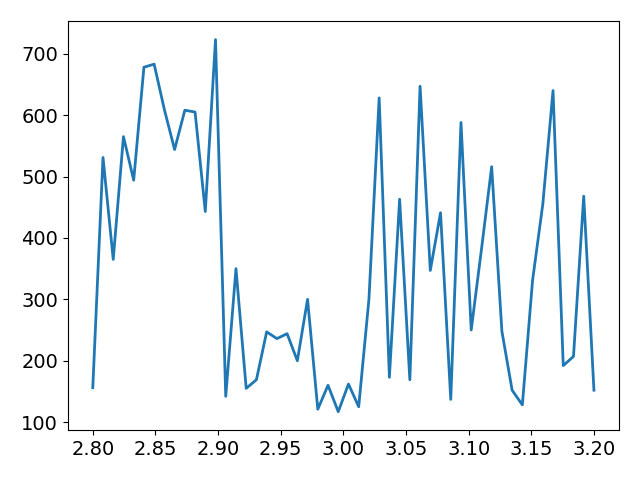

In [96]:
plt.figure()
plt.plot(f1, duration)

In [2]:
lambda0 = 1239.8/9000*1e-9
phase = 80
path = phase*lambda0/2/np.pi

In [3]:
print(path)

1.7539582084029499e-09


In [8]:
1/(1/6+1/3)

2.0

In [34]:
37/20

1.85

In [11]:
400/8

50.0

In [32]:
9*2/20

0.9

In [71]:
1/(1/300 + 1/3)

2.9702970297029703

In [72]:
2.97*2

5.94

In [75]:
3*10/(10-3)

4.285714285714286